# biocharStability - Comparison of curve fitting strategies


This notebook applies different curve fitting strategies and best-fit selections to the biochar decomposition data. For each observation, it generates graphics to inspect the quality of the fits. The fitting strategies are then briefly compared.



In [57]:
# importing the library (and other libraries as needed)
import biocharStability as bs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
from datetime import datetime
import seaborn as sns
import string

## Curve fitting and best fit selection

### Fitting on: biochar C remaining, C_bc_rem_rel

__Step 1:__ Load the data

In [58]:
# step 1: load the data
fp = '../biocharStability/database/biochar_incubation_database_2022-03-22_live.xlsx'
metadata, schema, metadata_column_sets = bs.load_metadata(filepath=fp)
data = bs.load_data(filepath=fp)
articles = bs.load_articles(filepath=fp)
validation = bs.load_validation(filepath=fp)

Metadata loaded, with 187 rows
Data loaded, with 2941 rows
Articles loaded, with 76 rows
Validation loaded, with 151 rows


__Step 2:__ Define curve-fitting strategies, using various kinds of model functions, initial conditions, algorithm 

A curve-fitting strategy is made of two parts:

- parameters to perform a series of fits, which includes:
    - Model functions: single, double, triple exponentials in constrained and unconstrained forms, and power model
    - Initial conditions: initial values for parameters of above models, can improve fit results for hard-to-fit observations
    - [Boundaries: let free seems to work, i.e. -np.Inf, np.Inf]
    - Fitting algorithm: lm, trf, [dogbox]
    - Fitting library: scipy, lmfit
    
    
    
- criteria to select the best-fit, which includes: 
    - Model functions considered: single, double, triple exponentials in constrained and unconstrained forms, and power model
    - Checks on:
        - positivity of decay rates (for exponential models)
        - positivity of pool sizes (for exponential models)
        - pool sizes below 100% (for exponential models)
        - parameter constrained, i.e. parameter value < standard deviation of parameter, in absolute value
    - Goodness of fit indicator: BIC, AIC, r2, r2a ; ('bic', True) means lowest BIC is best, ('r2', False) means highest r2 is best

Note: in the lists above, the items in square brackets [...] are not used here but were tested during the project. 

In [59]:
# defining parameters to perform a series of fits
parameters_for_series_of_fits = [
    # single exp, 100% at t0
    (bs.singleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ), 
    (bs.singleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
    
    # single exp, unconstrained
    (bs.singleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.singleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(singleExp_u, 'trf',    ( [0, 0], [1000, 100] ) ), # 0 < k < 1000,  0< c <100
        #(singleExp_u, 'trf',    ( (0, 0), (50, 100) ) ), # 0 < k < 50,  0< c <100
    
    # double exp, 100% at t0
    (bs.doubleExp, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(doubleExp, 'trf',    ( (0, 0, 0), (1000, 1000, 100) ) ), # 0 < k1 < 1000, 0 < k2 < 1000,  0< c1 <100
        #(doubleExp, 'trf',    ( (0, 0, 0), (50, 1, 100) ) ), # 0 < k1 < 50, 0 < k2 < 1,  0< c1 <100
        # with p0
        (bs.doubleExp, 'lm', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),

        (bs.doubleExp, 'trf', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),
        
    # double exp, unconstrained
    (bs.doubleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with p0
        (bs.doubleExp_u, 'lm', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),

        (bs.doubleExp_u, 'trf', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        
    # triple exp, 100% at t0
    (bs.tripleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.tripleExp, 'lm',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.tripleExp, 'trf',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
          
    # triple exp, unconstrained
    (bs.tripleExp_u, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.tripleExp_u, 'lm',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.tripleExp_u, 'trf',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
    # power model (infinite pool)
    (bs.powerModel, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.powerModel, 'trf',  None, ( (-1*np.inf), (np.inf) ) ),
    #(powerModel, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
]

__Step 3:__ Perform the fits

In [141]:
# performing all fits
day_run = datetime.today().strftime('%Y-%m-%d')
df_scipy_fits = bs.fit_all_observations(data, metadata, fitting_strategies=parameters_for_series_of_fits,
                                        library ='scipy', 
                                        excel='../simulations/manuscript/curve-fitting_scipy_allfits_v'+day_run+'.xlsx')

df_lmfit_fits = bs.fit_all_observations(data, metadata, fitting_strategies=parameters_for_series_of_fits,
                                        library ='lmfit', 
                                        excel='../simulations/manuscript/curve-fitting_lmfit_allfits_v'+day_run+'.xlsx')

df_all_fits = bs.merge_dfs([df_scipy_fits, df_lmfit_fits], 
                           saveTo='../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A

c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf

c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(

42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\bioch

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\bioch

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\anaconda\

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, in

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\bioch

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 1

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten itera

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: Runtime

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\bi

9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\bio

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\githu

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  ret

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to func

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.l

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStabi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\bioc

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: Runtime

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten itera

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.l

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <func

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal par

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstab

32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\bioch

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670>

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.s

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWa

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <func

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  retur

30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: Runt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\g

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anacon

Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflo

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\en

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\b

23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleEx

c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, in

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: Ru

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.00

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:88

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
3

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*n

34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tr

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\bio

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.lo

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  f

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, 

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correl

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-in

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: over

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could n

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_m

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocha

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p

23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is e

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_sca

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ 

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, in

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: 

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev =

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+

32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)


22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\

33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x00000

c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.00

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value e

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\g

21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <funct

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: Optimize

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\bioc

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameter

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\g

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\bioc

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value e

27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py

27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD628

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fu

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fun

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fu

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: Runtime

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fu

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <fun

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <funct

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <funct

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\bioc

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\g

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarn

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warning

23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fu

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fu

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqr

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warning

29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: Run

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\bioc

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.00

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.

2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u a

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow e

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleEx

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the 

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimiz

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocha

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-in

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py

Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x00000

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\anal

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Op

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow en

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.

10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('

4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in doubl

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\en

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analy

10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStabi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\anaconda\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x0000

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-

42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FA

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, Runtime

41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal par

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: in

33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubl

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleEx

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten 

23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
3

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encount

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(

8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\git

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf,

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-i

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp

23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\git

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: ov

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_

30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\

34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tr

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <functi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:65: Runt

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08,

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten itera

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal par

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analy

43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: Number of calls to func

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleEx

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocha

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <func

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\bi

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A

c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\sci

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstabili

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A

c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal para

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: Number of calls to function has reached maxfev = 800.
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.0

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of func

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_

3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharSta

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parame

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five

21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encounter

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 3.48702623
    reduced chi-square = 0.18352770
    Akaike info crit   = -32.9336597
    Bayesian info crit = -31.9379274
[[Variables]]
    k:  5.3083e-05 +/- 3.3490e-06 (6.31%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 3.48702623
    reduced chi-square = 0.18352770
    Akaike info crit   = -32.9336597
    Bayesian info crit = -31.9379274
[[Variables]]
    k:  5.3083e-05 +/- 3.3490e-06 (6.31%) (init = 0)
2 lm <function singleExp_u at 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike info crit   = -37.2325747
    Bayesian info crit = -33.2496456
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8041e-05 +/- 4.9081e-06 (12.90%) (init = 0)
    k2:  4.45128344 +/-        nan (nan%) (init = 0)
    c1:  99.4823827 +/- 0.14673728 (0.15%) (init = 0)
    c2:  0.52345343 +/- 0.38692628 (73.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.822
    C(c1, c2) = -0.374
    C(k1, c2) = -0.308
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike info crit   = -37.2325747
    Bayesian info crit = -33.2496456
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8041e-05 +/- 4.9081e-06 (12.90%) (init = 0)
    k2:  4.45128344 +/-        nan (nan%) (init = 0)
    c1:  99.4823827 +/- 0.14673728 (0.15%) (init = 0)
    c2:  0.52345343 +/- 0.38692628 (73.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.822
    C(c1, c2) = -0.374
    C(k1, c2) = -0.308
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data points      = 20
    # variables        = 5
    chi-square         = 0.63381714
    reduced chi-square = 0.04225448
    Akaike info crit   = -59.0345413
    Bayesian info crit = -54.0558799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3647e-06 +/- 0.01193395 (127435.16%) (init = 0)
    k2:  0.00729679 +/- 0.00164347 (22.52%) (init = 0)
    k3:  6.8416e-06 +/- 2.1740e-06 (31.78%) (init = 0)
    c1:  0.00644426 +/-        nan (nan%) (init = 0)
    c2:  1.81383301 +/- 0.19597607 (10.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.108
    C(k1, c2) = -0.964
    C(k2, c2) = -0.809
    C(k3, c2) = -0.747
    C(k1, k2) = 0.501
    C(k2, k3) = 0.388
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data points      = 20
    # variables        = 5
    chi-square         = 0.63381714
    reduced chi-square = 0.04225448
    Akaike info crit   = -59.0345413
    Bayesian info crit = -54.0558799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3647e-06 +/- 0.01193395 (127435.16%) (init = 0)
    k2:  0.00729679 +/- 0.00164347 (22.52%) (init = 0)
    k3:  6.8416e-06 +/- 2.1740e-06 (31.78%) (init = 0)
    c1:  0.00644426 +/-        nan (nan%) (init = 0)
    c2:  1.81383301 +/- 0.19597607 (10.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.108
    C(k1, c2) = -0.964
    C(k2, c2) = -0.809
    C(k3, c2) = -0.747
    C(k1, k2) = 0.501
    C(k2, k3) = 0.388
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data points      = 20
    # variables        = 5
    chi-square         = 0.63381714
    reduced chi-square = 0.04225448
    Akaike info crit   = -59.0345413
    Bayesian info crit = -54.0558799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3647e-06 +/- 0.01193395 (127435.16%) (init = 0)
    k2:  0.00729679 +/- 0.00164347 (22.52%) (init = 0)
    k3:  6.8416e-06 +/- 2.1740e-06 (31.78%) (init = 0)
    c1:  0.00644426 +/-        nan (nan%) (init = 0)
    c2:  1.81383301 +/- 0.19597607 (10.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.108
    C(k1, c2) = -0.964
    C(k2, c2) = -0.809
    C(k3, c2) = -0.747
    C(k1, k2) = 0.501
    C(k2, k3) = 0.388
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 12
    # variables        = 3
    chi-square         = 0.00113877
    reduced chi-square = 1.2653e-04
    Akaike info crit   = -105.152597
    Bayesian info crit = -103.697877
[[Variables]]
    k1:  0.05501113 +/- 0.00860587 (15.64%) (init = 0)
    k2:  3.1928e-06 +/- 1.9552e-07 (6.12%) (init = 0)
    c1:  0.13582751 +/- 0.00617615 (4.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.653
    C(k1, c1) = -0.564
    C(k1, k2) = 0.323
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 12
    # variables        = 3
    chi-square         = 0.00113877
    reduced chi-square = 1.2653e-04
    Akaike info crit   = -105.152597
    Bayesian info crit = -103.697877
[[Variables]]
    k1:  0.05501113 +/- 0.00860587 (15.64%) (ini

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 12
    # variables        = 4
    chi-square         = 0.01502116
    reduced chi-square = 0.00187765
    Akaike info crit   = -72.1984237
    Bayesian info crit = -70.2587971
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.3911e-06 (init = 0)
    k2:  44.6770788 (init = 0)
    c1:  99.9219838 (init = 0)
    c2:  0.07649017 (init = 0)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 12
    # variables        = 4
    chi-square         = 0.01502116
    reduced chi-square = 0.00187765
    Akaike info crit   = -72.1984237
    Bayesian info crit = -70.2587971
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.3911e-06 (init = 0)
    k2:  44.6770788 (init = 0)
    c1:  99.9219838 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00113856
    reduced chi-square = 1.6265e-04
    Akaike info crit   = -101.154814
    Bayesian info crit = -98.7302807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05488361 +/- 0.00970544 (17.68%) (init = 0)
    k2:  0.17157415 +/-        nan (nan%) (init = 0)
    k3:  3.2007e-06 +/- 2.2179e-07 (6.93%) (init = 0)
    c1:  0.13565062 +/- 0.00699757 (5.16%) (init = 0)
    c2:  1.8215e-08 +/- 1.8147e-05 (99626.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.653
    C(k1, c1) = -0.562
    C(k1, k3) = 0.321
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00113856
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00113856
    reduced chi-square = 1.6265e-04
    Akaike info crit   = -101.154814
    Bayesian info crit = -98.7302807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05488361 +/- 0.00970544 (17.68%) (init = 0)
    k2:  0.17157415 +/-        nan (nan%) (init = 0)
    k3:  3.2007e-06 +/- 2.2179e-07 (6.93%) (init = 0)
    c1:  0.13565062 +/- 0.00699757 (5.16%) (init = 0)
    c2:  1.8215e-08 +/- 1.8147e-05 (99626.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.653
    C(k1, c1) = -0.562
    C(k1, k3) = 0.321
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 12
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00113856
    reduced chi-square = 1.6265e-04
    Akaike info crit   = -101.154814
    Bayesian info crit = -98.7302807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05488361 +/- 0.00970544 (17.68%) (init = 0)
    k2:  0.17157415 +/-        nan (nan%) (init = 0)
    k3:  3.2007e-06 +/- 2.2179e-07 (6.93%) (init = 0)
    c1:  0.13565062 +/- 0.00699757 (5.16%) (init = 0)
    c2:  1.8215e-08 +/- 1.8147e-05 (99626.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.653
    C(k1, c1) = -0.562
    C(k1, k3) = 0.321
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 619
    # data points      = 12
    # variables        = 6
    chi-square         = 0.01475079
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 619
    # data points      = 12
    # variables        = 6
    chi-square         = 0.01475079
    reduced chi-square = 0.00245847
    Akaike info crit   = -68.4163809
    Bayesian info crit = -65.5069410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.3475e-06 +/- 8.6868e-07 (16.24%) (init = 0)
    k2:  3.63752076 +/-        nan (nan%) (init = 0)
    k3:  11.4086115 +/-        nan (nan%) (init = 0)
    c1:  99.9212148 +/- 0.01804507 (0.02%) (init = 0)
    c2:  0.07945480 +/- 0.07259165 (91.36%) (init = 0)
    c3:  8.7446e-04 +/- 0.05199551 (5945.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.697
    C(k1, c1) = 0.563
    C(c1, c2) = -0.234
    C(k1, c2) = -0.132
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 61

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 619
    # data points      = 12
    # variables        = 6
    chi-square         = 0.01475079
    reduced chi-square = 0.00245847
    Akaike info crit   = -68.4163809
    Bayesian info crit = -65.5069410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.3475e-06 +/- 8.6868e-07 (16.24%) (init = 0)
    k2:  3.63752076 +/-        nan (nan%) (init = 0)
    k3:  11.4086115 +/-        nan (nan%) (init = 0)
    c1:  99.9212148 +/- 0.01804507 (0.02%) (init = 0)
    c2:  0.07945480 +/- 0.07259165 (91.36%) (init = 0)
    c3:  8.7446e-04 +/- 0.05199551 (5945.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.697
    C(k1, c1) = 0.563
    C(c1, c2) = -0.234
    C(k1, c2) = -0.132
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 619
    # data points      = 12
    # variables        = 6
    chi-square         = 0.01475079
    reduced chi-square = 0.00245847
    Akaike info crit   = -68.4163809
    Bayesian info crit = -65.5069410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.3475e-06 +/- 8.6868e-07 (16.24%) (init = 0)
    k2:  3.63752076 +/-        nan (nan%) (init = 0)
    k3:  11.4086115 +/-        nan (nan%) (init = 0)
    c1:  99.9212148 +/- 0.01804507 (0.02%) (init = 0)
    c2:  0.07945480 +/- 0.07259165 (91.36%) (init = 0)
    c3:  8.7446e-04 +/- 0.05199551 (5945.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.697
    C(k1, c1) = 0.563
    C(c1, c2) = -0.234
    C(k1, c2) = -0.132
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 119688.832
    reduced chi-square = 13298.7591
    Akaike info crit   = 116.492927
    Bayesian info crit = 117.947647
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 119688.832
    reduced chi-square = 13298.7591
    Akaike info crit   = 116.492927
    Bayesian info crit = 117.947647
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 283
    # data points      = 11
    # variables        = 4
    chi-square         = 0.01094050
    reduced chi-square = 0.00156293
    Akaike info crit   = -68.0449694
    Bayesian info crit = -66.4533883
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7730e-06 (init = 0)
    k2:  39.7849298 (init = 0)
    c1:  99.9249267 (init = 0)
    c2:  0.07695737 (init = 0)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 283
    # data points      = 11
    # variables        = 4
    chi-square         = 0.01094050
    reduced chi-square = 0.00156293
    Akaike info crit   = -68.0449694
    Bayesian info crit = -66.4533883
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7730e-06 (init = 0)
    k2:  39.7849298 (init = 0)
    c1:  99.9249267 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 11
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.0665e-04
    Akaike info crit   = -97.2727372
    Bayesian info crit = -95.2832609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02690878 +/- 0.01102048 (40.95%) (init = 0)
    k2:  0.02691042 +/- 0.02152053 (79.97%) (init = 0)
    k3:  9.8300e-07 +/- 1.1110e-07 (11.30%) (init = 0)
    c1:  0.10233538 +/-        nan (nan%) (init = 0)
    c2:  0.05065362 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.899
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 11
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.0665e-0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 11
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.0665e-04
    Akaike info crit   = -97.2727372
    Bayesian info crit = -95.2832609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02690878 +/- 0.01102048 (40.95%) (init = 0)
    k2:  0.02691042 +/- 0.02152053 (79.97%) (init = 0)
    k3:  9.8300e-07 +/- 1.1110e-07 (11.30%) (init = 0)
    c1:  0.10233538 +/-        nan (nan%) (init = 0)
    c2:  0.05065362 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.899
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 11
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.0665e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        = 3
    chi-square         = 109752.159
    reduced chi-square = 13719.0198
    Akaike info crit   = 107.288932
    Bayesian info crit = 108.482618
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        = 3
    chi-square         = 109752.159
    reduced chi-square = 13719.0198
    Akaike info crit   = 107.288932
    Bayesian info crit = 108.482618
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 11
    # variables        = 4
    chi-square         = 0.00496233
    reduced chi-square = 7.0890e-04
    Akaike info crit   = -76.7415177
    Bayesian info crit = -75.1499366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7459e-06 (init = 0)
    k2:  34.0088342 (init = 0)
    c1:  99.9238884 (init = 0)
    c2:  0.07453064 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 11
    # variables        = 4
    chi-square         = 0.00496233
    reduced chi-square = 7.0890e-04
    Akaike info crit   = -76.7415177
    Bayesian info crit = -75.1499366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7459e-06 (init = 0)
    k2:  34.0088342 (init = 0)
    c1:  99.9238884 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3358e-04
    reduced chi-square = 2.2263e-05
    Akaike info crit   = -114.505840
    Bayesian info crit = -112.516363
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43367492 +/-        nan (nan%) (init = 0)
    k2:  0.05359257 +/- 0.00440197 (8.21%) (init = 0)
    k3:  1.4568e-06 +/- 5.9413e-08 (4.08%) (init = 0)
    c1:  7.1078e-07 +/- 1.1780e-04 (16574.06%) (init = 0)
    c2:  0.11082157 +/- 0.00235968 (2.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.554
    C(k3, c2) = -0.533
    C(k2, k3) = 0.252
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3358e-04
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3358e-04
    reduced chi-square = 2.2263e-05
    Akaike info crit   = -114.505840
    Bayesian info crit = -112.516363
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43367492 +/-        nan (nan%) (init = 0)
    k2:  0.05359257 +/- 0.00440197 (8.21%) (init = 0)
    k3:  1.4568e-06 +/- 5.9413e-08 (4.08%) (init = 0)
    c1:  7.1078e-07 +/- 1.1780e-04 (16574.06%) (init = 0)
    c2:  0.11082157 +/- 0.00235968 (2.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.554
    C(k3, c2) = -0.533
    C(k2, k3) = 0.252
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3358e-04
    reduced chi-square = 2.2263e-05
    Akaike info crit   = -114.505840
    Bayesian info crit = -112.516363
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43367492 +/-        nan (nan%) (init = 0)
    k2:  0.05359257 +/- 0.00440197 (8.21%) (init = 0)
    k3:  1.4568e-06 +/- 5.9413e-08 (4.08%) (init = 0)
    c1:  7.1078e-07 +/- 1.1780e-04 (16574.06%) (init = 0)
    c2:  0.11082157 +/- 0.00235968 (2.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.554
    C(k3, c2) = -0.533
    C(k2, k3) = 0.252
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 11
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 11
    # variables        = 3
    chi-square         = 1.3898e-04
    reduced chi-square = 1.7373e-05
    Akaike info crit   = -118.069494
    Bayesian info crit = -116.875808
[[Variables]]
    k1:  0.04736478 +/- 0.00310972 (6.57%) (init = 0)
    k2:  2.2858e-06 +/- 6.4423e-08 (2.82%) (init = 0)
    c1:  0.12619026 +/- 0.00232091 (1.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.619
    C(k1, c1) = -0.601
    C(k1, k2) = 0.320
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 11
    # variables        = 3
    chi-square         = 1.3898e-04
    reduced chi-square = 1.7373e-05
    Akaike info crit   = -118.069494
    Bayesian info crit = -116.875808
[[Variables]]
    k1:  0.04736478 +/- 0.00310972 (6.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3873e-04
    reduced chi-square = 2.3121e-05
    Akaike info crit   = -114.089778
    Bayesian info crit = -112.100301
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04687328 +/- 0.00352889 (7.53%) (init = 0)
    k2:  0.25066869 +/-        nan (nan%) (init = 0)
    k3:  2.2715e-06 +/- 7.4148e-08 (3.26%) (init = 0)
    c1:  0.12660532 +/- 0.00267987 (2.12%) (init = 0)
    c2:  1.9750e-08 +/- 9.3318e-06 (47249.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.618
    C(k1, c1) = -0.601
    C(k1, k3) = 0.319
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3873e-04
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3873e-04
    reduced chi-square = 2.3121e-05
    Akaike info crit   = -114.089778
    Bayesian info crit = -112.100301
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04687328 +/- 0.00352889 (7.53%) (init = 0)
    k2:  0.25066869 +/-        nan (nan%) (init = 0)
    k3:  2.2715e-06 +/- 7.4148e-08 (3.26%) (init = 0)
    c1:  0.12660532 +/- 0.00267987 (2.12%) (init = 0)
    c2:  1.9750e-08 +/- 9.3318e-06 (47249.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.618
    C(k1, c1) = -0.601
    C(k1, k3) = 0.319
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1.3873e-04
    reduced chi-square = 2.3121e-05
    Akaike info crit   = -114.089778
    Bayesian info crit = -112.100301
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04687328 +/- 0.00352889 (7.53%) (init = 0)
    k2:  0.25066869 +/-        nan (nan%) (init = 0)
    k3:  2.2715e-06 +/- 7.4148e-08 (3.26%) (init = 0)
    c1:  0.12660532 +/- 0.00267987 (2.12%) (init = 0)
    c2:  1.9750e-08 +/- 9.3318e-06 (47249.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.618
    C(k1, c1) = -0.601
    C(k1, k3) = 0.319
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 11
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        = 3
    chi-square         = 109734.118
    reduced chi-square = 13716.7648
    Akaike info crit   = 107.287124
    Bayesian info crit = 108.480810
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        = 3
    chi-square         = 109734.118
    reduced chi-square = 13716.7648
    Akaike info crit   = 107.287124
    Bayesian info crit = 108.480810
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 11
    # variables        = 4
    chi-square         = 0.00717396
    reduced chi-square = 0.00102485
    Akaike info crit   = -72.6871243
    Bayesian info crit = -71.0955432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.1625e-06 (init = 0)
    k2:  30.9204749 (init = 0)
    c1:  99.9308596 (init = 0)
    c2:  0.06725214 (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 11
    # variables        = 4
    chi-square         = 0.00717396
    reduced chi-square = 0.00102485
    Akaike info crit   = -72.6871243
    Bayesian info crit = -71.0955432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.1625e-06 (init = 0)
    k2:  30.9204749 (init = 0)
    c1:  99.9308596 (init = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 11
    # variables        = 5
    chi-square         = 0.00121649
    reduced chi-square = 2.0275e-04
    Akaike info crit   = -90.2065184
    Bayesian info crit = -88.2170420
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03832074 +/- 0.01040609 (27.16%) (init = 0)
    k2:  0.22575864 +/-        nan (nan%) (init = 0)
    k3:  4.4321e-06 +/- 3.0023e-07 (6.77%) (init = 0)
    c1:  0.11581915 +/- 0.00901430 (7.78%) (init = 0)
    c2:  6.0102e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.826
    C(k1, c1) = -0.809
    C(k1, k3) = 0.454
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 11
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 11
    # variables        = 5
    chi-square         = 0.00121649
    reduced chi-square = 2.0275e-04
    Akaike info crit   = -90.2065184
    Bayesian info crit = -88.2170420
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03832074 +/- 0.01040609 (27.16%) (init = 0)
    k2:  0.22575864 +/-        nan (nan%) (init = 0)
    k3:  4.4321e-06 +/- 3.0023e-07 (6.77%) (init = 0)
    c1:  0.11581915 +/- 0.00901430 (7.78%) (init = 0)
    c2:  6.0102e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.826
    C(k1, c1) = -0.809
    C(k1, k3) = 0.454
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 11
    # variables        = 5
    chi-square         = 0.001

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00847820
    reduced chi-square = 8.4782e-04
    Akaike info crit   = -89.3576814
    Bayesian info crit = -87.6628333
[[Variables]]
    k1:  0.03005193 +/- 0.00381717 (12.70%) (init = 0)
    k2:  8.4619e-06 +/- 3.3592e-07 (3.97%) (init = 0)
    c1:  0.53923076 +/- 0.01881421 (3.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.814
    C(k1, c1) = -0.570
    C(k1, k2) = 0.438
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00847820
    reduced chi-square = 8.4782e-04
    Akaike info crit   = -89.3576814
    Bayesian info crit = -87.6628333
[[Variables]]
    k1:  0.03005193 +/- 0.00381717 (12.70%) (ini

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 13
    # variables        = 4
    chi-square         = 0.16068084
    reduced chi-square = 0.01785343
    Akaike info crit   = -49.1126996
    Bayesian info crit = -46.8529022
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3095e-05 (init = 0)
    k2:  26.0572555 (init = 0)
    c1:  99.7068825 (init = 0)
    c2:  0.29592930 (init = 0)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 13
    # variables        = 4
    chi-square         = 0.16068084
    reduced chi-square = 0.01785343
    Akaike info crit   = -49.1126996
    Bayesian info crit = -46.8529022
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3095e-05 (init = 0)
    k2:  26.0572555 (init = 0)
    c1:  99.7068825 (init

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00164518
    reduced chi-square = 2.0565e-04
    Akaike info crit   = -106.673120
    Bayesian info crit = -103.848374
[[Variables]]
    k1:  0.10642320 +/- 0.04119084 (38.70%) (init = 0)
    k2:  0.01015926 +/- 0.00190356 (18.74%) (init = 0)
    k3:  6.8779e-06 +/- 1.7876e-07 (2.60%) (init = 0)
    c1:  0.21490139 +/- 0.05249804 (24.43%) (init = 0)
    c2:  0.41831500 +/- 0.04805970 (11.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.968
    C(k1, c1) = -0.929
    C(k1, c2) = 0.914
    C(k2, c1) = -0.893
    C(k2, c2) = 0.791
    C(k1, k2) = 0.771
    C(k2, k3) = 0.418
    C(k3, c1) = -0.251
    C(k1, k3) = 0.202
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18122271
    reduced chi-square = 0.01294448
    Akaike info crit   = -71.2011120
    Bayesian info crit = -68.7014720
[[Variables]]
    k1:  0.17964916 +/- 0.09671222 (53.83%) (init = 0)
    k2:  3.3626e-05 +/- 1.3107e-06 (3.90%) (init = 0)
    c1:  0.39595551 +/- 0.05341103 (13.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.793
    C(k1, c1) = -0.467
    C(k1, k2) = 0.365
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18122271
    reduced chi-square = 0.01294448
    Akaike info crit   = -71.2011120
    Bayesian info crit = -68.7014720
[[Variables]]
    k1:  0.17964916 +/- 0.09671222 (53.83%) (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike info crit   = -62.9544022
    Bayesian info crit = -59.6215488
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5255e-05 +/- 1.4044e-06 (3.98%) (init = 0)
    k2:  4.81741408 +/-        nan (nan%) (init = 0)
    c1:  99.6830634 +/- 0.05039100 (0.05%) (init = 0)
    c2:  0.31666161 +/- 0.15059820 (47.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike info crit   = -62.9544022
    Bayesian info crit = -59.6215488
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5255e-05 +/- 1.4044e-06 (3.98%) (init = 0)
    k2:  4.81741408 +/-        nan (nan%) (init = 0)
    c1:  99.6830634 +/- 0.05039100 (0.05%) (init = 0)
    c2:  0.31666161 +/- 0.15059820 (47.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18122188
    reduced chi-square = 0.01510182
    Akaike info crit   = -67.2011905
    Bayesian info crit = -63.0351238
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09449925 +/-        nan (nan%) (init = 0)
    k2:  0.17974851 +/- 0.10451502 (58.15%) (init = 0)
    k3:  3.3628e-05 +/- 1.4159e-06 (4.21%) (init = 0)
    c1:  1.7519e-08 +/-        nan (nan%) (init = 0)
    c2:  0.39565026 +/- 0.05769652 (14.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.793
    C(k2, c2) = -0.466
    C(k2, k3) = 0.365
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18122188
    reduced chi-square = 0.01510182
    Akaike info crit   = -67.2011905
    Bayesian info crit = -63.0351238
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09449925 +/-        nan (nan%) (init = 0)
    k2:  0.17974851 +/- 0.10451502 (58.15%) (init = 0)
    k3:  3.3628e-05 +/- 1.4159e-06 (4.21%) (init = 0)
    c1:  1.7519e-08 +/-        nan (nan%) (init = 0)
    c2:  0.39565026 +/- 0.05769652 (14.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.793
    C(k2, c2) = -0.466
    C(k2, k3) = 0.365
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 17
    # variables        = 3
    chi-square         = 0.80512715
    reduced chi-square = 0.05750908
    Akaike info crit   = -45.8494629
    Bayesian info crit = -43.3498228
[[Variables]]
    k1:  0.70665632 +/- 1.22260811 (173.01%) (init = 0)
    k2:  6.0095e-05 +/- 2.6842e-06 (4.47%) (init = 0)
    c1:  0.40288573 +/- 0.09866518 (24.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.753
    C(k1, c1) = -0.425
    C(k1, k2) = 0.319
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 17
    # variables        = 3
    chi-square         = 0.80512715
    reduced chi-square = 0.05750908
    Akaike info crit   = -45.8494629
    Bayesian info crit = -43.3498228
[[Variables]]
    k1:  0.70665632 +/- 1.22260811 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 17
    # variables        = 4
    chi-square         = 0.81316072
    reduced chi-square = 0.06255082
    Akaike info crit   = -43.6806775
    Bayesian info crit = -40.3478241
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0431e-05 +/- 2.6049e-06 (4.31%) (init = 0)
    k2:  8.18135866 +/-        nan (nan%) (init = 0)
    c1:  99.6122693 +/- 0.08978205 (0.09%) (init = 0)
    c2:  0.38827493 +/- 0.26562392 (68.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.707
    C(c1, c2) = -0.338
    C(k1, c2) = -0.239
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 17
    # variables        = 4
    chi-square         = 0.81316072
    reduced chi-square = 0.06255082
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 17
    # variables        = 4
    chi-square         = 0.81316072
    reduced chi-square = 0.06255082
    Akaike info crit   = -43.6806775
    Bayesian info crit = -40.3478241
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0431e-05 +/- 2.6049e-06 (4.31%) (init = 0)
    k2:  8.18135866 +/-        nan (nan%) (init = 0)
    c1:  99.6122693 +/- 0.08978205 (0.09%) (init = 0)
    c2:  0.38827493 +/- 0.26562392 (68.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.707
    C(c1, c2) = -0.338
    C(k1, c2) = -0.239
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 17
    # variables        = 4
    chi-square         = 0.81316072
    reduced chi-square = 0.06255082
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01607592
    reduced chi-square = 0.00178621
    Akaike info crit   = -79.0399647
    Bayesian info crit = -76.7801672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.1857e-06 (init = 0)
    k2:  13.4841549 (init = 0)
    c1:  99.8634793 (init = 0)
    c2:  0.13378048 (init = 0)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01607592
    reduced chi-square = 0.00178621
    Akaike info crit   = -79.0399647
    Bayesian info crit = -76.7801672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.1857e-06 (init = 0)
    k2:  13.4841549 (init = 0)
    c1:  99.8634793 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 13
    # variables        = 5
    chi-square         = 5.2484e-04
    reduced chi-square = 6.5605e-05
    Akaike info crit   = -121.525817
    Bayesian info crit = -118.701070
[[Variables]]
    k1:  0.01858219 +/- 0.00459039 (24.70%) (init = 0)
    k2:  0.31875878 +/- 0.12449974 (39.06%) (init = 0)
    k3:  3.6430e-06 +/- 6.9906e-08 (1.92%) (init = 0)
    c1:  0.13237730 +/- 0.01519375 (11.48%) (init = 0)
    c2:  0.08685792 +/- 0.01584942 (18.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.952
    C(k1, c2) = -0.837
    C(k2, c2) = -0.791
    C(k2, c1) = 0.765
    C(k1, c1) = 0.709
    C(k1, k2) = 0.589
    C(k1, k3) = 0.315
    C(k3, c2) = -0.164
    C(k2, k3) = 0.107
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 3
    chi-square         = 0.02971987
    reduced chi-square = 0.00212285
    Akaike info crit   = -101.935598
    Bayesian info crit = -99.4359584
[[Variables]]
    k1:  0.04570919 +/- 0.01335882 (29.23%) (init = 0)
    k2:  1.5820e-05 +/- 6.1493e-07 (3.89%) (init = 0)
    c1:  0.40411360 +/- 0.03040252 (7.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.865
    C(k1, c1) = -0.691
    C(k1, k2) = 0.580
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 3
    chi-square         = 0.02971987
    reduced chi-square = 0.00212285
    Akaike info crit   = -101.935598
    Bayesian info crit = -99.4359584
[[Variables]]
    k1:  0.04570919 +/- 0.01335882 (29.23%) (ini

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.13551797
    reduced chi-square = 0.01042446
    Akaike info crit   = -74.1416938
    Bayesian info crit = -70.8088404
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9116e-05 +/- 9.5167e-07 (4.98%) (init = 0)
    k2:  4.21536254 +/-        nan (nan%) (init = 0)
    c1:  99.7581232 +/- 0.03528626 (0.04%) (init = 0)
    c2:  0.24137373 +/- 0.10808247 (44.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.687
    C(c1, c2) = -0.327
    C(k1, c2) = -0.224
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.13551797
    reduced chi-square = 0.01042446
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.13551797
    reduced chi-square = 0.01042446
    Akaike info crit   = -74.1416938
    Bayesian info crit = -70.8088404
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9116e-05 +/- 9.5167e-07 (4.98%) (init = 0)
    k2:  4.21536254 +/-        nan (nan%) (init = 0)
    c1:  99.7581232 +/- 0.03528626 (0.04%) (init = 0)
    c2:  0.24137373 +/- 0.10808247 (44.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.687
    C(c1, c2) = -0.327
    C(k1, c2) = -0.224
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01882733
    reduced chi-square = 0.00156894
    Akaike info crit   = -105.69

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 17
    # variables        = 6
    chi-square         = 0.13553451
    reduced chi-square = 0.01232132
    Akaike info crit   = -70.1396202
    Bayesian info crit = -65.1403401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9120e-05 (init = 0)
    k2:  2.76941513 (init = 0)
    k3:  17.8942992 (init = 0)
    c1:  99.7583083 (init = 0)
    c2:  3.5465e-04 (init = 0)
    c3:  0.24391791 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 17
    # variables        = 6
    chi-square         = 0.13553451
    reduced chi-square = 0.01232132
    Akaike info crit   = -70.1396202
    Bayesian info crit = -65.1403401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9120e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 17
    # variables        = 1
    chi-square         = 0.58221774
    reduced chi-square = 0.03638861
    Akaike info crit   = -55.3601102
    Bayesian info crit = -54.5268968
[[Variables]]
    k:  3.4505e-05 +/- 1.3598e-06 (3.94%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 17
    # variables        = 1
    chi-square         = 0.58221774
    reduced chi-square = 0.03638861
    Akaike info crit   = -55.3601102
    Bayesian info crit = -54.5268968
[[Variables]]
    k:  3.4505e-05 +/- 1.3598e-06 (3.94%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 17
    # variables        = 2
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike info crit   = -76.7159375
    Bayesian info crit = -73.3830842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9314e-05 +/- 9.3342e-07 (3.18%) (init = 0)
    k2:  3.29853929 +/-        nan (nan%) (init = 0)
    c1:  99.7514515 +/- 0.03319307 (0.03%) (init = 0)
    c2:  0.24892749 +/- 0.10024921 (40.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.696
    C(c1, c2) = -0.331
    C(k1, c2) = -0.230
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike info crit   = -76.7159375
    Bayesian info crit = -73.3830842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9314e-05 +/- 9.3342e-07 (3.18%) (init = 0)
    k2:  3.29853929 +/-        nan (nan%) (init = 0)
    c1:  99.7514515 +/- 0.03319307 (0.03%) (init = 0)
    c2:  0.24892749 +/- 0.10024921 (40.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.696
    C(c1, c2) = -0.331
    C(k1, c2) = -0.230
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 971
    # data points      = 17
    # variables        = 5
    chi-square         = 0.10194555
    reduced chi-square = 0.00849546
    Akaike info crit   = -76.9810070
    Bayesian info crit = -72.8149402
[[Variables]]
    k1:  0.11345201 +/- 0.18462041 (162.73%) (init = 0)
    k2:  12.1798598 +/- 443177.631 (3638610.28%) (init = 0)
    k3:  2.8506e-05 +/- 1.0978e-06 (3.85%) (init = 0)
    c1:  0.14505741 +/- 0.12923491 (89.09%) (init = 0)
    c2:  0.14210976 +/- 0.12506645 (88.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.936
    C(k1, c2) = -0.716
    C(k1, c1) = 0.552
    C(k1, k3) = 0.313
    C(k3, c1) = -0.218
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 971
    # data points      = 17
    # variables        = 5
    chi-square         = 0.10194555
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # variables        = 6
    chi-square         = 0.11609100
    reduced chi-square = 0.01055373
    Akaike info crit   = -72.7721027
    Bayesian info crit = -67.7728226
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9296e-05 +/- 1.0117e-06 (3.45%) (init = 0)
    k2:  2.21354260 +/-        nan (nan%) (init = 0)
    k3:  10.6935714 +/- 65945.2859 (616681.59%) (init = 0)
    c1:  99.7509340 +/- 0.03591939 (0.04%) (init = 0)
    c2:  0.24446999 +/- 0.33226034 (135.91%) (init = 0)
    c3:  0.00575763 +/- 0.31571106 (5483.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.695
    C(c1, c2) = -0.101
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # variables        = 6
    chi-square         = 0.11609100
    reduced chi-square = 0.01055373
    Akaike info crit   = -72.7721027
    Bayesian info crit = -67.7728226
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9296e-05 +/- 1.0117e-06 (3.45%) (init = 0)
    k2:  2.21354260 +/-        nan (nan%) (init = 0)
    k3:  10.6935714 +/- 65945.2859 (616681.59%) (init = 0)
    c1:  99.7509340 +/- 0.03591939 (0.04%) (init = 0)
    c2:  0.24446999 +/- 0.33226034 (135.91%) (init = 0)
    c3:  0.00575763 +/- 0.31571106 (5483.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.695
    C(c1, c2) = -0.101
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # variables        = 6
    chi-square         = 0.11609100
    reduced chi-square = 0.01055373
    Akaike info crit   = -72.7721027
    Bayesian info crit = -67.7728226
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9296e-05 +/- 1.0117e-06 (3.45%) (init = 0)
    k2:  2.21354260 +/-        nan (nan%) (init = 0)
    k3:  10.6935714 +/- 65945.2859 (616681.59%) (init = 0)
    c1:  99.7509340 +/- 0.03591939 (0.04%) (init = 0)
    c2:  0.24446999 +/- 0.33226034 (135.91%) (init = 0)
    c3:  0.00575763 +/- 0.31571106 (5483.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.695
    C(c1, c2) = -0.101
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # variables        = 6
    chi-square         = 0.11609100
    reduced chi-square = 0.01055373
    Akaike info crit   = -72.7721027
    Bayesian info crit = -67.7728226
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9296e-05 +/- 1.0117e-06 (3.45%) (init = 0)
    k2:  2.21354260 +/-        nan (nan%) (init = 0)
    k3:  10.6935714 +/- 65945.2859 (616681.59%) (init = 0)
    c1:  99.7509340 +/- 0.03591939 (0.04%) (init = 0)
    c2:  0.24446999 +/- 0.33226034 (135.91%) (init = 0)
    c3:  0.00575763 +/- 0.31571106 (5483.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.695
    C(c1, c2) = -0.101
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variabl

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00862862
    reduced chi-square = 8.6286e-04
    Akaike info crit   = -89.1290620
    Bayesian info crit = -87.4342139
[[Variables]]
    k1:  0.03409928 +/- 0.00534251 (15.67%) (init = 0)
    k2:  8.4570e-06 +/- 3.3767e-07 (3.99%) (init = 0)
    c1:  0.45665021 +/- 0.01881861 (4.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.813
    C(k1, c1) = -0.581
    C(k1, k2) = 0.449
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 13
    # variables        = 4
    chi-square         = 0.11211522
    reduced chi-square = 0.01245725
    Akaike info crit   = -53.7913081
    Bayesian info crit = -51.5315106
##  Warning: uncertainties could not be estimated:
[[Variabl

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 312
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5310e-04
    reduced chi-square = 4.4138e-05
    Akaike info crit   = -126.678032
    Bayesian info crit = -123.853285
[[Variables]]
    k1:  0.00995039 +/- 7.3619e-04 (7.40%) (init = 0)
    k2:  0.13444378 +/- 0.01802897 (13.41%) (init = 0)
    k3:  6.8960e-06 +/- 8.1447e-08 (1.18%) (init = 0)
    c1:  0.36016597 +/- 0.01345976 (3.74%) (init = 0)
    c2:  0.18971409 +/- 0.01423154 (7.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.911
    C(k2, c2) = -0.840
    C(k1, c2) = -0.806
    C(k2, c1) = 0.791
    C(k1, k2) = 0.590
    C(k1, c1) = 0.573
    C(k1, k3) = 0.403
    C(k3, c2) = -0.180
    C(k3, c1) = -0.173
    C(k2, k3) = 0.117
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 401
    # data points      = 13
    # variables        = 6
    chi-square         = 0.11207518
    reduced chi-square = 0.01601074
    Akaike info crit   = -49.7959522
    Bayesian info crit = -46.4062560
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2157e-05 (init = 0)
    k2:  2.44894875 (init = 0)
    k3:  14.3829695 (init = 0)
    c1:  99.7388719 (init = 0)
    c2:  0.16158462 (init = 0)
    c3:  0.09802773 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 128548.942
    reduced chi-square = 12854.8942
    Akaike info crit   = 125.588503
    Bayesian info crit = 127.283351
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18791224
    reduced chi-square = 0.01342230
    Akaike info crit   = -70.5848910
    Bayesian info crit = -68.0852510
[[Variables]]
    k1:  0.19254322 +/- 0.10270289 (53.34%) (init = 0)
    k2:  2.1722e-05 +/- 1.2563e-06 (5.78%) (init = 0)
    c1:  0.40308534 +/- 0.05205985 (12.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.449
    C(k1, k2) = 0.343
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18791224
    reduced chi-square = 0.01342230
    Akaike info crit   = -70.5848910
    Bayesian info crit = -68.0852510
[[Variables]]
    k1:  0.19254322 +/- 0.10270

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike info crit   = -62.8783837
    Bayesian info crit = -59.5455303
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3249e-05 +/- 1.3517e-06 (5.81%) (init = 0)
    k2:  1.80613924 +/-        nan (nan%) (init = 0)
    c1:  99.6708026 +/- 0.04937263 (0.05%) (init = 0)
    c2:  0.33374005 +/- 0.14908968 (44.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.691
    C(c1, c2) = -0.324
    C(k1, c2) = -0.224
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike info crit   = -62.8783837
    Bayesian info crit = -59.5455303
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3249e-05 +/- 1.3517e-06 (5.81%) (init = 0)
    k2:  1.80613924 +/-        nan (nan%) (init = 0)
    c1:  99.6708026 +/- 0.04937263 (0.05%) (init = 0)
    c2:  0.33374005 +/- 0.14908968 (44.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.691
    C(c1, c2) = -0.324
    C(k1, c2) = -0.224
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18793943
    reduced chi-square = 0.01566162
    Akaike info crit   = -66.5824316
    Bayesian info crit = -62.4163649
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.41122027 +/-        nan (nan%) (init = 0)
    k2:  0.19140529 +/- 0.12916980 (67.48%) (init = 0)
    k3:  2.1723e-05 +/- 1.3579e-06 (6.25%) (init = 0)
    c1:  0.00536461 +/- 0.11065083 (2062.61%) (init = 0)
    c2:  0.39750361 +/- 0.12183352 (30.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.887
    C(k2, c1) = -0.648
    C(k2, c2) = 0.403
    C(k3, c2) = -0.328
    C(k2, k3) = 0.306
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 17
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18793943
    reduced chi-square = 0.01566162
    Akaike info crit   = -66.5824316
    Bayesian info crit = -62.4163649
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.41122027 +/-        nan (nan%) (init = 0)
    k2:  0.19140529 +/- 0.12916980 (67.48%) (init = 0)
    k3:  2.1723e-05 +/- 1.3579e-06 (6.25%) (init = 0)
    c1:  0.00536461 +/- 0.11065083 (2062.61%) (init = 0)
    c2:  0.39750361 +/- 0.12183352 (30.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.887
    C(k2, c1) = -0.648
    C(k2, c2) = 0.403
    C(k3, c2) = -0.328
    C(k2, k3) = 0.306
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 17
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 17
    # variables        = 3
    chi-square         = 0.36443441
    reduced chi-square = 0.02603103
    Akaike info crit   = -59.3245746
    Bayesian info crit = -56.8249346
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.91104114 +/-        nan (nan%) (init = 0)
    k2:  4.2327e-05 +/- 1.5421e-06 (3.64%) (init = 0)
    c1:  0.33835928 +/- 0.05009952 (14.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.655
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 17
    # variables        = 3
    chi-square         = 0.36443441
    reduced chi-square = 0.02603103
    Akaike info crit   = -59.3245746
    Bayesian info crit = -56.8249346
##  Warning: uncertainties could not be esti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.37717815
    reduced chi-square = 0.02901370
    Akaike info crit   = -56.7402672
    Bayesian info crit = -53.4074138
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2521e-05 +/- 1.7320e-06 (4.07%) (init = 0)
    k2:  4.76668608 +/-        nan (nan%) (init = 0)
    c1:  99.6709814 +/- 0.06054922 (0.06%) (init = 0)
    c2:  0.32944843 +/- 0.18070793 (54.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.703
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.37717815
    reduced chi-square = 0.02901370
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.37717815
    reduced chi-square = 0.02901370
    Akaike info crit   = -56.7402672
    Bayesian info crit = -53.4074138
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2521e-05 +/- 1.7320e-06 (4.07%) (init = 0)
    k2:  4.76668608 +/-        nan (nan%) (init = 0)
    c1:  99.6709814 +/- 0.06054922 (0.06%) (init = 0)
    c2:  0.32944843 +/- 0.18070793 (54.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.703
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.338

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variables        = 6
    chi-square         = 0.37688121
    reduced chi-square = 0.03426193
    Akaike info crit   = -52.7536557
    Bayesian info crit = -47.7543756
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2514e-05 +/- 1.8816e-06 (4.43%) (init = 0)
    k2:  2.74188885 +/-        nan (nan%) (init = 0)
    k3:  13.4600300 +/-        nan (nan%) (init = 0)
    c1:  99.6708690 +/- 0.06575646 (0.07%) (init = 0)
    c2:  0.28502476 +/- 3.84600539 (1349.36%) (init = 0)
    c3:  0.04419361 +/- 3.84669872 (8704.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.999
    C(k1, c1) = 0.703
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variables        = 6
    chi-square         = 0.37688121
    reduced chi-square = 0.03426193
    Akaike info crit   = -52.7536557
    Bayesian info crit = -47.7543756
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2514e-05 +/- 1.8816e-06 (4.43%) (init = 0)
    k2:  2.74188885 +/-        nan (nan%) (init = 0)
    k3:  13.4600300 +/-        nan (nan%) (init = 0)
    c1:  99.6708690 +/- 0.06575646 (0.07%) (init = 0)
    c2:  0.28502476 +/- 3.84600539 (1349.36%) (init = 0)
    c3:  0.04419361 +/- 3.84669872 (8704.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.999
    C(k1, c1) = 0.703
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # vari

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00396964
    reduced chi-square = 3.9696e-04
    Akaike info crit   = -99.2223962
    Bayesian info crit = -97.5275482
[[Variables]]
    k1:  0.05820779 +/- 0.01591308 (27.34%) (init = 0)
    k2:  3.4377e-06 +/- 1.5937e-07 (4.64%) (init = 0)
    c1:  0.18694557 +/- 0.01007242 (5.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.695
    C(k1, c1) = -0.548
    C(k1, k2) = 0.365
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00396964
    reduced chi-square = 3.9696e-04
    Akaike info crit   = -99.2223962
    Bayesian info crit = -97.5275482
[[Variables]]
    k1:  0.05820779 +/- 0.01591308 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 13
    # variables        = 5
    chi-square         = 7.8961e-05
    reduced chi-square = 9.8701e-06
    Akaike info crit   = -146.149583
    Bayesian info crit = -143.324837
[[Variables]]
    k1:  0.01081711 +/- 6.8655e-04 (6.35%) (init = 0)
    k2:  0.40663696 +/- 0.05366458 (13.20%) (init = 0)
    k3:  2.5931e-06 +/- 2.3684e-08 (0.91%) (init = 0)
    c1:  0.14882918 +/- 0.00360861 (2.42%) (init = 0)
    c2:  0.08678624 +/- 0.00353524 (4.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.845
    C(k1, c2) = -0.705
    C(k2, c2) = -0.665
    C(k2, c1) = 0.576
    C(k1, k2) = 0.417
    C(k1, c1) = 0.373
    C(k3, c1) = -0.286
    C(k1, k3) = 0.274
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 417
    # data points      = 13
    # variables        = 6
    chi-square         = 0.01430486
    reduced chi-square = 0.00204355
    Akaike info crit   = -76.5573656
    Bayesian info crit = -73.1676694
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5314e-06 (init = 0)
    k2:  2.88188468 (init = 0)
    k3:  16.6624865 (init = 0)
    c1:  99.8708711 (init = 0)
    c2:  0.12794483 (init = 0)
    c3:  0.00120602 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 417
    # data points      = 13
    # variables        = 6
    chi-square         = 0.01430486
    reduced chi-square = 0.00204355
    Akaike info crit   = -76.5573656
    Bayesian info crit = -73.1676694
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5314e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05053392
    reduced chi-square = 0.00360957
    Akaike info crit   = -92.9115045
    Bayesian info crit = -90.4118645
[[Variables]]
    k1:  0.14903012 +/- 0.06922531 (46.45%) (init = 0)
    k2:  1.0576e-05 +/- 5.8617e-07 (5.54%) (init = 0)
    c1:  0.24507087 +/- 0.02621531 (10.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.751
    C(k1, c1) = -0.455
    C(k1, k2) = 0.335
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05053392
    reduced chi-square = 0.00360957
    Akaike info crit   = -92.9115045
    Bayesian info crit = -90.4118645
[[Variables]]
    k1:  0.14903012 +/- 0.0692253

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 17
    # variables        = 4
    chi-square         = 0.08389090
    reduced chi-square = 0.00645315
    Akaike info crit   = -82.2946745
    Bayesian info crit = -78.9618212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1705e-05 +/- 6.9810e-07 (5.96%) (init = 0)
    k2:  3.60594153 +/-        nan (nan%) (init = 0)
    c1:  99.8093690 +/- 0.02690061 (0.03%) (init = 0)
    c2:  0.19278849 +/- 0.08444337 (43.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.663
    C(c1, c2) = -0.317
    C(k1, c2) = -0.210
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 17
    # variables        = 4
    chi-square         = 0.08389090
    reduced chi-square = 0.00645315
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05053578
    reduced chi-square = 0.00421131
    Akaike info crit   = -88.9108806
    Bayesian info crit = -84.7448139
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7169e-05 +/-        nan (nan%) (init = 0)
    k2:  0.14823387 +/- 0.07517232 (50.71%) (init = 0)
    k3:  1.0556e-05 +/- 5.0726e-07 (4.81%) (init = 0)
    c1:  0.23642345 +/-        nan (nan%) (init = 0)
    c2:  0.24553976 +/- 0.03011811 (12.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.589
    C(k2, c2) = -0.476
    C(k2, k3) = 0.276
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05053578
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05053578
    reduced chi-square = 0.00421131
    Akaike info crit   = -88.9108806
    Bayesian info crit = -84.7448139
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7169e-05 +/-        nan (nan%) (init = 0)
    k2:  0.14823387 +/- 0.07517232 (50.71%) (init = 0)
    k3:  1.0556e-05 +/- 5.0726e-07 (4.81%) (init = 0)
    c1:  0.23642345 +/-        nan (nan%) (init = 0)
    c2:  0.24553976 +/- 0.03011811 (12.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.589
    C(k2, c2) = -0.476
    C(k2, k3) = 0.276
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.050

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05053578
    reduced chi-square = 0.00421131
    Akaike info crit   = -88.9108806
    Bayesian info crit = -84.7448139
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7169e-05 +/-        nan (nan%) (init = 0)
    k2:  0.14823387 +/- 0.07517232 (50.71%) (init = 0)
    k3:  1.0556e-05 +/- 5.0726e-07 (4.81%) (init = 0)
    c1:  0.23642345 +/-        nan (nan%) (init = 0)
    c2:  0.24553976 +/- 0.03011811 (12.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.589
    C(k2, c2) = -0.476
    C(k2, k3) = 0.276
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # varia

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 17
    # variables        = 3
    chi-square         = 0.02455165
    reduced chi-square = 0.00175369
    Akaike info crit   = -105.183220
    Bayesian info crit = -102.683579
[[Variables]]
    k1:  0.19295396 +/- 0.07615181 (39.47%) (init = 0)
    k2:  1.3966e-05 +/- 4.4617e-07 (3.19%) (init = 0)
    c1:  0.26946575 +/- 0.01937807 (7.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.775
    C(k1, c1) = -0.551
    C(k1, k2) = 0.422
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info crit   = -92.2695772
    Bayesian info crit = -88.9367239
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info crit   = -92.2695772
    Bayesian info crit = -88.9367239
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4917e-05 +/- 5.4794e-07 (3.67%) (init = 0)
    k2:  6.96960965 +/-        nan (nan%) (init = 0)
    c1:  99.7763771 +/- 0.02031357 (0.02%) (init = 0)
    c2:  0.22268015 +/- 0.06333026 (28.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.673
    C(c1, c2) = -0.321
    C(k1, c2) = -0.216
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info crit   = -92.2695772
    Bayesian info crit = -88.9367239
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4917e-05 +/- 5.4794e-07 (3.67%) (init = 0)
    k2:  6.96960965 +/-        nan (nan%) (init = 0)
    c1:  99.7763771 +/- 0.02031357 (0.02%) (init = 0)
    c2:  0.22268015 +/- 0.06333026 (28.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.673
    C(c1, c2) = -0.321
    C(k1, c2) = -0.216
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 378
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01602921
    reduced chi-square = 0.00133577
    Akaike info crit   = -108.43

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 41

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 13
    # variables        = 4
    chi-square         = 0.09398334
    reduced chi-square = 0.01044259
    Akaike info crit   = -56.0846322
    Bayesian info crit = -53.8248347
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2678e-05 (init = 0)
    k2:  14.2588353 (init = 0)
    c1:  99.7556391 (init = 0)
    c2:  0.24132114 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 13
    # variables        = 4
    chi-square         = 0.09398334
    reduced chi-square = 0.01044259
    Akaike info crit   = -56.0846322
    Bayesian info crit = -53.8248347
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2678e-05 (init = 0)
    k2:  14.2588353 (init = 0)
    c1:  99.7556391 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 0.01231088
    reduced chi-square = 0.00153886
    Akaike info crit   = -80.5088751
    Bayesian info crit = -77.6841283
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00365252 +/- 6.2062e-04 (16.99%) (init = 0)
    k2:  0.67837766 +/-        nan (nan%) (init = 0)
    k3:  1.6322e-06 +/- 2.4117e-07 (14.78%) (init = 0)
    c1:  0.82833513 +/- 0.05231015 (6.32%) (init = 0)
    c2:  0.15206488 +/- 0.01932135 (12.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.771
    C(k1, c2) = -0.487
    C(k3, c1) = -0.423
    C(k1, k3) = 0.159
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 0.01231088
    reduced chi-square = 0.00153886
    Akaike info crit   = -80.5088751
    Bayesian info crit = -77.6841283
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00365252 +/- 6.2062e-04 (16.99%) (init = 0)
    k2:  0.67837766 +/-        nan (nan%) (init = 0)
    k3:  1.6322e-06 +/- 2.4117e-07 (14.78%) (init = 0)
    c1:  0.82833513 +/- 0.05231015 (6.32%) (init = 0)
    c2:  0.15206488 +/- 0.01932135 (12.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.771
    C(k1, c2) = -0.487
    C(k3, c1) = -0.423
    C(k1, k3) = 0.159
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 128552.822
    reduced chi-square = 12855.2822
    Akaike info crit   = 125.588895
    Bayesian info crit = 127.283744
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 17
    # variables        = 1
    chi-square         = 0.90099402
    reduced chi-square = 0.05631213
    Akaike info crit   = -47.9369900
    Bayesian info crit = -47.1037766
[[Variables]]
    k:  7.5728e-05 +/- 1.7324e-06 (2.29%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info crit   = -60.8636305
    Bayesian info crit = -57.5307771
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9740e-05 +/- 1.5658e-06 (2.25%) (init = 0)
    k2:  7.04849004 +/-        nan (nan%) (init = 0)
    c1:  99.7142371 +/- 0.05468990 (0.05%) (init = 0)
    c2:  0.28505424 +/- 0.16059683 (56.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.712
    C(c1, c2) = -0.341
    C(k1, c2) = -0.243
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info crit   = -60.8636305
    Bayesian info crit = -57.5307771
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9740e-05 +/- 1.5658e-06 (2.25%) (init = 0)
    k2:  7.04849004 +/-        nan (nan%) (init = 0)
    c1:  99.7142371 +/- 0.05468990 (0.05%) (init = 0)
    c2:  0.28505424 +/- 0.16059683 (56.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.712
    C(c1, c2) = -0.341
    C(k1, c2) = -0.243
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square         = 0.17849997
    reduced chi-square = 0.01487500
    Akaike info crit   = -67.458

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square         = 0.17849997
    reduced chi-square = 0.01487500
    Akaike info crit   = -67.4584628
    Bayesian info crit = -63.2923961
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27765405 +/-        nan (nan%) (init = 0)
    k2:  0.11523656 +/- 0.06311676 (54.77%) (init = 0)
    k3:  6.7486e-05 +/- 1.5633e-06 (2.32%) (init = 0)
    c1:  3.6716e-07 +/- 3.4679e-04 (94450.41%) (init = 0)
    c2:  0.39490486 +/- 0.06368833 (16.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.823
    C(k2, c2) = -0.494
    C(k2, k3) = 0.400
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square         = 0.17849997
    reduced chi-square = 0.01487500
    Akaike info crit   = -67.4584628
    Bayesian info crit = -63.2923961
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27765405 +/-        nan (nan%) (init = 0)
    k2:  0.11523656 +/- 0.06311676 (54.77%) (init = 0)
    k3:  6.7486e-05 +/- 1.5633e-06 (2.32%) (init = 0)
    c1:  3.6716e-07 +/- 3.4679e-04 (94450.41%) (init = 0)
    c2:  0.39490486 +/- 0.06368833 (16.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.823
    C(k2, c2) = -0.494
    C(k2, k3) = 0.400
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 3
    chi-square         = 0.65840947
    reduced chi-square = 0.04702925
    Akaike info crit   = -49.2694071
    Bayesian info crit = -46.7697671
[[Variables]]
    k1:  0.00827064 +/- 0.00169805 (20.53%) (init = 0)
    k2:  1.1100e-04 +/- 8.1886e-06 (7.38%) (init = 0)
    c1:  3.56011345 +/- 0.47741324 (13.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.973
    C(k1, c1) = -0.894
    C(k1, k2) = 0.824
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 3
    chi-square         = 0.65840947
    reduced chi-square = 0.04702925
    Akaike info crit   = -49.2694071
    Bayesian info crit = -46.7697671
[[Variables]]
    k1:  0.00827064 +/- 0.00169805 (20.53%) (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike info crit   = -11.8583911
    Bayesian info crit = -8.52553776
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6152e-04 +/- 7.1528e-06 (4.43%) (init = 0)
    k2:  8.02120236 +/-        nan (nan%) (init = 0)
    c1:  99.0312465 +/- 0.23425393 (0.24%) (init = 0)
    c2:  0.96949549 +/- 0.67918778 (70.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.345
    C(k1, c2) = -0.244
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike info crit   = -11.8583911
    Bayesian info crit = -8.52553776
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6152e-04 +/- 7.1528e-06 (4.43%) (init = 0)
    k2:  8.02120236 +/-        nan (nan%) (init = 0)
    c1:  99.0312465 +/- 0.23425393 (0.24%) (init = 0)
    c2:  0.96949549 +/- 0.67918778 (70.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.345
    C(k1, c2) = -0.244
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
    chi-square         = 0.27309789
    reduced chi-square = 0.02275816
    Akaike info crit   = -60.2293516
    Bayesian info crit = -56.0632849
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.22614581 +/-        nan (nan%) (init = 0)
    k2:  0.00512252 +/- 7.5970e-04 (14.83%) (init = 0)
    k3:  9.6312e-05 +/- 7.0764e-06 (7.35%) (init = 0)
    c1:  0.33961194 +/- 0.07573982 (22.30%) (init = 0)
    c2:  4.27506612 +/- 0.50312738 (11.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.969
    C(k2, c2) = -0.861
    C(k2, k3) = 0.807
    C(k2, c1) = -0.418
    C(k3, c1) = -0.163
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
    chi-square         = 0.27309789
    reduced chi-square = 0.02275816
    Akaike info crit   = -60.2293516
    Bayesian info crit = -56.0632849
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.22614581 +/-        nan (nan%) (init = 0)
    k2:  0.00512252 +/- 7.5970e-04 (14.83%) (init = 0)
    k3:  9.6312e-05 +/- 7.0764e-06 (7.35%) (init = 0)
    c1:  0.33961194 +/- 0.07573982 (22.30%) (init = 0)
    c2:  4.27506612 +/- 0.50312738 (11.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.969
    C(k2, c2) = -0.861
    C(k2, k3) = 0.807
    C(k2, c1) = -0.418
    C(k3, c1) = -0.163
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # var

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
    chi-square         = 0.27309789
    reduced chi-square = 0.02275816
    Akaike info crit   = -60.2293516
    Bayesian info crit = -56.0632849
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.22614581 +/-        nan (nan%) (init = 0)
    k2:  0.00512252 +/- 7.5970e-04 (14.83%) (init = 0)
    k3:  9.6312e-05 +/- 7.0764e-06 (7.35%) (init = 0)
    c1:  0.33961194 +/- 0.07573982 (22.30%) (init = 0)
    c2:  4.27506612 +/- 0.50312738 (11.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.969
    C(k2, c2) = -0.861
    C(k2, k3) = 0.807
    C(k2, c1) = -0.418
    C(k3, c1) = -0.163
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # va

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.5

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-0

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 155057.948
    reduced chi-square = 11075.5677
    Akaike info crit   = 161.011794
    Bayesian info crit = 163.511434
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 34
    # data points      = 13
    # variables        = 1
    chi-square         = 0.05761160
    reduced chi-square = 0.00480097
    Akaike info crit   = -68.4467499
    Bayesian info crit = -67.8818006
[[Variables]]
    k:  6.9373e-06 +/- 4.4912e-07 (6.47%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00789120
    reduced chi-square = 8.7680e-04
    Akaike info crit   = -88.2904357
    Bayesian info crit = -86.0306383
[[Variables]]
    k1:  5.0568e-06 +/- 2.3072e-07 (4.56%) (init = 0)
    k2:  10.0678414 +/- 26589.7081 (264105.35%) (init = 0)
    c1:  99.9039294 +/- 0.01078171 (0.01%) (init = 0)
    c2:  0.09643144 +/- 0.03147929 (32.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.608
    C(c1, c2) = -0.342
    C(k1, c2) = -0.208
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00789120
    reduced chi-square = 8.7680e-04
    Akaike info crit   = -88.2904357
    Bayesian info crit 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 954
    # data points      = 13
    # variables        = 5
    chi-square         = 3.0608e-04
    reduced chi-square = 3.8259e-05
    Akaike info crit   = -128.536163
    Bayesian info crit = -125.711417
[[Variables]]
    k1:  0.01025185 +/- 0.00126561 (12.35%) (init = 0)
    k2:  7.54404186 +/- 229872.455 (3047072.90%) (init = 0)
    k3:  3.5077e-06 +/- 5.3618e-08 (1.53%) (init = 0)
    c1:  0.12380582 +/- 0.00551228 (4.45%) (init = 0)
    c2:  0.05796690 +/- 0.00432608 (7.46%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.668
    C(k1, c2) = -0.548
    C(k3, c1) = -0.505
    C(k1, k3) = 0.302
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 954
    # data points      = 13
    # variables        = 5
    chi-square         = 3.0608e-04
    reduce

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00788985
    reduced chi-square = 0.00112712
    Akaike info crit   = -84.2926569
    Bayesian info crit = -80.9029608
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0584e-06 (init = 0)
    k2:  2.29229760 (init = 0)
    k3:  13.4485968 (init = 0)
    c1:  99.9040101 (init = 0)
    c2:  0.01714764 (init = 0)
    c3:  0.07691515 (init = 0)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00788985
    reduced chi-square = 0.00112712
    Akaike info crit   = -84.2926569
    Bayesian info crit = -80.9029608
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.058

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 129423.848
    reduced chi-square = 12942.3848
    Akaike info crit   = 125.676682
    Bayesian info crit = 127.371530
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 17
    # variables        = 1
    chi-square         = 0.49564958
    reduced chi-square = 0.03097810
    Akaike info crit   = -58.0966904
    Bayesian info crit = -57.2634770
[[Variables]]
    k:  3.4394e-05 +/- 1.2321e-06 (3.58%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike info crit   = -53.1864555
    Bayesian info crit = -49.8536021
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3100e-05 +/- 1.8485e-06 (5.58%) (init = 0)
    k2:  2.07831801 +/-        nan (nan%) (init = 0)
    c1:  99.9355228 +/- 0.06637888 (0.07%) (init = 0)
    c2:  0.06440414 +/- 0.20023286 (310.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.699
    C(c1, c2) = -0.330
    C(k1, c2) = -0.231
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike info crit   = -53.1864555
    Bayesian info crit = -49.8536021
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3100e-05 +/- 1.8485e-06 (5.58%) (init = 0)
    k2:  2.07831801 +/-        nan (nan%) (init = 0)
    c1:  99.9355228 +/- 0.06637888 (0.07%) (init = 0)
    c2:  0.06440414 +/- 0.20023286 (310.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.699
    C(c1, c2) = -0.330
    C(k1, c2) = -0.231
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 785
    # data points      = 17
    # variables        = 5
    chi-square         = 0.46477908
    reduced chi-square = 0.03873159
    Akaike info crit   = -51.1899094
    Bayesian info crit = -47.0238427
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92503833 (init = 0)
    k2:  9.58825988 (init = 0)
    k3:  3.3069e-05 (init = 0)
    c1:  0.06584224 (init = 0)
    c2:  1.0348e-05 (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 785
    # data points      = 17
    # variables        = 5
    chi-square         = 0.46477908
    reduced chi-square = 0.03873159
    Akaike info crit   = -51.1899094
    Bayesian info crit = -47.0238427
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92503833 (init = 0)
    k2:  9.58825988 (init = 0)
    k3:  3.306

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike info crit   = -40.7024257
    Bayesian info crit = -37.3695723
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5753e-05 +/- 2.7989e-06 (6.12%) (init = 0)
    k2:  7.40427073 +/-        nan (nan%) (init = 0)
    c1:  99.5026059 +/- 0.09733207 (0.10%) (init = 0)
    c2:  0.49765576 +/- 0.28978644 (58.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.705
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike info crit   = -40.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike info crit   = -40.7024257
    Bayesian info crit = -37.3695723
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5753e-05 +/- 2.7989e-06 (6.12%) (init = 0)
    k2:  7.40427073 +/-        nan (nan%) (init = 0)
    c1:  99.5026059 +/- 0.09733207 (0.10%) (init = 0)
    c2:  0.49765576 +/- 0.28978644 (58.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.705
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01805929
    reduced chi-square = 0.00150494
    Akaike info crit   = -106.404243
    Bayesian info crit = -102.238176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.35794576 +/-        nan (nan%) (init = 0)
    k2:  0.00654983 +/- 4.9580e-04 (7.57%) (init = 0)
    k3:  2.3673e-05 +/- 8.5346e-07 (3.61%) (init = 0)
    c1:  0.20351874 +/- 0.02014762 (9.90%) (init = 0)
    c2:  1.48801458 +/- 0.05890464 (3.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.895
    C(k2, c2) = -0.657
    C(k2, k3) = 0.618
    C(k2, c1) = -0.481
    C(k3, c1) = -0.132
    C(c1, c2) = -0.113
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 17
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01805929
    reduced chi-square = 0.00150494
    Akaike info crit   = -106.404243
    Bayesian info crit = -102.238176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.35794576 +/-        nan (nan%) (init = 0)
    k2:  0.00654983 +/- 4.9580e-04 (7.57%) (init = 0)
    k3:  2.3673e-05 +/- 8.5346e-07 (3.61%) (init = 0)
    c1:  0.20351874 +/- 0.02014762 (9.90%) (init = 0)
    c2:  1.48801458 +/- 0.05890464 (3.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.895
    C(k2, c2) = -0.657
    C(k2, k3) = 0.618
    C(k2, c1) = -0.481
    C(k3, c1) = -0.132
    C(c1, c2) = -0.113
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01805929
    reduced chi-square = 0.00150494
    Akaike info crit   = -106.404243
    Bayesian info crit = -102.238176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.35794576 +/-        nan (nan%) (init = 0)
    k2:  0.00654983 +/- 4.9580e-04 (7.57%) (init = 0)
    k3:  2.3673e-05 +/- 8.5346e-07 (3.61%) (init = 0)
    c1:  0.20351874 +/- 0.02014762 (9.90%) (init = 0)
    c2:  1.48801458 +/- 0.05890464 (3.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.895
    C(k2, c2) = -0.657
    C(k2, k3) = 0.618
    C(k2, c1) = -0.481
    C(k3, c1) = -0.132
    C(c1, c2) = -0.113
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables        = 6
    chi-square         = 0.96523412
    reduced chi-square = 0.08774856
    Akaike info crit   = -36.7661650
    Bayesian info crit = -31.7668850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5729e-05 +/- 3.0335e-06 (6.63%) (init = 0)
    k2:  2.19155870 +/-        nan (nan%) (init = 0)
    k3:  12.3249208 +/-        nan (nan%) (init = 0)
    c1:  99.5009579 +/- 0.10538266 (0.11%) (init = 0)
    c2:  0.46592499 +/- 1.07172367 (230.02%) (init = 0)
    c3:  0.03855552 +/- 1.03804377 (2692.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.957
    C(k1, c1) = 0.704
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables        = 6
    chi-square         = 0.96523412
    reduced chi-square = 0.08774856
    Akaike info crit   = -36.7661650
    Bayesian info crit = -31.7668850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5729e-05 +/- 3.0335e-06 (6.63%) (init = 0)
    k2:  2.19155870 +/-        nan (nan%) (init = 0)
    k3:  12.3249208 +/-        nan (nan%) (init = 0)
    c1:  99.5009579 +/- 0.10538266 (0.11%) (init = 0)
    c2:  0.46592499 +/- 1.07172367 (230.02%) (init = 0)
    c3:  0.03855552 +/- 1.03804377 (2692.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.957
    C(k1, c1) = 0.704
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables        = 6
    chi-square         = 0.96523412
    reduced chi-square = 0.08774856
    Akaike info crit   = -36.7661650
    Bayesian info crit = -31.7668850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5729e-05 +/- 3.0335e-06 (6.63%) (init = 0)
    k2:  2.19155870 +/-        nan (nan%) (init = 0)
    k3:  12.3249208 +/-        nan (nan%) (init = 0)
    c1:  99.5009579 +/- 0.10538266 (0.11%) (init = 0)
    c2:  0.46592499 +/- 1.07172367 (230.02%) (init = 0)
    c3:  0.03855552 +/- 1.03804377 (2692.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.957
    C(k1, c1) = 0.704
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 13
    # variables        = 4
    chi-square         = 0.27548244
    reduced chi-square = 0.03060916
    Akaike info crit   = -42.1043495
    Bayesian info crit = -39.8445521
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0838e-05 (init = 0)
    k2:  17.5068892 (init = 0)
    c1:  99.7637878 (init = 0)
    c2:  0.23335377 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 13
    # variables        = 4
    chi-square         = 0.27548244
    reduced chi-square = 0.03060916
    Akaike info crit   = -42.1043495
    Bayesian info crit = -39.8445521
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0838e-05 (init = 0)
    k2:  17.5068892 (init = 0)
    c1:  99.7637878 (init = 0)
    c2:  0.2

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 13
    # variables        = 5
    chi-square         = 7.1016e-04
    reduced chi-square = 8.8770e-05
    Akaike info crit   = -117.594659
    Bayesian info crit = -114.769912
[[Variables]]
    k1:  0.55465165 +/- 0.88169168 (158.96%) (init = 0)
    k2:  0.00572399 +/- 1.9862e-04 (3.47%) (init = 0)
    k3:  7.1418e-06 +/- 1.2135e-07 (1.70%) (init = 0)
    c1:  0.04598639 +/- 0.01208623 (26.28%) (init = 0)
    c2:  1.00173742 +/- 0.01311483 (1.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.856
    C(k2, c1) = -0.748
    C(k1, k2) = 0.625
    C(c1, c2) = -0.594
    C(k3, c2) = -0.579
    C(k1, c2) = 0.519
    C(k2, k3) = 0.348
    C(k3, c1) = -0.108
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data poin

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 352
    # data points      = 13
    # variables        = 6
    chi-square         = 0.27546010
    reduced chi-square = 0.03935144
    Akaike info crit   = -38.1054042
    Bayesian info crit = -34.7157080
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0843e-05 (init = 0)
    k2:  2.32633880 (init = 0)
    k3:  13.0788472 (init = 0)
    c1:  99.7639081 (init = 0)
    c2:  0.06356645 (init = 0)
    c3:  0.16971159 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 352
    # data points      = 13
    # variables        = 6
    chi-square         = 0.27546010
    reduced chi-square = 0.03935144
    Akaike info crit   = -38.1054042
    Bayesian info crit = -34.7157080
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0843e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 17
    # variables        = 3
    chi-square         = 0.06125785
    reduced chi-square = 0.00437556
    Akaike info crit   = -89.6399021
    Bayesian info crit = -87.1402620
[[Variables]]
    k1:  0.04308221 +/- 0.00615535 (14.29%) (init = 0)
    k2:  4.7344e-05 +/- 9.8799e-07 (2.09%) (init = 0)
    c1:  0.85946179 +/- 0.04424595 (5.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.877
    C(k1, c1) = -0.606
    C(k1, k2) = 0.515
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 17
    # variables        = 3
    chi-square         = 0.06125785
    reduced chi-square = 0.00437556
    Akaike info crit   = -89.6399021
    Bayesian info crit = -87.1402620
[[Variables]]
    k1:  0.04308221 +/- 0.00615535 (1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike info crit   = -42.8460667
    Bayesian info crit = -39.5132133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5497e-05 +/- 2.6274e-06 (4.73%) (init = 0)
    k2:  6.97912685 +/-        nan (nan%) (init = 0)
    c1:  99.5390392 +/- 0.09238192 (0.09%) (init = 0)
    c2:  0.46092153 +/- 0.27246253 (59.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.711
    C(c1, c2) = -0.339
    C(k1, c2) = -0.241
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike info crit   = -42.8460667
    Bayesian info crit = -39.5132133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5497e-05 +/- 2.6274e-06 (4.73%) (init = 0)
    k2:  6.97912685 +/-        nan (nan%) (init = 0)
    c1:  99.5390392 +/- 0.09238192 (0.09%) (init = 0)
    c2:  0.46092153 +/- 0.27246253 (59.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.711
    C(c1, c2) = -0.339
    C(k1, c2) = -0.241
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike info crit   = -42.8460667
    Bayesian info crit = -39.5132133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5497e-05 +/- 2.6274e-06 (4.73%) (init = 0)
    k2:  6.97912685 +/-        nan (nan%) (init = 0)
    c1:  99.5390392 +/- 0.09238192 (0.09%) (init = 0)
    c2:  0.46092153 +/- 0.27246253 (59.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.711
    C(c1, c2) = -0.339
    C(k1, c2) = -0.241
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.06240359
    reduced chi-square = 0.00520030
    Akaike info crit   = -85.324

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.06240359
    reduced chi-square = 0.00520030
    Akaike info crit   = -85.3248800
    Bayesian info crit = -81.1588133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.67984813 +/-        nan (nan%) (init = 0)
    k2:  0.04306679 +/- 0.00693130 (16.09%) (init = 0)
    k3:  4.7332e-05 +/- 1.0802e-06 (2.28%) (init = 0)
    c1:  0.00525251 +/- 0.01833975 (349.16%) (init = 0)
    c2:  0.85398039 +/- 0.05116129 (5.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.820
    C(k2, k3) = 0.512
    C(k2, c2) = -0.491
    C(c1, c2) = -0.325
    C(k2, c1) = -0.218
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.06240359
    reduced chi-square = 0.00520030
    Akaike info crit   = -85.3248800
    Bayesian info crit = -81.1588133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.67984813 +/-        nan (nan%) (init = 0)
    k2:  0.04306679 +/- 0.00693130 (16.09%) (init = 0)
    k3:  4.7332e-05 +/- 1.0802e-06 (2.28%) (init = 0)
    c1:  0.00525251 +/- 0.01833975 (349.16%) (init = 0)
    c2:  0.85398039 +/- 0.05116129 (5.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.820
    C(k2, k3) = 0.512
    C(k2, c2) = -0.491
    C(c1, c2) = -0.325
    C(k2, c1) = -0.218
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 17
    # variables        = 6


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 3
    chi-square         = 0.42884876
    reduced chi-square = 0.03063205
    Akaike info crit   = -56.5576931
    Bayesian info crit = -54.0580531
[[Variables]]
    k1:  0.03621422 +/- 0.02010704 (55.52%) (init = 0)
    k2:  1.1372e-04 +/- 3.7314e-06 (3.28%) (init = 0)
    c1:  1.00093576 +/- 0.17184688 (17.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.932
    C(k1, c1) = -0.812
    C(k1, k2) = 0.742
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 3
    chi-square         = 0.42884876
    reduced chi-square = 0.03063205
    Akaike info crit   = -56.5576931
    Bayesian info crit = -54.0580531
[[Variables]]
    k1:  0.03621422 +/- 0.02010704 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike info crit   = -37.6397647
    Bayesian info crit = -34.3069113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2318e-04 +/- 3.2667e-06 (2.65%) (init = 0)
    k2:  6.87263900 +/-        nan (nan%) (init = 0)
    c1:  99.4534065 +/- 0.10906186 (0.11%) (init = 0)
    c2:  0.54589085 +/- 0.31812967 (58.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.708
    C(c1, c2) = -0.343
    C(k1, c2) = -0.243
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike info crit   = -37.6397647
    Bayesian info crit = -34.3069113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2318e-04 +/- 3.2667e-06 (2.65%) (init = 0)
    k2:  6.87263900 +/-        nan (nan%) (init = 0)
    c1:  99.4534065 +/- 0.10906186 (0.11%) (init = 0)
    c2:  0.54589085 +/- 0.31812967 (58.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.708
    C(c1, c2) = -0.343
    C(k1, c2) = -0.243
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 606
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18603826
    reduced chi-square = 0.01550319
    Akaike info crit   = -66.7552769
    Bayesian info crit = -62.5892102
[[Variables]]
    k1:  0.11442347 +/- 0.05525217 (48.29%) (init = 0)
    k2:  0.00182845 +/- 4.1464e-04 (22.68%) (init = 0)
    k3:  7.2855e-05 +/- 5.1902e-06 (7.12%) (init = 0)
    c1:  0.53042171 +/- 0.10634130 (20.05%) (init = 0)
    c2:  4.37775076 +/- 0.79849218 (18.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.781
    C(k3, c2) = -0.769
    C(k1, c1) = -0.646
    C(k2, c1) = -0.632
    C(k1, k2) = 0.368
    C(k2, k3) = 0.258
    C(c1, c2) = 0.196
    C(k3, c1) = 0.108
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 606
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variabl

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03133384
    reduced chi-square = 0.00348154
    Akaike info crit   = -70.3640797
    Bayesian info crit = -68.1042823
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.8749e-06 (init = 0)
    k2:  12.4898026 (init = 0)
    c1:  99.8970104 (init = 0)
    c2:  0.10055601 (init = 0)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03133384
    reduced chi-square = 0.00348154
    Akaike info crit   = -70.3640797
    Bayesian info crit = -68.1042823
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.8749e-06 (init = 0)
    k2:  12.4898026 (init = 0)
    c1:  99.8970104 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 440
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00172300
    reduced chi-square = 2.1537e-04
    Akaike info crit   = -106.072319
    Bayesian info crit = -103.247573
[[Variables]]
    k1:  0.04528815 +/- 0.03061048 (67.59%) (init = 0)
    k2:  0.00755713 +/- 0.00207661 (27.48%) (init = 0)
    k3:  2.2963e-06 +/- 1.0598e-07 (4.62%) (init = 0)
    c1:  0.05494510 +/- 0.04162791 (75.76%) (init = 0)
    c2:  0.25072882 +/- 0.03798214 (15.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.961
    C(k2, c1) = -0.843
    C(k2, c2) = 0.709
    C(k1, c2) = 0.387
    C(k1, c1) = -0.336
    C(k2, k3) = 0.221
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 440
    # data points      = 13
    # variables        = 5
   

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 436
    # data points      = 13
    # variables        = 6
    chi-square         = 0.03132998
    reduced chi-square = 0.00447571
    Akaike info crit   = -66.3656791
    Bayesian info crit = -62.9759829
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.8681e-06 (init = 0)
    k2:  2.74811754 (init = 0)
    k3:  14.9275785 (init = 0)
    c1:  99.8969241 (init = 0)
    c2:  0.08976293 (init = 0)
    c3:  0.01383616 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 129351.510
    reduced chi-square = 12935.1510
    Akaike info crit   = 125.669414
    Bayesian info crit = 127.364262
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 17
    # variables        = 3
    chi-square         = 0.03108358
    reduced chi-square = 0.00222026
    Akaike info crit   = -101.172911
    Bayesian info crit = -98.6732707
[[Variables]]
    k1:  0.03190458 +/- 0.00678725 (21.27%) (init = 0)
    k2:  1.6377e-05 +/- 6.0955e-07 (3.72%) (init = 0)
    c1:  0.39618023 +/- 0.02965822 (7.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.854
    C(k1, c1) = -0.579
    C(k1, k2) = 0.472
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 17
    # variables        = 3
    chi-square         = 0.03108358
    reduced chi-square = 0.00222026
    Akaike info crit   = -101.172911
    Bayesian info crit = -98.6732707
[[Variables]]
    k1:  0.03190458 +/- 0.00678725

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 17
    # variables        = 4
    chi-square         = 0.19122040
    reduced chi-square = 0.01470926
    Akaike info crit   = -68.2882126
    Bayesian info crit = -64.9553593
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0518e-05 +/- 1.1391e-06 (5.55%) (init = 0)
    k2:  4.23996165 +/-        nan (nan%) (init = 0)
    c1:  99.8082269 +/- 0.04207095 (0.04%) (init = 0)
    c2:  0.19169463 +/- 0.12837709 (66.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.689
    C(c1, c2) = -0.328
    C(k1, c2) = -0.226
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 17
    # variables        = 4
    chi-square         = 0.19122040
    reduced chi-square = 0.01470926
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced chi-square = 0.00259023
    Akaike info crit   = -97.1733473
    Bayesian info crit = -93.0072806
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03206522 +/- 0.03256304 (101.55%) (init = 0)
    k2:  0.03176216 +/- 0.01391576 (43.81%) (init = 0)
    k3:  1.6373e-05 +/- 6.5820e-07 (4.02%) (init = 0)
    c1:  0.10881465 +/-        nan (nan%) (init = 0)
    c2:  0.28776157 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
    C(k2, k3) = 0.249
    C(k1, k3) = 0.105
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced chi-square = 0.00259023
    Akaike info crit   = -97.1733473
    Bayesian info crit = -93.0072806
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03206522 +/- 0.03256304 (101.55%) (init = 0)
    k2:  0.03176216 +/- 0.01391576 (43.81%) (init = 0)
    k3:  1.6373e-05 +/- 6.5820e-07 (4.02%) (init = 0)
    c1:  0.10881465 +/-        nan (nan%) (init = 0)
    c2:  0.28776157 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
    C(k2, k3) = 0.249
    C(k1, k3) = 0.105
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.031

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced chi-square = 0.00259023
    Akaike info crit   = -97.1733473
    Bayesian info crit = -93.0072806
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03206522 +/- 0.03256304 (101.55%) (init = 0)
    k2:  0.03176216 +/- 0.01391576 (43.81%) (init = 0)
    k3:  1.6373e-05 +/- 6.5820e-07 (4.02%) (init = 0)
    c1:  0.10881465 +/-        nan (nan%) (init = 0)
    c2:  0.28776157 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
    C(k2, k3) = 0.249
    C(k1, k3) = 0.105
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 17
    # variables        = 6
    chi-square         = 0.19123462
    reduced 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.10551109
    reduced chi-square = 0.00753651
    Akaike info crit   = -80.3965927
    Bayesian info crit = -77.8969526
[[Variables]]
    k1:  0.02316141 +/- 0.01197920 (51.72%) (init = 0)
    k2:  3.7481e-05 +/- 1.6963e-06 (4.53%) (init = 0)
    c1:  0.49342335 +/- 0.08446006 (17.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.929
    C(k1, c1) = -0.789
    C(k1, k2) = 0.709
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.10551109
    reduced chi-square = 0.00753651
    Akaike info crit   = -80.3965927
    Bayesian info crit = -77.8969526
[[Variables]]
    k1:  0.02316141 +/- 0.01197920 (51.72%) (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike info crit   = -66.3238782
    Bayesian info crit = -62.9910248
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2456e-05 +/- 1.3062e-06 (3.08%) (init = 0)
    k2:  5.35701004 +/-        nan (nan%) (init = 0)
    c1:  99.7517274 +/- 0.04568817 (0.05%) (init = 0)
    c2:  0.24868762 +/- 0.13631128 (54.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike info crit   = -66.3238782
    Bayesian info crit = -62.9910248
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2456e-05 +/- 1.3062e-06 (3.08%) (init = 0)
    k2:  5.35701004 +/-        nan (nan%) (init = 0)
    c1:  99.7517274 +/- 0.04568817 (0.05%) (init = 0)
    c2:  0.24868762 +/- 0.13631128 (54.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07277994
    reduced chi-square = 0.00606499
    Akaike info crit   = -82.7099813
    Bayesian info crit = -78.5439146
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.32056825 +/-        nan (nan%) (init = 0)
    k2:  0.01114463 +/- 0.00473167 (42.46%) (init = 0)
    k3:  3.6282e-05 +/- 1.5843e-06 (4.37%) (init = 0)
    c1:  0.11903439 +/- 0.04247279 (35.68%) (init = 0)
    c2:  0.44324611 +/- 0.09037351 (20.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.840
    C(k2, k3) = 0.589
    C(k2, c1) = -0.477
    C(k2, c2) = -0.453
    C(c1, c2) = -0.327
    C(k3, c1) = -0.105
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07277994
    reduced chi-square = 0.00606499
    Akaike info crit   = -82.7099813
    Bayesian info crit = -78.5439146
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.32056825 +/-        nan (nan%) (init = 0)
    k2:  0.01114463 +/- 0.00473167 (42.46%) (init = 0)
    k3:  3.6282e-05 +/- 1.5843e-06 (4.37%) (init = 0)
    c1:  0.11903439 +/- 0.04247279 (35.68%) (init = 0)
    c2:  0.44324611 +/- 0.09037351 (20.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.840
    C(k2, k3) = 0.589
    C(k2, c1) = -0.477
    C(k2, c2) = -0.453
    C(c1, c2) = -0.327
    C(k3, c1) = -0.105
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 13
    # variables        = 4
    chi-square         = 0.08755977
    reduced chi-square = 0.00972886
    Akaike info crit   = -57.0049796
    Bayesian info crit = -54.7451821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3236e-06 (init = 0)
    k2:  13.7330977 (init = 0)
    c1:  99.7570012 (init = 0)
    c2:  0.24013392 (init = 0)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 13
    # variables        = 4
    chi-square         = 0.08755977
    reduced chi-square = 0.00972886
    Akaike info crit   = -57.0049796
    Bayesian info crit = -54.7451821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3236e-06 (init = 0)
    k2:  13.7330977 (init = 0)
    c1:  99.7570012 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 13
    # variables        = 5
    chi-square         = 0.01028086
    reduced chi-square = 0.00128511
    Akaike info crit   = -82.8514752
    Bayesian info crit = -80.0267284
[[Variables]]
    k1:  0.00715063 +/- 0.00551948 (77.19%) (init = 0)
    k2:  0.04927584 +/- 0.02138001 (43.39%) (init = 0)
    k3:  6.0242e-06 +/- 4.0015e-07 (6.64%) (init = 0)
    c1:  0.07343748 +/- 0.09335289 (127.12%) (init = 0)
    c2:  0.35212393 +/- 0.08056950 (22.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.953
    C(k2, c2) = -0.872
    C(k2, c1) = 0.834
    C(k3, c1) = -0.402
    C(k1, c2) = -0.265
    C(k1, k3) = 0.229
    C(k3, c2) = 0.171
    C(k2, k3) = -0.139
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05797695
    reduced chi-square = 0.00414121
    Akaike info crit   = -90.5756920
    Bayesian info crit = -88.0760520
[[Variables]]
    k1:  0.02208616 +/- 0.00203575 (9.22%) (init = 0)
    k2:  2.2607e-05 +/- 1.0064e-06 (4.45%) (init = 0)
    c1:  1.47113265 +/- 0.04988052 (3.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.895
    C(k1, c1) = -0.662
    C(k1, k2) = 0.564
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05797695
    reduced chi-square = 0.00414121
    Akaike info crit   = -90.5756920
    Bayesian info crit = -88.0760520
[[Variables]]
    k1:  0.02208616 +/- 0.00203575 (9.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike info crit   = -30.2042101
    Bayesian info crit = -26.8713567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9432e-05 +/- 3.7294e-06 (9.46%) (init = 0)
    k2:  6.45365467 +/-        nan (nan%) (init = 0)
    c1:  99.3604372 +/- 0.13264781 (0.13%) (init = 0)
    c2:  0.63876689 +/- 0.39484691 (61.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike info crit   = -30.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike info crit   = -30.2042101
    Bayesian info crit = -26.8713567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9432e-05 +/- 3.7294e-06 (9.46%) (init = 0)
    k2:  6.45365467 +/-        nan (nan%) (init = 0)
    c1:  99.3604372 +/- 0.13264781 (0.13%) (init = 0)
    c2:  0.63876689 +/- 0.39484691 (61.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04959627
    reduced chi-square = 0.00413302
    Akaike info crit   = -89.2299022
    Bayesian info crit = -85.0638355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.42254095 +/-        nan (nan%) (init = 0)
    k2:  0.01968950 +/- 0.00227239 (11.54%) (init = 0)
    k3:  2.2171e-05 +/- 1.0227e-06 (4.61%) (init = 0)
    c1:  0.06689557 +/- 0.04374481 (65.39%) (init = 0)
    c2:  1.42862841 +/- 0.06089252 (4.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.650
    C(k2, c1) = -0.599
    C(c1, c2) = -0.557
    C(k2, k3) = 0.529
    C(k3, c1) = -0.154
    C(k2, c2) = -0.102
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04959627
    reduced chi-square = 0.00413302
    Akaike info crit   = -89.2299022
    Bayesian info crit = -85.0638355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.42254095 +/-        nan (nan%) (init = 0)
    k2:  0.01968950 +/- 0.00227239 (11.54%) (init = 0)
    k3:  2.2171e-05 +/- 1.0227e-06 (4.61%) (init = 0)
    c1:  0.06689557 +/- 0.04374481 (65.39%) (init = 0)
    c2:  1.42862841 +/- 0.06089252 (4.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.650
    C(k2, c1) = -0.599
    C(c1, c2) = -0.557
    C(k2, k3) = 0.529
    C(k3, c1) = -0.154
    C(k2, c2) = -0.102
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04959627
    reduced chi-square = 0.00413302
    Akaike info crit   = -89.2299022
    Bayesian info crit = -85.0638355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.42254095 +/-        nan (nan%) (init = 0)
    k2:  0.01968950 +/- 0.00227239 (11.54%) (init = 0)
    k3:  2.2171e-05 +/- 1.0227e-06 (4.61%) (init = 0)
    c1:  0.06689557 +/- 0.04374481 (65.39%) (init = 0)
    c2:  1.42862841 +/- 0.06089252 (4.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.650
    C(k2, c1) = -0.599
    C(c1, c2) = -0.557
    C(k2, k3) = 0.529
    C(k3, c1) = -0.154
    C(k2, c2) = -0.102
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting meth

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.19375228
    reduced chi-square = 0.01383945
    Akaike info crit   = -70.0645991
    Bayesian info crit = -67.5649590
[[Variables]]
    k1:  0.00674261 +/- 6.0006e-04 (8.90%) (init = 0)
    k2:  3.4900e-05 +/- 3.1379e-06 (8.99%) (init = 0)
    c1:  3.68647650 +/- 0.20598587 (5.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.945
    C(k1, c1) = -0.846
    C(k1, k2) = 0.709
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.19375228
    reduced chi-square = 0.01383945
    Akaike info crit   = -70.0645991
    Bayesian info crit = -67.5649590
[[Variables]]
    k1:  0.00674261 +/- 6.0006e-04 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 17
    # variables        = 4
    chi-square         = 5.02680824
    reduced chi-square = 0.38667756
    Akaike info crit   = -12.7132778
    Bayesian info crit = -9.38042441
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.8571e-05 +/- 6.6829e-06 (7.55%) (init = 0)
    k2:  6.46605531 +/-        nan (nan%) (init = 0)
    c1:  99.1703941 +/- 0.22557966 (0.23%) (init = 0)
    c2:  0.83067506 +/- 0.66124724 (79.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.710
    C(c1, c2) = -0.341
    C(k1, c2) = -0.242
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 17
    # variables        = 4
    chi-square         = 5.02680824
    reduced chi-square = 0.38667756
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 17
    # variables        = 4
    chi-square         = 5.02680824
    reduced chi-square = 0.38667756
    Akaike info crit   = -12.7132778
    Bayesian info crit = -9.38042441
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.8571e-05 +/- 6.6829e-06 (7.55%) (init = 0)
    k2:  6.46605531 +/-        nan (nan%) (init = 0)
    c1:  99.1703941 +/- 0.22557966 (0.23%) (init = 0)
    c2:  0.83067506 +/- 0.66124724 (79.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.710
    C(c1, c2) = -0.341
    C(k1, c2) = -0.242
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04524556
    reduced chi-square = 0.00377046
    Akaike info crit   = -90.790

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04524556
    reduced chi-square = 0.00377046
    Akaike info crit   = -90.7906889
    Bayesian info crit = -86.6246222
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.18665001 +/-        nan (nan%) (init = 0)
    k2:  0.00471958 +/- 2.0132e-04 (4.27%) (init = 0)
    k3:  2.2449e-05 +/- 1.4004e-06 (6.24%) (init = 0)
    c1:  0.20975731 +/- 0.03015713 (14.38%) (init = 0)
    c2:  4.41239439 +/- 0.11328642 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.889
    C(k2, c2) = -0.716
    C(k2, k3) = 0.552
    C(k2, c1) = -0.451
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04524556
    reduced chi-square = 0.00377046
    Akaike info crit   = -90.7906889
    Bayesian info crit = -86.6246222
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.18665001 +/-        nan (nan%) (init = 0)
    k2:  0.00471958 +/- 2.0132e-04 (4.27%) (init = 0)
    k3:  2.2449e-05 +/- 1.4004e-06 (6.24%) (init = 0)
    c1:  0.20975731 +/- 0.03015713 (14.38%) (init = 0)
    c2:  4.41239439 +/- 0.11328642 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.889
    C(k2, c2) = -0.716
    C(k2, k3) = 0.552
    C(k2, c1) = -0.451
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04524556
    reduced chi-square = 0.00377046
    Akaike info crit   = -90.7906889
    Bayesian info crit = -86.6246222
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.18665001 +/-        nan (nan%) (init = 0)
    k2:  0.00471958 +/- 2.0132e-04 (4.27%) (init = 0)
    k3:  2.2449e-05 +/- 1.4004e-06 (6.24%) (init = 0)
    c1:  0.20975731 +/- 0.03015713 (14.38%) (init = 0)
    c2:  4.41239439 +/- 0.11328642 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.889
    C(k2, c2) = -0.716
    C(k2, k3) = 0.552
    C(k2, c1) = -0.451
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 17
    # variables        = 6
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00607655
    reduced chi-square = 6.0765e-04
    Akaike info crit   = -93.6874798
    Bayesian info crit = -91.9926317
[[Variables]]
    k1:  0.01270074 +/- 0.00246856 (19.44%) (init = 0)
    k2:  3.3419e-06 +/- 2.0906e-07 (6.26%) (init = 0)
    c1:  0.29695483 +/- 0.01571948 (5.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.730
    C(k1, c1) = -0.601
    C(k1, k2) = 0.354
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00607655
    reduced chi-square = 6.0765e-04
    Akaike info crit   = -93.6874798
    Bayesian info crit = -91.9926317
[[Variables]]
    k1:  0.01270074 +/- 0.00246856 (19.44%) (ini

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03519196
    reduced chi-square = 0.00391022
    Akaike info crit   = -68.8545296
    Bayesian info crit = -66.5947321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5633e-06 (init = 0)
    k2:  14.9760408 (init = 0)
    c1:  99.8793739 (init = 0)
    c2:  0.12301428 (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03519196
    reduced chi-square = 0.00391022
    Akaike info crit   = -68.8545296
    Bayesian info crit = -66.5947321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5633e-06 (init = 0)
    k2:  14.9760408 (init = 0)
    c1:  99.8793739 (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 334
    # data points      = 13
    # variables        = 5
    chi-square         = 6.8402e-04
    reduced chi-square = 8.5502e-05
    Akaike info crit   = -118.082172
    Bayesian info crit = -115.257425
[[Variables]]
    k1:  0.00374788 +/- 2.6193e-04 (6.99%) (init = 0)
    k2:  0.26504715 +/- 0.09341298 (35.24%) (init = 0)
    k3:  4.8294e-08 +/- 9.7007e-09 (20.09%) (init = 0)
    c1:  0.48138269 +/- 0.01054600 (2.19%) (init = 0)
    c2:  0.06910175 +/- 0.00770655 (11.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.629
    C(k2, c2) = -0.572
    C(k1, c1) = -0.515
    C(k1, k2) = 0.326
    C(c1, c2) = -0.259
    C(k2, c1) = 0.182
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 474
    # data points      = 13
    # variables        = 6
    chi-square         = 0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 17
    # variables        = 3
    chi-square         = 0.01170486
    reduced chi-square = 8.3606e-04
    Akaike info crit   = -117.776401
    Bayesian info crit = -115.276761
[[Variables]]
    k1:  0.01907694 +/- 0.00106232 (5.57%) (init = 0)
    k2:  6.8397e-06 +/- 3.0169e-07 (4.41%) (init = 0)
    c1:  0.93228258 +/- 0.01684508 (1.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.805
    C(k1, c1) = -0.543
    C(k1, k2) = 0.392
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 17
    # variables        = 3
    chi-square         = 0.01170486
    reduced chi-square = 8.3606e-04
    Akaike info crit   = -117.776401
    Bayesian info crit = -115.276761
[[Variables]]
    k1:  0.01907694 +/- 0.00106232 (5.57%) (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.77294231
    reduced chi-square = 0.05945710
    Akaike info crit   = -44.5429916
    Bayesian info crit = -41.2101382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.2623e-06 (12.48%) (init = 0)
    k2:  8.30345398 +/-        nan (nan%) (init = 0)
    c1:  99.6323182 +/- 0.08404474 (0.08%) (init = 0)
    c2:  0.36729910 +/- 0.25798927 (70.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.685
    C(c1, c2) = -0.326
    C(k1, c2) = -0.223
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.77294231
    reduced chi-square = 0.05945710
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01169151
    reduced chi-square = 9.7429e-04
    Akaike info crit   = -113.795792
    Bayesian info crit = -109.629725
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59506021 +/-        nan (nan%) (init = 0)
    k2:  0.01909956 +/- 0.00114877 (6.01%) (init = 0)
    k3:  6.7922e-06 +/- 3.2542e-07 (4.79%) (init = 0)
    c1:  3.7058e-07 +/- 1.3921e-04 (37564.09%) (init = 0)
    c2:  0.93385767 +/- 0.01818930 (1.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.805
    C(k2, c2) = -0.544
    C(k2, k3) = 0.393
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01169151
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01169151
    reduced chi-square = 9.7429e-04
    Akaike info crit   = -113.795792
    Bayesian info crit = -109.629725
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59506021 +/-        nan (nan%) (init = 0)
    k2:  0.01909956 +/- 0.00114877 (6.01%) (init = 0)
    k3:  6.7922e-06 +/- 3.2542e-07 (4.79%) (init = 0)
    c1:  3.7058e-07 +/- 1.3921e-04 (37564.09%) (init = 0)
    c2:  0.93385767 +/- 0.01818930 (1.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.805
    C(k2, c2) = -0.544
    C(k2, k3) = 0.393
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01169151
    reduced chi-square = 9.7429e-04
    Akaike info crit   = -113.795792
    Bayesian info crit = -109.629725
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59506021 +/-        nan (nan%) (init = 0)
    k2:  0.01909956 +/- 0.00114877 (6.01%) (init = 0)
    k3:  6.7922e-06 +/- 3.2542e-07 (4.79%) (init = 0)
    c1:  3.7058e-07 +/- 1.3921e-04 (37564.09%) (init = 0)
    c2:  0.93385767 +/- 0.01818930 (1.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.805
    C(k2, c2) = -0.544
    C(k2, k3) = 0.393
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 17
    # variables        = 6
    chi-square         = 0.77294246
    reduced chi-square = 0.07026750
    Akaike info crit   = -40.5429883
    Bayesian info crit = -35.5437083
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.4591e-06 (13.56%) (init = 0)
    k2:  2.24215391 +/- 320.879743 (14311.23%) (init = 0)
    k3:  12.6587369 +/-        nan (nan%) (init = 0)
    c1:  99.6321209 +/- 0.09135757 (0.09%) (init = 0)
    c2:  3.3254e-05 +/- 0.02992461 (89987.57%) (init = 0)
    c3:  0.36810678 +/- 0.28191727 (76.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.542
    C(k1, c1) = 0.685
    C(c1, c3) = -0.324
    C(k1, c3) = -0.222
    C(k2, c3) = -0.164
    C(c2, c3) = -0.106
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 17
    # variables        = 6
    chi-square         = 0.77294246
    reduced chi-square = 0.07026750
    Akaike info crit   = -40.5429883
    Bayesian info crit = -35.5437083
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.4591e-06 (13.56%) (init = 0)
    k2:  2.24215391 +/- 320.879743 (14311.23%) (init = 0)
    k3:  12.6587369 +/-        nan (nan%) (init = 0)
    c1:  99.6321209 +/- 0.09135757 (0.09%) (init = 0)
    c2:  3.3254e-05 +/- 0.02992461 (89987.57%) (init = 0)
    c3:  0.36810678 +/- 0.28191727 (76.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.542
    C(k1, c1) = 0.685
    C(c1, c3) = -0.324
    C(k1, c3) = -0.222
    C(k2, c3) = -0.164
    C(c2, c3) = -0.106
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 17
    # variables        = 6
    chi-square         = 0.77294246
    reduced chi-square = 0.07026750
    Akaike info crit   = -40.5429883
    Bayesian info crit = -35.5437083
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.4591e-06 (13.56%) (init = 0)
    k2:  2.24215391 +/- 320.879743 (14311.23%) (init = 0)
    k3:  12.6587369 +/-        nan (nan%) (init = 0)
    c1:  99.6321209 +/- 0.09135757 (0.09%) (init = 0)
    c2:  3.3254e-05 +/- 0.02992461 (89987.57%) (init = 0)
    c3:  0.36810678 +/- 0.28191727 (76.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.542
    C(k1, c1) = 0.685
    C(c1, c3) = -0.324
    C(k1, c3) = -0.222
    C(k2, c3) = -0.164
    C(c2, c3) = -0.106
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 94
    # data points      = 17
    # variables        = 2
    chi-square         = 1.09383879
    reduced chi-square = 0.07292259
    Akaike info crit   = -42.6398402
    Bayesian info crit = -40.9734135
[[Variables]]
    k:  3.8465e-05 +/- 2.6533e-06 (6.90%) (init = 0)
    c:  99.6218990 +/- 0.09022644 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.681
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 94
    # data points      = 17
    # variables        = 2
    chi-square         = 1.09383879
    reduced chi-square = 0.07292259
    Akaike info crit   = -42.6398402
    Bayesian info crit = -40.9734135
[[Variables]]
    k:  3.8465e-05 +/- 2.6533e-06 (6.90%) (init = 0)
    c:  99.6218990 +/- 0.09022644 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are <

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike info crit   = -41.3665410
    Bayesian info crit = -38.0336876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7393e-05 +/- 2.7018e-06 (7.23%) (init = 0)
    k2:  4.72933667 +/-        nan (nan%) (init = 0)
    c1:  99.5719254 +/- 0.09481923 (0.10%) (init = 0)
    c2:  0.42793897 +/- 0.28403084 (66.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.702
    C(c1, c2) = -0.334
    C(k1, c2) = -0.234
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike info crit   = -41.3665410
    Bayesian info crit = -38.0336876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7393e-05 +/- 2.7018e-06 (7.23%) (init = 0)
    k2:  4.72933667 +/-        nan (nan%) (init = 0)
    c1:  99.5719254 +/- 0.09481923 (0.10%) (init = 0)
    c2:  0.42793897 +/- 0.28403084 (66.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.702
    C(c1, c2) = -0.334
    C(k1, c2) = -0.234
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07108240
    reduced chi-square = 0.00592353
    Akaike info crit   = -83.1111911
    Bayesian info crit = -78.9451243
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.13669315 +/-        nan (nan%) (init = 0)
    k2:  0.00794144 +/- 0.00147489 (18.57%) (init = 0)
    k3:  1.8885e-05 +/- 1.5254e-06 (8.08%) (init = 0)
    c1:  0.13246714 +/- 0.04348533 (32.83%) (init = 0)
    c2:  1.26682199 +/- 0.09885405 (7.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.864
    C(k2, k3) = 0.629
    C(k2, c2) = -0.589
    C(k2, c1) = -0.554
    C(k3, c1) = -0.201
    C(c1, c2) = -0.133
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07108240
    reduced chi-square = 0.00592353
    Akaike info crit   = -83.1111911
    Bayesian info crit = -78.9451243
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.13669315 +/-        nan (nan%) (init = 0)
    k2:  0.00794144 +/- 0.00147489 (18.57%) (init = 0)
    k3:  1.8885e-05 +/- 1.5254e-06 (8.08%) (init = 0)
    c1:  0.13246714 +/- 0.04348533 (32.83%) (init = 0)
    c2:  1.26682199 +/- 0.09885405 (7.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.864
    C(k2, k3) = 0.629
    C(k2, c2) = -0.589
    C(k2, c1) = -0.554
    C(k3, c1) = -0.201
    C(c1, c2) = -0.133
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07108240
    reduced chi-square = 0.00592353
    Akaike info crit   = -83.1111911
    Bayesian info crit = -78.9451243
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.13669315 +/-        nan (nan%) (init = 0)
    k2:  0.00794144 +/- 0.00147489 (18.57%) (init = 0)
    k3:  1.8885e-05 +/- 1.5254e-06 (8.08%) (init = 0)
    c1:  0.13246714 +/- 0.04348533 (32.83%) (init = 0)
    c2:  1.26682199 +/- 0.09885405 (7.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.864
    C(k2, k3) = 0.629
    C(k2, c2) = -0.589
    C(k2, c1) = -0.554
    C(k3, c1) = -0.201
    C(c1, c2) = -0.133
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 6
    chi-square         = 0.93077056
    reduced chi-square = 0.08461551
    Akaike info crit   = -37.3842489
    Bayesian info crit = -32.3849688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7373e-05 +/- 2.1085e-06 (5.64%) (init = 0)
    k2:  2.61763497 +/- 2.99819024 (114.54%) (init = 0)
    k3:  12.8349651 +/-        nan (nan%) (init = 0)
    c1:  99.5714054 +/- 8.4277e-04 (0.00%) (init = 0)
    c2:  0.26918499 +/- 3.67461189 (1365.09%) (init = 0)
    c3:  0.15984204 +/- 3.68108746 (2302.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 2.490
    C(k2, c3) = -2.482
    C(k1, c1) = 1.000
    C(c2, c3) = -0.997
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 6
    chi-square         = 0.93077056
    reduced chi-square = 0.08461551
    Akaike info crit   = -37.3842489
    Bayesian info crit = -32.3849688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7373e-05 +/- 2.1085e-06 (5.64%) (init = 0)
    k2:  2.61763497 +/- 2.99819024 (114.54%) (init = 0)
    k3:  12.8349651 +/-        nan (nan%) (init = 0)
    c1:  99.5714054 +/- 8.4277e-04 (0.00%) (init = 0)
    c2:  0.26918499 +/- 3.67461189 (1365.09%) (init = 0)
    c3:  0.15984204 +/- 3.68108746 (2302.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 2.490
    C(k2, c3) = -2.482
    C(k1, c1) = 1.000
    C(c2, c3) = -0.997
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 6
    chi-square         = 0.93077056
    reduced chi-square = 0.08461551
    Akaike info crit   = -37.3842489
    Bayesian info crit = -32.3849688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7373e-05 +/- 2.1085e-06 (5.64%) (init = 0)
    k2:  2.61763497 +/- 2.99819024 (114.54%) (init = 0)
    k3:  12.8349651 +/-        nan (nan%) (init = 0)
    c1:  99.5714054 +/- 8.4277e-04 (0.00%) (init = 0)
    c2:  0.26918499 +/- 3.67461189 (1365.09%) (init = 0)
    c3:  0.15984204 +/- 3.68108746 (2302.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 2.490
    C(k2, c3) = -2.482
    C(k1, c1) = 1.000
    C(c2, c3) = -0.997
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 40
    # data points      = 44
    # variables        = 1
    chi-square         = 110.256379
    reduced chi-square = 2.56410183
    Akaike info crit   = 42.4192244
    Bayesian info crit = 44.2034140
[[Variables]]
    k:  2.4272e-05 +/- 1.8010e-06 (7.42%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 40
    # data points      = 44
    # variables        = 1
    chi-square         = 110.256379
    reduced chi-square = 2.56410183
    Akaike info crit   = 42.4192244
    Bayesian info crit = 44.2034140
[[Variables]]
    k:  2.4272e-05 +/- 1.8010e-06 (7.42%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data points      = 44
    # variables        = 2
    chi-square         = 10.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 44
    # variables        = 4
    chi-square         = 4.15675956
    reduced chi-square = 0.10391899
    Akaike info crit   = -95.8159679
    Bayesian info crit = -88.6792093
[[Variables]]
    k1:  1.1785e-05 +/- 4.7500e-07 (4.03%) (init = 0)
    k2:  8.55813450 +/- 5.18224267 (60.55%) (init = 0)
    c1:  97.6520313 +/- 0.07115098 (0.07%) (init = 0)
    c2:  2.50543150 +/- 0.32260899 (12.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.692
    C(k2, c1) = 0.307
    C(c1, c2) = -0.241
    C(k1, k2) = 0.213
    C(k1, c2) = -0.167
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 44
    # variables        = 4
    chi-square         = 4.15675956
    reduced chi-square = 0.10391899
    Akaike info c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 738
    # data points      = 44
    # variables        = 5
    chi-square         = 0.21048516
    reduced chi-square = 0.00539706
    Akaike info crit   = -225.071309
    Bayesian info crit = -216.150361
[[Variables]]
    k1:  10.0962773 +/- 1.77711468 (17.60%) (init = 0)
    k2:  0.00789029 +/- 7.8903e-04 (10.00%) (init = 0)
    k3:  9.3491e-06 +/- 1.3065e-07 (1.40%) (init = 0)
    c1:  1.53451627 +/- 0.04812251 (3.14%) (init = 0)
    c2:  1.28292571 +/- 0.04835515 (3.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.860
    C(k2, c1) = -0.671
    C(k1, c1) = -0.472
    C(k2, k3) = 0.457
    C(k1, c2) = 0.406
    C(k2, c2) = 0.346
    C(k1, k2) = 0.316
    C(k3, c2) = -0.243
    C(k3, c1) = -0.185
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 738

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 212
    # data points      = 34
    # variables        = 3
    chi-square         = 1.21568932
    reduced chi-square = 0.03921578
    Akaike info crit   = -107.255675
    Bayesian info crit = -102.676594
[[Variables]]
    k1:  0.03552240 +/- 0.00698531 (19.66%) (init = 0)
    k2:  1.2165e-05 +/- 3.5435e-07 (2.91%) (init = 0)
    c1:  2.38830875 +/- 0.06499163 (2.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.795
    C(k1, c1) = -0.493
    C(k1, k2) = 0.386
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike info crit   = -52.1904633
    Bayesian info crit = -46.0850212
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike info crit   = -52.1904633
    Bayesian info crit = -46.0850212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4341e-05 +/- 6.9569e-07 (4.85%) (init = 0)
    k2:  3.08308035 +/-        nan (nan%) (init = 0)
    c1:  98.0482580 +/- 0.11188876 (0.11%) (init = 0)
    c2:  1.98643192 +/- 0.44932664 (22.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.719
    C(c1, c2) = -0.244
    C(k1, c2) = -0.176
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike info crit   = -52.1904633
    Bayesian info crit = -46.0850212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4341e-05 +/- 6.9569e-07 (4.85%) (init = 0)
    k2:  3.08308035 +/-        nan (nan%) (init = 0)
    c1:  98.0482580 +/- 0.11188876 (0.11%) (init = 0)
    c2:  1.98643192 +/- 0.44932664 (22.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.719
    C(c1, c2) = -0.244
    C(k1, c2) = -0.176
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 34
    # variables        = 5
    chi-square         = 0.44509307
    reduced chi-square = 0.01534804
    Akaike info crit   = -137.41

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables   

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 20
    # variables        = 3
    chi-square         = 0.71891654
    reduced chi-square = 0.04228921
    Akaike info crit   = -60.5148457
    Bayesian info crit = -57.5276488
[[Variables]]
    k1:  0.10705056 +/- 0.02506661 (23.42%) (init = 0)
    k2:  1.2188e-04 +/- 3.9721e-06 (3.26%) (init = 0)
    c1:  1.65663427 +/- 0.11114187 (6.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.868
    C(k1, c1) = -0.551
    C(k1, k2) = 0.469
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 20
    # variables        = 3
    chi-square         = 0.71891654
    reduced chi-square = 0.04228921
    Akaike info crit   = -60.5148457
    Bayesian info crit = -57.5276488
[[Variables]]
    k1:  0.10705056 +/- 0.02506661 (2

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike info crit   = -36.1587003
    Bayesian info crit = -32.1757712
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3426e-04 +/- 5.5686e-06 (4.15%) (init = 0)
    k2:  2.10856292 +/-        nan (nan%) (init = 0)
    c1:  98.7388451 +/- 0.13641055 (0.14%) (init = 0)
    c2:  1.26223746 +/- 0.39473029 (31.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike info crit   = -36.1587003
    Bayesian info crit = -32.1757712
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3426e-04 +/- 5.5686e-06 (4.15%) (init = 0)
    k2:  2.10856292 +/-        nan (nan%) (init = 0)
    c1:  98.7388451 +/- 0.13641055 (0.14%) (init = 0)
    c2:  1.26223746 +/- 0.39473029 (31.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data poi

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.1772332
    Bayesian info crit = -22.1943042
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1920e-04 +/- 7.1269e-06 (5.98%) (init = 0)
    k2:  4.82728424 +/-        nan (nan%) (init = 0)
    c1:  98.3933947 +/- 0.17464994 (0.18%) (init = 0)
    c2:  1.60499555 +/- 0.50693767 (31.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.1772332
    Bayesian info crit = -22.1943042
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1920e-04 +/- 7.1269e-06 (5.98%) (init = 0)
    k2:  4.82728424 +/-        nan (nan%) (init = 0)
    c1:  98.3933947 +/- 0.17464994 (0.18%) (init = 0)
    c2:  1.60499555 +/- 0.50693767 (31.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 20
    # variables        = 5
    chi-square         = 1.13535579
    reduced chi-square = 0.07569039
    Akaike info crit   = -47.3757240
    Bayesian info crit = -42.3970627
[[Variables]]
    k1:  0.01077032 +/- 0.00690681 (64.13%) (init = 0)
    k2:  0.18037160 +/- 0.08958074 (49.66%) (init = 0)
    k3:  8.7214e-05 +/- 1.1112e-05 (12.74%) (init = 0)
    c1:  1.24470042 +/- 0.54433236 (43.73%) (init = 0)
    c2:  1.47384690 +/- 0.36922145 (25.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.790
    C(k3, c1) = -0.761
    C(k1, k3) = 0.632
    C(k1, c2) = -0.607
    C(c1, c2) = -0.558
    C(k2, c1) = 0.486
    C(k1, k2) = 0.400
    C(k1, c1) = -0.220
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data poin

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting me

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting met

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # fun

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 20
    # variables        = 3
    chi-square         = 4.77880385
    reduced chi-square = 0.28110611
    Akaike info crit   = -22.6308400
    Bayesian info crit = -19.6436431
[[Variables]]
    k1:  0.02514146 +/- 0.01103784 (43.90%) (init = 0)
    k2:  1.1943e-04 +/- 1.7156e-05 (14.37%) (init = 0)
    c1:  3.34025098 +/- 0.56531859 (16.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.952
    C(k1, c1) = -0.822
    C(k1, k2) = 0.753
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 20
    # variables        = 3
    chi-square         = 4.77880385
    reduced chi-square = 0.28110611
    Akaike info crit   = -22.6308400
    Bayesian info crit = -19.6436431
[[Variables]]
    k1:  0.02514146 +/- 0.0110378

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 487
    # data points      = 20
    # variables        = 4
    chi-square         = 3.91273327
    reduced chi-square = 0.24454583
    Akaike info crit   = -24.6299220
    Bayesian info crit = -20.6469929
[[Variables]]
    k1:  1.1124e-04 +/- 1.7108e-05 (15.38%) (init = 0)
    k2:  0.01643882 +/- 0.00618264 (37.61%) (init = 0)
    c1:  96.3477980 +/- 0.59949516 (0.62%) (init = 0)
    c2:  3.10770307 +/- 0.62032821 (19.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.956
    C(c1, c2) = -0.900
    C(k1, c2) = -0.871
    C(k2, c1) = 0.783
    C(k1, k2) = 0.697
    C(k2, c2) = -0.567
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\an

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-0

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 458
    # data points      = 20
    # variables        = 4
    chi-square         = 2.40988668
    reduced chi-square = 0.15061792
    Akaike info crit   = -34.3230510
    Bayesian info crit = -30.3401219
[[Variables]]
    k1:  1.0627e-04 +/- 1.5996e-05 (15.05%) (init = 0)
    k2:  0.01258761 +/- 0.00322866 (25.65%) (init = 0)
    c1:  95.6582173 +/- 0.60943096 (0.64%) (init = 0)
    c2:  3.92548506 +/- 0.61015682 (15.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.965
    C(c1, c2) = -0.944
    C(k1, c2) = -0.922
    C(k2, c1) = 0.833
    C(k1, k2) = 0.745
    C(k2, c2) = -0.693
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 458
    # data points      = 20
    # variables        = 4
    chi-square         = 2.40988668
    reduced chi-square = 0.15061792
    Akaike

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\an

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
   

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 181040.465
    reduced chi-square = 10649.4391
    Akaike info crit   = 188.214872
    Bayesian info crit = 191.202068
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.00235439 (34.31%) (init = 0)
    k2:  2.3043e-04 +/- 1.1954e-05 (5.19%) (init = 0)
    c1:  3.34310584 +/- 0.84949648 (25.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.974
    C(k1, c1) = -0.901
    C(k1, k2) = 0.838
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.00235439 

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.00235439 (34.31%) (init = 0)
    k2:  2.3043e-04 +/- 1.1954e-05 (5.19%) (init = 0)
    c1:  3.34310584 +/- 0.84949648 (25.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.974
    C(k1, c1) = -0.901
    C(k1, k2) = 0.838
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.0023543

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike info crit   = 28.1300319
    Bayesian info crit = 38.0845774
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6324e-04 +/- 4.9050e-06 (1.86%) (init = 0)
    k2:  0.38864760 +/-        nan (nan%) (init = 0)
    c1:  98.7888048 +/- 0.21971862 (0.22%) (init = 0)
    c2:  1.43798657 +/- 1.08562832 (75.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.790
    C(c1, c2) = -0.174
    C(k1, c2) = -0.138
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike info crit   = 28.1300319
    Bayesian info crit = 38.0845774
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6324e-04 +/- 4.9050e-06 (1.86%) (init = 0)
    k2:  0.38864760 +/-        nan (nan%) (init = 0)
    c1:  98.7888048 +/- 0.21971862 (0.22%) (init = 0)
    c2:  1.43798657 +/- 1.08562832 (75.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.790
    C(c1, c2) = -0.174
    C(k1, c2) = -0.138
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike info crit   = 28.1300319
    Bayesian info crit = 38.0845774
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6324e-04 +/- 4.9050e-06 (1.86%) (init = 0)
    k2:  0.38864760 +/-        nan (nan%) (init = 0)
    c1:  98.7888048 +/- 0.21971862 (0.22%) (init = 0)
    c2:  1.43798657 +/- 1.08562832 (75.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.790
    C(c1, c2) = -0.174
    C(k1, c2) = -0.138
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.084065

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Me

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mea

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-M

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress,

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 89
    # variables        = 3
    chi-square         = 712407.975
    reduced chi-square = 8283.81366
    Akaike info crit   = 805.911499
    Bayesian info crit = 813.377408
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: Runt

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 58
    # variables        = 3
    chi-square         = 49.6569133
    reduced chi-square = 0.90285297
    Akaike info crit   = -3.00771255
    Bayesian info crit = 3.17361649
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.63164873 +/-        nan (nan%) (init = 0)
    k2:  1.4681e-04 +/- 4.5145e-06 (3.08%) (init = 0)
    c1:  2.26365129 +/- 0.23129193 (10.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.814
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 58
    # variables        = 3
    chi-square         = 49.6569133
    reduced chi-square = 0.90285297
    Akaike info crit   = -3.00771255
    Bayesian info crit = 3.17361649
##  Warning: uncertainties could not be estimate

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init = 0)
    c2:  2.25605820 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init = 0)
    c2:  2.256

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encou

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init = 0)
    c2:  2.25605820 (init = 0)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.72647265 +/-        nan (nan%) (init = 0)
    k2:  0.86098184 +/-        nan (nan%) (init = 0)
    k3:  1.4681e-04 +/- 4.6000e-06 (3.13%) (init = 0)
    c1:  0.04154875 +/-        nan (nan%) (init = 0)
    c2:  2.22085399 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.72647265 +/-        nan (nan%) (init = 0)
    k2:  0.86098184 +/-        nan (nan%) (init = 0)
    k3:  1.4681e-04 +/- 4.6000e-06 (3.13%) (init = 0)
    c1:  0.04154875 +/-        nan (nan%) (init = 0)
    c2:  2.22085399 +/-        nan (nan%) (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning:

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 85
    # variables        = 1
    chi-square         = 11.3501169
    reduced chi-square = 0.13512044
    Akaike info crit   = -169.140973
    Bayesian info crit = -166.698322
[[Variables]]
    k:  2.1594e-04 +/- 4.5942e-06 (2.13%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 85
    # variables        = 1
    chi-square         = 11.3501169
    reduced chi-square = 0.13512044
    Akaike info crit   = -169.140973
    Bayesian info crit = -166.698322
[[Variables]]
    k:  2.1594e-04 +/- 4.5942e-06 (2.13%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike info crit   = -230.318447
    Bayesian info crit = -220.547842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6925e-04 +/- 5.5680e-06 (3.29%) (init = 0)
    k2:  40.2748176 +/-        nan (nan%) (init = 0)
    c1:  99.5054526 +/- 0.04934728 (0.05%) (init = 0)
    c2:  0.49553957 +/- 0.25677878 (51.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.192
    C(k1, c2) = -0.158
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike info crit   = -230.318447
    Bayesian info crit = -220.547842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6925e-04 +/- 5.5680e-06 (3.29%) (init = 0)
    k2:  40.2748176 +/-        nan (nan%) (init = 0)
    c1:  99.5054526 +/- 0.04934728 (0.05%) (init = 0)
    c2:  0.49553957 +/- 0.25677878 (51.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.192
    C(k1, c2) = -0.158
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.761

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statisti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistic

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.00222422 (5.59%) (init = 0)
    k2:  3.9805e-04 +/- 2.9302e-05 (7.36%) (init = 0)
    c1:  23.8223733 +/- 0.53246713 (2.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.938
    C(k1, c1) = -0.767
    C(k1, k2) = 0.690
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.00222422 

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.00222422 (5.59%) (init = 0)
    k2:  3.9805e-04 +/- 2.9302e-05 (7.36%) (init = 0)
    c1:  23.8223733 +/- 0.53246713 (2.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.938
    C(k1, c1) = -0.767
    C(k1, k2) = 0.690
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.0022242

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike info crit   = 88.4029838
    Bayesian info crit = 94.1389326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8524e-04 +/- 9.0228e-05 (11.49%) (init = 0)
    k2:  2.90982650 +/-        nan (nan%) (init = 0)
    c1:  83.7659713 +/- 1.38318573 (1.65%) (init = 0)
    c2:  16.2317912 +/- 4.15631261 (25.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.811
    C(c1, c2) = -0.333
    C(k1, c2) = -0.270
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike info crit   = 88.40

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike info crit   = 88.4029838
    Bayesian info crit = 94.1389326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8524e-04 +/- 9.0228e-05 (11.49%) (init = 0)
    k2:  2.90982650 +/-        nan (nan%) (init = 0)
    c1:  83.7659713 +/- 1.38318573 (1.65%) (init = 0)
    c2:  16.2317912 +/- 4.15631261 (25.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.811
    C(c1, c2) = -0.333
    C(k1, c2) = -0.270
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: Runtim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike info crit   = 88.4029838
    Bayesian info crit = 94.1389326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8524e-04 +/- 9.0228e-05 (11.49%) (init = 0)
    k2:  2.90982650 +/-        nan (nan%) (init = 0)
    c1:  83.7659713 +/- 1.38318573 (1.65%) (init = 0)
    c2:  16.2317912 +/- 4.15631261 (25.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.811
    C(c1, c2) = -0.333
    C(k1, c2) = -0.270
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83070858 (init = 0)
    k2:  0.03977638 (init = 0)
    k3:  3.9801e-04 (init = 0)
    c1:  7.8474e-09 (init = 0)
    c2:  23.7925956 (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83070858 (init = 0)
    k2:  0.03977638 (init = 0)
    k3:  3.9801e-04 (init = 0)
    c1:  7.8474e-09 (init = 0)
    c2:  23.7925956 (init = 0)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.8307

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83070858 (init = 0)
    k2:  0.03977638 (init = 0)
    k3:  3.9801e-04 (init = 0)
    c1:  7.8474e-09 (init = 0)
    c2:  23.7925956 (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1: 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 31
    # variables        = 3
    chi-square         = 84.0449191
    reduced chi-square = 3.00160425
    Akaike info crit   = 36.9182903
    Bayesian info crit = 41.2202519
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.29636834 (init = 0)
    k2:  2.8758e-04 (init = 0)
    c1:  7.30374616 (init = 0)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 31
    # variables        = 3
    chi-square         = 84.0449191
    reduced chi-square = 3.00160425
    Akaike info crit   = 36.9182903
    Bayesian info crit = 41.2202519
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.29636834 (init = 0)
    k2:  2.8758e-04 (init = 0)
    c1:  7.30374616 (init = 0)
12 trf <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 31
    # variables        = 4
    chi-square         = 84.0449293
    reduced chi-square = 3.11277516
    Akaike info crit   = 38.9182940
    Bayesian info crit = 44.6542429
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8760e-04 +/- 3.2785e-05 (11.40%) (init = 0)
    k2:  3.27210589 +/-        nan (nan%) (init = 0)
    c1:  92.6791313 +/- 0.59280919 (0.64%) (init = 0)
    c2:  7.31882053 +/- 1.86137763 (25.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.822
    C(c1, c2) = -0.319
    C(k1, c2) = -0.262
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 31
    # variables        = 4
    chi-square         = 84.0449293
    reduced chi-square = 3.11277516
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01076761
    reduced chi-square = 3.8456e-04
    Akaike info crit   = -240.921211
    Bayesian info crit = -236.619250
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1106e-05 +/-        nan (nan%) (init = 0)
    k2:  1.4686e-05 +/- 1.5725e-07 (1.07%) (init = 0)
    c1:  0.05619480 +/-        nan (nan%) (init = 0)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01076761
    reduced chi-square = 3.8456e-04
    Akaike info crit   = -240.921211
    Bayesian info crit = -236.619250
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1106e-05 +/-        nan (nan%) (init = 0)
    k2: 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  War

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warn

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 428
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00646169
    reduced chi-square = 2.5847e-04
    Akaike info crit   = -250.751379
    Bayesian info crit = -242.147456
##  Warning: uncertainties co

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 31
    # variables        = 3
    chi-square         = 3.8512e-04
    reduced chi-square = 1.3754e-05
    Akaike info crit   = -344.174443
    Bayesian info crit = -339.872481
[[Variables]]
    k1:  0.09586727 +/- 0.01123672 (11.72%) (init = 0)
    k2:  7.2492e-06 +/- 4.6207e-08 (0.64%) (init = 0)
    c1:  0.06534433 +/- 0.00118664 (1.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.487
    C(k1, k2) = 0.356
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 31
    # variables        = 3
    chi-square         = 3.8512e-04
    reduced chi-square = 1.3754e-05
    Akaike info crit   = -344.174443
    Bayesian info crit = -339.872481
[[Variables]]
    k1:  0.09586727 +/- 0.01123672 (11.72%) (ini

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info crit   = -303.966884
    Bayesian info crit = -298.230935
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.5349e-06 +/- 7.9735e-08 (1.06%) (init = 0)
    k2:  3.81651707 +/-        nan (nan%) (init = 0)
    c1:  99.9416960 +/- 0.00184701 (0.00%) (init = 0)
    c2:  0.05845166 +/- 0.00722911 (12.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.722
    C(c1, c2) = -0.255
    C(k1, c2) = -0.184
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info crit   = -303.966884
    Bayesian info crit = -298.230935
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.5349e-06 +/- 7.9735e-08 (1.06%) (init = 0)
    k2:  3.81651707 +/-        nan (nan%) (init = 0)
    c1:  99.9416960 +/- 0.00184701 (0.00%) (init = 0)
    c2:  0.05845166 +/- 0.00722911 (12.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.722
    C(c1, c2) = -0.255
    C(k1, c2) = -0.184
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 413
    # data points      = 31
    # variables        = 6


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00698888
    reduced chi-square = 2.4960e-04
    Akaike info crit   = -254.320092
    Bayesian info crit = -250.018130
[[Variables]]
    k1:  0.49436458 +/- 926.839382 (187480.94%) (init = 0)
    k2:  1.3299e-05 +/- 1.3218e-07 (0.99%) (init = 0)
    c1:  1.1110e-08 +/- 9.5650e-06 (86090.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.168
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00698888
    reduced chi-square = 2.4960e-04
    Akaike info crit   = -254.320092
    Bayesian info crit = -250.018130
[[Variables]]
    k1:  0.49436458 +/- 926.839382 (187480.94%) (init = 0)
    k2:  1.32

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00662018
    reduced chi-square = 2.4519e-04
    Akaike info crit   = -254.000202
    Bayesian info crit = -248.264253
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3548e-05 (init = 0)
    k2:  3.43057406 (init = 0)
    c1:  100.006025 (init = 0)
    c2:  6.7681e-06 (init = 0)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00662018
    reduced chi-square = 2.4519e-04
    Akaike info crit   = -254.000202
    Bayesian info crit = -248.264253
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3548e-05 (init = 0)
    k2:  3.43057406 (init = 0)
    c1:  100.006025 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.148541
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2248e-05 +/-        nan (nan%) (init = 0)
    k2:  0.78605449 +/- 435.253278 (55371.90%) (init = 0)
    k3:  1.3287e-05 +/- 2.0924e-07 (1.57%) (init = 0)
    c1:  0.03580184 +/-        nan (nan%) (init = 0)
    c2:  3.2587e-07 +/- 5.3037e-05 (16275.47%) (init = 0)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.14

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.148541
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2248e-05 +/-        nan (nan%) (init = 0)
    k2:  0.78605449 +/- 435.253278 (55371.90%) (init = 0)
    k3:  1.3287e-05 +/- 2.0924e-07 (1.57%) (init = 0)
    c1:  0.03580184 +/-        nan (nan%) (init = 0)
    c2:  3.2587e-07 +/- 5.3037e-05 (16275.47%) (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 31
    # variables        = 1
    chi-square         = 0.00833887
    reduced chi-square = 2.7796e-04
    Akaike info crit   = -252.845259
    Bayesian info crit = -251.411271
[[Variables]]
    k:  9.8941e-06 +/- 1.3574e-07 (1.37%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 31
    # variables        = 1
    chi-square         = 0.00833887
    reduced chi-square = 2.7796e-04
    Akaike info crit   = -252.845259
    Bayesian info crit = -251.411271
[[Variables]]
    k:  9.8941e-06 +/- 1.3574e-07 (1.37%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 94
    # data points      = 31
    # variables        = 2
    chi-square         =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00833465
    reduced chi-square = 3.0869e-04
    Akaike info crit   = -246.860966
    Bayesian info crit = -241.125017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9124e-06 (init = 0)
    k2:  3.78575152 (init = 0)
    c1:  99.9999912 (init = 0)
    c2:  3.4696e-08 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00833465
    reduced chi-square = 3.0869e-04
    Akaike info crit   = -246.860966
    Bayesian info crit = -241.125017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9124e-06 (init = 0)
    k2:  3.78575152 (init = 0)
    c1:  99.9999912 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962
    Bayesian info crit = -237.691026
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.50464048 +/-        nan (nan%) (init = 0)
    k2:  0.13625620 +/-        nan (nan%) (init = 0)
    k3:  9.9128e-06 +/- 1.4574e-07 (1.47%) (init = 0)
    c1:  2.1691e-09 +/-        nan (nan%) (init = 0)
    c2:  2.3237e-10 +/-        nan (nan%) (init = 0)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962
    Bayesian info crit = -237.691026
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.50464048 +/-        nan (nan%) (init = 0)
    k2:  0.13625620 +/-        nan (nan%) (init = 0)
    k3:  9.9128e-06 +/- 1.4574e-07 (1.47%) (init = 0)
    c1:  2.1691e-09 +/-        nan (nan%) (init = 0)
    c2:  2.3237e-10 +/-        nan (nan%) (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00833465
    reduced chi-square = 3.3339e-04
    Akaike info crit   = -242.860938
    Bayesian info crit = -234.257015
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9114e-06 (init = 0)
    k2:  2.95068813 (init = 0)
    k3:  7.52829367 (init = 0)
    c1:  99.9999709 (init = 0)
    c2:  7.0218e-05 (init = 0)
    c3:  6.2046e-05 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00833465
    reduced chi-square = 3.3339e-04
    Akaike info crit   = -242.860938
    Bayesian info crit = -234.257015
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9114e-06 (init = 0)
    k2:  2.9

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01499690
    reduced chi-square = 5.3560e-04
    Akaike info crit   = -230.650864
    Bayesian info crit = -226.348902
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.76843276 (init = 0)
    k2:  1.2762e-05 (init = 0)
    c1:  0.02811426 (init = 0)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01499690
    reduced chi-square = 5.3560e-04
    Akaike info crit   = -230.650864
    Bayesian info crit = -226.348902
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.76843276 (init = 0)
    k2:  1.2762e-05 (init = 0)
    c1:  0.02811426 (init = 0)
6 lm <function doubleExp at 0x000002296FAB5A60

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 31
    # variables        = 4
    chi-square         = 0.01499698
    reduced chi-square = 5.5544e-04
    Akaike info crit   = -228.650709
    Bayesian info crit = -222.914761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2766e-05 (init = 0)
    k2:  5.75456592 (init = 0)
    c1:  99.9730242 (init = 0)
    c2:  0.02806321 (init = 0)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e-04
    Akaike info crit   = -226.650325
    Bayesian info crit = -219.480389
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8058e-05 +/-        nan (nan%) (init = 0)
    k2:  1.47613431 +/- 14.2995645 (968.72%) (init = 0)

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e-04
    Akaike info crit   = -226.650325
    Bayesian info crit = -219.480389
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8058e-05 +/-        nan (nan%) (init = 0)
    k2:  1.47613431 +/- 14.2995645 (968.72%) (init = 0)
    k3:  1.2762e-05 +/- 3.1941e-07 (2.50%) (init = 0)
    c1:  0.00708426 +/-        nan (nan%) (init = 0)
    c2:  0.02703788 +/- 0.00685021 (25.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.649
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e-04
    Akaike info crit   = -226.650325
    Bayesian info crit = -219.480389
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8058e-05 +/-        nan (nan%) (init = 0)
    k2:  1.47613431 +/- 14.2995645 (968.72%) (init = 0)
    k3:  1.2762e-05 +/- 3.1941e-07 (2.50%) (init = 0)
    c1:  0.00708426 +/-        nan (nan%) (init = 0)
    c2:  0.02703788 +/- 0.00685021 (25.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.649
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01499694
    reduced chi-square = 5.9988e-04
    Akaike info crit   = -224.650787
    Bayesian info crit = -216.046863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2760e-05 (init = 0)
    k2:  2.82282484 (init = 0)
    k3:  3.96414557 (init = 0)
    c1:  99.9728817 (init = 0)
    c2:  0.02715299 (init = 0)
    c3:  2.1185e-05 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01499694
    reduced chi-square = 5.9988e-04
    Akaike info crit   = -224.650787
    Bayesian info crit = -216.046863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2760e-05 (init = 0)
    k2:  2.8

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharsta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 31
    # variables        = 2
    chi-square         = 900.349259
    reduced chi-square = 31.0465262
    Akaike info crit   = 108.432662
    Bayesian info crit = 111.300636
[[Variables]]
    k:  0.00122737 +/- 1.3156e-04 (10.72%) (init = 0)
    c:  86.8644464 +/- 1.92379776 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.782
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 31
    # variables        = 3
    chi-square         = 704.665909
    reduced chi-square = 25.1666396
    Akaike info crit   = 102.835835
    Bayesian info crit = 107.137796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  26.9951703 (init = 0)
    k2:  0.00113341 (init = 0)
    c1:  14.8659377 (init = 0)
5 trf <functio

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 31
    # variables        = 3
    chi-square         = 704.665909
    reduced chi-square = 25.1666396
    Akaike info crit   = 102.835835
    Bayesian info crit = 107.137796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  26.9951703 (init = 0)
    k2:  0.00113341 (init = 0)
    c1:  14.8659377 (init = 0)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 31
    # variables        = 3
    chi-square         = 704.665909
    reduced chi-square = 25.1666396
    Akaike info crit   = 102.835835
    Bayesian info crit = 107.137796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  26.9951703 (init = 0)
    k2:  0.00113341 (init = 0)
    c1:  14.8659377 (init = 0)
11 trf <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overfl

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 4
    chi-square         = 704.665901
    reduced chi-square = 26.0987371
    Akaike info crit   = 104.835834
    Bayesian info crit = 110.571783
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113346 +/- 1.2507e-04 (11.03%) (init = 0)
    k2:  2.76291878 +/-        nan (nan%) (init = 0)
    c1:  85.1101353 +/- 1.86039037 (2.19%) (init = 0)
    c2:  14.8861829 +/- 5.43726087 (36.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.802
    C(c1, c2) = -0.342
    C(k1, c2) = -0.275
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 4
    chi-square         = 704.665901
    reduced chi-square = 26.0987371
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 4
    chi-square         = 704.665901
    reduced chi-square = 26.0987371
    Akaike info crit   = 104.835834
    Bayesian info crit = 110.571783
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113346 +/- 1.2507e-04 (11.03%) (init = 0)
    k2:  2.76291878 +/-        nan (nan%) (init = 0)
    c1:  85.1101353 +/- 1.86039037 (2.19%) (init = 0)
    c2:  14.8861829 +/- 5.43726087 (36.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.802
    C(c1, c2) = -0.342
    C(k1, c2) = -0.275
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 4
    chi-square         = 704.665901
    reduced chi-square = 26.0987371
    Akaike info

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0)
    k3:  3.5390e-04 (init = 0)
    c1:  1.6247e-07 (init = 0)
    c2:  30.0353051 (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0)
    k3:  3.5390e-04 (init = 0)
    c1:  1.6247e-07 (init = 0)
    c2:  30.0353051 (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0)
    k3:  3.5390e-04 (init = 0)
    c1:  1.6247e-07 (init = 0)
    c2:  30.0353051 (init = 0)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661524 (init = 0)
    k3:  8.27764792 (init = 0)
    c1:  85.1088973 (init = 0)
    c2:  5.93571164 (init = 0)
    c3:  8.93851586 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661524 (init = 0)
    k3:  8.27764792 (init = 0)
    c1:  85.1088973 (init = 0)
    c2:  5.93571164 (init = 0)
    c3:  8.93851586 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661524 (init = 0)
    k3:  8.27764792 (init = 0)
    c1:  85.1088973 (init = 0)
    c2:  5.93571164 (init = 0)
    c3:  8.93851586 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 164028.004
    reduced chi-square = 5858.14301
    Akaike info crit   = 271.787963
    Bayesian info crit = 276.089924
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: Runt

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 31
    # variables        = 3
    chi-square         = 27.8502006
    reduced chi-square = 0.99465002
    Akaike info crit   = 2.67844195
    Bayesian info crit = 6.98040356
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.75296825 +/-        nan (nan%) (init = 0)
    k2:  1.9906e-04 +/- 1.7507e-05 (8.79%) (init = 0)
    c1:  4.26239915 +/- 0.33112149 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.823
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 31
    # variables        = 3
    chi-square         = 27.8502006
    reduced chi-square = 0.99465002
    Akaike info crit   = 2.67844195
    Bayesian info crit = 6.98040356
##  Warning: uncertainties could not be estima

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: R

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 4
    chi-square         = 27.8508773
    reduced chi-square = 1.03151397
    Akaike info crit   = 4.67919513
    Bayesian info crit = 10.4151439
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9909e-04 +/- 1.7821e-05 (8.95%) (init = 0)
    k2:  2.03164590 +/-        nan (nan%) (init = 0)
    c1:  95.7363975 +/- 0.33707454 (0.35%) (init = 0)
    c2:  4.26312750 +/- 1.07013984 (25.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.823
    C(c1, c2) = -0.315
    C(k1, c2) = -0.259
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 4
    chi-square         = 27.8508773
    reduced chi-square = 1.03151397
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 4
    chi-square         = 27.8508773
    reduced chi-square = 1.03151397
    Akaike info crit   = 4.67919513
    Bayesian info crit = 10.4151439
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9909e-04 +/- 1.7821e-05 (8.95%) (init = 0)
    k2:  2.03164590 +/-        nan (nan%) (init = 0)
    c1:  95.7363975 +/- 0.33707454 (0.35%) (init = 0)
    c2:  4.26312750 +/- 1.07013984 (25.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.823
    C(c1, c2) = -0.315
    C(k1, c2) = -0.259
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.3370

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (init = 0)
    k3:  1.2145e-04 (init = 0)
    c1:  1.4849e-08 (init = 0)
    c2:  6.10869282 (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (ini

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (init = 0)
    k3:  1.2145e-04 (init = 0)
    c1:  1.4849e-08 (init = 0)
    c2:  6.10869282 (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (init = 0)
    k3:  1.2145e-04 (init = 0)
    c1:  1.4849e-08 (init = 0)
    c2:  6.10869282 (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (i

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  ret

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 267482.613
    reduced chi-square = 9552.95048
    Akaike info crit   = 286.947502
    Bayesian info crit = 291.249464
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e-04 (45.95%) (init = 0)
    k2:  3.4408e-04 +/- 3.2655e-05 (9.49%) (init = 0)
    c1:  7.32522809 +/- 4.29758666 (58.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.885
    C(k2, c1) = -0.721
    C(k1, k2) = 0.318
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e-0

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e-04 (45.95%) (init = 0)
    k2:  3.4408e-04 +/- 3.2655e-05 (9.49%) (init = 0)
    c1:  7.32522809 +/- 4.29758666 (58.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.885
    C(k2, c1) = -0.721
    C(k1, k2) = 0.318
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8783e-06 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8783e-06 (init = 0)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  5.24326180 (init = 0)
    k3:  11.0842499 (init = 0)
    c1:  100.144493 (init = 0)
    c2:  5.9509e-09 (init = 0)
    c3:  8.2446e-06 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  5.24326180 (init = 0)
    k3:  11.0842499 (init = 0)
    c1:  100.144493 (init = 0)
    c2:  5.9509e-09 (init = 0)
    c3:  8.2446e-06 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  5.24326180 (init = 0)
    k3:  11.0842499 (init = 0)
    c1:  100.144493 (init = 0)
    c2:  5.9509e-09 (init = 0)
    c3:  8.2446e-06 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at b

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00139449
    reduced chi-square = 5.1648e-05
    Akaike info crit   = -302.285698
    Bayesian info crit = -296.549749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1005e-05 (init = 0)
    k2:  6.43503664 (init = 0)
    c1:  99.9530706 (init = 0)
    c2:  0.04530759 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00139449
    reduced chi-square = 5.1648e-05
    Akaike info crit   = -302.285698
    Bayesian info crit = -296.549749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1005e-05 (init = 0)
    k2:  6.43503664 (init = 0)
    c1:  99.9530706 (init = 0)
    c2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05
    Akaike info crit   = -306.246990
    Bayesian info crit = -299.077054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.18350303 +/- 0.07192197 (39.19%) (init = 0)
    k2:  3.2760e-04 +/-        nan (nan%) (init = 0)
    k3:  1.0799e-05 +/- 1.1854e-07 (1.10%) (init = 0)
    c1:  0.04916752 +/- 0.00251559 (5.12%) (init = 0)
    c2:  0.03638396 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.458
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05
    Akaike info crit   = -306.246990
    Bayesian info crit = -299.077054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.18350303 +/- 0.07192197 (39.19%) (init = 0)
    k2:  3.2760e-04 +/-        nan (nan%) (init = 0)
    k3:  1.0799e-05 +/- 1.1854e-07 (1.10%) (init = 0)
    c1:  0.04916752 +/- 0.00251559 (5.12%) (init = 0)
    c2:  0.03638396 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.458
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308615.151
    reduced chi-square = 11021.9697
    Akaike info crit   = 291.381756
    Bayesian info crit = 295.683718
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 31
    # variables        = 1
    chi-square         = 0.01384329
    reduced chi-square = 4.6144e-04
    Akaike info crit   = -237.132199
    Bayesian info crit = -235.698212
[[Variables]]
    k:  1.2962e-05 +/- 1.7939e-07 (1.38%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00243673
    reduced chi-square = 9.0249e-05
    Akaike info crit   = -284.983646
    Bayesian info crit = -279.247697
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1524e-05 (init = 0)
    k2:  6.90678915 (init = 0)
    c1:  99.9648257 (init = 0)
    c2:  0.03639676 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00243673
    reduced chi-square = 9.0249e-05
    Akaike info crit   = -284.983646
    Bayesian info crit = -279.247697
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1524e-05 (init = 0)
    k2:  6.90678915 (init = 0)
    c1:  99.9648257 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Ak

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01927441
    reduced chi-square = 6.8837e-04
    Akaike info crit   = -222.871895
    Bayesian info crit = -218.569933
[[Variables]]
    k1:  6.4760e-05 +/- 0.00184714 (2852.31%) (init = 0)
    k2:  1.6115e-05 +/- 4.7765e-07 (2.96%) (init = 0)
    c1:  0.05437524 +/- 2.33421843 (4292.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.251
    C(k1, k2) = -0.175
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01927441
    reduced chi-square = 6.8837e-04
    Akaike info crit   = -222.871895
    Bayesian info crit = -218.569933
[[Variables]]
    k1:  6.4760e-05 +/- 0.00

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 4
    chi-square         = 0.01497742
    reduced chi-square = 5.5472e-04
    Akaike info crit   = -228.691155
    Bayesian info crit = -222.955206
[[Variables]]
    k1:  1.6994e-05 +/- 3.1158e-07 (1.83%) (init = 0)
    k2:  1.60385201 +/- 4399.50023 (274308.36%) (init = 0)
    c1:  100.020495 +/- 0.00658503 (0.01%) (init = 0)
    c2:  5.2363e-07 +/- 1.6835e-04 (32150.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.765
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estima

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
#

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  W

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 520
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01497743
    reduced chi-square = 5.9910e-04
    Akaike info crit   = -224.691135
    Bayesian info crit = -216.087212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6992e-05 (init = 0)
    k2:  2.89836494 (init = 0)
    k3:  4.87529683 (init = 0)
    c1:  100.020449 (init = 0)
    c2:  3.2352e-08 (init = 0)
    c3:  1.0872e-05 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 520
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01497743
    reduced chi-square = 5.9910e-04
    Akaike info crit   = -224.691135
    Bayesian info crit = -216.087212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6992e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00327925
    reduced chi-square = 1.1712e-04
    Akaike info crit   = -277.777974
    Bayesian info crit = -273.476013
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9527e-05 +/-        nan (nan%) (init = 0)
    k2:  1.5132e-05 +/- 7.8838e-08 (0.52%) (init = 0)
    c1:  0.03054010 +/-        nan (nan%) (init = 0)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00327925
    reduced chi-square = 1.1712e-04
    Akaike info crit   = -277.777974
    Bayesian info crit = -273.476013
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9527e-05 +/-        nan (nan%) (init = 0)
    k2: 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00326194
    reduced chi-square = 1.2081e-04
    Akaike info crit   = -275.942014
    Bayesian info crit = -270.206065
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5191e-05 (init = 0)
    k2:  4.66194069 (init = 0)
    c1:  100.001474 (init = 0)
    c2:  0.00112193 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00326194
    reduced chi-square = 1.2081e-04
    Akaike info crit   = -275.942014
    Bayesian info crit = -270.206065
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5191e-05 (init = 0)
    k2:  4.66194069 (init = 0)
    c1:  100.001474 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3896e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6598e-04 +/-        nan (nan%) (init = 0)
    k3:  1.4938e-05 +/- 1.7127e-07 (1.15%) (init = 0)
    c1:  0.39406131 +/-        nan (nan%) (init = 0)
    c2:  0.05828398 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  War

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3896e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6598e-04 +/-        nan (nan%) (init = 0)
    k3:  1.4938e-05 +/- 1.7127e-07 (1.15%) (init = 0)
    c1:  0.39406131 +/-        nan (nan%) (init = 0)
    c2:  0.05828398 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Wa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3896e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6598e-04 +/-        nan (nan%) (init = 0)
    k3:  1.4938e-05 +/- 1.7127e-07 (1.15%) (init = 0)
    c1:  0.39406131 +/-        nan (nan%) (init = 0)
    c2:  0.05828398 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00325828
    reduced chi-square = 1.3033e-04
    Akaike info crit   = -271.976845
    Bayesian info crit = -263.372922
##  Warning: uncertainties co

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00135283
    reduced chi-square = 4.8315e-05
    Akaike info crit   = -305.225796
    Bayesian info crit = -300.923834
[[Variables]]
    k1:  0.69716716 +/- 3.39858206 (487.48%) (init = 0)
    k2:  8.1609e-06 +/- 8.2258e-08 (1.01%) (init = 0)
    c1:  0.02196021 +/- 0.00191734 (8.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.739
    C(k1, c1) = -0.248
    C(k1, k2) = 0.180
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00135283
    reduced chi-square = 4.8315e-05
    Akaike info crit   = -305.225796
    Bayesian info crit = -300.923834
[[Variables]]
    k1:  0.69716716 +/- 3.39858206 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info crit   = -303.220947
    Bayesian info crit = -297.484999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1593e-06 +/- 6.6107e-08 (0.81%) (init = 0)
    k2:  4.07944329 +/-        nan (nan%) (init = 0)
    c1:  99.9780095 +/- 0.00105100 (0.00%) (init = 0)
    c2:  0.02174717 +/- 0.00484467 (22.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = 0.999
    C(k1, c1) = 0.522
    C(k1, c2) = 0.491
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info crit   = -303.2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info crit   = -303.220947
    Bayesian info crit = -297.484999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1593e-06 +/- 6.6107e-08 (0.81%) (init = 0)
    k2:  4.07944329 +/-        nan (nan%) (init = 0)
    c1:  99.9780095 +/- 0.00105100 (0.00%) (init = 0)
    c2:  0.02174717 +/- 0.00484467 (22.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = 0.999
    C(k1, c1) = 0.522
    C(k1, c2) = 0.491
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced chi-square = 5.2994e-05
    Akaike info crit   = -300.657629
    Bayesian info crit = -293.487693
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27843342 +/- 0.21860195 (78.51%) (init = 0)
    k2:  0.21378385 +/- 0.09050881 (42.34%) (init = 0)
    k3:  8.1359e-06 +/- 8.5897e-08 (1.06%) (init = 0)
    c1:  0.01426302 +/-        nan (nan%) (init = 0)
    c2:  0.00825002 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 0.784
    C(k2, k3) = 0.184
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced chi-square = 5.2994e-05
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced chi-square = 5.2994e-05
    Akaike info crit   = -300.657629
    Bayesian info crit = -293.487693
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27843342 +/- 0.21860195 (78.51%) (init = 0)
    k2:  0.21378385 +/- 0.09050881 (42.34%) (init = 0)
    k3:  8.1359e-06 +/- 8.5897e-08 (1.06%) (init = 0)
    c1:  0.01426302 +/-        nan (nan%) (init = 0)
    c2:  0.00825002 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 0.784
    C(k2, k3) = 0.184
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 309048.828
    reduced chi-square = 11037.4581
    Akaike info crit   = 291.425288
    Bayesian info crit = 295.727250
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 31
    # variables        = 1
    chi-square         = 0.00730672
    reduced chi-square = 2.4356e-04
    Akaike info crit   = -256.941399
    Bayesian info crit = -255.507412
[[Variables]]
    k:  1.5684e-05 +/- 1.3229e-07 (0.84%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00730367
    reduced chi-square = 2.6085e-04
    Akaike info crit   = -252.954344
    Bayesian info crit = -248.652382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1498e-04 +/-        nan (nan%) (init = 0)
    k2:  1.5674e-05 +/- 2.8924e-07 (1.85%) (init = 0)
    c1:  0.02701793 +/-        nan (nan%) (init = 0)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00730367
    reduced chi-square = 2.6085e-04
    Akaike info crit   = -252.954344
    Bayesian info crit = -248.652382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1498e-04 +/-        nan (nan%) (init = 0)
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06752967 +/-        nan (nan%) (init = 0)
    k2:  6.2251e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5177e-05 +/- 2.5105e-07 (1.65%) (init = 0)
    c1:  0.00157769 +/-        nan (nan%) (init = 0)
    c2:  0.98864186 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  War

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06752967 +/-        nan (nan%) (init = 0)
    k2:  6.2251e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5177e-05 +/- 2.5105e-07 (1.65%) (init = 0)
    c1:  0.00157769 +/-        nan (nan%) (init = 0)
    c2:  0.98864186 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Wa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06752967 +/-        nan (nan%) (init = 0)
    k2:  6.2251e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5177e-05 +/- 2.5105e-07 (1.65%) (init = 0)
    c1:  0.00157769 +/-        nan (nan%) (init = 0)
    c2:  0.98864186 +/-        nan (nan%) (init = 0)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warnin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00704386
    reduced chi-square = 2.8175e-04
    Akaike info crit   = -248.077168
    Bayesian info crit = -239.473245
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5481e-05 (init = 0)
    k2:  2.81154749 (init = 0)
    k3:  4.72442672 (init = 0)
    c1:  99.9946914 (init = 0)
    c2:  0.00108167 (init = 0)
    c3:  0.00382893 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00704386
    reduced chi-square = 2.8175e-04
    Akaike info crit   = -248.077168
    Bayesian info crit = -239.473245
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5481e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 31
    # variables        = 3
    chi-square         = 2.94361627
    reduced chi-square = 0.10512915
    Akaike info crit   = -66.9847990
    Bayesian info crit = -62.6828374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.4319e-04 +/- 0.01251029 (2822.79%) (init = 0)
    k2:  4.6540e-04 +/- 4.9453e-06 (1.06%) (init = 0)
    c1:  0.05477846 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -1.892
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 31
    # variables        = 3
    chi-square         = 2.94361627
    reduced chi-square = 0.10512915
    Akaike info crit   = -66.9847990
    Bayesian info crit = -62.6828374
##  Warning: uncertainties could not be esti

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init = 0)
    c2:  1.0669e-05 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init = 0)
    c2:  1.0669e-05 (init = 0)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.8148594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05071050 +/-        nan (nan%) (init = 0)
    k2:  0.40149511 +/-        nan (nan%) (init = 0)
    k3:  4.6538e-04 +/- 3.4642e-06 (0.74%) (init = 0)
    c1:  3.0761e-08 +/- 4.0200e-05 (130685.22%) (init = 0)
    c2:  8.0347e-08 +/- 7.3090e-05 (90968.35%) (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.8148594
##  Warning: uncert

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.8148594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05071050 +/-        nan (nan%) (init = 0)
    k2:  0.40149511 +/-        nan (nan%) (init = 0)
    k3:  4.6538e-04 +/- 3.4642e-06 (0.74%) (init = 0)
    c1:  3.0761e-08 +/- 4.0200e-05 (130685.22%) (init = 0)
    c2:  8.0347e-08 +/- 7.3090e-05 (90968.35%) (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.81485

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  3.81175183 (init = 0)
    k3:  19.0849180 (init = 0)
    c1:  100.353074 (init = 0)
    c2:  2.3407e-07 (init = 0)
    c3:  1.0214e-05 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  3.81175183 (init = 0)
    k3:  19.0849180 (init = 0)
    c1:  100.353074 (init = 0)
    c2:  2.3407e-07 (init = 0)
    c3:  1.0214e-05 (init = 0)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  3.81175183 (init = 0)
    k3:  19.0849180 (init = 0)
    c1:  100.353074 (init = 0)
    c2:  2.3407e-07 (init = 0)
    c3:  1.0214e-05 (init = 0)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.804

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 20
    # variables        = 3
    chi-square         = 0.06616612
    reduced chi-square = 0.00389212
    Akaike info crit   = -108.226379
    Bayesian info crit = -105.239182
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.73246787 +/-        nan (nan%) (init = 0)
    k2:  3.1700e-05 +/- 1.1538e-06 (3.64%) (init = 0)
    c1:  0.47414485 +/- 0.02700774 (5.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.846
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06616342
    reduced chi-square = 0.00413521
    Akaike info crit   = -106.227195
    Bayesian info crit = -102.244266
##  Warning: uncertainties could not be estimated:
[[Vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 5
    chi-square         = 2.5497e-04
    reduced chi-square = 1.6998e-05
    Akaike info crit   = -215.402063
    Bayesian info crit = -210.423402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.23917043 +/-        nan (nan%) (init = 0)
    k2:  0.01223218 +/- 2.7908e-04 (2.28%) (init = 0)
    k3:  2.1909e-05 +/- 1.2259e-07 (0.56%) (init = 0)
    c1:  0.21873260 +/- 0.00609589 (2.79%) (init = 0)
    c2:  0.55514049 +/- 0.00628082 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.762
    C(c1, c2) = -0.691
    C(k2, k3) = 0.532
    C(k3, c2) = -0.522
    C(k3, c1) = -0.187
    C(k2, c2) = 0.150
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # var

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 5
    chi-square         = 2.5497e-04
    reduced chi-square = 1.6998e-05
    Akaike info crit   = -215.402063
    Bayesian info crit = -210.423402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.23917043 +/-        nan (nan%) (init = 0)
    k2:  0.01223218 +/- 2.7908e-04 (2.28%) (init = 0)
    k3:  2.1909e-05 +/- 1.2259e-07 (0.56%) (init = 0)
    c1:  0.21873260 +/- 0.00609589 (2.79%) (init = 0)
    c2:  0.55514049 +/- 0.00628082 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.762
    C(c1, c2) = -0.691
    C(k2, k3) = 0.532
    C(k3, c2) = -0.522
    C(k3, c1) = -0.187
    C(k2, c2) = 0.150
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 5
    chi-square         = 2.5497e-04
    reduced chi-square = 1.6998e-05
    Akaike info crit   = -215.402063
    Bayesian info crit = -210.423402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.23917043 +/-        nan (nan%) (init = 0)
    k2:  0.01223218 +/- 2.7908e-04 (2.28%) (init = 0)
    k3:  2.1909e-05 +/- 1.2259e-07 (0.56%) (init = 0)
    c1:  0.21873260 +/- 0.00609589 (2.79%) (init = 0)
    c2:  0.55514049 +/- 0.00628082 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.762
    C(c1, c2) = -0.691
    C(k2, k3) = 0.532
    C(k3, c2) = -0.522
    C(k3, c1) = -0.187
    C(k2, c2) = 0.150
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 687
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02286830
    reduced chi-square = 0.00134519
    Akaike info crit   = -129.474722
    Bayesian info crit = -126.487525
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.36865077 +/-        nan (nan%) (init = 0)
    k2:  1.8142e-05 +/- 6.1750e-07 (3.40%) (init = 0)
    c1:  0.28286815 +/- 0.01489209 (5.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.824
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02286830
    reduced chi-square = 0.00134519
    Akaike info crit   = -129.474722
    Bayesian info crit = -126.487525
##  Warning: uncertainties could not be estimat

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02290300
    reduced chi-square = 0.00143144
    Akaike info crit   = -127.444395
    Bayesian info crit = -123.461466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8157e-05 (init = 0)
    k2:  11.4040091 (init = 0)
    c1:  99.7171631 (init = 0)
    c2:  0.27964244 (init = 0)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02290300
    reduced chi-square = 0.00143144
    Akaike info crit   = -127.444395
    Bayesian info crit = -123.461466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8157e-05 (init = 0)
    k2:  11.4040091 (init = 0)
    c1:  99.7171631 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00264173
    reduced chi-square = 1.7612e-04
    Akaike info crit   = -168.641052
    Bayesian info crit = -163.662391
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02929048 +/- 0.00207530 (7.09%) (init = 0)
    k2:  0.01505613 +/-        nan (nan%) (init = 0)
    k3:  1.5049e-05 +/- 2.8262e-07 (1.88%) (init = 0)
    c1:  0.36416769 +/- 0.01014609 (2.79%) (init = 0)
    c2:  0.00482357 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.868
    C(k1, k3) = 0.692
    C(k1, c1) = -0.167
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00264173
    reduced chi-square = 1.7612e-04
    Akaike info crit   = -168.641052
    Bayesian info crit = -163.662391
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02929048 +/- 0.00207530 (7.09%) (init = 0)
    k2:  0.01505613 +/-        nan (nan%) (init = 0)
    k3:  1.5049e-05 +/- 2.8262e-07 (1.88%) (init = 0)
    c1:  0.36416769 +/- 0.01014609 (2.79%) (init = 0)
    c2:  0.00482357 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.868
    C(k1, k3) = 0.692
    C(k1, c1) = -0.167
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 0.0026

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 197561.644
    reduced chi-square = 11621.2731
    Akaike info crit   = 189.961473
    Bayesian info crit = 192.948670
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 197561.644
    reduced chi-square = 11621.2731
    Akaike info crit   = 189.961473
    Bayesian info crit = 192.948670
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02460524
    reduced chi-square = 0.00144737
    Akaike info crit   = -128.010561
    Bayesian info crit = -125.023364
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.60161874 +/-        nan (nan%) (init = 0)
    k2:  1.6482e-05 +/- 6.2873e-07 (3.81%) (init = 0)
    c1:  0.33290651 +/- 0.01525074 (4.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.819
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02460524
    reduced chi-square = 0.00144737
    Akaike info crit   = -128.010561
    Bayesian info crit = -125.023364
##  Warning: uncertainties could not be estimat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0478e-04
    reduced chi-square = 6.9854e-06
    Akaike info crit   = -233.187302
    Bayesian info crit = -228.208641
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01309153 +/- 2.9914e-04 (2.28%) (init = 0)
    k2:  0.40850009 +/-        nan (nan%) (init = 0)
    k3:  1.0877e-05 +/- 5.5329e-08 (0.51%) (init = 0)
    c1:  0.33013952 +/- 0.00387770 (1.17%) (init = 0)
    c2:  0.17223646 +/- 0.00405370 (2.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.834
    C(k1, c2) = -0.780
    C(k1, k3) = 0.417
    C(k1, c1) = 0.391
    C(k3, c1) = -0.349
    C(k3, c2) = -0.145
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0478e-04
    reduced chi-square = 6.9854e-06
    Akaike info crit   = -233.187302
    Bayesian info crit = -228.208641
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01309153 +/- 2.9914e-04 (2.28%) (init = 0)
    k2:  0.40850009 +/-        nan (nan%) (init = 0)
    k3:  1.0877e-05 +/- 5.5329e-08 (0.51%) (init = 0)
    c1:  0.33013952 +/- 0.00387770 (1.17%) (init = 0)
    c2:  0.17223646 +/- 0.00405370 (2.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.834
    C(k1, c2) = -0.780
    C(k1, k3) = 0.417
    C(k1, c1) = 0.391
    C(k3, c1) = -0.349
    C(k3, c2) = -0.145
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 554
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02460545
    reduced chi-square = 0.00175753
    Akaike info crit   = -122.010392
    Bayesian info crit = -116.035998
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6481e-05 (init = 0)
    k2:  180.210307 (init = 0)
    k3:  250.080942 (init = 0)
    c1:  99.6669641 (init = 0)
    c2:  0.33282201 (init = 0)
    c3:  2.3110e-04 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 554
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02460545
    reduced chi-square = 0.00175753
    Akaike info crit   = -122.010392
    Bayesian info crit = -116.035998
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6481e-05 (init = 0)
    k2:  180

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03341923
    reduced chi-square = 0.00196584
    Akaike info crit   = -121.887122
    Bayesian info crit = -118.899925
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.13874680 +/-        nan (nan%) (init = 0)
    k2:  2.6796e-05 +/- 7.9818e-07 (2.98%) (init = 0)
    c1:  0.29732155 +/- 0.01884955 (6.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.840
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03341923
    reduced chi-square = 0.00196584
    Akaike info crit   = -121.887122
    Bayesian info crit = -118.899925
##  Warning: uncertainties could not be estimat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03342002
    reduced chi-square = 0.00208875
    Akaike info crit   = -119.886652
    Bayesian info crit = -115.903722
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6782e-05 (init = 0)
    k2:  20.9734056 (init = 0)
    c1:  99.7023360 (init = 0)
    c2:  0.30060272 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03342002
    reduced chi-square = 0.00208875
    Akaike info crit   = -119.886652
    Bayesian info crit = -115.903722
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6782e-05 (init = 0)
    k2:  20.9734056 (init = 0)
    c1:  99.7023360 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 430
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2165e-05
    reduced chi-square = 8.1101e-07
    Akaike info crit   = -276.253298
    Bayesian info crit = -271.274636
[[Variables]]
    k1:  0.08831061 +/- 0.00308987 (3.50%) (init = 0)
    k2:  0.00865874 +/- 8.5690e-05 (0.99%) (init = 0)
    k3:  1.7950e-05 +/- 2.4592e-08 (0.14%) (init = 0)
    c1:  0.16100702 +/- 0.00248816 (1.55%) (init = 0)
    c2:  0.42960746 +/- 0.00212932 (0.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.889
    C(k1, c1) = -0.850
    C(c1, c2) = -0.838
    C(k1, c2) = 0.756
    C(k1, k2) = 0.689
    C(k2, c2) = 0.540
    C(k3, c2) = -0.381
    C(k2, k3) = 0.326
    C(k3, c1) = -0.106
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 430
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 521
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03342009
    reduced chi-square = 0.00238715
    Akaike info crit   = -115.886607
    Bayesian info crit = -109.912214
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6803e-05 (init = 0)
    k2:  7.33017292 (init = 0)
    k3:  8.64437613 (init = 0)
    c1:  99.7029082 (init = 0)
    c2:  0.19781503 (init = 0)
    c3:  0.10207570 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 521
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03342009
    reduced chi-square = 0.00238715
    Akaike info crit   = -115.886607
    Bayesian info crit = -109.912214
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6803e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 20
    # variables        = 3
    chi-square         = 0.01175717
    reduced chi-square = 6.9160e-04
    Akaike info crit   = -142.780479
    Bayesian info crit = -139.793282
[[Variables]]
    k1:  0.04134636 +/- 0.00388609 (9.40%) (init = 0)
    k2:  2.0010e-05 +/- 5.6657e-07 (2.83%) (init = 0)
    c1:  0.72924145 +/- 0.01543510 (2.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.893
    C(k1, c1) = -0.637
    C(k1, k2) = 0.530
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 20
    # variables        = 3
    chi-square         = 0.01175717
    reduced chi-square = 6.9160e-04
    Akaike info crit   = -142.780479
    Bayesian info crit = -139.793282
[[Variables]]
    k1:  0.04134636 +/- 0.00388609 (9.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9775e-04
    reduced chi-square = 1.9850e-05
    Akaike info crit   = -212.299554
    Bayesian info crit = -207.320893
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01389253 (init = 0)
    k2:  2.26693336 (init = 0)
    k3:  1.5128e-05 (init = 0)
    c1:  0.52342153 (init = 0)
    c2:  0.35233498 (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9775e-04
    reduced chi-square = 1.9850e-05
    Akaike info crit   = -212.299554
    Bayesian info crit = -207.320893
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01389253 (init = 0)
    k2:  2.26693336 (init = 0)
    k3:  1.512

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 888
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7843e-04
    reduced chi-square = 5.5602e-05
    Akaike info crit   = -191.079386
    Bayesian info crit = -185.104992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2424e-05 (init = 0)
    k2:  0.01042019 (init = 0)
    k3:  40.6580288 (init = 0)
    c1:  99.0192957 (init = 0)
    c2:  0.59666696 (init = 0)
    c3:  0.38991725 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 888
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7843e-04
    reduced chi-square = 5.5602e-05
    Akaike info crit   = -191.079386
    Bayesian info crit = -185.104992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2424e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03687063
    reduced chi-square = 0.00216886
    Akaike info crit   = -119.921444
    Bayesian info crit = -116.934247
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.37851962 +/-        nan (nan%) (init = 0)
    k2:  2.1516e-05 +/- 8.0972e-07 (3.76%) (init = 0)
    c1:  0.39080172 +/- 0.01931336 (4.94%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.831
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03687063
    reduced chi-square = 0.00216886
    Akaike info crit   = -119.921444
    Bayesian info crit = -116.934247
##  Warning: uncertainties could not be es

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03687129
    reduced chi-square = 0.00230446
    Akaike info crit   = -117.921088
    Bayesian info crit = -113.938159
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1503e-05 (init = 0)
    k2:  14.9304530 (init = 0)
    c1:  99.6089775 (init = 0)
    c2:  0.38657799 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03687129
    reduced chi-square = 0.00230446
    Akaike info crit   = -117.921088
    Bayesian info crit = -113.938159
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1503e-05 (init = 0)
    k2:  14.9304530 (init = 0)
    c1:  99.6089775 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 706
    # data points      = 20
    # variables        = 5
    chi-square         = 1.8709e-05
    reduced chi-square = 1.2473e-06
    Akaike info crit   = -267.644478
    Bayesian info crit = -262.665817
[[Variables]]
    k1:  0.00953462 +/- 1.1038e-04 (1.16%) (init = 0)
    k2:  0.10231440 +/- 0.00330015 (3.23%) (init = 0)
    k3:  1.3073e-05 +/- 2.5985e-08 (0.20%) (init = 0)
    c1:  0.41933541 +/- 0.00259773 (0.62%) (init = 0)
    c2:  0.24378676 +/- 0.00302064 (1.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.888
    C(k1, c2) = -0.887
    C(k2, c2) = -0.839
    C(k2, c1) = 0.782
    C(k1, k2) = 0.679
    C(k1, c1) = 0.618
    C(k1, k3) = 0.318
    C(k3, c1) = -0.284
    C(k3, c2) = -0.115
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 706
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03687075
    reduced chi-square = 0.00263363
    Akaike info crit   = -113.921380
    Bayesian info crit = -107.946986
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1510e-05 (init = 0)
    k2:  3.18544805 (init = 0)
    k3:  40.5425487 (init = 0)
    c1:  99.6090391 (init = 0)
    c2:  0.12725713 (init = 0)
    c3:  0.26052234 (init = 0)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03687075
    reduced chi-square = 0.00263363
    Akaike info crit   = -113.921380
    Bayesian info crit = -107.946986
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.151

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 196904.453
    reduced chi-square = 11582.6149
    Akaike info crit   = 189.894832
    Bayesian info crit = 192.882029
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 196904.453
    reduced chi-square = 11582.6149
    Akaike info crit   = 189.894832
    Bayesian info crit = 192.882029
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike info crit   = -127.999033
    Bayesian info crit = -124.016104
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1408e-05 +/- 5.6827e-07 (4.98%) (init = 0)
    k2:  0.98126563 +/-        nan (nan%) (init = 0)
    c1:  99.4621931 +/- 0.01416120 (0.01%) (init = 0)
    c2:  0.53876856 +/- 0.03989009 (7.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.796
    C(c1, c2) = -0.355
    C(k1, c2) = -0.282
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike info crit   = -127.999033
    Bayesian info crit = -124.016104
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1408e-05 +/- 5.6827e-07 (4.98%) (init = 0)
    k2:  0.98126563 +/-        nan (nan%) (init = 0)
    c1:  99.4621931 +/- 0.01416120 (0.01%) (init = 0)
    c2:  0.53876856 +/- 0.03989009 (7.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.796
    C(c1, c2) = -0.355
    C(k1, c2) = -0.282
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1852e-04
    reduced chi-square = 7.9015e-06
    Akaike info crit   = -230.722827
    Bayesian info crit = -225.744165
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.38497445 +/-        nan (nan%) (init = 0)
    k2:  0.01542310 +/- 4.0521e-04 (2.63%) (init = 0)
    k3:  6.7508e-06 +/- 4.6297e-08 (0.69%) (init = 0)
    c1:  0.37198257 +/- 0.00480266 (1.29%) (init = 0)
    c2:  0.30242687 +/- 0.00449582 (1.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.920
    C(k2, c1) = -0.800
    C(k2, c2) = 0.569
    C(k2, k3) = 0.364
    C(k3, c2) = -0.188
    C(k3, c1) = -0.141
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1852e-04
    reduced chi-square = 7.9015e-06
    Akaike info crit   = -230.722827
    Bayesian info crit = -225.744165
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.38497445 +/-        nan (nan%) (init = 0)
    k2:  0.01542310 +/- 4.0521e-04 (2.63%) (init = 0)
    k3:  6.7508e-06 +/- 4.6297e-08 (0.69%) (init = 0)
    c1:  0.37198257 +/- 0.00480266 (1.29%) (init = 0)
    c2:  0.30242687 +/- 0.00449582 (1.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.920
    C(k2, c1) = -0.800
    C(k2, c2) = 0.569
    C(k2, k3) = 0.364
    C(k3, c2) = -0.188
    C(k3, c1) = -0.141
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1852e-04
    reduced chi-square = 7.9015e-06
    Akaike info crit   = -230.722827
    Bayesian info crit = -225.744165
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.38497445 +/-        nan (nan%) (init = 0)
    k2:  0.01542310 +/- 4.0521e-04 (2.63%) (init = 0)
    k3:  6.7508e-06 +/- 4.6297e-08 (0.69%) (init = 0)
    c1:  0.37198257 +/- 0.00480266 (1.29%) (init = 0)
    c2:  0.30242687 +/- 0.00449582 (1.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.920
    C(k2, c1) = -0.800
    C(k2, c2) = 0.569
    C(k2, k3) = 0.364
    C(k3, c2) = -0.188
    C(k3, c1) = -0.141
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 121
    # data points      = 20
    # variables        = 3
    chi-square         = 8.1638e-04
    reduced chi-square = 4.8023e-05
    Akaike info crit   = -196.127144
    Bayesian info crit = -193.139948
[[Variables]]
    k1:  0.01835357 +/- 9.7255e-04 (5.30%) (init = 0)
    k2:  2.2597e-05 +/- 1.9112e-07 (0.85%) (init = 0)
    c1:  0.27190863 +/- 0.00616574 (2.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.928
    C(k1, c1) = -0.776
    C(k1, k2) = 0.639
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 121
    # data points      = 20
    # variables        = 3
    chi-square         = 8.1638e-04
    reduced chi-square = 4.8023e-05
    Akaike info crit   = -196.127144
    Bayesian info crit = -193.139948
[[Variables]]
    k1:  0.01835357 +/- 9.7255e-04 (5.30%) (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01526106
    reduced chi-square = 9.5382e-04
    Akaike info crit   = -135.563664
    Bayesian info crit = -131.580735
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6164e-05 (init = 0)
    k2:  4.61984824 (init = 0)
    c1:  99.8309630 (init = 0)
    c2:  0.16700953 (init = 0)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01526106
    reduced chi-square = 9.5382e-04
    Akaike info crit   = -135.563664
    Bayesian info crit = -131.580735
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6164e-05 (init = 0)
    k2:  4.61984824 (init = 0)
    c1:  99.8309630 (init = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    Akaike info crit   = -258.466881
    Bayesian info crit = -253.488220
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.15593454 +/-        nan (nan%) (init = 0)
    k2:  0.00986123 +/- 2.6691e-05 (0.27%) (init = 0)
    k3:  2.0518e-05 +/- 4.0428e-08 (0.20%) (init = 0)
    c1:  0.05912613 +/-        nan (nan%) (init = 0)
    c2:  0.29141706 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.993
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    Akaike info crit   = -258.466881
    Bayesian info crit = -253.488220
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.15593454 +/-        nan (nan%) (init = 0)
    k2:  0.00986123 +/- 2.6691e-05 (0.27%) (init = 0)
    k3:  2.0518e-05 +/- 4.0428e-08 (0.20%) (init = 0)
    c1:  0.05912613 +/-        nan (nan%) (init = 0)
    c2:  0.29141706 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.993
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01526006
    reduced chi-square = 0.00109000
    Akaike info crit   = -131.564976
    Bayesian info crit = -125.590583
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6152e-05 (init = 0)
    k2:  3.67122976 (init = 0)
    k3:  10.4051470 (init = 0)
    c1:  99.8308026 (init = 0)
    c2:  0.16467629 (init = 0)
    c3:  0.00431552 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01526006
    reduced chi-square = 0.00109000
    Akaike info crit   = -131.564976
    Bayesian info crit = -125.590583
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6152e-05 (init = 0)
    k2:  3.6

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.28710418
    reduced chi-square = 0.01688848
    Akaike info crit   = -78.8728482
    Bayesian info crit = -75.8856514
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59878127 +/-        nan (nan%) (init = 0)
    k2:  6.4002e-05 +/- 2.6078e-06 (4.07%) (init = 0)
    c1:  1.03823430 +/- 0.05937648 (5.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.861
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.28710418
    reduced chi-square = 0.01688848
    Akaike info crit   = -78.8728482
    Bayesian info crit = -75.8856514
##  Warning: uncertainties could not be estimat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00115135
    reduced chi-square = 7.6757e-05
    Akaike info crit   = -185.250974
    Bayesian info crit = -180.272312
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01258881 +/- 3.3218e-04 (2.64%) (init = 0)
    k2:  0.50107845 +/-        nan (nan%) (init = 0)
    k3:  4.3774e-05 +/- 3.6509e-07 (0.83%) (init = 0)
    c1:  1.14900062 +/- 0.01500626 (1.31%) (init = 0)
    c2:  0.49887263 +/- 0.01349196 (2.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.752
    C(k1, k3) = 0.658
    C(k3, c1) = -0.625
    C(c1, c2) = -0.552
    C(k3, c2) = -0.259
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00115135
    reduced chi-square = 7.6757e-05
    Akaike info crit   = -185.250974
    Bayesian info crit = -180.272312
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01258881 +/- 3.3218e-04 (2.64%) (init = 0)
    k2:  0.50107845 +/-        nan (nan%) (init = 0)
    k3:  4.3774e-05 +/- 3.6509e-07 (0.83%) (init = 0)
    c1:  1.14900062 +/- 0.01500626 (1.31%) (init = 0)
    c2:  0.49887263 +/- 0.01349196 (2.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.752
    C(k1, k3) = 0.658
    C(k3, c1) = -0.625
    C(c1, c2) = -0.552
    C(k3, c2) = -0.259
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00115135
    reduced chi-square = 7.6757e-05
    Akaike info crit   = -185.250974
    Bayesian info crit = -180.272312
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01258881 +/- 3.3218e-04 (2.64%) (init = 0)
    k2:  0.50107845 +/-        nan (nan%) (init = 0)
    k3:  4.3774e-05 +/- 3.6509e-07 (0.83%) (init = 0)
    c1:  1.14900062 +/- 0.01500626 (1.31%) (init = 0)
    c2:  0.49887263 +/- 0.01349196 (2.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.752
    C(k1, k3) = 0.658
    C(k3, c1) = -0.625
    C(c1, c2) = -0.552
    C(k3, c2) = -0.259
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 494
    # data points      = 20
    # variables        = 6
    chi-square         = 0.28710840
    reduced chi-square = 0.02050774
    Akaike info crit   = -72.8725544
    Bayesian info crit = -66.8981607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4008e-05 (init = 0)
    k2:  0.43076126 (init = 0)
    k3:  16.3807307 (init = 0)
    c1:  98.9618060 (init = 0)
    c2:  1.2098e-04 (init = 0)
    c3:  1.03161283 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 494
    # data points      = 20
    # variables        = 6
    chi-square         = 0.28710840
    reduced chi-square = 0.02050774
    Akaike info crit   = -72.8725544
    Bayesian info crit = -66.8981607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4008e-05 (init = 0)
    k2:  0.4

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 20
    # variables        = 3
    chi-square         = 0.09957468
    reduced chi-square = 0.00585733
    Akaike info crit   = -100.051592
    Bayesian info crit = -97.0643956
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.53406655 (init = 0)
    k2:  3.8218e-05 (init = 0)
    c1:  0.58832472 (init = 0)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 20
    # variables        = 3
    chi-square         = 0.09957468
    reduced chi-square = 0.00585733
    Akaike info crit   = -100.051592
    Bayesian info crit = -97.0643956
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.53406655 (init = 0)
    k2:  3.8218e-05 (init = 0)
    c1:  0.58832472 (init = 0)
10 trf <function doubleExp at 0x000

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data points      = 20
    # variables        = 5
    chi-square         = 3.9007e-04
    reduced chi-square = 2.6005e-05
    Akaike info crit   = -206.898076
    Bayesian info crit = -201.919415
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.45128275 +/-        nan (nan%) (init = 0)
    k2:  0.01231920 +/- 2.9187e-04 (2.37%) (init = 0)
    k3:  2.6215e-05 +/- 1.6571e-07 (0.63%) (init = 0)
    c1:  0.27821151 +/- 0.00762167 (2.74%) (init = 0)
    c2:  0.68065141 +/- 0.00798376 (1.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.760
    C(c1, c2) = -0.659
    C(k2, k3) = 0.566
    C(k3, c2) = -0.549
    C(k3, c1) = -0.206
    C(k2, c2) = 0.102
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data points      = 20
    # variables        = 5
    chi-square         = 3.9007e-04
    reduced chi-square = 2.6005e-05
    Akaike info crit   = -206.898076
    Bayesian info crit = -201.919415
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.45128275 +/-        nan (nan%) (init = 0)
    k2:  0.01231920 +/- 2.9187e-04 (2.37%) (init = 0)
    k3:  2.6215e-05 +/- 1.6571e-07 (0.63%) (init = 0)
    c1:  0.27821151 +/- 0.00762167 (2.74%) (init = 0)
    c2:  0.68065141 +/- 0.00798376 (1.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.760
    C(c1, c2) = -0.659
    C(k2, k3) = 0.566
    C(k3, c2) = -0.549
    C(k3, c1) = -0.206
    C(k2, c2) = 0.102
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data points      = 20
    # variables        = 5
    chi-square         = 3.9007e-04
    reduced chi-square = 2.6005e-05
    Akaike info crit   = -206.898076
    Bayesian info crit = -201.919415
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.45128275 +/-        nan (nan%) (init = 0)
    k2:  0.01231920 +/- 2.9187e-04 (2.37%) (init = 0)
    k3:  2.6215e-05 +/- 1.6571e-07 (0.63%) (init = 0)
    c1:  0.27821151 +/- 0.00762167 (2.74%) (init = 0)
    c2:  0.68065141 +/- 0.00798376 (1.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.760
    C(c1, c2) = -0.659
    C(k2, k3) = 0.566
    C(k3, c2) = -0.549
    C(k3, c1) = -0.206
    C(k2, c2) = 0.102
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 621
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 20
    # variables        = 3
    chi-square         = 6.8929e-04
    reduced chi-square = 4.0547e-05
    Akaike info crit   = -199.511519
    Bayesian info crit = -196.524322
[[Variables]]
    k1:  0.01677563 +/- 8.2889e-04 (4.94%) (init = 0)
    k2:  2.7461e-05 +/- 1.9425e-07 (0.71%) (init = 0)
    c1:  0.27308994 +/- 0.00638600 (2.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.938
    C(k1, c1) = -0.800
    C(k1, k2) = 0.669
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 20
    # variables        = 3
    chi-square         = 6.8929e-04
    reduced chi-square = 4.0547e-05
    Akaike info crit   = -199.511519
    Bayesian info crit = -196.524322
[[Variables]]
    k1:  0.01677563 +/- 8.2889e-04 (4.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 579
    # data points      = 20
    # variables        = 5
    chi-square         = 2.4831e-04
    reduced chi-square = 1.6554e-05
    Akaike info crit   = -215.931572
    Bayesian info crit = -210.952910
[[Variables]]
    k1:  0.00663591 +/- 7.0841e-04 (10.68%) (init = 0)
    k2:  0.02986112 +/- 0.00437638 (14.66%) (init = 0)
    k3:  2.4741e-05 +/- 1.3064e-07 (0.53%) (init = 0)
    c1:  0.27218041 +/- 0.01785916 (6.56%) (init = 0)
    c2:  0.12001391 +/- 0.02072693 (17.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.899
    C(k1, c2) = -0.895
    C(k2, c1) = 0.855
    C(k2, c2) = -0.854
    C(k1, c1) = 0.639
    C(k1, k2) = 0.617
    C(k3, c1) = -0.370
    C(k1, k3) = 0.181
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 579
    # data points      = 20
    # variab

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.07464633
    reduced chi-square = 0.00533188
    Akaike info crit   = -99.8145227
    Bayesian info crit = -93.8401290
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0813e-05 (init = 0)
    k2:  19.4824342 (init = 0)
    k3:  0.00216631 (init = 0)
    c1:  98.5791265 (init = 0)
    c2:  0.40124052 (init = 0)
    c3:  1.25105822 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.07464633
    reduced chi-square = 0.00533188
    Akaike info crit   = -99.8145227
    Bayesian info crit = -93.8401290
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0813e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 197036.820
    reduced chi-square = 11590.4012
    Akaike info crit   = 189.908272
    Bayesian info crit = 192.895469
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 20
    # variables        = 1
    chi-square         = 4.98758015
    reduced chi-square = 0.26250422
    Akaike info crit   = -25.7756284
    Bayesian info crit = -24.7798962
[[Variables]]
    k:  9.6902e-05 +/- 5.2603e-06 (5.43%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.25577726
    reduced chi-square = 0.01504572
    Akaike info crit   = -81.1836111
    Bayesian info crit = -78.1964143
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.72845413 +/-        nan (nan%) (init = 0)
    k2:  5.6050e-05 +/- 2.4315e-06 (4.34%) (init = 0)
    c1:  1.04820792 +/- 0.05554437 (5.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.859
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.25577726
    reduced chi-square = 0.01504572
    Akaike info crit   = -81.1836111
    Bayesian info crit = -78.1964143
##  Warning: uncertainties could not be estim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 421
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00200526
    reduced chi-square = 1.3368e-04
    Akaike info crit   = -174.154313
    Bayesian info crit = -169.175652
[[Variables]]
    k1:  0.00560043 +/- 3.3580e-04 (6.00%) (init = 0)
    k2:  0.06741771 +/- 0.00525305 (7.79%) (init = 0)
    k3:  2.5652e-05 +/- 3.8295e-07 (1.49%) (init = 0)
    c1:  1.35225962 +/- 0.02638340 (1.95%) (init = 0)
    c2:  0.84221506 +/- 0.03118796 (3.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.908
    C(k2, c2) = -0.876
    C(k3, c1) = -0.740
    C(k1, k2) = 0.738
    C(k2, c1) = 0.408
    C(c1, c2) = -0.375
    C(k1, k3) = 0.215
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 421
    # data points      = 20
    # variables 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 20
    # variables        = 6
    chi-square         = 0.25577707
    reduced chi-square = 0.01826979
    Akaike info crit   = -75.1836258
    Bayesian info crit = -69.2092322
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.6064e-05 (init = 0)
    k2:  8.28856010 (init = 0)
    k3:  2.63749357 (init = 0)
    c1:  98.9521495 (init = 0)
    c2:  0.88397519 (init = 0)
    c3:  0.16178521 (init = 0)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 20
    # variables        = 6
    chi-square         = 0.25577707
    reduced chi-square = 0.01826979
    Akaike info crit   = -75.1836258
    Bayesian info crit = -69.2092322
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.6064e-05 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 191927.856
    reduced chi-square = 11289.8739
    Akaike info crit   = 189.382851
    Bayesian info crit = 192.370048
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 3.80034830
    reduced chi-square = 0.20001833
    Akaike info crit   = -31.2127910
    Bayesian info crit = -30.2170588
[[Variables]]
    k:  8.3937e-05 +/- 4.5664e-06 (5.44%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 20
    # variables        = 3
    chi-square         = 0.19403500
    reduced chi-square = 0.01141382
    Akaike info crit   = -86.7089804
    Bayesian info crit = -83.7217835
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.10670188 +/-        nan (nan%) (init = 0)
    k2:  4.8477e-05 +/- 2.0854e-06 (4.30%) (init = 0)
    c1:  0.91367985 +/- 0.04789667 (5.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.856
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 20
    # variables        = 3
    chi-square         = 0.19403500
    reduced chi-square = 0.01141382
    Akaike info crit   = -86.7089804
    Bayesian info crit = -83.7217835
##  Warning: uncertainties could not be estimat

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1775e-04
    reduced chi-square = 5.4517e-05
    Akaike info crit   = -192.093606
    Bayesian info crit = -187.114945
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.85828481 (init = 0)
    k2:  0.01297488 (init = 0)
    k3:  3.2392e-05 (init = 0)
    c1:  0.46425076 (init = 0)
    c2:  0.92640967 (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1775e-04
    reduced chi-square = 5.4517e-05
    Akaike info crit   = -192.093606
    Bayesian info crit = -187.114945
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.85828481 (init = 0)
    k2:  0.01297488 (i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 408
    # data points      = 20
    # variables        = 6
    chi-square         = 0.19403569
    reduced chi-square = 0.01385969
    Akaike info crit   = -80.7089092
    Bayesian info crit = -74.7345155
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8467e-05 (init = 0)
    k2:  0.78089109 (init = 0)
    k3:  12.2351865 (init = 0)
    c1:  99.0861811 (init = 0)
    c2:  0.39030729 (init = 0)
    c3:  0.51961014 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 408
    # data points      = 20
    # variables        = 6
    chi-square         = 0.19403569
    reduced chi-square = 0.01385969
    Akaike info crit   = -80.7089092
    Bayesian info crit = -74.7345155
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8467e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03614457
    reduced chi-square = 0.00212615
    Akaike info crit   = -120.319215
    Bayesian info crit = -117.332018
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.90388609 +/-        nan (nan%) (init = 0)
    k2:  2.0059e-05 +/- 7.9186e-07 (3.95%) (init = 0)
    c1:  0.40298769 +/- 0.01895927 (4.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.828
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03614457
    reduced chi-square = 0.00212615
    Akaike info crit   = -120.319215
    Bayesian info crit = -117.332018
##  Warning: uncertainties could not be es

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike info crit   = -118.318403
    Bayesian info crit = -114.335474
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0079e-05 +/- 8.1646e-07 (4.07%) (init = 0)
    k2:  1.23836653 +/-        nan (nan%) (init = 0)
    c1:  99.5975603 +/- 0.01954716 (0.02%) (init = 0)
    c2:  0.40198311 +/- 0.05140932 (12.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.828
    C(c1, c2) = -0.380
    C(k1, c2) = -0.315
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike info crit   = -118.318403
    Bayesian info crit = -114.335474
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0079e-05 +/- 8.1646e-07 (4.07%) (init = 0)
    k2:  1.23836653 +/-        nan (nan%) (init = 0)
    c1:  99.5975603 +/- 0.01954716 (0.02%) (init = 0)
    c2:  0.40198311 +/- 0.05140932 (12.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.828
    C(c1, c2) = -0.380
    C(k1, c2) = -0.315
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike inf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 20
    # variables        = 5
    chi-square         = 1.8714e-05
    reduced chi-square = 1.2476e-06
    Akaike info crit   = -267.639827
    Bayesian info crit = -262.661165
[[Variables]]
    k1:  0.00983570 +/- 1.1484e-04 (1.17%) (init = 0)
    k2:  0.10485309 +/- 0.00334084 (3.19%) (init = 0)
    k3:  1.1923e-05 +/- 2.4833e-08 (0.21%) (init = 0)
    c1:  0.40707369 +/- 0.00262857 (0.65%) (init = 0)
    c2:  0.25610324 +/- 0.00304060 (1.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.902
    C(k1, c2) = -0.886
    C(k2, c2) = -0.840
    C(k2, c1) = 0.793
    C(k1, k2) = 0.678
    C(k1, c1) = 0.640
    C(k1, k3) = 0.318
    C(k3, c1) = -0.252
    C(k3, c2) = -0.118
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data points      = 20
    # variables        = 2
    chi-square         = 0.26707017
    reduced chi-square = 0.01483723
    Akaike info crit   = -82.3195224
    Bayesian info crit = -80.3280579
[[Variables]]
    k:  2.4189e-05 +/- 2.0477e-06 (8.47%) (init = 0)
    c:  99.5768861 +/- 0.04726221 (0.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.815
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data points      = 20
    # variables        = 2
    chi-square         = 0.26707017
    reduced chi-square = 0.01483723
    Akaike info crit   = -82.3195224
    Bayesian info crit = -80.3280579
[[Variables]]
    k:  2.4189e-05 +/- 2.0477e-06 (8.47%) (init = 0)
    c:  99.5768861 +/- 0.04726221 (0.05%) (init = 0)
[[Correlations]] (unreported correlations are <

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 20
    # variables        = 3
    chi-square         = 0.04558118
    reduced chi-square = 0.00268125
    Akaike info crit   = -115.679851
    Bayesian info crit = -112.692655
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.77184689 +/-        nan (nan%) (init = 0)
    k2:  2.0430e-05 +/- 8.9322e-07 (4.37%) (init = 0)
    c1:  0.52169923 +/- 0.02133829 (4.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.829
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 20
    # variables        = 3
    chi-square         = 0.04558118
    reduced chi-square = 0.00268125
    Akaike info crit   = -115.679851
    Bayesian info crit = -112.692655
##  Warning: uncertainties could not be estim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1056e-04
    reduced chi-square = 1.4037e-05
    Akaike info crit   = -219.229737
    Bayesian info crit = -214.251076
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.12204947 (init = 0)
    k2:  0.01375806 (init = 0)
    k3:  1.3101e-05 (init = 0)
    c1:  0.29752780 (init = 0)
    c2:  0.43895851 (init = 0)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1056e-04
    reduced chi-square = 1.4037e-05
    Akaike info crit   = -219.229737
    Bayesian info crit = -214.251076
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.12204947 (init = 0)
    k2:  0.01375806 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 20
    # variables        = 6
    chi-square         = 0.04558125
    reduced chi-square = 0.00325580
    Akaike info crit   = -109.679822
    Bayesian info crit = -103.705428
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0429e-05 (init = 0)
    k2:  7.09779805 (init = 0)
    k3:  47.1995372 (init = 0)
    c1:  99.4783417 (init = 0)
    c2:  0.49718928 (init = 0)
    c3:  0.02345762 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 196494.393
    reduced chi-square = 11558.4937
    Akaike info crit   = 189.853138
    Bayesian info crit = 192.840335
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 20
    # variables        = 3
    chi-square         = 0.14237701
    reduced chi-square = 0.00837512
    Akaike info crit   = -92.9001802
    Bayesian info crit = -89.9129834
[[Variables]]
    k1:  0.00911205 +/- 6.3157e-04 (6.93%) (init = 0)
    k2:  1.2264e-05 +/- 2.0873e-06 (17.02%) (init = 0)
    c1:  2.54817938 +/- 0.09728221 (3.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.833
    C(k1, c1) = -0.803
    C(k1, k2) = 0.452
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 20
    # variables        = 3
    chi-square         = 0.14237701
    reduced chi-square = 0.00837512
    Akaike info crit   = -92.9001802
    Bayesian info crit = -89.9129834
[[Variables]]
    k1:  0.00911205 +/- 6.3157e-04

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 20
    # variables        = 4
    chi-square         = 1.53564825
    reduced chi-square = 0.09597802
    Akaike info crit   = -43.3355933
    Bayesian info crit = -39.3526642
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5280e-05 (init = 0)
    k2:  3.73849349 (init = 0)
    c1:  99.1581722 (init = 0)
    c2:  0.83585918 (init = 0)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 20
    # variables        = 4
    chi-square         = 1.53564825
    reduced chi-square = 0.09597802
    Akaike info crit   = -43.3355933
    Bayesian info crit = -39.3526642
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5280e-05 (init = 0)
    k2:  3.73849349 (init = 0)
    c1:  99.1581722 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 5
    chi-square         = 0.14237427
    reduced chi-square = 0.00949162
    Akaike info crit   = -88.9005658
    Bayesian info crit = -83.9219045
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8686e-06 +/- 0.00808807 (102789.04%) (init = 0)
    k2:  0.00909700 +/- 7.1183e-04 (7.82%) (init = 0)
    k3:  1.2116e-05 +/- 1.2343e-06 (10.19%) (init = 0)
    c1:  0.01789554 +/-        nan (nan%) (init = 0)
    c2:  2.55375853 +/- 0.12344521 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.024
    C(k3, c2) = -1.020
    C(k2, c2) = -0.818
    C(k1, c2) = -0.794
    C(k2, k3) = 0.624
    C(k1, k2) = 0.486
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 5
    chi-square         = 0.14237427
    reduced chi-square = 0.00949162
    Akaike info crit   = -88.9005658
    Bayesian info crit = -83.9219045
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8686e-06 +/- 0.00808807 (102789.04%) (init = 0)
    k2:  0.00909700 +/- 7.1183e-04 (7.82%) (init = 0)
    k3:  1.2116e-05 +/- 1.2343e-06 (10.19%) (init = 0)
    c1:  0.01789554 +/-        nan (nan%) (init = 0)
    c2:  2.55375853 +/- 0.12344521 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.024
    C(k3, c2) = -1.020
    C(k2, c2) = -0.818
    C(k1, c2) = -0.794
    C(k2, k3) = 0.624
    C(k1, k2) = 0.486
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 5
    chi-square         = 0.14237427
    reduced chi-square = 0.00949162
    Akaike info crit   = -88.9005658
    Bayesian info crit = -83.9219045
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8686e-06 +/- 0.00808807 (102789.04%) (init = 0)
    k2:  0.00909700 +/- 7.1183e-04 (7.82%) (init = 0)
    k3:  1.2116e-05 +/- 1.2343e-06 (10.19%) (init = 0)
    c1:  0.01789554 +/-        nan (nan%) (init = 0)
    c2:  2.55375853 +/- 0.12344521 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.024
    C(k3, c2) = -1.020
    C(k2, c2) = -0.818
    C(k1, c2) = -0.794
    C(k2, k3) = 0.624
    C(k1, k2) = 0.486
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 1.53564696
    reduced chi-square = 0.10968907
    Akaike info crit   = -39.3356102
    Bayesian info crit = -33.3612166
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5302e-05 (init = 0)
    k2:  7.29811568 (init = 0)
    k3:  3.39410832 (init = 0)
    c1:  99.1582988 (init = 0)
    c2:  0.31026908 (init = 0)
    c3:  0.52618625 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 1.53564696
    reduced chi-square = 0.10968907
    Akaike info crit   = -39.3356102
    Bayesian info crit = -33.3612166
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5302e-05 (init = 0)
    k2:  7.2

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 20
    # variables        = 1
    chi-square         = 0.43438224
    reduced chi-square = 0.02286222
    Akaike info crit   = -74.5912534
    Bayesian info crit = -73.5955211
[[Variables]]
    k:  3.7228e-05 +/- 1.4932e-06 (4.01%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 20
    # variables        = 1
    chi-square         = 0.43438224
    reduced chi-square = 0.02286222
    Akaike info crit   = -74.5912534
    Bayesian info crit = -73.5955211
[[Variables]]
    k:  3.7228e-05 +/- 1.4932e-06 (4.01%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 20
    # variables        = 2
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03280723
    reduced chi-square = 0.00192984
    Akaike info crit   = -122.256774
    Bayesian info crit = -119.269577
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.60018474 +/-        nan (nan%) (init = 0)
    k2:  2.5292e-05 +/- 7.8375e-07 (3.10%) (init = 0)
    c1:  0.30351491 +/- 0.01855688 (6.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.838
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03280723
    reduced chi-square = 0.00192984
    Akaike info crit   = -122.256774
    Bayesian info crit = -119.269577
##  Warning: uncertainties could not be estim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 20
    # variables        = 5
    chi-square         = 2.0399e-05
    reduced chi-square = 1.3599e-06
    Akaike info crit   = -265.915440
    Bayesian info crit = -260.936779
[[Variables]]
    k1:  0.09744688 +/- 0.00475108 (4.88%) (init = 0)
    k2:  0.00869517 +/- 1.1029e-04 (1.27%) (init = 0)
    k3:  1.6439e-05 +/- 3.0491e-08 (0.19%) (init = 0)
    c1:  0.16378547 +/- 0.00314527 (1.92%) (init = 0)
    c2:  0.43326912 +/- 0.00265211 (0.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.892
    C(k1, c1) = -0.849
    C(c1, c2) = -0.837
    C(k1, c2) = 0.752
    C(k1, k2) = 0.696
    C(k2, c2) = 0.545
    C(k3, c2) = -0.370
    C(k2, k3) = 0.323
    C(k3, c1) = -0.114
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 624
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00613458
    reduced chi-square = 4.3818e-04
    Akaike info crit   = -149.790907
    Bayesian info crit = -143.816514
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6484e-06 (init = 0)
    k2:  19.7660221 (init = 0)
    k3:  0.00264265 (init = 0)
    c1:  98.3874998 (init = 0)
    c2:  0.26633095 (init = 0)
    c3:  1.38411021 (init = 0)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 624
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00613458
    reduced chi-square = 4.3818e-04
    Akaike info crit   = -149.790907
    Bayesian info crit = -143.816514
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6484

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00403799
    reduced chi-square = 2.3753e-04
    Akaike info crit   = -164.154797
    Bayesian info crit = -161.167600
[[Variables]]
    k1:  0.03024904 +/- 0.00238569 (7.89%) (init = 0)
    k2:  1.7376e-05 +/- 3.4387e-07 (1.98%) (init = 0)
    c1:  0.44757069 +/- 0.00994842 (2.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.901
    C(k1, c1) = -0.684
    C(k1, k2) = 0.563
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00403799
    reduced chi-square = 2.3753e-04
    Akaike info crit   = -164.154797
    Bayesian info crit = -161.167600
[[Variables]]
    k1:  0.03024904 +/- 0.00238569 (7.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 888
    # data points      = 20
    # variables        = 5
    chi-square         = 1.5267e-05
    reduced chi-square = 1.0178e-06
    Akaike info crit   = -271.711632
    Bayesian info crit = -266.732970
[[Variables]]
    k1:  0.00933912 +/- 1.0410e-04 (1.11%) (init = 0)
    k2:  0.09857243 +/- 0.00323894 (3.29%) (init = 0)
    k3:  1.2832e-05 +/- 2.3237e-08 (0.18%) (init = 0)
    c1:  0.39970357 +/- 0.00238650 (0.60%) (init = 0)
    c2:  0.21222958 +/- 0.00277990 (1.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.890
    C(c1, c2) = -0.890
    C(k2, c2) = -0.846
    C(k2, c1) = 0.790
    C(k1, k2) = 0.689
    C(k1, c1) = 0.626
    C(k1, k3) = 0.299
    C(k3, c1) = -0.291
    C(k3, c2) = -0.100
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 888
    # data points   

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 507
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03258387
    reduced chi-square = 0.00232742
    Akaike info crit   = -116.393400
    Bayesian info crit = -110.419007
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 (init = 0)
    k2:  12.0957381 (init = 0)
    k3:  63.7578478 (init = 0)
    c1:  99.6509044 (init = 0)
    c2:  0.01806287 (init = 0)
    c3:  0.32746887 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 507
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03258387
    reduced chi-square = 0.00232742
    Akaike info crit   = -116.393400
    Bayesian info crit = -110.419007
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 (init = 0)
    k2:  12.

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03067176
    reduced chi-square = 0.00180422
    Akaike info crit   = -123.602905
    Bayesian info crit = -120.615708
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.93747507 +/-        nan (nan%) (init = 0)
    k2:  1.9342e-05 +/- 7.2417e-07 (3.74%) (init = 0)
    c1:  0.35577227 +/- 0.01738368 (4.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.827
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03067176
    reduced chi-square = 0.00180422
    Akaike info crit   = -123.602905
    Bayesian info crit = -120.615708
##  Warning: uncertainties could not be esti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03067282
    reduced chi-square = 0.00191705
    Akaike info crit   = -121.602210
    Bayesian info crit = -117.619281
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9356e-05 (init = 0)
    k2:  4.18270768 (init = 0)
    c1:  99.6443505 (init = 0)
    c2:  0.35145799 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03067282
    reduced chi-square = 0.00191705
    Akaike info crit   = -121.602210
    Bayesian info crit = -117.619281
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9356e-05 (init = 0)
    k2:  4.18270768 (init = 0)
    c1:  99.6443505 (init = 0)
    c2:  0.3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 571
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2706e-04
    reduced chi-square = 8.4705e-06
    Akaike info crit   = -229.331946
    Bayesian info crit = -224.353285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.37361653 (init = 0)
    k2:  0.01280328 (init = 0)
    k3:  1.2962e-05 (init = 0)
    c1:  0.17796332 (init = 0)
    c2:  0.37522378 (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 571
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2706e-04
    reduced chi-square = 8.4705e-06
    Akaike info crit   = -229.331946
    Bayesian info crit = -224.353285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.37361653 (init = 0)
    k2:  0.01280328 (in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 20
    # variables        = 3
    chi-square         = 0.07739572
    reduced chi-square = 0.00455269
    Akaike info crit   = -105.091122
    Bayesian info crit = -102.103925
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.94142922 +/-        nan (nan%) (init = 0)
    k2:  3.6378e-05 +/- 1.2706e-06 (3.49%) (init = 0)
    c1:  0.49132972 +/- 0.02958106 (6.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.850
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 20
    # variables        = 3
    chi-square         = 0.07739572
    reduced chi-square = 0.00455269
    Akaike info crit   = -105.091122
    Bayesian info crit = -102.103925
##  Warning: uncertainties could not be esti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    chi-square         = 2.8697e-04
    reduced chi-square = 1.9131e-05
    Akaike info crit   = -213.037267
    Bayesian info crit = -208.058606
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.26962838 +/-        nan (nan%) (init = 0)
    k2:  0.01200936 +/- 2.7220e-04 (2.27%) (init = 0)
    k3:  2.5625e-05 +/- 1.4041e-07 (0.55%) (init = 0)
    c1:  0.21679484 +/- 0.00644155 (2.97%) (init = 0)
    c2:  0.60484749 +/- 0.00682605 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.758
    C(c1, c2) = -0.652
    C(k3, c2) = -0.565
    C(k2, k3) = 0.553
    C(k3, c1) = -0.192
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    chi-square         = 2.8697e-04
    reduced chi-square = 1.9131e-05
    Akaike info crit   = -213.037267
    Bayesian info crit = -208.058606
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.26962838 +/-        nan (nan%) (init = 0)
    k2:  0.01200936 +/- 2.7220e-04 (2.27%) (init = 0)
    k3:  2.5625e-05 +/- 1.4041e-07 (0.55%) (init = 0)
    c1:  0.21679484 +/- 0.00644155 (2.97%) (init = 0)
    c2:  0.60484749 +/- 0.00682605 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.758
    C(c1, c2) = -0.652
    C(k3, c2) = -0.565
    C(k2, k3) = 0.553
    C(k3, c1) = -0.192
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    chi-square         = 2.8697e-04
    reduced chi-square = 1.9131e-05
    Akaike info crit   = -213.037267
    Bayesian info crit = -208.058606
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.26962838 +/-        nan (nan%) (init = 0)
    k2:  0.01200936 +/- 2.7220e-04 (2.27%) (init = 0)
    k3:  2.5625e-05 +/- 1.4041e-07 (0.55%) (init = 0)
    c1:  0.21679484 +/- 0.00644155 (2.97%) (init = 0)
    c2:  0.60484749 +/- 0.00682605 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.758
    C(c1, c2) = -0.652
    C(k3, c2) = -0.565
    C(k2, k3) = 0.553
    C(k3, c1) = -0.192
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 521
    # data points      = 20
    # variables        = 6
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 195424.474
    reduced chi-square = 11495.5573
    Akaike info crit   = 189.743940
    Bayesian info crit = 192.731137
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 20
    # variables        = 1
    chi-square         = 4.85532704
    reduced chi-square = 0.25554353
    Akaike info crit   = -26.3131162
    Bayesian info crit = -25.3173840
[[Variables]]
    k:  7.7470e-05 +/- 5.1466e-06 (6.64%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 20
    # variables        = 4
    chi-square         = 0.16263592
    reduced chi-square = 0.01016475
    Akaike info crit   = -88.2394691
    Bayesian info crit = -84.2565400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7092e-05 (init = 0)
    k2:  10.9844034 (init = 0)
    c1:  98.9589015 (init = 0)
    c2:  1.03605811 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 20
    # variables        = 4
    chi-square         = 0.16263592
    reduced chi-square = 0.01016475
    Akaike info crit   = -88.2394691
    Bayesian info crit = -84.2565400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7092e-05 (init = 0)
    k2:  10.9844034 (init = 0)
    c1:  98.9589015 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.00201467
    Akaike info crit   = -119.899619
    Bayesian info crit = -114.920958
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92396172 +/- 854.990239 (92535.25%) (init = 0)
    k2:  0.04318826 +/- 0.00420137 (9.73%) (init = 0)
    k3:  3.0853e-05 +/- 1.0918e-06 (3.54%) (init = 0)
    c1:  0.00849522 +/-        nan (nan%) (init = 0)
    c2:  1.20072215 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.578
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.0020146

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.00201467
    Akaike info crit   = -119.899619
    Bayesian info crit = -114.920958
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92396172 +/- 854.990239 (92535.25%) (init = 0)
    k2:  0.04318826 +/- 0.00420137 (9.73%) (init = 0)
    k3:  3.0853e-05 +/- 1.0918e-06 (3.54%) (init = 0)
    c1:  0.00849522 +/-        nan (nan%) (init = 0)
    c2:  1.20072215 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.578
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.00201467

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.16263314
    reduced chi-square = 0.01161665
    Akaike info crit   = -84.2398110
    Bayesian info crit = -78.2654173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7088e-05 (init = 0)
    k2:  7.09058596 (init = 0)
    k3:  3.48676892 (init = 0)
    c1:  98.9586680 (init = 0)
    c2:  0.30125958 (init = 0)
    c3:  0.73475885 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.16263314
    reduced chi-square = 0.01161665
    Akaike info crit   = -84.2398110
    Bayesian info crit = -78.2654173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7088e-05 (init = 0)
    k2:  7.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00767881
    reduced chi-square = 4.5169e-04
    Akaike info crit   = -151.300469
    Bayesian info crit = -148.313272
[[Variables]]
    k1:  0.03058565 +/- 0.00252694 (8.26%) (init = 0)
    k2:  2.3484e-05 +/- 5.2661e-07 (2.24%) (init = 0)
    c1:  0.61797802 +/- 0.01493707 (2.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.917
    C(k1, c1) = -0.712
    C(k1, k2) = 0.605
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00767881
    reduced chi-square = 4.5169e-04
    Akaike info crit   = -151.300469
    Bayesian info crit = -148.313272
[[Variables]]
    k1:  0.03058565 +/- 0.00252694 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06097799
    reduced chi-square = 0.00381112
    Akaike info crit   = -107.859490
    Bayesian info crit = -103.876561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8384e-05 (init = 0)
    k2:  6.48095974 (init = 0)
    c1:  99.5164539 (init = 0)
    c2:  0.48725457 (init = 0)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06097799
    reduced chi-square = 0.00381112
    Akaike info crit   = -107.859490
    Bayesian info crit = -103.876561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8384e-05 (init = 0)
    k2:  6.48095974 (init = 0)
    c1:  99.5164539 (init = 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 669
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05813887
    reduced chi-square = 0.00415278
    Akaike info crit   = -104.813061
    Bayesian info crit = -98.8386672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0288e-07 (init = 0)
    k2:  1.2564e-04 (init = 0)
    k3:  45.2369520 (init = 0)
    c1:  77.0668627 (init = 0)
    c2:  22.4546922 (init = 0)
    c3:  0.47421827 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 669
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05813887
    reduced chi-square = 0.00415278
    Akaike info crit   = -104.813061
    Bayesian info crit = -98.8386672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0288e-07 (init = 0)
    k2:  1.2

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 20
    # variables        = 3
    chi-square         = 0.01793075
    reduced chi-square = 0.00105475
    Akaike info crit   = -134.339411
    Bayesian info crit = -131.352214
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.47291802 +/-        nan (nan%) (init = 0)
    k2:  1.2432e-05 +/- 5.0387e-07 (4.05%) (init = 0)
    c1:  0.33137271 +/- 0.01248660 (3.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.801
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 20
    # variables        = 3
    chi-square         = 0.01793075
    reduced chi-square = 0.00105475
    Akaike info crit   = -134.339411
    Bayesian info crit = -131.352214
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01793587
    reduced chi-square = 0.00112099
    Akaike info crit   = -132.333693
    Bayesian info crit = -128.350764
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2436e-05 (init = 0)
    k2:  5.24343970 (init = 0)
    c1:  99.6690276 (init = 0)
    c2:  0.32654646 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01793587
    reduced chi-square = 0.00112099
    Akaike info crit   = -132.333693
    Bayesian info crit = -128.350764
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2436e-05 (init = 0)
    k2:  5.24343970 (init = 0)
    c1:  99.6690276 (init = 0)
    c2:  0.3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 240
    # data points      = 20
    # variables        = 5
    chi-square         = 2.0094e-05
    reduced chi-square = 1.3396e-06
    Akaike info crit   = -266.216584
    Bayesian info crit = -261.237923
[[Variables]]
    k1:  0.01207434 +/- 2.0795e-04 (1.72%) (init = 0)
    k2:  0.13076922 +/- 0.00731848 (5.60%) (init = 0)
    k3:  7.5758e-06 +/- 2.0355e-08 (0.27%) (init = 0)
    c1:  0.26763786 +/- 0.00314024 (1.17%) (init = 0)
    c2:  0.21221087 +/- 0.00348972 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.960
    C(k1, c2) = -0.893
    C(k2, c2) = -0.850
    C(k2, c1) = 0.837
    C(k1, c1) = 0.763
    C(k1, k2) = 0.694
    C(k1, k3) = 0.292
    C(k3, c2) = -0.119
    C(k3, c1) = -0.109
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 240
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 517
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01793470
    reduced chi-square = 0.00128105
    Akaike info crit   = -128.335003
    Bayesian info crit = -122.360609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2440e-05 (init = 0)
    k2:  13.0402157 (init = 0)
    k3:  1.19608853 (init = 0)
    c1:  99.6689551 (init = 0)
    c2:  0.02682972 (init = 0)
    c3:  0.30080791 (init = 0)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 517
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01793470
    reduced chi-square = 0.00128105
    Akaike info crit   = -128.335003
    Bayesian info crit = -122.360609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2440e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 20
    # variables        = 3
    chi-square         = 0.10548323
    reduced chi-square = 0.00620490
    Akaike info crit   = -98.8987113
    Bayesian info crit = -95.9115145
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.84038354 (init = 0)
    k2:  2.7683e-05 (init = 0)
    c1:  0.93858326 (init = 0)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 20
    # variables        = 3
    chi-square         = 0.10548323
    reduced chi-square = 0.00620490
    Akaike info crit   = -98.8987113
    Bayesian info crit = -95.9115145
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.84038354 (init = 0)
    k2:  2.7683e-05 (init = 0)
    c1:  0.93858326 (init = 0)
10 trf <function doubleExp at 0x000

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 20
    # variables        = 5
    chi-square         = 5.2944e-04
    reduced chi-square = 3.5296e-05
    Akaike info crit   = -200.788520
    Bayesian info crit = -195.809859
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63882470 (init = 0)
    k2:  0.01461745 (init = 0)
    k3:  1.7053e-05 (init = 0)
    c1:  0.59327187 (init = 0)
    c2:  0.65934696 (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 20
    # variables        = 5
    chi-square         = 5.2944e-04
    reduced chi-square = 3.5296e-05
    Akaike info crit   = -200.788520
    Bayesian info crit = -195.809859
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63882470 (init = 0)
    k2:  0.01461745 (i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1360
    # data points      = 20
    # variables        = 6
    chi-square         = 5.2947e-04
    reduced chi-square = 3.7819e-05
    Akaike info crit   = -198.787309
    Bayesian info crit = -192.812915
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7013e-05 (init = 0)
    k2:  0.01457281 (init = 0)
    k3:  27.0809283 (init = 0)
    c1:  98.7410324 (init = 0)
    c2:  0.66504891 (init = 0)
    c3:  0.59873169 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1360
    # data points      = 20
    # variables        = 6
    chi-square         = 5.2947e-04
    reduced chi-square = 3.7819e-05
    Akaike info crit   = -198.787309
    Bayesian info crit = -192.812915
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.701

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 141
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00238365
    reduced chi-square = 1.4021e-04
    Akaike info crit   = -174.697125
    Bayesian info crit = -171.709928
[[Variables]]
    k1:  0.05781826 +/- 0.00521999 (9.03%) (init = 0)
    k2:  6.5466e-06 +/- 1.6862e-07 (2.58%) (init = 0)
    c1:  0.36957817 +/- 0.00491308 (1.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.794
    C(k1, c1) = -0.490
    C(k1, k2) = 0.356
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 141
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00238365
    reduced chi-square = 1.4021e-04
    Akaike info crit   = -174.697125
    Bayesian info crit = -171.709928
[[Variables]]
    k1:  0.05781826 +/- 0.00521999 (9.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 20
    # variables        = 4
    chi-square         = 0.00992244
    reduced chi-square = 6.2015e-04
    Akaike info crit   = -144.173781
    Bayesian info crit = -140.190851
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7842e-06 (init = 0)
    k2:  7.16295212 (init = 0)
    c1:  99.6638933 (init = 0)
    c2:  0.33267917 (init = 0)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 20
    # variables        = 4
    chi-square         = 0.00992244
    reduced chi-square = 6.2015e-04
    Akaike info crit   = -144.173781
    Bayesian info crit = -140.190851
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7842e-06 (init = 0)
    k2:  7.16295212 (init = 0)
    c1:  99.6638933 (init = 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 450
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00992244
    reduced chi-square = 7.0875e-04
    Akaike info crit   = -140.173766
    Bayesian info crit = -134.199372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7857e-06 (init = 0)
    k2:  6.07710093 (init = 0)
    k3:  7.80115205 (init = 0)
    c1:  99.6638239 (init = 0)
    c2:  0.33611020 (init = 0)
    c3:  1.0776e-04 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 450
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00992244
    reduced chi-square = 7.0875e-04
    Akaike info crit   = -140.173766
    Bayesian info crit = -134.199372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7857e-06 (init = 0)
    k2:  6.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00285366
    reduced chi-square = 1.6786e-04
    Akaike info crit   = -171.097675
    Bayesian info crit = -168.110479
[[Variables]]
    k1:  0.04255446 +/- 0.00374941 (8.81%) (init = 0)
    k2:  9.4379e-06 +/- 2.1892e-07 (2.32%) (init = 0)
    c1:  0.36714533 +/- 0.00632727 (1.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.843
    C(k1, c1) = -0.576
    C(k1, k2) = 0.441
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00285366
    reduced chi-square = 1.6786e-04
    Akaike info crit   = -171.097675
    Bayesian info crit = -168.110479
[[Variables]]
    k1:  0.04255446 +/- 0.00374941 (8.81

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3429e-05
    reduced chi-square = 8.9525e-07
    Akaike info crit   = -274.276819
    Bayesian info crit = -269.298157
[[Variables]]
    k1:  0.10916827 +/- 0.00343942 (3.15%) (init = 0)
    k2:  0.00952702 +/- 1.4096e-04 (1.48%) (init = 0)
    k3:  5.9908e-06 +/- 1.4871e-08 (0.25%) (init = 0)
    c1:  0.22338274 +/- 0.00242891 (1.09%) (init = 0)
    c2:  0.26459169 +/- 0.00204255 (0.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.921
    C(k2, c1) = -0.890
    C(k1, c1) = -0.830
    C(k1, c2) = 0.798
    C(k2, c2) = 0.678
    C(k1, k2) = 0.674
    C(k2, k3) = 0.235
    C(k3, c2) = -0.203
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points   

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01544546
    reduced chi-square = 0.00110325
    Akaike info crit   = -131.323445
    Bayesian info crit = -125.349051
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1352e-05 (init = 0)
    k2:  17.0137923 (init = 0)
    k3:  0.29609610 (init = 0)
    c1:  99.6850754 (init = 0)
    c2:  0.26645965 (init = 0)
    c3:  0.04729562 (init = 0)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01544546
    reduced chi-square = 0.00110325
    Akaike info crit   = -131.323445
    Bayesian info crit = -125.349051
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1352

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 3
    chi-square         = 9.3081e-04
    reduced chi-square = 5.4753e-05
    Akaike info crit   = -193.503854
    Bayesian info crit = -190.516658
[[Variables]]
    k1:  0.03370624 +/- 0.00261985 (7.77%) (init = 0)
    k2:  6.9973e-06 +/- 1.1403e-07 (1.63%) (init = 0)
    c1:  0.21027498 +/- 0.00354703 (1.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.822
    C(k1, c1) = -0.592
    C(k1, k2) = 0.425
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 3
    chi-square         = 9.3081e-04
    reduced chi-square = 5.4753e-05
    Akaike info crit   = -193.503854
    Bayesian info crit = -190.516658
[[Variables]]
    k1:  0.03370624 +/- 0.00261985 (7.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 613
    # data points      = 20
    # variables        = 5
    chi-square         = 4.9042e-06
    reduced chi-square = 3.2695e-07
    Akaike info crit   = -294.422988
    Bayesian info crit = -289.444326
[[Variables]]
    k1:  0.09670198 +/- 0.00328372 (3.40%) (init = 0)
    k2:  0.00931336 +/- 1.3210e-04 (1.42%) (init = 0)
    k3:  4.9613e-06 +/- 8.1385e-09 (0.16%) (init = 0)
    c1:  0.11114018 +/- 0.00156111 (1.40%) (init = 0)
    c2:  0.17243535 +/- 0.00130927 (0.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.935
    C(k2, c1) = -0.900
    C(k1, c1) = -0.841
    C(k1, c2) = 0.818
    C(k2, c2) = 0.717
    C(k1, k2) = 0.692
    C(k3, c2) = -0.190
    C(k2, k3) = 0.187
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 613
    # data points      = 20
    # variables

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 490
    # data points      = 20
    # variables        = 6
    chi-square         = 1.6631e-04
    reduced chi-square = 1.1879e-05
    Akaike info crit   = -221.947588
    Bayesian info crit = -215.973194
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5672e-06 (init = 0)
    k2:  0.00748323 (init = 0)
    k3:  34.9709774 (init = 0)
    c1:  99.6590444 (init = 0)
    c2:  0.23896756 (init = 0)
    c3:  0.10454574 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 490
    # data points      = 20
    # variables        = 6
    chi-square         = 1.6631e-04
    reduced chi-square = 1.1879e-05
    Akaike info crit   = -221.947588
    Bayesian info crit = -215.973194
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5672e-06 (init = 0)
    k2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01996469
    reduced chi-square = 0.00110915
    Akaike info crit   = -140.124559
    Bayesian info crit = -136.990992
[[Variables]]
    k1:  0.02928632 +/- 0.01057516 (36.11%) (init = 0)
    k2:  8.4311e-06 +/- 1.2793e-07 (1.52%) (init = 0)
    c1:  0.21622754 +/- 0.01480271 (6.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.612
    C(k1, k2) = 0.458
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01996469
    reduced chi-square = 0.00110915
    Akaike info crit   = -140.124559
    Bayesian info crit = -136.990992
[[Variables]]
    k1:  0.02928632 +/- 0.01057516 (3

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info crit   = -117.629840
    Bayesian info crit = -113.451750
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9151e-06 +/- 1.7754e-07 (1.99%) (init = 0)
    k2:  8.08928204 +/-        nan (nan%) (init = 0)
    c1:  99.8406550 +/- 0.01636078 (0.02%) (init = 0)
    c2:  0.15890761 +/- 0.05821588 (36.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.642
    C(c1, c2) = -0.281
    C(k1, c2) = -0.181
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info crit   = -117.629840
    Bayesian info crit = -113.451750
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9151e-06 +/- 1.7754e-07 (1.99%) (init = 0)
    k2:  8.08928204 +/-        nan (nan%) (init = 0)
    c1:  99.8406550 +/- 0.01636078 (0.02%) (init = 0)
    c2:  0.15890761 +/- 0.05821588 (36.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.642
    C(c1, c2) = -0.281
    C(k1, c2) = -0.181
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01997821
    reduced chi-square = 0.00124864
    Akaike info crit   = -136.110351
    Bayesian info crit = -130.887739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02958242 +/- 0.01233519 (41.70%) (init = 0)
    k2:  2.9308e-05 +/-        nan (nan%) (init = 0)
    k3:  8.3105e-06 +/- 1.2531e-07 (1.51%) (init = 0)
    c1:  0.21605827 +/- 0.01892696 (8.76%) (init = 0)
    c2:  0.59528409 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.680
    C(k3, c1) = -0.377
    C(k1, k3) = 0.250
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01997821
    reduced chi-square = 0.00124864
    Akaike info crit   = -136.110351
    Bayesian info crit = -130.887739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02958242 +/- 0.01233519 (41.70%) (init = 0)
    k2:  2.9308e-05 +/-        nan (nan%) (init = 0)
    k3:  8.3105e-06 +/- 1.2531e-07 (1.51%) (init = 0)
    c1:  0.21605827 +/- 0.01892696 (8.76%) (init = 0)
    c2:  0.59528409 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.680
    C(k3, c1) = -0.377
    C(k1, k3) = 0.250
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01997821
    reduced chi-square = 0.00124864
    Akaike info crit   = -136.110351
    Bayesian info crit = -130.887739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02958242 +/- 0.01233519 (41.70%) (init = 0)
    k2:  2.9308e-05 +/-        nan (nan%) (init = 0)
    k3:  8.3105e-06 +/- 1.2531e-07 (1.51%) (init = 0)
    c1:  0.21605827 +/- 0.01892696 (8.76%) (init = 0)
    c2:  0.59528409 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.680
    C(k3, c1) = -0.377
    C(k1, k3) = 0.250
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 317
    # data points      = 21
    # variables        = 6
    chi-square         = 0.05296948
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 207241.180
    reduced chi-square = 11513.3989
    Akaike info crit   = 199.139438
    Bayesian info crit = 202.273005
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 207241.180
    reduced chi-square = 11513.3989
    Akaike info crit   = 199.139438
    Bayesian info crit = 202.273005
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00716164
    reduced chi-square = 4.2127e-04
    Akaike info crit   = -159.654328
    Bayesian info crit = -155.476238
[[Variables]]
    k1:  2.2484e-06 +/- 4.4345e-08 (1.97%) (init = 0)
    k2:  7.77438893 +/- 547475.699 (7042041.56%) (init = 0)
    c1:  99.9128958 +/- 0.00530141 (0.01%) (init = 0)
    c2:  0.08696771 +/- 0.02120705 (24.38%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.498
    C(c1, c2) = -0.250
    C(k1, c2) = -0.125
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00716164
    reduced chi-square = 4.2127e-04
    Akaike info crit   = -159.654328
    Bayesian info c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 21
    # variables        = 5
    chi-square         = 0.00495259
    reduced chi-square = 3.0954e-04
    Akaike info crit   = -165.399696
    Bayesian info crit = -160.177083
[[Variables]]
    k1:  0.06454457 +/- 0.06241464 (96.70%) (init = 0)
    k2:  0.78931887 +/- 1.96091732 (248.43%) (init = 0)
    k3:  2.1655e-06 +/- 3.8922e-08 (1.80%) (init = 0)
    c1:  0.05033123 +/- 0.03858354 (76.66%) (init = 0)
    c2:  0.04655183 +/- 0.03851542 (82.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.991
    C(k2, c2) = -0.747
    C(k1, c2) = -0.745
    C(k2, c1) = 0.744
    C(k1, c1) = 0.709
    C(k1, k2) = 0.440
    C(k1, k3) = 0.133
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 21
    # var

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 21
    # variables        = 6
    chi-square         = 0.00715551
    reduced chi-square = 4.7703e-04
    Akaike info crit   = -155.672305
    Bayesian info crit = -149.405170
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2469e-06 (init = 0)
    k2:  2.31151365 (init = 0)
    k3:  13.2100353 (init = 0)
    c1:  99.9126812 (init = 0)
    c2:  0.08297741 (init = 0)
    c3:  0.00396463 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 209111.241
    reduced chi-square = 11617.2911
    Akaike info crit   = 199.328083
    Bayesian info crit = 202.461651
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01565411
    reduced chi-square = 8.6967e-04
    Akaike info crit   = -145.232428
    Bayesian info crit = -142.098861
[[Variables]]
    k1:  0.02954258 +/- 0.00786877 (26.64%) (init = 0)
    k2:  9.4001e-06 +/- 1.1536e-07 (1.23%) (init = 0)
    c1:  0.24601856 +/- 0.01303381 (5.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.778
    C(k1, c1) = -0.593
    C(k1, k2) = 0.445
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01565411
    reduced chi-square = 8.6967e-04
    Akaike info crit   = -145.232428
    Bayesian info crit = -142.098861
[[Variables]]
    k1:  0.02954258 +/- 0.00786877 (2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike info crit   = -113.176613
    Bayesian info crit = -108.998523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9686e-06 +/- 2.0175e-07 (2.02%) (init = 0)
    k2:  7.55102105 +/-        nan (nan%) (init = 0)
    c1:  99.8207477 +/- 0.01835216 (0.02%) (init = 0)
    c2:  0.17936426 +/- 0.06471423 (36.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.649
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike info crit   = -113.176613
    Bayesian info crit = -108.998523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9686e-06 +/- 2.0175e-07 (2.02%) (init = 0)
    k2:  7.55102105 +/-        nan (nan%) (init = 0)
    c1:  99.8207477 +/- 0.01835216 (0.02%) (init = 0)
    c2:  0.17936426 +/- 0.06471423 (36.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.649
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01245947
    reduced chi-square = 7.7872e-04
    Akaike info crit   = -146.025738
    Bayesian info crit = -140.803125
[[Variables]]
    k1:  0.12074805 +/- 0.11225033 (92.96%) (init = 0)
    k2:  0.01253862 +/- 0.00592869 (47.28%) (init = 0)
    k3:  9.2790e-06 +/- 1.1408e-07 (1.23%) (init = 0)
    c1:  0.10280997 +/- 0.05756661 (55.99%) (init = 0)
    c2:  0.15836439 +/- 0.05741584 (36.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.972
    C(k2, c1) = -0.810
    C(k1, c1) = -0.800
    C(k1, c2) = 0.788
    C(k2, c2) = 0.711
    C(k1, k2) = 0.562
    C(k2, k3) = 0.305
    C(k3, c2) = -0.106
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 21
    # variables        = 3
    chi-square         = 0.00380087
    reduced chi-square = 2.1116e-04
    Akaike info crit   = -174.958029
    Bayesian info crit = -171.824462
[[Variables]]
    k1:  0.17646739 +/- 0.05465090 (30.97%) (init = 0)
    k2:  1.7868e-06 +/- 2.9512e-08 (1.65%) (init = 0)
    c1:  0.12485893 +/- 0.00405747 (3.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.503
    C(k1, c1) = -0.325
    C(k1, k2) = 0.161
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 21
    # variables        = 3
    chi-square         = 0.00380087
    reduced chi-square = 2.1116e-04
    Akaike info crit   = -174.958029
    Bayesian info crit = -171.824462
[[Variables]]
    k1:  0.17646739 +/- 0.05465090 (3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00759695
    reduced chi-square = 4.4688e-04
    Akaike info crit   = -158.415142
    Bayesian info crit = -154.237052
[[Variables]]
    k1:  1.8746e-06 +/- 4.2734e-08 (2.28%) (init = 0)
    k2:  9.39230284 +/- 15063.7688 (160384.19%) (init = 0)
    c1:  99.8851734 +/- 0.00537384 (0.01%) (init = 0)
    c2:  0.11516907 +/- 0.02179445 (18.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.474
    C(c1, c2) = -0.246
    C(k1, c2) = -0.117
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00759695
    reduced chi-square = 4.4688e-04
    Akaike info crit   = -158.415142
    Bayesian info c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 478
    # data points      = 21
    # variables        = 5
    chi-square         = 0.00339527
    reduced chi-square = 2.1220e-04
    Akaike info crit   = -173.327792
    Bayesian info crit = -168.105179
[[Variables]]
    k1:  0.63091495 +/- 1.11343632 (176.48%) (init = 0)
    k2:  0.06939344 +/- 0.05658842 (81.55%) (init = 0)
    k3:  1.7647e-06 +/- 2.9737e-08 (1.69%) (init = 0)
    c1:  0.05963678 +/- 0.05092817 (85.40%) (init = 0)
    c2:  0.06780355 +/- 0.05071227 (74.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, c1) = -0.861
    C(k1, c2) = 0.860
    C(k2, c1) = -0.851
    C(k2, c2) = 0.835
    C(k1, k2) = 0.644
    C(k2, k3) = 0.121
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 478
    # data points      = 21
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04935641
    reduced chi-square = 0.00274202
    Akaike info crit   = -121.117410
    Bayesian info crit = -117.983843
[[Variables]]
    k1:  0.03876776 +/- 0.00847521 (21.86%) (init = 0)
    k2:  1.0326e-05 +/- 2.0743e-07 (2.01%) (init = 0)
    c1:  0.60222663 +/- 0.02274712 (3.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.777
    C(k1, c1) = -0.595
    C(k1, k2) = 0.449
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04935641
    reduced chi-square = 0.00274202
    Akaike info crit   = -121.117410
    Bayesian info crit = -117.983843
[[Variables]]
    k1:  0.03876776 +/- 0.00847521 (2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info crit = -77.6258423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1490e-05 +/- 3.3728e-07 (2.94%) (init = 0)
    k2:  9.18639284 +/-        nan (nan%) (init = 0)
    c1:  99.5332661 +/- 9.8831e-04 (0.00%) (init = 0)
    c2:  0.46651438 +/- 0.13102188 (28.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info crit = -77.6258423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1490e-05 +/- 3.3728e-07 (2.94%) (init = 0)
    k2:  9.18639284 +/-        nan (nan%) (init = 0)
    c1:  99.5332661 +/- 9.8831e-04 (0.00%) (init = 0)
    c2:  0.46651438 +/- 0.13102188 (28.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 21
    # variables        = 5
    chi-square         = 0.02465589
    reduced chi-square = 0.00154099
    Akaike info crit   = -131.692500
    Bayesian info crit = -126.469888
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.19943611 +/-        nan (nan%) (init = 0)
    k2:  0.01839064 +/- 0.00362998 (19.74%) (init = 0)
    k3:  1.0000e-05 +/- 1.6297e-07 (1.63%) (init = 0)
    c1:  0.16663281 +/- 0.03332997 (20.00%) (init = 0)
    c2:  0.47489530 +/- 0.03465418 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.846
    C(k2, c1) = -0.652
    C(k2, k3) = 0.431
    C(k2, c2) = 0.317
    C(k3, c2) = -0.285
    C(k3, c1) = -0.157
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 21
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 21
    # variables        = 5
    chi-square         = 0.02465589
    reduced chi-square = 0.00154099
    Akaike info crit   = -131.692500
    Bayesian info crit = -126.469888
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.19943611 +/-        nan (nan%) (init = 0)
    k2:  0.01839064 +/- 0.00362998 (19.74%) (init = 0)
    k3:  1.0000e-05 +/- 1.6297e-07 (1.63%) (init = 0)
    c1:  0.16663281 +/- 0.03332997 (20.00%) (init = 0)
    c2:  0.47489530 +/- 0.03465418 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.846
    C(k2, c1) = -0.652
    C(k2, k3) = 0.431
    C(k2, c2) = 0.317
    C(k3, c2) = -0.285
    C(k3, c1) = -0.157
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 21
    # variables        = 5
    chi-square         = 0.02465589
    reduced chi-square = 0.00154099
    Akaike info crit   = -131.692500
    Bayesian info crit = -126.469888
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.19943611 +/-        nan (nan%) (init = 0)
    k2:  0.01839064 +/- 0.00362998 (19.74%) (init = 0)
    k3:  1.0000e-05 +/- 1.6297e-07 (1.63%) (init = 0)
    c1:  0.16663281 +/- 0.03332997 (20.00%) (init = 0)
    c2:  0.47489530 +/- 0.03465418 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.846
    C(k2, c1) = -0.652
    C(k2, k3) = 0.431
    C(k2, c2) = 0.317
    C(k3, c2) = -0.285
    C(k3, c1) = -0.157
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.03010944
    reduced chi-square = 0.00167275
    Akaike info crit   = -131.496216
    Bayesian info crit = -128.362649
[[Variables]]
    k1:  0.21695805 +/- 0.07860522 (36.23%) (init = 0)
    k2:  4.8357e-06 +/- 1.1682e-07 (2.42%) (init = 0)
    c1:  0.29233417 +/- 0.01250970 (4.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.626
    C(k1, c1) = -0.323
    C(k1, k2) = 0.200
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.03010944
    reduced chi-square = 0.00167275
    Akaike info crit   = -131.496216
    Bayesian info crit = -128.362649
[[Variables]]
    k1:  0.21695805 +/- 0.07860522

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 21
    # variables        = 4
    chi-square         = 0.04859190
    reduced chi-square = 0.00285835
    Akaike info crit   = -119.445239
    Bayesian info crit = -115.267150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0081e-06 (init = 0)
    k2:  11.4724445 (init = 0)
    c1:  99.7278581 (init = 0)
    c2:  0.26793146 (init = 0)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 21
    # variables        = 4
    chi-square         = 0.04859190
    reduced chi-square = 0.00285835
    Akaike info crit   = -119.445239
    Bayesian info crit = -115.267150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0081e-06 (init = 0)
    k2:  11.4724445 (init = 0)
    c1:  99.7278581 (init

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 21
    # variables        = 5
    chi-square         = 0.02936224
    reduced chi-square = 0.00183514
    Akaike info crit   = -128.023931
    Bayesian info crit = -122.801319
[[Variables]]
    k1:  0.44302478 +/- 0.76712371 (173.16%) (init = 0)
    k2:  0.08272986 +/- 0.16632556 (201.05%) (init = 0)
    k3:  4.7997e-06 +/- 1.2591e-07 (2.62%) (init = 0)
    c1:  0.17143398 +/- 0.26643218 (155.41%) (init = 0)
    c2:  0.12501588 +/- 0.26402456 (211.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c1) = -0.918
    C(k2, c2) = 0.910
    C(k1, c2) = 0.894
    C(k1, c1) = -0.893
    C(k1, k2) = 0.733
    C(k2, k3) = 0.200
    C(k3, c1) = -0.123
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 21
    # variables        = 2
    chi-square         = 29.4564325
    reduced chi-square = 1.55033855
    Akaike info crit   = 11.1061873
    Bayesian info crit = 13.1952322
[[Variables]]
    k:  4.4035e-05 +/- 4.9397e-06 (11.22%) (init = 0)
    c:  97.3836152 +/- 0.38123508 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.683
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 21
    # variables        = 2
    chi-square         = 29.4564325
    reduced chi-square = 1.55033855
    Akaike info crit   = 11.1061873
    Bayesian info crit = 13.1952322
[[Variables]]
    k:  4.4035e-05 +/- 4.9397e-06 (11.22%) (init = 0)
    c:  97.3836152 +/- 0.38123508 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are <

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike info crit   = 8.85500681
    Bayesian info crit = 13.0330966
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1475e-05 +/- 4.5913e-06 (11.07%) (init = 0)
    k2:  6.26991877 +/-        nan (nan%) (init = 0)
    c1:  97.1032826 +/- 0.36392451 (0.37%) (init = 0)
    c2:  2.89510417 +/- 1.19142663 (41.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.700
    C(c1, c2) = -0.306
    C(k1, c2) = -0.214
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike info crit   = 8.855

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike info crit   = 8.85500681
    Bayesian info crit = 13.0330966
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1475e-05 +/- 4.5913e-06 (11.07%) (init = 0)
    k2:  6.26991877 +/-        nan (nan%) (init = 0)
    c1:  97.1032826 +/- 0.36392451 (0.37%) (init = 0)
    c2:  2.89510417 +/- 1.19142663 (41.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.700
    C(c1, c2) = -0.306
    C(k1, c2) = -0.214
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 21.8715499
    reduced chi-square = 1.45810333
    Akaike info crit   = 12.8539496
    Bayesian info crit = 19.1210842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1475e-05 (init = 0)
    k2:  3.00929752 (init = 0)
    k3:  19.9627595 (init = 0)
    c1:  97.1032016 (init = 0)
    c2:  1.84553203 (init = 0)
    c3:  1.04359334 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 21.8715499
    reduced chi-square = 1.45810333
    Akaike info crit   = 12.8539496
    Bayesian info crit = 19.1210842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1475e-05 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 21
    # variables        = 3
    chi-square         = 0.43604461
    reduced chi-square = 0.02422470
    Akaike info crit   = -75.3651963
    Bayesian info crit = -72.2316290
[[Variables]]
    k1:  0.09477231 +/- 0.01056060 (11.14%) (init = 0)
    k2:  2.1412e-05 +/- 6.5046e-07 (3.04%) (init = 0)
    c1:  3.28336603 +/- 0.05925793 (1.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.754
    C(k1, c1) = -0.427
    C(k1, k2) = 0.317
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 21
    # variables        = 3
    chi-square         = 0.43604461
    reduced chi-square = 0.02422470
    Akaike info crit   = -75.3651963
    Bayesian info crit = -72.2316290
[[Variables]]
    k1:  0.09477231 +/- 0.01056060 (1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.7067680
    Bayesian info crit = -12.5286782
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5526e-05 +/- 2.3669e-06 (9.27%) (init = 0)
    k2:  7.25465749 +/-        nan (nan%) (init = 0)
    c1:  97.1774421 +/- 0.19369294 (0.20%) (init = 0)
    c2:  2.82445621 +/- 0.64673754 (22.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.690
    C(c1, c2) = -0.299
    C(k1, c2) = -0.207
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.7067680
    Bayesian info crit = -12.5286782
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5526e-05 +/- 2.3669e-06 (9.27%) (init = 0)
    k2:  7.25465749 +/-        nan (nan%) (init = 0)
    c1:  97.1774421 +/- 0.19369294 (0.20%) (init = 0)
    c2:  2.82445621 +/- 0.64673754 (22.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.690
    C(c1, c2) = -0.299
    C(k1, c2) = -0.207
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.7067680
    Bayesian info crit = -12.5286782
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5526e-05 +/- 2.3669e-06 (9.27%) (init = 0)
    k2:  7.25465749 +/-        nan (nan%) (init = 0)
    c1:  97.1774421 +/- 0.19369294 (0.20%) (init = 0)
    c2:  2.82445621 +/- 0.64673754 (22.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.690
    C(c1, c2) = -0.299
    C(k1, c2) = -0.207
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 21
    # variables        = 5
    chi-square         = 0.42613042
    reduced chi-square = 0.02663315
    Akaike info crit   = -71.848

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 21
    # variables        = 5
    chi-square         = 0.42613042
    reduced chi-square = 0.02663315
    Akaike info crit   = -71.8481775
    Bayesian info crit = -66.6255653
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63200622 +/-        nan (nan%) (init = 0)
    k2:  0.08292609 +/- 0.02025842 (24.43%) (init = 0)
    k3:  2.1259e-05 +/- 7.1048e-07 (3.34%) (init = 0)
    c1:  0.23161634 +/- 0.35220060 (152.06%) (init = 0)
    c2:  3.06741057 +/- 0.33629102 (10.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.982
    C(k2, c1) = -0.863
    C(k2, c2) = 0.805
    C(k2, k3) = 0.376
    C(k3, c1) = -0.249
    C(k3, c2) = 0.106
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 21
    # variables        = 5
    chi-square         = 0.42613042
    reduced chi-square = 0.02663315
    Akaike info crit   = -71.8481775
    Bayesian info crit = -66.6255653
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63200622 +/-        nan (nan%) (init = 0)
    k2:  0.08292609 +/- 0.02025842 (24.43%) (init = 0)
    k3:  2.1259e-05 +/- 7.1048e-07 (3.34%) (init = 0)
    c1:  0.23161634 +/- 0.35220060 (152.06%) (init = 0)
    c2:  3.06741057 +/- 0.33629102 (10.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.982
    C(k2, c1) = -0.863
    C(k2, c2) = 0.805
    C(k2, k3) = 0.376
    C(k3, c1) = -0.249
    C(k3, c2) = 0.106
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 342
    # data points      = 21
    # variables        = 6
    chi-square         = 6.47275824
    reduced chi-square = 0.43151722
    Akaike info crit   = -12.7153223
    Bayesian info crit = -6.44818765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5536e-05 (init = 0)
    k2:  2.33192411 (init = 0)
    k3:  14.6497579 (init = 0)
    c1:  97.1783237 (init = 0)
    c2:  0.70546977 (init = 0)
    c3:  2.10900181 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 342
    # data points      = 21
    # variables        = 6
    chi-square         = 6.47275824
    reduced chi-square = 0.43151722
    Akaike info crit   = -12.7153223
    Bayesian info crit = -6.44818765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5536e-05 (init = 0)
    k2:  2.3

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 193229.261
    reduced chi-square = 10734.9589
    Akaike info crit   = 197.669314
    Bayesian info crit = 200.802882
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 193229.261
    reduced chi-square = 10734.9589
    Akaike info crit   = 197.669314
    Bayesian info crit = 200.802882
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04676944
    reduced chi-square = 0.00259830
    Akaike info crit   = -122.248000
    Bayesian info crit = -119.114433
[[Variables]]
    k1:  0.19290548 +/- 0.03336330 (17.30%) (init = 0)
    k2:  7.2337e-06 +/- 1.6244e-07 (2.25%) (init = 0)
    c1:  0.67154594 +/- 0.01623919 (2.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.663
    C(k1, c1) = -0.310
    C(k1, k2) = 0.204
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info crit   = -91.8476010
    Bayesian info crit = -87.6695113
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info crit   = -91.8476010
    Bayesian info crit = -87.6695113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6928e-06 +/- 3.1950e-07 (4.15%) (init = 0)
    k2:  6.12451967 +/-        nan (nan%) (init = 0)
    c1:  99.3816441 +/- 0.02985379 (0.03%) (init = 0)
    c2:  0.61801714 +/- 0.10738917 (17.38%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.631
    C(c1, c2) = -0.278
    C(k1, c2) = -0.175
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info crit   = -91.8476010
    Bayesian info crit = -87.6695113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6928e-06 +/- 3.1950e-07 (4.15%) (init = 0)
    k2:  6.12451967 +/-        nan (nan%) (init = 0)
    c1:  99.3816441 +/- 0.02985379 (0.03%) (init = 0)
    c2:  0.61801714 +/- 0.10738917 (17.38%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.631
    C(c1, c2) = -0.278
    C(k1, c2) = -0.175
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.24

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.248589
    Bayesian info crit = -113.025977
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.75317604 +/-        nan (nan%) (init = 0)
    k2:  0.19301385 +/- 0.03541587 (18.35%) (init = 0)
    k3:  7.2322e-06 +/- 1.7231e-07 (2.38%) (init = 0)
    c1:  6.4964e-07 +/- 7.5050e-04 (115524.94%) (init = 0)
    c2:  0.67142455 +/- 0.01724241 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.663
    C(k2, c2) = -0.310
    C(k2, k3) = 0.204
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.248589
    Bayesian info crit = -113.025977
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.75317604 +/-        nan (nan%) (init = 0)
    k2:  0.19301385 +/- 0.03541587 (18.35%) (init = 0)
    k3:  7.2322e-06 +/- 1.7231e-07 (2.38%) (init = 0)
    c1:  6.4964e-07 +/- 7.5050e-04 (115524.94%) (init = 0)
    c2:  0.67142455 +/- 0.01724241 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.663
    C(k2, c2) = -0.310
    C(k2, k3) = 0.204
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.248589
    Bayesian info crit = -113.025977
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.75317604 +/-        nan (nan%) (init = 0)
    k2:  0.19301385 +/- 0.03541587 (18.35%) (init = 0)
    k3:  7.2322e-06 +/- 1.7231e-07 (2.38%) (init = 0)
    c1:  6.4964e-07 +/- 7.5050e-04 (115524.94%) (init = 0)
    c2:  0.67142455 +/- 0.01724241 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.663
    C(k2, c2) = -0.310
    C(k2, k3) = 0.204
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 21
    # variables        = 2
    chi-square         = 3.75512588
    reduced chi-square = 0.19763820
    Akaike info crit   = -32.1494132
    Bayesian info crit = -30.0603683
[[Variables]]
    k:  3.3875e-05 +/- 1.6917e-06 (4.99%) (init = 0)
    c:  98.6483301 +/- 0.13464478 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.679
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 21
    # variables        = 2
    chi-square         = 3.75512588
    reduced chi-square = 0.19763820
    Akaike info crit   = -32.1494132
    Bayesian info crit = -30.0603683
[[Variables]]
    k:  3.3875e-05 +/- 1.6917e-06 (4.99%) (init = 0)
    c:  98.6483301 +/- 0.13464478 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are <

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info crit   = -44.4971341
    Bayesian info crit = -40.3190443
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2580e-05 +/- 1.2359e-06 (3.79%) (init = 0)
    k2:  1.93479438 +/-        nan (nan%) (init = 0)
    c1:  98.5030057 +/- 0.10097667 (0.10%) (init = 0)
    c2:  1.50213967 +/- 0.33358173 (22.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.695
    C(c1, c2) = -0.302
    C(k1, c2) = -0.210
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info crit   = -44.4971341
    Bayesian info crit = -40.3190443
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2580e-05 +/- 1.2359e-06 (3.79%) (init = 0)
    k2:  1.93479438 +/-        nan (nan%) (init = 0)
    c1:  98.5030057 +/- 0.10097667 (0.10%) (init = 0)
    c2:  1.50213967 +/- 0.33358173 (22.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.695
    C(c1, c2) = -0.302
    C(k1, c2) = -0.210
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 21
    # variables        = 5
    chi-square         = 0.33895699
    reduced chi-square = 0.02118481
    Akaike info crit   = -76.6544942
    Bayesian info crit = -71.4318820
[[Variables]]
    k1:  0.03131243 +/- 0.01412337 (45.10%) (init = 0)
    k2:  0.45371602 +/- 0.40253088 (88.72%) (init = 0)
    k3:  2.9863e-05 +/- 7.1105e-07 (2.38%) (init = 0)
    c1:  1.02365439 +/- 0.29534648 (28.85%) (init = 0)
    c2:  0.78250392 +/- 0.30318596 (38.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.973
    C(k1, c2) = -0.800
    C(k2, c2) = -0.795
    C(k2, c1) = 0.783
    C(k1, c1) = 0.701
    C(k1, k2) = 0.563
    C(k1, k3) = 0.399
    C(k3, c2) = -0.177
    C(k2, k3) = 0.108
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 1.73120659
    reduced chi-square = 0.11541377
    Akaike info crit   = -40.4097803
    Bayesian info crit = -34.1426457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2593e-05 (init = 0)
    k2:  2.31298825 (init = 0)
    k3:  14.5495622 (init = 0)
    c1:  98.5040730 (init = 0)
    c2:  0.14179345 (init = 0)
    c3:  1.34651099 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 1.73120659
    reduced chi-square = 0.11541377
    Akaike info crit   = -40.4097803
    Bayesian info crit = -34.1426457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2593e-05 (init = 0)
    k2:  2.3

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 21
    # variables        = 3
    chi-square         = 0.07886399
    reduced chi-square = 0.00438133
    Akaike info crit   = -111.275613
    Bayesian info crit = -108.142046
[[Variables]]
    k1:  0.06339668 +/- 0.02217484 (34.98%) (init = 0)
    k2:  9.0843e-06 +/- 2.3834e-07 (2.62%) (init = 0)
    c1:  0.47784779 +/- 0.02509507 (5.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.732
    C(k1, c1) = -0.492
    C(k1, k2) = 0.352
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 21
    # variables        = 3
    chi-square         = 0.07886399
    reduced chi-square = 0.00438133
    Akaike info crit   = -111.275613
    Bayesian info crit = -108.142046
[[Variables]]
    k1:  0.06339668 +/- 0.02217484

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.9982748
    Bayesian info crit = -84.8201850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7877e-06 +/- 3.5831e-07 (3.66%) (init = 0)
    k2:  7.93677515 +/-        nan (nan%) (init = 0)
    c1:  99.6033239 +/- 0.03259038 (0.03%) (init = 0)
    c2:  0.39596211 +/- 0.11514621 (29.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.648
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.9982748
    Bayesian info crit = -84.8201850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7877e-06 +/- 3.5831e-07 (3.66%) (init = 0)
    k2:  7.93677515 +/-        nan (nan%) (init = 0)
    c1:  99.6033239 +/- 0.03259038 (0.03%) (init = 0)
    c2:  0.39596211 +/- 0.11514621 (29.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.648
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 21
    # variables        = 5
    chi-square         = 0.06816625
    reduced chi-square = 0.00426039
    Akaike info crit   = -110.336890
    Bayesian info crit = -105.114278
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.01847087 +/-        nan (nan%) (init = 0)
    k2:  0.03099551 +/- 0.01321534 (42.64%) (init = 0)
    k3:  8.9250e-06 +/- 2.4491e-07 (2.74%) (init = 0)
    c1:  0.13812231 +/- 0.05564922 (40.29%) (init = 0)
    c2:  0.35946631 +/- 0.05770867 (16.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.886
    C(k2, c1) = -0.624
    C(k2, c2) = 0.368
    C(k2, k3) = 0.362
    C(k3, c2) = -0.241
    C(k3, c1) = -0.119
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 21
    # variables        = 5
    chi-square         = 0.06816625
    reduced chi-square = 0.00426039
    Akaike info crit   = -110.336890
    Bayesian info crit = -105.114278
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.01847087 +/-        nan (nan%) (init = 0)
    k2:  0.03099551 +/- 0.01321534 (42.64%) (init = 0)
    k3:  8.9250e-06 +/- 2.4491e-07 (2.74%) (init = 0)
    c1:  0.13812231 +/- 0.05564922 (40.29%) (init = 0)
    c2:  0.35946631 +/- 0.05770867 (16.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.886
    C(k2, c1) = -0.624
    C(k2, c2) = 0.368
    C(k2, k3) = 0.362
    C(k3, c2) = -0.241
    C(k3, c1) = -0.119
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 21
    # variables        = 5
    chi-square         = 0.06816625
    reduced chi-square = 0.00426039
    Akaike info crit   = -110.336890
    Bayesian info crit = -105.114278
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.01847087 +/-        nan (nan%) (init = 0)
    k2:  0.03099551 +/- 0.01321534 (42.64%) (init = 0)
    k3:  8.9250e-06 +/- 2.4491e-07 (2.74%) (init = 0)
    c1:  0.13812231 +/- 0.05564922 (40.29%) (init = 0)
    c2:  0.35946631 +/- 0.05770867 (16.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.886
    C(k2, c1) = -0.624
    C(k2, c2) = 0.368
    C(k2, k3) = 0.362
    C(k3, c2) = -0.241
    C(k3, c1) = -0.119
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 21
    #

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:59: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 206100.828
    reduced chi-square = 11450.0460
    Akaike info crit   = 199.023565
    Bayesian info crit = 202.157133
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 206100.828
    reduced chi-square = 11450.0460
    Akaike info crit   = 199.023565
    Bayesian info crit = 202.157133
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Ru

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 9
    # variables        = 3
    chi-square         = 0.05418140
    reduced chi-square = 0.00903023
    Akaike info crit   = -40.0137796
    Bayesian info crit = -39.4221059
[[Variables]]
    k1:  0.14935072 +/- 0.02994842 (20.05%) (init = 0)
    k2:  1.4638e-04 +/- 4.3872e-06 (3.00%) (init = 0)
    c1:  1.51878170 +/- 0.09333129 (6.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.859
    C(k1, c1) = -0.754
    C(k1, k2) = 0.634
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 9
    # variables        = 3
    chi-square         = 0.05418140
    reduced chi-square = 0.00903023
    Akaike info crit   = -40.0137796
    Bayesian info crit = -39.4221059
[[Variables]]
    k1:  0.14935072 +/- 0.02994842

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7978e-07 +/- 4.1664e-06 (1097.05%) (init = 0)
    k2:  0.00166916 +/-        nan (nan%) (init = 0)
    c1:  85.9444360 +/-        nan (nan%) (init = 0)
    c2:  13.3707224 +/-        nan (nan%) (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7978e-07 +/- 4.1664e-06 (1097.05%) (init = 0)
    k2:  0.00166916 +/-        nan (nan%) (init = 0)
    c1:  85.9444360 +/-        nan (nan%) (init = 0)
    c2:  13.3707224 +/-        nan (nan%) (init = 0)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # variables        = 5
    chi-square         = 0.03114247
    reduced chi-square = 0.00778562
    Akaike info crit   = -40.9976669
    Bayesian info crit = -40.0115440
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.83195507 +/-        nan (nan%) (init = 0)
    k2:  0.09867453 +/- 0.02372532 (24.04%) (init = 0)
    k3:  1.4331e-04 +/- 4.3492e-06 (3.03%) (init = 0)
    c1:  0.25259716 +/- 0.07936515 (31.42%) (init = 0)
    c2:  1.34289883 +/- 0.10433318 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.672
    C(k3, c2) = -0.610
    C(k2, k3) = 0.608
    C(c1, c2) = -0.489
    C(k3, c1) = -0.252
    C(k2, c2) = -0.139
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data p

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # variables        = 5
    chi-square         = 0.03114247
    reduced chi-square = 0.00778562
    Akaike info crit   = -40.9976669
    Bayesian info crit = -40.0115440
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.83195507 +/-        nan (nan%) (init = 0)
    k2:  0.09867453 +/- 0.02372532 (24.04%) (init = 0)
    k3:  1.4331e-04 +/- 4.3492e-06 (3.03%) (init = 0)
    c1:  0.25259716 +/- 0.07936515 (31.42%) (init = 0)
    c2:  1.34289883 +/- 0.10433318 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.672
    C(k3, c2) = -0.610
    C(k2, k3) = 0.608
    C(c1, c2) = -0.489
    C(k3, c1) = -0.252
    C(k2, c2) = -0.139
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # variables        = 5
    chi-square         = 0.03114247
    reduced chi-square = 0.00778562
    Akaike info crit   = -40.9976669
    Bayesian info crit = -40.0115440
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.83195507 +/-        nan (nan%) (init = 0)
    k2:  0.09867453 +/- 0.02372532 (24.04%) (init = 0)
    k3:  1.4331e-04 +/- 4.3492e-06 (3.03%) (init = 0)
    c1:  0.25259716 +/- 0.07936515 (31.42%) (init = 0)
    c2:  1.34289883 +/- 0.10433318 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.672
    C(k3, c2) = -0.610
    C(k2, k3) = 0.608
    C(c1, c2) = -0.489
    C(k3, c1) = -0.252
    C(k2, c2) = -0.139
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables        = 6
    chi-square         = 0.93907732
    reduced chi-square = 0.31302577
    Akaike info crit   = -8.34073837
    Bayesian info crit = -7.15739091
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6782e-04 +/- 1.7108e-05 (10.19%) (init = 0)
    k2:  2.59974355 +/-        nan (nan%) (init = 0)
    k3:  14.5337120 +/-        nan (nan%) (init = 0)
    c1:  99.0024976 +/- 0.25835488 (0.26%) (init = 0)
    c2:  0.60380482 +/- 2.18680918 (362.17%) (init = 0)
    c3:  0.40975627 +/- 2.22489652 (542.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.962
    C(k1, c1) = 0.632
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables        = 6
    chi-square         = 0.93907732
    reduced chi-square = 0.31302577
    Akaike info crit   = -8.34073837
    Bayesian info crit = -7.15739091
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6782e-04 +/- 1.7108e-05 (10.19%) (init = 0)
    k2:  2.59974355 +/-        nan (nan%) (init = 0)
    k3:  14.5337120 +/-        nan (nan%) (init = 0)
    c1:  99.0024976 +/- 0.25835488 (0.26%) (init = 0)
    c2:  0.60380482 +/- 2.18680918 (362.17%) (init = 0)
    c3:  0.40975627 +/- 2.22489652 (542.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.962
    C(k1, c1) = 0.632
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 85841.6286
    reduced chi-square = 14306.9381
    Akaike info crit   = 88.4673129
    Bayesian info crit = 89.0589867
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 85841.6286
    reduced chi-square = 14306.9381
    Akaike info crit   = 88.4673129
    Bayesian info crit = 89.0589867
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.6239e-05 +/-        nan (nan%) (init = 0)
    k2:  3.1208e-07 +/- 3.0086e-06 (964.03%) (init = 0)
    c1:  75.8123856 +/-        nan (nan%) (init = 0)
    c2:  24.0441629 +/-        nan (nan%) (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.6239e-05 +/-        nan (nan%) (init = 0)
    k2:  3.1208e-07 +/- 3.0086e-06 (964.03%) (init = 0)
    c1:  75.8123856 +/-        nan (nan%) (init = 0)
    c2:  24.0441629 +/-        nan (nan%) (init = 0)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 616
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01780119
    reduced chi-square = 0.00593373
    Akaike info crit   = -44.0314329
    Bayesian info crit = -42.8480855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3765e-05 (init = 0)
    k2:  3.50008876 (init = 0)
    k3:  22.4145062 (init = 0)
    c1:  99.8239660 (init = 0)
    c2:  0.17049831 (init = 0)
    c3:  0.00685485 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 616
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01780119
    reduced chi-square = 0.00593373
    Akaike info crit   = -44.0314329
    Bayesian info crit = -42.8480855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3765e-05 (init = 0)
    k2:  3.500

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 9
    # variables        = 3
    chi-square         = 6.5045e-04
    reduced chi-square = 1.0841e-04
    Akaike info crit   = -79.8156780
    Bayesian info crit = -79.2240043
[[Variables]]
    k1:  0.23852446 +/- 0.02445637 (10.25%) (init = 0)
    k2:  2.9134e-05 +/- 3.5961e-07 (1.23%) (init = 0)
    c1:  0.26247049 +/- 0.00744248 (2.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.774
    C(k1, c1) = -0.614
    C(k1, k2) = 0.464
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 9
    # variables        = 3
    chi-square         = 6.5045e-04
    reduced chi-square = 1.0841e-04
    Akaike info crit   = -79.8156780
    Bayesian info crit = -79.2240043
[[Variables]]
    k1:  0.23852446 +/- 0.02445637 (10.25%) (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 9
    # variables        = 4
    chi-square         = 0.05527832
    reduced chi-square = 0.01105566
    Akaike info crit   = -37.8333924
    Bayesian info crit = -37.0444941
[[Variables]]
    k1:  4.5018e-05 +/- 6.0459e-06 (13.43%) (init = 0)
    k2:  5.4481e-09 +/- 4.2889e-07 (7872.20%) (init = 0)
    c1:  74.1608982 +/- 6.92718954 (9.34%) (init = 0)
    c2:  25.6814859 +/- 6.92958829 (26.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, c2) = 0.763
    C(k1, c1) = -0.761
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 9
    # variables        = 4
    chi-square         = 0.05527832
    reduced chi-square = 0.01105566
    Akaike info crit   = -37.8333924
    Bayesian info crit = -

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00287754
    reduced chi-square = 4.7959e-04
    Akaike info crit   = -66.4323854
    Bayesian info crit = -65.8407116
[[Variables]]
    k1:  0.00959401 +/- 0.00311708 (32.49%) (init = 0)
    k2:  1.0764e-05 +/- 1.0247e-06 (9.52%) (init = 0)
    c1:  0.25556694 +/- 0.04990264 (19.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.847
    C(k2, c1) = -0.844
    C(k1, k2) = 0.548
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00287754
    reduced chi-square = 4.7959e-04
    Akaike info crit   = -66.4323854
    Bayesian info crit = -65.8407116
[[Variables]]
    k1:  0.00959401 +/- 0.0031170

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01038035
    reduced chi-square = 0.00207607
    Akaike info crit   = -52.8855905
    Bayesian info crit = -52.0966922
[[Variables]]
    k1:  1.7286e-05 +/- 4.0112e-06 (23.20%) (init = 0)
    k2:  1.9254e-05 +/- 1.0692e-05 (55.53%) (init = 0)
    c1:  72.0248566 +/- 5.40506152 (7.50%) (init = 0)
    c2:  27.9357869 +/- 5.40491577 (19.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.912
    C(k2, c1) = 0.715
    C(k2, c2) = -0.714
    C(k1, c2) = 0.697
    C(k1, c1) = -0.697
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 705
    # data points      = 9
    # variables        = 5
    chi-square         = 5.5350e-04
    reduced chi-square = 1.3838e-04
    Akaike inf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 705
    # data points      = 9
    # variables        = 5
    chi-square         = 5.5350e-04
    reduced chi-square = 1.3838e-04
    Akaike info crit   = -77.2682399
    Bayesian info crit = -76.2821170
[[Variables]]
    k1:  0.64178227 +/- 0.53642664 (83.58%) (init = 0)
    k2:  0.00269929 +/- 4.3939e-04 (16.28%) (init = 0)
    k3:  6.8466e-07 +/- 1.3947e-07 (20.37%) (init = 0)
    c1:  0.03131200 +/- 0.00870859 (27.81%) (init = 0)
    c2:  0.93250004 +/- 0.09471845 (10.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.970
    C(k2, c1) = -0.563
    C(k1, c1) = -0.513
    C(c1, c2) = 0.398
    C(k1, k2) = 0.271
    C(k1, c2) = -0.186
    C(k3, c2) = -0.124
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 518
    # data points      = 9
    # variables        = 6
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 89639.5740
    reduced chi-square = 14939.9290
    Akaike info crit   = 88.8569484
    Bayesian info crit = 89.4486221
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 9
    # variables        = 1
    chi-square         = 0.04842103
    reduced chi-square = 0.00605263
    Akaike info crit   = -45.0254099
    Bayesian info crit = -44.8281854
[[Variables]]
    k:  1.9660e-05 +/- 1.6598e-06 (8.44%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01031290
    reduced chi-square = 0.00206258
    Akaike info crit   = -52.9442570
    Bayesian info crit = -52.1553587
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5698e-05 +/- 1.0126e-06 (6.45%) (init = 0)
    k2:  0.78387696 +/-        nan (nan%) (init = 0)
    c1:  99.8988055 +/- 0.00918605 (0.01%) (init = 0)
    c2:  0.11720998 +/- 0.04583061 (39.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.674
    C(k1, c1) = 0.338
    C(k1, c2) = -0.218
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01031290
    reduced chi-square = 0.00206258
    Akaike info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01031290
    reduced chi-square = 0.00206258
    Akaike info crit   = -52.9442570
    Bayesian info crit = -52.1553587
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5698e-05 +/- 1.0126e-06 (6.45%) (init = 0)
    k2:  0.78387696 +/-        nan (nan%) (init = 0)
    c1:  99.8988055 +/- 0.00918605 (0.01%) (init = 0)
    c2:  0.11720998 +/- 0.04583061 (39.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.674
    C(k1, c1) = 0.338
    C(k1, c2) = -0.218
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.17455

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01080541 +/-        nan (nan%) (init = 0)
    k2:  0.09986111 +/-        nan (nan%) (init = 0)
    k3:  1.2017e-05 +/-        nan (nan%) (init = 0)
    c1:  0.08059953 +/-        nan (nan%) (init = 0)
    c2:  0.12385253 +/-        nan (nan%) (init = 0)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  Warn

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01080541 +/-        nan (nan%) (init = 0)
    k2:  0.09986111 +/-        nan (nan%) (init = 0)
    k3:  1.2017e-05 +/-        nan (nan%) (init = 0)
    c1:  0.08059953 +/-        nan (nan%) (init = 0)
    c2:  0.12385253 +/-        nan (nan%) (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  War

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01459403
    reduced chi-square = 0.00486468
    Akaike info crit   = -45.8193068
    Bayesian info crit = -44.6359594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6263e-05 +/- 1.8052e-06 (11.10%) (init = 0)
    k2:  2.57879156 +/-        nan (nan%) (init = 0)
    k3:  17.5449371 +/-        nan (nan%) (init = 0)
    c1:  99.9130181 +/- 0.02948142 (0.03%) (init = 0)
    c2:  0.09334129 +/- 0.07585477 (81.27%) (init = 0)
    c3:  6.4402e-04 +/- 0.02965819 (4605.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c2, c3) = -0.347
    C(c1, c2) = -0.327
    C(k1, c2) = -0.191
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01459403
    reduced chi-square = 0.00486468
    Akaike info crit   = -45.8193068
    Bayesian info crit = -44.6359594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6263e-05 +/- 1.8052e-06 (11.10%) (init = 0)
    k2:  2.57879156 +/-        nan (nan%) (init = 0)
    k3:  17.5449371 +/-        nan (nan%) (init = 0)
    c1:  99.9130181 +/- 0.02948142 (0.03%) (init = 0)
    c2:  0.09334129 +/- 0.07585477 (81.27%) (init = 0)
    c3:  6.4402e-04 +/- 0.02965819 (4605.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c2, c3) = -0.347
    C(c1, c2) = -0.327
    C(k1, c2) = -0.191
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01459403
    reduced chi-square = 0.00486468
    Akaike info crit   = -45.8193068
    Bayesian info crit = -44.6359594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6263e-05 +/- 1.8052e-06 (11.10%) (init = 0)
    k2:  2.57879156 +/-        nan (nan%) (init = 0)
    k3:  17.5449371 +/-        nan (nan%) (init = 0)
    c1:  99.9130181 +/- 0.02948142 (0.03%) (init = 0)
    c2:  0.09334129 +/- 0.07585477 (81.27%) (init = 0)
    c3:  6.4402e-04 +/- 0.02965819 (4605.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c2, c3) = -0.347
    C(c1, c2) = -0.327
    C(k1, c2) = -0.191
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 89601.4420
    reduced chi-square = 14933.5737
    Akaike info crit   = 88.8531190
    Bayesian info crit = 89.4447928
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 89601.4420
    reduced chi-square = 14933.5737
    Akaike info crit   = 88.8531190
    Bayesian info crit = 89.4447928
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike info crit   = -126.765077
    Bayesian info crit = -120.902133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7849e-05 +/- 1.9290e-06 (4.03%) (init = 0)
    k2:  7.54657587 +/-        nan (nan%) (init = 0)
    c1:  99.6487937 +/- 0.03582705 (0.04%) (init = 0)
    c2:  0.35154205 +/- 0.13495129 (38.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.754
    C(c1, c2) = -0.265
    C(k1, c2) = -0.200
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike info crit   = -126

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike info crit   = -126.765077
    Bayesian info crit = -120.902133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7849e-05 +/- 1.9290e-06 (4.03%) (init = 0)
    k2:  7.54657587 +/-        nan (nan%) (init = 0)
    c1:  99.6487937 +/- 0.03582705 (0.04%) (init = 0)
    c2:  0.35154205 +/- 0.13495129 (38.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.754
    C(c1, c2) = -0.265
    C(k1, c2) = -0.200
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 32
    # variables        = 5
    chi-square         = 0.03078064
    reduced chi-square = 0.00114002
    Akaike info crit   = -212.291366
    Bayesian info crit = -204.962687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.68305049 +/-        nan (nan%) (init = 0)
    k2:  0.04108260 +/- 0.00441060 (10.74%) (init = 0)
    k3:  3.8392e-05 +/- 8.0384e-07 (2.09%) (init = 0)
    c1:  0.01030918 +/- 0.01926462 (186.87%) (init = 0)
    c2:  0.57526347 +/- 0.02458599 (4.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.625
    C(c1, c2) = -0.611
    C(k3, c2) = -0.600
    C(k2, c1) = -0.540
    C(k3, c1) = -0.177
    C(k2, c2) = -0.165
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 32
    # variables        = 5
    chi-square         = 0.03078064
    reduced chi-square = 0.00114002
    Akaike info crit   = -212.291366
    Bayesian info crit = -204.962687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.68305049 +/-        nan (nan%) (init = 0)
    k2:  0.04108260 +/- 0.00441060 (10.74%) (init = 0)
    k3:  3.8392e-05 +/- 8.0384e-07 (2.09%) (init = 0)
    c1:  0.01030918 +/- 0.01926462 (186.87%) (init = 0)
    c2:  0.57526347 +/- 0.02458599 (4.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.625
    C(c1, c2) = -0.611
    C(k3, c2) = -0.600
    C(k2, c1) = -0.540
    C(k3, c1) = -0.177
    C(k2, c2) = -0.165
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 32
    # variables        = 5
    chi-square         = 0.03078064
    reduced chi-square = 0.00114002
    Akaike info crit   = -212.291366
    Bayesian info crit = -204.962687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.68305049 +/-        nan (nan%) (init = 0)
    k2:  0.04108260 +/- 0.00441060 (10.74%) (init = 0)
    k3:  3.8392e-05 +/- 8.0384e-07 (2.09%) (init = 0)
    c1:  0.01030918 +/- 0.01926462 (186.87%) (init = 0)
    c2:  0.57526347 +/- 0.02458599 (4.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.625
    C(c1, c2) = -0.611
    C(k3, c2) = -0.600
    C(k2, c1) = -0.540
    C(k3, c1) = -0.177
    C(k2, c2) = -0.165
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    # variables        = 6
    chi-square         = 0.45199739
    reduced chi-square = 0.01738451
    Akaike info crit   = -124.314073
    Bayesian info crit = -115.519658
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7619e-05 +/- 1.9424e-06 (4.08%) (init = 0)
    k2:  2.40377511 +/-        nan (nan%) (init = 0)
    k3:  19.8337094 +/-        nan (nan%) (init = 0)
    c1:  99.6431454 +/- 0.03592860 (0.04%) (init = 0)
    c2:  0.38087053 +/- 0.15956084 (41.89%) (init = 0)
    c3:  0.01122018 +/- 0.10238658 (912.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.751
    C(c2, c3) = -0.580
    C(c1, c2) = -0.190
    C(k1, c2) = -0.142
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    # variables        = 6
    chi-square         = 0.45199739
    reduced chi-square = 0.01738451
    Akaike info crit   = -124.314073
    Bayesian info crit = -115.519658
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7619e-05 +/- 1.9424e-06 (4.08%) (init = 0)
    k2:  2.40377511 +/-        nan (nan%) (init = 0)
    k3:  19.8337094 +/-        nan (nan%) (init = 0)
    c1:  99.6431454 +/- 0.03592860 (0.04%) (init = 0)
    c2:  0.38087053 +/- 0.15956084 (41.89%) (init = 0)
    c3:  0.01122018 +/- 0.10238658 (912.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.751
    C(c2, c3) = -0.580
    C(c1, c2) = -0.190
    C(k1, c2) = -0.142
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    # variables        = 6
    chi-square         = 0.45199739
    reduced chi-square = 0.01738451
    Akaike info crit   = -124.314073
    Bayesian info crit = -115.519658
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7619e-05 +/- 1.9424e-06 (4.08%) (init = 0)
    k2:  2.40377511 +/-        nan (nan%) (init = 0)
    k3:  19.8337094 +/-        nan (nan%) (init = 0)
    c1:  99.6431454 +/- 0.03592860 (0.04%) (init = 0)
    c2:  0.38087053 +/- 0.15956084 (41.89%) (init = 0)
    c3:  0.01122018 +/- 0.10238658 (912.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.751
    C(c2, c3) = -0.580
    C(c1, c2) = -0.190
    C(k1, c2) = -0.142
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 32
    # variables        = 3
    chi-square         = 313688.839
    reduced chi-square = 10816.8565
    Akaike info crit   = 300.093469
    Bayesian info crit = 304.490677
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 32
    # variables        = 3
    chi-square         = 313688.839
    reduced chi-square = 10816.8565
    Akaike info crit   = 300.093469
    Bayesian info crit = 304.490677
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 516
    # data points      = 32
    # variables        = 4
    chi-square         = 0.16987904
    reduced chi-square = 0.00606711
    Akaike info crit   = -159.628944
    Bayesian info crit = -153.766000
[[Variables]]
    k1:  6.7166e-05 +/- 3.3742e-06 (5.02%) (init = 0)
    k2:  0.01562740 +/- 0.00124890 (7.99%) (init = 0)
    c1:  97.7658523 +/- 0.10395421 (0.11%) (init = 0)
    c2:  2.16696098 +/- 0.10099872 (4.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.966
    C(c1, c2) = -0.932
    C(k1, c2) = -0.917
    C(k2, c1) = 0.860
    C(k1, k2) = 0.773
    C(k2, c2) = -0.689
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 516
    # data points      = 32
    # variables        = 4
    chi-square         = 0.16987904
    reduced chi-square = 0.00606711
    Akaike in

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 32
    # variables        = 5
    chi-square         = 0.13774593
    reduced chi-square = 0.00510170
    Akaike info crit   = -164.338570
    Bayesian info crit = -157.009890
[[Variables]]
    k1:  0.19191481 +/- 0.10066135 (52.45%) (init = 0)
    k2:  0.01250666 +/- 0.00111563 (8.92%) (init = 0)
    k3:  6.0370e-05 +/- 3.3089e-06 (5.48%) (init = 0)
    c1:  0.21314716 +/- 0.06443188 (30.23%) (init = 0)
    c2:  2.25859354 +/- 0.10899047 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.858
    C(k2, k3) = 0.716
    C(k2, c1) = -0.714
    C(k1, c1) = -0.490
    C(k2, c2) = -0.459
    C(k1, k2) = 0.270
    C(k3, c1) = -0.259
    C(c1, c2) = -0.206
    C(k1, c2) = 0.168
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 32
    # variables        = 6
    chi-square         = 3.81959295
    reduced chi-square = 0.14690742
    Akaike info crit   = -56.0189454
    Bayesian info crit = -47.2245300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2084e-04 +/- 5.9758e-06 (4.95%) (init = 0)
    k2:  2.49971372 +/-        nan (nan%) (init = 0)
    k3:  19.2696588 +/-        nan (nan%) (init = 0)
    c1:  99.1950682 +/- 0.10730541 (0.11%) (init = 0)
    c2:  0.81395152 +/- 0.57144311 (70.21%) (init = 0)
    c3:  0.07159242 +/- 0.47459771 (662.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.760
    C(c2, c3) = -0.750
    C(c1, c2) = -0.142
    C(k1, c2) = -0.108
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 32
    # variables        = 6
    chi-square         = 3.81959295
    reduced chi-square = 0.14690742
    Akaike info crit   = -56.0189454
    Bayesian info crit = -47.2245300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2084e-04 +/- 5.9758e-06 (4.95%) (init = 0)
    k2:  2.49971372 +/-        nan (nan%) (init = 0)
    k3:  19.2696588 +/-        nan (nan%) (init = 0)
    c1:  99.1950682 +/- 0.10730541 (0.11%) (init = 0)
    c2:  0.81395152 +/- 0.57144311 (70.21%) (init = 0)
    c3:  0.07159242 +/- 0.47459771 (662.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.760
    C(c2, c3) = -0.750
    C(c1, c2) = -0.142
    C(k1, c2) = -0.108
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 32
    # variables        = 6
    chi-square         = 3.81959295
    reduced chi-square = 0.14690742
    Akaike info crit   = -56.0189454
    Bayesian info crit = -47.2245300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2084e-04 +/- 5.9758e-06 (4.95%) (init = 0)
    k2:  2.49971372 +/-        nan (nan%) (init = 0)
    k3:  19.2696588 +/-        nan (nan%) (init = 0)
    c1:  99.1950682 +/- 0.10730541 (0.11%) (init = 0)
    c2:  0.81395152 +/- 0.57144311 (70.21%) (init = 0)
    c3:  0.07159242 +/- 0.47459771 (662.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.760
    C(c2, c3) = -0.750
    C(c1, c2) = -0.142
    C(k1, c2) = -0.108
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 32
    # variables        = 3
    chi-square         = 304885.501
    reduced chi-square = 10513.2931
    Akaike info crit   = 299.182582
    Bayesian info crit = 303.579789
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 40
    # data points      = 35
    # variables        = 1
    chi-square         = 10.9022864
    reduced chi-square = 0.32065548
    Akaike info crit   = -38.8231437
    Bayesian info crit = -37.2677957
[[Variables]]
    k:  2.4172e-04 +/- 6.0576e-06 (2.51%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init = 0)
    c2:  0.50197765 (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init = 0

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init = 0)
    c2:  0.50197765 (init = 0)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00450351
    reduced chi-square = 5.0039e-04
    Akaike info crit   = -95.5820262
    Bayesian info crit = -93.3222288
[[Variables]]
    k1:  1.2580e-05 +/- 2.6591e-06 (21.14%) (init = 0)
    k2:  5.4380e-06 +/- 5.7231e-06 (105.24%) (init = 0)
    c1:  72.1362153 +/- 1.17862650 (1.63%) (init = 0)
    c2:  27.8170120 +/- 1.17872101 (4.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.523
    C(k1, c2) = 0.135
    C(k1, c1) = -0.131
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00450351
    reduced chi-square = 5.0039e-04
    Akaike info crit   = -95.5820262
    Bayesian info

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 13
    # variables        = 5
    chi-square         = 7.4711e-05
    reduced chi-square = 9.3389e-06
    Akaike info crit   = -146.868774
    Bayesian info crit = -144.044027
[[Variables]]
    k1:  0.25218478 +/- 0.34873844 (138.29%) (init = 0)
    k2:  0.04909762 +/- 0.01072037 (21.83%) (init = 0)
    k3:  1.9893e-06 +/- 1.3879e-07 (6.98%) (init = 0)
    c1:  0.02268713 +/- 0.02216635 (97.70%) (init = 0)
    c2:  0.08907032 +/- 0.02101644 (23.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k2, c1) = -0.935
    C(k1, c2) = 0.932
    C(k1, c1) = -0.926
    C(k2, c2) = 0.903
    C(k1, k2) = 0.797
    C(k2, k3) = 0.104
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 13
    # variab

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 413
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00138080
    reduced chi-square = 1.9726e-04
    Akaike info crit   = -106.950553
    Bayesian info crit = -103.560857
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0405e-06 (init = 0)
    k2:  5.26595733 (init = 0)
    k3:  8.65937204 (init = 0)
    c1:  99.9356030 (init = 0)
    c2:  0.00518301 (init = 0)
    c3:  0.05782239 (init = 0)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 413
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00138080
    reduced chi-square = 1.9726e-04
    Akaike info crit   = -106.950553
    Bayesian info crit = -103.560857
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0405

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 13
    # variables        = 3
    chi-square         = 1.5648e-04
    reduced chi-square = 1.5648e-05
    Akaike info crit   = -141.257734
    Bayesian info crit = -139.562886
[[Variables]]
    k1:  0.03375725 +/- 0.00305310 (9.04%) (init = 0)
    k2:  5.9852e-10 +/- 3.1311e-09 (523.13%) (init = 0)
    c1:  0.09784092 +/- 0.00324717 (3.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.884
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 13
    # variables        = 3
    chi-square         = 1.5648e-04
    reduced chi-square = 1.5648e-05
    Akaike info crit   = -141.257734
    Bayesian info crit = -139.562886
[[Variables]]
    k1:  0.03375725 +/- 0.00305310 (9.04%) (init = 0)
    k2:  5.9852e-10 +/

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00156798
    reduced chi-square = 1.7422e-04
    Akaike info crit   = -109.297948
    Bayesian info crit = -107.038150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1140e-05 +/- 1.3320e-06 (11.96%) (init = 0)
    k2:  2.5041e-06 +/- 2.1243e-06 (84.83%) (init = 0)
    c1:  72.4147338 +/-        nan (nan%) (init = 0)
    c2:  27.5584643 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.336
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00156798
    reduced chi-square = 1.7422e-04
    Akaike info crit   = -109.297948
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00156798
    reduced chi-square = 1.7422e-04
    Akaike info crit   = -109.297948
    Bayesian info crit = -107.038150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1140e-05 +/- 1.3320e-06 (11.96%) (init = 0)
    k2:  2.5041e-06 +/- 2.1243e-06 (84.83%) (init = 0)
    c1:  72.4147338 +/-        nan (nan%) (init = 0)
    c2:  27.5584643 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.336
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 4
    chi-square         = 0.00156798
    reduced chi-square = 1.7422e-04
    Akaike info crit   = -109.297948
    Bayesian info crit

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
    k2:  0.02586712 (init = 0)
    k3:  0.00000000 (init = 0)
    c1:  0.01164283 (init = 0)
    c2:  0.09357812 (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
   

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
    k2:  0.02586712 (init = 0)
    k3:  0.00000000 (init = 0)
    c1:  0.01164283 (init = 0)
    c2:  0.09357812 (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
    k2:  0.02586712 (init = 0)
    k3:  0.00000000 (init = 0)
    c1:  0.01164283 (init = 0)
    c2:  0.09357812 (init = 0)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.977

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
    k2:  0.02586712 (init = 0)
    k3:  0.00000000 (init = 0)
    c1:  0.01164283 (init = 0)
    c2:  0.09357812 (init = 0)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.9777456 (init = 0)
    k2:  0.02586712 (init = 0)
    k3:  0.00000000 (init = 0)
    c1:  0.01164283 (init = 0)
    c2:  0.09357812 (init = 0)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 649
    # data points      = 13
    # variables        = 5
    chi-square         = 9.2695e-05
    reduced chi-square = 1.1587e-05
    Akaike info crit   = -144.064860
    Bayesian info crit = -141.240114
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  59.97

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 19
    # variables        = 3
    chi-square         = 0.03388850
    reduced chi-square = 0.00211803
    Akaike info crit   = -114.253253
    Bayesian info crit = -111.419936
[[Variables]]
    k1:  0.00809413 +/- 4.9981e-04 (6.17%) (init = 0)
    k2:  1.9850e-06 +/- 3.2615e-07 (16.43%) (init = 0)
    c1:  1.31211823 +/- 0.03099923 (2.36%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.673
    C(k2, c1) = -0.625
    C(k1, k2) = 0.282
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 19
    # variables        = 3
    chi-square         = 0.03388850
    reduced chi-square = 0.00211803
    Akaike info crit   = -114.253253
    Bayesian info crit = -111.419936
[[Variables]]
    k1:  0.00809413 +/- 4.9981e-04

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike info crit   = -50.4512861
    Bayesian info crit = -46.6735302
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 +/- 2.2689e-06 (10.83%) (init = 0)
    k2:  25.2201180 +/-        nan (nan%) (init = 0)
    c1:  99.7299562 +/- 0.07008068 (0.07%) (init = 0)
    c2:  0.26951088 +/- 0.25180185 (93.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.578
    C(c1, c2) = -0.279
    C(k1, c2) = -0.161
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike info crit   = -50.4512861
    Bayesian info crit = -46.6735302
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 +/- 2.2689e-06 (10.83%) (init = 0)
    k2:  25.2201180 +/-        nan (nan%) (init = 0)
    c1:  99.7299562 +/- 0.07008068 (0.07%) (init = 0)
    c2:  0.26951088 +/- 0.25180185 (93.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.578
    C(c1, c2) = -0.279
    C(k1, c2) = -0.161
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.03388923
    reduced chi-square = 0.00242066
    Akaike info crit   = -110.2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.03388923
    reduced chi-square = 0.00242066
    Akaike info crit   = -110.252843
    Bayesian info crit = -105.530648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4370e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00810097 +/- 6.7018e-04 (8.27%) (init = 0)
    k3:  1.9590e-06 +/- 3.4722e-07 (17.72%) (init = 0)
    c1:  0.00858864 +/-        nan (nan%) (init = 0)
    c2:  1.31066007 +/- 0.07211772 (5.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.784
    C(k3, c2) = -0.231
    C(k2, k3) = 0.186
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.03388923
    reduced chi-square = 0.00242066
    Akaike info crit   = -110.252843
    Bayesian info crit = -105.530648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4370e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00810097 +/- 6.7018e-04 (8.27%) (init = 0)
    k3:  1.9590e-06 +/- 3.4722e-07 (17.72%) (init = 0)
    c1:  0.00858864 +/-        nan (nan%) (init = 0)
    c2:  1.31066007 +/- 0.07211772 (5.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.784
    C(k3, c2) = -0.231
    C(k2, k3) = 0.186
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.033

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 189
    # data points      = 19
    # variables        = 3
    chi-square         = 0.06584433
    reduced chi-square = 0.00411527
    Akaike info crit   = -101.633119
    Bayesian info crit = -98.7998018
[[Variables]]
    k1:  0.01875912 +/- 0.00342684 (18.27%) (init = 0)
    k2:  8.9146e-06 +/- 8.7791e-07 (9.85%) (init = 0)
    c1:  0.75983563 +/- 0.05214187 (6.86%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.850
    C(k1, c1) = -0.770
    C(k1, k2) = 0.611
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 189
    # data points      = 19
    # variables        = 3
    chi-square         = 0.06584433
    reduced chi-square = 0.00411527
    Akaike info crit   = -101.633119
    Bayesian info crit = -98.7998018
[[Variables]]
    k1:  0.01875912 +/- 0.00342684 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 19
    # variables        = 4
    chi-square         = 0.54206376
    reduced chi-square = 0.03613758
    Akaike info crit   = -59.5794017
    Bayesian info crit = -55.8016458
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8122e-05 +/- 1.7601e-06 (9.71%) (init = 0)
    k2:  10.6955443 +/-        nan (nan%) (init = 0)
    c1:  99.7163050 +/- 0.05487417 (0.06%) (init = 0)
    c2:  0.28349330 +/- 0.19789624 (69.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.573
    C(c1, c2) = -0.277
    C(k1, c2) = -0.159
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 19
    # variables        = 4
    chi-square         = 0.54206376
    reduced chi-square = 0.03613758
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 19
    # variables        = 4
    chi-square         = 0.54206376
    reduced chi-square = 0.03613758
    Akaike info crit   = -59.5794017
    Bayesian info crit = -55.8016458
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8122e-05 +/- 1.7601e-06 (9.71%) (init = 0)
    k2:  10.6955443 +/-        nan (nan%) (init = 0)
    c1:  99.7163050 +/- 0.05487417 (0.06%) (init = 0)
    c2:  0.28349330 +/- 0.19789624 (69.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.573
    C(c1, c2) = -0.277
    C(k1, c2) = -0.159
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 485
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00677700
    reduced chi-square = 4.8407e-04
    Akaike info crit   = -140.83

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-square

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 266
    # data points      = 19
    # variables        = 4
    chi-square         = 0.77969693
    reduced chi-square = 0.05197980
    Akaike info crit   = -52.6724903
    Bayesian info crit = -48.8947344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9889e-05 (init = 0)
    k2:  30.1045469 (init = 0)
    c1:  99.6461734 (init = 0)
    c2:  0.35064874 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 266
    # data points      = 19
    # variables        = 4
    chi-square         = 0.77969693
    reduced chi-square = 0.05197980
    Akaike info crit   = -52.6724903
    Bayesian info crit = -48.8947344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9889e-05 (init = 0)
    k2:  30.1045469 (init = 0)
    c1:  99.6461734 (init = 0)
    c2:  0.3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00646892
    reduced chi-square = 4.6207e-04
    Akaike info crit   = -141.718516
    Bayesian info crit = -136.996321
[[Variables]]
    k1:  0.15147000 +/- 0.03030502 (20.01%) (init = 0)
    k2:  0.00706080 +/- 5.0697e-04 (7.18%) (init = 0)
    k3:  3.8693e-06 +/- 2.1325e-07 (5.51%) (init = 0)
    c1:  0.26964322 +/- 0.02662798 (9.88%) (init = 0)
    c2:  0.96714709 +/- 0.02663834 (2.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.811
    C(k2, c1) = -0.803
    C(c1, c2) = -0.732
    C(k1, c2) = 0.625
    C(k1, k2) = 0.589
    C(k3, c2) = -0.423
    C(k2, c2) = 0.300
    C(k2, k3) = 0.296
    C(k3, c1) = -0.101
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # var

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 133
    # data points      = 19
    # variables        = 3
    chi-square         = 0.05092578
    reduced chi-square = 0.00318286
    Akaike info crit   = -106.514673
    Bayesian info crit = -103.681357
[[Variables]]
    k1:  0.02315544 +/- 0.00204196 (8.82%) (init = 0)
    k2:  1.0160e-05 +/- 7.4851e-07 (7.37%) (init = 0)
    c1:  1.22800888 +/- 0.04098364 (3.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.834
    C(k1, c1) = -0.729
    C(k1, k2) = 0.569
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike info crit   = -37.9262786
    Bayesian info crit = -34.1485227
##  Warning: uncertainties could not be estimated:
[[Variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike info crit   = -37.9262786
    Bayesian info crit = -34.1485227
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4778e-05 +/- 3.2084e-06 (12.95%) (init = 0)
    k2:  22.7844905 +/-        nan (nan%) (init = 0)
    c1:  99.5162130 +/- 0.09788143 (0.10%) (init = 0)
    c2:  0.48591463 +/- 0.34963502 (71.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c1, c2) = -0.279
    C(k1, c2) = -0.163
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike info crit   = -37.9262786
    Bayesian info crit = -34.1485227
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4778e-05 +/- 3.2084e-06 (12.95%) (init = 0)
    k2:  22.7844905 +/-        nan (nan%) (init = 0)
    c1:  99.5162130 +/- 0.09788143 (0.10%) (init = 0)
    c2:  0.48591463 +/- 0.34963502 (71.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c1, c2) = -0.279
    C(k1, c2) = -0.163
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 453
    # data points      = 19
    # variables        = 5
    chi-square         = 0.02809004
    reduced chi-square = 0.00200643
    Akaike info crit   = -113.818808
    Bayesian info crit = -109.096613
[[Variables]]
    k1:  0.31665884 +/- 0.40371463 (127.49%) (init = 0)
    k2:  0.01667108 +/- 0.00233999 (14.04%) (init = 0)
    k3:  8.4862e-06 +/- 6.0858e-07 (7.17%) (init = 0)
    c1:  0.13622402 +/- 0.08161579 (59.91%) (init = 0)
    c2:  1.18562786 +/- 0.07461718 (6.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(c1, c2) = -0.891
    C(k2, c1) = -0.869
    C(k1, c2) = 0.820
    C(k1, k2) = 0.740
    C(k2, c2) = 0.614
    C(k2, k3) = 0.511
    C(k3, c1) = -0.296
    C(k1, k3) = 0.241
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-square         = 1.67845668
    reduced chi-square = 0.12911205
    Akaike info crit   = -34.1047208
    Bayesian info crit = -28.4380869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4719e-05 +/- 3.4250e-06 (13.86%) (init = 0)
    k2:  3.23098762 +/-        nan (nan%) (init = 0)
    k3:  17.5584968 +/-        nan (nan%) (init = 0)
    c1:  99.5129625 +/- 0.10425567 (0.10%) (init = 0)
    c2:  0.44892073 +/- 0.91410877 (203.62%) (init = 0)
    c3:  0.05164697 +/- 0.87396327 (1692.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.916
    C(k1, c1) = 0.581
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-square         = 1.67845668
    reduced chi-square = 0.12911205
    Akaike info crit   = -34.1047208
    Bayesian info crit = -28.4380869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4719e-05 +/- 3.4250e-06 (13.86%) (init = 0)
    k2:  3.23098762 +/-        nan (nan%) (init = 0)
    k3:  17.5584968 +/-        nan (nan%) (init = 0)
    c1:  99.5129625 +/- 0.10425567 (0.10%) (init = 0)
    c2:  0.44892073 +/- 0.91410877 (203.62%) (init = 0)
    c3:  0.05164697 +/- 0.87396327 (1692.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.916
    C(k1, c1) = 0.581
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-square         = 1.67845668
    reduced chi-square = 0.12911205
    Akaike info crit   = -34.1047208
    Bayesian info crit = -28.4380869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4719e-05 +/- 3.4250e-06 (13.86%) (init = 0)
    k2:  3.23098762 +/-        nan (nan%) (init = 0)
    k3:  17.5584968 +/-        nan (nan%) (init = 0)
    c1:  99.5129625 +/- 0.10425567 (0.10%) (init = 0)
    c2:  0.44892073 +/- 0.91410877 (203.62%) (init = 0)
    c3:  0.05164697 +/- 0.87396327 (1692.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.916
    C(k1, c1) = 0.581
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02923825
    reduced chi-square = 0.00182739
    Akaike info crit   = -117.057612
    Bayesian info crit = -114.224295
[[Variables]]
    k1:  0.01071339 +/- 0.00126885 (11.84%) (init = 0)
    k2:  2.2482e-06 +/- 3.1780e-07 (14.14%) (init = 0)
    c1:  0.61644825 +/- 0.02665350 (4.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.657
    C(k1, c1) = -0.647
    C(k1, k2) = 0.325
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02923825
    reduced chi-square = 0.00182739
    Akaike info crit   = -117.057612
    Bayesian info crit = -114.224295
[[Variables]]
    k1:  0.01071339 +/- 0.00126885

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit = -74.1091487
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0437e-05 +/- 8.5028e-07 (8.15%) (init = 0)
    k2:  24.3498328 +/-        nan (nan%) (init = 0)
    c1:  99.8242682 +/- 1.3003e-04 (0.00%) (init = 0)
    c2:  0.17562508 +/- 0.11743834 (66.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit = -74.1091487
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0437e-05 +/- 8.5028e-07 (8.15%) (init = 0)
    k2:  24.3498328 +/-        nan (nan%) (init = 0)
    c1:  99.8242682 +/- 1.3003e-04 (0.00%) (init = 0)
    c2:  0.17562508 +/- 0.11743834 (66.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00339214
    reduced chi-square = 2.4230e-04
    Akaike info crit   = -153.983948
    Bayesian info crit = -149.261753
[[Variables]]
    k1:  0.00617778 +/- 3.4665e-04 (5.61%) (init = 0)
    k2:  0.70066516 +/- 0.30149779 (43.03%) (init = 0)
    k3:  4.5715e-07 +/- 5.2920e-08 (11.58%) (init = 0)
    c1:  0.66227803 +/- 0.01177938 (1.78%) (init = 0)
    c2:  0.08715895 +/- 0.00881549 (10.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.620
    C(k2, c2) = -0.598
    C(c1, c2) = -0.477
    C(k1, k2) = 0.345
    C(k2, c1) = 0.300
    C(k3, c1) = -0.289
    C(k1, c1) = -0.213
    C(k1, k3) = 0.111
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 128
    # data points      = 19
    # variables        = 2
    chi-square         = 0.14979043
    reduced chi-square = 0.00881120
    Akaike info crit   = -88.0161844
    Bayesian info crit = -86.1273065
[[Variables]]
    k:  7.5678e-06 +/- 7.6306e-07 (10.08%) (init = 0)
    c:  99.8106120 +/- 0.02518793 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.517
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 108
    # data points      = 19
    # variables        = 3
    chi-square         = 0.03602207
    reduced chi-square = 0.00225138
    Akaike info crit   = -113.093187
    Bayesian info crit = -110.259870
[[Variables]]
    k1:  0.10761908 +/- 0.03934458 (36.56%) (init = 0)
    k2:  5.4204e-06 +/- 4.3451e-07 (8.02%) (init = 0)
    c1:  0.29576858 +/- 0.02160359 (7.30%) (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info crit   = -89.6242258
    Bayesian info crit = -85.8464699
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2701e-06 +/- 7.0304e-07 (9.67%) (init = 0)
    k2:  19.1785428 +/-        nan (nan%) (init = 0)
    c1:  99.7960759 +/- 0.02396722 (0.02%) (init = 0)
    c2:  0.20388327 +/- 0.08949249 (43.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.528
    C(c1, c2) = -0.268
    C(k1, c2) = -0.142
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info crit   = -89.6242258
    Bayesian info crit = -85.8464699
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2701e-06 +/- 7.0304e-07 (9.67%) (init = 0)
    k2:  19.1785428 +/-        nan (nan%) (init = 0)
    c1:  99.7960759 +/- 0.02396722 (0.02%) (init = 0)
    c2:  0.20388327 +/- 0.08949249 (43.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.528
    C(c1, c2) = -0.268
    C(k1, c2) = -0.142
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 378
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00154687
    reduced chi-square = 1.1049e-04
    Akaike info crit   = -168.903193
    Bayesian info crit = -164.180998
[[Variables]]
    k1:  0.36859398 +/- 0.04992777 (13.55%) (init = 0)
    k2:  0.00598917 +/- 4.2128e-04 (7.03%) (init = 0)
    k3:  7.4921e-07 +/- 4.5905e-08 (6.13%) (init = 0)
    c1:  0.17288097 +/- 0.00768983 (4.45%) (init = 0)
    c2:  0.40294946 +/- 0.00887977 (2.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.700
    C(k1, c1) = -0.699
    C(c1, c2) = -0.542
    C(k1, k2) = 0.454
    C(k1, c2) = 0.401
    C(k3, c2) = -0.334
    C(k2, k3) = 0.137
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 378
    # data points      = 19
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points     

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 137
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02757074
    reduced chi-square = 0.00172317
    Akaike info crit   = -118.173342
    Bayesian info crit = -115.340025
[[Variables]]
    k1:  0.16232302 +/- 0.03390095 (20.88%) (init = 0)
    k2:  6.1059e-06 +/- 3.6816e-07 (6.03%) (init = 0)
    c1:  0.36045178 +/- 0.01632173 (4.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.647
    C(k1, c1) = -0.528
    C(k1, k2) = 0.333
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 137
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02757074
    reduced chi-square = 0.00172317
    Akaike info crit   = -118.173342
    Bayesian info crit = -115.340025
[[Variables]]
    k1:  0.16232302 +/- 0.03390095 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike info crit   = -83.7971462
    Bayesian info crit = -80.0193903
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0332e-06 +/- 8.3460e-07 (10.39%) (init = 0)
    k2:  24.5186164 +/-        nan (nan%) (init = 0)
    c1:  99.7341966 +/- 0.02807708 (0.03%) (init = 0)
    c2:  0.26589140 +/- 0.10434605 (39.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.535
    C(c1, c2) = -0.269
    C(k1, c2) = -0.144
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike info crit   = -83.7971462
    Bayesian info crit = -80.0193903
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0332e-06 +/- 8.3460e-07 (10.39%) (init = 0)
    k2:  24.5186164 +/-        nan (nan%) (init = 0)
    c1:  99.7341966 +/- 0.02807708 (0.03%) (init = 0)
    c2:  0.26589140 +/- 0.10434605 (39.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.535
    C(c1, c2) = -0.269
    C(k1, c2) = -0.144
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 298
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00267028
    reduced chi-square = 1.9073e-04
    Akaike info crit   = -158.530188
    Bayesian info crit = -153.807993
[[Variables]]
    k1:  0.00382134 +/- 3.9054e-04 (10.22%) (init = 0)
    k2:  0.25910643 +/- 0.02427312 (9.37%) (init = 0)
    k3:  3.3523e-07 +/- 4.0427e-08 (12.06%) (init = 0)
    c1:  0.46298649 +/- 0.01501272 (3.24%) (init = 0)
    c2:  0.28295314 +/- 0.00932337 (3.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.673
    C(k2, c2) = -0.655
    C(k1, c1) = -0.582
    C(k1, k2) = 0.404
    C(k3, c1) = -0.229
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 298
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # func

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting metho

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 19
    # variables        = 4
    chi-square         = 0.27813597
    reduced chi-square = 0.01854240
    Akaike info crit   = -72.2575991
    Bayesian info crit = -68.4798432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3534e-06 (init = 0)
    k2:  32.5398187 (init = 0)
    c1:  99.6681719 (init = 0)
    c2:  0.32938220 (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 19
    # variables        = 4
    chi-square         = 0.27813597
    reduced chi-square = 0.01854240
    Akaike info crit   = -72.2575991
    Bayesian info crit = -68.4798432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3534e-06 (init = 0)
    k2:  32.5398187 (init = 0)
    c1:  99.6681719 (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00776480
    reduced chi-square = 5.5463e-04
    Akaike info crit   = -138.249285
    Bayesian info crit = -133.527090
[[Variables]]
    k1:  0.00291353 +/- 7.7500e-04 (26.60%) (init = 0)
    k2:  0.15415824 +/- 0.01791638 (11.62%) (init = 0)
    k3:  9.7649e-07 +/- 1.1808e-07 (12.09%) (init = 0)
    c1:  0.45846200 +/- 0.04196652 (9.15%) (init = 0)
    c2:  0.42014706 +/- 0.01948585 (4.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.797
    C(k1, c2) = -0.748
    C(k2, c2) = -0.722
    C(k1, k2) = 0.493
    C(k3, c1) = -0.296
    C(c1, c2) = 0.271
    C(k2, c1) = -0.140
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 19
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-square

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (2.54%) (init = 0)
    k2:  1.7572e-04 +/- 7.2023e-06 (4.10%) (init = 0)
    c1:  5.42571797 +/- 0.15128639 (2.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.971
    C(k1, c1) = -0.935
    C(k1, k2) = 0.835
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (2.54%) (init = 0)
    k2:  1.7572e-04 +/- 7.2023e-06 (4.10%) (init = 0)
    c1:  5.42571797 +/- 0.15128639 (2.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.971
    C(k1, c1) = -0.935
    C(k1, k2) = 0.835
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike info crit   = -139.882595
    Bayesian info crit = -130.111990
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7569e-04 +/- 9.9150e-06 (2.08%) (init = 0)
    k2:  20.2772465 +/-        nan (nan%) (init = 0)
    c1:  99.1332382 +/- 0.08577687 (0.09%) (init = 0)
    c2:  0.89127483 +/- 0.43244430 (48.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.193
    C(k1, c2) = -0.160
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike info crit   = -139.882595
    Bayesian info crit = -130.111990
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7569e-04 +/- 9.9150e-06 (2.08%) (init = 0)
    k2:  20.2772465 +/-        nan (nan%) (init = 0)
    c1:  99.1332382 +/- 0.08577687 (0.09%) (init = 0)
    c2:  0.89127483 +/- 0.43244430 (48.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.193
    C(k1, c2) = -0.160
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.37340067
    reduced chi-square = 0.00466751
    Akaike info crit   = -451.359132
    Bayesian info crit = -439.145876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  16.0092017 +/-        nan (nan%) (init = 0)
    k2:  0.01422294 +/- 3.6417e-04 (2.56%) (init = 0)
    k3:  1.7491e-04 +/- 7.2818e-06 (4.16%) (init = 0)
    c1:  1.2098e-07 +/- 4.1357e-05 (34184.99%) (init = 0)
    c2:  5.44228868 +/- 0.15314036 (2.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.971
    C(k2, c2) = -0.934
    C(k2, k3) = 0.834
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.37340067
    reduced chi-square = 0.00466751
    Akaike info crit   = -451.359132
    Bayesian info crit = -439.145876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  16.0092017 +/-        nan (nan%) (init = 0)
    k2:  0.01422294 +/- 3.6417e-04 (2.56%) (init = 0)
    k3:  1.7491e-04 +/- 7.2818e-06 (4.16%) (init = 0)
    c1:  1.2098e-07 +/- 4.1357e-05 (34184.99%) (init = 0)
    c2:  5.44228868 +/- 0.15314036 (2.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.971
    C(k2, c2) = -0.934
    C(k2, k3) = 0.834
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.37340067
    reduced chi-square = 0.00466751
    Akaike info crit   = -451.359132
    Bayesian info crit = -439.145876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  16.0092017 +/-        nan (nan%) (init = 0)
    k2:  0.01422294 +/- 3.6417e-04 (2.56%) (init = 0)
    k3:  1.7491e-04 +/- 7.2818e-06 (4.16%) (init = 0)
    c1:  1.2098e-07 +/- 4.1357e-05 (34184.99%) (init = 0)
    c2:  5.44228868 +/- 0.15314036 (2.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.971
    C(k2, c2) = -0.934
    C(k2, k3) = 0.834
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting meth

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # fun

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: inv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 10
    # variables        = 3
    chi-square         = 367.067223
    reduced chi-square = 52.4381748
    Akaike info crit   = 42.0295991
    Bayesian info crit = 42.9373544
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  19.4013956 (init = 0)
    k2:  0.00131668 (init = 0)
    c1:  16.1495174 (init = 0)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 10
    # variables        = 3
    chi-square         = 367.067223
    reduced chi-square = 52.4381748
    Akaike info crit   = 42.0295991
    Bayesian info crit = 42.9373544
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  19.4013956 (init = 0)
    k2:  0.00131668 (init = 0)
    c1:  16.1495174 (init = 0)
10 trf <function doubleExp at 0x0000022

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 10
    # variables        = 4
    chi-square         = 367.066023
    reduced chi-square = 61.1776706
    Akaike info crit   = 44.0295664
    Bayesian info crit = 45.2399068
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00131685 +/- 2.6886e-04 (20.42%) (init = 0)
    k2:  4.18488542 +/-        nan (nan%) (init = 0)
    c1:  83.8247708 +/- 4.10910855 (4.90%) (init = 0)
    c2:  16.1783018 +/- 8.83478583 (54.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.627
    C(c1, c2) = -0.465
    C(k1, c2) = -0.292
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 10
    # variables        = 4
    chi-square         = 367.066023
    reduced chi-square = 61.1776706
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 10
    # variables        = 5
    chi-square         = 36.7660138
    reduced chi-square = 7.35320276
    Akaike info crit   = 23.0198879
    Bayesian info crit = 24.5328133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.08346506 +/-        nan (nan%) (init = 0)
    k2:  0.01131430 +/- 0.00499401 (44.14%) (init = 0)
    k3:  4.3187e-04 +/- 2.4609e-04 (56.98%) (init = 0)
    c1:  8.23225043 +/- 2.37134619 (28.81%) (init = 0)
    c2:  33.5695726 +/- 7.06552052 (21.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.929
    C(k2, k3) = 0.817
    C(k2, c2) = -0.782
    C(k2, c1) = -0.639
    C(k3, c1) = -0.387
    C(c1, c2) = 0.159
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 10
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 10
    # variables        = 5
    chi-square         = 36.7660138
    reduced chi-square = 7.35320276
    Akaike info crit   = 23.0198879
    Bayesian info crit = 24.5328133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.08346506 +/-        nan (nan%) (init = 0)
    k2:  0.01131430 +/- 0.00499401 (44.14%) (init = 0)
    k3:  4.3187e-04 +/- 2.4609e-04 (56.98%) (init = 0)
    c1:  8.23225043 +/- 2.37134619 (28.81%) (init = 0)
    c2:  33.5695726 +/- 7.06552052 (21.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.929
    C(k2, k3) = 0.817
    C(k2, c2) = -0.782
    C(k2, c1) = -0.639
    C(k3, c1) = -0.387
    C(c1, c2) = 0.159
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 10
    # variables        = 5
    chi-square         = 36.7660138
    reduced chi-square = 7.35320276
    Akaike info crit   = 23.0198879
    Bayesian info crit = 24.5328133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.08346506 +/-        nan (nan%) (init = 0)
    k2:  0.01131430 +/- 0.00499401 (44.14%) (init = 0)
    k3:  4.3187e-04 +/- 2.4609e-04 (56.98%) (init = 0)
    c1:  8.23225043 +/- 2.37134619 (28.81%) (init = 0)
    c2:  33.5695726 +/- 7.06552052 (21.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.929
    C(k2, k3) = 0.817
    C(k2, c2) = -0.782
    C(k2, c1) = -0.639
    C(k3, c1) = -0.387
    C(c1, c2) = 0.159
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data poin

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 10
    # variables        = 6
    chi-square         = 366.738758
    reduced chi-square = 91.6846896
    Akaike info crit   = 48.0206467
    Bayesian info crit = 49.8361573
[[Variables]]
    k1:  0.00131637 +/- 3.2906e-04 (25.00%) (init = 0)
    k2:  1.99909348 +/- 0.81114661 (40.58%) (init = 0)
    k3:  11.6098440 +/- 544183.918 (4687262.96%) (init = 0)
    c1:  83.8115800 +/- 5.02856699 (6.00%) (init = 0)
    c2:  6.36419952 +/- 144.610535 (2272.25%) (init = 0)
    c3:  9.83958071 +/- 144.880793 (1472.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 10.187
    C(k2, c3) = -10.151
    C(c2, c3) = -0.997
    C(k1, c1) = 0.627
    C(k2, c1) = -0.258
    C(k1, k2) = -0.160
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 10
    # variables        = 6
    chi-square         = 366.738758
    reduced chi-square = 91.6846896
    Akaike info crit   = 48.0206467
    Bayesian info crit = 49.8361573
[[Variables]]
    k1:  0.00131637 +/- 3.2906e-04 (25.00%) (init = 0)
    k2:  1.99909348 +/- 0.81114661 (40.58%) (init = 0)
    k3:  11.6098440 +/- 544183.918 (4687262.96%) (init = 0)
    c1:  83.8115800 +/- 5.02856699 (6.00%) (init = 0)
    c2:  6.36419952 +/- 144.610535 (2272.25%) (init = 0)
    c3:  9.83958071 +/- 144.880793 (1472.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 10.187
    C(k2, c3) = -10.151
    C(c2, c3) = -0.997
    C(k1, c1) = 0.627
    C(k2, c1) = -0.258
    C(k1, k2) = -0.160
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarni

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 10
    # variables        = 6
    chi-square         = 366.738758
    reduced chi-square = 91.6846896
    Akaike info crit   = 48.0206467
    Bayesian info crit = 49.8361573
[[Variables]]
    k1:  0.00131637 +/- 3.2906e-04 (25.00%) (init = 0)
    k2:  1.99909348 +/- 0.81114661 (40.58%) (init = 0)
    k3:  11.6098440 +/- 544183.918 (4687262.96%) (init = 0)
    c1:  83.8115800 +/- 5.02856699 (6.00%) (init = 0)
    c2:  6.36419952 +/- 144.610535 (2272.25%) (init = 0)
    c3:  9.83958071 +/- 144.880793 (1472.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 10.187
    C(k2, c3) = -10.151
    C(c2, c3) = -0.997
    C(k1, c1) = 0.627
    C(k2, c1) = -0.258
    C(k1, k2) = -0.160
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 213
    # data points      = 10
    # variables        = 3
    chi-square         = 16.0027447
    reduced chi-square = 2.28610639
    Akaike info crit   = 10.7017516
    Bayesian info crit = 11.6095069
[[Variables]]
    k1:  0.06323142 +/- 0.01239344 (19.60%) (init = 0)
    k2:  3.9493e-04 +/- 4.5869e-05 (11.61%) (init = 0)
    c1:  20.9408276 +/- 1.27651284 (6.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.826
    C(k1, c1) = -0.644
    C(k1, k2) = 0.511
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 213
    # data points      = 10
    # variables        = 3
    chi-square         = 16.0027447
    reduced chi-square = 2.28610639
    Akaike info crit   = 10.7017516
    Bayesian info crit = 11.6095069
[[Variables]]
    k1:  0.06323142 +/- 0.01239344 (1

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 213
    # data points      = 10
    # variables        = 3
    chi-square         = 16.0027447
    reduced chi-square = 2.28610639
    Akaike info crit   = 10.7017516
    Bayesian info crit = 11.6095069
[[Variables]]
    k1:  0.06323142 +/- 0.01239344 (19.60%) (init = 0)
    k2:  3.9493e-04 +/- 4.5869e-05 (11.61%) (init = 0)
    c1:  20.9408276 +/- 1.27651284 (6.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.826
    C(k1, c1) = -0.644
    C(k1, k2) = 0.511
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 213
    # data points      = 10
    # variables        = 3
    chi-square         = 16.0027447
    reduced chi-square = 2.28610639
    Akaike info crit   = 10.7017516
    Bayesian info crit = 11.6095069
[[Variables]]
    k1:  0.06323142 +/- 0.01239344 (19

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 10
    # variables        = 4
    chi-square         = 186.960972
    reduced chi-square = 31.1601621
    Akaike info crit   = 37.2831480
    Bayesian info crit = 38.4934884
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0601e-04 +/- 1.3012e-04 (21.47%) (init = 0)
    k2:  5.02049792 +/-        nan (nan%) (init = 0)
    c1:  86.1880577 +/- 2.71695187 (3.15%) (init = 0)
    c2:  13.8081959 +/- 6.20871333 (44.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.645
    C(c1, c2) = -0.438
    C(k1, c2) = -0.282
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 10
    # variables        = 4
    chi-square         = 186.960972
    reduced chi-square = 31.1601621
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: Runtim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 10
    # variables        = 4
    chi-square         = 186.960972
    reduced chi-square = 31.1601621
    Akaike info crit   = 37.2831480
    Bayesian info crit = 38.4934884
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0601e-04 +/- 1.3012e-04 (21.47%) (init = 0)
    k2:  5.02049792 +/-        nan (nan%) (init = 0)
    c1:  86.1880577 +/- 2.71695187 (3.15%) (init = 0)
    c2:  13.8081959 +/- 6.20871333 (44.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.645
    C(c1, c2) = -0.438
    C(k1, c2) = -0.282
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.12438

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (init = 0)
    k3:  3.8260e-04 (init = 0)
    c1:  18.6406195 (init = 0)
    c2:  2.74329061 (init = 0)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (init = 

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (init = 0)
    k3:  3.8260e-04 (init = 0)
    c1:  18.6406195 (init = 0)
    c2:  2.74329061 (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (init

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (init = 0)
    k3:  3.8260e-04 (init = 0)
    c1:  18.6406195 (init = 0)
    c2:  2.74329061 (init = 0)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 480
    # data points      = 10
    # variables        = 5
    chi-square         = 12.3669015
    reduced chi-square = 2.47338029
    Akaike info crit   = 12.1243857
    Bayesian info crit = 13.6373112
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04840638 (init = 0)
    k2:  28.0743462 (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # var

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1088
    # data points      = 10
    # variables        = 6
    chi-square         = 14.8944939
    reduced chi-square = 3.72362347
    Akaike info crit   = 15.9840651
    Bayesian info crit = 17.7995757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9072e-04 +/- 5.9561e-05 (15.24%) (init = 0)
    k2:  0.05820301 +/-        nan (nan%) (init = 0)
    k3:  0.05806431 +/-        nan (nan%) (init = 0)
    c1:  78.9055187 +/- 1.67804084 (2.13%) (init = 0)
    c2:  3.98416663 +/- 640.469539 (16075.37%) (init = 0)
    c3:  16.2192944 +/- 640.468330 (3948.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k1, c1) = 0.833
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 10
    # variables        = 3
    chi-squar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 10
    # variables        = 4
    chi-square         = 0.87331820
    reduced chi-square = 0.14555303
    Akaike info crit   = -16.3804039
    Bayesian info crit = -15.1700635
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0963e-05 (init = 0)
    k2:  14.4579990 (init = 0)
    c1:  99.2338603 (init = 0)
    c2:  0.76164528 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 10
    # variables        = 4
    chi-square         = 0.87331820
    reduced chi-square = 0.14555303
    Akaike info crit   = -16.3804039
    Bayesian info crit = -15.1700635
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0963e-05 (init = 0)
    k2:  14.4579990 (init = 0)
    c1:  99.2338603 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 373
    # data points      = 10
    # variables        = 5
    chi-square         = 0.03489403
    reduced chi-square = 0.00697881
    Akaike info crit   = -46.5802470
    Bayesian info crit = -45.0673216
[[Variables]]
    k1:  0.55102631 +/- 1.31539793 (238.72%) (init = 0)
    k2:  0.02637401 +/- 0.00918783 (34.84%) (init = 0)
    k3:  2.8967e-05 +/- 1.8146e-06 (6.26%) (init = 0)
    c1:  0.18187058 +/- 0.17936119 (98.62%) (init = 0)
    c2:  1.15252120 +/- 0.16510077 (14.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.884
    C(k2, c1) = -0.832
    C(k1, c1) = -0.797
    C(k1, c2) = 0.726
    C(k1, k2) = 0.605
    C(k2, c2) = 0.560
    C(k2, k3) = 0.542
    C(k3, c1) = -0.310
    C(k1, k3) = 0.214
    C(k3, c2) = -0.105
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 413
    # data points      = 10
    # variables        = 6
    chi-square         = 0.87331471
    reduced chi-square = 0.21832868
    Akaike info crit   = -12.3804439
    Bayesian info crit = -10.5649333
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0965e-05 (init = 0)
    k2:  3.92828023 (init = 0)
    k3:  22.9154309 (init = 0)
    c1:  99.2334631 (init = 0)
    c2:  0.32518641 (init = 0)
    c3:  0.44541359 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 413
    # data points      = 10
    # variables        = 6
    chi-square         = 0.87331471
    reduced chi-square = 0.21832868
    Akaike info crit   = -12.3804439
    Bayesian info crit = -10.5649333
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0965e-05 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 212
    # data points      = 10
    # variables        = 3
    chi-square         = 0.06395755
    reduced chi-square = 0.00913679
    Akaike info crit   = -44.5212074
    Bayesian info crit = -43.6134521
[[Variables]]
    k1:  0.02216238 +/- 0.00350870 (15.83%) (init = 0)
    k2:  1.5861e-05 +/- 1.8653e-06 (11.76%) (init = 0)
    c1:  1.70989371 +/- 0.09051733 (5.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.847
    C(k1, c1) = -0.706
    C(k1, k2) = 0.549
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 212
    # data points      = 10
    # variables        = 3
    chi-square         = 0.06395755
    reduced chi-square = 0.00913679
    Akaike info crit   = -44.5212074
    Bayesian info crit = -43.6134521
[[Variables]]
    k1:  0.02216238 +/- 0.00350870 (15.83%) (in

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 10
    # variables        = 4
    chi-square         = 1.45749929
    reduced chi-square = 0.24291655
    Akaike info crit   = -11.2586294
    Bayesian info crit = -10.0482890
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3604e-05 (init = 0)
    k2:  17.8884425 (init = 0)
    c1:  99.1387641 (init = 0)
    c2:  0.85657164 (init = 0)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 10
    # variables        = 4
    chi-square         = 1.45749929
    reduced chi-square = 0.24291655
    Akaike info crit   = -11.2586294
    Bayesian info crit = -10.0482890
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3604e-05 (init = 0)
    k2:  17.8884425 (init = 0)
    c1:  99.1387641 (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 10
    # variables        = 5
    chi-square         = 0.00629576
    reduced chi-square = 0.00125915
    Akaike info crit   = -63.7046447
    Bayesian info crit = -62.1917192
[[Variables]]
    k1:  0.14374703 +/- 0.07196393 (50.06%) (init = 0)
    k2:  0.01120564 +/- 0.00162766 (14.53%) (init = 0)
    k3:  1.2248e-05 +/- 7.7313e-07 (6.31%) (init = 0)
    c1:  0.43525615 +/- 0.11996581 (27.56%) (init = 0)
    c2:  1.49262615 +/- 0.10268026 (6.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.914
    C(c1, c2) = -0.907
    C(k2, c1) = -0.886
    C(k1, c2) = 0.855
    C(k1, k2) = 0.756
    C(k2, c2) = 0.655
    C(k2, k3) = 0.548
    C(k3, c1) = -0.347
    C(k1, k3) = 0.281
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 10
    # variables        = 3
    chi-square         = 97227.5223
    reduced chi-square = 13889.6460
    Akaike info crit   = 97.8222401
    Bayesian info crit = 98.7299954
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 10
    # variables        = 3
    chi-square         = 97227.5223
    reduced chi-square = 13889.6460
    Akaike info crit   = 97.8222401
    Bayesian info crit = 98.7299954
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 218
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00759350
    reduced chi-square = 0.00126558
    Akaike info crit   = -57.6991794
    Bayesian info crit = -57.1075056
[[Variables]]
    k1:  0.03289573 +/- 0.00835079 (25.39%) (init = 0)
    k2:  8.1790e-06 +/- 5.4719e-07 (6.69%) (init = 0)
    c1:  0.35229544 +/- 0.02751261 (7.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.746
    C(k1, c1) = -0.624
    C(k1, k2) = 0.427
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 266
    # data points      = 9
    # variables        = 4
    chi-square         = 0.06439922
    reduced chi-square = 0.01287984
    Akaike info crit   = -36.4589053
    Bayesian info crit = -35.6700069
##  Warning: uncertainties could not be estimated:
[[Variables

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 481
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00728251
    reduced chi-square = 0.00182063
    Akaike info crit   = -54.0755385
    Bayesian info crit = -53.0894156
[[Variables]]
    k1:  0.05063401 +/- 0.08270048 (163.33%) (init = 0)
    k2:  0.01470792 +/- 0.02993134 (203.50%) (init = 0)
    k3:  7.8571e-06 +/- 7.4947e-07 (9.54%) (init = 0)
    c1:  0.21175719 +/- 0.46192300 (218.14%) (init = 0)
    c2:  0.16000239 +/- 0.45347969 (283.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, c2) = 0.944
    C(k1, c1) = -0.938
    C(k2, c1) = -0.894
    C(k2, c2) = 0.856
    C(k1, k2) = 0.735
    C(k2, k3) = 0.322
    C(k3, c1) = -0.117
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 481
    # data 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 428
    # data points      = 9
    # variables        = 6
    chi-square         = 0.06439850
    reduced chi-square = 0.02146617
    Akaike info crit   = -32.4590063
    Bayesian info crit = -31.2756588
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1120e-05 (init = 0)
    k2:  3.79313925 (init = 0)
    k3:  18.4564579 (init = 0)
    c1:  99.7975340 (init = 0)
    c2:  0.01348462 (init = 0)
    c3:  0.19168516 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 428
    # data points      = 9
    # variables        = 6
    chi-square         = 0.06439850
    reduced chi-square = 0.02146617
    Akaike info crit   = -32.4590063
    Bayesian info crit = -31.2756588
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1120e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 9
    # variables        = 3
    chi-square         = 0.02457421
    reduced chi-square = 0.00409570
    Akaike info crit   = -47.1295418
    Bayesian info crit = -46.5378680
[[Variables]]
    k1:  0.01415955 +/- 0.00380506 (26.87%) (init = 0)
    k2:  5.1174e-06 +/- 9.2721e-07 (18.12%) (init = 0)
    c1:  0.53948582 +/- 0.05944969 (11.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.743
    C(k1, c1) = -0.668
    C(k1, k2) = 0.412
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 9
    # variables        = 3
    chi-square         = 0.02457421
    reduced chi-square = 0.00409570
    Akaike info crit   = -47.1295418
    Bayesian info crit = -46.5378680
[[Variables]]
    k1:  0.01415955 +/- 0.00380506

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 9
    # variables        = 5
    chi-square         = 0.02437468
    reduced chi-square = 0.00609367
    Akaike info crit   = -43.2029146
    Bayesian info crit = -42.2167918
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01333385 +/- 0.01261038 (94.57%) (init = 0)
    k2:  0.01326607 +/- 0.01040089 (78.40%) (init = 0)
    k3:  4.7294e-06 +/- 1.1095e-06 (23.46%) (init = 0)
    c1:  0.24985590 +/-        nan (nan%) (init = 0)
    c2:  0.31135191 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.718
    C(k2, k3) = 0.170
    C(k1, k3) = 0.139
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 9
    # variables        = 5
    chi-square         = 0.02437468
    reduced chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 9
    # variables        = 5
    chi-square         = 0.02437468
    reduced chi-square = 0.00609367
    Akaike info crit   = -43.2029146
    Bayesian info crit = -42.2167918
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01333385 +/- 0.01261038 (94.57%) (init = 0)
    k2:  0.01326607 +/- 0.01040089 (78.40%) (init = 0)
    k3:  4.7294e-06 +/- 1.1095e-06 (23.46%) (init = 0)
    c1:  0.24985590 +/-        nan (nan%) (init = 0)
    c2:  0.31135191 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.718
    C(k2, k3) = 0.170
    C(k1, k3) = 0.139
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 9
    # variables        = 5
    chi-square         = 0.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 429
    # data points      = 9
    # variables        = 6
    chi-square         = 0.14997833
    reduced chi-square = 0.04999278
    Akaike info crit   = -24.8504012
    Bayesian info crit = -23.6670537
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1117e-05 (init = 0)
    k2:  2.55936381 (init = 0)
    k3:  17.0464563 (init = 0)
    c1:  99.7829557 (init = 0)
    c2:  0.07523256 (init = 0)
    c3:  0.13966519 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 89310.8304
    reduced chi-square = 14885.1384
    Akaike info crit   = 88.8238812
    Bayesian info crit = 89.4155549
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharsta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 9
    # variables        = 3
    chi-square         = 1.58788676
    reduced chi-square = 0.26464779
    Akaike info crit   = -9.61338474
    Bayesian info crit = -9.02171101
[[Variables]]
    k1:  0.08721562 +/- 0.01579022 (18.10%) (init = 0)
    k2:  0.00122693 +/- 6.0506e-05 (4.93%) (init = 0)
    c1:  9.33290037 +/- 0.71473121 (7.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.891
    C(k1, c1) = -0.846
    C(k1, k2) = 0.714
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 9
    # variables        = 3
    chi-square         = 1.58788676
    reduced chi-square = 0.26464779
    Akaike info crit   = -9.61338474
    Bayesian info crit = -9.02171101
[[Variables]]
    k1:  0.08721562 +/- 0.01579022 (18.

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 9
    # variables        = 4
    chi-square         = 32.0668620
    reduced chi-square = 6.41337239
    Akaike info crit   = 19.4353872
    Bayesian info crit = 20.2242855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00152911 (init = 0)
    k2:  48.7333715 (init = 0)
    c1:  94.4517341 (init = 0)
    c2:  5.53488298 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 9
    # variables        = 4
    chi-square         = 32.0668620
    reduced chi-square = 6.41337239
    Akaike info crit   = 19.4353872
    Bayesian info crit = 20.2242855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00152911 (init = 0)
    k2:  48.7333715 (init = 0)
    c1:  94.4517341 (init = 0)
    c2:  5.5348829

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 9
    # variables        = 4
    chi-square         = 32.0668620
    reduced chi-square = 6.41337239
    Akaike info crit   = 19.4353872
    Bayesian info crit = 20.2242855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00152911 (init = 0)
    k2:  48.7333715 (init = 0)
    c1:  94.4517341 (init = 0)
    c2:  5.53488298 (init = 0)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 9
    # variables        = 4
    chi-square         = 32.0668620
    reduced chi-square = 6.41337239
    Akaike info crit   = 19.4353872
    Bayesian info crit = 20.2242855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00152911 (init = 0)
    k2:  48.7333715 (init = 0)
    c1:  94.4517341 (init = 0)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 9
    # variables        = 5
    chi-square         = 1.00019843
    reduced chi-square = 0.25004961
    Akaike info crit   = -9.77323551
    Bayesian info crit = -8.78711262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.27136385 +/-        nan (nan%) (init = 0)
    k2:  0.07239338 +/- 0.01482230 (20.47%) (init = 0)
    k3:  0.00120494 +/- 6.3843e-05 (5.30%) (init = 0)
    c1:  0.93236074 +/- 0.39811154 (42.70%) (init = 0)
    c2:  8.72855163 +/- 0.78880386 (9.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.803
    C(k2, k3) = 0.723
    C(k2, c2) = -0.591
    C(k2, c1) = -0.495
    C(c1, c2) = -0.255
    C(k3, c1) = -0.206
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 9
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 9
    # variables        = 5
    chi-square         = 1.00019843
    reduced chi-square = 0.25004961
    Akaike info crit   = -9.77323551
    Bayesian info crit = -8.78711262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.27136385 +/-        nan (nan%) (init = 0)
    k2:  0.07239338 +/- 0.01482230 (20.47%) (init = 0)
    k3:  0.00120494 +/- 6.3843e-05 (5.30%) (init = 0)
    c1:  0.93236074 +/- 0.39811154 (42.70%) (init = 0)
    c2:  8.72855163 +/- 0.78880386 (9.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.803
    C(k2, k3) = 0.723
    C(k2, c2) = -0.591
    C(k2, c1) = -0.495
    C(c1, c2) = -0.255
    C(k3, c1) = -0.206
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 9
    # variables        = 5
    chi-square         = 1.00019843
    reduced chi-square = 0.25004961
    Akaike info crit   = -9.77323551
    Bayesian info crit = -8.78711262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.27136385 +/-        nan (nan%) (init = 0)
    k2:  0.07239338 +/- 0.01482230 (20.47%) (init = 0)
    k3:  0.00120494 +/- 6.3843e-05 (5.30%) (init = 0)
    c1:  0.93236074 +/- 0.39811154 (42.70%) (init = 0)
    c2:  8.72855163 +/- 0.78880386 (9.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.803
    C(k2, k3) = 0.723
    C(k2, c2) = -0.591
    C(k2, c1) = -0.495
    C(c1, c2) = -0.255
    C(k3, c1) = -0.206
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 9
    # variables        = 6
    chi-square         = 28.1886676
    reduced chi-square = 9.39622253
    Akaike info crit   = 22.2752592
    Bayesian info crit = 23.4586066
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00149879 +/- 2.0780e-04 (13.86%) (init = 0)
    k2:  1.88109200 +/-        nan (nan%) (init = 0)
    k3:  6.87907751 +/-        nan (nan%) (init = 0)
    c1:  94.1105082 +/- 1.46029915 (1.55%) (init = 0)
    c2:  4.75085331 +/- 5.40973183 (113.87%) (init = 0)
    c3:  1.86892855 +/- 5.36382230 (287.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.822
    C(k1, c1) = 0.621
    C(c1, c3) = -0.147
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 9
    # variables      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 9
    # variables        = 6
    chi-square         = 28.1886676
    reduced chi-square = 9.39622253
    Akaike info crit   = 22.2752592
    Bayesian info crit = 23.4586066
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00149879 +/- 2.0780e-04 (13.86%) (init = 0)
    k2:  1.88109200 +/-        nan (nan%) (init = 0)
    k3:  6.87907751 +/-        nan (nan%) (init = 0)
    c1:  94.1105082 +/- 1.46029915 (1.55%) (init = 0)
    c2:  4.75085331 +/- 5.40973183 (113.87%) (init = 0)
    c3:  1.86892855 +/- 5.36382230 (287.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.822
    C(k1, c1) = 0.621
    C(c1, c3) = -0.147
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 9
    # variables        = 6
    chi-square         = 28.1886676
    reduced chi-square = 9.39622253
    Akaike info crit   = 22.2752592
    Bayesian info crit = 23.4586066
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00149879 +/- 2.0780e-04 (13.86%) (init = 0)
    k2:  1.88109200 +/-        nan (nan%) (init = 0)
    k3:  6.87907751 +/-        nan (nan%) (init = 0)
    c1:  94.1105082 +/- 1.46029915 (1.55%) (init = 0)
    c2:  4.75085331 +/- 5.40973183 (113.87%) (init = 0)
    c3:  1.86892855 +/- 5.36382230 (287.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.822
    C(k1, c1) = 0.621
    C(c1, c3) = -0.147
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 9
    # variables        = 6
    chi-square         = 28.1886676
    reduced chi-square = 9.39622253
    Akaike info crit   = 22.2752592
    Bayesian info crit = 23.4586066
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00149879 +/- 2.0780e-04 (13.86%) (init = 0)
    k2:  1.88109200 +/-        nan (nan%) (init = 0)
    k3:  6.87907751 +/-        nan (nan%) (init = 0)
    c1:  94.1105082 +/- 1.46029915 (1.55%) (init = 0)
    c2:  4.75085331 +/- 5.40973183 (113.87%) (init = 0)
    c3:  1.86892855 +/- 5.36382230 (287.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.822
    C(k1, c1) = 0.621
    C(c1, c3) = -0.147
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 598
    # data points      = 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 9
    # variables        = 3
    chi-square         = 0.04423098
    reduced chi-square = 0.00737183
    Akaike info crit   = -41.8399890
    Bayesian info crit = -41.2483153
[[Variables]]
    k1:  0.07223014 +/- 0.01636924 (22.66%) (init = 0)
    k2:  1.4829e-04 +/- 7.8467e-06 (5.29%) (init = 0)
    c1:  1.02313253 +/- 0.10903189 (10.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.897
    C(k1, c1) = -0.812
    C(k1, k2) = 0.688
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 9
    # variables        = 3
    chi-square         = 0.04423098
    reduced chi-square = 0.00737183
    Akaike info crit   = -41.8399890
    Bayesian info crit = -41.2483153
[[Variables]]
    k1:  0.07223014 +/- 0.01636924 (22.66%) (init

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 9
    # variables        = 3
    chi-square         = 0.04423098
    reduced chi-square = 0.00737183
    Akaike info crit   = -41.8399890
    Bayesian info crit = -41.2483153
[[Variables]]
    k1:  0.07223014 +/- 0.01636924 (22.66%) (init = 0)
    k2:  1.4829e-04 +/- 7.8467e-06 (5.29%) (init = 0)
    c1:  1.02313253 +/- 0.10903189 (10.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.897
    C(k1, c1) = -0.812
    C(k1, k2) = 0.688
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 9
    # variables        = 4
    chi-square         = 0.44666066
    reduced chi-square = 0.08933213
    Akaike info crit   = -19.0286262
    Bayesian info crit = -18.2397279
##  Warning: uncertainties could not be estimated:
[[Variable

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 9
    # variables        = 4
    chi-square         = 0.44666066
    reduced chi-square = 0.08933213
    Akaike info crit   = -19.0286262
    Bayesian info crit = -18.2397279
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7877e-04 (init = 0)
    k2:  59.0751212 (init = 0)
    c1:  99.4214254 (init = 0)
    c2:  0.57339051 (init = 0)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 9
    # variables        = 4
    chi-square         = 0.44666066
    reduced chi-square = 0.08933213
    Akaike info crit   = -19.0286262
    Bayesian info crit = -18.2397279
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7877e-04 (init = 0)
    k2:  59.0751212 (init = 0)
    c1:  99.4214254 (init = 0)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 9
    # variables        = 4
    chi-square         = 0.44666066
    reduced chi-square = 0.08933213
    Akaike info crit   = -19.0286262
    Bayesian info crit = -18.2397279
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7877e-04 (init = 0)
    k2:  59.0751212 (init = 0)
    c1:  99.4214254 (init = 0)
    c2:  0.57339051 (init = 0)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 9
    # variables        = 5
    chi-square         = 0.04338953
    reduced chi-square = 0.01084738
    Akaike info crit   = -38.0128548
    Bayesian info crit = -37.0267319
[[Variables]]
    k1:  1.03544205 +/- 3.67700375 (355.11%) (init = 0)
    k2:  0.06730246 +/- 0.02398059 (35.63%) (init = 0)
    k3:  1.4766e-04 +/- 9.8621e-06 (6.68%) (init =

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 9
    # variables        = 5
    chi-square         = 0.04338953
    reduced chi-square = 0.01084738
    Akaike info crit   = -38.0128548
    Bayesian info crit = -37.0267319
[[Variables]]
    k1:  1.03544205 +/- 3.67700375 (355.11%) (init = 0)
    k2:  0.06730246 +/- 0.02398059 (35.63%) (init = 0)
    k3:  1.4766e-04 +/- 9.8621e-06 (6.68%) (init = 0)
    c1:  0.05006955 +/- 0.15652514 (312.62%) (init = 0)
    c2:  0.98375804 +/- 0.18909982 (19.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.688
    C(k2, k3) = 0.635
    C(k2, c1) = -0.608
    C(k3, c2) = -0.545
    C(k1, c1) = 0.246
    C(k1, k2) = -0.210
    C(k3, c1) = -0.148
    C(k1, c2) = -0.138
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 9
    # variables        = 5
    chi-square         = 0.04338953
    reduced chi-square = 0.01084738
    Akaike info crit   = -38.0128548
    Bayesian info crit = -37.0267319
[[Variables]]
    k1:  1.03544205 +/- 3.67700375 (355.11%) (init = 0)
    k2:  0.06730246 +/- 0.02398059 (35.63%) (init = 0)
    k3:  1.4766e-04 +/- 9.8621e-06 (6.68%) (init = 0)
    c1:  0.05006955 +/- 0.15652514 (312.62%) (init = 0)
    c2:  0.98375804 +/- 0.18909982 (19.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.688
    C(k2, k3) = 0.635
    C(k2, c1) = -0.608
    C(k3, c2) = -0.545
    C(k1, c1) = 0.246
    C(k1, k2) = -0.210
    C(k3, c1) = -0.148
    C(k1, c2) = -0.138
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 9
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 9
    # variables        = 6
    chi-square         = 0.44099741
    reduced chi-square = 0.14699914
    Akaike info crit   = -15.1434677
    Bayesian info crit = -13.9601203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7856e-04 +/- 2.0526e-05 (11.50%) (init = 0)
    k2:  2.81392545 +/- 2.00407634 (71.22%) (init = 0)
    k3:  13.0129841 +/-        nan (nan%) (init = 0)
    c1:  99.4189401 +/- 0.18279702 (0.18%) (init = 0)
    c2:  0.29526665 +/- 2.10810028 (713.96%) (init = 0)
    c3:  0.28928738 +/- 2.13660693 (738.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 3.078
    C(k2, c3) = -3.001
    C(c2, c3) = -0.980
    C(k1, c1) = 0.663
    C(k2, c1) = -0.212
    C(k1, k2) = -0.139
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting meth

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 9
    # variables        = 6
    chi-square         = 0.44099741
    reduced chi-square = 0.14699914
    Akaike info crit   = -15.1434677
    Bayesian info crit = -13.9601203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7856e-04 +/- 2.0526e-05 (11.50%) (init = 0)
    k2:  2.81392545 +/- 2.00407634 (71.22%) (init = 0)
    k3:  13.0129841 +/-        nan (nan%) (init = 0)
    c1:  99.4189401 +/- 0.18279702 (0.18%) (init = 0)
    c2:  0.29526665 +/- 2.10810028 (713.96%) (init = 0)
    c3:  0.28928738 +/- 2.13660693 (738.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 3.078
    C(k2, c3) = -3.001
    C(c2, c3) = -0.980
    C(k1, c1) = 0.663
    C(k2, c1) = -0.212
    C(k1, k2) = -0.139
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting met

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 9
    # variables        = 1
    chi-square         = 0.19586900
    reduced chi-square = 0.02448362
    Akaike info crit   = -32.4478042
    Bayesian info crit = -32.2505796
[[Variables]]
    k:  1.0315e-04 +/- 6.1155e-06 (5.93%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 9
    # variables        = 1
    chi-square         = 0.19586900
    reduced chi-square = 0.02448362
    Akaike info crit   = -32.4478042
    Bayesian info crit = -32.2505796
[[Variables]]
    k:  1.0315e-04 +/- 6.1155e-06 (5.93%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data point

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 9
    # variables        = 4
    chi-square         = 0.19448651
    reduced chi-square = 0.03889730
    Akaike info crit   = -26.5115537
    Bayesian info crit = -25.7226553
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  92.0835909 (init = 0)
    c1:  100.015700 (init = 0)
    c2:  1.3275e-05 (init = 0)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 9
    # variables        = 4
    chi-square         = 0.19448651
    reduced chi-square = 0.03889730
    Akaike info crit   = -26.5115537
    Bayesian info crit = -25.7226553
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  92.0835909 (init = 0)
    c1:  100.015700 (init = 0)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value en

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 9
    # variables        = 4
    chi-square         = 0.19448651
    reduced chi-square = 0.03889730
    Akaike info crit   = -26.5115537
    Bayesian info crit = -25.7226553
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  92.0835909 (init = 0)
    c1:  100.015700 (init = 0)
    c2:  1.3275e-05 (init = 0)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 9
    # variables        = 5
    chi-square         = 0.19579822
    reduced chi-square = 0.04894955
    Akaike info crit   = -24.4510570
    Bayesian info crit = -23.4649341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.21057805 +/- 2283.05503 (1084184.70%) (init = 0)
    k2:  0.00927294 +/-        nan (nan%) (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 9
    # variables        = 5
    chi-square         = 0.19579822
    reduced chi-square = 0.04894955
    Akaike info crit   = -24.4510570
    Bayesian info crit = -23.4649341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.21057805 +/- 2283.05503 (1084184.70%) (init = 0)
    k2:  0.00927294 +/-        nan (nan%) (init = 0)
    k3:  1.0283e-04 +/- 8.6527e-06 (8.41%) (init = 0)
    c1:  1.6486e-08 +/- 1.3625e-04 (826498.54%) (init = 0)
    c2:  3.3837e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.512
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 9
    # variables        = 5
    chi-square         = 0.19579822
    reduced chi-square = 0.048

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  2.96359852 (init = 0)
    k3:  14.1329562 (init = 0)
    c1:  100.015735 (init = 0)
    c2:  2.6002e-08 (init = 0)
    c3:  1.2127e-05 (init = 0)
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  2.96359852 (init = 0)
    k3:  14.1329562 (init = 0)
    c1:  100.015735 (init = 0)
    c2:  2.6002e-08 (init = 0)
    c3:  1.2127e-05 (init = 0)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (init = 0)
    k2:  2.96359852 (init = 0)
    k3:  14.1329562 (init = 0)
    c1:  100.015735 (init = 0)
    c2:  2.6002e-08 (init = 0)
    c3:  1.2127e-05 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 449
    # data points      = 9
    # variables        = 6
    chi-square         = 0.19448652
    reduced chi-square = 0.06482884
    Akaike info crit   = -22.5115529
    Bayesian info crit = -21.3282054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0399e-04 (i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 16
    # variables        = 3
    chi-square         = 2.8669e-06
    reduced chi-square = 2.2053e-07
    Akaike info crit   = -242.558041
    Bayesian info crit = -240.240275
[[Variables]]
    k1:  0.00239559 +/- 2.6548e-04 (11.08%) (init = 0)
    k2:  1.4988e-12 +/- 5.6064e-12 (374.06%) (init = 0)
    c1:  0.04492556 +/- 0.00357024 (7.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.993
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 16
    # variables        = 3
    chi-square         = 2.8669e-06
    reduced chi-square = 2.2053e-07
    Akaike info crit   = -242.558041
    Bayesian info crit = -240.240275
[[Variables]]
    k1:  0.00239559 +/- 2.6548e-04 (11.08%) (init = 0)
    k2:  1.4988e-12 +/-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 16
    # variables        = 5
    chi-square         = 2.7906e-06
    reduced chi-square = 2.5369e-07
    Akaike info crit   = -238.989446
    Bayesian info crit = -235.126503
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01607654 +/- 0.03252900 (202.34%) (init = 0)
    k2:  0.00214512 +/-        nan (nan%) (init = 0)
    k3:  7.9381e-12 +/- 1.3726e-11 (172.91%) (init = 0)
    c1:  6.0452e-04 +/-        nan (nan%) (init = 0)
    c2:  0.04720962 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 16
    # variables        = 5
    chi-square         = 2.7906e-06
    reduced chi-square = 2.5369e-07
    Akaike info crit   = -238.989446
    Bayesian info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 16
    # variables        = 5
    chi-square         = 2.7906e-06
    reduced chi-square = 2.5369e-07
    Akaike info crit   = -238.989446
    Bayesian info crit = -235.126503
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01607654 +/- 0.03252900 (202.34%) (init = 0)
    k2:  0.00214512 +/-        nan (nan%) (init = 0)
    k3:  7.9381e-12 +/- 1.3726e-11 (172.91%) (init = 0)
    c1:  6.0452e-04 +/-        nan (nan%) (init = 0)
    c2:  0.04720962 +/-        nan (nan%) (init = 0)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 214
    # data points      = 16
    # variables        = 5
    chi-square         = 2.7906e-06
    reduced chi-square = 2.5369e-07
    Akaike info crit   = -238.989446
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 429
    # data points      = 16
    # variables        = 6
    chi-square         = 1.4777e-05
    reduced chi-square = 1.4777e-06
    Akaike info crit   = -210.320853
    Bayesian info crit = -205.685321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2877e-07 +/- 9.3818e-09 (1.29%) (init = 0)
    k2:  1.86675010 +/- 13.3580130 (715.58%) (init = 0)
    k3:  10.4186129 +/-        nan (nan%) (init = 0)
    c1:  99.9987305 +/- 3.3338e-04 (0.00%) (init = 0)
    c2:  1.5941e-04 +/- 0.00225354 (1413.66%) (init = 0)
    c3:  0.00103361 +/- 0.00267456 (258.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.208
    C(k2, c3) = -1.055
    C(c2, c3) = -0.877
    C(k1, c1) = 0.336
    C(c1, c3) = -0.159
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 429
    # data points      = 16
    # variables        = 6
    chi-square         = 1.4777e-05
    reduced chi-square = 1.4777e-06
    Akaike info crit   = -210.320853
    Bayesian info crit = -205.685321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2877e-07 +/- 9.3818e-09 (1.29%) (init = 0)
    k2:  1.86675010 +/- 13.3580130 (715.58%) (init = 0)
    k3:  10.4186129 +/-        nan (nan%) (init = 0)
    c1:  99.9987305 +/- 3.3338e-04 (0.00%) (init = 0)
    c2:  1.5941e-04 +/- 0.00225354 (1413.66%) (init = 0)
    c3:  0.00103361 +/- 0.00267456 (258.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.208
    C(k2, c3) = -1.055
    C(c2, c3) = -0.877
    C(k1, c1) = 0.336
    C(c1, c3) = -0.159
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 429
    # data points      = 16
    # variables        = 6
    chi-square         = 1.4777e-05
    reduced chi-square = 1.4777e-06
    Akaike info crit   = -210.320853
    Bayesian info crit = -205.685321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2877e-07 +/- 9.3818e-09 (1.29%) (init = 0)
    k2:  1.86675010 +/- 13.3580130 (715.58%) (init = 0)
    k3:  10.4186129 +/-        nan (nan%) (init = 0)
    c1:  99.9987305 +/- 3.3338e-04 (0.00%) (init = 0)
    c2:  1.5941e-04 +/- 0.00225354 (1413.66%) (init = 0)
    c3:  0.00103361 +/- 0.00267456 (258.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.208
    C(k2, c3) = -1.055
    C(c2, c3) = -0.877
    C(k1, c1) = 0.336
    C(c1, c3) = -0.159
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 16
    # variables        = 3
    chi-square         = 1.4365e-06
    reduced chi-square = 1.1050e-07
    Akaike info crit   = -253.614482
    Bayesian info crit = -251.296716
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  8.6078e-04 +/-        nan (nan%) (init = 0)
    k2:  1.5044e-11 +/- 1.2466e-11 (82.86%) (init = 0)
    c1:  0.06179866 +/-        nan (nan%) (init = 0)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 16
    # variables        = 3
    chi-square         = 1.4365e-06
    reduced chi-square = 1.1050e-07
    Akaike info crit   = -253.614482
    Bayesian info crit = -251.296716
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  8.60

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 308
    # data points      = 16
    # variables        = 4
    chi-square         = 1.0795e-06
    reduced chi-square = 8.9955e-08
    Akaike info crit   = -256.186297
    Bayesian info crit = -253.095942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5279e-07 (init = 0)
    k2:  57.4348624 (init = 0)
    c1:  99.9995409 (init = 0)
    c2:  4.7121e-04 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 308
    # data points      = 16
    # variables        = 4
    chi-square         = 1.0795e-06
    reduced chi-square = 8.9955e-08
    Akaike info crit   = -256.186297
    Bayesian info crit = -253.095942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5279e-07 (init = 0)
    k2:  57.4348624 (init = 0)
    c1:  99.9995409 (init = 0)
    c2:  4.7

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 16
    # variables        = 5
    chi-square         = 1.4335e-06
    reduced chi-square = 1.3031e-07
    Akaike info crit   = -249.648191
    Bayesian info crit = -245.785247
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0133e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00106755 +/-        nan (nan%) (init = 0)
    k3:  1.3878e-12 +/- 4.1543e-12 (299.35%) (init = 0)
    c1:  0.03802171 +/- 0.00790104 (20.78%) (init = 0)
    c2:  0.02841212 +/-        nan (nan%) (init = 0)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 16
    # variables        = 5
    chi-square         = 1.4335e-06
    reduced chi-square = 1.3031e-07
    Akaike info crit   = -249.648191
    Bayesian info crit = -245.785247
##  W

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 16
    # variables        = 5
    chi-square         = 1.4335e-06
    reduced chi-square = 1.3031e-07
    Akaike info crit   = -249.648191
    Bayesian info crit = -245.785247
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0133e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00106755 +/-        nan (nan%) (init = 0)
    k3:  1.3878e-12 +/- 4.1543e-12 (299.35%) (init = 0)
    c1:  0.03802171 +/- 0.00790104 (20.78%) (init = 0)
    c2:  0.02841212 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 16
    # variables        = 5
    chi-square         = 1.4335e-06
    reduced chi-square = 1.3031e-07
    Akaike info crit   = -249.648191
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 16
    # variables        = 5
    chi-square         = 1.4335e-06
    reduced chi-square = 1.3031e-07
    Akaike info crit   = -249.648191
    Bayesian info crit = -245.785247
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0133e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00106755 +/-        nan (nan%) (init = 0)
    k3:  1.3878e-12 +/- 4.1543e-12 (299.35%) (init = 0)
    c1:  0.03802171 +/- 0.00790104 (20.78%) (init = 0)
    c2:  0.02841212 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 485
    # data points      = 16
    # variables        = 6
    chi-square         = 1.0617e-06
    reduced chi-square = 1.0617e-07
    Akaike info crit   = -252.450995
    Bayesian info crit = -247.815463
[[Va

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 485
    # data points      = 16
    # variables        = 6
    chi-square         = 1.0617e-06
    reduced chi-square = 1.0617e-07
    Akaike info crit   = -252.450995
    Bayesian info crit = -247.815463
[[Variables]]
    k1:  4.5190e-07 +/- 2.0382e-09 (0.45%) (init = 0)
    k2:  1.90073390 +/- 7.67195030 (403.63%) (init = 0)
    k3:  10.7290761 +/- 3637.04645 (33898.97%) (init = 0)
    c1:  99.9995389 +/- 9.2426e-05 (0.00%) (init = 0)
    c2:  4.0893e-04 +/- 0.00128607 (314.50%) (init = 0)
    c3:  5.4410e-05 +/- 0.00124957 (2296.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.965
    C(k2, c3) = -0.542
    C(k2, c2) = 0.542
    C(k1, c1) = 0.290
    C(k2, c1) = 0.272
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 16
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 16
    # variables        = 3
    chi-square         = 0.00588999
    reduced chi-square = 4.5308e-04
    Akaike info crit   = -120.513439
    Bayesian info crit = -118.195673
[[Variables]]
    k1:  0.00850131 +/- 6.9234e-04 (8.14%) (init = 0)
    k2:  1.5249e-05 +/- 8.0588e-07 (5.28%) (init = 0)
    c1:  0.66961440 +/- 0.03782087 (5.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.866
    C(k1, c1) = -0.833
    C(k1, k2) = 0.540
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 16
    # variables        = 3
    chi-square         = 0.00588999
    reduced chi-square = 4.5308e-04
    Akaike info crit   = -120.513439
    Bayesian info crit = -118.195673
[[Variables]]
    k1:  0.00850131 +/- 6.9234e-04 (8.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00588991
    reduced chi-square = 5.3545e-04
    Akaike info crit   = -116.513652
    Bayesian info crit = -112.650708
[[Variables]]
    k1:  0.00850788 +/- 0.00918386 (107.95%) (init = 0)
    k2:  0.00847957 +/- 0.00690534 (81.44%) (init = 0)
    k3:  1.5254e-05 +/- 8.7674e-07 (5.75%) (init = 0)
    c1:  0.28566040 +/- 1.24128931 (434.53%) (init = 0)
    c2:  0.38415582 +/- 1.24072949 (322.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.982
    C(k2, c1) = -0.600
    C(k2, c2) = 0.597
    C(k1, c2) = -0.591
    C(k1, c1) = 0.589
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 16
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 357
    # data points      = 16
    # variables        = 6
    chi-square         = 0.10212324
    reduced chi-square = 0.01021232
    Akaike info crit   = -68.8666191
    Bayesian info crit = -64.2310868
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3289e-05 +/- 2.0453e-06 (6.14%) (init = 0)
    k2:  2.25416539 +/-        nan (nan%) (init = 0)
    k3:  14.3033536 +/-        nan (nan%) (init = 0)
    c1:  99.8978943 +/- 0.03509474 (0.04%) (init = 0)
    c2:  0.11136727 +/- 0.11330519 (101.74%) (init = 0)
    c3:  0.00193838 +/- 0.05846060 (3015.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.674
    C(c2, c3) = -0.458
    C(c1, c2) = -0.261
    C(k1, c2) = -0.176
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 357
    # data points      = 16
    # variables        = 6
    chi-square         = 0.10212324
    reduced chi-square = 0.01021232
    Akaike info crit   = -68.8666191
    Bayesian info crit = -64.2310868
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3289e-05 +/- 2.0453e-06 (6.14%) (init = 0)
    k2:  2.25416539 +/-        nan (nan%) (init = 0)
    k3:  14.3033536 +/-        nan (nan%) (init = 0)
    c1:  99.8978943 +/- 0.03509474 (0.04%) (init = 0)
    c2:  0.11136727 +/- 0.11330519 (101.74%) (init = 0)
    c3:  0.00193838 +/- 0.05846060 (3015.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.674
    C(c2, c3) = -0.458
    C(c1, c2) = -0.261
    C(k1, c2) = -0.176
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 357


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 357
    # data points      = 16
    # variables        = 6
    chi-square         = 0.10212324
    reduced chi-square = 0.01021232
    Akaike info crit   = -68.8666191
    Bayesian info crit = -64.2310868
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3289e-05 +/- 2.0453e-06 (6.14%) (init = 0)
    k2:  2.25416539 +/-        nan (nan%) (init = 0)
    k3:  14.3033536 +/-        nan (nan%) (init = 0)
    c1:  99.8978943 +/- 0.03509474 (0.04%) (init = 0)
    c2:  0.11136727 +/- 0.11330519 (101.74%) (init = 0)
    c3:  0.00193838 +/- 0.05846060 (3015.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.674
    C(c2, c3) = -0.458
    C(c1, c2) = -0.261
    C(k1, c2) = -0.176
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 16
    # variables        = 3
    chi-square         = 158517.167
    reduced chi-square = 12193.6282
    Akaike info crit   = 153.216471
    Bayesian info crit = 155.534237
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 16
    # variables        = 1
    chi-square         = 0.02486545
    reduced chi-square = 0.00165770
    Akaike info crit   = -101.469835
    Bayesian info crit = -100.697246
[[Variables]]
    k:  1.1633e-05 +/- 5.6861e-07 (4.89%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 16
    # variables        = 4
    chi-square         = 0.02380771
    reduced chi-square = 0.00198398
    Akaike info crit   = -96.1653541
    Bayesian info crit = -93.0749992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1193e-05 (init = 0)
    k2:  29.0499828 (init = 0)
    c1:  99.9881741 (init = 0)
    c2:  0.01124358 (init = 0)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 16
    # variables        = 4
    chi-square         = 0.02380771
    reduced chi-square = 0.00198398
    Akaike info crit   = -96.1653541
    Bayesian info crit = -93.0749992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1193e-05 (init = 0)
    k2:  29.0499828 (init = 0)
    c1:  99.9881741 (init = 0)
    c2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduced chi-square = 0.00104360
    Akaike info crit   = -105.836303
    Bayesian info crit = -101.973359
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00376517 +/- 0.00115144 (30.58%) (init = 0)
    k2:  1.5548e-06 +/-        nan (nan%) (init = 0)
    k3:  2.2177e-10 +/- 4.6707e-09 (2106.11%) (init = 0)
    c1:  0.50242774 +/- 0.09385142 (18.68%) (init = 0)
    c2:  0.02211441 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.974
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduced chi-square = 0.00104360
    Akaike info crit   = -105.836303
    Bayesian info crit = -101.973359
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00376517 +/- 0.00115144 (30.58%) (init = 0)
    k2:  1.5548e-06 +/-        nan (nan%) (init = 0)
    k3:  2.2177e-10 +/- 4.6707e-09 (2106.11%) (init = 0)
    c1:  0.50242774 +/- 0.09385142 (18.68%) (init = 0)
    c2:  0.02211441 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.974
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduced chi-square = 0.00104360
    Akaike info crit   = -105.836303
    Bayesian info crit = -101.973359
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00376517 +/- 0.00115144 (30.58%) (init = 0)
    k2:  1.5548e-06 +/-        nan (nan%) (init = 0)
    k3:  2.2177e-10 +/- 4.6707e-09 (2106.11%) (init = 0)
    c1:  0.50242774 +/- 0.09385142 (18.68%) (init = 0)
    c2:  0.02211441 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.974
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 431
    # data points      = 16
    # variables        = 5
    chi-square         = 0.01147964
    reduced ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points      = 16
    # variables        = 6
    chi-square         = 0.02377328
    reduced chi-square = 0.00237733
    Akaike info crit   = -92.1885052
    Bayesian info crit = -87.5529729
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1178e-05 +/- 8.7297e-07 (7.81%) (init = 0)
    k2:  1.98712303 +/-        nan (nan%) (init = 0)
    k3:  12.3048218 +/-        nan (nan%) (init = 0)
    c1:  99.9878017 +/- 0.01599711 (0.02%) (init = 0)
    c2:  0.01342656 +/- 0.04893756 (364.48%) (init = 0)
    c3:  1.8870e-05 +/- 0.00845236 (44792.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.630
    C(c1, c2) = -0.286
    C(k1, c2) = -0.180
    C(c2, c3) = -0.154
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points      = 16
    # variables        = 6
    chi-square         = 0.02377328
    reduced chi-square = 0.00237733
    Akaike info crit   = -92.1885052
    Bayesian info crit = -87.5529729
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1178e-05 +/- 8.7297e-07 (7.81%) (init = 0)
    k2:  1.98712303 +/-        nan (nan%) (init = 0)
    k3:  12.3048218 +/-        nan (nan%) (init = 0)
    c1:  99.9878017 +/- 0.01599711 (0.02%) (init = 0)
    c2:  0.01342656 +/- 0.04893756 (364.48%) (init = 0)
    c3:  1.8870e-05 +/- 0.00845236 (44792.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.630
    C(c1, c2) = -0.286
    C(k1, c2) = -0.180
    C(c2, c3) = -0.154
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points      = 16
    # variables        = 6
    chi-square         = 0.02377328
    reduced chi-square = 0.00237733
    Akaike info crit   = -92.1885052
    Bayesian info crit = -87.5529729
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1178e-05 +/- 8.7297e-07 (7.81%) (init = 0)
    k2:  1.98712303 +/-        nan (nan%) (init = 0)
    k3:  12.3048218 +/-        nan (nan%) (init = 0)
    c1:  99.9878017 +/- 0.01599711 (0.02%) (init = 0)
    c2:  0.01342656 +/- 0.04893756 (364.48%) (init = 0)
    c3:  1.8870e-05 +/- 0.00845236 (44792.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.630
    C(c1, c2) = -0.286
    C(k1, c2) = -0.180
    C(c2, c3) = -0.154
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points      = 16
    # variables        = 6
    chi-square         = 0.02377328
    reduced chi-square = 0.00237733
    Akaike info crit   = -92.1885052
    Bayesian info crit = -87.5529729
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1178e-05 +/- 8.7297e-07 (7.81%) (init = 0)
    k2:  1.98712303 +/-        nan (nan%) (init = 0)
    k3:  12.3048218 +/-        nan (nan%) (init = 0)
    c1:  99.9878017 +/- 0.01599711 (0.02%) (init = 0)
    c2:  0.01342656 +/- 0.04893756 (364.48%) (init = 0)
    c3:  1.8870e-05 +/- 0.00845236 (44792.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.630
    C(c1, c2) = -0.286
    C(k1, c2) = -0.180
    C(c2, c3) = -0.154
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 570
    # data points      = 16
    # variables        = 6
    chi-square         = 0.02377328
    reduced chi-square = 0.00237733
    Akaike info crit   = -92.1885052
    Bayesian info crit = -87.5529729
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1178e-05 +/- 8.7297e-07 (7.81%) (init = 0)
    k2:  1.98712303 +/-        nan (nan%) (init = 0)
    k3:  12.3048218 +/-        nan (nan%) (init = 0)
    c1:  99.9878017 +/- 0.01599711 (0.02%) (init = 0)
    c2:  0.01342656 +/- 0.04893756 (364.48%) (init = 0)
    c3:  1.8870e-05 +/- 0.00845236 (44792.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.630
    C(c1, c2) = -0.286
    C(k1, c2) = -0.180
    C(c2, c3) = -0.154
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 154
    # data points      = 15
    # variables        = 4
    chi-square         = 0.15765681
    reduced chi-square = 0.01433244
    Akaike info crit   = -60.3307731
    Bayesian info crit = -57.4985723
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9091e-05 +/- 2.3134e-06 (7.95%) (init = 0)
    k2:  6.00102947 +/-        nan (nan%) (init = 0)
    c1:  99.8838746 +/- 0.03788807 (0.04%) (init = 0)
    c2:  17.7912365 +/- 48.5776927 (273.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.639
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 154
    # data points      = 15
    # variables        = 4
    chi-square         = 0.15765681
    reduced chi-square = 0.01433244
    Akaike info crit   = -60.3307731
    Bayesian info crit = -57.4985723


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 154
    # data points      = 15
    # variables        = 4
    chi-square         = 0.15765681
    reduced chi-square = 0.01433244
    Akaike info crit   = -60.3307731
    Bayesian info crit = -57.4985723
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9091e-05 +/- 2.3134e-06 (7.95%) (init = 0)
    k2:  6.00102947 +/-        nan (nan%) (init = 0)
    c1:  99.8838746 +/- 0.03788807 (0.04%) (init = 0)
    c2:  17.7912365 +/- 48.5776927 (273.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.639
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 154
    # data points      = 15
    # variables        = 4
    chi-square         = 0.15765681
    reduced chi-square = 0.01433244
    Akaike info crit   = -60.3307731
    Bayesian info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced chi-square = 8.5447e-04
    Akaike info crit   = -102.057389
    Bayesian info crit = -98.5171377
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00629960 +/- 4.4401e-04 (7.05%) (init = 0)
    k2:  3.6160e-08 +/-        nan (nan%) (init = 0)
    k3:  1.9196e-10 +/- 3.9573e-09 (2061.54%) (init = 0)
    c1:  1.13326436 +/- 0.03812192 (3.36%) (init = 0)
    c2:  0.01462319 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced chi-square = 8.5447e-04
    Akaike info crit   = -102.057389
    Bayesian info crit = -98.5171377
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00629960 +/- 4.4401e-04 (7.05%) (init = 0)
    k2:  3.6160e-08 +/-        nan (nan%) (init = 0)
    k3:  1.9196e-10 +/- 3.9573e-09 (2061.54%) (init = 0)
    c1:  1.13326436 +/- 0.03812192 (3.36%) (init = 0)
    c2:  0.01462319 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced chi-square = 8.5447e-04
    Akaike info crit   = -102.057389
    Bayesian info crit = -98.5171377
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00629960 +/- 4.4401e-04 (7.05%) (init = 0)
    k2:  3.6160e-08 +/-        nan (nan%) (init = 0)
    k3:  1.9196e-10 +/- 3.9573e-09 (2061.54%) (init = 0)
    c1:  1.13326436 +/- 0.03812192 (3.36%) (init = 0)
    c2:  0.01462319 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 540
    # data points      = 15
    # variables        = 5
    chi-square         = 0.00854471
    reduced chi-square = 8.5447e-04
    Akaike info crit   = -102.057389
    Bayesian info crit = -98.5171377
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00629960 +/- 4.4401e-04 (7.05%) (init = 0)
    k2:  3.6160e-08 +/-        nan (nan%) (init = 0)
    k3:  1.9196e-10 +/- 3.9573e-09 (2061.54%) (init = 0)
    c1:  1.13326436 +/- 0.03812192 (3.36%) (init = 0)
    c2:  0.01462319 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 434
    # data points      = 15
    # variables        = 6
    chi-square         = 0.15121392
    reduced chi-square = 0.01680155

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 15
    # variables        = 3
    chi-square         = 148619.943
    reduced chi-square = 12384.9952
    Akaike info crit   = 144.016461
    Bayesian info crit = 146.140612
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 34
    # data points      = 16
    # variables        = 1
    chi-square         = 0.01673881
    reduced chi-square = 0.00111592
    Akaike info crit   = -107.801820
    Bayesian info crit = -107.029231
[[Variables]]
    k:  1.1633e-05 +/- 4.6694e-07 (4.01%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 16
    # variables        = 4
    chi-square         = 0.01596539
    reduced chi-square = 0.00133045
    Akaike info crit   = -102.558732
    Bayesian info crit = -99.4683769
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1325e-05 (init = 0)
    k2:  32.6097142 (init = 0)
    c1:  99.9901486 (init = 0)
    c2:  0.01036136 (init = 0)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 16
    # variables        = 4
    chi-square         = 0.01596539
    reduced chi-square = 0.00133045
    Akaike info crit   = -102.558732
    Bayesian info crit = -99.4683769
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1325e-05 (init = 0)
    k2:  32.6097142 (init = 0)
    c1:  99.9901486 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00690820
    reduced chi-square = 6.2802e-04
    Akaike info crit   = -113.962151
    Bayesian info crit = -110.099208
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  6.1062e-13 +/-        nan (nan%) (init = 0)
    k2:  0.00312205 +/- 8.5182e-04 (27.28%) (init = 0)
    k3:  1.1102e-13 +/- 5.1151e-11 (46072.53%) (init = 0)
    c1:  12.4114706 +/-        nan (nan%) (init = 0)
    c2:  0.56499213 +/- 0.10123182 (17.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.984
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00690820
    reduced chi-square = 6.2802e-04
    Akaike info crit   = -113.962151
    Bayesian info crit = -110.099208
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  6.1062e-13 +/-        nan (nan%) (init = 0)
    k2:  0.00312205 +/- 8.5182e-04 (27.28%) (init = 0)
    k3:  1.1102e-13 +/- 5.1151e-11 (46072.53%) (init = 0)
    c1:  12.4114706 +/-        nan (nan%) (init = 0)
    c2:  0.56499213 +/- 0.10123182 (17.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.984
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00690820
    reduced chi-square = 6.2802e-04
    Akaike info crit   = -113.962151
    Bayesian info crit = -110.099208
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  6.1062e-13 +/-        nan (nan%) (init = 0)
    k2:  0.00312205 +/- 8.5182e-04 (27.28%) (init = 0)
    k3:  1.1102e-13 +/- 5.1151e-11 (46072.53%) (init = 0)
    c1:  12.4114706 +/-        nan (nan%) (init = 0)
    c2:  0.56499213 +/- 0.10123182 (17.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.984
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.00690820
    reduced chi-square = 6.2802e-04
    Akaike info crit   = -113.962151
    Bayesian info crit = -110.099208
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  6.1062e-13 +/-        nan (nan%) (init = 0)
    k2:  0.00312205 +/- 8.5182e-04 (27.28%) (init = 0)
    k3:  1.1102e-13 +/- 5.1151e-11 (46072.53%) (init = 0)
    c1:  12.4114706 +/-        nan (nan%) (init = 0)
    c2:  0.56499213 +/- 0.10123182 (17.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.984
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 555
    # data points      = 16
    # variables        = 5
    chi-square         = 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # variables        = 6
    chi-square         = 0.01594428
    reduced chi-square = 0.00159443
    Akaike info crit   = -98.5799053
    Bayesian info crit = -93.9443730
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1316e-05 +/- 7.1799e-07 (6.35%) (init = 0)
    k2:  1.92406888 +/-        nan (nan%) (init = 0)
    k3:  11.8528178 +/-        nan (nan%) (init = 0)
    c1:  99.9899229 +/- 0.01319106 (0.01%) (init = 0)
    c2:  0.00893714 +/- 0.06999029 (783.14%) (init = 0)
    c3:  0.00211330 +/- 0.06726328 (3182.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.830
    C(k1, c1) = 0.633
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # variables        = 6
    chi-square         = 0.01594428
    reduced chi-square = 0.00159443
    Akaike info crit   = -98.5799053
    Bayesian info crit = -93.9443730
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1316e-05 +/- 7.1799e-07 (6.35%) (init = 0)
    k2:  1.92406888 +/-        nan (nan%) (init = 0)
    k3:  11.8528178 +/-        nan (nan%) (init = 0)
    c1:  99.9899229 +/- 0.01319106 (0.01%) (init = 0)
    c2:  0.00893714 +/- 0.06999029 (783.14%) (init = 0)
    c3:  0.00211330 +/- 0.06726328 (3182.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.830
    C(k1, c1) = 0.633
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # variables        = 6
    chi-square         = 0.01594428
    reduced chi-square = 0.00159443
    Akaike info crit   = -98.5799053
    Bayesian info crit = -93.9443730
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1316e-05 +/- 7.1799e-07 (6.35%) (init = 0)
    k2:  1.92406888 +/-        nan (nan%) (init = 0)
    k3:  11.8528178 +/-        nan (nan%) (init = 0)
    c1:  99.9899229 +/- 0.01319106 (0.01%) (init = 0)
    c2:  0.00893714 +/- 0.06999029 (783.14%) (init = 0)
    c3:  0.00211330 +/- 0.06726328 (3182.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.830
    C(k1, c1) = 0.633
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 16
    # varia

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 16
    # variables        = 3
    chi-square         = 159565.785
    reduced chi-square = 12274.2911
    Akaike info crit   = 153.321965
    Bayesian info crit = 155.639732
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)


__Step 4:__ Select best fits for each strategy

Explanations about each selection criteria:
- S1:
    - Rationale: reproduce to the best extent possible the fits reported in Woolf et al. 2021, with the knowledge available
    - Observations: Woolf data includes 87 observations, which are all incubations longer than 1 year, including two observations from chars/biomass produced at below 250 degres C.
    - model_pool: only double (even for below 250C) and triple exponentional (only for Kuzyakov & Herath data, 6 obs) were used, in their constrained form (except for 2 observations from Dharmakeerthi 2015, which are missing in our dataset because the decay data could not be re-trieved).
    - checks: no specific checks are known, but we can still exclude here non-positive decay rates and pool sizes
    - rank: using r2
    
    
- S2:
    - Rationale: do not force a double exponential, let any single to triple, in unconstrained or constrained form be tested; apply checks on pool sizes, decay rates, and error of parameters; select best fit based on BIC

- S3:
    - Rationale: investigate power model, and its ability to fit also complete decay of biomass within short term
    
- S4:
    - Rationale: all models together, exponential and power
    

In [60]:
S1_Woolf2021 = {
    'name': 'S1',
    'model_pool' : ['doubleExp'],
    'checks': {'decay rates positive':True, # to silence a check, comment out the line
               'pool sizes positive':True,
               #'pool sizes below100':True,
               #'parameter constrained':True
              },
    'spec_val': {'p0': 'None',
                #'library':'scipy'
                }, # any other key present in the fitdata data, e.g. {'library':'scipy'} to work only with scipy and exclude lmfit
    'rank': ('r2', False),
}

S2_Exponentials123 = {
    'name': 'S2',
    'model_pool' : ['singleExp', 'doubleExp', 'tripleExp', 'singleExp_u', 'doubleExp_u', 'tripleExp_u'],
    'checks': {'decay rates positive':True,
               'pool sizes positive':True,
               #'pool sizes below100':True,
               'parameter constrained':True,
               'decay rates 1 odm diff':True,
              },
    'spec_val': {},
    'rank': ('bic', True),
}

S3_PowerOnly = {
    'name': 'S3',
    'model_pool' : ['powerModel'],
    'checks': {#'decay rates positive':True,
               #'pool sizes positive':True,
               #'pool sizes below100':False,
               'parameter constrained':True # if activated, then 5 obs do not have best fit
                },
    'spec_val': {},
    'rank': ('bic', True),
}
S4_AllModels = {
    'name': 'S4',
    'model_pool' : ['singleExp', 'doubleExp', 'tripleExp', 'singleExp_u', 'doubleExp_u', 'tripleExp_u', 'powerModel'],
    'checks': {'decay rates positive':True,
               'pool sizes positive':True,
               #'pool sizes below100':False,
               'parameter constrained':True,
               'decay rates 1 odm diff':True,
              },
    'spec_val': {},
    'rank': ('bic', True),
}

S = [S1_Woolf2021, S2_Exponentials123, S3_PowerOnly, S4_AllModels]

In [473]:
day_run = '2023-06-27' # based on database file prior to Aubertin & Herath updates
day_run = '2023-09-05' # with new digitzed Aubertin2021 data and new Herath2015 data
day_run = '2023-09-09' # with new raw Aubertin2021 data and new Herath2015 data

fitdata = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
fitdata[('strategy','p0', 'tuple')].fillna(value='None', inplace=True) # to be able to filter on fits without p0, for S1
#fitdata = bs.applyQ10(fitdata, metadata, tTs=14.9, verbose=False) # needed or not?
for bfc in S:
    print("Selecting best fit for, criteria: ", bfc['name'])
    no_best, bestfit = bs.select_best_fit(fitdata, bfc['model_pool'], bfc['checks'], bfc['spec_val'], bfc['rank'], 
                                      saveExcel='../simulations/manuscript/bestfits_'+bfc['name']+'.xlsx')
       
    if len(no_best)>0:
        print("No best fit found for observations: ", no_best)
    print("Best fit found for ", len(bestfit), " observations. \n")

Selecting best fit for, criteria:  S1
Best fit found for  134  observations. 

Selecting best fit for, criteria:  S2
Best fit found for  134  observations. 

Selecting best fit for, criteria:  S3
No best fit found for observations:  [9, 13, 15, 16, 94]
Best fit found for  129  observations. 

Selecting best fit for, criteria:  S4
Best fit found for  134  observations. 



#### Herath2015 updated & Aubertin2021 new observations [run 2023-09-05, prior to re-running complete analysis on dataset]

In [24]:
# performing all fits
day_run = datetime.today().strftime('%Y-%m-%d')

metaAubertinHerath = metadata.loc[ [42, 43,44,45,178,179,180,181,182,183] , :]

df_scipy_fits = bs.fit_all_observations(data, metaAubertinHerath, fitting_strategies=parameters_for_series_of_fits,
                                        library ='scipy', 
                                        excel='../simulations/manuscript/HerathAubertin_scipy_allfits_v'+day_run+'.xlsx')

df_lmfit_fits = bs.fit_all_observations(data, metaAubertinHerath, fitting_strategies=parameters_for_series_of_fits,
                                        library ='lmfit', 
                                        excel='../simulations/manuscript/HerathAubertin_lmfit_allfits_v'+day_run+'.xlsx')

df_all_fits = bs.merge_dfs([df_scipy_fits, df_lmfit_fits], 
                           saveTo='../simulations/manuscript/HerathAubertin_alllibs_allfits_v'+day_run+'.xlsx')

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A

c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (1

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflo

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\en

44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-

c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\b

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleEx

c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002296FAB5A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal par

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encount

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: invalid

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number o

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:53: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biochar

31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
c:\github\biocharstability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
c:\github\biocharstability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
c:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, in

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_ma

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u 

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-in

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'co

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)
0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubl

c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002296FAD6280> [0.0001, 1, 100, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf

c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2

36 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:456: RuntimeWarning: invalid value encountered in log10
  if abs(np.log10(k_list[i]) - np.log10(k_list[j])) < 1:
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
45 trf <function powerModel at 0x000002296FB4E700> None (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\github\biocharstability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
c:\github\biocharstability\biocharStability\analyse.py:73: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 42
    # data points      = 20
    # variables        = 1
    chi-square         = 13.6708218
    reduced chi-square = 0.71951694
    Akaike info crit   = -5.60937012
    Bayesian info crit = -4.61363785
[[Variables]]
    k:  1.7406e-04 +/- 8.1954e-06 (4.71%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 42
    # data points      = 20
    # variables        = 1
    chi-square         = 13.6708218
    reduced chi-square = 0.71951694
    Akaike info crit   = -5.60937012
    Bayesian info crit = -4.61363785
[[Variables]]
    k:  1.7406e-04 +/- 8.1954e-06 (4.71%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 88
    # data poi

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 20
    # variables        = 3
    chi-square         = 0.71891654
    reduced chi-square = 0.04228921
    Akaike info crit   = -60.5148457
    Bayesian info crit = -57.5276488
[[Variables]]
    k1:  0.10705056 +/- 0.02506661 (23.42%) (init = 0)
    k2:  1.2188e-04 +/- 3.9721e-06 (3.26%) (init = 0)
    c1:  1.65663427 +/- 0.11114187 (6.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.868
    C(k1, c1) = -0.551
    C(k1, k2) = 0.469
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 20
    # variables        = 3
    chi-square         = 0.71891654
    reduced chi-square = 0.04228921
    Akaike info crit   = -60.5148457
    Bayesian info crit = -57.5276488
[[Variables]]
    k1:  0.10705056 +/- 0.02506661 (2

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike info crit   = -36.1587003
    Bayesian info crit = -32.1757712
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3426e-04 +/- 5.5686e-06 (4.15%) (init = 0)
    k2:  2.10856292 +/-        nan (nan%) (init = 0)
    c1:  98.7388451 +/- 0.13641055 (0.14%) (init = 0)
    c2:  1.26223746 +/- 0.39473029 (31.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike info crit   = -36.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike info crit   = -36.1587003
    Bayesian info crit = -32.1757712
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3426e-04 +/- 5.5686e-06 (4.15%) (init = 0)
    k2:  2.10856292 +/-        nan (nan%) (init = 0)
    c1:  98.7388451 +/- 0.13641055 (0.14%) (init = 0)
    c2:  1.26223746 +/- 0.39473029 (31.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
20 trf <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 2.19854826
    reduced chi-square = 0.13740927
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data poin

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 20
    # variables        = 5
    chi-square         = 0.47661083
    reduced chi-square = 0.03177406
    Akaike info crit   = -64.7357454
    Bayesian info crit = -59.7570841
[[Variables]]
    k1:  0.00998023 +/- 0.00500831 (50.18%) (init = 0)
    k2:  0.18443060 +/- 0.06470146 (35.08%) (init = 0)
    k3:  1.0613e-04 +/- 8.1205e-06 (7.65%) (init = 0)
    c1:  1.12060271 +/- 0.37079600 (33.09%) (init = 0)
    c2:  1.13546681 +/- 0.21089157 (18.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.844
    C(k2, c2) = -0.731
    C(k1, k3) = 0.693
    C(k1, c2) = -0.592
    C(k1, c1) = -0.420
    C(c1, c2) = -0.386
    C(k1, k2) = 0.353
    C(k2, c1) = 0.336
    C(k3, c2) = -0.114
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 (init = 0)
    k2:  3.26514433 (init = 0)
    k3:  20.3011204 (init = 0)
    c1:  98.7402107 (init = 0)
    c2:  0.52590871 (init = 0)
    c3:  0.73957722 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 427
    # data points      = 20
    # variables        = 6
    chi-square         = 2.20236544
    reduced chi-square = 0.15731182
    Akaike info crit   = -32.1240058
    Bayesian info crit = -26.1496121
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3429e-04 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.1772332
    Bayesian info crit = -22.1943042
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1920e-04 +/- 7.1269e-06 (5.98%) (init = 0)
    k2:  4.82728424 +/-        nan (nan%) (init = 0)
    c1:  98.3933947 +/- 0.17464994 (0.18%) (init = 0)
    c2:  1.60499555 +/- 0.50693767 (31.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike info crit   = -26.1772332
    Bayesian info crit = -22.1943042
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1920e-04 +/- 7.1269e-06 (5.98%) (init = 0)
    k2:  4.82728424 +/-        nan (nan%) (init = 0)
    c1:  98.3933947 +/- 0.17464994 (0.18%) (init = 0)
    c2:  1.60499555 +/- 0.50693767 (31.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.769
    C(c1, c2) = -0.345
    C(k1, c2) = -0.265
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 4
    chi-square         = 3.62143592
    reduced chi-square = 0.22633975
    Akaike 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 20
    # variables        = 5
    chi-square         = 1.13535579
    reduced chi-square = 0.07569039
    Akaike info crit   = -47.3757240
    Bayesian info crit = -42.3970627
[[Variables]]
    k1:  0.01077032 +/- 0.00690681 (64.13%) (init = 0)
    k2:  0.18037160 +/- 0.08958074 (49.66%) (init = 0)
    k3:  8.7214e-05 +/- 1.1112e-05 (12.74%) (init = 0)
    c1:  1.24470042 +/- 0.54433236 (43.73%) (init = 0)
    c2:  1.47384690 +/- 0.36922145 (25.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.790
    C(k3, c1) = -0.761
    C(k1, k3) = 0.632
    C(k1, c2) = -0.607
    C(c1, c2) = -0.558
    C(k2, c1) = 0.486
    C(k1, k2) = 0.400
    C(k1, c1) = -0.220
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data poin

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # f

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
39 lm <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
41 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
42 trf <function tripleExp_u at 0x000002296FB4E670> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1220
    # data points      = 20
    # variables        = 6
    chi-square         = 1.40992529
    reduced chi-square = 0.10070895
    Akaike info crit   = -41.0439112
    Bayesian info crit = -35.0695175
[[Variables]]
    k1:  1.0342e-04 +/- 6.2919e-06 (6.08%) (init = 0)
    k2:  0.09973474 +/- 0.05907305 (59.23%) (init = 0)
    k3:  1.66717064 +/- 41.3149264 (2478.15%) (init = 0)
    c1:  97.8896030 +/- 0.17843017 (0.18%) (init = 0)
    c2:  2.04581446 +/- 0.68225627 (33.35%) (init = 0)
    c3:  0.06442684 +/- 0.77577466 (1204.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.883
    C(k1, c1) = 0.876
    C(k2, c3) = -0.791
    C(k2, c2) = 0.770
    C(k2, c1) = 0.489
    C(k1, k2) = 0.418
    C(c1, c3) = -0.237
    C(k1, c3) = -0.200
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # fun

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 487
    # data points      = 20
    # variables        = 4
    chi-square         = 3.91273327
    reduced chi-square = 0.24454583
    Akaike info crit   = -24.6299220
    Bayesian info crit = -20.6469929
[[Variables]]
    k1:  1.1124e-04 +/- 1.7108e-05 (15.38%) (init = 0)
    k2:  0.01643882 +/- 0.00618264 (37.61%) (init = 0)
    c1:  96.3477980 +/- 0.59949516 (0.62%) (init = 0)
    c2:  3.10770307 +/- 0.62032821 (19.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.956
    C(c1, c2) = -0.900
    C(k1, c2) = -0.871
    C(k2, c1) = 0.783
    C(k1, k2) = 0.697
    C(k2, c2) = -0.567
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 487
    # data points      = 20
    # variables        = 4
    chi-square         = 3.91273327
    reduced chi-square = 0.24454583
    Akaike

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 454
    # data points      = 20
    # variables        = 5
    chi-square         = 3.49061110
    reduced chi-square = 0.23270741
    Akaike info crit   = -24.9131090
    Bayesian info crit = -19.9344477
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01433749 +/- 0.00542911 (37.87%) (init = 0)
    k2:  2.48133112 +/-        nan (nan%) (init = 0)
    k3:  1.0936e-04 +/- 1.7420e-05 (15.93%) (init = 0)
    c1:  2.96506935 +/- 0.66269784 (22.35%) (init = 0)
    c2:  0.77004909 +/- 0.30317958 (39.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.869
    C(k1, k3) = 0.683
    C(k1, c1) = -0.533
    C(k1, c2) = -0.450
    C(c1, c2) = -0.333
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-0

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (init = 0)
    k2:  3.36545955 (init = 0)
    k3:  18.8935082 (init = 0)
    c1:  98.1952421 (init = 0)
    c2:  1.33338256 (init = 0)
    c3:  0.47455781 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 20
    # variables        = 6
    chi-square         = 9.37122675
    reduced chi-square = 0.66937334
    Akaike info crit   = -3.16176525
    Bayesian info crit = 2.81262839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6630e-04 (i

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 92
    # data points      = 20
    # variables        = 2
    chi-square         = 12.9991006
    reduced chi-square = 0.72217226
    Akaike info crit   = -4.61704206
    Bayesian info crit = -2.62557751
[[Variables]]
    k:  1.8928e-04 +/- 1.2616e-05 (6.67%) (init = 0)
    c:  98.4931101 +/- 0.29596649 (0.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.747
3 trf <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 92
    # data points      = 20
    # variables        = 2
    chi-square         = 12.9991006
    reduced chi-square = 0.72217226
    Akaike info crit   = -4.61704206
    Bayesian info crit = -2.62557751
[[Variables]]
    k:  1.8928e-04 +/- 1.2616e-05 (6.67%) (init = 0)
    c:  98.4931101 +/- 0.29596649 (0.30%) (init = 0)
[[Correlations]] (unreported correlations are <

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 458
    # data points      = 20
    # variables        = 4
    chi-square         = 2.40988668
    reduced chi-square = 0.15061792
    Akaike info crit   = -34.3230510
    Bayesian info crit = -30.3401219
[[Variables]]
    k1:  1.0627e-04 +/- 1.5996e-05 (15.05%) (init = 0)
    k2:  0.01258761 +/- 0.00322866 (25.65%) (init = 0)
    c1:  95.6582173 +/- 0.60943096 (0.64%) (init = 0)
    c2:  3.92548506 +/- 0.61015682 (15.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.965
    C(c1, c2) = -0.944
    C(k1, c2) = -0.922
    C(k2, c1) = 0.833
    C(k1, k2) = 0.745
    C(k2, c2) = -0.693
16 lm <function doubleExp_u at 0x000002296FAD6280> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 458
    # data points      = 20
    # variables        = 4
    chi-square         = 2.40988668
    reduced chi-square = 0.15

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
28 lm <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # data points      = 20
    # variables        = 5
    chi-square         = 2.16950684
    reduced chi-square = 0.14463379
    Akaike info crit   = -34.4246479
    Bayesian info crit = -29.4459865
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.60615303 +/-        nan (nan%) (init = 0)
    k2:  0.01146735 +/- 0.00302745 (26.40%) (init = 0)
    k3:  1.0401e-04 +/- 1.6330e-05 (15.70%) (init = 0)
    c1:  0.57480437 +/- 0.23027271 (40.06%) (init = 0)
    c2:  3.87518186 +/- 0.64409490 (16.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.920
    C(k2, k3) = 0.739
    C(k2, c2) = -0.670
    C(k2, c1) = -0.456
    C(c1, c2) = -0.180
    C(k3, c1) = -0.128
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 442
    # 

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.916

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
37 lm <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
40 trf <function tripleExp_u at 0x000002296FB4E670> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-0

c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
c:\github\biocharstability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (init = 0)
    k2:  2.91625986 (init = 0)
    k3:  17.7075431 (init = 0)
    c1:  98.2826326 (init = 0)
    c2:  0.44876099 (init = 0)
    c3:  1.27600046 (init = 0)
43 trf <function tripleExp_u at 0x000002296FB4E670> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 10.4108679
    reduced chi-square = 0.74363342
    Akaike info crit   = -1.05764039
    Bayesian info crit = 4.91675325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8249e-04 (i

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflo

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 108
    # data points      = 14
    # variables        = 3
    chi-square         = 3.0075e-05
    reduced chi-square = 2.7341e-06
    Akaike info crit   = -176.712026
    Bayesian info crit = -174.794854
[[Variables]]
    k1:  0.00268038 +/- 9.5743e-04 (35.72%) (init = 0)
    k2:  1.1102e-13 +/- 4.9023e-12 (4415.60%) (init = 0)
    c1:  0.03723207 +/- 0.00920329 (24.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.989
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 108
    # data points      = 14
    # variables        = 3
    chi-square         = 3.0075e-05
    reduced chi-square = 2.7341e-06
    Akaike info crit   = -176.712026
    Bayesian info crit = -174.794854
[[Variables]]
    k1:  0.00268038 +/- 9.5743e-04 (35.72%) (init = 0)
    k2:  1.1102e-13 +

c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
c:\github\biocharstability\biocharStability\analyse.py:59: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 14
    # variables        = 4
    chi-square         = 5.2199e-05
    reduced chi-square = 5.2199e-06
    Akaike info crit   = -166.993109
    Bayesian info crit = -164.436880
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6530e-07 (init = 0)
    k2:  28.8269095 (init = 0)
    c1:  99.9992117 (init = 0)
    c2:  9.8836e-04 (init = 0)
17 lm <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 294
    # data points      = 14
    # variables        = 4
    chi-square         = 5.2199e-05
    reduced chi-square = 5.2199e-06
    Akaike info crit   = -166.993109
    Bayesian info crit = -164.436880
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6530e-07 (init = 0)
    k2:  28.8269095 (init = 0)
    c1:  99.9992117 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 14
    # variables        = 5
    chi-square         = 3.0071e-05
    reduced chi-square = 3.3412e-06
    Akaike info crit   = -172.714154
    Bayesian info crit = -169.518867
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.02456465 +/-        nan (nan%) (init = 0)
    k2:  0.00272915 +/- 0.00106854 (39.15%) (init = 0)
    k3:  1.4988e-12 +/- 2.1630e-11 (1443.17%) (init = 0)
    c1:  3.0040e-07 +/- 9.9325e-06 (3306.38%) (init = 0)
    c2:  0.03678690 +/- 0.00990863 (26.94%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.989
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 14
    # variables        = 5
    chi-square         = 3.0071e-05
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 14
    # variables        = 5
    chi-square         = 3.0071e-05
    reduced chi-square = 3.3412e-06
    Akaike info crit   = -172.714154
    Bayesian info crit = -169.518867
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.02456465 +/-        nan (nan%) (init = 0)
    k2:  0.00272915 +/- 0.00106854 (39.15%) (init = 0)
    k3:  1.4988e-12 +/- 2.1630e-11 (1443.17%) (init = 0)
    c1:  3.0040e-07 +/- 9.9325e-06 (3306.38%) (init = 0)
    c2:  0.03678690 +/- 0.00990863 (26.94%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.989
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 14
    # variables        = 5
    chi-square         = 3.0071e-05
    redu

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 447
    # data points      = 14
    # variables        = 6
    chi-square         = 5.2201e-05
    reduced chi-square = 6.5251e-06
    Akaike info crit   = -162.992498
    Bayesian info crit = -159.158154
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6434e-07 (init = 0)
    k2:  2.62717230 (init = 0)
    k3:  15.3545879 (init = 0)
    c1:  99.9991829 (init = 0)
    c2:  4.6893e-05 (init = 0)
    c3:  5.9108e-04 (init = 0)
44 lm <function powerModel at 0x000002296FB4E700> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 14
    # variables        = 3
    chi-square         = 139974.262
    reduced chi-square = 12724.9329
    Akaike info crit   = 134.942191
    Bayesian info crit = 136.859363
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
5 trf <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
7 lm <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
9 lm <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
10 trf <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
12 trf <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
13 trf <function doubleExp at 0x000002296FAB5A60> [0.0001, 1, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3031
    # data points      = 14
    # variables        = 3
    chi-square         = 3.2122e-05
    reduced chi-square = 2.9202e-06
    Akaike info crit   = -175.790437
    Bayesian info crit = -173.873265
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2214e-07 +/- 6.5511e-09 (1.55%) (init = 0)
    k2:  4.0875e-07 +/- 1.8405e-06 (450.28%) (init = 0)
    c1:  99.6435862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
14 lm <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 309
    # data points      = 14
    # variables        = 4
    chi-square         = 3.2097e-05
    reduced chi-square = 3.2097e-06
    Akaike info crit   = -173.801319
    Bayesian info crit = -171.245090
##  Warning: uncertainties could not be estimated:
[[V

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 14
    # variables        = 5
    chi-square         = 3.6575e-05
    reduced chi-square = 4.0639e-06
    Akaike info crit   = -169.972847
    Bayesian info crit = -166.777561
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0723e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00100415 +/-        nan (nan%) (init = 0)
    k3:  3.8858e-13 +/- 1.2458e-11 (3205.99%) (init = 0)
    c1:  0.06474357 +/-        nan (nan%) (init = 0)
    c2:  0.00680061 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 14
    # variables        = 5
    chi-square         = 3.6575e-05
    reduced chi-square = 4.0639e-06
    Akaike info crit   = -169.972847
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 14
    # variables        = 5
    chi-square         = 3.6575e-05
    reduced chi-square = 4.0639e-06
    Akaike info crit   = -169.972847
    Bayesian info crit = -166.777561
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0723e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00100415 +/-        nan (nan%) (init = 0)
    k3:  3.8858e-13 +/- 1.2458e-11 (3205.99%) (init = 0)
    c1:  0.06474357 +/-        nan (nan%) (init = 0)
    c2:  0.00680061 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 14
    # variables        = 5
    chi-square         = 3.6575e-05
    reduced chi-square = 4.0639e-06
    Akaike info crit   = -169.972847
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 14
    # variables        = 5
    chi-square         = 3.6575e-05
    reduced chi-square = 4.0639e-06
    Akaike info crit   = -169.972847
    Bayesian info crit = -166.777561
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.0723e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00100415 +/-        nan (nan%) (init = 0)
    k3:  3.8858e-13 +/- 1.2458e-11 (3205.99%) (init = 0)
    c1:  0.06474357 +/-        nan (nan%) (init = 0)
    c2:  0.00680061 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 505
    # data points      = 14
    # variables        = 6
    chi-square         = 3.2072e-05
    reduced chi-square = 4.0090e-06
    Akaike info crit   = -169.812352
    Bayesian info crit = -165.978008
##  W

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 14
    # variables        = 3
    chi-square         = 0.00419795
    reduced chi-square = 3.8163e-04
    Akaike info crit   = -107.571024
    Bayesian info crit = -105.653852
[[Variables]]
    k1:  0.00898173 +/- 6.6028e-04 (7.35%) (init = 0)
    k2:  1.5093e-05 +/- 7.3351e-07 (4.86%) (init = 0)
    c1:  0.66668802 +/- 0.03331544 (5.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.871
    C(k1, c1) = -0.829
    C(k1, k2) = 0.550
8 lm <function doubleExp at 0x000002296FAB5A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 14
    # variables        = 3
    chi-square         = 0.00419795
    reduced chi-square = 3.8163e-04
    Akaike info crit   = -107.571024
    Bayesian info crit = -105.653852
[[Variables]]
    k1:  0.00898173 +/- 6.6028e-04 (7.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 14
    # variables        = 4
    chi-square         = 0.07457539
    reduced chi-square = 0.00745754
    Akaike info crit   = -65.2900292
    Bayesian info crit = -62.7337999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1519e-05 (init = 0)
    k2:  29.3615979 (init = 0)
    c1:  99.8537349 (init = 0)
    c2:  0.14361752 (init = 0)
22 trf <function doubleExp_u at 0x000002296FAD6280> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 14
    # variables        = 4
    chi-square         = 0.07457539
    reduced chi-square = 0.00745754
    Akaike info crit   = -65.2900292
    Bayesian info crit = -62.7337999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1519e-05 (init = 0)
    k2:  29.3615979 (init = 0)
    c1:  99.8537349 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-square = 4.6645e-04
    Akaike info crit   = -103.570697
    Bayesian info crit = -100.375410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00884149 +/- 0.00875227 (98.99%) (init = 0)
    k2:  0.00905521 +/- 0.00328068 (36.23%) (init = 0)
    k3:  1.5111e-05 +/- 8.1239e-07 (5.38%) (init = 0)
    c1:  0.17611291 +/-        nan (nan%) (init = 0)
    c2:  0.48954328 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.954
    C(k2, k3) = 0.105
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-square = 4.6645e-04


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-square = 4.6645e-04
    Akaike info crit   = -103.570697
    Bayesian info crit = -100.375410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00884149 +/- 0.00875227 (98.99%) (init = 0)
    k2:  0.00905521 +/- 0.00328068 (36.23%) (init = 0)
    k3:  1.5111e-05 +/- 8.1239e-07 (5.38%) (init = 0)
    c1:  0.17611291 +/-        nan (nan%) (init = 0)
    c2:  0.48954328 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.954
    C(k2, k3) = 0.105
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-square = 4.6645e-04
    Akaike info crit   = -103.570697
    Bayesian info crit = -100.375410
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00884149 +/- 0.00875227 (98.99%) (init = 0)
    k2:  0.00905521 +/- 0.00328068 (36.23%) (init = 0)
    k3:  1.5111e-05 +/- 8.1239e-07 (5.38%) (init = 0)
    c1:  0.17611291 +/-        nan (nan%) (init = 0)
    c2:  0.48954328 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.954
    C(k2, k3) = 0.105
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 14
    # variables        = 5
    chi-square         = 0.00419805
    reduced chi-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data points      = 12
    # variables        = 2
    chi-square         = 0.02089142
    reduced chi-square = 0.00208914
    Akaike info crit   = -72.2398821
    Bayesian info crit = -71.2700688
[[Variables]]
    k:  1.0853e-05 +/- 8.8231e-07 (8.13%) (init = 0)
    c:  99.9703423 +/- 0.01838629 (0.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.695
4 lm <function doubleExp at 0x000002296FAB5A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 12
    # variables        = 3
    chi-square         = 0.01976662
    reduced chi-square = 0.00219629
    Akaike info crit   = -70.9040080
    Bayesian info crit = -69.4492880
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.04235786 +/-        nan (nan%) (init = 0)
    k2:  1.0447e-05 +/- 9.4390e-07 (9.03%) (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 12
    # variables        = 3
    chi-square         = 0.01976662
    reduced chi-square = 0.00219629
    Akaike info crit   = -70.9040080
    Bayesian info crit = -69.4492880
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.04235786 +/-        nan (nan%) (init = 0)
    k2:  1.0447e-05 +/- 9.4390e-07 (9.03%) (init = 0)
    c1:  0.03607174 +/- 0.02056600 (57.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.726
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 12
    # variables        = 3
    chi-square         = 0.01976662
    reduced chi-square = 0.00219629
    Akaike info crit   = -70.9040080
    Bayesian info crit = -69.4492880
##  Warning: uncertainties could not be e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    reduced chi-square = 0.00119385
    Akaike info crit   = -77.2348047
    Bayesian info crit = -74.8102715
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00427211 +/- 0.00128741 (30.14%) (init = 0)
    k2:  0.07137404 +/-        nan (nan%) (init = 0)
    k3:  1.6653e-13 +/- 1.4311e-10 (85935.14%) (init = 0)
    c1:  0.47842584 +/- 0.08279913 (17.31%) (init = 0)
    c2:  3.2896e-10 +/- 3.1683e-06 (963139.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.967
25 trf <function tripleExp at 0x000002296FB4E5E0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    reduced chi-square = 0.00119385
    Akaike info crit   = -77.2348047
    Bayesian info crit = -74.8102715
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00427211 +/- 0.00128741 (30.14%) (init = 0)
    k2:  0.07137404 +/-        nan (nan%) (init = 0)
    k3:  1.6653e-13 +/- 1.4311e-10 (85935.14%) (init = 0)
    c1:  0.47842584 +/- 0.08279913 (17.31%) (init = 0)
    c2:  3.2896e-10 +/- 3.1683e-06 (963139.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.967
27 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    reduced chi-square = 0.00119385
    Akaike info crit   = -77.2348047
    Bayesian info crit = -74.8102715
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00427211 +/- 0.00128741 (30.14%) (init = 0)
    k2:  0.07137404 +/-        nan (nan%) (init = 0)
    k3:  1.6653e-13 +/- 1.4311e-10 (85935.14%) (init = 0)
    c1:  0.47842584 +/- 0.08279913 (17.31%) (init = 0)
    c2:  3.2896e-10 +/- 3.1683e-06 (963139.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.967
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    reduced chi-square = 0.00119385
    Akaike info crit   = -77.2348047
    Bayesian info crit = -74.8102715
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00427211 +/- 0.00128741 (30.14%) (init = 0)
    k2:  0.07137404 +/-        nan (nan%) (init = 0)
    k3:  1.6653e-13 +/- 1.4311e-10 (85935.14%) (init = 0)
    c1:  0.47842584 +/- 0.08279913 (17.31%) (init = 0)
    c2:  3.2896e-10 +/- 3.1683e-06 (963139.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.967
31 trf <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
c:\github\biocharstability\biocharStability\analyse.py:65: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 527
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00835696
    reduced chi-square = 0.00119385
    Akaike info crit   = -77.2348047
    Bayesian info crit = -74.8102715
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00427211 +/- 0.00128741 (30.14%) (init = 0)
    k2:  0.07137404 +/-        nan (nan%) (init = 0)
    k3:  1.6653e-13 +/- 1.4311e-10 (85935.14%) (init = 0)
    c1:  0.47842584 +/- 0.08279913 (17.31%) (init = 0)
    c2:  3.2896e-10 +/- 3.1683e-06 (963139.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.967
34 lm <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 403
    # data points      = 12
    # variables        = 6
    chi-square         = 0.01976669
    r

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 14
    # variables        = 3
    chi-square         = 0.01353626
    reduced chi-square = 0.00123057
    Akaike info crit   = -91.1801707
    Bayesian info crit = -89.2629987
[[Variables]]
    k1:  0.00617925 +/- 5.2358e-04 (8.47%) (init = 0)
    k2:  1.2089e-07 +/- 1.1897e-07 (98.41%) (init = 0)
    c1:  1.14122729 +/- 0.04704438 (4.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k2, c1) = -0.122
6 lm <function doubleExp at 0x000002296FAB5A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 14
    # variables        = 3
    chi-square         = 0.01353626
    reduced chi-square = 0.00123057
    Akaike info crit   = -91.1801707
    Bayesian info crit = -89.2629987
[[Variables]]
    k1:  0.00617925 +/- 5.2358e-04 (8.47%) (init = 0)
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 14
    # variables        = 4
    chi-square         = 0.14129863
    reduced chi-square = 0.01412986
    Akaike info crit   = -56.3431186
    Bayesian info crit = -53.7868892
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7918e-05 +/- 2.5704e-06 (9.21%) (init = 0)
    k2:  0.80395170 +/-        nan (nan%) (init = 0)
    c1:  99.8515455 +/- 0.04826301 (0.05%) (init = 0)
    c2:  0.14815628 +/- 0.12827380 (86.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.728
    C(c1, c2) = -0.376
    C(k1, c2) = -0.274
15 trf <function doubleExp_u at 0x000002296FAD6280> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 14
    # variables        = 4
    chi-square         = 0.14129863
    reduced chi-square = 0.01412986
    Akaike info crit   = -56.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 14
    # variables        = 4
    chi-square         = 0.14129863
    reduced chi-square = 0.01412986
    Akaike info crit   = -56.3431186
    Bayesian info crit = -53.7868892
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7918e-05 +/- 2.5704e-06 (9.21%) (init = 0)
    k2:  0.80395170 +/-        nan (nan%) (init = 0)
    c1:  99.8515455 +/- 0.04826301 (0.05%) (init = 0)
    c2:  0.14815628 +/- 0.12827380 (86.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.728
    C(c1, c2) = -0.376
    C(k1, c2) = -0.274
21 trf <function doubleExp_u at 0x000002296FAD6280> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 14
    # variables        = 4
    chi-square         = 0.14129863
    reduced chi-square = 0.01412986
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduced chi-square = 0.00150204
    Akaike info crit   = -87.1986557
    Bayesian info crit = -84.0033691
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00614836 +/- 5.7311e-04 (9.32%) (init = 0)
    k2:  0.15288716 +/-        nan (nan%) (init = 0)
    k3:  1.7311e-09 +/- 1.5745e-08 (909.52%) (init = 0)
    c1:  1.14721969 +/- 0.05183296 (4.52%) (init = 0)
    c2:  2.2670e-07 +/- 8.9811e-05 (39616.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduced chi-square = 0.00150204
    Akaike info crit   = -87.1986557
    Bayesian info crit = -84.0033691
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00614836 +/- 5.7311e-04 (9.32%) (init = 0)
    k2:  0.15288716 +/-        nan (nan%) (init = 0)
    k3:  1.7311e-09 +/- 1.5745e-08 (909.52%) (init = 0)
    c1:  1.14721969 +/- 0.05183296 (4.52%) (init = 0)
    c2:  2.2670e-07 +/- 8.9811e-05 (39616.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduced chi-square = 0.00150204
    Akaike info crit   = -87.1986557
    Bayesian info crit = -84.0033691
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00614836 +/- 5.7311e-04 (9.32%) (init = 0)
    k2:  0.15288716 +/-        nan (nan%) (init = 0)
    k3:  1.7311e-09 +/- 1.5745e-08 (909.52%) (init = 0)
    c1:  1.14721969 +/- 0.05183296 (4.52%) (init = 0)
    c2:  2.2670e-07 +/- 8.9811e-05 (39616.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
33 trf <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 415
    # data points      = 14
    # variables        = 5
    chi-square         = 0.01351840
    reduced 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

0 lm <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 13
    # variables        = 1
    chi-square         = 0.01714228
    reduced chi-square = 0.00142852
    Akaike info crit   = -84.2050357
    Bayesian info crit = -83.6400864
[[Variables]]
    k:  1.1633e-05 +/- 5.2921e-07 (4.55%) (init = 0)
1 trf <function singleExp at 0x000002296DF2C9D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 32
    # data points      = 13
    # variables        = 1
    chi-square         = 0.01714228
    reduced chi-square = 0.00142852
    Akaike info crit   = -84.2050357
    Bayesian info crit = -83.6400864
[[Variables]]
    k:  1.1633e-05 +/- 5.2921e-07 (4.55%) (init = 0)
2 lm <function singleExp_u at 0x000002296F600DC0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 13
    # variables        = 3
    chi-square         = 0.01292776
    reduced chi-square = 0.00129278
    Akaike info crit   = -83.8732636
    Bayesian info crit = -82.1784155
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.84395715 +/-        nan (nan%) (init = 0)
    k2:  1.0507e-05 +/- 7.0111e-07 (6.67%) (init = 0)
    c1:  0.02995712 +/- 0.01464338 (48.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.704
11 trf <function doubleExp at 0x000002296FAB5A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 13
    # variables        = 3
    chi-square         = 0.01292776
    reduced chi-square = 0.00129278
    Akaike info crit   = -83.8732636
    Bayesian info crit = -82.1784155
##  Warning: uncertainties could not be e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540e-04
    Akaike info crit   = -96.9217931
    Bayesian info crit = -94.0970463
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01682402 +/-        nan (nan%) (init = 0)
    k2:  0.00383694 +/- 7.5392e-04 (19.65%) (init = 0)
    k3:  4.1549e-08 +/- 4.1362e-08 (99.55%) (init = 0)
    c1:  4.1816e-05 +/-        nan (nan%) (init = 0)
    c2:  0.49792809 +/- 0.05911385 (11.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.973
26 lm <function tripleExp at 0x000002296FB4E5E0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540e-0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540e-04
    Akaike info crit   = -96.9217931
    Bayesian info crit = -94.0970463
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01682402 +/-        nan (nan%) (init = 0)
    k2:  0.00383694 +/- 7.5392e-04 (19.65%) (init = 0)
    k3:  4.1549e-08 +/- 4.1362e-08 (99.55%) (init = 0)
    c1:  4.1816e-05 +/-        nan (nan%) (init = 0)
    c2:  0.49792809 +/- 0.05911385 (11.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.973
29 lm <function tripleExp at 0x000002296FB4E5E0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540e-04
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540e-04
    Akaike info crit   = -96.9217931
    Bayesian info crit = -94.0970463
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01682402 +/-        nan (nan%) (init = 0)
    k2:  0.00383694 +/- 7.5392e-04 (19.65%) (init = 0)
    k3:  4.1549e-08 +/- 4.1362e-08 (99.55%) (init = 0)
    c1:  4.1816e-05 +/-        nan (nan%) (init = 0)
    c2:  0.49792809 +/- 0.05911385 (11.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.973
32 trf <function tripleExp at 0x000002296FB4E5E0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00348320
    reduced chi-square = 4.3540

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
c:\github\biocharstability\biocharStability\analyse.py:562: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 13
    # variables        = 6
    chi-square         = 0.01292783
    reduced chi-square = 0.00184683
    Akaike info crit   = -77.8731891
    Bayesian info crit = -74.4834929
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0506e-05 (init = 0)
    k2:  2.15883032 (init = 0)
    k3:  12.9567026 (init = 0)
    c1:  99.9701028 (init = 0)
    c2:  1.1809e-04 (init = 0)
    c3:  0.03098109 (init = 0)
35 trf <function tripleExp_u at 0x000002296FB4E670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 13
    # variables        = 6
    chi-square         = 0.01292783
    reduced chi-square = 0.00184683
    Akaike info crit   = -77.8731891
    Bayesian info crit = -74.4834929
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0506e-05 (init = 0)
    k2:  2.1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


In [25]:
day_run = '2023-09-05'
fitdata = bs.load_fitted_observations('../simulations/manuscript/HerathAubertin_alllibs_allfits_v'+day_run+'.xlsx')
fitdata[('strategy','p0', 'tuple')].fillna(value='None', inplace=True) # to be able to filter on fits without p0, for S1
#fitdata = bs.applyQ10(fitdata, metadata, tTs=14.9, verbose=False) # needed or not?
for bfc in S:
    print("Selecting best fit for, criteria: ", bfc['name'])
    no_best, bestfit = bs.select_best_fit(fitdata, bfc['model_pool'], bfc['checks'], bfc['spec_val'], bfc['rank'], 
                                      saveExcel='../simulations/manuscript/HerathAubertin_bestfits_'+bfc['name']+'.xlsx')
       
    if len(no_best)>0:
        print("No best fit found for observations: ", no_best)
    print("Best fit found for ", len(bestfit), " observations. \n")

Selecting best fit for, criteria:  S1
Best fit found for  10  observations. 

Selecting best fit for, criteria:  S2
Best fit found for  10  observations. 

Selecting best fit for, criteria:  S3
Best fit found for  10  observations. 

Selecting best fit for, criteria:  S4
Best fit found for  10  observations. 



In [31]:
S1_bestfit = pd.read_excel('../simulations/manuscript/HerathAubertin_bestfits_'+'S1'+'.xlsx', index_col=0)
S2_bestfit = pd.read_excel('../simulations/manuscript/HerathAubertin_bestfits_'+'S2'+'.xlsx', index_col=0)
S3_bestfit = pd.read_excel('../simulations/manuscript/HerathAubertin_bestfits_'+'S3'+'.xlsx', index_col=0)
S4_bestfit = pd.read_excel('../simulations/manuscript/HerathAubertin_bestfits_'+'S4'+'.xlsx', index_col=0)

S1_bestfit['Strat']= np.repeat('S1', len(S1_bestfit))
S2_bestfit['Strat']= np.repeat('S2', len(S2_bestfit))
S3_bestfit['Strat']= np.repeat('S3', len(S3_bestfit))
S4_bestfit['Strat']= np.repeat('S4', len(S4_bestfit))

S_bestfit = bs.merge_dfs([S1_bestfit, S2_bestfit, S3_bestfit, S4_bestfit], saveTo=False)

# restore the multi-index used in plotting function to indentify parameters (it's removed in best-fit selection function)
day_run = '2023-06-27'
fitdata = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
multiIndex = fitdata.columns 
multiIndex = multiIndex.append( pd.MultiIndex.from_arrays([['strategy'], ['strategy'], ['str']]) )
S_bestfit.columns = multiIndex
S_bestfit.to_excel('../simulations/manuscript/HerathAubertin_bestfits_S_multiIndex.xlsx')

In [32]:
folder = '../simulations/manuscript/curvefits/'

for z, j in enumerate(metaAubertinHerath.index):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=False)
        
        _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1)  # factor 1 (no conversion, unit gC/gC0/day)
    
    except Exception:
        #raise(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    #t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
    #                 x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

    r = 5
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # C remaining, exp duration
    ax2 = plt.subplot(r,c,(3, 7)) # C remaining, 100 years
    ax3 = plt.subplot(r,c,(4, 8)) # C remaining, 1000 years
    
    ax4 = plt.subplot(r,c, (9, 14)) # decay rates, exp duration
    ax5 = plt.subplot(r,c,(11, 15)) # decay rates, 100 years
    ax6 = plt.subplot(r,c,(12, 16)) # decay rates, 1000 years
    
    ax7 = plt.subplot(r,c,(17, 18)) # uncertainty propagated, C remaining, 100 years
    ax8 = plt.subplot(r,c,(19, 20)) # residuals
    #ax9 = plt.subplot(r,c,(21, 24)) # some table

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1001, ax=ax3, fig=fig)

    _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1/100, ax=ax4, fig=fig)
    _, ax5 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=101, factor=1/100, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=1001, factor=1/100, ax=ax6, fig=fig)
    
    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)
    _, ax8 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax8, fig=fig)
    
    fig.tight_layout()
    
    plt.savefig(folder+'HerathAubertin_extended-'+str(ID_obs)+'.png', dpi=150);
    plt.close();

0 42


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


1 43


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


2 44


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


3 45


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


4 178


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


5 179


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


6 180


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


7 181


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


8 182


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


9 183


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


##### Herath 2015 > plot curve fit from article with our curve fits

In [121]:
bs.tripleExp_u?

In [137]:
# Pool sizes and decay rates from Herath2015, Table 5; where decay rates are normalized at 40C
# Need to factor in correction of temperature back to 19. According to TaoW, we need to multiply decay rates by: 0.49
# for use in  bs.tripleExp_u(t, k1, k2, k3, c1, c2, c3), t in days, k in d-1, c in 0..100

T_40_19 = 0.49 # set to 1 (40C), or 0.49 (19C)

TK350 = [5.47E-01*T_40_19, 3.70E-04*T_40_19, 2.70E-05*T_40_19, 0.90, 66.60, 32.50] # TK = Alfisol = obs 42
TK550 = [6.87E-01*T_40_19, 2.28E-03*T_40_19, 2.70E-05*T_40_19, 1.10, 12.40, 86.50] # obs 43

EG350 = [1.78E-01*T_40_19, 2.35E-03*T_40_19, 2.70E-05*T_40_19, 3.3, 15.7, 81.00] # EG = Andisoil = obs 44
EG550 = [0.161234944885606*T_40_19, 0.00261093584382829*T_40_19, 0.000027*T_40_19, 3.2, 17.1, 79.8] # obs 45

HerathCurveFits = [TK350, TK550, EG350, EG550]

0 42


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


1 43


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


2 44


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


3 45


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


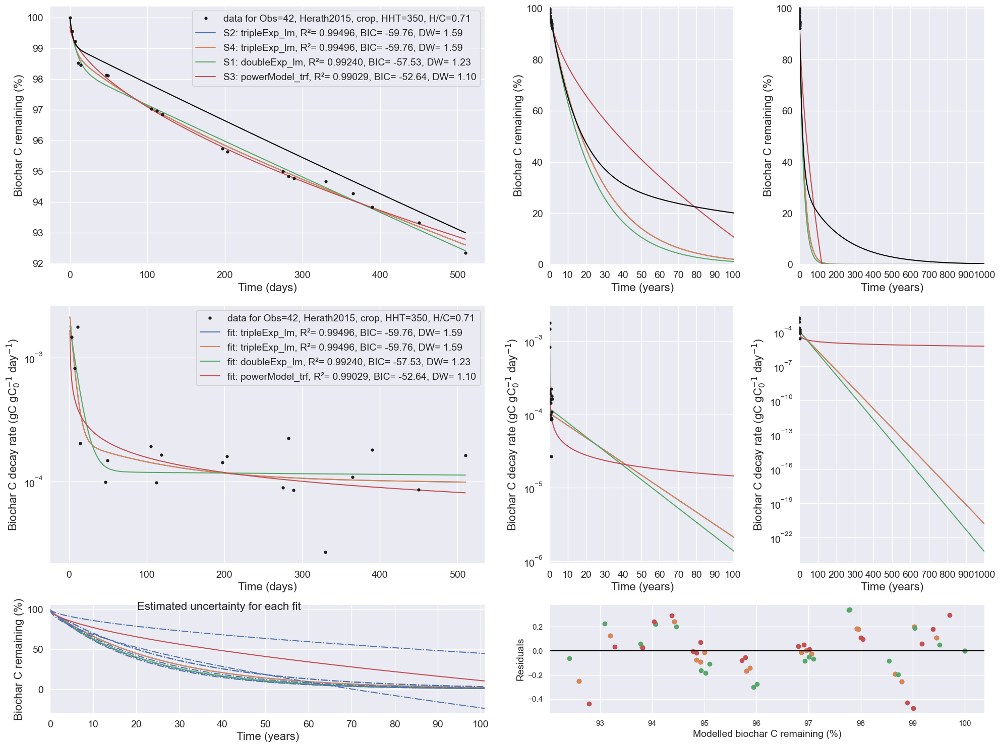

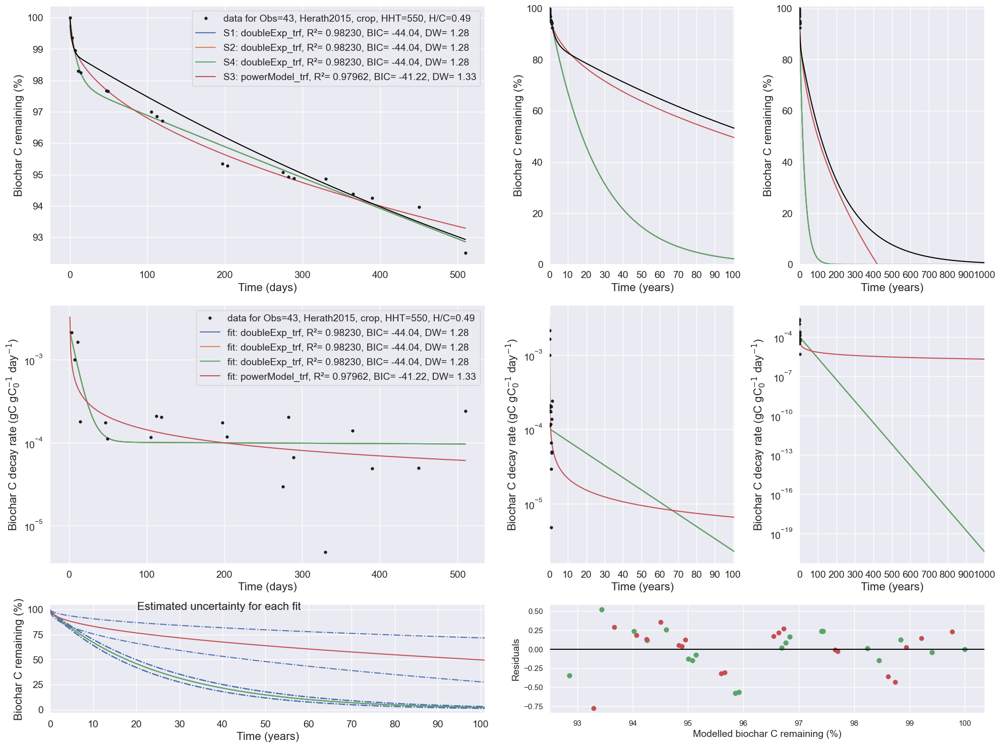

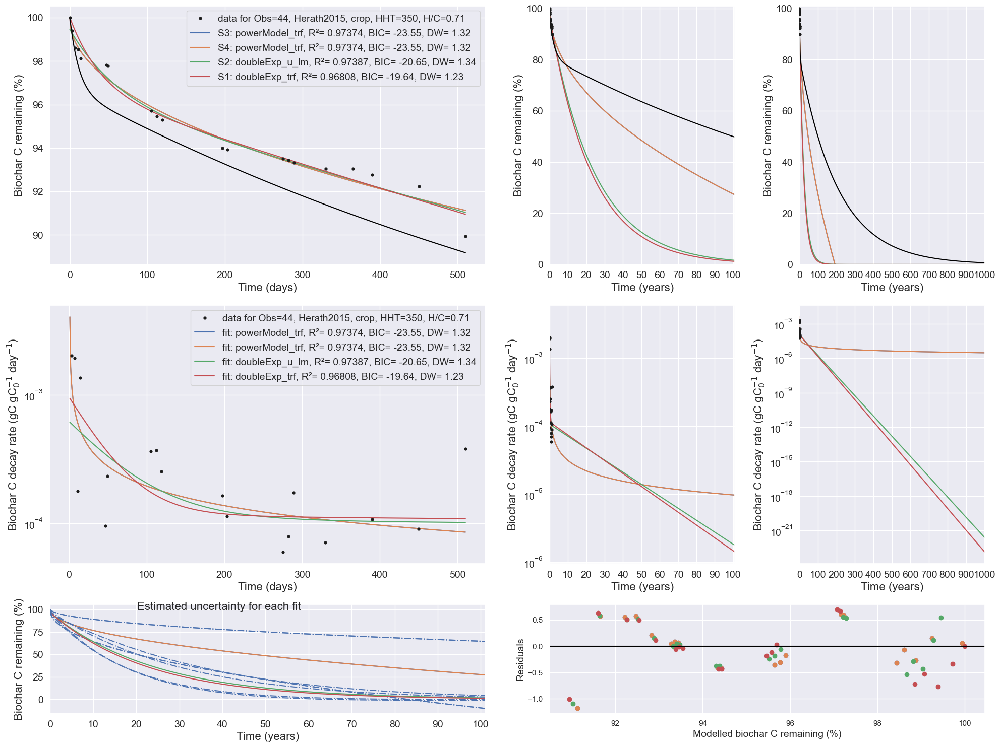

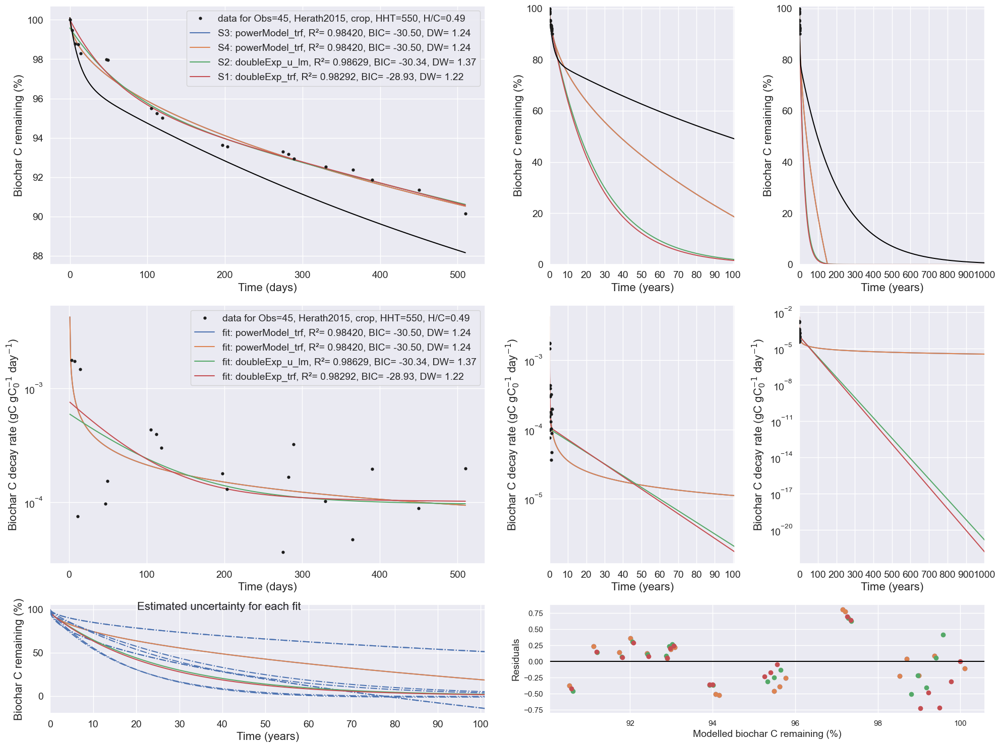

In [138]:
for z, j in enumerate(metaAubertinHerath.index[0:4]):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=False)
        
        _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1)  # factor 1 (no conversion, unit gC/gC0/day)
    
    except Exception:
        #raise(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    #t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
    #                 x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

    r = 5
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # C remaining, exp duration
    ax2 = plt.subplot(r,c,(3, 7)) # C remaining, 100 years
    ax3 = plt.subplot(r,c,(4, 8)) # C remaining, 1000 years
    
    ax4 = plt.subplot(r,c, (9, 14)) # decay rates, exp duration
    ax5 = plt.subplot(r,c,(11, 15)) # decay rates, 100 years
    ax6 = plt.subplot(r,c,(12, 16)) # decay rates, 1000 years
    
    ax7 = plt.subplot(r,c,(17, 18)) # uncertainty propagated, C remaining, 100 years
    ax8 = plt.subplot(r,c,(19, 20)) # residuals
    #ax9 = plt.subplot(r,c,(21, 24)) # some table

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1001, ax=ax3, fig=fig)

    _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1/100, ax=ax4, fig=fig)
    _, ax5 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=101, factor=1/100, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=1001, factor=1/100, ax=ax6, fig=fig)
    
    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)
    _, ax8 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax8, fig=fig)

    xdata1000 = np.arange(0, 365*1001, 10)
    ax1.plot(xdataHighRes, bs.tripleExp_u(xdataHighRes, *HerathCurveFits[z]), color='black')
    ax2.plot(xdata1000, bs.tripleExp_u(xdata1000, *HerathCurveFits[z]), color='black')
    ax3.plot(xdata1000, bs.tripleExp_u(xdata1000, *HerathCurveFits[z]), color='black')
    
    fig.tight_layout()
    

### Fitting: decay rates, k_bc_rel0

__Step 1:__ Load the data

In [61]:
# step 1: load the data
fp = 'biocharStability/database/biochar_incubation_database_2022-03-22_live.xlsx'
metadata, schema, metadata_column_sets = bs.load_metadata(filepath=fp)
data = bs.load_data(filepath=fp)
articles = bs.load_articles(filepath=fp)
validation = bs.load_validation(filepath=fp)

FileNotFoundError: [Errno 2] No such file or directory: 'biocharStability/database/biochar_incubation_database_2022-03-22_live.xlsx'

__Step 2:__ Define curve-fitting strategies, using various kinds of model functions, initial conditions, algorithm 

A curve-fitting strategy is made of two parts:

- parameters to perform a series of fits, which includes:
    - Model functions: single, double, triple exponentials in constrained and unconstrained forms, and power model
    - Initial conditions: initial values for parameters of above models, can improve fit results for hard-to-fit observations
    - [Boundaries: let free seems to work, i.e. -np.Inf, np.Inf]
    - Fitting algorithm: lm, trf, [dogbox]
    - Fitting library: scipy, lmfit
    
    
    
- criteria to select the best-fit, which includes: 
    - Model functions considered: single, double, triple exponentials in constrained and unconstrained forms, and power model
    - Checks on:
        - positivity of decay rates (for exponential models)
        - positivity of pool sizes (for exponential models)
        - pool sizes below 100% (for exponential models)
        - parameter constrained, i.e. parameter value < standard deviation of parameter, in absolute value
    - Goodness of fit indicator: BIC, AIC, r2, r2a ; ('bic', True) means lowest BIC is best, ('r2', False) means highest r2 is best

Note: in the lists above, the items in square brackets [...] are not used here but were tested during the project. 

In [ ]:
# defining parameters to perform a series of fits
parameters_for_series_of_fits_k = [
    # single exp, 100% at t0
    (bs.k_singleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ), 
    (bs.k_singleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
    
    # single exp, unconstrained
    (bs.k_singleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_singleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),

    # double exp, 100% at t0
    (bs.k_doubleExp, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_doubleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(doubleExp, 'trf',    ( (0, 0, 0), (1000, 1000, 100) ) ), # 0 < k1 < 1000, 0 < k2 < 1000,  0< c1 <100
        #(doubleExp, 'trf',    ( (0, 0, 0), (50, 1, 100) ) ), # 0 < k1 < 50, 0 < k2 < 1,  0< c1 <100
        # with p0
        (bs.k_doubleExp, 'lm', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'lm', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'lm', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'lm', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),

        (bs.k_doubleExp, 'trf', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'trf', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'trf', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp, 'trf', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),
        
    # double exp, unconstrained
    (bs.k_doubleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_doubleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with p0
        (bs.k_doubleExp_u, 'lm', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'lm', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'lm', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'lm', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),

        (bs.k_doubleExp_u, 'trf', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'trf', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'trf', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_doubleExp_u, 'trf', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        
    # triple exp, 100% at t0
    (bs.k_tripleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_tripleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.k_tripleExp, 'lm',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'lm',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'lm',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.k_tripleExp, 'trf',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'trf',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp, 'trf',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
          
    # triple exp, unconstrained
    (bs.k_tripleExp_u, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_tripleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.k_tripleExp_u, 'lm',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'lm',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'lm',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.k_tripleExp_u, 'trf',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'trf',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.k_tripleExp_u, 'trf',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
    # power model (infinite pool)
    (bs.k_powerModel, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.k_powerModel, 'trf',  None, ( (-1*np.inf), (np.inf) ) ),
    #(powerModel, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
]

__Step 3:__ Perform the fits

In [13]:
# performing all fits
day_run = datetime.today().strftime('%Y-%m-%d')
df_scipy_fits = bs.fit_all_observations(data, metadata, fitting_strategies=parameters_for_series_of_fits_k,
                                        library ='scipy', variable='k_bc_rel0', factor=1,
                                        excel='simulations/manuscript/curve-fitting_onRates_newMF_scipy_allfits_v'+day_run+'.xlsx')

df_lmfit_fits = bs.fit_all_observations(data, metadata, fitting_strategies=parameters_for_series_of_fits_k,
                                        library ='lmfit', variable='k_bc_rel0', factor=1,
                                        excel='simulations/manuscript/curve-fitting_onRates_newMF_lmfit_allfits_v'+day_run+'.xlsx')

df_all_fits = bs.merge_dfs([df_scipy_fits, df_lmfit_fits], 
                           saveTo='simulations/manuscript/curve-fitting_onRates_newMF_alllibs_allfits_v'+day_run+'.xlsx')

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_d

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt


26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\

5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Opti

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached m

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bio

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, in

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Numbe

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\o

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 1

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleE

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\git

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) #

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\g

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progres

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharSta

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_d

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabi

17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x000001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: in

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08,

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tri

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaco

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x00000

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered 

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) #

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\gith

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) #

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability

15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <func

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100,

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\g

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found:

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement 

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\an

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.ex

20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has re

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteratio

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parame

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value e

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_d

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as me

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  ret

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <fu

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(m

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharSt

5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabi

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_ma

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 're

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_d

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_lsq\common.py:234: RuntimeWarning: overflow encountered in double_scalars
  ratio = actual_reduction / predicted_reduction
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iter

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\an

27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Numb

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doub

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is ex

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sq

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.lo

7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\git

15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\e

4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 t

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabi

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\an

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progr

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of cal

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value e

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+

Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: N

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of cal

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <funct

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value e

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStab

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\bio

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:

2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 t

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow e

17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function k_doubleExp at 0x

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 1

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: Number of call

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encou

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <funct

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C87

C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encount

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_dou

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharSt

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C87

C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exc

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  retu

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-

25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x00000

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: 

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.ex

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progr

7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\ana

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStabil

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by

Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <fu

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteratio

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k

27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Numbe

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\bio

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameter

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <fu

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\bioc

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reach

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x000

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function k_doubleExp at 0x0000

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStabilit

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached max

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function eva

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, Run

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C8

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each p

8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not fo

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpa

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfe

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tri

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\bio

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(d

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 's

32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 12

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function k_doubleExp

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(d

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reach

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 600.
3 trf <functio

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: Runtim

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, i

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.

9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_d

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001,

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStab

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E3

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_

8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleE

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001,

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  ret

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exc

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the 

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStabil

32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anac

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value e

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 1

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleE

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The it

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\an

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C85

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progre

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C879

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)

7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u a

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improv

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <funct

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github

8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf

C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C85

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\o

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\e

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <functio

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*

Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * n

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C879

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found:

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Numb

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, in

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '

7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleE

C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68

3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached max

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\gith

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.lo

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached ma

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceede

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\s

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: inval

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\an

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reache

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\bio

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improv

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\g

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in multiply
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Runtime

35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <func

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement 

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) *

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x000001

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\ana

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\g

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\g

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x000001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analys

2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Opti

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  ret

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biochar

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\o

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 5

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_

33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_lsq\common.py:234: RuntimeWarning: overflow encountered in double_scalars
  ratio = actual_reduction / predicted_reduction


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_ma

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard d

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by 

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\bio

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: over

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  retur

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warn

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value e

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(

29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Numbe

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matri

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_double

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warni

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_ma

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = 

27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not fou

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last te

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_m

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.ex

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_dou

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not b

13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Numbe

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_ma

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progr

14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packa

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 5

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\

44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x00

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each p

8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_double

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\an

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matri

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optim

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\

17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scip

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) #

39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnin

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The it

12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
2

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
35 trf <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\

21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reache

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\git

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 t

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as

24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not fou

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\an

45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\bioc

20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\

7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not foun

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: invalid value encountered in add
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: invalid value encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\o

0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_d

C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow e

20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in multiply
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix

Optimal parameters not found: Number of calls to function has reached maxfev = 800.
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubl

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progr

Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_lsq\common.py:234: RuntimeWarning: overflow encountered in double_scalars
  ratio = actual_reduction / predicted_reduction
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:392: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:442: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singl

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progr

16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the la

41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero 

4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\a

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleEx

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero 

11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
Opt

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\anal

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\git

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( 

18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c

26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <funct

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal paramet

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <fu

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharS

43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at

C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:100: RuntimeWarning: divide by zero encountered in power
  return (-c0 * np.exp(b) * t**m)/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encounter

19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
Optim

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '

6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
16 lm <function k_doubleExp_u at 0x0000

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:380: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:381: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\gi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1,

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement 

34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function k_tripleExp_u at 0x0000018C3E5C88

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:387: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: T

42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 20
    # variables        = 1
    chi-square         = 6.8406e-07
    reduced chi-square = 3.6003e-08
    Akaike info crit   = -341.819073
    Bayesian info crit = -340.823341
[[Variables]]
    k:  7.2064e-05 +/- 4.3599e-05 (60.50%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 20
    # variables        = 1
    chi-square         = 6.8406e-07
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 20
    # variables        = 3
    chi-square         = 4.3025e-07
    reduced chi-square = 2.5309e-08
    Akaike info crit   = -347.092726
    Bayesian info crit = -344.105529
[[Variables]]
    k1:  0.06961087 +/- 0.05678933 (81.58%) (init = 0)
    k2:  2.1309e-05 +/- 3.7567e-05 (176.30%) (init = 0)
    c1:  0.55401967 +/- 0.45234578 (81.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k2, c1) = -0.306
    C(k1, k2) = 0.185
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 20
    # variables        = 3
    chi-square         = 4.3025e-07
    reduced chi-square = 2.5309e-08
    Akaike info crit   = -347.092726
    Bayesian info crit = -344.105529
[[Variables]]
    k1:  0.06961087 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 4.3762e-07
    reduced chi-square = 2.7351e-08
    Akaike info crit   = -344.752764
    Bayesian info crit = -340.769835
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.06349834 +/- 0.05292750 (83.35%) (init = 0)
    k2:  0.22618956 +/-        nan (nan%) (init = 0)
    c1:  0.64027565 +/- 0.51019009 (79.68%) (init = 0)
    c2:  5.4867e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.934
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 4.3762e-07
    reduced chi-square = 2.7351e-08
    Akaike info crit   = -344.7527

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 4.3762e-07
    reduced chi-square = 2.7351e-08
    Akaike info crit   = -344.752764
    Bayesian info crit = -340.769835
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.06349834 +/- 0.05292750 (83.35%) (init = 0)
    k2:  0.22618956 +/-        nan (nan%) (init = 0)
    c1:  0.64027565 +/- 0.51019009 (79.68%) (init = 0)
    c2:  5.4867e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.934
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 4.3762e-07
    reduced chi-square = 2.7351e-08
    Akaike info crit   = -344.752

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square         = 4.3025e-07
    reduced chi-square = 2.8683e-08
    Akaike info crit   = -343.092730
    Bayesian info crit = -338.114069
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06962183 +/- 0.06041075 (86.77%) (init = 0)
    k2:  0.40244862 +/-        nan (nan%) (init = 0)
    k3:  2.1367e-05 +/- 3.9982e-05 (187.12%) (init = 0)
    c1:  0.55366025 +/- 0.48082834 (86.85%) (init = 0)
    c2:  7.8363e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k3, c1) = -0.306
    C(k1, k3) = 0.184
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square         = 4.3025e-07
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square         = 4.3025e-07
    reduced chi-square = 2.8683e-08
    Akaike info crit   = -343.092730
    Bayesian info crit = -338.114069
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06962183 +/- 0.06041075 (86.77%) (init = 0)
    k2:  0.40244862 +/-        nan (nan%) (init = 0)
    k3:  2.1367e-05 +/- 3.9982e-05 (187.12%) (init = 0)
    c1:  0.55366025 +/- 0.48082834 (86.85%) (init = 0)
    c2:  7.8363e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k3, c1) = -0.306
    C(k1, k3) = 0.184
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square         = 4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square         = 4.3025e-07
    reduced chi-square = 2.8683e-08
    Akaike info crit   = -343.092730
    Bayesian info crit = -338.114069
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06962183 +/- 0.06041075 (86.77%) (init = 0)
    k2:  0.40244862 +/-        nan (nan%) (init = 0)
    k3:  2.1367e-05 +/- 3.9982e-05 (187.12%) (init = 0)
    c1:  0.55366025 +/- 0.48082834 (86.85%) (init = 0)
    c2:  7.8363e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k3, c1) = -0.306
    C(k1, k3) = 0.184
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 20
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 393
    # data points      = 20
    # variables        = 6
    chi-square         = 4.2968e-07
    reduced chi-square = 3.0692e-08
    Akaike info crit   = -341.118976
    Bayesian info crit = -335.144582
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.18784862 +/-        nan (nan%) (init = 0)
    k2:  0.07363639 +/- 0.07438179 (101.01%) (init = 0)
    k3:  0.00221710 +/- 0.01625223 (733.04%) (init = 0)
    c1:  2.4675e-10 +/-        nan (nan%) (init = 0)
    c2:  0.50038286 +/- 0.62359552 (124.62%) (init = 0)
    c3:  1.70610698 +/- 7.48471642 (438.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
    C(k3, c3) = -0.896
    C(k3, c2) = -0.604
    C(k2, k3) = 0.387
    C(c2, c3) = 0.372
    C(k2, c3) = -0.230
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting met

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 393
    # data points      = 20
    # variables        = 6
    chi-square         = 4.2968e-07
    reduced chi-square = 3.0692e-08
    Akaike info crit   = -341.118976
    Bayesian info crit = -335.144582
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.18784862 +/-        nan (nan%) (init = 0)
    k2:  0.07363639 +/- 0.07438179 (101.01%) (init = 0)
    k3:  0.00221710 +/- 0.01625223 (733.04%) (init = 0)
    c1:  2.4675e-10 +/-        nan (nan%) (init = 0)
    c2:  0.50038286 +/- 0.62359552 (124.62%) (init = 0)
    c3:  1.70610698 +/- 7.48471642 (438.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
    C(k3, c3) = -0.896
    C(k3, c2) = -0.604
    C(k2, k3) = 0.387
    C(c2, c3) = 0.372
    C(k2, c3) = -0.230
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statis

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 393
    # data points      = 20
    # variables        = 6
    chi-square         = 4.2968e-07
    reduced chi-square = 3.0692e-08
    Akaike info crit   = -341.118976
    Bayesian info crit = -335.144582
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.18784862 +/-        nan (nan%) (init = 0)
    k2:  0.07363639 +/- 0.07438179 (101.01%) (init = 0)
    k3:  0.00221710 +/- 0.01625223 (733.04%) (init = 0)
    c1:  2.4675e-10 +/-        nan (nan%) (init = 0)
    c2:  0.50038286 +/- 0.62359552 (124.62%) (init = 0)
    c3:  1.70610698 +/- 7.48471642 (438.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
    C(k3, c3) = -0.896
    C(k3, c2) = -0.604
    C(k2, k3) = 0.387
    C(c2, c3) = 0.372
    C(k2, c3) = -0.230
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statisti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 393
    # data points      = 20
    # variables        = 6
    chi-square         = 4.2968e-07
    reduced chi-square = 3.0692e-08
    Akaike info crit   = -341.118976
    Bayesian info crit = -335.144582
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.18784862 +/-        nan (nan%) (init = 0)
    k2:  0.07363639 +/- 0.07438179 (101.01%) (init = 0)
    k3:  0.00221710 +/- 0.01625223 (733.04%) (init = 0)
    c1:  2.4675e-10 +/-        nan (nan%) (init = 0)
    c2:  0.50038286 +/- 0.62359552 (124.62%) (init = 0)
    c3:  1.70610698 +/- 7.48471642 (438.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
    C(k3, c3) = -0.896
    C(k3, c2) = -0.604
    C(k2, k3) = 0.387
    C(c2, c3) = 0.372
    C(k2, c3) = -0.230
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Stati

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 393
    # data points      = 20
    # variables        = 6
    chi-square         = 4.2968e-07
    reduced chi-square = 3.0692e-08
    Akaike info crit   = -341.118976
    Bayesian info crit = -335.144582
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.18784862 +/-        nan (nan%) (init = 0)
    k2:  0.07363639 +/- 0.07438179 (101.01%) (init = 0)
    k3:  0.00221710 +/- 0.01625223 (733.04%) (init = 0)
    c1:  2.4675e-10 +/-        nan (nan%) (init = 0)
    c2:  0.50038286 +/- 0.62359552 (124.62%) (init = 0)
    c3:  1.70610698 +/- 7.48471642 (438.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
    C(k3, c3) = -0.896
    C(k3, c2) = -0.604
    C(k2, k3) = 0.387
    C(c2, c3) = 0.372
    C(k2, c3) = -0.230
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statist

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data points      = 12
    # variables        = 3
    chi-square         = 9.1690e-09
    reduced chi-square = 1.0188e-09
    Akaike info crit   = -245.908179
    Bayesian info crit = -244.453460
[[Variables]]
    k1:  0.02623014 +/- 0.02147541 (81.87%) (init = 0)
    k2:  5.0404e-11 +/- 4.3725e-08 (86748.52%) (init = 0)
    c1:  0.22429825 +/- 0.16136806 (71.94%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.918
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data points      = 12
    # variables        = 3
    chi-square         = 9.1690e-09
    reduced chi-square = 1.0188e-09
    Akaike info crit   = -245.908179
    Bayesian info crit = -244.453460
[[Variables]]
    k1:  0.02623014 +/- 0.02147541 (81.87%) (init = 0)
    k2:  5.0404e-11 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 12
    # variables        = 4
    chi-square         = 9.1689e-09
    reduced chi-square = 1.1461e-09
    Akaike info crit   = -243.908205
    Bayesian info crit = -241.968578
[[Variables]]
    k1:  0.02623043 +/- 0.12942179 (493.40%) (init = 0)
    k2:  0.02614387 +/- 0.03375532 (129.11%) (init = 0)
    c1:  0.03694620 +/- 2.69936912 (7306.22%) (init = 0)
    c2:  0.18805716 +/- 2.70427402 (1438.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.608
    C(k1, c1) = -0.190
    C(k1, c2) = 0.179
    C(k2, c2) = -0.144
    C(k2, c1) = 0.104
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 12
    # variables        = 4
    chi-square         = 9.1689e-09
    reduced chi-square

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 12
    # variables        = 4
    chi-square         = 9.1689e-09
    reduced chi-square = 1.1461e-09
    Akaike info crit   = -243.908205
    Bayesian info crit = -241.968578
[[Variables]]
    k1:  0.02623043 +/- 0.12942179 (493.40%) (init = 0)
    k2:  0.02614387 +/- 0.03375532 (129.11%) (init = 0)
    c1:  0.03694620 +/- 2.69936912 (7306.22%) (init = 0)
    c2:  0.18805716 +/- 2.70427402 (1438.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.608
    C(k1, c1) = -0.190
    C(k1, c2) = 0.179
    C(k2, c2) = -0.144
    C(k2, c1) = 0.104
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         = 9.1616e-09
    reduced chi-square = 1.3088e-09
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         = 9.1616e-09
    reduced chi-square = 1.3088e-09
    Akaike info crit   = -241.917851
    Bayesian info crit = -239.493317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02730798 +/- 0.02628963 (96.27%) (init = 0)
    k2:  7.1364e-05 +/-        nan (nan%) (init = 0)
    k3:  1.3152e-06 +/- 6.9757e-06 (530.37%) (init = 0)
    c1:  0.21099238 +/- 0.18839679 (89.29%) (init = 0)
    c2:  3.5846e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.912
    C(k3, c1) = -0.383
    C(k1, k3) = 0.237
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         = 9.1616e-09
    reduced chi-square = 1.3088e-09
    Akaike info crit   = -241.917851
    Bayesian info crit = -239.493317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02730798 +/- 0.02628963 (96.27%) (init = 0)
    k2:  7.1364e-05 +/-        nan (nan%) (init = 0)
    k3:  1.3152e-06 +/- 6.9757e-06 (530.37%) (init = 0)
    c1:  0.21099238 +/- 0.18839679 (89.29%) (init = 0)
    c2:  3.5846e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.912
    C(k3, c1) = -0.383
    C(k1, k3) = 0.237
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         = 9.1616e-09
    reduced chi-square = 1.3088e-09
    Akaike info crit   = -241.917851
    Bayesian info crit = -239.493317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02730798 +/- 0.02628963 (96.27%) (init = 0)
    k2:  7.1364e-05 +/-        nan (nan%) (init = 0)
    k3:  1.3152e-06 +/- 6.9757e-06 (530.37%) (init = 0)
    c1:  0.21099238 +/- 0.18839679 (89.29%) (init = 0)
    c2:  3.5846e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.912
    C(k3, c1) = -0.383
    C(k1, k3) = 0.237
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 12
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # variables        = 6
    chi-square         = 9.1689e-09
    reduced chi-square = 1.5282e-09
    Akaike info crit   = -239.908201
    Bayesian info crit = -236.998761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02625068 +/- 0.16446782 (626.53%) (init = 0)
    k2:  0.02611870 +/- 0.04004156 (153.31%) (init = 0)
    k3:  0.02609115 +/- 0.26967544 (1033.59%) (init = 0)
    c1:  0.02992171 +/-        nan (nan%) (init = 0)
    c2:  0.18328252 +/-        nan (nan%) (init = 0)
    c3:  0.01182427 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.508
    C(k2, k3) = -0.308
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # variables        = 6
    chi-square         = 9.1689e-09
    reduced chi-square = 1.5282e-09
    Akaike info crit   = -239.908201
    Bayesian info crit = -236.998761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02625068 +/- 0.16446782 (626.53%) (init = 0)
    k2:  0.02611870 +/- 0.04004156 (153.31%) (init = 0)
    k3:  0.02609115 +/- 0.26967544 (1033.59%) (init = 0)
    c1:  0.02992171 +/-        nan (nan%) (init = 0)
    c2:  0.18328252 +/-        nan (nan%) (init = 0)
    c3:  0.01182427 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.508
    C(k2, k3) = -0.308
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # variables        = 6
    chi-square         = 9.1689e-09
    reduced chi-square = 1.5282e-09
    Akaike info crit   = -239.908201
    Bayesian info crit = -236.998761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02625068 +/- 0.16446782 (626.53%) (init = 0)
    k2:  0.02611870 +/- 0.04004156 (153.31%) (init = 0)
    k3:  0.02609115 +/- 0.26967544 (1033.59%) (init = 0)
    c1:  0.02992171 +/-        nan (nan%) (init = 0)
    c2:  0.18328252 +/-        nan (nan%) (init = 0)
    c3:  0.01182427 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.508
    C(k2, k3) = -0.308
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 247
    # data points      = 12
    # v

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 2.1672e-08
    reduced chi-square = 2.4080e-09
    Akaike info crit   = -235.585816
    Bayesian info crit = -234.131096
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 11
    # variables        = 1
    chi-square         = 2.3306e-09
    reduced chi-square = 2.3306e-10
    Akaike info crit   = -243.025625
    Bayesian info crit = -242.627729
[[Variables]]
    k:  1.3236e-05 +/- 4.1750e-06 (31.54%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 11
    # variables        = 3
    chi-square         = 1.5645e-09
    reduced chi-square = 1.9557e-10
    Akaike info crit   = -243.409251
    Bayesian info crit = -242.215566
[[Variables]]
    k1:  0.00875304 +/- 0.00737300 (84.23%) (init = 0)
    k2:  7.7900e-09 +/- 2.3028e-07 (2956.02%) (init = 0)
    c1:  0.26172768 +/- 0.18908393 (72.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 11
    # variables        = 3
    chi-square         = 1.5645e-09
    reduced chi-square = 1.9557e-10
    Akaike info crit   = -243.409251
    Bayesian info crit = -242.215566
[[Variables]]
    k1:  0.00875304 +/- 0.00737300 (84.23%) (init = 0)
    k2:  7.7900e-0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 11
    # variables        = 4
    chi-square         = 1.5645e-09
    reduced chi-square = 2.2350e-10
    Akaike info crit   = -241.409533
    Bayesian info crit = -239.817951
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00874286 +/- 0.00783746 (89.64%) (init = 0)
    k2:  0.04521159 +/-        nan (nan%) (init = 0)
    c1:  0.26165379 +/- 0.20112397 (76.87%) (init = 0)
    c2:  4.5442e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 11
    # variables        = 4
    chi-square         = 1.5645e-09
    reduced chi-square = 2.2350e-10
    Akaike info crit   = -241.409533


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 11
    # variables        = 4
    chi-square         = 1.5645e-09
    reduced chi-square = 2.2350e-10
    Akaike info crit   = -241.409533
    Bayesian info crit = -239.817951
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00874286 +/- 0.00783746 (89.64%) (init = 0)
    k2:  0.04521159 +/-        nan (nan%) (init = 0)
    c1:  0.26165379 +/- 0.20112397 (76.87%) (init = 0)
    c2:  4.5442e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 11
    # variables        = 5
    chi-square         = 1.5645e-09
    reduced chi-square = 2.6075e-10
    Akaike info crit   = -239.409525
    Bayesian info

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 11
    # variables        = 5
    chi-square         = 1.5645e-09
    reduced chi-square = 2.6075e-10
    Akaike info crit   = -239.409525
    Bayesian info crit = -237.420048
[[Variables]]
    k1:  0.00878643 +/- 0.01042355 (118.63%) (init = 0)
    k2:  0.00876957 +/- 0.04623681 (527.24%) (init = 0)
    k3:  2.6851e-10 +/- 4.9384e-08 (18392.07%) (init = 0)
    c1:  0.23110601 +/- 1.16775468 (505.29%) (init = 0)
    c2:  0.03015889 +/- 1.15085734 (3815.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.982
    C(k1, k2) = -0.411
    C(k1, c1) = -0.283
    C(k2, c2) = -0.258
    C(k2, c1) = 0.223
    C(k1, c2) = 0.144
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 11
    # variables    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 11
    # variables        = 5
    chi-square         = 1.5645e-09
    reduced chi-square = 2.6075e-10
    Akaike info crit   = -239.409525
    Bayesian info crit = -237.420048
[[Variables]]
    k1:  0.00878643 +/- 0.01042355 (118.63%) (init = 0)
    k2:  0.00876957 +/- 0.04623681 (527.24%) (init = 0)
    k3:  2.6851e-10 +/- 4.9384e-08 (18392.07%) (init = 0)
    c1:  0.23110601 +/- 1.16775468 (505.29%) (init = 0)
    c2:  0.03015889 +/- 1.15085734 (3815.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.982
    C(k1, k2) = -0.411
    C(k1, c1) = -0.283
    C(k2, c2) = -0.258
    C(k2, c1) = 0.223
    C(k1, c2) = 0.144
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 11
    # variables        =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 11
    # variables        = 6
    chi-square         = 1.5645e-09
    reduced chi-square = 3.1290e-10
    Akaike info crit   = -237.409566
    Bayesian info crit = -235.022194
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  0.00876401 +/- 0.00931909 (106.33%) (init = 0)
    k2:  7.7546e-09 +/-        nan (nan%) (init = 0)
    k3:  7.1043e-10 +/-        nan (nan%) (init = 0)
    c1:  0.26144360 +/- 0.23838375 (91.18%) (init = 0)
    c2:  0.06275137 +/-        nan (nan%) (init = 0)
    c3:  0.03147599 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 11
    # variables        = 6
    chi-square         = 1.5645e-09
    reduced chi-square = 3.1290e-10
    Akaike info crit   = -237.409566
    Bayesian info crit = -235.022194
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  0.00876401 +/- 0.00931909 (106.33%) (init = 0)
    k2:  7.7546e-09 +/-        nan (nan%) (init = 0)
    k3:  7.1043e-10 +/-        nan (nan%) (init = 0)
    c1:  0.26144360 +/- 0.23838375 (91.18%) (init = 0)
    c2:  0.06275137 +/-        nan (nan%) (init = 0)
    c3:  0.03147599 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 11


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 11
    # variables        = 6
    chi-square         = 1.5645e-09
    reduced chi-square = 3.1290e-10
    Akaike info crit   = -237.409566
    Bayesian info crit = -235.022194
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  0.00876401 +/- 0.00931909 (106.33%) (init = 0)
    k2:  7.7546e-09 +/-        nan (nan%) (init = 0)
    k3:  7.1043e-10 +/-        nan (nan%) (init = 0)
    c1:  0.26144360 +/- 0.23838375 (91.18%) (init = 0)
    c2:  0.06275137 +/-        nan (nan%) (init = 0)
    c3:  0.03147599 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 11
    # variables        = 6
    chi-square         = 1.5645e-09
    reduced chi-square = 3.1290e-10
    Akaike info crit   = -237.409566
    Bayesian info crit = -235.022194
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
    k3:  at boundary
[[Variables]]
    k1:  0.00876401 +/- 0.00931909 (106.33%) (init = 0)
    k2:  7.7546e-09 +/-        nan (nan%) (init = 0)
    k3:  7.1043e-10 +/-        nan (nan%) (init = 0)
    c1:  0.26144360 +/- 0.23838375 (91.18%) (init = 0)
    c2:  0.06275137 +/-        nan (nan%) (init = 0)
    c3:  0.03147599 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        =

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 11
    # variables        = 3
    chi-square         = 1.6191e-09
    reduced chi-square = 2.0239e-10
    Akaike info crit   = -243.032136
    Bayesian info crit = -241.838450
[[Variables]]
    k1:  0.01523156 +/- 0.01072156 (70.39%) (init = 0)
    k2:  1.8800e-09 +/- 1.1644e-07 (6193.46%) (init = 0)
    c1:  0.18882038 +/- 0.11258529 (59.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 11
    # variables        = 3
    chi-square         = 1.6191e-09
    reduced chi-square = 2.0239e-10
    Akaike info crit   = -243.032136
    Bayesian info crit = -241.838450
[[Variables]]
    k1:  0.01523156 +/- 0.01072156 (70.39%) (init = 0)
    k2:  1.8800e-09 +/-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 11
    # variables        = 4
    chi-square         = 1.6191e-09
    reduced chi-square = 2.3131e-10
    Akaike info crit   = -241.031894
    Bayesian info crit = -239.440313
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01527654 +/- 0.01147208 (75.10%) (init = 0)
    k2:  0.02248826 +/-        nan (nan%) (init = 0)
    c1:  0.18783390 +/- 0.11726755 (62.43%) (init = 0)
    c2:  2.2494e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.912
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 11
    # variables        = 4
    chi-square         = 1.6191e-09
    reduced chi-square = 2.3131e-10
    Akaike info crit   = -241.031894
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 11
    # variables        = 4
    chi-square         = 1.6191e-09
    reduced chi-square = 2.3131e-10
    Akaike info crit   = -241.031894
    Bayesian info crit = -239.440313
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01527654 +/- 0.01147208 (75.10%) (init = 0)
    k2:  0.02248826 +/-        nan (nan%) (init = 0)
    c1:  0.18783390 +/- 0.11726755 (62.43%) (init = 0)
    c2:  2.2494e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.912
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 11
    # variables        = 4
    chi-square         = 1.6191e-09
    reduced chi-square = 2.3131e-10
    Akaike info crit   = -241.031894
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables        = 5
    chi-square         = 1.6191e-09
    reduced chi-square = 2.6985e-10
    Akaike info crit   = -239.032162
    Bayesian info crit = -237.042686
[[Variables]]
    k1:  0.01524618 +/- 0.02787539 (182.84%) (init = 0)
    k2:  0.01534260 +/- 0.02478601 (161.55%) (init = 0)
    k3:  4.0540e-10 +/- 6.2548e-08 (15428.80%) (init = 0)
    c1:  0.08537419 +/- 3.32573614 (3895.48%) (init = 0)
    c2:  0.10271537 +/- 3.32588938 (3237.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.545
    C(k2, c2) = -0.301
    C(k2, c1) = 0.284
    C(k1, c1) = -0.184
    C(k1, c2) = 0.169
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables       

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables        = 5
    chi-square         = 1.6191e-09
    reduced chi-square = 2.6985e-10
    Akaike info crit   = -239.032162
    Bayesian info crit = -237.042686
[[Variables]]
    k1:  0.01524618 +/- 0.02787539 (182.84%) (init = 0)
    k2:  0.01534260 +/- 0.02478601 (161.55%) (init = 0)
    k3:  4.0540e-10 +/- 6.2548e-08 (15428.80%) (init = 0)
    c1:  0.08537419 +/- 3.32573614 (3895.48%) (init = 0)
    c2:  0.10271537 +/- 3.32588938 (3237.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.545
    C(k2, c2) = -0.301
    C(k2, c1) = 0.284
    C(k1, c1) = -0.184
    C(k1, c2) = 0.169
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 11
    # variables        = 6
    chi-square         = 1.6191e-09
    reduced chi-square = 3.2383e-10
    Akaike info crit   = -237.031895
    Bayesian info crit = -234.644524
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02171818 +/-        nan (nan%) (init = 0)
    k2:  0.01524491 +/- 0.02097142 (137.56%) (init = 0)
    k3:  0.01536839 +/- 0.04198476 (273.19%) (init = 0)
    c1:  2.4721e-04 +/-        nan (nan%) (init = 0)
    c2:  0.13400057 +/- 1.14001730 (850.76%) (init = 0)
    c3:  0.05417159 +/- 1.13586792 (2096.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k2, k3) = -0.506
    C(k3, c3) = -0.277
    C(k3, c2) = 0.240
    C(k2, c2) = -0.221
    C(k2, c3) = 0.148
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 11
    # variables        = 6
    chi-square         = 1.6191e-09
    reduced chi-square = 3.2383e-10
    Akaike info crit   = -237.031895
    Bayesian info crit = -234.644524
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02171818 +/-        nan (nan%) (init = 0)
    k2:  0.01524491 +/- 0.02097142 (137.56%) (init = 0)
    k3:  0.01536839 +/- 0.04198476 (273.19%) (init = 0)
    c1:  2.4721e-04 +/-        nan (nan%) (init = 0)
    c2:  0.13400057 +/- 1.14001730 (850.76%) (init = 0)
    c3:  0.05417159 +/- 1.13586792 (2096.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k2, k3) = -0.506
    C(k3, c3) = -0.277
    C(k3, c2) = 0.240
    C(k2, c2) = -0.221
    C(k2, c3) = 0.148
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 11
    # variables        = 6
    chi-square         = 1.6191e-09
    reduced chi-square = 3.2383e-10
    Akaike info crit   = -237.031895
    Bayesian info crit = -234.644524
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02171818 +/-        nan (nan%) (init = 0)
    k2:  0.01524491 +/- 0.02097142 (137.56%) (init = 0)
    k3:  0.01536839 +/- 0.04198476 (273.19%) (init = 0)
    c1:  2.4721e-04 +/-        nan (nan%) (init = 0)
    c2:  0.13400057 +/- 1.14001730 (850.76%) (init = 0)
    c3:  0.05417159 +/- 1.13586792 (2096.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k2, k3) = -0.506
    C(k3, c3) = -0.277
    C(k3, c2) = 0.240
    C(k2, c2) = -0.221
    C(k2, c3) = 0.148
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 11
    # variables        = 6
    chi-square         = 1.6191e-09
    reduced chi-square = 3.2383e-10
    Akaike info crit   = -237.031895
    Bayesian info crit = -234.644524
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02171818 +/-        nan (nan%) (init = 0)
    k2:  0.01524491 +/- 0.02097142 (137.56%) (init = 0)
    k3:  0.01536839 +/- 0.04198476 (273.19%) (init = 0)
    c1:  2.4721e-04 +/-        nan (nan%) (init = 0)
    c2:  0.13400057 +/- 1.14001730 (850.76%) (init = 0)
    c3:  0.05417159 +/- 1.13586792 (2096.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k2, k3) = -0.506
    C(k3, c3) = -0.277
    C(k3, c2) = 0.240
    C(k2, c2) = -0.221
    C(k2, c3) = 0.148
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 11
    # variables        = 3
    chi-square         = 2.2827e-09
    reduced chi-square = 2.8533e-10
    Akaike info crit   = -239.253927
    Bayesian info crit = -238.060241
[[Variables]]
    k1:  0.01309570 +/- 0.01022669 (78.09%) (init = 0)
    k2:  5.9448e-08 +/- 7.8653e-07 (1323.06%) (init = 0)
    c1:  0.23993771 +/- 0.15876496 (66.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.103
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 11
    # variables        = 3
    chi-square         = 2.2827e-09
    reduced chi-square = 2.8533e-10
    Akaike info crit   = -239.253927
    Bayesian info crit = -238.060241
[[Variables]]
    k1:  0.01309570 +/- 0.01022669 (78.09%) (init = 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 11
    # variables        = 3
    chi-square         = 2.2827e-09
    reduced chi-square = 2.8533e-10
    Akaike info crit   = -239.253927
    Bayesian info crit = -238.060241
[[Variables]]
    k1:  0.01309570 +/- 0.01022669 (78.09%) (init = 0)
    k2:  5.9448e-08 +/- 7.8653e-07 (1323.06%) (init = 0)
    c1:  0.23993771 +/- 0.15876496 (66.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.103
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables        = 4
    chi-square         = 2.2827e-09
    reduced chi-square = 3.2610e-10
    Akaike info crit   = -237.253959
    Bayesian info crit = -235.662378
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables        = 4
    chi-square         = 2.2827e-09
    reduced chi-square = 3.2610e-10
    Akaike info crit   = -237.253959
    Bayesian info crit = -235.662378
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01308488 +/- 0.01094774 (83.67%) (init = 0)
    k2:  0.03243437 +/-        nan (nan%) (init = 0)
    c1:  0.24111638 +/- 0.17023641 (70.60%) (init = 0)
    c2:  4.3282e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 11
    # variables        = 4
    chi-square         = 2.2827e-09
    reduced chi-square = 3.2610e-10
    Akaike info crit   = -237.253959
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduced chi-square = 3.8045e-10
    Akaike info crit   = -235.253959
    Bayesian info crit = -233.264482
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01303079 +/- 0.02490536 (191.13%) (init = 0)
    k2:  0.01311935 +/- 0.02740095 (208.86%) (init = 0)
    k3:  2.9787e-09 +/- 2.0389e-07 (6844.87%) (init = 0)
    c1:  0.12757784 +/-        nan (nan%) (init = 0)
    c2:  0.11351241 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.595
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduced chi-square = 3.804

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduced chi-square = 3.8045e-10
    Akaike info crit   = -235.253959
    Bayesian info crit = -233.264482
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01303079 +/- 0.02490536 (191.13%) (init = 0)
    k2:  0.01311935 +/- 0.02740095 (208.86%) (init = 0)
    k3:  2.9787e-09 +/- 2.0389e-07 (6844.87%) (init = 0)
    c1:  0.12757784 +/-        nan (nan%) (init = 0)
    c2:  0.11351241 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.595
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduced chi-square = 3.8045e-10
    Akaike info crit   = -235.253959
    Bayesian info crit = -233.264482
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01303079 +/- 0.02490536 (191.13%) (init = 0)
    k2:  0.01311935 +/- 0.02740095 (208.86%) (init = 0)
    k3:  2.9787e-09 +/- 2.0389e-07 (6844.87%) (init = 0)
    c1:  0.12757784 +/-        nan (nan%) (init = 0)
    c2:  0.11351241 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.595
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 11
    # variables        = 5
    chi-square         = 2.2827e-09
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 259
    # data points      = 11
    # variables        = 6
    chi-square         = 2.2827e-09
    reduced chi-square = 4.5653e-10
    Akaike info crit   = -233.253966
    Bayesian info crit = -230.866594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5546e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01307947 +/- 0.02518366 (192.54%) (init = 0)
    k3:  0.01308164 +/- 0.03619417 (276.68%) (init = 0)
    c1:  4.1114e-08 +/-        nan (nan%) (init = 0)
    c2:  0.14720351 +/- 29.6129604 (20117.02%) (init = 0)
    c3:  0.09387964 +/- 29.6078541 (31538.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.618
    C(k3, c3) = -0.293
    C(k3, c2) = 0.291
    C(k2, c2) = -0.275
    C(k2, c3) = 0.272
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 259
    # data points      = 11
    # variables        = 6
    chi-square         = 2.2827e-09
    reduced chi-square = 4.5653e-10
    Akaike info crit   = -233.253966
    Bayesian info crit = -230.866594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5546e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01307947 +/- 0.02518366 (192.54%) (init = 0)
    k3:  0.01308164 +/- 0.03619417 (276.68%) (init = 0)
    c1:  4.1114e-08 +/-        nan (nan%) (init = 0)
    c2:  0.14720351 +/- 29.6129604 (20117.02%) (init = 0)
    c3:  0.09387964 +/- 29.6078541 (31538.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.618
    C(k3, c3) = -0.293
    C(k3, c2) = 0.291
    C(k2, c2) = -0.275
    C(k2, c3) = 0.272
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 259
    # data points      = 11
    # variables        = 6
    chi-square         = 2.2827e-09
    reduced chi-square = 4.5653e-10
    Akaike info crit   = -233.253966
    Bayesian info crit = -230.866594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5546e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01307947 +/- 0.02518366 (192.54%) (init = 0)
    k3:  0.01308164 +/- 0.03619417 (276.68%) (init = 0)
    c1:  4.1114e-08 +/-        nan (nan%) (init = 0)
    c2:  0.14720351 +/- 29.6129604 (20117.02%) (init = 0)
    c3:  0.09387964 +/- 29.6078541 (31538.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.618
    C(k3, c3) = -0.293
    C(k3, c2) = 0.291
    C(k2, c2) = -0.275
    C(k2, c3) = 0.272
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    #

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 11
    # variables        = 3
    chi-square         = 5.9840e-09
    reduced chi-square = 7.4800e-10
    Akaike info crit   = -228.652775
    Bayesian info crit = -227.459090
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 11
    # variables        = 1
    chi-square         = 4.7465e-09
    reduced chi-square = 4.7465e-10
    Akaike info crit   = -235.201367
    Bayesian info crit = -234.803472
[[Variables]]
    k:  1.3236e-05 +/- 6.2256e-06 (47.03%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 11
    # variables        = 3
    chi-square         = 3.7759e-09
    reduced chi-square = 4.7199e-10
    Akaike info crit   = -233.717744
    Bayesian info crit = -232.524058
[[Variables]]
    k1:  0.00938412 +/- 0.01200324 (127.91%) (init = 0)
    k2:  1.9745e-08 +/- 5.9966e-07 (3037.04%) (init = 0)
    c1:  0.29552176 +/- 0.31627379 (107.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.936
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 11
    # variables        = 3
    chi-square         = 3.7759e-09
    reduced chi-square = 4.7199e-10
    Akaike info crit   = -233.717744
    Bayesian info crit = -232.524058
[[Variables]]
    k1:  0.00938412 +/- 0.01200324 (127.91%) (init = 0)
    k2:  1.97

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 11
    # variables        = 4
    chi-square         = 3.7760e-09
    reduced chi-square = 5.3943e-10
    Akaike info crit   = -231.717417
    Bayesian info crit = -230.125835
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00939994 +/- 0.01279428 (136.11%) (init = 0)
    k2:  0.05866015 +/-        nan (nan%) (init = 0)
    c1:  0.29514664 +/- 0.33581230 (113.78%) (init = 0)
    c2:  1.4463e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.935
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 11
    # variables        = 4
    chi-square         = 3.7760e-09
    reduced chi-square = 5.3943e-10
    Akaike info crit   = -231.717417
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 11
    # variables        = 4
    chi-square         = 3.7760e-09
    reduced chi-square = 5.3943e-10
    Akaike info crit   = -231.717417
    Bayesian info crit = -230.125835
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00939994 +/- 0.01279428 (136.11%) (init = 0)
    k2:  0.05866015 +/-        nan (nan%) (init = 0)
    c1:  0.29514664 +/- 0.33581230 (113.78%) (init = 0)
    c2:  1.4463e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.935
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 11
    # variables        = 4
    chi-square         = 3.7760e-09
    reduced chi-square = 5.3943e-10
    Akaike info crit   = -231.717417
    Bayesian in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarnin

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 873
    # data points      = 11
    # variables        = 5
    chi-square         = 3.7704e-09
    reduced chi-square = 6.2839e-10
    Akaike info crit   = -229.733925
    Bayesian info crit = -227.744449
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01092595 +/- 0.01720789 (157.50%) (init = 0)
    k2:  2.0891e-06 +/- 5.0417e-05 (2413.35%) (init = 0)
    k3:  1.8052e-06 +/- 4.6043e-06 (255.06%) (init = 0)
    c1:  0.24022908 +/- 0.36612317 (152.41%) (init = 0)
    c2:  8.19135986 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.001
    C(k1, c1) = -0.915
    C(k2, c1) = -0.636
    C(k3, c1) = -0.579
    C(k1, k2) = 0.428
    C(k1, k3) = 0.390
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 200
    # data points      = 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 200
    # data points      = 11
    # variables        = 6
    chi-square         = 3.7760e-09
    reduced chi-square = 7.5520e-10
    Akaike info crit   = -227.717429
    Bayesian info crit = -225.330057
[[Variables]]
    k1:  0.00945752 +/- 0.63561328 (6720.72%) (init = 0)
    k2:  0.00943067 +/- 0.58526882 (6206.01%) (init = 0)
    k3:  0.00939937 +/- 0.14377379 (1529.61%) (init = 0)
    c1:  0.01978496 +/- 9.59371598 (48489.96%) (init = 0)
    c2:  0.04789456 +/- 20.1080700 (41984.04%) (init = 0)
    c3:  0.22759679 +/- 23.7325028 (10427.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.919
    C(c2, c3) = -0.917
    C(k3, c3) = -0.862
    C(k2, c2) = -0.858
    C(k2, c3) = 0.814
    C(k3, c2) = 0.807
    C(k1, c1) = -0.684
    C(c1, c3) = -0.548
    C(k1, k3) = -0.539
    C(k1, c3) = 0.457
    C(k3, c1) = 0.432
    C(k1, c2) = -0.213
    C(k2, c1) = -0.212
    C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 200
    # data points      = 11
    # variables        = 6
    chi-square         = 3.7760e-09
    reduced chi-square = 7.5520e-10
    Akaike info crit   = -227.717429
    Bayesian info crit = -225.330057
[[Variables]]
    k1:  0.00945752 +/- 0.63561328 (6720.72%) (init = 0)
    k2:  0.00943067 +/- 0.58526882 (6206.01%) (init = 0)
    k3:  0.00939937 +/- 0.14377379 (1529.61%) (init = 0)
    c1:  0.01978496 +/- 9.59371598 (48489.96%) (init = 0)
    c2:  0.04789456 +/- 20.1080700 (41984.04%) (init = 0)
    c3:  0.22759679 +/- 23.7325028 (10427.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.919
    C(c2, c3) = -0.917
    C(k3, c3) = -0.862
    C(k2, c2) = -0.858
    C(k2, c3) = 0.814
    C(k3, c2) = 0.807
    C(k1, c1) = -0.684
    C(c1, c3) = -0.548
    C(k1, k3) = -0.539
    C(k1, c3) = 0.457
    C(k3, c1) = 0.432
    C(k1, c2) = -0.213
    C(k2, c1) = -0.212
    C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 13
    # variables        = 2
    chi-square         = 3.9968e-08
    reduced chi-square = 3.6334e-09
    Akaike info crit   = -250.801797
    Bayesian info crit = -249.671898
[[Variables]]
    k:  0.01405618 +/- 0.01333937 (94.90%) (init = 0)
    c:  0.96568744 +/- 0.80394543 (83.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.961
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 13
    # variables        = 2
    chi-square         = 3.9968e-08
    reduced chi-square = 3.6334e-09
    Akaike info crit   = -250.801797
    Bayesian info crit = -249.671898
[[Variables]]
    k:  0.01405618 +/- 0.01333937 (94.90%) (init = 0)
    c:  0.96568744 +/- 0.80394543 (83.25%) (init = 0)
[[Correlations]] (unreported correlation

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 13
    # variables        = 3
    chi-square         = 3.9722e-08
    reduced chi-square = 3.9722e-09
    Akaike info crit   = -248.882029
    Bayesian info crit = -247.187181
[[Variables]]
    k1:  0.01754247 +/- 0.01746901 (99.58%) (init = 0)
    k2:  1.0023e-05 +/- 1.9930e-05 (198.83%) (init = 0)
    c1:  0.72889230 +/- 0.69247437 (95.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.941
    C(k2, c1) = -0.476
    C(k1, k2) = 0.313
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 13
    # variables        = 3
    chi-square         = 3.9722e-08
    reduced chi-square = 3.9722e-09
    Akaike info crit   = -248.882029
    Bayesian info crit = -247.187181
[[Variables]]
    k1:  0.01754247 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9927e-08
    reduced chi-square = 4.4363e-09
    Akaike info crit   = -246.815204
    Bayesian info crit = -244.555406
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01418438 +/- 0.01361901 (96.01%) (init = 0)
    k2:  0.00177885 +/- 0.02758275 (1550.59%) (init = 0)
    c1:  0.94619789 +/- 0.68075984 (71.95%) (init = 0)
    c2:  0.07016862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.993
    C(k2, c1) = -0.269
    C(k1, k2) = 0.104
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9927e-08
    reduced chi-square = 4.4363e-09
    Ak

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9927e-08
    reduced chi-square = 4.4363e-09
    Akaike info crit   = -246.815204
    Bayesian info crit = -244.555406
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01418438 +/- 0.01361901 (96.01%) (init = 0)
    k2:  0.00177885 +/- 0.02758275 (1550.59%) (init = 0)
    c1:  0.94619789 +/- 0.68075984 (71.95%) (init = 0)
    c2:  0.07016862 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.993
    C(k2, c1) = -0.269
    C(k1, k2) = 0.104
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9927e-08
    reduced chi-square = 4.4363e-09
    A

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 3.9666e-08
    reduced chi-square = 4.9583e-09
    Akaike info crit   = -244.900317
    Bayesian info crit = -242.075571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01610785 +/- 0.01857795 (115.33%) (init = 0)
    k2:  0.02666280 +/-        nan (nan%) (init = 0)
    k3:  7.2791e-06 +/- 2.1922e-05 (301.17%) (init = 0)
    c1:  0.79727880 +/- 0.80306114 (100.73%) (init = 0)
    c2:  0.00509822 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.042
    C(k3, c1) = -0.514
    C(k1, k3) = 0.323
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 3.9666e-08
    reduced chi-square = 4.9583e-09
    Akaike info crit   = -244.900317
    Bayesian info crit = -242.075571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01610785 +/- 0.01857795 (115.33%) (init = 0)
    k2:  0.02666280 +/-        nan (nan%) (init = 0)
    k3:  7.2791e-06 +/- 2.1922e-05 (301.17%) (init = 0)
    c1:  0.79727880 +/- 0.80306114 (100.73%) (init = 0)
    c2:  0.00509822 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.042
    C(k3, c1) = -0.514
    C(k1, k3) = 0.323
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 3.9666e-08
    reduced chi-square = 4.9583e-09
    Akaike info crit   = -244.900317
    Bayesian info crit = -242.075571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01610785 +/- 0.01857795 (115.33%) (init = 0)
    k2:  0.02666280 +/-        nan (nan%) (init = 0)
    k3:  7.2791e-06 +/- 2.1922e-05 (301.17%) (init = 0)
    c1:  0.79727880 +/- 0.80306114 (100.73%) (init = 0)
    c2:  0.00509822 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.042
    C(k3, c1) = -0.514
    C(k1, k3) = 0.323
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    reduced chi-square = 5.6663e-09
    Akaike info crit   = -242.901038
    Bayesian info crit = -239.511341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2880e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01621821 +/- 0.02048992 (126.34%) (init = 0)
    k3:  2.1740e-04 +/-        nan (nan%) (init = 0)
    c1:  1.37904485 +/-        nan (nan%) (init = 0)
    c2:  0.79628154 +/- 0.98342537 (123.50%) (init = 0)
    c3:  2.15746202 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-sq

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    reduced chi-square = 5.6663e-09
    Akaike info crit   = -242.901038
    Bayesian info crit = -239.511341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2880e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01621821 +/- 0.02048992 (126.34%) (init = 0)
    k3:  2.1740e-04 +/-        nan (nan%) (init = 0)
    c1:  1.37904485 +/-        nan (nan%) (init = 0)
    c2:  0.79628154 +/- 0.98342537 (123.50%) (init = 0)
    c3:  2.15746202 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    reduced chi-square = 5.6663e-09
    Akaike info crit   = -242.901038
    Bayesian info crit = -239.511341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2880e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01621821 +/- 0.02048992 (126.34%) (init = 0)
    k3:  2.1740e-04 +/-        nan (nan%) (init = 0)
    c1:  1.37904485 +/-        nan (nan%) (init = 0)
    c2:  0.79628154 +/- 0.98342537 (123.50%) (init = 0)
    c3:  2.15746202 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    reduced chi-square = 5.6663e-09
    Akaike info crit   = -242.901038
    Bayesian info crit = -239.511341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2880e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01621821 +/- 0.02048992 (126.34%) (init = 0)
    k3:  2.1740e-04 +/-        nan (nan%) (init = 0)
    c1:  1.37904485 +/-        nan (nan%) (init = 0)
    c2:  0.79628154 +/- 0.98342537 (123.50%) (init = 0)
    c3:  2.15746202 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9664e-08
    reduced chi-square = 5.6663e-09
    Akaike info crit   = -242.901038
    Bayesian info crit = -239.511341
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2880e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01621821 +/- 0.02048992 (126.34%) (init = 0)
    k3:  2.1740e-04 +/-        nan (nan%) (init = 0)
    c1:  1.37904485 +/-        nan (nan%) (init = 0)
    c2:  0.79628154 +/- 0.98342537 (123.50%) (init = 0)
    c3:  2.15746202 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 1.0851e-07
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 17
    # variables        = 3
    chi-square         = 2.3993e-07
    reduced chi-square = 1.7138e-08
    Akaike info crit   = -301.294284
    Bayesian info crit = -298.794644
[[Variables]]
    k1:  0.03844477 +/- 0.02607962 (67.84%) (init = 0)
    k2:  2.8723e-05 +/- 3.9958e-05 (139.11%) (init = 0)
    c1:  0.81909259 +/- 0.53563574 (65.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k2, c1) = -0.496
    C(k1, k2) = 0.297
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 17
    # variables        = 3
    chi-square         = 2.3993e-07
    reduced chi-square = 1.7138e-08
    Akaike info crit   = -301.294284
    Bayesian info crit = -298.794644
[[Variables]]
    k1:  0.03844477 +/- 0.02607962

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 145
    # data points      = 17
    # variables        = 4
    chi-square         = 2.4782e-07
    reduced chi-square = 1.9063e-08
    Akaike info crit   = -298.744175
    Bayesian info crit = -295.411322
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.03308622 +/- 0.02243638 (67.81%) (init = 0)
    k2:  0.19300829 +/-        nan (nan%) (init = 0)
    c1:  1.03298838 +/- 0.60807251 (58.87%) (init = 0)
    c2:  3.2753e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.935
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 145
    # data points      = 17
    # variables        = 4
    chi-square         = 2.4782e-07
    reduced chi-square = 1.9063e-08
    Akaike info crit   = -298.7441

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 145
    # data points      = 17
    # variables        = 4
    chi-square         = 2.4782e-07
    reduced chi-square = 1.9063e-08
    Akaike info crit   = -298.744175
    Bayesian info crit = -295.411322
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.03308622 +/- 0.02243638 (67.81%) (init = 0)
    k2:  0.19300829 +/-        nan (nan%) (init = 0)
    c1:  1.03298838 +/- 0.60807251 (58.87%) (init = 0)
    c2:  3.2753e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.935
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 145
    # data points      = 17
    # variables        = 4
    chi-square         = 2.4782e-07
    reduced chi-square = 1.9063e-08
    Akaike info crit   = -298.744175

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 17
    # variables        = 5
    chi-square         = 2.3993e-07
    reduced chi-square = 1.9994e-08
    Akaike info crit   = -297.294283
    Bayesian info crit = -293.128217
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03851936 +/- 0.02817240 (73.14%) (init = 0)
    k2:  0.31558095 +/-        nan (nan%) (init = 0)
    k3:  2.8669e-05 +/- 4.3201e-05 (150.69%) (init = 0)
    c1:  0.81756715 +/- 0.57676246 (70.55%) (init = 0)
    c2:  1.9863e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k3, c1) = -0.496
    C(k1, k3) = 0.297
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 17
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 17
    # variables        = 5
    chi-square         = 2.3993e-07
    reduced chi-square = 1.9994e-08
    Akaike info crit   = -297.294283
    Bayesian info crit = -293.128217
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03851936 +/- 0.02817240 (73.14%) (init = 0)
    k2:  0.31558095 +/-        nan (nan%) (init = 0)
    k3:  2.8669e-05 +/- 4.3201e-05 (150.69%) (init = 0)
    c1:  0.81756715 +/- 0.57676246 (70.55%) (init = 0)
    c2:  1.9863e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k3, c1) = -0.496
    C(k1, k3) = 0.297
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 17
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2291
    # data points      = 17
    # variables        = 6
    chi-square         = 2.3989e-07
    reduced chi-square = 2.1808e-08
    Akaike info crit   = -295.296912
    Bayesian info crit = -290.297632
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  81.9537360 +/-        nan (nan%) (init = 0)
    k2:  0.03848329 +/- 0.02868411 (74.54%) (init = 0)
    k3:  2.8330e-06 +/- 2.9741e-06 (104.98%) (init = 0)
    c1:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c2:  0.81884264 +/- 0.56035331 (68.43%) (init = 0)
    c3: 1000.000000 +/- 1.35221113 (0.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k3, c2) = -0.358
    C(k2, k3) = 0.205
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 17
    # variables        = 3
    chi-square         = 1.5659e-06
    reduced chi-square = 1.1185e-07
    Akaike info crit   = -269.403942
    Bayesian info crit = -266.904302
[[Variables]]
    k1:  0.07747151 +/- 0.07272468 (93.87%) (init = 0)
    k2:  5.3221e-05 +/- 1.0038e-04 (188.61%) (init = 0)
    c1:  0.77580185 +/- 0.68883344 (88.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
    C(k2, c1) = -0.470
    C(k1, k2) = 0.270
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 17
    # variables        = 3
    chi-square         = 1.5659e-06
    reduced chi-square = 1.1185e-07
    Akaike info crit   = -269.403942
    Bayesian info crit = -266.904302
[[Variables]]
    k1:  0.07747151 +/- 0.07272468

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 17
    # variables        = 4
    chi-square         = 1.5966e-06
    reduced chi-square = 1.2282e-07
    Akaike info crit   = -267.074198
    Bayesian info crit = -263.741345
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06682616 +/- 0.06528889 (97.70%) (init = 0)
    k2:  0.06666798 +/- 2.27743989 (3416.09%) (init = 0)
    c1:  0.97001902 +/-        nan (nan%) (init = 0)
    c2:  0.00364280 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.105
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 17
    # variables        = 4
    chi-square         = 1.5966e-06
    reduced chi-square = 1.2282e-07
    Akaike info crit   = -267.074198
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 17
    # variables        = 4
    chi-square         = 1.5966e-06
    reduced chi-square = 1.2282e-07
    Akaike info crit   = -267.074198
    Bayesian info crit = -263.741345
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06682616 +/- 0.06528889 (97.70%) (init = 0)
    k2:  0.06666798 +/- 2.27743989 (3416.09%) (init = 0)
    c1:  0.97001902 +/-        nan (nan%) (init = 0)
    c2:  0.00364280 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.105
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5659e-06
    reduced chi-square = 1.3050e-07
    Akaike info crit   = -265.403949
    Bayesian info crit = -261.237882

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5659e-06
    reduced chi-square = 1.3050e-07
    Akaike info crit   = -265.403949
    Bayesian info crit = -261.237882
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07736612 +/- 0.09590575 (123.96%) (init = 0)
    k2:  0.07730764 +/- 0.26747678 (345.99%) (init = 0)
    k3:  5.3356e-05 +/- 1.0837e-04 (203.11%) (init = 0)
    c1:  0.64430386 +/-        nan (nan%) (init = 0)
    c2:  0.13188875 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.327
    C(k1, k3) = 0.220
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5659e-06
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 181
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5659e-06
    reduced chi-square = 1.3050e-07
    Akaike info crit   = -265.403949
    Bayesian info crit = -261.237882
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07736612 +/- 0.09590575 (123.96%) (init = 0)
    k2:  0.07730764 +/- 0.26747678 (345.99%) (init = 0)
    k3:  5.3356e-05 +/- 1.0837e-04 (203.11%) (init = 0)
    c1:  0.64430386 +/-        nan (nan%) (init = 0)
    c2:  0.13188875 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.327
    C(k1, k3) = 0.220
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.42

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.4244e-07
    Akaike info crit   = -263.394539
    Bayesian info crit = -258.395259
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07740320 +/- 0.08242646 (106.49%) (init = 0)
    k2:  0.00188635 +/-        nan (nan%) (init = 0)
    k3:  1.7316e-04 +/-        nan (nan%) (init = 0)
    c1:  0.77482795 +/- 0.78793130 (101.69%) (init = 0)
    c2:  0.01832320 +/-        nan (nan%) (init = 0)
    c3:  30.7899855 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-sq

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.4244e-07
    Akaike info crit   = -263.394539
    Bayesian info crit = -258.395259
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07740320 +/- 0.08242646 (106.49%) (init = 0)
    k2:  0.00188635 +/-        nan (nan%) (init = 0)
    k3:  1.7316e-04 +/-        nan (nan%) (init = 0)
    c1:  0.77482795 +/- 0.78793130 (101.69%) (init = 0)
    c2:  0.01832320 +/-        nan (nan%) (init = 0)
    c3:  30.7899855 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.4244e-07
    Akaike info crit   = -263.394539
    Bayesian info crit = -258.395259
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07740320 +/- 0.08242646 (106.49%) (init = 0)
    k2:  0.00188635 +/-        nan (nan%) (init = 0)
    k3:  1.7316e-04 +/-        nan (nan%) (init = 0)
    c1:  0.77482795 +/- 0.78793130 (101.69%) (init = 0)
    c2:  0.01832320 +/-        nan (nan%) (init = 0)
    c3:  30.7899855 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.4244e-07
    Akaike info crit   = -263.394539
    Bayesian info crit = -258.395259
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07740320 +/- 0.08242646 (106.49%) (init = 0)
    k2:  0.00188635 +/-        nan (nan%) (init = 0)
    k3:  1.7316e-04 +/-        nan (nan%) (init = 0)
    c1:  0.77482795 +/- 0.78793130 (101.69%) (init = 0)
    c2:  0.01832320 +/-        nan (nan%) (init = 0)
    c3:  30.7899855 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 707
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5668e-06
    reduced chi-square = 1.4244e-07
    Akaike info crit   = -263.394539
    Bayesian info crit = -258.395259
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07740320 +/- 0.08242646 (106.49%) (init = 0)
    k2:  0.00188635 +/-        nan (nan%) (init = 0)
    k3:  1.7316e-04 +/-        nan (nan%) (init = 0)
    c1:  0.77482795 +/- 0.78793130 (101.69%) (init = 0)
    c2:  0.01832320 +/-        nan (nan%) (init = 0)
    c3:  30.7899855 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.891
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 2.7955e-06
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 2.4364e-08
    reduced chi-square = 2.4364e-09
    Akaike info crit   = -255.236427
    Bayesian info crit = -253.541579
[[Variables]]
    k1:  0.03141511 +/- 0.03285629 (104.59%) (init = 0)
    k2:  1.3700e-08 +/- 1.2800e-06 (9342.87%) (init = 0)
    c1:  0.29993522 +/- 0.27069850 (90.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.938
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 2.4364e-08
    reduced chi-square = 2.4364e-09
    Akaike info crit   = -255.236427
    Bayesian info crit = -253.541579
[[Variables]]
    k1:  0.03141511 +/- 0.03285629 (104.59%) (init = 0)
    k2:  1.370

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 13
    # variables        = 4
    chi-square         = 2.4365e-08
    reduced chi-square = 2.7072e-09
    Akaike info crit   = -253.236091
    Bayesian info crit = -250.976294
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03141818 +/- 0.09962704 (317.10%) (init = 0)
    k2:  0.03137480 +/- 0.07722892 (246.15%) (init = 0)
    c1:  0.12725512 +/-        nan (nan%) (init = 0)
    c2:  0.17252213 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.686
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 13
    # variables        = 4
    chi-square         = 2.4365e-08
    reduced chi-square = 2.7072e-09
    Akaike info crit   = -253.236091
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 13
    # variables        = 4
    chi-square         = 2.4365e-08
    reduced chi-square = 2.7072e-09
    Akaike info crit   = -253.236091
    Bayesian info crit = -250.976294
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03141818 +/- 0.09962704 (317.10%) (init = 0)
    k2:  0.03137480 +/- 0.07722892 (246.15%) (init = 0)
    c1:  0.12725512 +/-        nan (nan%) (init = 0)
    c2:  0.17252213 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.686
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 5
    chi-square         = 2.4287e-08
    reduced chi-square = 3.0358e-09
    Akaike info crit   = -251.277755
    Bayesian info crit = -248.453008

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 5
    chi-square         = 2.4287e-08
    reduced chi-square = 3.0358e-09
    Akaike info crit   = -251.277755
    Bayesian info crit = -248.453008
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1328e-04 +/-        nan (nan%) (init = 0)
    k2:  0.03336867 +/- 0.04015928 (120.35%) (init = 0)
    k3:  2.9667e-06 +/- 1.5922e-05 (536.68%) (init = 0)
    c1:  0.23057157 +/-        nan (nan%) (init = 0)
    c2:  0.27308433 +/- 0.31460326 (115.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.919
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 5
    chi-square         = 2.4287e-08
    reduced chi-square = 3.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 5
    chi-square         = 2.4287e-08
    reduced chi-square = 3.0358e-09
    Akaike info crit   = -251.277755
    Bayesian info crit = -248.453008
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1328e-04 +/-        nan (nan%) (init = 0)
    k2:  0.03336867 +/- 0.04015928 (120.35%) (init = 0)
    k3:  2.9667e-06 +/- 1.5922e-05 (536.68%) (init = 0)
    c1:  0.23057157 +/-        nan (nan%) (init = 0)
    c2:  0.27308433 +/- 0.31460326 (115.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.919
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 13
    # variables        = 5
    chi-square         = 2.4287e-08
    reduced chi-square = 3.0358e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 13
    # variables        = 6
    chi-square         = 2.4365e-08
    reduced chi-square = 3.4807e-09
    Akaike info crit   = -249.236092
    Bayesian info crit = -245.846396
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137076 +/- 0.08278680 (263.90%) (init = 0)
    k2:  0.03140861 +/- 0.17411456 (554.35%) (init = 0)
    k3:  0.03135543 +/- 0.20947381 (668.06%) (init = 0)
    c1:  0.18317907 +/-        nan (nan%) (init = 0)
    c2:  0.06726005 +/-        nan (nan%) (init = 0)
    c3:  0.04947813 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.473
    C(k1, k3) = -0.395
    C(k2, k3) = -0.187
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 13
    # variables        = 6
    chi-square         = 2.4365e-08
    reduced chi-square = 3.4807e-09
    Akaike info crit   = -249.236092
    Bayesian info crit = -245.846396
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137076 +/- 0.08278680 (263.90%) (init = 0)
    k2:  0.03140861 +/- 0.17411456 (554.35%) (init = 0)
    k3:  0.03135543 +/- 0.20947381 (668.06%) (init = 0)
    c1:  0.18317907 +/-        nan (nan%) (init = 0)
    c2:  0.06726005 +/-        nan (nan%) (init = 0)
    c3:  0.04947813 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.473
    C(k1, k3) = -0.395
    C(k2, k3) = -0.187
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 13
    # variables        = 6
    chi-square         = 2.4365e-08
    reduced chi-square = 3.4807e-09
    Akaike info crit   = -249.236092
    Bayesian info crit = -245.846396
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137076 +/- 0.08278680 (263.90%) (init = 0)
    k2:  0.03140861 +/- 0.17411456 (554.35%) (init = 0)
    k3:  0.03135543 +/- 0.20947381 (668.06%) (init = 0)
    c1:  0.18317907 +/-        nan (nan%) (init = 0)
    c2:  0.06726005 +/-        nan (nan%) (init = 0)
    c3:  0.04947813 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.473
    C(k1, k3) = -0.395
    C(k2, k3) = -0.187
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data po

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0300e-07
    reduced chi-square = 7.9229e-09
    Akaike info crit   = -313.670045
    Bayesian info crit = -310.337192
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02960926 +/- 0.02649617 (89.49%) (init = 0)
    k2:  0.06071478 +/-        nan (nan%) (init = 0)
    c1:  0.62491169 +/- 0.47914604 (76.67%) (init = 0)
    c2:  2.9155e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.956
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0300e-07
    reduced chi-square = 7.9229e-09
    Akaike info crit   = -313.670045
    Bayesian info crit = -310.33719

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0300e-07
    reduced chi-square = 7.9229e-09
    Akaike info crit   = -313.670045
    Bayesian info crit = -310.337192
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02960926 +/- 0.02649617 (89.49%) (init = 0)
    k2:  0.06071478 +/-        nan (nan%) (init = 0)
    c1:  0.62491169 +/- 0.47914604 (76.67%) (init = 0)
    c2:  2.9155e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.956
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0300e-07
    reduced chi-square = 7.9229e-09
    Akaike info crit   = -313.670045
    Bayesian info

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0092e-07
    reduced chi-square = 8.4102e-09
    Akaike info crit   = -312.016261
    Bayesian info crit = -307.850194
[[Variables]]
    k1:  0.03547141 +/- 0.05483439 (154.59%) (init = 0)
    k2:  0.00277044 +/- 0.96419941 (34803.06%) (init = 0)
    k3:  1.4688e-05 +/- 4.8363e-05 (329.26%) (init = 0)
    c1:  0.48414756 +/- 1.10187792 (227.59%) (init = 0)
    c2:  0.02317853 +/- 5.78200480 (24945.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.948
    C(k3, c2) = -0.828
    C(k2, c1) = -0.764
    C(k2, c2) = -0.710
    C(k1, k2) = 0.633
    C(k2, k3) = 0.507
    C(c1, c2) = 0.183
    C(k3, c1) = -0.154
    C(k1, c2) = -0.122
    C(k1, k3) = 0.118
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # func

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0092e-07
    reduced chi-square = 8.4102e-09
    Akaike info crit   = -312.016261
    Bayesian info crit = -307.850194
[[Variables]]
    k1:  0.03547141 +/- 0.05483439 (154.59%) (init = 0)
    k2:  0.00277044 +/- 0.96419941 (34803.06%) (init = 0)
    k3:  1.4688e-05 +/- 4.8363e-05 (329.26%) (init = 0)
    c1:  0.48414756 +/- 1.10187792 (227.59%) (init = 0)
    c2:  0.02317853 +/- 5.78200480 (24945.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.948
    C(k3, c2) = -0.828
    C(k2, c1) = -0.764
    C(k2, c2) = -0.710
    C(k1, k2) = 0.633
    C(k2, k3) = 0.507
    C(c1, c2) = 0.183
    C(k3, c1) = -0.154
    C(k1, c2) = -0.122
    C(k1, k3) = 0.118
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nel

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0092e-07
    reduced chi-square = 8.4102e-09
    Akaike info crit   = -312.016261
    Bayesian info crit = -307.850194
[[Variables]]
    k1:  0.03547141 +/- 0.05483439 (154.59%) (init = 0)
    k2:  0.00277044 +/- 0.96419941 (34803.06%) (init = 0)
    k3:  1.4688e-05 +/- 4.8363e-05 (329.26%) (init = 0)
    c1:  0.48414756 +/- 1.10187792 (227.59%) (init = 0)
    c2:  0.02317853 +/- 5.78200480 (24945.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.948
    C(k3, c2) = -0.828
    C(k2, c1) = -0.764
    C(k2, c2) = -0.710
    C(k1, k2) = 0.633
    C(k2, k3) = 0.507
    C(c1, c2) = 0.183
    C(k3, c1) = -0.154
    C(k1, c2) = -0.122
    C(k1, k3) = 0.118
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Ne

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0122e-07
    reduced chi-square = 9.2016e-09
    Akaike info crit   = -309.966510
    Bayesian info crit = -304.967230
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00102520 +/- 0.01066835 (1040.61%) (init = 0)
    k2:  0.04195523 +/- 0.05269853 (125.61%) (init = 0)
    k3:  0.00203517 +/- 0.01251179 (614.78%) (init = 0)
    c1:  0.49307001 +/-        nan (nan%) (init = 0)
    c2:  0.39215324 +/- 0.62202551 (158.62%) (init = 0)
    c3:  0.98515313 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.924
    C(k3, c2) = -0.601
    C(k2, k3) = 0.441
    C(k1, k3) = -0.202
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0122e-07
    reduced chi-square = 9.2016e-09
    Akaike info crit   = -309.966510
    Bayesian info crit = -304.967230
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00102520 +/- 0.01066835 (1040.61%) (init = 0)
    k2:  0.04195523 +/- 0.05269853 (125.61%) (init = 0)
    k3:  0.00203517 +/- 0.01251179 (614.78%) (init = 0)
    c1:  0.49307001 +/-        nan (nan%) (init = 0)
    c2:  0.39215324 +/- 0.62202551 (158.62%) (init = 0)
    c3:  0.98515313 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.924
    C(k3, c2) = -0.601
    C(k2, k3) = 0.441
    C(k1, k3) = -0.202
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0122e-07
    reduced chi-square = 9.2016e-09
    Akaike info crit   = -309.966510
    Bayesian info crit = -304.967230
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00102520 +/- 0.01066835 (1040.61%) (init = 0)
    k2:  0.04195523 +/- 0.05269853 (125.61%) (init = 0)
    k3:  0.00203517 +/- 0.01251179 (614.78%) (init = 0)
    c1:  0.49307001 +/-        nan (nan%) (init = 0)
    c2:  0.39215324 +/- 0.62202551 (158.62%) (init = 0)
    c3:  0.98515313 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.924
    C(k3, c2) = -0.601
    C(k2, k3) = 0.441
    C(k1, k3) = -0.202
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0122e-07
    reduced chi-square = 9.2016e-09
    Akaike info crit   = -309.966510
    Bayesian info crit = -304.967230
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00102520 +/- 0.01066835 (1040.61%) (init = 0)
    k2:  0.04195523 +/- 0.05269853 (125.61%) (init = 0)
    k3:  0.00203517 +/- 0.01251179 (614.78%) (init = 0)
    c1:  0.49307001 +/-        nan (nan%) (init = 0)
    c2:  0.39215324 +/- 0.62202551 (158.62%) (init = 0)
    c3:  0.98515313 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.924
    C(k3, c2) = -0.601
    C(k2, k3) = 0.441
    C(k1, k3) = -0.202
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 561
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0122e-07
    reduced chi-square = 9.2016e-09
    Akaike info crit   = -309.966510
    Bayesian info crit = -304.967230
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00102520 +/- 0.01066835 (1040.61%) (init = 0)
    k2:  0.04195523 +/- 0.05269853 (125.61%) (init = 0)
    k3:  0.00203517 +/- 0.01251179 (614.78%) (init = 0)
    c1:  0.49307001 +/-        nan (nan%) (init = 0)
    c2:  0.39215324 +/- 0.62202551 (158.62%) (init = 0)
    c3:  0.98515313 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.924
    C(k3, c2) = -0.601
    C(k2, k3) = 0.441
    C(k1, k3) = -0.202
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 2.3720e-07
    reduced chi-square = 1.6943e-08
    Akaike info crit   = -301.489035
    Bayesian info crit = -298.989395
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 17
    # variables        = 1
    chi-square         = 7.0082e-07
    reduced chi-square = 4.3801e-08
    Akaike info crit   = -287.071971
    Bayesian info crit = -286.238758
[[Variables]]
    k:  9.4124e-05 +/- 5.3930e-05 (57.30%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 17
    # variables        = 3
    chi-square         = 5.0334e-07
    reduced chi-square = 3.5953e-08
    Akaike info crit   = -288.698649
    Bayesian info crit = -286.199009
[[Variables]]
    k1:  0.07713258 +/- 0.07940619 (102.95%) (init = 0)
    k2:  2.5665e-05 +/- 5.4196e-05 (211.16%) (init = 0)
    c1:  0.41968552 +/- 0.40219511 (95.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k2, c1) = -0.458
    C(k1, k2) = 0.270
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 17
    # variables        = 3
    chi-square         = 5.0334e-07
    reduced chi-square = 3.5953e-08
    Akaike info crit   = -288.698649
    Bayesian info crit = -286.199009
[[Variables]]
    k1:  0.07713258 +/- 0.0794061

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 5.1049e-07
    reduced chi-square = 3.9268e-08
    Akaike info crit   = -286.458964
    Bayesian info crit = -283.126111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06661303 +/- 0.07110008 (106.74%) (init = 0)
    k2:  0.32464659 +/-        nan (nan%) (init = 0)
    c1:  0.52079385 +/- 0.47079301 (90.40%) (init = 0)
    c2:  2.5357e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 5.1049e-07
    reduced chi-square = 3.9268e-08
    Akaike info crit   = -286.458964
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 5.1049e-07
    reduced chi-square = 3.9268e-08
    Akaike info crit   = -286.458964
    Bayesian info crit = -283.126111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06661303 +/- 0.07110008 (106.74%) (init = 0)
    k2:  0.32464659 +/-        nan (nan%) (init = 0)
    c1:  0.52079385 +/- 0.47079301 (90.40%) (init = 0)
    c2:  2.5357e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 5.1049e-07
    reduced chi-square = 3.9268e-08
    Akaike info crit   = -286.458964
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 17
    # variables        = 5
    chi-square         = 5.0334e-07
    reduced chi-square = 4.1945e-08
    Akaike info crit   = -284.698647
    Bayesian info crit = -280.532580
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07699802 +/- 0.08575407 (111.37%) (init = 0)
    k2:  0.27305115 +/-        nan (nan%) (init = 0)
    k3:  2.5747e-05 +/- 5.8481e-05 (227.13%) (init = 0)
    c1:  0.42029274 +/- 0.43548846 (103.62%) (init = 0)
    c2:  1.2395e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c1) = -0.457
    C(k1, k3) = 0.270
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 17
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 17
    # variables        = 5
    chi-square         = 5.0334e-07
    reduced chi-square = 4.1945e-08
    Akaike info crit   = -284.698647
    Bayesian info crit = -280.532580
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07699802 +/- 0.08575407 (111.37%) (init = 0)
    k2:  0.27305115 +/-        nan (nan%) (init = 0)
    k3:  2.5747e-05 +/- 5.8481e-05 (227.13%) (init = 0)
    c1:  0.42029274 +/- 0.43548846 (103.62%) (init = 0)
    c2:  1.2395e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c1) = -0.457
    C(k1, k3) = 0.270
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 17
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 17
    # variables        = 5
    chi-square         = 5.0334e-07
    reduced chi-square = 4.1945e-08
    Akaike info crit   = -284.698647
    Bayesian info crit = -280.532580
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07699802 +/- 0.08575407 (111.37%) (init = 0)
    k2:  0.27305115 +/-        nan (nan%) (init = 0)
    k3:  2.5747e-05 +/- 5.8481e-05 (227.13%) (init = 0)
    c1:  0.42029274 +/- 0.43548846 (103.62%) (init = 0)
    c2:  1.2395e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c1) = -0.457
    C(k1, k3) = 0.270
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4160
    # data points      = 17
    # variables        = 6
    chi-square         = 5.0331e-07
    reduced chi-square = 4.5756e-08
    Akaike info crit   = -282.699542
    Bayesian info crit = -277.700262
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2708e-06 +/-        nan (nan%) (init = 0)
    k2:  0.07693771 +/- 0.08735625 (113.54%) (init = 0)
    k3:  1.2707e-06 +/-        nan (nan%) (init = 0)
    c1:  999.347989 +/-        nan (nan%) (init = 0)
    c2:  0.42088460 +/- 0.42400380 (100.74%) (init = 0)
    c3:  999.359439 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.904
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 8.5185e-07
 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 13
    # variables        = 3
    chi-square         = 3.5190e-08
    reduced chi-square = 3.5190e-09
    Akaike info crit   = -250.456763
    Bayesian info crit = -248.761915
[[Variables]]
    k1:  0.01852729 +/- 0.01833342 (98.95%) (init = 0)
    k2:  7.4195e-06 +/- 1.8227e-05 (245.66%) (init = 0)
    c1:  0.66964197 +/- 0.62436761 (93.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.943
    C(k2, c1) = -0.461
    C(k1, k2) = 0.302
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 13
    # variables        = 3
    chi-square         = 3.5190e-08
    reduced chi-square = 3.5190e-09
    Akaike info crit   = -250.456763
    Bayesian info crit = -248.761915
[[Variables]]
    k1:  0.01852729 +/- 0.018

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\opti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 13
    # variables        = 3
    chi-square         = 3.5190e-08
    reduced chi-square = 3.5190e-09
    Akaike info crit   = -250.456763
    Bayesian info crit = -248.761915
[[Variables]]
    k1:  0.01852729 +/- 0.01833342 (98.95%) (init = 0)
    k2:  7.4195e-06 +/- 1.8227e-05 (245.66%) (init = 0)
    c1:  0.66964197 +/- 0.62436761 (93.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.943
    C(k2, c1) = -0.461
    C(k1, k2) = 0.302
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 13
    # variables        = 3
    chi-square         = 3.5190e-08
    reduced chi-square = 3.5190e-09
    Akaike info crit   = -250.456763
    Bayesian info crit = -248.761915
[[Variables]]
    k1:  0.01852729 +/- 0.0183

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 13
    # variables        = 4
    chi-square         = 3.5541e-08
    reduced chi-square = 3.9490e-09
    Akaike info crit   = -248.327821
    Bayesian info crit = -246.068024
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01619287 +/- 0.01685965 (104.12%) (init = 0)
    k2:  0.03242014 +/-        nan (nan%) (init = 0)
    c1:  0.80489730 +/- 0.73105342 (90.83%) (init = 0)
    c2:  1.1488e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 13
    # variables        = 4
    chi-square         = 3.5541e-08
    reduced chi-square = 3.9490e-09
    Akaike info crit   = -248.327821
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5190e-08
    reduced chi-square = 4.3988e-09
    Akaike info crit   = -246.456763
    Bayesian info crit = -243.632016
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01854416 +/- 0.02099635 (113.22%) (init = 0)
    k2:  1.2246e-04 +/-        nan (nan%) (init = 0)
    k3:  7.3500e-06 +/- 2.6728e-05 (363.64%) (init = 0)
    c1:  0.66926683 +/- 0.73547772 (109.89%) (init = 0)
    c2:  0.05594574 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.941
    C(k3, c1) = -0.127
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5190e-08
    reduced chi-square = 4.39

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5190e-08
    reduced chi-square = 4.3988e-09
    Akaike info crit   = -246.456763
    Bayesian info crit = -243.632016
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01854416 +/- 0.02099635 (113.22%) (init = 0)
    k2:  1.2246e-04 +/-        nan (nan%) (init = 0)
    k3:  7.3500e-06 +/- 2.6728e-05 (363.64%) (init = 0)
    c1:  0.66926683 +/- 0.73547772 (109.89%) (init = 0)
    c2:  0.05594574 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.941
    C(k3, c1) = -0.127
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5190e-08
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5190e-08
    reduced chi-square = 4.3988e-09
    Akaike info crit   = -246.456763
    Bayesian info crit = -243.632016
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01854416 +/- 0.02099635 (113.22%) (init = 0)
    k2:  1.2246e-04 +/-        nan (nan%) (init = 0)
    k3:  7.3500e-06 +/- 2.6728e-05 (363.64%) (init = 0)
    c1:  0.66926683 +/- 0.73547772 (109.89%) (init = 0)
    c2:  0.05594574 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.941
    C(k3, c1) = -0.127
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2465
    # data points      = 13
    # variables        = 6
    chi-square         = 3.5190e-08
    reduced chi-square = 5.0272e-09
    Akaike info crit   = -244.456763
    Bayesian info crit = -241.067067
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01855378 +/- 0.02223702 (119.85%) (init = 0)
    k2:  1.4269e-05 +/-        nan (nan%) (init = 0)
    k3:  1.0082e-05 +/-        nan (nan%) (init = 0)
    c1:  0.66866345 +/- 0.76881169 (114.98%) (init = 0)
    c2:  14.7491599 +/-        nan (nan%) (init = 0)
    c3:  52.3838268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.942
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 9.5944e-08
 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 17
    # variables        = 3
    chi-square         = 2.6499e-07
    reduced chi-square = 1.8928e-08
    Akaike info crit   = -299.605565
    Bayesian info crit = -297.105925
[[Variables]]
    k1:  0.04048467 +/- 0.02684938 (66.32%) (init = 0)
    k2:  1.7178e-05 +/- 3.9839e-05 (231.92%) (init = 0)
    c1:  0.83974604 +/- 0.53129921 (63.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k2, c1) = -0.477
    C(k1, k2) = 0.285
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 17
    # variables        = 3
    chi-square         = 2.6499e-07
    reduced chi-square = 1.8928e-08
    Akaike info crit   = -299.605565
    Bayesian info crit = -297.105925
[[Variables]]
    k1:  0.04048467 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 2.6790e-07
    reduced chi-square = 2.0608e-08
    Akaike info crit   = -297.419454
    Bayesian info crit = -294.086601
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03725887 +/- 0.02459720 (66.02%) (init = 0)
    k2:  0.18248356 +/-        nan (nan%) (init = 0)
    c1:  0.95575050 +/- 0.54866509 (57.41%) (init = 0)
    c2:  6.4310e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.929
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 17
    # variables        = 4
    chi-square         = 2.6790e-07
    reduced chi-square = 2.0608e-08
    Akaike info crit   = -297.419454
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 5
    chi-square         = 2.6499e-07
    reduced chi-square = 2.2082e-08
    Akaike info crit   = -295.605566
    Bayesian info crit = -291.439500
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04062693 +/- 0.02907458 (71.56%) (init = 0)
    k2:  0.40513179 +/-        nan (nan%) (init = 0)
    k3:  1.7292e-05 +/- 4.3049e-05 (248.95%) (init = 0)
    c1:  0.83682848 +/- 0.57163962 (68.31%) (init = 0)
    c2:  8.3161e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k3, c1) = -0.477
    C(k1, k3) = 0.285
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 5
    chi-square         = 2.6499e-07
    reduced chi-square = 2.2082e-08
    Akaike info crit   = -295.605566
    Bayesian info crit = -291.439500
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04062693 +/- 0.02907458 (71.56%) (init = 0)
    k2:  0.40513179 +/-        nan (nan%) (init = 0)
    k3:  1.7292e-05 +/- 4.3049e-05 (248.95%) (init = 0)
    c1:  0.83682848 +/- 0.57163962 (68.31%) (init = 0)
    c2:  8.3161e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k3, c1) = -0.477
    C(k1, k3) = 0.285
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 17
    # variables        = 6
    chi-square         = 2.6790e-07
    reduced chi-square = 2.4355e-08
    Akaike info crit   = -293.419465
    Bayesian info crit = -288.420185
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03734132 +/- 0.09549246 (255.73%) (init = 0)
    k2:  0.03729219 +/- 0.05509770 (147.75%) (init = 0)
    k3:  0.03730957 +/- 0.12282834 (329.21%) (init = 0)
    c1:  0.25097188 +/-        nan (nan%) (init = 0)
    c2:  0.53919651 +/-        nan (nan%) (init = 0)
    c3:  0.16500660 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.434
    C(k2, k3) = -0.338
    C(k1, k3) = -0.194
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 17
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 17
    # variables        = 6
    chi-square         = 2.6790e-07
    reduced chi-square = 2.4355e-08
    Akaike info crit   = -293.419465
    Bayesian info crit = -288.420185
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03734132 +/- 0.09549246 (255.73%) (init = 0)
    k2:  0.03729219 +/- 0.05509770 (147.75%) (init = 0)
    k3:  0.03730957 +/- 0.12282834 (329.21%) (init = 0)
    c1:  0.25097188 +/-        nan (nan%) (init = 0)
    c2:  0.53919651 +/-        nan (nan%) (init = 0)
    c3:  0.16500660 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.434
    C(k2, k3) = -0.338
    C(k1, k3) = -0.194
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 17
    # variables        = 6
    chi-square         = 2.6790e-07
    reduced chi-square = 2.4355e-08
    Akaike info crit   = -293.419465
    Bayesian info crit = -288.420185
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03734132 +/- 0.09549246 (255.73%) (init = 0)
    k2:  0.03729219 +/- 0.05509770 (147.75%) (init = 0)
    k3:  0.03730957 +/- 0.12282834 (329.21%) (init = 0)
    c1:  0.25097188 +/-        nan (nan%) (init = 0)
    c2:  0.53919651 +/-        nan (nan%) (init = 0)
    c3:  0.16500660 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.434
    C(k2, k3) = -0.338
    C(k1, k3) = -0.194
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data po

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 17
    # variables        = 3
    chi-square         = 6.4889e-07
    reduced chi-square = 4.6349e-08
    Akaike info crit   = -284.380751
    Bayesian info crit = -281.881111
[[Variables]]
    k1:  0.06227532 +/- 0.05899523 (94.73%) (init = 0)
    k2:  3.8315e-05 +/- 6.4693e-05 (168.84%) (init = 0)
    c1:  0.65009666 +/- 0.57847502 (88.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.910
    C(k2, c1) = -0.483
    C(k1, k2) = 0.296
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 17
    # variables        = 3
    chi-square         = 6.4889e-07
    reduced chi-square = 4.6349e-08
    Akaike info crit   = -284.380751
    Bayesian info crit = -281.881111
[[Variables]]
    k1:  0.06227532 +/- 0.058995

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6390e-07
    reduced chi-square = 5.1069e-08
    Akaike info crit   = -281.991846
    Bayesian info crit = -278.658993
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05182283 +/- 0.05019604 (96.86%) (init = 0)
    k2:  0.20612347 +/-        nan (nan%) (init = 0)
    c1:  0.84607233 +/- 0.69674919 (82.35%) (init = 0)
    c2:  8.0031e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.936
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6390e-07
    reduced chi-square = 5.1069e-08
    Akaike info crit   = -281.991

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 17
    # variables        = 5
    chi-square         = 6.4889e-07
    reduced chi-square = 5.4074e-08
    Akaike info crit   = -280.380759
    Bayesian info crit = -276.214692
[[Variables]]
    k1:  0.06213044 +/- 0.07281032 (117.19%) (init = 0)
    k2:  0.06243169 +/- 0.37207817 (595.98%) (init = 0)
    k3:  3.8227e-05 +/- 6.9900e-05 (182.86%) (init = 0)
    c1:  0.59315265 +/- 6.75264661 (1138.43%) (init = 0)
    c2:  0.05790489 +/- 6.72730626 (11617.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.330
    C(k1, k3) = 0.258
    C(k2, c2) = -0.179
    C(k2, c1) = 0.164
    C(k1, c1) = -0.111
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 17
    # variables        

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 17
    # variables        = 5
    chi-square         = 6.4889e-07
    reduced chi-square = 5.4074e-08
    Akaike info crit   = -280.380759
    Bayesian info crit = -276.214692
[[Variables]]
    k1:  0.06213044 +/- 0.07281032 (117.19%) (init = 0)
    k2:  0.06243169 +/- 0.37207817 (595.98%) (init = 0)
    k3:  3.8227e-05 +/- 6.9900e-05 (182.86%) (init = 0)
    c1:  0.59315265 +/- 6.75264661 (1138.43%) (init = 0)
    c2:  0.05790489 +/- 6.72730626 (11617.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.330
    C(k1, k3) = 0.258
    C(k2, c2) = -0.179
    C(k2, c1) = 0.164
    C(k1, c1) = -0.111
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 17
    # variables       

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 286
    # data points      = 17
    # variables        = 6
    chi-square         = 6.6390e-07
    reduced chi-square = 6.0355e-08
    Akaike info crit   = -277.991849
    Bayesian info crit = -272.992569
[[Variables]]
    k1:  0.05195054 +/- 0.45227404 (870.59%) (init = 0)
    k2:  0.05184729 +/- 0.12834791 (247.55%) (init = 0)
    k3:  0.05206711 +/- 0.50088080 (961.99%) (init = 0)
    c1:  0.12553626 +/- 92.8871770 (73992.31%) (init = 0)
    c2:  0.60567806 +/- 119.178460 (19676.87%) (init = 0)
    c3:  0.11383267 +/- 92.1348056 (80938.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.648
    C(c2, c3) = -0.640
    C(k1, k2) = -0.545
    C(k2, k3) = -0.492
    C(k3, c3) = -0.364
    C(k3, c2) = 0.253
    C(k1, c1) = -0.189
    C(c1, c3) = -0.171
    C(k1, c2) = 0.145
    C(k1, k3) = -0.129
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 286
    # data points      = 17
    # variables        = 6
    chi-square         = 6.6390e-07
    reduced chi-square = 6.0355e-08
    Akaike info crit   = -277.991849
    Bayesian info crit = -272.992569
[[Variables]]
    k1:  0.05195054 +/- 0.45227404 (870.59%) (init = 0)
    k2:  0.05184729 +/- 0.12834791 (247.55%) (init = 0)
    k3:  0.05206711 +/- 0.50088080 (961.99%) (init = 0)
    c1:  0.12553626 +/- 92.8871770 (73992.31%) (init = 0)
    c2:  0.60567806 +/- 119.178460 (19676.87%) (init = 0)
    c3:  0.11383267 +/- 92.1348056 (80938.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.648
    C(c2, c3) = -0.640
    C(k1, k2) = -0.545
    C(k2, k3) = -0.492
    C(k3, c3) = -0.364
    C(k3, c2) = 0.253
    C(k1, c1) = -0.189
    C(c1, c3) = -0.171
    C(k1, c2) = 0.145
    C(k1, k3) = -0.129
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 286
    # data points      = 17
    # variables        = 6
    chi-square         = 6.6390e-07
    reduced chi-square = 6.0355e-08
    Akaike info crit   = -277.991849
    Bayesian info crit = -272.992569
[[Variables]]
    k1:  0.05195054 +/- 0.45227404 (870.59%) (init = 0)
    k2:  0.05184729 +/- 0.12834791 (247.55%) (init = 0)
    k3:  0.05206711 +/- 0.50088080 (961.99%) (init = 0)
    c1:  0.12553626 +/- 92.8871770 (73992.31%) (init = 0)
    c2:  0.60567806 +/- 119.178460 (19676.87%) (init = 0)
    c3:  0.11383267 +/- 92.1348056 (80938.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.648
    C(c2, c3) = -0.640
    C(k1, k2) = -0.545
    C(k2, k3) = -0.492
    C(k3, c3) = -0.364
    C(k3, c2) = 0.253
    C(k1, c1) = -0.189
    C(c1, c3) = -0.171
    C(k1, c2) = 0.145
    C(k1, k3) = -0.129
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 1.2693e-06
    reduced chi-square = 9.0667e-08
    Akaike info crit   = -272.973817
    Bayesian info crit = -270.474177
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 1.2693e-06
    reduced chi-square = 9.0667e-08
    Akaike info crit   = -272.973817
    Bayesian info crit = -270.474177
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 13
    # variables        = 3
    chi-square         = 2.9271e-08
    reduced chi-square = 2.9271e-09
    Akaike info crit   = -252.850975
    Bayesian info crit = -251.156127
[[Variables]]
    k1:  0.04147380 +/- 0.04421571 (106.61%) (init = 0)
    k2:  3.0430e-06 +/- 1.2662e-05 (416.11%) (init = 0)
    c1:  0.22706349 +/- 0.22023633 (96.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.911
    C(k2, c1) = -0.349
    C(k1, k2) = 0.193
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 13
    # variables        = 3
    chi-square         = 2.9271e-08
    reduced chi-square = 2.9271e-09
    Akaike info crit   = -252.850975
    Bayesian info crit = -251.156127
[[Variables]]
    k1:  0.04147380 +/- 0.04421

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4863
    # data points      = 13
    # variables        = 4
    chi-square         = 2.9271e-08
    reduced chi-square = 3.2523e-09
    Akaike info crit   = -250.851015
    Bayesian info crit = -248.591217
[[Variables]]
    k1:  3.1029e-07 +/- 5.4436e-07 (175.43%) (init = 0)
    k2:  0.04168385 +/- 0.04598547 (110.32%) (init = 0)
    c1:  999.999998 +/- 127.853489 (12.79%) (init = 0)
    c2:  0.22590015 +/- 0.21850221 (96.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.916
    C(k1, c2) = -0.149
    C(k1, c1) = -0.141
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 2.9271e-08
    reduced chi-square = 3.6589e-09
    Akaike info crit   = -248.851008
    Bayesian info crit = -246.026261

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 2.9271e-08
    reduced chi-square = 3.6589e-09
    Akaike info crit   = -248.851008
    Bayesian info crit = -246.026261
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.1836e-05 +/-        nan (nan%) (init = 0)
    k2:  0.04168672 +/- 0.05055300 (121.27%) (init = 0)
    k3:  3.0034e-06 +/- 1.6752e-05 (557.79%) (init = 0)
    c1:  0.18494660 +/-        nan (nan%) (init = 0)
    c2:  0.22587442 +/- 0.25978141 (115.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.907
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 2.9271e-08
    reduced chi-square = 3.6589e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 2.9271e-08
    reduced chi-square = 3.6589e-09
    Akaike info crit   = -248.851008
    Bayesian info crit = -246.026261
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.1836e-05 +/-        nan (nan%) (init = 0)
    k2:  0.04168672 +/- 0.05055300 (121.27%) (init = 0)
    k3:  3.0034e-06 +/- 1.6752e-05 (557.79%) (init = 0)
    c1:  0.18494660 +/-        nan (nan%) (init = 0)
    c2:  0.22587442 +/- 0.25978141 (115.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.907
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 13
    # variables        = 5
    chi-square         = 2.9271e-08
    reduced chi-square = 3.6589e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1407
    # data points      = 13
    # variables        = 6
    chi-square         = 2.9271e-08
    reduced chi-square = 4.1816e-09
    Akaike info crit   = -246.851000
    Bayesian info crit = -243.461304
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04169410 +/- 0.05396429 (129.43%) (init = 0)
    k2:  1.7016e-05 +/-        nan (nan%) (init = 0)
    k3:  1.2497e-05 +/-        nan (nan%) (init = 0)
    c1:  0.22580296 +/- 0.27663340 (122.51%) (init = 0)
    c2:  6.91382943 +/-        nan (nan%) (init = 0)
    c3:  15.5491063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 5.3618e-08
 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 17
    # variables        = 3
    chi-square         = 8.2642e-08
    reduced chi-square = 5.9030e-09
    Akaike info crit   = -319.413241
    Bayesian info crit = -316.913601
[[Variables]]
    k1:  0.03796786 +/- 0.02772224 (73.02%) (init = 0)
    k2:  8.4949e-06 +/- 2.0239e-05 (238.25%) (init = 0)
    c1:  0.46745736 +/- 0.32010165 (68.48%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.920
    C(k2, c1) = -0.448
    C(k1, k2) = 0.273
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 17
    # variables        = 3
    chi-square         = 8.2642e-08
    reduced chi-square = 5.9030e-09
    Akaike info crit   = -319.413241
    Bayesian info crit = -316.913601
[[Variables]]
    k1:  0.03796786 +/- 0.027722

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 4
    chi-square         = 8.3349e-08
    reduced chi-square = 6.4115e-09
    Akaike info crit   = -317.268522
    Bayesian info crit = -313.935668
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03481630 +/- 0.02532828 (72.75%) (init = 0)
    k2:  0.03926291 +/-        nan (nan%) (init = 0)
    c1:  0.53193787 +/- 0.33560049 (63.09%) (init = 0)
    c2:  3.4095e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.934
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 4
    chi-square         = 8.3349e-08
    reduced chi-square = 6.4115e-09
    Akaike info crit   = -317.268522
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 4
    chi-square         = 8.3349e-08
    reduced chi-square = 6.4115e-09
    Akaike info crit   = -317.268522
    Bayesian info crit = -313.935668
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03481630 +/- 0.02532828 (72.75%) (init = 0)
    k2:  0.03926291 +/-        nan (nan%) (init = 0)
    c1:  0.53193787 +/- 0.33560049 (63.09%) (init = 0)
    c2:  3.4095e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.934
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 4
    chi-square         = 8.3349e-08
    reduced chi-square = 6.4115e-09
    Akaike info crit   = -317.268522
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 8.2642e-08
    reduced chi-square = 6.8869e-09
    Akaike info crit   = -315.413256
    Bayesian info crit = -311.247190
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03793470 +/- 0.03626879 (95.61%) (init = 0)
    k2:  0.03798312 +/- 0.15149268 (398.84%) (init = 0)
    k3:  8.5608e-06 +/- 2.1883e-05 (255.62%) (init = 0)
    c1:  0.40994380 +/-        nan (nan%) (init = 0)
    c2:  0.05702727 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.397
    C(k1, k3) = 0.223
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 8.2642e-08
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 8.2642e-08
    reduced chi-square = 6.8869e-09
    Akaike info crit   = -315.413256
    Bayesian info crit = -311.247190
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03793470 +/- 0.03626879 (95.61%) (init = 0)
    k2:  0.03798312 +/- 0.15149268 (398.84%) (init = 0)
    k3:  8.5608e-06 +/- 2.1883e-05 (255.62%) (init = 0)
    c1:  0.40994380 +/-        nan (nan%) (init = 0)
    c2:  0.05702727 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.397
    C(k1, k3) = 0.223
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 8.2642e-08
    r

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 17
    # variables        = 6
    chi-square         = 8.3349e-08
    reduced chi-square = 7.5772e-09
    Akaike info crit   = -313.268521
    Bayesian info crit = -308.269241
[[Variables]]
    k1:  0.03479676 +/- 0.04471323 (128.50%) (init = 0)
    k2:  0.03482459 +/- 0.13768724 (395.37%) (init = 0)
    k3:  0.03496462 +/- 0.28256002 (808.13%) (init = 0)
    c1:  0.40781633 +/- 14.7736235 (3622.62%) (init = 0)
    c2:  0.09744068 +/- 13.4712430 (13825.07%) (init = 0)
    c3:  0.02674827 +/- 7.70547803 (28807.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.855
    C(k1, k2) = -0.540
    C(c1, c3) = -0.422
    C(k1, k3) = -0.263
    C(k3, c3) = -0.211
    C(c2, c3) = -0.110
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functio

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 17
    # variables        = 6
    chi-square         = 8.3349e-08
    reduced chi-square = 7.5772e-09
    Akaike info crit   = -313.268521
    Bayesian info crit = -308.269241
[[Variables]]
    k1:  0.03479676 +/- 0.04471323 (128.50%) (init = 0)
    k2:  0.03482459 +/- 0.13768724 (395.37%) (init = 0)
    k3:  0.03496462 +/- 0.28256002 (808.13%) (init = 0)
    c1:  0.40781633 +/- 14.7736235 (3622.62%) (init = 0)
    c2:  0.09744068 +/- 13.4712430 (13825.07%) (init = 0)
    c3:  0.02674827 +/- 7.70547803 (28807.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.855
    C(k1, k2) = -0.540
    C(c1, c3) = -0.422
    C(k1, k3) = -0.263
    C(k3, c3) = -0.211
    C(c2, c3) = -0.110
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 17
    # variables        = 6
    chi-square         = 8.3349e-08
    reduced chi-square = 7.5772e-09
    Akaike info crit   = -313.268521
    Bayesian info crit = -308.269241
[[Variables]]
    k1:  0.03479676 +/- 0.04471323 (128.50%) (init = 0)
    k2:  0.03482459 +/- 0.13768724 (395.37%) (init = 0)
    k3:  0.03496462 +/- 0.28256002 (808.13%) (init = 0)
    c1:  0.40781633 +/- 14.7736235 (3622.62%) (init = 0)
    c2:  0.09744068 +/- 13.4712430 (13825.07%) (init = 0)
    c3:  0.02674827 +/- 7.70547803 (28807.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.855
    C(k1, k2) = -0.540
    C(c1, c3) = -0.422
    C(k1, k3) = -0.263
    C(k3, c3) = -0.211
    C(c2, c3) = -0.110
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data p

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 94
    # data points      = 17
    # variables        = 3
    chi-square         = 2.5228e-07
    reduced chi-square = 1.8020e-08
    Akaike info crit   = -300.440904
    Bayesian info crit = -297.941264
[[Variables]]
    k1:  0.07105674 +/- 0.06308443 (88.78%) (init = 0)
    k2:  1.1282e-05 +/- 3.5468e-05 (314.37%) (init = 0)
    c1:  0.36843370 +/- 0.30215476 (82.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.432
    C(k1, k2) = 0.253
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 94
    # data points      = 17
    # variables        = 3
    chi-square         = 2.5228e-07
    reduced chi-square = 1.8020e-08
    Akaike info crit   = -300.440904
    Bayesian info crit = -297.941264
[[Variables]]
    k1:  0.07105674 +/- 0.06308443

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 17
    # variables        = 4
    chi-square         = 2.5369e-07
    reduced chi-square = 1.9515e-08
    Akaike info crit   = -298.345991
    Bayesian info crit = -295.013137
[[Variables]]
    k1:  0.06599111 +/- 0.08226622 (124.66%) (init = 0)
    k2:  0.06591282 +/- 0.27807344 (421.88%) (init = 0)
    c1:  0.34198993 +/- 7.39343464 (2161.89%) (init = 0)
    c2:  0.07112136 +/- 7.38798775 (10387.86%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.513
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 17
    # variables        = 4
    chi-square         = 2.5369e-07
    reduced chi-square = 1.9515e-08
    Akaike info crit   = -298.345991
    Bayesian info crit = -295.013137
[

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 2.5228e-07
    reduced chi-square = 2.1023e-08
    Akaike info crit   = -296.440913
    Bayesian info crit = -292.274847
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07134505 +/- 0.08987746 (125.98%) (init = 0)
    k2:  0.07103021 +/- 0.23913752 (336.67%) (init = 0)
    k3:  1.1438e-05 +/- 3.8271e-05 (334.59%) (init = 0)
    c1:  0.29233048 +/-        nan (nan%) (init = 0)
    c2:  0.07510832 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.417
    C(k1, k3) = 0.192
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 2.5228e-07
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 2.5228e-07
    reduced chi-square = 2.1023e-08
    Akaike info crit   = -296.440913
    Bayesian info crit = -292.274847
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07134505 +/- 0.08987746 (125.98%) (init = 0)
    k2:  0.07103021 +/- 0.23913752 (336.67%) (init = 0)
    k3:  1.1438e-05 +/- 3.8271e-05 (334.59%) (init = 0)
    c1:  0.29233048 +/-        nan (nan%) (init = 0)
    c2:  0.07510832 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.417
    C(k1, k3) = 0.192
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 2.5228e-07
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
    reduced chi-square = 2.2937e-08
    Akaike info crit   = -294.438913
    Bayesian info crit = -289.439633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4053e-04 +/-        nan (nan%) (init = 0)
    k2:  0.10364277 +/-        nan (nan%) (init = 0)
    k3:  0.07130592 +/- 0.07249793 (101.67%) (init = 0)
    c1:  8.26144686 +/-        nan (nan%) (init = 0)
    c2:  9.7405e-05 +/-        nan (nan%) (init = 0)
    c3:  0.36683063 +/- 0.35224031 (96.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.904
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
    reduced chi-square = 2.2937e-08
    Akaike info crit   = -294.438913
    Bayesian info crit = -289.439633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4053e-04 +/-        nan (nan%) (init = 0)
    k2:  0.10364277 +/-        nan (nan%) (init = 0)
    k3:  0.07130592 +/- 0.07249793 (101.67%) (init = 0)
    c1:  8.26144686 +/-        nan (nan%) (init = 0)
    c2:  9.7405e-05 +/-        nan (nan%) (init = 0)
    c3:  0.36683063 +/- 0.35224031 (96.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.904
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
    reduced chi-square = 2.2937e-08
    Akaike info crit   = -294.438913
    Bayesian info crit = -289.439633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4053e-04 +/-        nan (nan%) (init = 0)
    k2:  0.10364277 +/-        nan (nan%) (init = 0)
    k3:  0.07130592 +/- 0.07249793 (101.67%) (init = 0)
    c1:  8.26144686 +/-        nan (nan%) (init = 0)
    c2:  9.7405e-05 +/-        nan (nan%) (init = 0)
    c3:  0.36683063 +/- 0.35224031 (96.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.904
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
    reduced chi-square = 2.2937e-08
    Akaike info crit   = -294.438913
    Bayesian info crit = -289.439633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4053e-04 +/-        nan (nan%) (init = 0)
    k2:  0.10364277 +/-        nan (nan%) (init = 0)
    k3:  0.07130592 +/- 0.07249793 (101.67%) (init = 0)
    c1:  8.26144686 +/-        nan (nan%) (init = 0)
    c2:  9.7405e-05 +/-        nan (nan%) (init = 0)
    c3:  0.36683063 +/- 0.35224031 (96.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.904
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square         = 2.5231e-07
    reduced chi-square = 2.2937e-08
    Akaike info crit   = -294.438913
    Bayesian info crit = -289.439633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4053e-04 +/-        nan (nan%) (init = 0)
    k2:  0.10364277 +/-        nan (nan%) (init = 0)
    k3:  0.07130592 +/- 0.07249793 (101.67%) (init = 0)
    c1:  8.26144686 +/-        nan (nan%) (init = 0)
    c2:  9.7405e-05 +/-        nan (nan%) (init = 0)
    c3:  0.36683063 +/- 0.35224031 (96.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.904
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 17
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 78
    # data points      = 13
    # variables        = 2
    chi-square         = 5.2814e-08
    reduced chi-square = 4.8013e-09
    Akaike info crit   = -247.178739
    Bayesian info crit = -246.048841
[[Variables]]
    k:  0.02634042 +/- 0.02688070 (102.05%) (init = 0)
    c:  0.55322592 +/- 0.48529926 (87.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.950
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 78
    # data points      = 13
    # variables        = 2
    chi-square         = 5.2814e-08
    reduced chi-square = 4.8013e-09
    Akaike info crit   = -247.178739
    Bayesian info crit = -246.048841
[[Variables]]
    k:  0.02634042 +/- 0.02688070 (102.05%) (init = 0)
    c:  0.55322592 +/- 0.48529926 (87.72%) (init = 0)
[[Correlations]] (unreported correlati

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+',

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 13
    # variables        = 3
    chi-square         = 5.2133e-08
    reduced chi-square = 5.2133e-09
    Akaike info crit   = -245.347335
    Bayesian info crit = -243.652487
[[Variables]]
    k1:  0.03009272 +/- 0.03121785 (103.74%) (init = 0)
    k2:  9.6795e-06 +/- 2.2309e-05 (230.48%) (init = 0)
    c1:  0.45510791 +/- 0.44082782 (96.86%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.924
    C(k2, c1) = -0.441
    C(k1, k2) = 0.262
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 13
    # variables        = 3
    chi-square         = 5.2133e-08
    reduced chi-square = 5.2133e-09
    Akaike info crit   = -245.347335
    Bayesian info crit = -243.652487
[[Variables]]
    k1:  0.03009272 +/- 0.031

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 13
    # variables        = 4
    chi-square         = 5.2814e-08
    reduced chi-square = 5.8682e-09
    Akaike info crit   = -243.178732
    Bayesian info crit = -240.918935
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02635356 +/- 0.02958750 (112.27%) (init = 0)
    k2:  0.04286125 +/-        nan (nan%) (init = 0)
    c1:  0.55248052 +/- 0.53325940 (96.52%) (init = 0)
    c2:  1.5906e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.949
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 13
    # variables        = 4
    chi-square         = 5.2814e-08
    reduced chi-square = 5.8682e-09
    Akaike info crit   = -243.178732
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 13
    # variables        = 5
    chi-square         = 5.2133e-08
    reduced chi-square = 6.5167e-09
    Akaike info crit   = -241.347338
    Bayesian info crit = -238.522591
[[Variables]]
    k1:  0.03007481 +/- 0.11432506 (380.14%) (init = 0)
    k2:  0.03007145 +/- 0.05458511 (181.52%) (init = 0)
    k3:  9.6664e-06 +/- 2.4934e-05 (257.94%) (init = 0)
    c1:  0.12660323 +/- 11.5765156 (9143.93%) (init = 0)
    c2:  0.32897787 +/- 11.5845991 (3521.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.536
    C(k2, k3) = 0.169
    C(k1, c1) = -0.130
    C(k2, c2) = -0.125
    C(k1, c2) = 0.118
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 13
    # variables       

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 13
    # variables        = 5
    chi-square         = 5.2133e-08
    reduced chi-square = 6.5167e-09
    Akaike info crit   = -241.347338
    Bayesian info crit = -238.522591
[[Variables]]
    k1:  0.03007481 +/- 0.11432506 (380.14%) (init = 0)
    k2:  0.03007145 +/- 0.05458511 (181.52%) (init = 0)
    k3:  9.6664e-06 +/- 2.4934e-05 (257.94%) (init = 0)
    c1:  0.12660323 +/- 11.5765156 (9143.93%) (init = 0)
    c2:  0.32897787 +/- 11.5845991 (3521.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.536
    C(k2, k3) = 0.169
    C(k1, c1) = -0.130
    C(k2, c2) = -0.125
    C(k1, c2) = 0.118
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 13
    # variables        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 582
    # data points      = 13
    # variables        = 6
    chi-square         = 5.2125e-08
    reduced chi-square = 7.4464e-09
    Akaike info crit   = -239.349411
    Bayesian info crit = -235.959715
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03077245 +/- 0.05433969 (176.59%) (init = 0)
    k2:  4.4620e-04 +/- 0.02486675 (5572.95%) (init = 0)
    k3:  6.8045e-04 +/- 0.05083216 (7470.38%) (init = 0)
    c1:  0.43753267 +/- 1.10298272 (252.09%) (init = 0)
    c2:  1.66494612 +/-        nan (nan%) (init = 0)
    c3:  0.67210883 +/- 103.981710 (15470.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c3) = -1.243
    C(k2, k3) = 1.107
    C(k3, c1) = -0.936
    C(k1, c1) = -0.930
    C(k3, c3) = -0.771
    C(k2, c1) = -0.770
    C(k1, k3) = 0.749
    C(c1, c3) = 0.730
    C(k1, k2) = 0.615
    C(k1, c3) = -0.584
35 trf <function k_tripleExp_u 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 582
    # data points      = 13
    # variables        = 6
    chi-square         = 5.2125e-08
    reduced chi-square = 7.4464e-09
    Akaike info crit   = -239.349411
    Bayesian info crit = -235.959715
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03077245 +/- 0.05433969 (176.59%) (init = 0)
    k2:  4.4620e-04 +/- 0.02486675 (5572.95%) (init = 0)
    k3:  6.8045e-04 +/- 0.05083216 (7470.38%) (init = 0)
    c1:  0.43753267 +/- 1.10298272 (252.09%) (init = 0)
    c2:  1.66494612 +/-        nan (nan%) (init = 0)
    c3:  0.67210883 +/- 103.981710 (15470.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c3) = -1.243
    C(k2, k3) = 1.107
    C(k3, c1) = -0.936
    C(k1, c1) = -0.930
    C(k3, c3) = -0.771
    C(k2, c1) = -0.770
    C(k1, k3) = 0.749
    C(c1, c3) = 0.730
    C(k1, k2) = 0.615
    C(k1, c3) = -0.584
37 lm <function k_tripleExp_u a

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 582
    # data points      = 13
    # variables        = 6
    chi-square         = 5.2125e-08
    reduced chi-square = 7.4464e-09
    Akaike info crit   = -239.349411
    Bayesian info crit = -235.959715
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03077245 +/- 0.05433969 (176.59%) (init = 0)
    k2:  4.4620e-04 +/- 0.02486675 (5572.95%) (init = 0)
    k3:  6.8045e-04 +/- 0.05083216 (7470.38%) (init = 0)
    c1:  0.43753267 +/- 1.10298272 (252.09%) (init = 0)
    c2:  1.66494612 +/-        nan (nan%) (init = 0)
    c3:  0.67210883 +/- 103.981710 (15470.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c3) = -1.243
    C(k2, k3) = 1.107
    C(k3, c1) = -0.936
    C(k1, c1) = -0.930
    C(k3, c3) = -0.771
    C(k2, c1) = -0.770
    C(k1, k3) = 0.749
    C(c1, c3) = 0.730
    C(k1, k2) = 0.615
    C(k1, c3) = -0.584
39 lm <function k_tripleExp_u a

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 582
    # data points      = 13
    # variables        = 6
    chi-square         = 5.2125e-08
    reduced chi-square = 7.4464e-09
    Akaike info crit   = -239.349411
    Bayesian info crit = -235.959715
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03077245 +/- 0.05433969 (176.59%) (init = 0)
    k2:  4.4620e-04 +/- 0.02486675 (5572.95%) (init = 0)
    k3:  6.8045e-04 +/- 0.05083216 (7470.38%) (init = 0)
    c1:  0.43753267 +/- 1.10298272 (252.09%) (init = 0)
    c2:  1.66494612 +/-        nan (nan%) (init = 0)
    c3:  0.67210883 +/- 103.981710 (15470.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c3) = -1.243
    C(k2, k3) = 1.107
    C(k3, c1) = -0.936
    C(k1, c1) = -0.930
    C(k3, c3) = -0.771
    C(k2, c1) = -0.770
    C(k1, k3) = 0.749
    C(c1, c3) = 0.730
    C(k1, k2) = 0.615
    C(k1, c3) = -0.584
41 trf <function k_tripleExp_u 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 582
    # data points      = 13
    # variables        = 6
    chi-square         = 5.2125e-08
    reduced chi-square = 7.4464e-09
    Akaike info crit   = -239.349411
    Bayesian info crit = -235.959715
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03077245 +/- 0.05433969 (176.59%) (init = 0)
    k2:  4.4620e-04 +/- 0.02486675 (5572.95%) (init = 0)
    k3:  6.8045e-04 +/- 0.05083216 (7470.38%) (init = 0)
    c1:  0.43753267 +/- 1.10298272 (252.09%) (init = 0)
    c2:  1.66494612 +/-        nan (nan%) (init = 0)
    c3:  0.67210883 +/- 103.981710 (15470.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c3) = -1.243
    C(k2, k3) = 1.107
    C(k3, c1) = -0.936
    C(k1, c1) = -0.930
    C(k3, c3) = -0.771
    C(k2, c1) = -0.770
    C(k1, k3) = 0.749
    C(c1, c3) = 0.730
    C(k1, k2) = 0.615
    C(k1, c3) = -0.584
43 trf <function k_tripleExp_u 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3732e-07
    reduced chi-square = 9.8086e-09
    Akaike info crit   = -310.780690
    Bayesian info crit = -308.281050
[[Variables]]
    k1:  0.02488417 +/- 0.01807113 (72.62%) (init = 0)
    k2:  6.3127e-05 +/- 3.3203e-05 (52.60%) (init = 0)
    c1:  0.83431077 +/- 0.60424745 (72.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.909
    C(k2, c1) = -0.523
    C(k1, k2) = 0.300
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3732e-07
    reduced chi-square = 9.8086e-09
    Akaike info crit   = -310.780690
    Bayesian info crit = -308.281050
[[Variables]]
    k1:  0.02488417 +/- 0.01807113 (72.62%) 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3732e-07
    reduced chi-square = 9.8086e-09
    Akaike info crit   = -310.780690
    Bayesian info crit = -308.281050
[[Variables]]
    k1:  0.02488417 +/- 0.01807113 (72.62%) (init = 0)
    k2:  6.3127e-05 +/- 3.3203e-05 (52.60%) (init = 0)
    c1:  0.83431077 +/- 0.60424745 (72.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.909
    C(k2, c1) = -0.523
    C(k1, k2) = 0.300
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info c

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1552
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3719e-07
    reduced chi-square = 1.0553e-08
    Akaike info crit   = -308.796608
    Bayesian info crit = -305.463755
[[Variables]]
    k1:  6.1374e-06 +/- 2.5748e-06 (41.95%) (init = 0)
    k2:  0.02469671 +/- 0.01817999 (73.61%) (init = 0)
    c1: 1000.000000 +/- 0.78373694 (0.08%) (init = 0)
    c2:  0.84537005 +/- 0.59337749 (70.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
    C(k1, c2) = -0.427
    C(k1, k2) = 0.239
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3732e-07
    reduced chi-square = 1.1443e-08
    Akaike info crit   = -306.780683
    Bayesian info crit = -302.614616
[[V

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3732e-07
    reduced chi-square = 1.1443e-08
    Akaike info crit   = -306.780683
    Bayesian info crit = -302.614616
[[Variables]]
    k1:  0.02490252 +/- 0.01960496 (78.73%) (init = 0)
    k2:  0.02451701 +/- 0.64108203 (2614.85%) (init = 0)
    k3:  6.3161e-05 +/- 3.5860e-05 (56.78%) (init = 0)
    c1:  0.83188896 +/- 0.95912149 (115.29%) (init = 0)
    c2:  0.00195232 +/- 0.70364719 (36041.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.733
    C(k1, c1) = -0.627
    C(k3, c1) = -0.355
    C(k1, k3) = 0.299
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3732e-07
    reduc

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3732e-07
    reduced chi-square = 1.1443e-08
    Akaike info crit   = -306.780683
    Bayesian info crit = -302.614616
[[Variables]]
    k1:  0.02490252 +/- 0.01960496 (78.73%) (init = 0)
    k2:  0.02451701 +/- 0.64108203 (2614.85%) (init = 0)
    k3:  6.3161e-05 +/- 3.5860e-05 (56.78%) (init = 0)
    c1:  0.83188896 +/- 0.95912149 (115.29%) (init = 0)
    c2:  0.00195232 +/- 0.70364719 (36041.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.733
    C(k1, c1) = -0.627
    C(k3, c1) = -0.355
    C(k1, k3) = 0.299
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2341
    # data points      = 17
    # variables        = 6
    chi-square         = 1.3719e-07
    reduced chi-square = 1.2472e-08
    Akaike info crit   = -304.796596
    Bayesian info crit = -299.797316
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  6.1635e-06 +/-        nan (nan%) (init = 0)
    k2:  180.433460 +/-        nan (nan%) (init = 0)
    k3:  0.02469004 +/- 0.01970621 (79.81%) (init = 0)
    c1:  995.192484 +/-        nan (nan%) (init = 0)
    c2:  1.2768e-12 +/-        nan (nan%) (init = 0)
    c3:  0.84601021 +/- 0.63847307 (75.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.916
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 17
    # variables        = 3
    chi-square         = 1.4795e-06
    reduced chi-square = 1.0568e-07
    Akaike info crit   = -270.369106
    Bayesian info crit = -267.869466
[[Variables]]
    k1:  0.04162760 +/- 0.04183306 (100.49%) (init = 0)
    k2:  1.4132e-04 +/- 1.1566e-04 (81.85%) (init = 0)
    c1:  1.46063939 +/- 1.41811678 (97.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.926
    C(k2, c1) = -0.550
    C(k1, k2) = 0.361
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 17
    # variables        = 3
    chi-square         = 1.4795e-06
    reduced chi-square = 1.0568e-07
    Akaike info crit   = -270.369106
    Bayesian info crit = -267.869466
[[Variables]]
    k1:  0.04162760 +/- 0.041

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 17
    # variables        = 3
    chi-square         = 1.4795e-06
    reduced chi-square = 1.0568e-07
    Akaike info crit   = -270.369106
    Bayesian info crit = -267.869466
[[Variables]]
    k1:  0.04162760 +/- 0.04183306 (100.49%) (init = 0)
    k2:  1.4132e-04 +/- 1.1566e-04 (81.85%) (init = 0)
    c1:  1.46063939 +/- 1.41811678 (97.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.926
    C(k2, c1) = -0.550
    C(k1, k2) = 0.361
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 17
    # variables        = 4
    chi-square         = 1.6387e-06
    reduced chi-square = 1.2606e-07
    Akaike info crit   = -266.631721
    Bayesian info crit = -263.298868
##  Warning: uncertainties could not be estimated:
[[Va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 17
    # variables        = 4
    chi-square         = 1.6387e-06
    reduced chi-square = 1.2606e-07
    Akaike info crit   = -266.631721
    Bayesian info crit = -263.298868
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02394048 +/- 0.02859097 (119.43%) (init = 0)
    k2:  0.22862953 +/-        nan (nan%) (init = 0)
    c1:  2.99215183 +/- 3.02695291 (101.16%) (init = 0)
    c2:  4.3613e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.971
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 17
    # variables        = 4
    chi-square         = 1.6387e-06
    reduced chi-square = 1.2606e-07
    Akaike info crit   = -266.631721
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 17
    # variables        = 4
    chi-square         = 1.6387e-06
    reduced chi-square = 1.2606e-07
    Akaike info crit   = -266.631721
    Bayesian info crit = -263.298868
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02394048 +/- 0.02859097 (119.43%) (init = 0)
    k2:  0.22862953 +/-        nan (nan%) (init = 0)
    c1:  2.99215183 +/- 3.02695291 (101.16%) (init = 0)
    c2:  4.3613e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.971
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 17
    # variables        = 5
    chi-square         = 1.4795e-06
    reduced chi-square = 1.2329e-07
    Akaike info crit   = -266.369112
    Bayesian info crit = -262.203045

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 17
    # variables        = 5
    chi-square         = 1.4795e-06
    reduced chi-square = 1.2329e-07
    Akaike info crit   = -266.369112
    Bayesian info crit = -262.203045
[[Variables]]
    k1:  0.04157937 +/- 0.11896444 (286.11%) (init = 0)
    k2:  0.04168696 +/- 0.10790393 (258.84%) (init = 0)
    k3:  1.4106e-04 +/- 1.2496e-04 (88.59%) (init = 0)
    c1:  0.68406372 +/- 45.9320577 (6714.59%) (init = 0)
    c2:  0.77650537 +/- 45.9339117 (5915.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.680
    C(k2, c2) = -0.225
    C(k2, c1) = 0.212
    C(k1, c1) = -0.169
    C(k1, c2) = 0.157
    C(k2, k3) = 0.150
    C(k1, k3) = 0.137
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 17
    # variables        = 5
    chi-square         = 1.4795e-06
    reduced chi-square = 1.2329e-07
    Akaike info crit   = -266.369112
    Bayesian info crit = -262.203045
[[Variables]]
    k1:  0.04157937 +/- 0.11896444 (286.11%) (init = 0)
    k2:  0.04168696 +/- 0.10790393 (258.84%) (init = 0)
    k3:  1.4106e-04 +/- 1.2496e-04 (88.59%) (init = 0)
    c1:  0.68406372 +/- 45.9320577 (6714.59%) (init = 0)
    c2:  0.77650537 +/- 45.9339117 (5915.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.680
    C(k2, c2) = -0.225
    C(k2, c1) = 0.212
    C(k1, c1) = -0.169
    C(k1, c2) = 0.157
    C(k2, k3) = 0.150
    C(k1, k3) = 0.137
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4734e-06
    reduced chi-square = 1.3395e-07
    Akaike info crit   = -264.439314
    Bayesian info crit = -259.440034
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212265 +/-        nan (nan%) (init = 0)
    k2:  0.00107555 +/- 0.00451203 (419.51%) (init = 0)
    k3:  0.04788765 +/- 0.06273749 (131.01%) (init = 0)
    c1:  0.07007657 +/-        nan (nan%) (init = 0)
    c2:  17.7769399 +/- 50.7192713 (285.31%) (init = 0)
    c3:  1.16256003 +/- 1.83735033 (158.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.000
    C(k3, c3) = -0.910
    C(k2, c3) = -0.634
    C(c2, c3) = 0.500
    C(k2, k3) = 0.444
    C(k3, c2) = -0.342
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4734e-06
    reduced chi-square = 1.3395e-07
    Akaike info crit   = -264.439314
    Bayesian info crit = -259.440034
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212265 +/-        nan (nan%) (init = 0)
    k2:  0.00107555 +/- 0.00451203 (419.51%) (init = 0)
    k3:  0.04788765 +/- 0.06273749 (131.01%) (init = 0)
    c1:  0.07007657 +/-        nan (nan%) (init = 0)
    c2:  17.7769399 +/- 50.7192713 (285.31%) (init = 0)
    c3:  1.16256003 +/- 1.83735033 (158.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.000
    C(k3, c3) = -0.910
    C(k2, c3) = -0.634
    C(c2, c3) = 0.500
    C(k2, k3) = 0.444
    C(k3, c2) = -0.342
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4734e-06
    reduced chi-square = 1.3395e-07
    Akaike info crit   = -264.439314
    Bayesian info crit = -259.440034
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212265 +/-        nan (nan%) (init = 0)
    k2:  0.00107555 +/- 0.00451203 (419.51%) (init = 0)
    k3:  0.04788765 +/- 0.06273749 (131.01%) (init = 0)
    c1:  0.07007657 +/-        nan (nan%) (init = 0)
    c2:  17.7769399 +/- 50.7192713 (285.31%) (init = 0)
    c3:  1.16256003 +/- 1.83735033 (158.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.000
    C(k3, c3) = -0.910
    C(k2, c3) = -0.634
    C(c2, c3) = 0.500
    C(k2, k3) = 0.444
    C(k3, c2) = -0.342
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 3.8068e-06
    reduced chi-square = 2.7191e-07
    Akaike info crit   = -254.303104
    Bayesian info crit = -251.803464
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 13
    # variables        = 1
    chi-square         = 3.8133e-08
    reduced chi-square = 3.1777e-09
    Akaike info crit   = -253.412896
    Bayesian info crit = -252.847947
[[Variables]]
    k:  2.3531e-05 +/- 1.5138e-05 (64.33%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 13
    # variables        = 3
    chi-square         = 2.7559e-08
    reduced chi-square = 2.7559e-09
    Akaike info crit   = -253.634644
    Bayesian info crit = -251.939795
[[Variables]]
    k1:  0.05237389 +/- 0.05558051 (106.12%) (init = 0)
    k2:  2.6344e-08 +/- 2.0838e-06 (7910.03%) (init = 0)
    c1:  0.16537644 +/- 0.15394303 (93.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 13
    # variables        = 3
    chi-square         = 2.7559e-08
    reduced chi-square = 2.7559e-09
    Akaike info crit   = -253.634644
    Bayesian info crit = -251.939795
[[Variables]]
    k1:  0.05237389 +/- 0.05558051 (106.12%) (init = 0)
    k2:  2.6344e

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3331
    # data points      = 13
    # variables        = 4
    chi-square         = 2.7441e-08
    reduced chi-square = 3.0490e-09
    Akaike info crit   = -251.690442
    Bayesian info crit = -249.430644
[[Variables]]
    k1:  0.05581052 +/- 0.06204101 (111.16%) (init = 0)
    k2:  3.7653e-07 +/- 5.6979e-07 (151.33%) (init = 0)
    c1:  0.14854091 +/- 0.14785353 (99.54%) (init = 0)
    c2: 1000.000000 +/- 35.9235556 (3.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.163
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 2.7441e-08
    reduced chi-square = 3.4301e-09
    Akaike info crit   = -249.690395
    Bayesian info crit = -246.865648
##  Warning: uncertaint

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 2.7441e-08
    reduced chi-square = 3.4301e-09
    Akaike info crit   = -249.690395
    Bayesian info crit = -246.865648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05566093 +/- 0.06773511 (121.69%) (init = 0)
    k2:  1.0357e-04 +/-        nan (nan%) (init = 0)
    k3:  3.5501e-06 +/- 1.7881e-05 (503.66%) (init = 0)
    c1:  0.14878097 +/- 0.17603730 (118.32%) (init = 0)
    c2:  0.23756213 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.880
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 2.7441e-08
    reduced chi-square = 3.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 2.7441e-08
    reduced chi-square = 3.4301e-09
    Akaike info crit   = -249.690395
    Bayesian info crit = -246.865648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05566093 +/- 0.06773511 (121.69%) (init = 0)
    k2:  1.0357e-04 +/-        nan (nan%) (init = 0)
    k3:  3.5501e-06 +/- 1.7881e-05 (503.66%) (init = 0)
    c1:  0.14878097 +/- 0.17603730 (118.32%) (init = 0)
    c2:  0.23756213 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.880
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 2.7441e-08
    reduced chi-square = 3.4301e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4103
    # data points      = 13
    # variables        = 6
    chi-square         = 2.7441e-08
    reduced chi-square = 3.9201e-09
    Akaike info crit   = -247.690441
    Bayesian info crit = -244.300745
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.05582833 +/- 0.07035773 (126.03%) (init = 0)
    k2:  74.2550978 +/-        nan (nan%) (init = 0)
    k3:  4.8936e-07 +/-        nan (nan%) (init = 0)
    c1:  0.14850650 +/- 0.16754976 (112.82%) (init = 0)
    c2:  1.6653e-13 +/-        nan (nan%) (init = 0)
    c3:  769.554175 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 17
    # variables        = 3
    chi-square         = 5.3663e-08
    reduced chi-square = 3.8331e-09
    Akaike info crit   = -326.753773
    Bayesian info crit = -324.254133
[[Variables]]
    k1:  0.03316378 +/- 0.02599579 (78.39%) (init = 0)
    k2:  3.1639e-05 +/- 1.9025e-05 (60.13%) (init = 0)
    c1:  0.34802372 +/- 0.26962755 (77.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
    C(k2, c1) = -0.496
    C(k1, k2) = 0.274
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 17
    # variables        = 3
    chi-square         = 5.3663e-08
    reduced chi-square = 3.8331e-09
    Akaike info crit   = -326.753773
    Bayesian info crit = -324.254133
[[Variables]]
    k1:  0.03316378 +/- 0.0259

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 17
    # variables        = 4
    chi-square         = 6.3027e-08
    reduced chi-square = 4.8483e-09
    Akaike info crit   = -322.019489
    Bayesian info crit = -318.686636
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02237548 +/- 0.01785547 (79.80%) (init = 0)
    k2:  0.01845090 +/-        nan (nan%) (init = 0)
    c1:  0.64772306 +/-        nan (nan%) (init = 0)
    c2:  0.00464464 +/-        nan (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 17
    # variables        = 4
    chi-square         = 6.3027e-08
    reduced chi-square = 4.8483e-09
    Akaike info crit   = -322.019489
    Bayesian info crit = -318.686636
##  Warning: uncertainties could not be estimated:
[[Variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 17
    # variables        = 5
    chi-square         = 5.3663e-08
    reduced chi-square = 4.4719e-09
    Akaike info crit   = -322.753774
    Bayesian info crit = -318.587708
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03308894 +/- 0.04063914 (122.82%) (init = 0)
    k2:  0.03310286 +/- 0.06376342 (192.62%) (init = 0)
    k3:  3.1618e-05 +/- 2.0548e-05 (64.99%) (init = 0)
    c1:  0.23028854 +/-        nan (nan%) (init = 0)
    c2:  0.11842226 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.348
    C(k1, k3) = 0.189
    C(k2, k3) = 0.120
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 17
    # variables        = 5
    chi-square         = 5.3663e-08
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 17
    # variables        = 5
    chi-square         = 5.3663e-08
    reduced chi-square = 4.4719e-09
    Akaike info crit   = -322.753774
    Bayesian info crit = -318.587708
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03308894 +/- 0.04063914 (122.82%) (init = 0)
    k2:  0.03310286 +/- 0.06376342 (192.62%) (init = 0)
    k3:  3.1618e-05 +/- 2.0548e-05 (64.99%) (init = 0)
    c1:  0.23028854 +/-        nan (nan%) (init = 0)
    c2:  0.11842226 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.348
    C(k1, k3) = 0.189
    C(k2, k3) = 0.120
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 17
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3622
    # data points      = 17
    # variables        = 6
    chi-square         = 5.3615e-08
    reduced chi-square = 4.8741e-09
    Akaike info crit   = -320.769014
    Bayesian info crit = -315.769733
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03306833 +/- 0.02868338 (86.74%) (init = 0)
    k2:  2.7704e-06 +/-        nan (nan%) (init = 0)
    k3:  2.7704e-06 +/-        nan (nan%) (init = 0)
    c1:  0.34976215 +/- 0.28693923 (82.04%) (init = 0)
    c2:  994.356525 +/-        nan (nan%) (init = 0)
    c3:  135.255533 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 1.5524e-07
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 17
    # variables        = 3
    chi-square         = 5.5673e-07
    reduced chi-square = 3.9767e-08
    Akaike info crit   = -286.984635
    Bayesian info crit = -284.484995
[[Variables]]
    k1:  0.05493597 +/- 0.06236292 (113.52%) (init = 0)
    k2:  4.1246e-05 +/- 6.2167e-05 (150.72%) (init = 0)
    c1:  0.64553942 +/- 0.67970845 (105.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.931
    C(k2, c1) = -0.510
    C(k1, k2) = 0.344
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 17
    # variables        = 3
    chi-square         = 5.5673e-07
    reduced chi-square = 3.9767e-08
    Akaike info crit   = -286.984635
    Bayesian info crit = -284.484995
[[Variables]]
    k1:  0.05493597 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 17
    # variables        = 4
    chi-square         = 5.7276e-07
    reduced chi-square = 4.4058e-08
    Akaike info crit   = -284.502267
    Bayesian info crit = -281.169414
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04071130 +/- 0.04848752 (119.10%) (init = 0)
    k2:  0.11511958 +/-        nan (nan%) (init = 0)
    c1:  0.94693318 +/- 0.94891754 (100.21%) (init = 0)
    c2:  1.2239e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.957
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 17
    # variables        = 4
    chi-square         = 5.7276e-07
    reduced chi-square = 4.4058e-08
    Akaike info crit   = -284.502267
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 5.5673e-07
    reduced chi-square = 4.6395e-08
    Akaike info crit   = -282.984630
    Bayesian info crit = -278.818564
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05515163 +/- 0.18387422 (333.40%) (init = 0)
    k2:  0.05456443 +/- 0.27439366 (502.88%) (init = 0)
    k3:  4.1334e-05 +/- 6.7115e-05 (162.37%) (init = 0)
    c1:  0.39386325 +/-        nan (nan%) (init = 0)
    c2:  0.25151747 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.819
    C(k1, k3) = 0.118
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 5.5673e-07
    reduced chi-square = 4.639

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 5.5673e-07
    reduced chi-square = 4.6395e-08
    Akaike info crit   = -282.984630
    Bayesian info crit = -278.818564
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05515163 +/- 0.18387422 (333.40%) (init = 0)
    k2:  0.05456443 +/- 0.27439366 (502.88%) (init = 0)
    k3:  4.1334e-05 +/- 6.7115e-05 (162.37%) (init = 0)
    c1:  0.39386325 +/-        nan (nan%) (init = 0)
    c2:  0.25151747 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.819
    C(k1, k3) = 0.118
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 17
    # variables        = 5
    chi-square         = 5.5673e-07
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 17
    # variables        = 6
    chi-square         = 5.5434e-07
    reduced chi-square = 5.0395e-08
    Akaike info crit   = -281.057818
    Bayesian info crit = -276.058538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.16736796 +/-        nan (nan%) (init = 0)
    k2:  0.00166524 +/- 0.00907836 (545.17%) (init = 0)
    k3:  0.06455511 +/- 0.09557803 (148.06%) (init = 0)
    c1:  8.3345e-05 +/-        nan (nan%) (init = 0)
    c2:  4.34703085 +/- 15.9233055 (366.30%) (init = 0)
    c3:  0.50482180 +/- 0.89272746 (176.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
    C(k2, c2) = -0.908
    C(k2, c3) = -0.642
    C(k2, k3) = 0.459
    C(c2, c3) = 0.371
    C(k3, c2) = -0.254
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 17
    # variables        = 6
    chi-square         = 5.5434e-07
    reduced chi-square = 5.0395e-08
    Akaike info crit   = -281.057818
    Bayesian info crit = -276.058538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.16736796 +/-        nan (nan%) (init = 0)
    k2:  0.00166524 +/- 0.00907836 (545.17%) (init = 0)
    k3:  0.06455511 +/- 0.09557803 (148.06%) (init = 0)
    c1:  8.3345e-05 +/-        nan (nan%) (init = 0)
    c2:  4.34703085 +/- 15.9233055 (366.30%) (init = 0)
    c3:  0.50482180 +/- 0.89272746 (176.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
    C(k2, c2) = -0.908
    C(k2, c3) = -0.642
    C(k2, k3) = 0.459
    C(c2, c3) = 0.371
    C(k3, c2) = -0.254
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 17
    # variables        = 6
    chi-square         = 5.5434e-07
    reduced chi-square = 5.0395e-08
    Akaike info crit   = -281.057818
    Bayesian info crit = -276.058538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.16736796 +/-        nan (nan%) (init = 0)
    k2:  0.00166524 +/- 0.00907836 (545.17%) (init = 0)
    k3:  0.06455511 +/- 0.09557803 (148.06%) (init = 0)
    c1:  8.3345e-05 +/-        nan (nan%) (init = 0)
    c2:  4.34703085 +/- 15.9233055 (366.30%) (init = 0)
    c3:  0.50482180 +/- 0.89272746 (176.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
    C(k2, c2) = -0.908
    C(k2, c3) = -0.642
    C(k2, k3) = 0.459
    C(c2, c3) = 0.371
    C(k3, c2) = -0.254
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 17
    # variables        = 6
    chi-square         = 5.5434e-07
    reduced chi-square = 5.0395e-08
    Akaike info crit   = -281.057818
    Bayesian info crit = -276.058538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.16736796 +/-        nan (nan%) (init = 0)
    k2:  0.00166524 +/- 0.00907836 (545.17%) (init = 0)
    k3:  0.06455511 +/- 0.09557803 (148.06%) (init = 0)
    c1:  8.3345e-05 +/-        nan (nan%) (init = 0)
    c2:  4.34703085 +/- 15.9233055 (366.30%) (init = 0)
    c3:  0.50482180 +/- 0.89272746 (176.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
    C(k2, c2) = -0.908
    C(k2, c3) = -0.642
    C(k2, k3) = 0.459
    C(c2, c3) = 0.371
    C(k3, c2) = -0.254
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 13
    # variables        = 3
    chi-square         = 1.4441e-08
    reduced chi-square = 1.4441e-09
    Akaike info crit   = -262.035972
    Bayesian info crit = -260.341124
[[Variables]]
    k1:  0.00631280 +/- 0.00701754 (111.16%) (init = 0)
    k2:  8.4714e-06 +/- 1.5630e-05 (184.51%) (init = 0)
    c1:  1.13529910 +/- 1.31158040 (115.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
    C(k2, c1) = -0.717
    C(k1, k2) = 0.590
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 13
    # variables        = 3
    chi-square         = 1.4441e-08
    reduced chi-square = 1.4441e-09
    Akaike info crit   = -262.035972
    Bayesian info crit = -260.341124
[[Variables]]
    k1:  0.00631280 +/- 0.00701754 (111.1

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 13
    # variables        = 3
    chi-square         = 1.4441e-08
    reduced chi-square = 1.4441e-09
    Akaike info crit   = -262.035972
    Bayesian info crit = -260.341124
[[Variables]]
    k1:  0.00631280 +/- 0.00701754 (111.16%) (init = 0)
    k2:  8.4714e-06 +/- 1.5630e-05 (184.51%) (init = 0)
    c1:  1.13529910 +/- 1.31158040 (115.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
    C(k2, c1) = -0.717
    C(k1, k2) = 0.590
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 13
    # variables        = 3
    chi-square         = 1.4441e-08
    reduced chi-square = 1.4441e-09
    Akaike info crit   = -262.035972
    Bayesian info crit = -260.341124
[[Variables]]
    k1:  0.00631280 +/- 0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square = 1.6026e-09
    Akaike info crit   = -260.051534
    Bayesian info crit = -257.791736
[[Variables]]
    k1:  0.01083358 +/- 0.06452534 (595.60%) (init = 0)
    k2:  0.00228294 +/- 0.01280130 (560.74%) (init = 0)
    c1:  0.39925003 +/- 4.56694883 (1143.88%) (init = 0)
    c2:  1.65886798 +/- 3.12307110 (188.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.979
    C(k2, c1) = -0.936
    C(k1, k2) = 0.863
    C(k1, c2) = 0.771
    C(c1, c2) = -0.739
    C(k2, c2) = 0.488
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square = 1.6026e-09
  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square = 1.6026e-09
    Akaike info crit   = -260.051534
    Bayesian info crit = -257.791736
[[Variables]]
    k1:  0.01083358 +/- 0.06452534 (595.60%) (init = 0)
    k2:  0.00228294 +/- 0.01280130 (560.74%) (init = 0)
    c1:  0.39925003 +/- 4.56694883 (1143.88%) (init = 0)
    c2:  1.65886798 +/- 3.12307110 (188.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.979
    C(k2, c1) = -0.936
    C(k1, k2) = 0.863
    C(k1, c2) = 0.771
    C(c1, c2) = -0.739
    C(k2, c2) = 0.488
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square = 1.6026e-09
    Akaike info crit   = -260.051534
    Bayesian info crit = -257.791736
[[Variables]]
    k1:  0.01083358 +/- 0.06452534 (595.60%) (init = 0)
    k2:  0.00228294 +/- 0.01280130 (560.74%) (init = 0)
    c1:  0.39925003 +/- 4.56694883 (1143.88%) (init = 0)
    c2:  1.65886798 +/- 3.12307110 (188.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.979
    C(k2, c1) = -0.936
    C(k1, k2) = 0.863
    C(k1, c2) = 0.771
    C(c1, c2) = -0.739
    C(k2, c2) = 0.488
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 13
    # variables        = 4
    chi-square         = 1.4424e-08
    reduced chi-square 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 13
    # variables        = 5
    chi-square         = 1.4426e-08
    reduced chi-square = 1.8033e-09
    Akaike info crit   = -258.049032
    Bayesian info crit = -255.224286
[[Variables]]
    k1:  0.01687468 +/- 0.13039896 (772.75%) (init = 0)
    k2:  0.00464562 +/- 0.01547856 (333.19%) (init = 0)
    k3:  6.2812e-06 +/- 1.8346e-05 (292.09%) (init = 0)
    c1:  0.10713682 +/- 2.04751431 (1911.12%) (init = 0)
    c2:  1.22316884 +/- 2.23705263 (182.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
    C(k2, c1) = -0.828
    C(k1, c2) = 0.605
    C(k1, k2) = 0.569
    C(k2, k3) = 0.542
    C(c1, c2) = -0.538
    C(k3, c2) = -0.461
    C(k3, c1) = -0.273
    C(k1, k3) = 0.140
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 13
    # variables        = 5
    chi-square         = 1.4426e-08
    reduced chi-square = 1.8033e-09
    Akaike info crit   = -258.049032
    Bayesian info crit = -255.224286
[[Variables]]
    k1:  0.01687468 +/- 0.13039896 (772.75%) (init = 0)
    k2:  0.00464562 +/- 0.01547856 (333.19%) (init = 0)
    k3:  6.2812e-06 +/- 1.8346e-05 (292.09%) (init = 0)
    c1:  0.10713682 +/- 2.04751431 (1911.12%) (init = 0)
    c2:  1.22316884 +/- 2.23705263 (182.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
    C(k2, c1) = -0.828
    C(k1, c2) = 0.605
    C(k1, k2) = 0.569
    C(k2, k3) = 0.542
    C(c1, c2) = -0.538
    C(k3, c2) = -0.461
    C(k3, c1) = -0.273
    C(k1, k3) = 0.140
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 13
    # variables        = 5
    chi-square         = 1.4426e-08
    reduced chi-square = 1.8033e-09
    Akaike info crit   = -258.049032
    Bayesian info crit = -255.224286
[[Variables]]
    k1:  0.01687468 +/- 0.13039896 (772.75%) (init = 0)
    k2:  0.00464562 +/- 0.01547856 (333.19%) (init = 0)
    k3:  6.2812e-06 +/- 1.8346e-05 (292.09%) (init = 0)
    c1:  0.10713682 +/- 2.04751431 (1911.12%) (init = 0)
    c2:  1.22316884 +/- 2.23705263 (182.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
    C(k2, c1) = -0.828
    C(k1, c2) = 0.605
    C(k1, k2) = 0.569
    C(k2, k3) = 0.542
    C(c1, c2) = -0.538
    C(k3, c2) = -0.461
    C(k3, c1) = -0.273
    C(k1, k3) = 0.140
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 13
    # variables        = 6
    chi-square         = 1.4498e-08
    reduced chi-square = 2.0712e-09
    Akaike info crit   = -255.984224
    Bayesian info crit = -252.594528
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00385064 +/- 0.00974738 (253.14%) (init = 0)
    k2:  0.11004243 +/-        nan (nan%) (init = 0)
    k3:  0.03079362 +/- 0.18669715 (606.29%) (init = 0)
    c1:  1.82565030 +/- 1.61345762 (88.38%) (init = 0)
    c2:  2.1549e-06 +/-        nan (nan%) (init = 0)
    c3:  0.03169466 +/- 0.72686414 (2293.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -0.915
    C(k3, c3) = -0.826
    C(k1, k3) = 0.669
    C(k1, c1) = -0.605
    C(c1, c3) = 0.272
    C(k3, c1) = -0.151
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 13
    # variables        = 6
    chi-square         = 1.4498e-08
    reduced chi-square = 2.0712e-09
    Akaike info crit   = -255.984224
    Bayesian info crit = -252.594528
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00385064 +/- 0.00974738 (253.14%) (init = 0)
    k2:  0.11004243 +/-        nan (nan%) (init = 0)
    k3:  0.03079362 +/- 0.18669715 (606.29%) (init = 0)
    c1:  1.82565030 +/- 1.61345762 (88.38%) (init = 0)
    c2:  2.1549e-06 +/-        nan (nan%) (init = 0)
    c3:  0.03169466 +/- 0.72686414 (2293.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -0.915
    C(k3, c3) = -0.826
    C(k1, k3) = 0.669
    C(k1, c1) = -0.605
    C(c1, c3) = 0.272
    C(k3, c1) = -0.151
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 13
    # variables        = 6
    chi-square         = 1.4498e-08
    reduced chi-square = 2.0712e-09
    Akaike info crit   = -255.984224
    Bayesian info crit = -252.594528
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00385064 +/- 0.00974738 (253.14%) (init = 0)
    k2:  0.11004243 +/-        nan (nan%) (init = 0)
    k3:  0.03079362 +/- 0.18669715 (606.29%) (init = 0)
    c1:  1.82565030 +/- 1.61345762 (88.38%) (init = 0)
    c2:  2.1549e-06 +/-        nan (nan%) (init = 0)
    c3:  0.03169466 +/- 0.72686414 (2293.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -0.915
    C(k3, c3) = -0.826
    C(k1, k3) = 0.669
    C(k1, c1) = -0.605
    C(c1, c3) = 0.272
    C(k3, c1) = -0.151
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 136
    # data points      = 17
    # variables        = 3
    chi-square         = 1.0767e-07
    reduced chi-square = 7.6910e-09
    Akaike info crit   = -314.915378
    Bayesian info crit = -312.415738
[[Variables]]
    k1:  0.01027795 +/- 0.00768381 (74.76%) (init = 0)
    k2:  4.0020e-05 +/- 3.3411e-05 (83.49%) (init = 0)
    c1:  1.84175572 +/- 1.44607754 (78.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.938
    C(k2, c1) = -0.639
    C(k1, k2) = 0.454
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 136
    # data points      = 17
    # variables        = 3
    chi-square         = 1.0767e-07
    reduced chi-square = 7.6910e-09
    Akaike info crit   = -314.915378
    Bayesian info crit = -312.415738
[[Variables]]
    k1:  0.01027795 +/- 0.0076838

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1919
    # data points      = 17
    # variables        = 4
    chi-square         = 1.0764e-07
    reduced chi-square = 8.2802e-09
    Akaike info crit   = -312.920265
    Bayesian info crit = -309.587412
[[Variables]]
    k1:  3.8706e-06 +/- 2.1916e-06 (56.62%) (init = 0)
    k2:  0.01025963 +/- 0.00744378 (72.55%) (init = 0)
    c1: 1000.000000 +/- 0.14395875 (0.01%) (init = 0)
    c2:  1.85161167 +/- 1.30963946 (70.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
    C(k1, c2) = -0.484
    C(k1, k2) = 0.326
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0767e-07
    reduced chi-square = 8.9728e-09
    Akaike info crit   = -310.915381
    Bayesian info crit = -306.749314
[[V

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0767e-07
    reduced chi-square = 8.9728e-09
    Akaike info crit   = -310.915381
    Bayesian info crit = -306.749314
[[Variables]]
    k1:  0.01027959 +/- 0.01836864 (178.69%) (init = 0)
    k2:  0.01029160 +/- 0.01368215 (132.94%) (init = 0)
    k3:  4.0011e-05 +/- 3.6085e-05 (90.19%) (init = 0)
    c1:  0.73159291 +/- 20.7979749 (2842.83%) (init = 0)
    c2:  1.10989622 +/- 20.8245822 (1876.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.432
    C(k2, k3) = 0.277
    C(k1, k3) = 0.205
    C(k2, c2) = -0.202
    C(k1, c1) = -0.182
    C(k2, c1) = 0.159
    C(k1, c2) = 0.149
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 17
    # variables        = 5
    chi-square         = 1.0767e-07
    reduced chi-square = 8.9728e-09
    Akaike info crit   = -310.915381
    Bayesian info crit = -306.749314
[[Variables]]
    k1:  0.01027959 +/- 0.01836864 (178.69%) (init = 0)
    k2:  0.01029160 +/- 0.01368215 (132.94%) (init = 0)
    k3:  4.0011e-05 +/- 3.6085e-05 (90.19%) (init = 0)
    c1:  0.73159291 +/- 20.7979749 (2842.83%) (init = 0)
    c2:  1.10989622 +/- 20.8245822 (1876.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.432
    C(k2, k3) = 0.277
    C(k1, k3) = 0.205
    C(k2, c2) = -0.202
    C(k1, c1) = -0.182
    C(k2, c1) = 0.159
    C(k1, c2) = 0.149
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data points      = 17
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0826e-07
    reduced chi-square = 9.8416e-09
    Akaike info crit   = -308.823497
    Bayesian info crit = -303.824216
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01079525 +/- 0.02472126 (229.00%) (init = 0)
    k2:  5.9131e-04 +/- 0.00260955 (441.32%) (init = 0)
    k3:  0.01037231 +/- 0.01155928 (111.44%) (init = 0)
    c1:  0.25125985 +/-        nan (nan%) (init = 0)
    c2:  7.94417369 +/- 27.5955500 (347.37%) (init = 0)
    c3:  1.48587524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
    C(k1, k3) = -0.472
    C(k2, k3) = 0.185
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0826e-07
    reduced chi-square = 9.8416e-09
    Akaike info crit   = -308.823497
    Bayesian info crit = -303.824216
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01079525 +/- 0.02472126 (229.00%) (init = 0)
    k2:  5.9131e-04 +/- 0.00260955 (441.32%) (init = 0)
    k3:  0.01037231 +/- 0.01155928 (111.44%) (init = 0)
    c1:  0.25125985 +/-        nan (nan%) (init = 0)
    c2:  7.94417369 +/- 27.5955500 (347.37%) (init = 0)
    c3:  1.48587524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
    C(k1, k3) = -0.472
    C(k2, k3) = 0.185
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data points      = 17
    # variables        = 6
    chi-square         = 1.0826e-07
    reduced chi-square = 9.8416e-09
    Akaike info crit   = -308.823497
    Bayesian info crit = -303.824216
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01079525 +/- 0.02472126 (229.00%) (init = 0)
    k2:  5.9131e-04 +/- 0.00260955 (441.32%) (init = 0)
    k3:  0.01037231 +/- 0.01155928 (111.44%) (init = 0)
    c1:  0.25125985 +/-        nan (nan%) (init = 0)
    c2:  7.94417369 +/- 27.5955500 (347.37%) (init = 0)
    c3:  1.48587524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.948
    C(k1, k3) = -0.472
    C(k2, k3) = 0.185
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 412
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 106
    # data points      = 17
    # variables        = 2
    chi-square         = 4.3988e-07
    reduced chi-square = 2.9325e-08
    Akaike info crit   = -292.989728
    Bayesian info crit = -291.323301
[[Variables]]
    k:  0.00426621 +/- 0.00365841 (85.75%) (init = 0)
    c:  8.41953042 +/- 6.26435477 (74.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.971
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 106
    # data points      = 17
    # variables        = 2
    chi-square         = 4.3988e-07
    reduced chi-square = 2.9325e-08
    Akaike info crit   = -292.989728
    Bayesian info crit = -291.323301
[[Variables]]
    k:  0.00426621 +/- 0.00365841 (85.75%) (init = 0)
    c:  8.41953042 +/- 6.26435477 (74.40%) (init = 0)
[[Correlations]] (unreported correlati

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 17
    # variables        = 3
    chi-square         = 4.0177e-07
    reduced chi-square = 2.8698e-08
    Akaike info crit   = -292.530392
    Bayesian info crit = -290.030752
[[Variables]]
    k1:  0.05186387 +/- 0.03744652 (72.20%) (init = 0)
    k2:  1.3935e-04 +/- 5.9763e-05 (42.89%) (init = 0)
    c1:  0.56018827 +/- 0.46812084 (83.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.856
    C(k2, c1) = -0.586
    C(k1, k2) = 0.334
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 17
    # variables        = 3
    chi-square         = 4.0177e-07
    reduced chi-square = 2.8698e-08
    Akaike info crit   = -292.530392
    Bayesian info crit = -290.030752
[[Variables]]
    k1:  0.05186387 +/- 0.03744

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7286e-07
    reduced chi-square = 2.8681e-08
    Akaike info crit   = -291.799832
    Bayesian info crit = -288.466979
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7123e-04 +/-        nan (nan%) (init = 0)
    k2:  0.02554142 +/- 0.02106756 (82.48%) (init = 0)
    c1:  63.7727954 +/-        nan (nan%) (init = 0)
    c2:  1.28129935 +/- 1.05502896 (82.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7286e-07
    reduced chi-square = 2.8681e-08
    Akaike info crit   = -291.799832
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7286e-07
    reduced chi-square = 2.8681e-08
    Akaike info crit   = -291.799832
    Bayesian info crit = -288.466979
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7123e-04 +/-        nan (nan%) (init = 0)
    k2:  0.02554142 +/- 0.02106756 (82.48%) (init = 0)
    c1:  63.7727954 +/-        nan (nan%) (init = 0)
    c2:  1.28129935 +/- 1.05502896 (82.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.915
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7286e-07
    reduced chi-square = 2.8681e-08
    Akaike info crit   = -291.799832
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduced chi-square = 3.1073e-08
    Akaike info crit   = -289.798933
    Bayesian info crit = -285.632866
[[Variables]]
    k1:  0.02528473 +/- 0.02531406 (100.12%) (init = 0)
    k2:  0.02516952 +/- 0.10754464 (427.28%) (init = 0)
    k3:  1.0784e-04 +/- 6.2524e-05 (57.98%) (init = 0)
    c1:  1.16286488 +/- 8.75297103 (752.71%) (init = 0)
    c2:  0.14343626 +/- 8.69124325 (6059.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.330
    C(k1, k3) = 0.278
    C(k1, c1) = -0.160
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduced chi-square = 3.10

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduced chi-square = 3.1073e-08
    Akaike info crit   = -289.798933
    Bayesian info crit = -285.632866
[[Variables]]
    k1:  0.02528473 +/- 0.02531406 (100.12%) (init = 0)
    k2:  0.02516952 +/- 0.10754464 (427.28%) (init = 0)
    k3:  1.0784e-04 +/- 6.2524e-05 (57.98%) (init = 0)
    c1:  1.16286488 +/- 8.75297103 (752.71%) (init = 0)
    c2:  0.14343626 +/- 8.69124325 (6059.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.330
    C(k1, k3) = 0.278
    C(k1, c1) = -0.160
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduce

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduced chi-square = 3.1073e-08
    Akaike info crit   = -289.798933
    Bayesian info crit = -285.632866
[[Variables]]
    k1:  0.02528473 +/- 0.02531406 (100.12%) (init = 0)
    k2:  0.02516952 +/- 0.10754464 (427.28%) (init = 0)
    k3:  1.0784e-04 +/- 6.2524e-05 (57.98%) (init = 0)
    c1:  1.16286488 +/- 8.75297103 (752.71%) (init = 0)
    c2:  0.14343626 +/- 8.69124325 (6059.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.330
    C(k1, k3) = 0.278
    C(k1, c1) = -0.160
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7288e-07
    reduc

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
    reduced chi-square = 3.3896e-08
    Akaike info crit   = -287.799848
    Bayesian info crit = -282.800568
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02557062 +/- 0.02294429 (89.73%) (init = 0)
    k2:  1.8094e-04 +/-        nan (nan%) (init = 0)
    k3:  2.0049e-06 +/-        nan (nan%) (init = 0)
    c1:  1.27821579 +/- 1.14553137 (89.62%) (init = 0)
    c2:  60.5613148 +/-        nan (nan%) (init = 0)
    c3:  1.03107335 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
    reduced chi-square = 3.3896e-08
    Akaike info crit   = -287.799848
    Bayesian info crit = -282.800568
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02557062 +/- 0.02294429 (89.73%) (init = 0)
    k2:  1.8094e-04 +/-        nan (nan%) (init = 0)
    k3:  2.0049e-06 +/-        nan (nan%) (init = 0)
    c1:  1.27821579 +/- 1.14553137 (89.62%) (init = 0)
    c2:  60.5613148 +/-        nan (nan%) (init = 0)
    c3:  1.03107335 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
    reduced chi-square = 3.3896e-08
    Akaike info crit   = -287.799848
    Bayesian info crit = -282.800568
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02557062 +/- 0.02294429 (89.73%) (init = 0)
    k2:  1.8094e-04 +/-        nan (nan%) (init = 0)
    k3:  2.0049e-06 +/-        nan (nan%) (init = 0)
    c1:  1.27821579 +/- 1.14553137 (89.62%) (init = 0)
    c2:  60.5613148 +/-        nan (nan%) (init = 0)
    c3:  1.03107335 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
    reduced chi-square = 3.3896e-08
    Akaike info crit   = -287.799848
    Bayesian info crit = -282.800568
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02557062 +/- 0.02294429 (89.73%) (init = 0)
    k2:  1.8094e-04 +/-        nan (nan%) (init = 0)
    k3:  2.0049e-06 +/-        nan (nan%) (init = 0)
    c1:  1.27821579 +/- 1.14553137 (89.62%) (init = 0)
    c2:  60.5613148 +/-        nan (nan%) (init = 0)
    c3:  1.03107335 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7286e-07
    reduced chi-square = 3.3896e-08
    Akaike info crit   = -287.799848
    Bayesian info crit = -282.800568
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02557062 +/- 0.02294429 (89.73%) (init = 0)
    k2:  1.8094e-04 +/-        nan (nan%) (init = 0)
    k3:  2.0049e-06 +/-        nan (nan%) (init = 0)
    c1:  1.27821579 +/- 1.14553137 (89.62%) (init = 0)
    c2:  60.5613148 +/-        nan (nan%) (init = 0)
    c3:  1.03107335 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 883
    # data points      = 17
    # variables        = 6
    chi-square 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 13
    # variables        = 1
    chi-square         = 9.6062e-09
    reduced chi-square = 8.0051e-10
    Akaike info crit   = -271.335516
    Bayesian info crit = -270.770567
[[Variables]]
    k:  1.3236e-05 +/- 7.9224e-06 (59.85%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 13
    # variables        = 1
    chi-square         = 9.6062e-09
    reduced chi-square = 8.0051e-10
    Akaike info crit   = -271.335516
    Bayesian info crit = -270.770567
[[Variables]]
    k:  1.3236e-05 +/- 7.9224e-06 (59.85%) (init = 0)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 66
    # data points      = 13
    # variables        = 2
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 13
    # variables        = 3
    chi-square         = 5.8091e-09
    reduced chi-square = 5.8091e-10
    Akaike info crit   = -273.874360
    Bayesian info crit = -272.179512
[[Variables]]
    k1:  0.02054264 +/- 0.02949417 (143.58%) (init = 0)
    k2:  4.3778e-06 +/- 6.5604e-06 (149.86%) (init = 0)
    c1:  0.20525002 +/- 0.26708314 (130.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.960
    C(k2, c1) = -0.434
    C(k1, k2) = 0.312
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 13
    # variables        = 3
    chi-square         = 5.8091e-09
    reduced chi-square = 5.8091e-10
    Akaike info crit   = -273.874360
    Bayesian info crit = -272.179512
[[Variables]]
    k1:  0.02054264 +/- 0

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 5.7769e-09
    reduced chi-square = 6.4188e-10
    Akaike info crit   = -271.946497
    Bayesian info crit = -269.686700
[[Variables]]
    k1:  0.00240726 +/- 0.01070025 (444.50%) (init = 0)
    k2:  0.02810610 +/- 0.05421036 (192.88%) (init = 0)
    c1:  0.50399816 +/- 1.19679180 (237.46%) (init = 0)
    c2:  0.12463726 +/- 0.34479717 (276.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.723
    C(k1, c1) = -0.661
    C(k1, k2) = 0.522
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 5.7769e-09
    reduced chi-square = 6.4188e-10
    Akaike info crit   = -271.

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 5.7769e-09
    reduced chi-square = 6.4188e-10
    Akaike info crit   = -271.946497
    Bayesian info crit = -269.686700
[[Variables]]
    k1:  0.00240726 +/- 0.01070025 (444.50%) (init = 0)
    k2:  0.02810610 +/- 0.05421036 (192.88%) (init = 0)
    c1:  0.50399816 +/- 1.19679180 (237.46%) (init = 0)
    c2:  0.12463726 +/- 0.34479717 (276.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.723
    C(k1, c1) = -0.661
    C(k1, k2) = 0.522
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 5.7769e-09
    reduced chi-square = 6.4188e-10
    Akaike info crit   = -271

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 5.7769e-09
    reduced chi-square = 6.4188e-10
    Akaike info crit   = -271.946497
    Bayesian info crit = -269.686700
[[Variables]]
    k1:  0.00240726 +/- 0.01070025 (444.50%) (init = 0)
    k2:  0.02810610 +/- 0.05421036 (192.88%) (init = 0)
    c1:  0.50399816 +/- 1.19679180 (237.46%) (init = 0)
    c2:  0.12463726 +/- 0.34479717 (276.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.723
    C(k1, c1) = -0.661
    C(k1, k2) = 0.522
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian info crit = -267.121749
[[Variables]]
    k1:  0.02805734 +/- 0.05752155 (205.01%) (init = 0)
    k2:  0.00239681 +/- 0.01137388 (474.54%) (init = 0)
    k3:  3.3726e-09 +/- 2.7581e-07 (8177.93%) (init = 0)
    c1:  0.12498609 +/- 0.36715881 (293.76%) (init = 0)
    c2:  0.50453454 +/- 1.27718516 (253.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.917
    C(k2, c1) = -0.724
    C(k2, c2) = -0.664
    C(k1, k2) = 0.524
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    r

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian info crit = -267.121749
[[Variables]]
    k1:  0.02805734 +/- 0.05752155 (205.01%) (init = 0)
    k2:  0.00239681 +/- 0.01137388 (474.54%) (init = 0)
    k3:  3.3726e-09 +/- 2.7581e-07 (8177.93%) (init = 0)
    c1:  0.12498609 +/- 0.36715881 (293.76%) (init = 0)
    c2:  0.50453454 +/- 1.27718516 (253.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.917
    C(k2, c1) = -0.724
    C(k2, c2) = -0.664
    C(k1, k2) = 0.524
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
   

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian info crit = -267.121749
[[Variables]]
    k1:  0.02805734 +/- 0.05752155 (205.01%) (init = 0)
    k2:  0.00239681 +/- 0.01137388 (474.54%) (init = 0)
    k3:  3.3726e-09 +/- 2.7581e-07 (8177.93%) (init = 0)
    c1:  0.12498609 +/- 0.36715881 (293.76%) (init = 0)
    c2:  0.50453454 +/- 1.27718516 (253.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.917
    C(k2, c1) = -0.724
    C(k2, c2) = -0.664
    C(k1, k2) = 0.524
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian info crit = -267.121749
[[Variables]]
    k1:  0.02805734 +/- 0.05752155 (205.01%) (init = 0)
    k2:  0.00239681 +/- 0.01137388 (474.54%) (init = 0)
    k3:  3.3726e-09 +/- 2.7581e-07 (8177.93%) (init = 0)
    c1:  0.12498609 +/- 0.36715881 (293.76%) (init = 0)
    c2:  0.50453454 +/- 1.27718516 (253.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.917
    C(k2, c1) = -0.724
    C(k2, c2) = -0.664
    C(k1, k2) = 0.524
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
  

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 607
    # data points      = 13
    # variables        = 5
    chi-square         = 5.7769e-09
    reduced chi-square = 7.2211e-10
    Akaike info crit   = -269.946496
    Bayesian info crit = -267.121749
[[Variables]]
    k1:  0.02805734 +/- 0.05752155 (205.01%) (init = 0)
    k2:  0.00239681 +/- 0.01137388 (474.54%) (init = 0)
    k3:  3.3726e-09 +/- 2.7581e-07 (8177.93%) (init = 0)
    c1:  0.12498609 +/- 0.36715881 (293.76%) (init = 0)
    c2:  0.50453454 +/- 1.27718516 (253.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.917
    C(k2, c1) = -0.724
    C(k2, c2) = -0.664
    C(k1, k2) = 0.524
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 6
    chi-square         = 5.9187e-09
    reduced chi-square = 8.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 6
    chi-square         = 5.9187e-09
    reduced chi-square = 8.4553e-10
    Akaike info crit   = -267.631257
    Bayesian info crit = -264.241561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01381466 +/-        nan (nan%) (init = 0)
    k2:  0.01351676 +/-        nan (nan%) (init = 0)
    k3:  0.01400351 +/- 0.02475556 (176.78%) (init = 0)
    c1:  0.01947933 +/-        nan (nan%) (init = 0)
    c2:  0.01631263 +/-        nan (nan%) (init = 0)
    c3:  0.28496006 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 6
    chi-square         = 5.9187e-09
    reduced chi-square = 8.4553e-10
    Akaike info crit   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 6
    chi-square         = 5.9187e-09
    reduced chi-square = 8.4553e-10
    Akaike info crit   = -267.631257
    Bayesian info crit = -264.241561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01381466 +/-        nan (nan%) (init = 0)
    k2:  0.01351676 +/-        nan (nan%) (init = 0)
    k3:  0.01400351 +/- 0.02475556 (176.78%) (init = 0)
    c1:  0.01947933 +/-        nan (nan%) (init = 0)
    c2:  0.01631263 +/-        nan (nan%) (init = 0)
    c3:  0.28496006 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 13
    # variables        = 6
    chi-square         = 5.9187e-09
    reduced chi-square = 8.4553e-10
    Akaike info crit  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3759e-08
    reduced chi-square = 9.8281e-10
    Akaike info crit   = -349.890874
    Bayesian info crit = -347.391234
[[Variables]]
    k1:  0.00858349 +/- 0.00566568 (66.01%) (init = 0)
    k2:  1.2724e-05 +/- 1.0718e-05 (84.23%) (init = 0)
    c1:  0.85572928 +/- 0.59067073 (69.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k2, c1) = -0.639
    C(k1, k2) = 0.467
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3759e-08
    reduced chi-square = 9.8281e-10
    Akaike info crit   = -349.890874
    Bayesian info crit = -347.391234
[[Variables]]
    k1:  0.00858349 +/- 0.0056

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3759e-08
    reduced chi-square = 9.8281e-10
    Akaike info crit   = -349.890874
    Bayesian info crit = -347.391234
[[Variables]]
    k1:  0.00858349 +/- 0.00566568 (66.01%) (init = 0)
    k2:  1.2724e-05 +/- 1.0718e-05 (84.23%) (init = 0)
    c1:  0.85572928 +/- 0.59067073 (69.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k2, c1) = -0.639
    C(k1, k2) = 0.467
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 1.3759e-08
    reduced chi-square = 9.8281e-10
    Akaike info crit   = -349.890874
    Bayesian info crit = -347.391234
[[Variables]]
    k1:  0.00858349 +/- 0.00566

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2212
    # data points      = 17
    # variables        = 4
    chi-square         = 1.3758e-08
    reduced chi-square = 1.0583e-09
    Akaike info crit   = -347.892923
    Bayesian info crit = -344.560069
[[Variables]]
    k1:  1.2547e-06 +/- 5.2043e-07 (41.48%) (init = 0)
    k2:  0.00858693 +/- 0.00536155 (62.44%) (init = 0)
    c1:  999.999999 +/- 3.54894181 (0.35%) (init = 0)
    c2:  0.85684830 +/- 0.50661522 (59.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.940
    C(k1, c2) = -0.370
    C(k1, k2) = 0.248
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3759e-08
    reduced chi-square = 1.1466e-09
    Akaike info crit   = -345.890860
    Bayesian info crit = -341.724793
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3759e-08
    reduced chi-square = 1.1466e-09
    Akaike info crit   = -345.890860
    Bayesian info crit = -341.724793
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3546e-05 +/- 0.00175291 (12940.44%) (init = 0)
    k2:  0.00859205 +/- 0.00616968 (71.81%) (init = 0)
    k3:  1.2757e-05 +/- 7.4248e-06 (58.20%) (init = 0)
    c1:  0.25641859 +/-        nan (nan%) (init = 0)
    c2:  0.85453001 +/- 0.64557894 (75.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.026
    C(k2, c2) = -0.940
    C(k1, c2) = -0.712
    C(k3, c2) = -0.621
    C(k1, k2) = 0.524
    C(k2, k3) = 0.457
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 17
    # variables        = 5
    chi-square         = 1.3759e-08
    reduced chi-square = 1.1466e-09
    Akaike info crit   = -345.890860
    Bayesian info crit = -341.724793
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3546e-05 +/- 0.00175291 (12940.44%) (init = 0)
    k2:  0.00859205 +/- 0.00616968 (71.81%) (init = 0)
    k3:  1.2757e-05 +/- 7.4248e-06 (58.20%) (init = 0)
    c1:  0.25641859 +/-        nan (nan%) (init = 0)
    c2:  0.85453001 +/- 0.64557894 (75.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.026
    C(k2, c2) = -0.940
    C(k1, c2) = -0.712
    C(k3, c2) = -0.621
    C(k1, k2) = 0.524
    C(k2, k3) = 0.457
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4404e-08
    reduced chi-square = 1.3095e-09
    Akaike info crit   = -343.112406
    Bayesian info crit = -338.113125
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00531303 +/- 0.00349471 (65.78%) (init = 0)
    k2:  0.01903296 +/-        nan (nan%) (init = 0)
    k3:  0.03519224 +/-        nan (nan%) (init = 0)
    c1:  1.57303068 +/- 0.92180179 (58.60%) (init = 0)
    c2:  6.2574e-07 +/-        nan (nan%) (init = 0)
    c3:  3.7084e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4404e-08
    reduced chi-square = 1.3095e-09
    Akaike info crit   = -343.112406
    Bayesian info crit = -338.113125
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00531303 +/- 0.00349471 (65.78%) (init = 0)
    k2:  0.01903296 +/-        nan (nan%) (init = 0)
    k3:  0.03519224 +/-        nan (nan%) (init = 0)
    c1:  1.57303068 +/- 0.92180179 (58.60%) (init = 0)
    c2:  6.2574e-07 +/-        nan (nan%) (init = 0)
    c3:  3.7084e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-square         = 1.4404e-08
    reduced chi-square = 1.3095e-09
    Akaike info crit   = -343.112406
    Bayesian info crit = -338.113125
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00531303 +/- 0.00349471 (65.78%) (init = 0)
    k2:  0.01903296 +/-        nan (nan%) (init = 0)
    k3:  0.03519224 +/-        nan (nan%) (init = 0)
    c1:  1.57303068 +/- 0.92180179 (58.60%) (init = 0)
    c2:  6.2574e-07 +/-        nan (nan%) (init = 0)
    c3:  3.7084e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 319
    # data points      = 17
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 17
    # variables        = 3
    chi-square         = 8.7282e-08
    reduced chi-square = 6.2344e-09
    Akaike info crit   = -318.484791
    Bayesian info crit = -315.985151
[[Variables]]
    k1:  0.03562791 +/- 0.02247532 (63.08%) (init = 0)
    k2:  3.2930e-05 +/- 2.4337e-05 (73.90%) (init = 0)
    c1:  0.52742112 +/- 0.32720391 (62.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k2, c1) = -0.498
    C(k1, k2) = 0.282
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 93
    # data points      = 17
    # variables        = 3
    chi-square         = 8.7282e-08
    reduced chi-square = 6.2344e-09
    Akaike info crit   = -318.484791
    Bayesian info crit = -315.985151
[[Variables]]
    k1:  0.03562791 +/- 0.0224753

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\opti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 4
    chi-square         = 9.7524e-08
    reduced chi-square = 7.5019e-09
    Akaike info crit   = -314.598428
    Bayesian info crit = -311.265575
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02706486 +/- 0.13719469 (506.91%) (init = 0)
    k2:  0.02718327 +/- 0.03048806 (112.16%) (init = 0)
    c1:  0.12196594 +/-        nan (nan%) (init = 0)
    c2:  0.68547158 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 4
    chi-square         = 9.7524e-08
    reduced chi-square = 7.5019e-09
    Akaike info crit   = -314.598428
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 17
    # variables        = 5
    chi-square         = 8.7281e-08
    reduced chi-square = 7.2734e-09
    Akaike info crit   = -314.484831
    Bayesian info crit = -310.318764
[[Variables]]
    k1:  0.03548688 +/- 0.02462673 (69.40%) (init = 0)
    k2:  0.03518819 +/- 0.45534038 (1294.01%) (init = 0)
    k3:  3.2917e-05 +/- 2.6279e-05 (79.84%) (init = 0)
    c1:  0.52109165 +/- 8.81383030 (1691.42%) (init = 0)
    c2:  0.00821642 +/- 8.80298346 (107138.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c1) = -0.767
    C(k2, c2) = 0.766
    C(k1, k3) = 0.276
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 17
    # variables        = 5
    chi-square         = 8.7281e-08
    reduced chi-square = 7.

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 17
    # variables        = 5
    chi-square         = 8.7281e-08
    reduced chi-square = 7.2734e-09
    Akaike info crit   = -314.484831
    Bayesian info crit = -310.318764
[[Variables]]
    k1:  0.03548688 +/- 0.02462673 (69.40%) (init = 0)
    k2:  0.03518819 +/- 0.45534038 (1294.01%) (init = 0)
    k3:  3.2917e-05 +/- 2.6279e-05 (79.84%) (init = 0)
    c1:  0.52109165 +/- 8.81383030 (1691.42%) (init = 0)
    c2:  0.00821642 +/- 8.80298346 (107138.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c1) = -0.767
    C(k2, c2) = 0.766
    C(k1, k3) = 0.276
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 17
    # variables        = 5
    chi-square         = 8.7281e-08
    redu

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 17
    # variables        = 5
    chi-square         = 8.7281e-08
    reduced chi-square = 7.2734e-09
    Akaike info crit   = -314.484831
    Bayesian info crit = -310.318764
[[Variables]]
    k1:  0.03548688 +/- 0.02462673 (69.40%) (init = 0)
    k2:  0.03518819 +/- 0.45534038 (1294.01%) (init = 0)
    k3:  3.2917e-05 +/- 2.6279e-05 (79.84%) (init = 0)
    c1:  0.52109165 +/- 8.81383030 (1691.42%) (init = 0)
    c2:  0.00821642 +/- 8.80298346 (107138.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c1) = -0.767
    C(k2, c2) = 0.766
    C(k1, k3) = 0.276
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3079
    # data points      = 17
    # variables        = 6
    chi-square         = 8.7264e-08
    reduced chi-square = 7.9331e-09
    Akaike info crit   = -312.488234
    Bayesian info crit = -307.488954
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.03543237 +/- 0.02467650 (69.64%) (init = 0)
    k2:  626.230268 +/-        nan (nan%) (init = 0)
    k3:  3.2433e-06 +/- 1.8670e-06 (57.57%) (init = 0)
    c1:  0.53099719 +/- 0.34575958 (65.12%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  999.999999 +/- 3.93129161 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.368
    C(k1, k3) = 0.200
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 13
    # variables        = 3
    chi-square         = 3.9176e-08
    reduced chi-square = 3.9176e-09
    Akaike info crit   = -249.061999
    Bayesian info crit = -247.367151
[[Variables]]
    k1:  0.02190229 +/- 0.02156977 (98.48%) (init = 0)
    k2:  5.2885e-06 +/- 1.7556e-05 (331.95%) (init = 0)
    c1:  0.57953318 +/- 0.53045872 (91.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.936
    C(k2, c1) = -0.417
    C(k1, k2) = 0.258
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 13
    # variables        = 3
    chi-square         = 3.9176e-08
    reduced chi-square = 3.9176e-09
    Akaike info crit   = -249.061999
    Bayesian info crit = -247.367151
[[Variables]]
    k1:  0.02190229 +/- 0.021

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9362e-08
    reduced chi-square = 4.3736e-09
    Akaike info crit   = -247.000287
    Bayesian info crit = -244.740489
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02013279 +/- 0.02070510 (102.84%) (init = 0)
    k2:  0.00318505 +/- 0.08668584 (2721.65%) (init = 0)
    c1:  0.65157615 +/- 0.58372233 (89.59%) (init = 0)
    c2:  0.01395755 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.947
    C(k2, c1) = -0.461
    C(k1, k2) = 0.225
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9362e-08
    reduced chi-square = 4.3736e-09
    Akaike info crit  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9362e-08
    reduced chi-square = 4.3736e-09
    Akaike info crit   = -247.000287
    Bayesian info crit = -244.740489
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02013279 +/- 0.02070510 (102.84%) (init = 0)
    k2:  0.00318505 +/- 0.08668584 (2721.65%) (init = 0)
    c1:  0.65157615 +/- 0.58372233 (89.59%) (init = 0)
    c2:  0.01395755 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.947
    C(k2, c1) = -0.461
    C(k1, k2) = 0.225
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 13
    # variables        = 4
    chi-square         = 3.9362e-08
    reduced chi-square = 4.3736e-09
    Aka

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 13
    # variables        = 5
    chi-square         = 3.9176e-08
    reduced chi-square = 4.8970e-09
    Akaike info crit   = -245.061920
    Bayesian info crit = -242.237173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02184175 +/- 0.02397827 (109.78%) (init = 0)
    k2:  0.04898358 +/-        nan (nan%) (init = 0)
    k3:  5.2471e-06 +/- 1.9626e-05 (374.03%) (init = 0)
    c1:  0.58057892 +/- 0.59229743 (102.02%) (init = 0)
    c2:  3.2289e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.936
    C(k3, c1) = -0.416
    C(k1, k3) = 0.257
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 13
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 13
    # variables        = 5
    chi-square         = 3.9176e-08
    reduced chi-square = 4.8970e-09
    Akaike info crit   = -245.061920
    Bayesian info crit = -242.237173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02184175 +/- 0.02397827 (109.78%) (init = 0)
    k2:  0.04898358 +/-        nan (nan%) (init = 0)
    k3:  5.2471e-06 +/- 1.9626e-05 (374.03%) (init = 0)
    c1:  0.58057892 +/- 0.59229743 (102.02%) (init = 0)
    c2:  3.2289e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.936
    C(k3, c1) = -0.416
    C(k1, k3) = 0.257
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 13
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9370e-08
    reduced chi-square = 5.6243e-09
    Akaike info crit   = -242.997803
    Bayesian info crit = -239.608107
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02020789 +/- 0.07554789 (373.85%) (init = 0)
    k2:  0.02022833 +/- 0.06892053 (340.71%) (init = 0)
    k3:  0.02024133 +/- 0.61506695 (3038.67%) (init = 0)
    c1:  0.30545156 +/-        nan (nan%) (init = 0)
    c2:  0.33822204 +/-        nan (nan%) (init = 0)
    c3:  0.00768768 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.765
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 13
    # variables        = 6
    ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9370e-08
    reduced chi-square = 5.6243e-09
    Akaike info crit   = -242.997803
    Bayesian info crit = -239.608107
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02020789 +/- 0.07554789 (373.85%) (init = 0)
    k2:  0.02022833 +/- 0.06892053 (340.71%) (init = 0)
    k3:  0.02024133 +/- 0.61506695 (3038.67%) (init = 0)
    c1:  0.30545156 +/-        nan (nan%) (init = 0)
    c2:  0.33822204 +/-        nan (nan%) (init = 0)
    c3:  0.00768768 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.765
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 13
    # variables        = 6
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 13
    # variables        = 6
    chi-square         = 3.9370e-08
    reduced chi-square = 5.6243e-09
    Akaike info crit   = -242.997803
    Bayesian info crit = -239.608107
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02020789 +/- 0.07554789 (373.85%) (init = 0)
    k2:  0.02022833 +/- 0.06892053 (340.71%) (init = 0)
    k3:  0.02024133 +/- 0.61506695 (3038.67%) (init = 0)
    c1:  0.30545156 +/-        nan (nan%) (init = 0)
    c2:  0.33822204 +/-        nan (nan%) (init = 0)
    c3:  0.00768768 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.765
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 9.6645e-0

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 17
    # variables        = 3
    chi-square         = 1.5000e-07
    reduced chi-square = 1.0714e-08
    Akaike info crit   = -309.279873
    Bayesian info crit = -306.780233
[[Variables]]
    k1:  0.01338553 +/- 0.00887523 (66.30%) (init = 0)
    k2:  1.8528e-05 +/- 3.4688e-05 (187.21%) (init = 0)
    c1:  2.11713826 +/- 1.38342515 (65.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.947
    C(k2, c1) = -0.565
    C(k1, k2) = 0.397
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 17
    # variables        = 3
    chi-square         = 1.5000e-07
    reduced chi-square = 1.0714e-08
    Akaike info crit   = -309.279873
    Bayesian info crit = -306.780233
[[Variables]]
    k1:  0.01338553 +/- 0.008

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2274
    # data points      = 17
    # variables        = 4
    chi-square         = 1.4999e-07
    reduced chi-square = 1.1538e-08
    Akaike info crit   = -307.280191
    Bayesian info crit = -303.947338
[[Variables]]
    k1:  0.01337620 +/- 0.00867778 (64.87%) (init = 0)
    k2:  1.8044e-06 +/- 1.9424e-06 (107.65%) (init = 0)
    c1:  2.11954406 +/- 1.26540522 (59.70%) (init = 0)
    c2: 1000.000000 +/- 1.47282238 (0.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.358
    C(k1, k2) = 0.237
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5000e-07
    reduced chi-square = 1.2500e-08
    Akaike info crit   = -305.279783
    Bayesian info crit = -301.113716
##

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5000e-07
    reduced chi-square = 1.2500e-08
    Akaike info crit   = -305.279783
    Bayesian info crit = -301.113716
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01339009 +/- 0.00965214 (72.08%) (init = 0)
    k2:  3.8576e-04 +/-        nan (nan%) (init = 0)
    k3:  1.8259e-05 +/- 3.8408e-05 (210.35%) (init = 0)
    c1:  2.11688597 +/- 1.51813701 (71.72%) (init = 0)
    c2:  0.07147828 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.946
    C(k3, c1) = -0.482
    C(k1, k3) = 0.352
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 17
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 17
    # variables        = 5
    chi-square         = 1.5000e-07
    reduced chi-square = 1.2500e-08
    Akaike info crit   = -305.279783
    Bayesian info crit = -301.113716
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01339009 +/- 0.00965214 (72.08%) (init = 0)
    k2:  3.8576e-04 +/-        nan (nan%) (init = 0)
    k3:  1.8259e-05 +/- 3.8408e-05 (210.35%) (init = 0)
    c1:  2.11688597 +/- 1.51813701 (71.72%) (init = 0)
    c2:  0.07147828 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.946
    C(k3, c1) = -0.482
    C(k1, k3) = 0.352
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 17
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1589
    # data points      = 17
    # variables        = 6
    chi-square         = 1.5000e-07
    reduced chi-square = 1.3637e-08
    Akaike info crit   = -303.278899
    Bayesian info crit = -298.279619
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.8327e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01533324 +/-        nan (nan%) (init = 0)
    k3:  0.01340068 +/- 0.01025415 (76.52%) (init = 0)
    c1:  27.1349620 +/-        nan (nan%) (init = 0)
    c2:  0.00257352 +/-        nan (nan%) (init = 0)
    c3:  2.10911971 +/- 1.17804444 (55.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -1.305
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 6.3279e-07
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 17
    # variables        = 3
    chi-square         = 6.2618e-07
    reduced chi-square = 4.4727e-08
    Akaike info crit   = -284.986380
    Bayesian info crit = -282.486740
[[Variables]]
    k1:  0.02786340 +/- 0.03060022 (109.82%) (init = 0)
    k2:  6.8648e-05 +/- 7.4601e-05 (108.67%) (init = 0)
    c1:  1.46362249 +/- 1.53365895 (104.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.948
    C(k2, c1) = -0.565
    C(k1, k2) = 0.405
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 17
    # variables        = 3
    chi-square         = 6.2618e-07
    reduced chi-square = 4.4727e-08
    Akaike info crit   = -284.986380
    Bayesian info crit = -282.486740
[[Variables]]
    k1:  0.02786340 +/- 0.0306

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6092e-07
    reduced chi-square = 5.0840e-08
    Akaike info crit   = -282.068325
    Bayesian info crit = -278.735472
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01539044 +/- 0.02600592 (168.97%) (init = 0)
    k2:  0.47882919 +/-        nan (nan%) (init = 0)
    c1:  2.90899807 +/- 4.17274175 (143.44%) (init = 0)
    c2:  5.4282e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.987
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6092e-07
    reduced chi-square = 5.0840e-08
    Akaike info crit   = -282.068325
    Bayesian

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6092e-07
    reduced chi-square = 5.0840e-08
    Akaike info crit   = -282.068325
    Bayesian info crit = -278.735472
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01539044 +/- 0.02600592 (168.97%) (init = 0)
    k2:  0.47882919 +/-        nan (nan%) (init = 0)
    c1:  2.90899807 +/- 4.17274175 (143.44%) (init = 0)
    c2:  5.4282e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.987
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 17
    # variables        = 4
    chi-square         = 6.6092e-07
    reduced chi-square = 5.0840e-08
    Akaike info crit   = -282.0

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square         = 6.1899e-07
    reduced chi-square = 5.1583e-08
    Akaike info crit   = -281.182528
    Bayesian info crit = -277.016461
[[Variables]]
    k1:  0.00220846 +/- 0.00581032 (263.09%) (init = 0)
    k2:  0.04041985 +/- 0.06382014 (157.89%) (init = 0)
    k3:  5.8281e-10 +/- 8.8522e-07 (151888.61%) (init = 0)
    c1:  6.81809136 +/- 10.5199610 (154.29%) (init = 0)
    c2:  0.81993715 +/- 1.71112736 (208.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.785
    C(k1, c2) = -0.696
    C(k1, k2) = 0.522
    C(c1, c2) = 0.213
    C(k2, c1) = -0.130
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square   

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square         = 6.1899e-07
    reduced chi-square = 5.1583e-08
    Akaike info crit   = -281.182528
    Bayesian info crit = -277.016461
[[Variables]]
    k1:  0.00220846 +/- 0.00581032 (263.09%) (init = 0)
    k2:  0.04041985 +/- 0.06382014 (157.89%) (init = 0)
    k3:  5.8281e-10 +/- 8.8522e-07 (151888.61%) (init = 0)
    c1:  6.81809136 +/- 10.5199610 (154.29%) (init = 0)
    c2:  0.81993715 +/- 1.71112736 (208.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.785
    C(k1, c2) = -0.696
    C(k1, k2) = 0.522
    C(c1, c2) = 0.213
    C(k2, c1) = -0.130
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square         = 6.1899e-07
    reduced chi-square = 5.1583e-08
    Akaike info crit   = -281.182528
    Bayesian info crit = -277.016461
[[Variables]]
    k1:  0.00220846 +/- 0.00581032 (263.09%) (init = 0)
    k2:  0.04041985 +/- 0.06382014 (157.89%) (init = 0)
    k3:  5.8281e-10 +/- 8.8522e-07 (151888.61%) (init = 0)
    c1:  6.81809136 +/- 10.5199610 (154.29%) (init = 0)
    c2:  0.81993715 +/- 1.71112736 (208.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.785
    C(k1, c2) = -0.696
    C(k1, k2) = 0.522
    C(c1, c2) = 0.213
    C(k2, c1) = -0.130
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square         = 6.1899e-07
    reduced chi-square = 5.1583e-08
    Akaike info crit   = -281.182528
    Bayesian info crit = -277.016461
[[Variables]]
    k1:  0.00220846 +/- 0.00581032 (263.09%) (init = 0)
    k2:  0.04041985 +/- 0.06382014 (157.89%) (init = 0)
    k3:  5.8281e-10 +/- 8.8522e-07 (151888.61%) (init = 0)
    c1:  6.81809136 +/- 10.5199610 (154.29%) (init = 0)
    c2:  0.81993715 +/- 1.71112736 (208.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.785
    C(k1, c2) = -0.696
    C(k1, k2) = 0.522
    C(c1, c2) = 0.213
    C(k2, c1) = -0.130
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables       

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        = 5
    chi-square         = 6.1899e-07
    reduced chi-square = 5.1583e-08
    Akaike info crit   = -281.182528
    Bayesian info crit = -277.016461
[[Variables]]
    k1:  0.00220846 +/- 0.00581032 (263.09%) (init = 0)
    k2:  0.04041985 +/- 0.06382014 (157.89%) (init = 0)
    k3:  5.8281e-10 +/- 8.8522e-07 (151888.61%) (init = 0)
    c1:  6.81809136 +/- 10.5199610 (154.29%) (init = 0)
    c2:  0.81993715 +/- 1.71112736 (208.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.785
    C(k1, c2) = -0.696
    C(k1, k2) = 0.522
    C(c1, c2) = 0.213
    C(k2, c1) = -0.130
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 654
    # data points      = 17
    # variables        =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 17
    # variables        = 6
    chi-square         = 6.1899e-07
    reduced chi-square = 5.6272e-08
    Akaike info crit   = -279.182529
    Bayesian info crit = -274.183249
[[Variables]]
    k1:  0.04040412 +/- 0.07069534 (174.97%) (init = 0)
    k2:  0.00221081 +/- 0.02937871 (1328.87%) (init = 0)
    k3:  0.00220810 +/- 0.14524512 (6577.83%) (init = 0)
    c1:  0.82005107 +/- 1.98130355 (241.61%) (init = 0)
    c2:  5.85478872 +/- 542.374855 (9263.78%) (init = 0)
    c3:  0.95737056 +/- 536.048819 (55991.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.967
    C(k2, c2) = -0.944
    C(k3, c3) = -0.943
    C(k3, c2) = 0.942
    C(k2, c3) = 0.941
    C(k1, c1) = -0.931
    C(k2, c1) = -0.537
    C(c1, c2) = 0.438
    C(c1, c3) = -0.434
    C(k1, k2) = 0.419
    C(k3, c1) = 0.383
    C(k1, c2) = -0.341
    C(k1, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 17
    # variables        = 6
    chi-square         = 6.1899e-07
    reduced chi-square = 5.6272e-08
    Akaike info crit   = -279.182529
    Bayesian info crit = -274.183249
[[Variables]]
    k1:  0.04040412 +/- 0.07069534 (174.97%) (init = 0)
    k2:  0.00221081 +/- 0.02937871 (1328.87%) (init = 0)
    k3:  0.00220810 +/- 0.14524512 (6577.83%) (init = 0)
    c1:  0.82005107 +/- 1.98130355 (241.61%) (init = 0)
    c2:  5.85478872 +/- 542.374855 (9263.78%) (init = 0)
    c3:  0.95737056 +/- 536.048819 (55991.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.967
    C(k2, c2) = -0.944
    C(k3, c3) = -0.943
    C(k3, c2) = 0.942
    C(k2, c3) = 0.941
    C(k1, c1) = -0.931
    C(k2, c1) = -0.537
    C(c1, c2) = 0.438
    C(c1, c3) = -0.434
    C(k1, k2) = 0.419
    C(k3, c1) = 0.383
    C(k1, c2) = -0.341
    C(k1, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 17
    # variables        = 6
    chi-square         = 6.1899e-07
    reduced chi-square = 5.6272e-08
    Akaike info crit   = -279.182529
    Bayesian info crit = -274.183249
[[Variables]]
    k1:  0.04040412 +/- 0.07069534 (174.97%) (init = 0)
    k2:  0.00221081 +/- 0.02937871 (1328.87%) (init = 0)
    k3:  0.00220810 +/- 0.14524512 (6577.83%) (init = 0)
    c1:  0.82005107 +/- 1.98130355 (241.61%) (init = 0)
    c2:  5.85478872 +/- 542.374855 (9263.78%) (init = 0)
    c3:  0.95737056 +/- 536.048819 (55991.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.967
    C(k2, c2) = -0.944
    C(k3, c3) = -0.943
    C(k3, c2) = 0.942
    C(k2, c3) = 0.941
    C(k1, c1) = -0.931
    C(k2, c1) = -0.537
    C(c1, c2) = 0.438
    C(c1, c3) = -0.434
    C(k1, k2) = 0.419
    C(k3, c1) = 0.383
    C(k1, c2) = -0.341
    C(k1, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 17
    # variables        = 6
    chi-square         = 6.1899e-07
    reduced chi-square = 5.6272e-08
    Akaike info crit   = -279.182529
    Bayesian info crit = -274.183249
[[Variables]]
    k1:  0.04040412 +/- 0.07069534 (174.97%) (init = 0)
    k2:  0.00221081 +/- 0.02937871 (1328.87%) (init = 0)
    k3:  0.00220810 +/- 0.14524512 (6577.83%) (init = 0)
    c1:  0.82005107 +/- 1.98130355 (241.61%) (init = 0)
    c2:  5.85478872 +/- 542.374855 (9263.78%) (init = 0)
    c3:  0.95737056 +/- 536.048819 (55991.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.967
    C(k2, c2) = -0.944
    C(k3, c3) = -0.943
    C(k3, c2) = 0.942
    C(k2, c3) = 0.941
    C(k1, c1) = -0.931
    C(k2, c1) = -0.537
    C(c1, c2) = 0.438
    C(c1, c3) = -0.434
    C(k1, k2) = 0.419
    C(k3, c1) = 0.383
    C(k1, c2) = -0.341
    C(k1, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 489
    # data points      = 17
    # variables        = 6
    chi-square         = 6.1899e-07
    reduced chi-square = 5.6272e-08
    Akaike info crit   = -279.182529
    Bayesian info crit = -274.183249
[[Variables]]
    k1:  0.04040412 +/- 0.07069534 (174.97%) (init = 0)
    k2:  0.00221081 +/- 0.02937871 (1328.87%) (init = 0)
    k3:  0.00220810 +/- 0.14524512 (6577.83%) (init = 0)
    c1:  0.82005107 +/- 1.98130355 (241.61%) (init = 0)
    c2:  5.85478872 +/- 542.374855 (9263.78%) (init = 0)
    c3:  0.95737056 +/- 536.048819 (55991.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.967
    C(k2, c2) = -0.944
    C(k3, c3) = -0.943
    C(k3, c2) = 0.942
    C(k2, c3) = 0.941
    C(k1, c1) = -0.931
    C(k2, c1) = -0.537
    C(c1, c2) = 0.438
    C(c1, c3) = -0.434
    C(k1, k2) = 0.419
    C(k3, c1) = 0.383
    C(k1, c2) = -0.341
    C(k1, 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 13
    # variables        = 3
    chi-square         = 1.1018e-08
    reduced chi-square = 1.1018e-09
    Akaike info crit   = -265.552702
    Bayesian info crit = -263.857854
[[Variables]]
    k1:  0.02980679 +/- 0.03171604 (106.41%) (init = 0)
    k2:  4.8656e-06 +/- 8.9136e-06 (183.20%) (init = 0)
    c1:  0.20891561 +/- 0.20372093 (97.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.929
    C(k2, c1) = -0.395
    C(k1, k2) = 0.236
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 13
    # variables        = 3
    chi-square         = 1.1018e-08
    reduced chi-square = 1.1018e-09
    Akaike info crit   = -265.552702
    Bayesian info crit = -263.857854
[[Variables]]
    k1:  0.02980679 +/- 0.

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 13
    # variables        = 4
    chi-square         = 1.0988e-08
    reduced chi-square = 1.2209e-09
    Akaike info crit   = -263.587941
    Bayesian info crit = -261.328144
[[Variables]]
    k1:  0.03296006 +/- 0.04318899 (131.03%) (init = 0)
    k2:  0.00171851 +/- 0.01125195 (654.75%) (init = 0)
    c1:  0.17431960 +/- 0.29842978 (171.20%) (init = 0)
    c2:  0.56234884 +/- 2.30797699 (410.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.892
    C(k2, c2) = -0.814
    C(k2, c1) = -0.637
    C(k1, k2) = 0.411
    C(c1, c2) = 0.204
    C(k1, c2) = -0.103
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 13
    # variables        = 4
    chi-square         = 1.0988e-08
    reduced chi-squar

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 13
    # variables        = 4
    chi-square         = 1.0988e-08
    reduced chi-square = 1.2209e-09
    Akaike info crit   = -263.587941
    Bayesian info crit = -261.328144
[[Variables]]
    k1:  0.03296006 +/- 0.04318899 (131.03%) (init = 0)
    k2:  0.00171851 +/- 0.01125195 (654.75%) (init = 0)
    c1:  0.17431960 +/- 0.29842978 (171.20%) (init = 0)
    c2:  0.56234884 +/- 2.30797699 (410.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.892
    C(k2, c2) = -0.814
    C(k2, c1) = -0.637
    C(k1, k2) = 0.411
    C(c1, c2) = 0.204
    C(k1, c2) = -0.103
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 13
    # variables        = 4
    chi-square         = 1.0988e-08
    reduced chi-squa

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    reduced chi-square = 1.3773e-09
    Akaike info crit   = -261.552723
    Bayesian info crit = -258.727976
[[Variables]]
    k1:  0.02973970 +/- 0.09480041 (318.77%) (init = 0)
    k2:  0.02981936 +/- 0.07004267 (234.89%) (init = 0)
    k3:  4.8127e-06 +/- 9.9574e-06 (206.90%) (init = 0)
    c1:  0.08523500 +/- 4.14924243 (4868.00%) (init = 0)
    c2:  0.12394033 +/- 4.15082819 (3349.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.611
    C(k2, k3) = 0.118
    C(k2, c2) = -0.105
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    reduced chi-square = 1.3773e-09
    Akaike info crit   = -261.552723
    Bayesian info crit = -258.727976
[[Variables]]
    k1:  0.02973970 +/- 0.09480041 (318.77%) (init = 0)
    k2:  0.02981936 +/- 0.07004267 (234.89%) (init = 0)
    k3:  4.8127e-06 +/- 9.9574e-06 (206.90%) (init = 0)
    c1:  0.08523500 +/- 4.14924243 (4868.00%) (init = 0)
    c2:  0.12394033 +/- 4.15082819 (3349.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.611
    C(k2, k3) = 0.118
    C(k2, c2) = -0.105
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    redu

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    reduced chi-square = 1.3773e-09
    Akaike info crit   = -261.552723
    Bayesian info crit = -258.727976
[[Variables]]
    k1:  0.02973970 +/- 0.09480041 (318.77%) (init = 0)
    k2:  0.02981936 +/- 0.07004267 (234.89%) (init = 0)
    k3:  4.8127e-06 +/- 9.9574e-06 (206.90%) (init = 0)
    c1:  0.08523500 +/- 4.14924243 (4868.00%) (init = 0)
    c2:  0.12394033 +/- 4.15082819 (3349.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.611
    C(k2, k3) = 0.118
    C(k2, c2) = -0.105
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 13
    # variables        = 5
    chi-square         = 1.1018e-08
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 371
    # data points      = 13
    # variables        = 6
    chi-square         = 1.0989e-08
    reduced chi-square = 1.5699e-09
    Akaike info crit   = -259.586776
    Bayesian info crit = -256.197079
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03329604 +/- 0.04868386 (146.22%) (init = 0)
    k2:  0.00189042 +/- 0.01492000 (789.24%) (init = 0)
    k3:  0.00266764 +/- 0.05345487 (2003.83%) (init = 0)
    c1:  0.16991419 +/- 0.32943907 (193.89%) (init = 0)
    c2:  0.45672095 +/-        nan (nan%) (init = 0)
    c3:  0.06451121 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, k3) = -0.456
    C(k2, c1) = -0.449
    C(k1, k2) = 0.285
    C(k3, c1) = -0.248
    C(k1, k3) = 0.140
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 371
    # data points      = 13
    # variables        = 6
    chi-square         = 1.0989e-08
    reduced chi-square = 1.5699e-09
    Akaike info crit   = -259.586776
    Bayesian info crit = -256.197079
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03329604 +/- 0.04868386 (146.22%) (init = 0)
    k2:  0.00189042 +/- 0.01492000 (789.24%) (init = 0)
    k3:  0.00266764 +/- 0.05345487 (2003.83%) (init = 0)
    c1:  0.16991419 +/- 0.32943907 (193.89%) (init = 0)
    c2:  0.45672095 +/-        nan (nan%) (init = 0)
    c3:  0.06451121 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, k3) = -0.456
    C(k2, c1) = -0.449
    C(k1, k2) = 0.285
    C(k3, c1) = -0.248
    C(k1, k3) = 0.140
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 371
    # data points      = 13
    # variables        = 6
    chi-square         = 1.0989e-08
    reduced chi-square = 1.5699e-09
    Akaike info crit   = -259.586776
    Bayesian info crit = -256.197079
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03329604 +/- 0.04868386 (146.22%) (init = 0)
    k2:  0.00189042 +/- 0.01492000 (789.24%) (init = 0)
    k3:  0.00266764 +/- 0.05345487 (2003.83%) (init = 0)
    c1:  0.16991419 +/- 0.32943907 (193.89%) (init = 0)
    c2:  0.45672095 +/-        nan (nan%) (init = 0)
    c3:  0.06451121 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, k3) = -0.456
    C(k2, c1) = -0.449
    C(k1, k2) = 0.285
    C(k3, c1) = -0.248
    C(k1, k3) = 0.140
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 2.4646e-08
    reduced chi-square = 2.4646e-09
    Akaike info crit   = -255.086586
    Bayesian info crit = -253.391738
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 17
    # variables        = 1
    chi-square         = 8.4235e-08
    reduced chi-square = 5.2647e-09
    Akaike info crit   = -323.088709
    Bayesian info crit = -322.255495
[[Variables]]
    k:  5.2945e-05 +/- 1.8497e-05 (34.94%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 17
    # variables        = 3
    chi-square         = 3.7864e-08
    reduced chi-square = 2.7046e-09
    Akaike info crit   = -332.682256
    Bayesian info crit = -330.182616
[[Variables]]
    k1:  0.00737771 +/- 0.00406273 (55.07%) (init = 0)
    k2:  6.9420e-08 +/- 2.1377e-06 (3079.35%) (init = 0)
    c1:  1.75694622 +/- 0.88054358 (50.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.108
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 17
    # variables        = 3
    chi-square         = 3.7864e-08
    reduced chi-square = 2.7046e-09
    Akaike info crit   = -332.682256
    Bayesian info crit = -330.182616
[[Variables]]
    k1:  0.00737771 +/- 0.00406273 (55.07%) (init = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 167
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7864e-08
    reduced chi-square = 2.9126e-09
    Akaike info crit   = -330.682246
    Bayesian info crit = -327.349392
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00736567 +/- 0.00420069 (57.03%) (init = 0)
    k2:  0.02479372 +/-        nan (nan%) (init = 0)
    c1:  1.76090423 +/- 0.91093953 (51.73%) (init = 0)
    c2:  1.5239e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.946
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 167
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7864e-08
    reduced chi-square = 2.9126e-09
    Akaike info crit   = -330.682246
    Bayesian info crit = -327.34939

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 167
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7864e-08
    reduced chi-square = 2.9126e-09
    Akaike info crit   = -330.682246
    Bayesian info crit = -327.349392
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00736567 +/- 0.00420069 (57.03%) (init = 0)
    k2:  0.02479372 +/-        nan (nan%) (init = 0)
    c1:  1.76090423 +/- 0.91093953 (51.73%) (init = 0)
    c2:  1.5239e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.946
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 167
    # data points      = 17
    # variables        = 4
    chi-square         = 3.7864e-08
    reduced chi-square = 2.9126e-09
    Akaike info crit   = -330.682246
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7864e-08
    reduced chi-square = 3.1553e-09
    Akaike info crit   = -328.682257
    Bayesian info crit = -324.516190
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737304 +/- 0.00457219 (62.01%) (init = 0)
    k2:  2.7882e-06 +/- 0.00497607 (178469.07%) (init = 0)
    k3:  6.1202e-08 +/- 2.1293e-06 (3479.19%) (init = 0)
    c1:  1.75792692 +/- 1.03942566 (59.13%) (init = 0)
    c2:  0.09147040 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.987
    C(k1, c1) = -0.944
    C(k1, k2) = 0.696
    C(k2, k3) = 0.304
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7864e-08
    reduced chi-square = 3.1553e-09
    Akaike info crit   = -328.682257
    Bayesian info crit = -324.516190
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737304 +/- 0.00457219 (62.01%) (init = 0)
    k2:  2.7882e-06 +/- 0.00497607 (178469.07%) (init = 0)
    k3:  6.1202e-08 +/- 2.1293e-06 (3479.19%) (init = 0)
    c1:  1.75792692 +/- 1.03942566 (59.13%) (init = 0)
    c2:  0.09147040 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.987
    C(k1, c1) = -0.944
    C(k1, k2) = 0.696
    C(k2, k3) = 0.304
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables        =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables        = 5
    chi-square         = 3.7864e-08
    reduced chi-square = 3.1553e-09
    Akaike info crit   = -328.682257
    Bayesian info crit = -324.516190
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737304 +/- 0.00457219 (62.01%) (init = 0)
    k2:  2.7882e-06 +/- 0.00497607 (178469.07%) (init = 0)
    k3:  6.1202e-08 +/- 2.1293e-06 (3479.19%) (init = 0)
    c1:  1.75792692 +/- 1.03942566 (59.13%) (init = 0)
    c2:  0.09147040 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.987
    C(k1, c1) = -0.944
    C(k1, k2) = 0.696
    C(k2, k3) = 0.304
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 17
    # variables        

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7864e-08
    reduced chi-square = 3.4422e-09
    Akaike info crit   = -326.682247
    Bayesian info crit = -321.682966
[[Variables]]
    k1:  0.00735866 +/- 0.01267697 (172.27%) (init = 0)
    k2:  0.00737383 +/- 0.01223820 (165.97%) (init = 0)
    k3:  0.00736437 +/- 0.03322834 (451.20%) (init = 0)
    c1:  0.77961447 +/- 24.0947769 (3090.60%) (init = 0)
    c2:  0.82520719 +/- 24.2570747 (2939.51%) (init = 0)
    c3:  0.15577056 +/- 13.3418833 (8565.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.847
    C(k1, k2) = -0.598
    C(k2, c2) = -0.309
    C(c2, c3) = -0.287
    C(k1, c1) = -0.274
    C(c1, c3) = -0.265
    C(k2, c1) = 0.263
    C(k1, c2) = 0.234
    C(k2, k3) = -0.211
    C(k1, k3) = -0.201
    C(k3, c3) = -0.177
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 17
    # variables        = 6
    chi-square         = 3.7864e-08
    reduced chi-square = 3.4422e-09
    Akaike info crit   = -326.682247
    Bayesian info crit = -321.682966
[[Variables]]
    k1:  0.00735866 +/- 0.01267697 (172.27%) (init = 0)
    k2:  0.00737383 +/- 0.01223820 (165.97%) (init = 0)
    k3:  0.00736437 +/- 0.03322834 (451.20%) (init = 0)
    c1:  0.77961447 +/- 24.0947769 (3090.60%) (init = 0)
    c2:  0.82520719 +/- 24.2570747 (2939.51%) (init = 0)
    c3:  0.15577056 +/- 13.3418833 (8565.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.847
    C(k1, k2) = -0.598
    C(k2, c2) = -0.309
    C(c2, c3) = -0.287
    C(k1, c1) = -0.274
    C(c1, c3) = -0.265
    C(k2, c1) = 0.263
    C(k1, c2) = 0.234
    C(k2, k3) = -0.211
    C(k1, k3) = -0.201
    C(k3, c3) = -0.177
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 1.4089e-07
    reduced chi-square = 1.0064e-08
    Akaike info crit   = -310.344282
    Bayesian info crit = -307.844642
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 1.4089e-07
    reduced chi-square = 1.0064e-08
    Akaike info crit   = -310.344282
    Bayesian info crit = -307.844642
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 17
    # variables        = 3
    chi-square         = 1.2007e-07
    reduced chi-square = 8.5765e-09
    Akaike info crit   = -313.062671
    Bayesian info crit = -310.563031
[[Variables]]
    k1:  0.01521659 +/- 0.01525021 (100.22%) (init = 0)
    k2:  2.4669e-05 +/- 3.1818e-05 (128.98%) (init = 0)
    c1:  1.19159625 +/- 1.16795012 (98.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.952
    C(k2, c1) = -0.582
    C(k1, k2) = 0.424
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 17
    # variables        = 3
    chi-square         = 1.2007e-07
    reduced chi-square = 8.5765e-09
    Akaike info crit   = -313.062671
    Bayesian info crit = -310.563031
[[Variables]]
    k1:  0.01521659 +/- 0.01525

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 17
    # variables        = 4
    chi-square         = 1.1976e-07
    reduced chi-square = 9.2124e-09
    Akaike info crit   = -311.106635
    Bayesian info crit = -307.773782
[[Variables]]
    k1:  0.00143041 +/- 0.00780979 (545.98%) (init = 0)
    k2:  0.01786583 +/- 0.02510115 (140.50%) (init = 0)
    c1:  3.18062611 +/- 9.28117687 (291.80%) (init = 0)
    c2:  0.90187331 +/- 1.86009150 (206.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.894
    C(k1, c2) = -0.788
    C(k1, k2) = 0.589
    C(c1, c2) = 0.500
    C(k2, c1) = -0.337
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 17
    # variables        = 4
    chi-square         = 1.1976e-07
    reduced chi-squar

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 17
    # variables        = 4
    chi-square         = 1.1976e-07
    reduced chi-square = 9.2124e-09
    Akaike info crit   = -311.106635
    Bayesian info crit = -307.773782
[[Variables]]
    k1:  0.00143041 +/- 0.00780979 (545.98%) (init = 0)
    k2:  0.01786583 +/- 0.02510115 (140.50%) (init = 0)
    c1:  3.18062611 +/- 9.28117687 (291.80%) (init = 0)
    c2:  0.90187331 +/- 1.86009150 (206.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.894
    C(k1, c2) = -0.788
    C(k1, k2) = 0.589
    C(c1, c2) = 0.500
    C(k2, c1) = -0.337
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 17
    # variables        = 4
    chi-square         = 1.1976e-07
    reduced chi-squa

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 17
    # variables        = 4
    chi-square         = 1.1976e-07
    reduced chi-square = 9.2124e-09
    Akaike info crit   = -311.106635
    Bayesian info crit = -307.773782
[[Variables]]
    k1:  0.00143041 +/- 0.00780979 (545.98%) (init = 0)
    k2:  0.01786583 +/- 0.02510115 (140.50%) (init = 0)
    c1:  3.18062611 +/- 9.28117687 (291.80%) (init = 0)
    c2:  0.90187331 +/- 1.86009150 (206.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
    C(k1, c1) = -0.894
    C(k1, c2) = -0.788
    C(k1, k2) = 0.589
    C(c1, c2) = 0.500
    C(k2, c1) = -0.337
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 1.2007e-07
    reduced chi-square = 1.0006e-08
    A

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 1.2007e-07
    reduced chi-square = 1.0006e-08
    Akaike info crit   = -309.062673
    Bayesian info crit = -304.896606
[[Variables]]
    k1:  0.01518894 +/- 0.07910234 (520.79%) (init = 0)
    k2:  0.01516169 +/- 0.17226066 (1136.16%) (init = 0)
    k3:  2.4663e-05 +/- 3.4372e-05 (139.37%) (init = 0)
    c1:  0.82400083 +/- 13.8615891 (1682.23%) (init = 0)
    c2:  0.37075090 +/- 13.8300683 (3730.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.953
    C(k1, c1) = -0.514
    C(k2, c2) = -0.508
    C(k2, c1) = 0.498
    C(k1, c2) = 0.498
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 1.2007e-07
    reduced chi-square = 1.0006e-08
    Akaike info crit   = -309.062673
    Bayesian info crit = -304.896606
[[Variables]]
    k1:  0.01518894 +/- 0.07910234 (520.79%) (init = 0)
    k2:  0.01516169 +/- 0.17226066 (1136.16%) (init = 0)
    k3:  2.4663e-05 +/- 3.4372e-05 (139.37%) (init = 0)
    c1:  0.82400083 +/- 13.8615891 (1682.23%) (init = 0)
    c2:  0.37075090 +/- 13.8300683 (3730.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.953
    C(k1, c1) = -0.514
    C(k2, c2) = -0.508
    C(k2, c1) = 0.498
    C(k1, c2) = 0.498
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 492
    # data points      = 17
    # variables        = 6
    chi-square         = 1.1976e-07
    reduced chi-square = 1.0888e-08
    Akaike info crit   = -307.106202
    Bayesian info crit = -302.106922
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00151393 +/- 0.01821353 (1203.06%) (init = 0)
    k2:  4.0267e-04 +/-        nan (nan%) (init = 0)
    k3:  0.01783914 +/- 0.02731134 (153.10%) (init = 0)
    c1:  2.81636681 +/- 54.5499421 (1936.89%) (init = 0)
    c2:  0.69459844 +/- 87.9462972 (12661.46%) (init = 0)
    c3:  0.90330363 +/- 2.05799383 (227.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.053
    C(k1, c1) = -0.928
    C(k3, c3) = -0.924
    C(k1, c2) = 0.891
    C(k1, c3) = -0.524
    C(k1, k3) = 0.358
    C(c1, c3) = 0.226
    C(c2, c3) = -0.157
    C(k3, c1) = -0.122
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0>

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 492
    # data points      = 17
    # variables        = 6
    chi-square         = 1.1976e-07
    reduced chi-square = 1.0888e-08
    Akaike info crit   = -307.106202
    Bayesian info crit = -302.106922
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00151393 +/- 0.01821353 (1203.06%) (init = 0)
    k2:  4.0267e-04 +/-        nan (nan%) (init = 0)
    k3:  0.01783914 +/- 0.02731134 (153.10%) (init = 0)
    c1:  2.81636681 +/- 54.5499421 (1936.89%) (init = 0)
    c2:  0.69459844 +/- 87.9462972 (12661.46%) (init = 0)
    c3:  0.90330363 +/- 2.05799383 (227.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.053
    C(k1, c1) = -0.928
    C(k3, c3) = -0.924
    C(k1, c2) = 0.891
    C(k1, c3) = -0.524
    C(k1, k3) = 0.358
    C(c1, c3) = 0.226
    C(c2, c3) = -0.157
    C(k3, c1) = -0.122
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 492
    # data points      = 17
    # variables        = 6
    chi-square         = 1.1976e-07
    reduced chi-square = 1.0888e-08
    Akaike info crit   = -307.106202
    Bayesian info crit = -302.106922
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00151393 +/- 0.01821353 (1203.06%) (init = 0)
    k2:  4.0267e-04 +/-        nan (nan%) (init = 0)
    k3:  0.01783914 +/- 0.02731134 (153.10%) (init = 0)
    c1:  2.81636681 +/- 54.5499421 (1936.89%) (init = 0)
    c2:  0.69459844 +/- 87.9462972 (12661.46%) (init = 0)
    c3:  0.90330363 +/- 2.05799383 (227.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.053
    C(k1, c1) = -0.928
    C(k3, c3) = -0.924
    C(k1, c2) = 0.891
    C(k1, c3) = -0.524
    C(k1, k3) = 0.358
    C(c1, c3) = 0.226
    C(c2, c3) = -0.157
    C(k3, c1) = -0.122
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 492
    # data points      = 17
    # variables        = 6
    chi-square         = 1.1976e-07
    reduced chi-square = 1.0888e-08
    Akaike info crit   = -307.106202
    Bayesian info crit = -302.106922
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00151393 +/- 0.01821353 (1203.06%) (init = 0)
    k2:  4.0267e-04 +/-        nan (nan%) (init = 0)
    k3:  0.01783914 +/- 0.02731134 (153.10%) (init = 0)
    c1:  2.81636681 +/- 54.5499421 (1936.89%) (init = 0)
    c2:  0.69459844 +/- 87.9462972 (12661.46%) (init = 0)
    c3:  0.90330363 +/- 2.05799383 (227.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.053
    C(k1, c1) = -0.928
    C(k3, c3) = -0.924
    C(k1, c2) = 0.891
    C(k1, c3) = -0.524
    C(k1, k3) = 0.358
    C(c1, c3) = 0.226
    C(c2, c3) = -0.157
    C(k3, c1) = -0.122
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0>

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 492
    # data points      = 17
    # variables        = 6
    chi-square         = 1.1976e-07
    reduced chi-square = 1.0888e-08
    Akaike info crit   = -307.106202
    Bayesian info crit = -302.106922
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00151393 +/- 0.01821353 (1203.06%) (init = 0)
    k2:  4.0267e-04 +/-        nan (nan%) (init = 0)
    k3:  0.01783914 +/- 0.02731134 (153.10%) (init = 0)
    c1:  2.81636681 +/- 54.5499421 (1936.89%) (init = 0)
    c2:  0.69459844 +/- 87.9462972 (12661.46%) (init = 0)
    c3:  0.90330363 +/- 2.05799383 (227.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.053
    C(k1, c1) = -0.928
    C(k3, c3) = -0.924
    C(k1, c2) = 0.891
    C(k1, c3) = -0.524
    C(k1, k3) = 0.358
    C(c1, c3) = 0.226
    C(c2, c3) = -0.157
    C(k3, c1) = -0.122
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0>

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 44
    # variables        = 1
    chi-square         = 0.00429705
    reduced chi-square = 9.9931e-05
    Akaike info crit   = -404.296753
    Bayesian info crit = -402.512563
[[Variables]]
    k:  0.02047769 +/- 0.00629448 (30.74%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 44
    # variables        = 1
    chi-square         = 0.00429705
    reduced chi-square = 9.9931e-05
    Akaike info crit   = -404.296753
    Bayesian info crit = -402.512563
[[Variables]]
    k:  0.02047769 +/- 0.00629448 (30.74%) (init = 0)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 77
    # data points      = 44
    # variables        = 2
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 44
    # variables        = 3
    chi-square         = 0.00307723
    reduced chi-square = 7.5054e-05
    Akaike info crit   = -414.988214
    Bayesian info crit = -409.635645
[[Variables]]
    k1:  0.51084332 +/- 0.26066432 (51.03%) (init = 0)
    k2:  1.6849e-08 +/- 3.3487e-05 (198747.03%) (init = 0)
    c1:  6.95078041 +/- 3.44917624 (49.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.935
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 44
    # variables        = 3
    chi-square         = 0.00307723
    reduced chi-square = 7.5054e-05
    Akaike info crit   = -414.988214
    Bayesian info crit = -409.635645
[[Variables]]
    k1:  0.51084332 +/- 0.26066432 (51.03%) (init = 0)
    k2:  1.6849e-08

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 44
    # variables        = 4
    chi-square         = 0.00307723
    reduced chi-square = 7.6931e-05
    Akaike info crit   = -412.988216
    Bayesian info crit = -405.851457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.50932127 +/- 7.30078085 (1433.43%) (init = 0)
    k2:  0.51067670 +/- 0.26462839 (51.82%) (init = 0)
    c1:  0.01787842 +/-        nan (nan%) (init = 0)
    c2:  6.93582957 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 44
    # variables        = 4
    chi-square         = 0.00307723
    reduced chi-square = 7.6931e-05
    Akaike info crit   = -412.988216
    Bayesian info crit = -405.851457
##  Warning: uncertainties could not be estimated:
[[Vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 44
    # variables        = 4
    chi-square         = 0.00307723
    reduced chi-square = 7.6931e-05
    Akaike info crit   = -412.988216
    Bayesian info crit = -405.851457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.50932127 +/- 7.30078085 (1433.43%) (init = 0)
    k2:  0.51067670 +/- 0.26462839 (51.82%) (init = 0)
    c1:  0.01787842 +/-        nan (nan%) (init = 0)
    c2:  6.93582957 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 44
    # variables        = 4
    chi-square         = 0.00307723
    reduced chi-square = 7.6931e-05
    Akaike info crit   = -412.988216
    Bayesian info crit = -405.851457
##  Warning: uncertainties could not be estimated:
[[Variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    reduced chi-square = 7.8903e-05
    Akaike info crit   = -410.988216
    Bayesian info crit = -402.067267
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.51071634 +/- 0.96382006 (188.72%) (init = 0)
    k2:  0.51081551 +/- 0.31206056 (61.09%) (init = 0)
    k3:  5.7493e-10 +/- 6.3341e-06 (1101724.73%) (init = 0)
    c1:  1.02971990 +/-        nan (nan%) (init = 0)
    c2:  5.92224176 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.258
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    reduced chi-square = 7.8903e-05
    Akaike info crit   = -410.988216
    Bayesian info crit = -402.067267
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.51071634 +/- 0.96382006 (188.72%) (init = 0)
    k2:  0.51081551 +/- 0.31206056 (61.09%) (init = 0)
    k3:  5.7493e-10 +/- 6.3341e-06 (1101724.73%) (init = 0)
    c1:  1.02971990 +/-        nan (nan%) (init = 0)
    c2:  5.92224176 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.258
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    reduced chi-square = 7.8903e-05
    Akaike info crit   = -410.988216
    Bayesian info crit = -402.067267
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.51071634 +/- 0.96382006 (188.72%) (init = 0)
    k2:  0.51081551 +/- 0.31206056 (61.09%) (init = 0)
    k3:  5.7493e-10 +/- 6.3341e-06 (1101724.73%) (init = 0)
    c1:  1.02971990 +/-        nan (nan%) (init = 0)
    c2:  5.92224176 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.258
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 44
    # variables        = 5
    chi-square         = 0.00307723
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike info crit   = -408.988216
    Bayesian info crit = -398.283078
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.51072835 +/- 16.3195624 (3195.35%) (init = 0)
    k2:  1.04581496 +/-        nan (nan%) (init = 0)
    k3:  0.51068665 +/- 0.27094963 (53.06%) (init = 0)
    c1:  0.00399424 +/-        nan (nan%) (init = 0)
    c2:  2.3932e-08 +/-        nan (nan%) (init = 0)
    c3:  6.94959598 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike info crit   = -408.988216
    Bayesian info crit = -398.283078
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.51072835 +/- 16.3195624 (3195.35%) (init = 0)
    k2:  1.04581496 +/-        nan (nan%) (init = 0)
    k3:  0.51068665 +/- 0.27094963 (53.06%) (init = 0)
    c1:  0.00399424 +/-        nan (nan%) (init = 0)
    c2:  2.3932e-08 +/-        nan (nan%) (init = 0)
    c3:  6.94959598 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike info crit   = -408.988216
    Bayesian info crit = -398.283078
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.51072835 +/- 16.3195624 (3195.35%) (init = 0)
    k2:  1.04581496 +/-        nan (nan%) (init = 0)
    k3:  0.51068665 +/- 0.27094963 (53.06%) (init = 0)
    c1:  0.00399424 +/-        nan (nan%) (init = 0)
    c2:  2.3932e-08 +/-        nan (nan%) (init = 0)
    c3:  6.94959598 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 44
    # variables        = 6
    chi-square         = 0.00307723
    reduced chi-square = 8.0980e-05
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharSta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 44
    # variables        = 3
    chi-square         = 0.00549956
    reduced chi-square = 1.3414e-04
    Akaike info crit   = -389.440148
    Bayesian info crit = -384.087579
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 34
    # variables        = 1
    chi-square         = 1.8867e-05
    reduced chi-square = 5.7172e-07
    Akaike info crit   = -487.752013
    Bayesian info crit = -486.225652
[[Variables]]
    k:  4.7650e-04 +/- 3.0612e-04 (64.24%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 34
    # variables        = 3
    chi-square         = 1.1770e-05
    reduced chi-square = 3.7967e-07
    Akaike info crit   = -499.795524
    Bayesian info crit = -495.216442
[[Variables]]
    k1:  0.07286488 +/- 0.04532774 (62.21%) (init = 0)
    k2:  1.3172e-05 +/- 1.1437e-04 (868.33%) (init = 0)
    c1:  2.71712153 +/- 1.57001202 (57.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.928
    C(k2, c1) = -0.294
    C(k1, k2) = 0.190
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 34
    # variables        = 3
    chi-square         = 1.1770e-05
    reduced chi-square = 3.7967e-07
    Akaike info crit   = -499.795524
    Bayesian info crit = -495.216442
[[Variables]]
    k1:  0.07286488 +/- 0.045327

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 34
    # variables        = 4
    chi-square         = 1.1774e-05
    reduced chi-square = 3.9248e-07
    Akaike info crit   = -497.781816
    Bayesian info crit = -491.676373
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07176988 +/- 0.14310218 (199.39%) (init = 0)
    k2:  0.07202358 +/- 0.08300281 (115.24%) (init = 0)
    c1:  0.94193243 +/-        nan (nan%) (init = 0)
    c2:  1.82557542 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.636
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 34
    # variables        = 4
    chi-square         = 1.1774e-05
    reduced chi-square = 3.9248e-07
    Akaike info crit   = -497.781816
    Bayesian info crit = -491.676

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 34
    # variables        = 4
    chi-square         = 1.1774e-05
    reduced chi-square = 3.9248e-07
    Akaike info crit   = -497.781816
    Bayesian info crit = -491.676373
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07176988 +/- 0.14310218 (199.39%) (init = 0)
    k2:  0.07202358 +/- 0.08300281 (115.24%) (init = 0)
    c1:  0.94193243 +/-        nan (nan%) (init = 0)
    c2:  1.82557542 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.636
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 34
    # variables        = 4
    chi-square         = 1.1774e-05
    reduced chi-square = 3.9248e-07
    Akaike info crit   = -497.781816
    Bayesian in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         = 1.1770e-05
    reduced chi-square = 4.0586e-07
    Akaike info crit   = -495.794916
    Bayesian info crit = -488.163113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05950051 +/- 0.02680259 (45.05%) (init = 0)
    k2:  0.07322543 +/- 0.05046300 (68.91%) (init = 0)
    k3:  1.3173e-05 +/- 1.1856e-04 (899.98%) (init = 0)
    c1:  0.08474982 +/-        nan (nan%) (init = 0)
    c2:  2.63240938 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -5.787
    C(k1, k3) = 0.486
    C(k2, k3) = 0.170
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         = 1.1770e-05
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         = 1.1770e-05
    reduced chi-square = 4.0586e-07
    Akaike info crit   = -495.794916
    Bayesian info crit = -488.163113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05950051 +/- 0.02680259 (45.05%) (init = 0)
    k2:  0.07322543 +/- 0.05046300 (68.91%) (init = 0)
    k3:  1.3173e-05 +/- 1.1856e-04 (899.98%) (init = 0)
    c1:  0.08474982 +/-        nan (nan%) (init = 0)
    c2:  2.63240938 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -5.787
    C(k1, k3) = 0.486
    C(k2, k3) = 0.170
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         = 1.1770e-05
    reduced chi-square = 4.0586e-07
    Akaike info crit   = -495.794916
    Bayesian info crit = -488.163113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05950051 +/- 0.02680259 (45.05%) (init = 0)
    k2:  0.07322543 +/- 0.05046300 (68.91%) (init = 0)
    k3:  1.3173e-05 +/- 1.1856e-04 (899.98%) (init = 0)
    c1:  0.08474982 +/-        nan (nan%) (init = 0)
    c2:  2.63240938 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -5.787
    C(k1, k3) = 0.486
    C(k2, k3) = 0.170
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 34
    # variables        = 5
    chi-square         = 1.1770e-05
    reduced chi-square = 4.0586e-07
    Akaike info crit   = -495.794916
    Bayesian info crit = -488.163113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05950051 +/- 0.02680259 (45.05%) (init = 0)
    k2:  0.07322543 +/- 0.05046300 (68.91%) (init = 0)
    k3:  1.3173e-05 +/- 1.1856e-04 (899.98%) (init = 0)
    c1:  0.08474982 +/-        nan (nan%) (init = 0)
    c2:  2.63240938 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -5.787
    C(k1, k3) = 0.486
    C(k2, k3) = 0.170
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data points      = 34
    # variables        = 6
    chi-square         = 1.1774e-05
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data points      = 34
    # variables        = 6
    chi-square         = 1.1774e-05
    reduced chi-square = 4.2052e-07
    Akaike info crit   = -493.781818
    Bayesian info crit = -484.623655
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07192108 +/- 0.23834380 (331.40%) (init = 0)
    k2:  0.07215363 +/- 0.27753112 (384.64%) (init = 0)
    k3:  0.07185555 +/- 0.07752694 (107.89%) (init = 0)
    c1:  0.43546261 +/-        nan (nan%) (init = 0)
    c2:  0.32728501 +/-        nan (nan%) (init = 0)
    c3:  2.00610829 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.438
    C(k2, k3) = -0.374
    C(k1, k2) = -0.121
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data points      = 34
    # variables        = 6
    chi-square         = 1.1774e-05
    reduced chi-square = 4.2052e-07
    Akaike info crit   = -493.781818
    Bayesian info crit = -484.623655
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07192108 +/- 0.23834380 (331.40%) (init = 0)
    k2:  0.07215363 +/- 0.27753112 (384.64%) (init = 0)
    k3:  0.07185555 +/- 0.07752694 (107.89%) (init = 0)
    c1:  0.43546261 +/-        nan (nan%) (init = 0)
    c2:  0.32728501 +/-        nan (nan%) (init = 0)
    c3:  2.00610829 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.438
    C(k2, k3) = -0.374
    C(k1, k2) = -0.121
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 220
    # data points      = 34
    # variables        = 6
    chi-square         = 1.1774e-05
    reduced chi-square = 4.2052e-07
    Akaike info crit   = -493.781818
    Bayesian info crit = -484.623655
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.07192108 +/- 0.23834380 (331.40%) (init = 0)
    k2:  0.07215363 +/- 0.27753112 (384.64%) (init = 0)
    k3:  0.07185555 +/- 0.07752694 (107.89%) (init = 0)
    c1:  0.43546261 +/-        nan (nan%) (init = 0)
    c2:  0.32728501 +/-        nan (nan%) (init = 0)
    c3:  2.00610829 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.438
    C(k2, k3) = -0.374
    C(k1, k2) = -0.121
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 34
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[iv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 12
    # variables        = 3
    chi-square         = 1.0709e-07
    reduced chi-square = 1.1899e-08
    Akaike info crit   = -216.413556
    Bayesian info crit = -214.958836
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5839e-04 +/- 0.01273877 (4930.05%) (init = 0)
    k2:  2.5950e-04 +/- 2.7519e-05 (10.60%) (init = 0)
    c1:  0.02872490 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.129
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 12
    # variables        = 3
    chi-square         = 1.0709e-07
    reduced chi-square = 1.1899e-08
    Akaike info crit   = -216.413556
    Bayesian info crit = -214.958836
##  Warning: uncertainties could not 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[iv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2091
    # data points      = 12
    # variables        = 4
    chi-square         = 1.0529e-07
    reduced chi-square = 1.3161e-08
    Akaike info crit   = -214.617448
    Bayesian info crit = -212.677821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3205e-05 +/-        nan (nan%) (init = 0)
    k2:  1.3179e-05 +/-        nan (nan%) (init = 0)
    c1:  890.183171 +/-        nan (nan%) (init = 0)
    c2:  960.086048 +/-        nan (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 12
    # variables        = 5
    chi-square         = 1.0709e-07
    reduced chi-square = 1.5299e-08
    Akaike info crit   = -212.413555
    Bayesian info crit = -209.989022
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7298e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 12
    # variables        = 5
    chi-square         = 1.0709e-07
    reduced chi-square = 1.5299e-08
    Akaike info crit   = -212.413555
    Bayesian info crit = -209.989022
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7298e-04 +/-        nan (nan%) (init = 0)
    k2:  2.5385e-04 +/- 0.01053656 (4150.76%) (init = 0)
    k3:  2.5953e-04 +/-        nan (nan%) (init = 0)
    c1:  0.02035071 +/-        nan (nan%) (init = 0)
    c2:  0.19885956 +/-        nan (nan%) (init = 0)
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 12
    # variables        = 5
    chi-square         = 1.0709e-07
    reduced chi-square = 1.5299e-08
    Akaike info crit   = -212.413555
    Bayesian info crit = -209.989022
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 12
    # variables        = 5
    chi-square         = 1.0709e-07
    reduced chi-square = 1.5299e-08
    Akaike info crit   = -212.413555
    Bayesian info crit = -209.989022
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7298e-04 +/-        nan (nan%) (init = 0)
    k2:  2.5385e-04 +/- 0.01053656 (4150.76%) (init = 0)
    k3:  2.5953e-04 +/-        nan (nan%) (init = 0)
    c1:  0.02035071 +/-        nan (nan%) (init = 0)
    c2:  0.19885956 +/-        nan (nan%) (init = 0)
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 12
    # variables        = 5
    chi-square         = 1.0709e-07
    reduced chi-square = 1.5299e-08
    Akaike info crit   = -212.413555
    Bayesian info crit = -209.989022

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1120
    # data points      = 12
    # variables        = 6
    chi-square         = 1.0535e-07
    reduced chi-square = 1.7559e-08
    Akaike info crit   = -210.610327
    Bayesian info crit = -207.700887
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.4151e-05 +/-        nan (nan%) (init = 0)
    k2:  64.5857437 +/-        nan (nan%) (init = 0)
    k3:  4.6965e-05 +/-        nan (nan%) (init = 0)
    c1:  461.141867 +/-        nan (nan%) (init = 0)
    c2:  1.4988e-12 +/-        nan (nan%) (init = 0)
    c3:  187.915479 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 8.1510e-07
    reduced chi-square = 9.0567e-08
    Akaike info crit   = -19

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.8430e-10 +/- 3.6859e-07 (199998.72%) (init = 0)
    c1:  20.7482275 +/- 13.7188771 (66.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.8430e

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.8430e-10 +/- 3.6859e-07 (199998.72%) (init = 0)
    c1:  20.7482275 +/- 13.7188771 (66.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.843

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analy

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.8430e-10 +/- 3.6859e-07 (199998.72%) (init = 0)
    c1:  20.7482275 +/- 13.7188771 (66.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 12
    # variables        = 3
    chi-square         = 1.4444e-07
    reduced chi-square = 1.6049e-08
    Akaike info crit   = -212.823944
    Bayesian info crit = -211.369224
[[Variables]]
    k1:  0.00127334 +/- 0.00108658 (85.33%) (init = 0)
    k2:  1.8430e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 12
    # variables        = 4
    chi-square         = 1.4444e-07
    reduced chi-square = 1.8055e-08
    Akaike info crit   = -210.823944
    Bayesian info crit = -208.884317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00127391 +/- 0.00527930 (414.42%) (init = 0)
    k2:  0.00127161 +/- 0.00183194 (144.07%) (init = 0)
    c1:  4.58399094 +/-        nan (nan%) (init = 0)
    c2:  16.1789817 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.627
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 12
    # variables        = 4
    chi-square         = 1.4444e-07
    reduced chi-square = 1.8055e-08
    Akaike info crit   = -210.823944
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 12
    # variables        = 4
    chi-square         = 1.4444e-07
    reduced chi-square = 1.8055e-08
    Akaike info crit   = -210.823944
    Bayesian info crit = -208.884317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00127391 +/- 0.00527930 (414.42%) (init = 0)
    k2:  0.00127161 +/- 0.00183194 (144.07%) (init = 0)
    c1:  4.58399094 +/-        nan (nan%) (init = 0)
    c2:  16.1789817 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.627
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 12
    # variables        = 4
    chi-square         = 1.4444e-07
    reduced chi-square = 1.8055e-08
    Akaike info crit   = -210.823944
    Bayesian info 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables        = 5
    chi-square         = 1.4444e-07
    reduced chi-square = 2.0634e-08
    Akaike info crit   = -208.823944
    Bayesian info crit = -206.399411
[[Variables]]
    k1:  0.00127256 +/- 0.00136253 (107.07%) (init = 0)
    k2:  0.00127827 +/- 0.01938366 (1516.39%) (init = 0)
    k3:  1.0547e-12 +/- 3.1660e-08 (3001808.30%) (init = 0)
    c1:  20.1747525 +/- 122.539087 (607.39%) (init = 0)
    c2:  0.58300480 +/- 120.805782 (20721.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.368
    C(k2, c2) = -0.271
    C(k2, c1) = 0.262
    C(k1, c1) = -0.242
    C(k1, c2) = 0.132
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables  

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables        = 5
    chi-square         = 1.4444e-07
    reduced chi-square = 2.0634e-08
    Akaike info crit   = -208.823944
    Bayesian info crit = -206.399411
[[Variables]]
    k1:  0.00127256 +/- 0.00136253 (107.07%) (init = 0)
    k2:  0.00127827 +/- 0.01938366 (1516.39%) (init = 0)
    k3:  1.0547e-12 +/- 3.1660e-08 (3001808.30%) (init = 0)
    c1:  20.1747525 +/- 122.539087 (607.39%) (init = 0)
    c2:  0.58300480 +/- 120.805782 (20721.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.368
    C(k2, c2) = -0.271
    C(k2, c1) = 0.262
    C(k1, c1) = -0.242
    C(k1, c2) = 0.132
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables        = 5
    chi-square         = 1.4444e-07
    reduced chi-square = 2.0634e-08
    Akaike info crit   = -208.823944
    Bayesian info crit = -206.399411
[[Variables]]
    k1:  0.00127256 +/- 0.00136253 (107.07%) (init = 0)
    k2:  0.00127827 +/- 0.01938366 (1516.39%) (init = 0)
    k3:  1.0547e-12 +/- 3.1660e-08 (3001808.30%) (init = 0)
    c1:  20.1747525 +/- 122.539087 (607.39%) (init = 0)
    c2:  0.58300480 +/- 120.805782 (20721.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.368
    C(k2, c2) = -0.271
    C(k2, c1) = 0.262
    C(k1, c1) = -0.242
    C(k1, c2) = 0.132
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables   

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables        = 5
    chi-square         = 1.4444e-07
    reduced chi-square = 2.0634e-08
    Akaike info crit   = -208.823944
    Bayesian info crit = -206.399411
[[Variables]]
    k1:  0.00127256 +/- 0.00136253 (107.07%) (init = 0)
    k2:  0.00127827 +/- 0.01938366 (1516.39%) (init = 0)
    k3:  1.0547e-12 +/- 3.1660e-08 (3001808.30%) (init = 0)
    c1:  20.1747525 +/- 122.539087 (607.39%) (init = 0)
    c2:  0.58300480 +/- 120.805782 (20721.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
    C(k1, k2) = -0.368
    C(k2, c2) = -0.271
    C(k2, c1) = 0.262
    C(k1, c1) = -0.242
    C(k1, c2) = 0.132
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 12
    # variables     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 12
    # variables        = 6
    chi-square         = 1.4444e-07
    reduced chi-square = 2.4073e-08
    Akaike info crit   = -206.823941
    Bayesian info crit = -203.914501
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00127747 +/- 0.00712899 (558.05%) (init = 0)
    k2:  0.73013620 +/-        nan (nan%) (init = 0)
    k3:  0.00127105 +/- 0.00252024 (198.28%) (init = 0)
    c1:  4.80350037 +/- 275.672622 (5738.99%) (init = 0)
    c2:  4.7546e-09 +/-        nan (nan%) (init = 0)
    c3:  15.9576758 +/- 277.091286 (1736.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.998
    C(k1, k3) = -0.737
    C(k1, c1) = -0.430
    C(k1, c3) = 0.420
    C(k3, c3) = -0.392
    C(k3, c1) = 0.360
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 12
    # variables        = 6
    chi-square         = 1.4444e-07
    reduced chi-square = 2.4073e-08
    Akaike info crit   = -206.823941
    Bayesian info crit = -203.914501
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00127747 +/- 0.00712899 (558.05%) (init = 0)
    k2:  0.73013620 +/-        nan (nan%) (init = 0)
    k3:  0.00127105 +/- 0.00252024 (198.28%) (init = 0)
    c1:  4.80350037 +/- 275.672622 (5738.99%) (init = 0)
    c2:  4.7546e-09 +/-        nan (nan%) (init = 0)
    c3:  15.9576758 +/- 277.091286 (1736.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.998
    C(k1, k3) = -0.737
    C(k1, c1) = -0.430
    C(k1, c3) = 0.420
    C(k3, c3) = -0.392
    C(k3, c1) = 0.360
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 12
    # variables        = 6
    chi-square         = 1.4444e-07
    reduced chi-square = 2.4073e-08
    Akaike info crit   = -206.823941
    Bayesian info crit = -203.914501
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00127747 +/- 0.00712899 (558.05%) (init = 0)
    k2:  0.73013620 +/-        nan (nan%) (init = 0)
    k3:  0.00127105 +/- 0.00252024 (198.28%) (init = 0)
    c1:  4.80350037 +/- 275.672622 (5738.99%) (init = 0)
    c2:  4.7546e-09 +/-        nan (nan%) (init = 0)
    c3:  15.9576758 +/- 277.091286 (1736.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.998
    C(k1, k3) = -0.737
    C(k1, c1) = -0.430
    C(k1, c3) = 0.420
    C(k3, c3) = -0.392
    C(k3, c1) = 0.360
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Sta

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 12
    # variables        = 6
    chi-square         = 1.4444e-07
    reduced chi-square = 2.4073e-08
    Akaike info crit   = -206.823941
    Bayesian info crit = -203.914501
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00127747 +/- 0.00712899 (558.05%) (init = 0)
    k2:  0.73013620 +/-        nan (nan%) (init = 0)
    k3:  0.00127105 +/- 0.00252024 (198.28%) (init = 0)
    c1:  4.80350037 +/- 275.672622 (5738.99%) (init = 0)
    c2:  4.7546e-09 +/-        nan (nan%) (init = 0)
    c3:  15.9576758 +/- 277.091286 (1736.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.998
    C(k1, k3) = -0.737
    C(k1, c1) = -0.430
    C(k1, c3) = 0.420
    C(k3, c3) = -0.392
    C(k3, c1) = 0.360
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting met

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 12
    # variables        = 3
    chi-square         = 6.0869e-07
    reduced chi-square = 6.7633e-08
    Akaike info crit   = -195.562302
    Bayesian info crit = -194.107582
[[Variables]]
    k1:  0.00212814 +/- 0.00163879 (77.01%) (init = 0)
    k2:  1.0546e-09 +/- 1.6048e-06 (152174.56%) (init = 0)
    c1:  21.3297108 +/- 12.1560246 (56.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 12
    # variables        = 3
    chi-square         = 6.0869e-07
    reduced chi-square = 6.7633e-08
    Akaike info crit   = -195.562302
    Bayesian info crit = -194.107582
[[Variables]]
    k1:  0.00212814 +/- 0.00163879 (77.01%) (init = 0)
    k2:  1.0546e

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 12
    # variables        = 3
    chi-square         = 6.0869e-07
    reduced chi-square = 6.7633e-08
    Akaike info crit   = -195.562302
    Bayesian info crit = -194.107582
[[Variables]]
    k1:  0.00212814 +/- 0.00163879 (77.01%) (init = 0)
    k2:  1.0546e-09 +/- 1.6048e-06 (152174.56%) (init = 0)
    c1:  21.3297108 +/- 12.1560246 (56.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 12
    # variables        = 3
    chi-square         = 6.0869e-07
    reduced chi-square = 6.7633e-08
    Akaike info crit   = -195.562302
    Bayesian info crit = -194.107582
[[Variables]]
    k1:  0.00212814 +/- 0.00163879 (77.01%) (init = 0)
    k2:  1.054

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 12
    # variables        = 4
    chi-square         = 6.0869e-07
    reduced chi-square = 7.6087e-08
    Akaike info crit   = -193.562302
    Bayesian info crit = -191.622675
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  1.98206119 +/-        nan (nan%) (init = 0)
    k2:  0.00212997 +/- 0.00173977 (81.68%) (init = 0)
    c1:  5.4956e-12 +/-        nan (nan%) (init = 0)
    c2:  21.3248682 +/- 12.8903789 (60.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.889
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 12
    # variables        = 4
    chi-square         = 6.0869e-07
    reduced chi-square = 7.6087e-08
    Akaike info crit   = -193.5623

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 12
    # variables        = 4
    chi-square         = 6.0869e-07
    reduced chi-square = 7.6087e-08
    Akaike info crit   = -193.562302
    Bayesian info crit = -191.622675
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  1.98206119 +/-        nan (nan%) (init = 0)
    k2:  0.00212997 +/- 0.00173977 (81.68%) (init = 0)
    c1:  5.4956e-12 +/-        nan (nan%) (init = 0)
    c2:  21.3248682 +/- 12.8903789 (60.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.889
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 12
    # variables        = 4
    chi-square         = 6.0869e-07
    reduced chi-square = 7.6087e-08
    Akaike info crit   = -193.562302

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
    reduced chi-square = 8.6956e-08
    Akaike info crit   = -191.562303
    Bayesian info crit = -189.137770
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00213012 +/- 0.00403790 (189.56%) (init = 0)
    k2:  0.00212978 +/- 0.00686644 (322.40%) (init = 0)
    k3:  5.7010e-11 +/- 4.2406e-07 (743830.36%) (init = 0)
    c1:  13.7998191 +/-        nan (nan%) (init = 0)
    c2:  7.51763459 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.730
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
    reduced chi-square = 8.6956e-08
    Akaike info crit   = -191.562303
    Bayesian info crit = -189.137770
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00213012 +/- 0.00403790 (189.56%) (init = 0)
    k2:  0.00212978 +/- 0.00686644 (322.40%) (init = 0)
    k3:  5.7010e-11 +/- 4.2406e-07 (743830.36%) (init = 0)
    c1:  13.7998191 +/-        nan (nan%) (init = 0)
    c2:  7.51763459 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.730
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
    reduced chi-square = 8.6956e-08
    Akaike info crit   = -191.562303
    Bayesian info crit = -189.137770
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00213012 +/- 0.00403790 (189.56%) (init = 0)
    k2:  0.00212978 +/- 0.00686644 (322.40%) (init = 0)
    k3:  5.7010e-11 +/- 4.2406e-07 (743830.36%) (init = 0)
    c1:  13.7998191 +/-        nan (nan%) (init = 0)
    c2:  7.51763459 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.730
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 12
    # variables        = 5
    chi-square         = 6.0869e-07
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 12
    # variables        = 6
    chi-square         = 6.0869e-07
    reduced chi-square = 1.0145e-07
    Akaike info crit   = -189.562303
    Bayesian info crit = -186.652863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212692 +/- 0.01644302 (773.09%) (init = 0)
    k2:  0.00213078 +/- 0.00580393 (272.38%) (init = 0)
    k3:  0.00212787 +/- 0.00676573 (317.96%) (init = 0)
    c1:  2.11117810 +/-        nan (nan%) (init = 0)
    c2:  10.4860282 +/-        nan (nan%) (init = 0)
    c3:  8.72423006 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.629
    C(k1, k2) = -0.263
    C(k1, k3) = -0.227
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 12
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 12
    # variables        = 6
    chi-square         = 6.0869e-07
    reduced chi-square = 1.0145e-07
    Akaike info crit   = -189.562303
    Bayesian info crit = -186.652863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212692 +/- 0.01644302 (773.09%) (init = 0)
    k2:  0.00213078 +/- 0.00580393 (272.38%) (init = 0)
    k3:  0.00212787 +/- 0.00676573 (317.96%) (init = 0)
    c1:  2.11117810 +/-        nan (nan%) (init = 0)
    c2:  10.4860282 +/-        nan (nan%) (init = 0)
    c3:  8.72423006 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.629
    C(k1, k2) = -0.263
    C(k1, k3) = -0.227
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 12
    # variables        = 6
    chi-square         = 6.0869e-07
    reduced chi-square = 1.0145e-07
    Akaike info crit   = -189.562303
    Bayesian info crit = -186.652863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212692 +/- 0.01644302 (773.09%) (init = 0)
    k2:  0.00213078 +/- 0.00580393 (272.38%) (init = 0)
    k3:  0.00212787 +/- 0.00676573 (317.96%) (init = 0)
    c1:  2.11117810 +/-        nan (nan%) (init = 0)
    c2:  10.4860282 +/-        nan (nan%) (init = 0)
    c3:  8.72423006 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.629
    C(k1, k2) = -0.263
    C(k1, k3) = -0.227
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 12
    # variables        = 6
    chi-square         = 6.0869e-07
    reduced chi-square = 1.0145e-07
    Akaike info crit   = -189.562303
    Bayesian info crit = -186.652863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00212692 +/- 0.01644302 (773.09%) (init = 0)
    k2:  0.00213078 +/- 0.00580393 (272.38%) (init = 0)
    k3:  0.00212787 +/- 0.00676573 (317.96%) (init = 0)
    c1:  2.11117810 +/-        nan (nan%) (init = 0)
    c2:  10.4860282 +/-        nan (nan%) (init = 0)
    c3:  8.72423006 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.629
    C(k1, k2) = -0.263
    C(k1, k3) = -0.227
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 12
    # variables        = 3
    chi-square         = 6.2699e-07
    reduced chi-square = 6.9665e-08
    Akaike info crit   = -195.206995
    Bayesian info crit = -193.752275
[[Variables]]
    k1:  0.00204466 +/- 0.00151985 (74.33%) (init = 0)
    k2:  1.3822e-11 +/- 1.8520e-07 (1339832.86%) (init = 0)
    c1:  23.5611004 +/- 12.9936076 (55.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 12
    # variables        = 3
    chi-square         = 6.2699e-07
    reduced chi-square = 6.9665e-08
    Akaike info crit   = -195.206995
    Bayesian info crit = -193.752275
[[Variables]]
    k1:  0.00204466 +/- 0.00151985 (74.33%) (init = 0)
    k2:  1.3822e-1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\si

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 12
    # variables        = 3
    chi-square         = 6.2699e-07
    reduced chi-square = 6.9665e-08
    Akaike info crit   = -195.206995
    Bayesian info crit = -193.752275
[[Variables]]
    k1:  0.00204466 +/- 0.00151985 (74.33%) (init = 0)
    k2:  1.3822e-11 +/- 1.8520e-07 (1339832.86%) (init = 0)
    c1:  23.5611004 +/- 12.9936076 (55.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 12
    # variables        = 3
    chi-square         = 6.2699e-07
    reduced chi-square = 6.9665e-08
    Akaike info crit   = -195.206995
    Bayesian info crit = -193.752275
[[Variables]]
    k1:  0.00204466 +/- 0.00151985 (74.33%) (init = 0)
    k2:  1.3822e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 12
    # variables        = 4
    chi-square         = 6.2699e-07
    reduced chi-square = 7.8373e-08
    Akaike info crit   = -193.206995
    Bayesian info crit = -191.267369
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  2.43086133 +/-        nan (nan%) (init = 0)
    k2:  0.00204510 +/- 0.00161153 (78.80%) (init = 0)
    c1:  1.3867e-10 +/-        nan (nan%) (init = 0)
    c2:  23.5547952 +/- 13.7717274 (58.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.895
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 12
    # variables        = 4
    chi-square         = 6.2699e-07
    reduced chi-square = 7.8373e-08
    Akaike info crit   = -193.206995


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 12
    # variables        = 4
    chi-square         = 6.2699e-07
    reduced chi-square = 7.8373e-08
    Akaike info crit   = -193.206995
    Bayesian info crit = -191.267369
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  2.43086133 +/-        nan (nan%) (init = 0)
    k2:  0.00204510 +/- 0.00161153 (78.80%) (init = 0)
    c1:  1.3867e-10 +/-        nan (nan%) (init = 0)
    c2:  23.5547952 +/- 13.7717274 (58.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.895
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square         = 6.2699e-07
    reduced chi-square = 8.9569e-08
    Akaike info crit   = -191.206995
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square         = 6.2699e-07
    reduced chi-square = 8.9569e-08
    Akaike info crit   = -191.206995
    Bayesian info crit = -188.782462
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00204519 +/- 0.00172269 (84.23%) (init = 0)
    k2:  0.54913280 +/-        nan (nan%) (init = 0)
    k3:  2.3315e-12 +/- 8.6519e-08 (3710926.70%) (init = 0)
    c1:  23.5535666 +/- 14.7204940 (62.50%) (init = 0)
    c2:  3.3862e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square         = 6.2699e-07
    reduced chi-square = 8.9569e-08
    Akaike info crit   = -191.206995
    Bayesian info crit = -188.782462
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00204519 +/- 0.00172269 (84.23%) (init = 0)
    k2:  0.54913280 +/-        nan (nan%) (init = 0)
    k3:  2.3315e-12 +/- 8.6519e-08 (3710926.70%) (init = 0)
    c1:  23.5535666 +/- 14.7204940 (62.50%) (init = 0)
    c2:  3.3862e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square         = 6.2699e-07
    reduced chi-square = 8.9569e-08
    Akaike info crit   = -191.206995
    Bayesian info crit = -188.782462
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.00204519 +/- 0.00172269 (84.23%) (init = 0)
    k2:  0.54913280 +/-        nan (nan%) (init = 0)
    k3:  2.3315e-12 +/- 8.6519e-08 (3710926.70%) (init = 0)
    c1:  23.5535666 +/- 14.7204940 (62.50%) (init = 0)
    c2:  3.3862e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 470
    # data points      = 12
    # variables        = 5
    chi-square    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 12
    # variables        = 6
    chi-square         = 6.2699e-07
    reduced chi-square = 1.0450e-07
    Akaike info crit   = -189.206995
    Bayesian info crit = -186.297555
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00204207 +/- 0.00747898 (366.24%) (init = 0)
    k2:  0.00204550 +/- 0.00557613 (272.60%) (init = 0)
    k3:  0.00204699 +/- 0.00826913 (403.96%) (init = 0)
    c1:  7.08230254 +/-        nan (nan%) (init = 0)
    c2:  10.4626708 +/-        nan (nan%) (init = 0)
    c3:  6.00981677 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.451
    C(k2, k3) = -0.405
    C(k1, k3) = -0.310
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 12
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 12
    # variables        = 6
    chi-square         = 6.2699e-07
    reduced chi-square = 1.0450e-07
    Akaike info crit   = -189.206995
    Bayesian info crit = -186.297555
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00204207 +/- 0.00747898 (366.24%) (init = 0)
    k2:  0.00204550 +/- 0.00557613 (272.60%) (init = 0)
    k3:  0.00204699 +/- 0.00826913 (403.96%) (init = 0)
    c1:  7.08230254 +/-        nan (nan%) (init = 0)
    c2:  10.4626708 +/-        nan (nan%) (init = 0)
    c3:  6.00981677 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.451
    C(k2, k3) = -0.405
    C(k1, k3) = -0.310
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 12
    # variables        = 6
    chi-square         = 6.2699e-07
    reduced chi-square = 1.0450e-07
    Akaike info crit   = -189.206995
    Bayesian info crit = -186.297555
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00204207 +/- 0.00747898 (366.24%) (init = 0)
    k2:  0.00204550 +/- 0.00557613 (272.60%) (init = 0)
    k3:  0.00204699 +/- 0.00826913 (403.96%) (init = 0)
    c1:  7.08230254 +/-        nan (nan%) (init = 0)
    c2:  10.4626708 +/-        nan (nan%) (init = 0)
    c3:  6.00981677 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.451
    C(k2, k3) = -0.405
    C(k1, k3) = -0.310
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.e

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 1.7781e-06
    reduced chi-square = 1.9757e-07
    Akaike info crit   = -182.698186
    Bayesian info crit = -181.243466
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 89
    # variables        = 1
    chi-square         = 4.3119e-06
    reduced chi-square = 4.8999e-08
    Akaike info crit   = -1497.00690
    Bayesian info crit = -1494.51827
[[Variables]]
    k:  3.3090e-04 +/- 3.0660e-05 (9.27%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fi

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 285
    # data points      = 89
    # variables        = 3
    chi-square         = 4.1478e-06
    reduced chi-square = 4.8231e-08
    Akaike info crit   = -1496.45857
    Bayesian info crit = -1488.99266
[[Variables]]
    k1:  0.00102108 +/- 7.1949e-04 (70.46%) (init = 0)
    k2:  8.6920e-05 +/- 2.1677e-04 (249.39%) (init = 0)
    c1:  34.4728817 +/- 38.0493558 (110.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.947
    C(k2, c1) = -0.942
    C(k1, k2) = 0.799
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 285
    # data points      = 89
    # variables        = 3
    chi-square         = 4.1478e-06
    reduced chi-square = 4.8231e-08
    Akaike info crit   = -1496.45857
    Bayesian info crit = -1488.99266
[[Variables]]
    k1:  0.00102108 +/- 7.1949e

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 285
    # data points      = 89
    # variables        = 3
    chi-square         = 4.1478e-06
    reduced chi-square = 4.8231e-08
    Akaike info crit   = -1496.45857
    Bayesian info crit = -1488.99266
[[Variables]]
    k1:  0.00102108 +/- 7.1949e-04 (70.46%) (init = 0)
    k2:  8.6920e-05 +/- 2.1677e-04 (249.39%) (init = 0)
    c1:  34.4728817 +/- 38.0493558 (110.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.947
    C(k2, c1) = -0.942
    C(k1, k2) = 0.799
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 285
    # data points      = 89
    # variables        = 3
    chi-square         = 4.1478e-06
    reduced chi-square = 4.8231e-08
    Akaike info crit   = -1496.45857
    Bayesian info crit = -1488.99266
[[Variables]]
    k1:  0.00102108 +/- 7.194

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 89
    # variables        = 4
    chi-square         = 4.1480e-06
    reduced chi-square = 4.8800e-08
    Akaike info crit   = -1494.45610
    Bayesian info crit = -1484.50156
[[Variables]]
    k1:  1.8032e-04 +/- 4.4785e-04 (248.36%) (init = 0)
    k2:  9.3030e-04 +/- 8.2829e-04 (89.03%) (init = 0)
    c1:  20.1693641 +/- 41.7835217 (207.16%) (init = 0)
    c2:  39.9236921 +/- 65.6353971 (164.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 6.064
    C(k1, c2) = -1.848
    C(c1, c2) = -1.847
    C(k1, k2) = 1.825
    C(k2, c1) = 1.578
    C(k2, c2) = -0.966
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 89
    # variables        = 4
    chi-square         = 4.1480e-06
    reduced chi-square 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 89
    # variables        = 4
    chi-square         = 4.1480e-06
    reduced chi-square = 4.8800e-08
    Akaike info crit   = -1494.45610
    Bayesian info crit = -1484.50156
[[Variables]]
    k1:  1.8032e-04 +/- 4.4785e-04 (248.36%) (init = 0)
    k2:  9.3030e-04 +/- 8.2829e-04 (89.03%) (init = 0)
    c1:  20.1693641 +/- 41.7835217 (207.16%) (init = 0)
    c2:  39.9236921 +/- 65.6353971 (164.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 6.064
    C(k1, c2) = -1.848
    C(c1, c2) = -1.847
    C(k1, k2) = 1.825
    C(k2, c1) = 1.578
    C(k2, c2) = -0.966
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 89
    # variables        = 4
    chi-square         = 4.1480e-06
    reduced chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89
    # variables        = 5
    chi-square         = 4.1478e-06
    reduced chi-square = 4.9379e-08
    Akaike info crit   = -1492.45857
    Bayesian info crit = -1480.01538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.7015e-05 +/- 0.00111248 (1278.49%) (init = 0)
    k2:  0.00102106 +/- 9.9405e-04 (97.35%) (init = 0)
    k3:  8.6890e-05 +/- 1.8806e-04 (216.43%) (init = 0)
    c1:  9.48296151 +/-        nan (nan%) (init = 0)
    c2:  34.4744862 +/- 55.9249049 (162.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k1, c2) = -0.973
    C(k3, c2) = -0.972
    C(k2, c2) = -0.971
    C(k1, k2) = 0.898
    C(k2, k3) = 0.897
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89
    # variables        = 5
    chi-square         = 4.1478e-06
    reduced chi-square = 4.9379e-08
    Akaike info crit   = -1492.45857
    Bayesian info crit = -1480.01538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.7015e-05 +/- 0.00111248 (1278.49%) (init = 0)
    k2:  0.00102106 +/- 9.9405e-04 (97.35%) (init = 0)
    k3:  8.6890e-05 +/- 1.8806e-04 (216.43%) (init = 0)
    c1:  9.48296151 +/-        nan (nan%) (init = 0)
    c2:  34.4744862 +/- 55.9249049 (162.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k1, c2) = -0.973
    C(k3, c2) = -0.972
    C(k2, c2) = -0.971
    C(k1, k2) = 0.898
    C(k2, k3) = 0.897
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89
    # variables        = 5
    chi-square         = 4.1478e-06
    reduced chi-square = 4.9379e-08
    Akaike info crit   = -1492.45857
    Bayesian info crit = -1480.01538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.7015e-05 +/- 0.00111248 (1278.49%) (init = 0)
    k2:  0.00102106 +/- 9.9405e-04 (97.35%) (init = 0)
    k3:  8.6890e-05 +/- 1.8806e-04 (216.43%) (init = 0)
    c1:  9.48296151 +/-        nan (nan%) (init = 0)
    c2:  34.4744862 +/- 55.9249049 (162.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k1, c2) = -0.973
    C(k3, c2) = -0.972
    C(k2, c2) = -0.971
    C(k1, k2) = 0.898
    C(k2, k3) = 0.897
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89
    # variables        = 5
    chi-square         = 4.1478e-06
    reduced chi-square = 4.9379e-08
    Akaike info crit   = -1492.45857
    Bayesian info crit = -1480.01538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.7015e-05 +/- 0.00111248 (1278.49%) (init = 0)
    k2:  0.00102106 +/- 9.9405e-04 (97.35%) (init = 0)
    k3:  8.6890e-05 +/- 1.8806e-04 (216.43%) (init = 0)
    c1:  9.48296151 +/-        nan (nan%) (init = 0)
    c2:  34.4744862 +/- 55.9249049 (162.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k1, c2) = -0.973
    C(k3, c2) = -0.972
    C(k2, c2) = -0.971
    C(k1, k2) = 0.898
    C(k2, k3) = 0.897
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # data points      = 89
    # variables        = 5
    chi-square         = 4.1478e-06
    reduced chi-square = 4.9379e-08
    Akaike info crit   = -1492.45857
    Bayesian info crit = -1480.01538
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.7015e-05 +/- 0.00111248 (1278.49%) (init = 0)
    k2:  0.00102106 +/- 9.9405e-04 (97.35%) (init = 0)
    k3:  8.6890e-05 +/- 1.8806e-04 (216.43%) (init = 0)
    c1:  9.48296151 +/-        nan (nan%) (init = 0)
    c2:  34.4744862 +/- 55.9249049 (162.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k1, c2) = -0.973
    C(k3, c2) = -0.972
    C(k2, c2) = -0.971
    C(k1, k2) = 0.898
    C(k2, k3) = 0.897
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 955
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    chi-square         = 4.1481e-06
    reduced chi-square = 4.9977e-08
    Akaike info crit   = -1490.45282
    Bayesian info crit = -1475.52101
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.2019e-04 +/- 0.00107608 (131.20%) (init = 0)
    k2:  0.00112611 +/- 0.07835199 (6957.78%) (init = 0)
    k3:  0.00108725 +/-        nan (nan%) (init = 0)
    c1:  45.1538173 +/-        nan (nan%) (init = 0)
    c2:  0.11398693 +/-        nan (nan%) (init = 0)
    c3:  3.24804062 +/- 28.8393470 (887.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -6.479
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    chi-square         = 4.1481e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    chi-square         = 4.1481e-06
    reduced chi-square = 4.9977e-08
    Akaike info crit   = -1490.45282
    Bayesian info crit = -1475.52101
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.2019e-04 +/- 0.00107608 (131.20%) (init = 0)
    k2:  0.00112611 +/- 0.07835199 (6957.78%) (init = 0)
    k3:  0.00108725 +/-        nan (nan%) (init = 0)
    c1:  45.1538173 +/-        nan (nan%) (init = 0)
    c2:  0.11398693 +/-        nan (nan%) (init = 0)
    c3:  3.24804062 +/- 28.8393470 (887.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -6.479
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    chi-square         = 4.1481e-06
    reduced chi-square = 4.9977e-08
    Akaike info crit   = -1490.45282
    Bayesian info crit = -1475.52101
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.2019e-04 +/- 0.00107608 (131.20%) (init = 0)
    k2:  0.00112611 +/- 0.07835199 (6957.78%) (init = 0)
    k3:  0.00108725 +/-        nan (nan%) (init = 0)
    c1:  45.1538173 +/-        nan (nan%) (init = 0)
    c2:  0.11398693 +/-        nan (nan%) (init = 0)
    c3:  3.24804062 +/- 28.8393470 (887.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -6.479
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
    chi-square         = 4.1481e-06
    reduced chi-square = 4.9977e-08
    Akaike info crit   = -1490.45282
    Bayesian info crit = -1475.52101
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.2019e-04 +/- 0.00107608 (131.20%) (init = 0)
    k2:  0.00112611 +/- 0.07835199 (6957.78%) (init = 0)
    k3:  0.00108725 +/-        nan (nan%) (init = 0)
    c1:  45.1538173 +/-        nan (nan%) (init = 0)
    c2:  0.11398693 +/-        nan (nan%) (init = 0)
    c3:  3.24804062 +/- 28.8393470 (887.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c3) = -6.479
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 89
    # variables        = 6
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: overflow encountered in exp
  return (c*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 89
    # variables        = 3
    chi-square         = 1.2547e-05
    reduced chi-square = 1.4590e-07
    Akaike info crit   = -1397.94443
    Bayesian info crit = -1390.47852
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 89
    # variables        = 3
    chi-square         = 1.2547e-05
    reduced chi-square = 1.4590e-07
    Akaike info crit   = -1397.94443
    Bayesian info crit = -1390.47852
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 58
    # variables        = 3
    chi-square         = 2.0293e-06
    reduced chi-square = 3.6896e-08
    Akaike info crit   = -989.759847
    Bayesian info crit = -983.578518
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.42694430 +/-        nan (nan%) (init = 0)
    k2:  2.4631e-04 +/- 3.1978e-05 (12.98%) (init = 0)
    c1:  2.3034e-08 +/-        nan (nan%) (init = 0)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 58
    # variables        = 3
    chi-square         = 2.0293e-06
    reduced chi-square = 3.6896e-08
    Akaike info crit   = -989.759847
    Bayesian info crit = -983.578518
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.42694430 +/-        nan (nan%) (init = 0)
  

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735
[[Variables]]
    k1:  1.2854e-05 +/- 3.1890e-06 (24.81%) (init = 0)
    k2:  0.00493464 +/- 0.00213668 (43.30%) (init = 0)
    c1:  999.999999 +/- 0.39064755 (0.04%) (init = 0)
    c2:  6.09755715 +/- 2.67546104 (43.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.848
    C(k1, c2) = -0.719
    C(k1, k2) = 0.517
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735
[[Variables]]
    k1:  1.2854e-05 +/- 3.1890e-06 (24.81%) (init = 0)
    k2:  0.00493464 +/- 0.00213668 (43.30%) (init = 0)
    c1:  999.999999 +/- 0.39064755 (0.04%) (init = 0)
    c2:  6.09755715 +/- 2.67546104 (43.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.848
    C(k1, c2) = -0.719
    C(k1, k2) = 0.517
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info c

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735
[[Variables]]
    k1:  1.2854e-05 +/- 3.1890e-06 (24.81%) (init = 0)
    k2:  0.00493464 +/- 0.00213668 (43.30%) (init = 0)
    c1:  999.999999 +/- 0.39064755 (0.04%) (init = 0)
    c2:  6.09755715 +/- 2.67546104 (43.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.848
    C(k1, c2) = -0.719
    C(k1, k2) = 0.517
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735
[[Variables]]
    k1:  1.2854e-05 +/- 3.1890e-06 (24.81%) (init = 0)
    k2:  0.00493464 +/- 0.00213668 (43.30%) (init = 0)
    c1:  999.999999 +/- 0.39064755 (0.04%) (init = 0)
    c2:  6.09755715 +/- 2.67546104 (43.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.848
    C(k1, c2) = -0.719
    C(k1, k2) = 0.517
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info crit = -991.701735
[[Variables]]
    k1:  1.2854e-05 +/- 3.1890e-06 (24.81%) (init = 0)
    k2:  0.00493464 +/- 0.00213668 (43.30%) (init = 0)
    c1:  999.999999 +/- 0.39064755 (0.04%) (init = 0)
    c2:  6.09755715 +/- 2.67546104 (43.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.848
    C(k1, c2) = -0.719
    C(k1, k2) = 0.517
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1096
    # data points      = 58
    # variables        = 4
    chi-square         = 1.6448e-06
    reduced chi-square = 3.0459e-08
    Akaike info crit   = -999.943507
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         = 1.6497e-06
    reduced chi-square = 3.1126e-08
    Akaike info crit   = -997.771158
    Bayesian info crit = -987.468943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00500050 +/- 0.00860113 (172.01%) (init = 0)
    k2:  0.00500535 +/- 0.00266211 (53.19%) (init = 0)
    k3:  1.4909e-04 +/- 4.5705e-05 (30.66%) (init = 0)
    c1:  0.69202769 +/-        nan (nan%) (init = 0)
    c2:  5.04626888 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.499
    C(k1, k3) = 0.156
    C(k1, k2) = -0.147
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         = 1.6497e-06
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         = 1.6497e-06
    reduced chi-square = 3.1126e-08
    Akaike info crit   = -997.771158
    Bayesian info crit = -987.468943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00500050 +/- 0.00860113 (172.01%) (init = 0)
    k2:  0.00500535 +/- 0.00266211 (53.19%) (init = 0)
    k3:  1.4909e-04 +/- 4.5705e-05 (30.66%) (init = 0)
    c1:  0.69202769 +/-        nan (nan%) (init = 0)
    c2:  5.04626888 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.499
    C(k1, k3) = 0.156
    C(k1, k2) = -0.147
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         = 1.6497e-06
    reduced chi-square = 3.1126e-08
    Akaike info crit   = -997.771158
    Bayesian info crit = -987.468943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00500050 +/- 0.00860113 (172.01%) (init = 0)
    k2:  0.00500535 +/- 0.00266211 (53.19%) (init = 0)
    k3:  1.4909e-04 +/- 4.5705e-05 (30.66%) (init = 0)
    c1:  0.69202769 +/-        nan (nan%) (init = 0)
    c2:  5.04626888 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.499
    C(k1, k3) = 0.156
    C(k1, k2) = -0.147
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 58
    # variables        = 5
    chi-square         = 1.6497e-06
    reduced chi-square = 3.1126e-08
    Akaike info crit   = -997.771158
    Bayesian info crit = -987.468943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00500050 +/- 0.00860113 (172.01%) (init = 0)
    k2:  0.00500535 +/- 0.00266211 (53.19%) (init = 0)
    k3:  1.4909e-04 +/- 4.5705e-05 (30.66%) (init = 0)
    c1:  0.69202769 +/-        nan (nan%) (init = 0)
    c2:  5.04626888 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.499
    C(k1, k3) = 0.156
    C(k1, k2) = -0.147
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3533
    # data points      = 58
    # variables        = 6
    chi-square         = 1.6446e-06
    reduced chi-square = 3.1627e-08
    Akaike info crit   = -995.950978
    Bayesian info crit = -983.588320
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.6652e-06 +/-        nan (nan%) (init = 0)
    k2:  0.00493132 +/- 0.00213767 (43.35%) (init = 0)
    k3:  6.6652e-06 +/-        nan (nan%) (init = 0)
    c1:  972.190185 +/-        nan (nan%) (init = 0)
    c2:  6.11391612 +/- 2.63934784 (43.17%) (init = 0)
    c3:  948.341739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.844
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 58
    # variables        = 3
    chi-square         = 4.7455e-06
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 85
    # variables        = 3
    chi-square         = 2.7804e-07
    reduced chi-square = 3.3908e-09
    Akaike info crit   = -1654.74183
    Bayesian info crit = -1647.41387
[[Variables]]
    k1:  0.01104681 +/- 8.2469e-04 (7.47%) (init = 0)
    k2:  3.5166e-10 +/- 6.5695e-08 (18681.23%) (init = 0)
    c1:  3.40597266 +/- 0.19058927 (5.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.852
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 85
    # variables        = 3
    chi-square         = 2.7804e-07
    reduced chi-square = 3.3908e-09
    Akaike info crit   = -1654.74183
    Bayesian info crit = -1647.41387
[[Variables]]
    k1:  0.01104681 +/- 8.2469e-04 (7.47%) (init = 0)
    k2:  3.5166e-10 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\opti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 85
    # variables        = 3
    chi-square         = 2.7804e-07
    reduced chi-square = 3.3908e-09
    Akaike info crit   = -1654.74183
    Bayesian info crit = -1647.41387
[[Variables]]
    k1:  0.01104681 +/- 8.2469e-04 (7.47%) (init = 0)
    k2:  3.5166e-10 +/- 6.5695e-08 (18681.23%) (init = 0)
    c1:  3.40597266 +/- 0.19058927 (5.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.852
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 85
    # variables        = 3
    chi-square         = 2.7804e-07
    reduced chi-square = 3.3908e-09
    Akaike info crit   = -1654.74183
    Bayesian info crit = -1647.41387
[[Variables]]
    k1:  0.01104681 +/- 8.2469e-04 (7.47%) (init = 0)
    k2:  3.5166e-10 +

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 85
    # variables        = 4
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4326e-09
    Akaike info crit   = -1652.74207
    Bayesian info crit = -1642.97146
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01093309 +/- 0.01122368 (102.66%) (init = 0)
    k2:  0.01103486 +/- 9.8317e-04 (8.91%) (init = 0)
    c1:  0.15126901 +/-        nan (nan%) (init = 0)
    c2:  3.25562035 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.479
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 85
    # variables        = 4
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4326e-09
    Akaike info crit   = -1652.74207
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 85
    # variables        = 4
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4326e-09
    Akaike info crit   = -1652.74207
    Bayesian info crit = -1642.97146
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01093309 +/- 0.01122368 (102.66%) (init = 0)
    k2:  0.01103486 +/- 9.8317e-04 (8.91%) (init = 0)
    c1:  0.15126901 +/-        nan (nan%) (init = 0)
    c2:  3.25562035 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.479
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 85
    # variables        = 4
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4326e-09
    Akaike info crit   = -1652.74207
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4755e-09
    Akaike info crit   = -1650.74204
    Bayesian info crit = -1638.52878
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01104307 +/- 8.3397e-04 (7.55%) (init = 0)
    k2:  0.40517063 +/-        nan (nan%) (init = 0)
    k3:  3.6232e-10 +/- 6.8102e-08 (18795.93%) (init = 0)
    c1:  3.40443734 +/- 0.19274830 (5.66%) (init = 0)
    c2:  7.0266e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.851
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4755e-09
    Akaike info crit   = -1650.74204
    Bayesian info crit = -1638.52878
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01104307 +/- 8.3397e-04 (7.55%) (init = 0)
    k2:  0.40517063 +/-        nan (nan%) (init = 0)
    k3:  3.6232e-10 +/- 6.8102e-08 (18795.93%) (init = 0)
    c1:  3.40443734 +/- 0.19274830 (5.66%) (init = 0)
    c2:  7.0266e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.851
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    reduced ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    reduced chi-square = 3.4755e-09
    Akaike info crit   = -1650.74204
    Bayesian info crit = -1638.52878
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01104307 +/- 8.3397e-04 (7.55%) (init = 0)
    k2:  0.40517063 +/-        nan (nan%) (init = 0)
    k3:  3.6232e-10 +/- 6.8102e-08 (18795.93%) (init = 0)
    c1:  3.40443734 +/- 0.19274830 (5.66%) (init = 0)
    c2:  7.0266e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.851
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 85
    # variables        = 5
    chi-square         = 2.7804e-07
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 85
    # variables        = 6
    chi-square         = 2.7804e-07
    reduced chi-square = 3.5195e-09
    Akaike info crit   = -1648.74224
    Bayesian info crit = -1634.08633
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01103616 +/- 0.00109662 (9.94%) (init = 0)
    k2:  0.01104699 +/- 0.00904752 (81.90%) (init = 0)
    k3:  4.6418e-10 +/-        nan (nan%) (init = 0)
    c1:  3.15939955 +/- 2.93218756 (92.81%) (init = 0)
    c2:  0.24747861 +/- 2.92589239 (1182.28%) (init = 0)
    c3:  0.02448063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.570
    C(k2, c2) = -0.114
    C(k2, c1) = 0.109
    C(k1, c1) = -0.108
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 85
    # variables        = 6
    chi-square         = 2.7804e-07
    reduced chi-square = 3.5195e-09
    Akaike info crit   = -1648.74224
    Bayesian info crit = -1634.08633
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01103616 +/- 0.00109662 (9.94%) (init = 0)
    k2:  0.01104699 +/- 0.00904752 (81.90%) (init = 0)
    k3:  4.6418e-10 +/-        nan (nan%) (init = 0)
    c1:  3.15939955 +/- 2.93218756 (92.81%) (init = 0)
    c2:  0.24747861 +/- 2.92589239 (1182.28%) (init = 0)
    c3:  0.02448063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.570
    C(k2, c2) = -0.114
    C(k2, c1) = 0.109
    C(k1, c1) = -0.108
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 85
    # variables        = 6
    chi-square         = 2.7804e-07
    reduced chi-square = 3.5195e-09
    Akaike info crit   = -1648.74224
    Bayesian info crit = -1634.08633
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01103616 +/- 0.00109662 (9.94%) (init = 0)
    k2:  0.01104699 +/- 0.00904752 (81.90%) (init = 0)
    k3:  4.6418e-10 +/-        nan (nan%) (init = 0)
    c1:  3.15939955 +/- 2.93218756 (92.81%) (init = 0)
    c2:  0.24747861 +/- 2.92589239 (1182.28%) (init = 0)
    c3:  0.02448063 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.570
    C(k2, c2) = -0.114
    C(k2, c1) = 0.109
    C(k1, c1) = -0.108
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 82
    # data points      = 31
    # variables        = 2
    chi-square         = 8.5320e-05
    reduced chi-square = 2.9421e-06
    Akaike info crit   = -392.895640
    Bayesian info crit = -390.027666
[[Variables]]
    k:  0.01462162 +/- 0.00494030 (33.79%) (init = 0)
    c:  33.0362525 +/- 8.86219420 (26.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.802
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 82
    # data points      = 31
    # variables        = 2
    chi-square         = 8.5320e-05
    reduced chi-square = 2.9421e-06
    Akaike info crit   = -392.895640
    Bayesian info crit = -390.027666
[[Variables]]
    k:  0.01462162 +/- 0.00494030 (33.79%) (init = 0)
    c:  33.0362525 +/- 8.86219420 (26.83%) (init = 0)
[[Correlations]] (unreported correlation

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 31
    # variables        = 3
    chi-square         = 8.5318e-05
    reduced chi-square = 3.0471e-06
    Akaike info crit   = -390.896435
    Bayesian info crit = -386.594473
[[Variables]]
    k1:  0.01474164 +/- 0.00610361 (41.40%) (init = 0)
    k2:  2.1665e-05 +/- 6.7372e-04 (3109.74%) (init = 0)
    c1:  32.7006438 +/- 13.3240223 (40.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.860
    C(k2, c1) = -0.739
    C(k1, k2) = 0.557
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 31
    # variables        = 3
    chi-square         = 8.5318e-05
    reduced chi-square = 3.0471e-06
    Akaike info crit   = -390.896435
    Bayesian info crit = -386.594473
[[Variables]]
    k1:  0.01474164 +/- 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 4
    chi-square         = 8.5320e-05
    reduced chi-square = 3.1600e-06
    Akaike info crit   = -388.895642
    Bayesian info crit = -383.159693
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01462700 +/- 0.00512223 (35.02%) (init = 0)
    k2:  1.50819357 +/-        nan (nan%) (init = 0)
    c1:  33.0346847 +/- 9.18504078 (27.80%) (init = 0)
    c2:  3.6239e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.802
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 4
    chi-square         = 8.5320e-05
    reduced chi-square = 3.1600e-06
    Akaike info crit   = -388.8956

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 4
    chi-square         = 8.5320e-05
    reduced chi-square = 3.1600e-06
    Akaike info crit   = -388.895642
    Bayesian info crit = -383.159693
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01462700 +/- 0.00512223 (35.02%) (init = 0)
    k2:  1.50819357 +/-        nan (nan%) (init = 0)
    c1:  33.0346847 +/- 9.18504078 (27.80%) (init = 0)
    c2:  3.6239e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.802
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 4
    chi-square         = 8.5320e-05
    reduced chi-square = 3.1600e-06
    Akaike info crit   = -388.895642

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 31
    # variables        = 5
    chi-square         = 8.5318e-05
    reduced chi-square = 3.2815e-06
    Akaike info crit   = -386.896438
    Bayesian info crit = -379.726502
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9109e-05 +/- 0.01168862 (61168.04%) (init = 0)
    k2:  0.01473530 +/- 0.00620020 (42.08%) (init = 0)
    k3:  2.0785e-05 +/- 3.4108e-04 (1640.93%) (init = 0)
    c1:  1.63584741 +/-        nan (nan%) (init = 0)
    c2:  32.7217955 +/- 13.3158022 (40.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.009
    C(k2, c2) = -0.854
    C(k3, c2) = -0.828
    C(k2, k3) = 0.614
    C(k1, c2) = -0.594
    C(k1, k2) = 0.440
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 31

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 31
    # variables        = 5
    chi-square         = 8.5318e-05
    reduced chi-square = 3.2815e-06
    Akaike info crit   = -386.896438
    Bayesian info crit = -379.726502
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9109e-05 +/- 0.01168862 (61168.04%) (init = 0)
    k2:  0.01473530 +/- 0.00620020 (42.08%) (init = 0)
    k3:  2.0785e-05 +/- 3.4108e-04 (1640.93%) (init = 0)
    c1:  1.63584741 +/-        nan (nan%) (init = 0)
    c2:  32.7217955 +/- 13.3158022 (40.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.009
    C(k2, c2) = -0.854
    C(k3, c2) = -0.828
    C(k2, k3) = 0.614
    C(k1, c2) = -0.594
    C(k1, k2) = 0.440
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 31
    # variables        = 5
    chi-square         = 8.5318e-05
    reduced chi-square = 3.2815e-06
    Akaike info crit   = -386.896438
    Bayesian info crit = -379.726502
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9109e-05 +/- 0.01168862 (61168.04%) (init = 0)
    k2:  0.01473530 +/- 0.00620020 (42.08%) (init = 0)
    k3:  2.0785e-05 +/- 3.4108e-04 (1640.93%) (init = 0)
    c1:  1.63584741 +/-        nan (nan%) (init = 0)
    c2:  32.7217955 +/- 13.3158022 (40.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.009
    C(k2, c2) = -0.854
    C(k3, c2) = -0.828
    C(k2, k3) = 0.614
    C(k1, c2) = -0.594
    C(k1, k2) = 0.440
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
    # data points      = 31
    # variables        = 5
    chi-square         = 8.5318e-05
    reduced chi-square = 3.2815e-06
    Akaike info crit   = -386.896438
    Bayesian info crit = -379.726502
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9109e-05 +/- 0.01168862 (61168.04%) (init = 0)
    k2:  0.01473530 +/- 0.00620020 (42.08%) (init = 0)
    k3:  2.0785e-05 +/- 3.4108e-04 (1640.93%) (init = 0)
    c1:  1.63584741 +/-        nan (nan%) (init = 0)
    c2:  32.7217955 +/- 13.3158022 (40.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.009
    C(k2, c2) = -0.854
    C(k3, c2) = -0.828
    C(k2, k3) = 0.614
    C(k1, c2) = -0.594
    C(k1, k2) = 0.440
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 522
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
    chi-square         = 8.5320e-05
    reduced chi-square = 3.4128e-06
    Akaike info crit   = -384.895643
    Bayesian info crit = -376.291719
[[Variables]]
    k1:  0.01462079 +/- 0.12612557 (862.65%) (init = 0)
    k2:  0.01463416 +/- 0.01529697 (104.53%) (init = 0)
    k3:  0.01462581 +/- 0.01026030 (70.15%) (init = 0)
    c1:  0.25480063 +/- 84.0848068 (33000.24%) (init = 0)
    c2:  12.4162170 +/- 470.133828 (3786.45%) (init = 0)
    c3:  20.3604259 +/- 472.016997 (2318.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.984
    C(k2, k3) = -0.608
    C(c1, c3) = -0.111
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
    chi-square         = 8

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
    chi-square         = 8.5320e-05
    reduced chi-square = 3.4128e-06
    Akaike info crit   = -384.895643
    Bayesian info crit = -376.291719
[[Variables]]
    k1:  0.01462079 +/- 0.12612557 (862.65%) (init = 0)
    k2:  0.01463416 +/- 0.01529697 (104.53%) (init = 0)
    k3:  0.01462581 +/- 0.01026030 (70.15%) (init = 0)
    c1:  0.25480063 +/- 84.0848068 (33000.24%) (init = 0)
    c2:  12.4162170 +/- 470.133828 (3786.45%) (init = 0)
    c3:  20.3604259 +/- 472.016997 (2318.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.984
    C(k2, k3) = -0.608
    C(c1, c3) = -0.111
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
    chi-square         = 8.5320e-05
    reduced chi-square = 3.4128e-06
    Akaike info crit   = -384.895643
    Bayesian info crit = -376.291719
[[Variables]]
    k1:  0.01462079 +/- 0.12612557 (862.65%) (init = 0)
    k2:  0.01463416 +/- 0.01529697 (104.53%) (init = 0)
    k3:  0.01462581 +/- 0.01026030 (70.15%) (init = 0)
    c1:  0.25480063 +/- 84.0848068 (33000.24%) (init = 0)
    c2:  12.4162170 +/- 470.133828 (3786.45%) (init = 0)
    c3:  20.3604259 +/- 472.016997 (2318.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.984
    C(k2, k3) = -0.608
    C(c1, c3) = -0.111
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 31
    # variables        = 6
    chi-square         = 8.5320e-05
    reduced chi-square = 3.4128e-06
    Akaike info crit   = -384.895643
    Bayesian info crit = -376.291719
[[Variables]]
    k1:  0.01462079 +/- 0.12612557 (862.65%) (init = 0)
    k2:  0.01463416 +/- 0.01529697 (104.53%) (init = 0)
    k3:  0.01462581 +/- 0.01026030 (70.15%) (init = 0)
    c1:  0.25480063 +/- 84.0848068 (33000.24%) (init = 0)
    c2:  12.4162170 +/- 470.133828 (3786.45%) (init = 0)
    c3:  20.3604259 +/- 472.016997 (2318.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.984
    C(k2, k3) = -0.608
    C(c1, c3) = -0.111
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.9

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5418e-05
    reduced chi-square = 5.5066e-07
    Akaike info crit   = -443.931969
    Bayesian info crit = -439.630007
[[Variables]]
    k1:  0.01500302 +/- 0.00587106 (39.13%) (init = 0)
    k2:  2.7914e-05 +/- 2.3125e-04 (828.45%) (init = 0)
    c1:  14.2866796 +/- 5.58183997 (39.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.856
    C(k2, c1) = -0.744
    C(k1, k2) = 0.557
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5418e-05
    reduced chi-square = 5.5066e-07
    Akaike info crit   = -443.931969
    Bayesian info crit = -439.630007
[[Variables]]
    k1:  0.01500302 +/- 0.005871

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 176
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5418e-05
    reduced chi-square = 5.5066e-07
    Akaike info crit   = -443.931969
    Bayesian info crit = -439.630007
[[Variables]]
    k1:  0.01500302 +/- 0.00587106 (39.13%) (init = 0)
    k2:  2.7914e-05 +/- 2.3125e-04 (828.45%) (init = 0)
    c1:  14.2866796 +/- 5.58183997 (39.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.856
    C(k2, c1) = -0.744
    C(k1, k2) = 0.557
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 177
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5425e-05
    reduced chi-square = 5.7129e-07
    Akaike info crit   = -441.919076
    Bayesian info crit = -436.183128
##  Warning: uncertainties could not be estimated:
[[Va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 177
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5425e-05
    reduced chi-square = 5.7129e-07
    Akaike info crit   = -441.919076
    Bayesian info crit = -436.183128
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01460681 +/- 0.00607423 (41.58%) (init = 0)
    k2:  0.01457075 +/- 0.02839271 (194.86%) (init = 0)
    c1:  13.0997562 +/-        nan (nan%) (init = 0)
    c2:  1.70367479 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.458
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 177
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5425e-05
    reduced chi-square = 5.7129e-07
    Akaike info crit   = -441.919076
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5418e-05
    reduced chi-square = 5.9302e-07
    Akaike info crit   = -439.931910
    Bayesian info crit = -432.761974
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01498133 +/- 0.00994273 (66.37%) (init = 0)
    k2:  0.01501721 +/- 0.01360780 (90.61%) (init = 0)
    k3:  2.6257e-05 +/- 2.4390e-04 (928.88%) (init = 0)
    c1:  8.70674203 +/-        nan (nan%) (init = 0)
    c2:  5.59585913 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.427
    C(k1, k3) = 0.349
    C(k2, k3) = 0.252
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5418e-05
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5418e-05
    reduced chi-square = 5.9302e-07
    Akaike info crit   = -439.931910
    Bayesian info crit = -432.761974
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01498133 +/- 0.00994273 (66.37%) (init = 0)
    k2:  0.01501721 +/- 0.01360780 (90.61%) (init = 0)
    k3:  2.6257e-05 +/- 2.4390e-04 (928.88%) (init = 0)
    c1:  8.70674203 +/-        nan (nan%) (init = 0)
    c2:  5.59585913 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.427
    C(k1, k3) = 0.349
    C(k2, k3) = 0.252
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5418e-05
    reduced chi-square = 5.9302e-07
    Akaike info crit   = -439.931910
    Bayesian info crit = -432.761974
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01498133 +/- 0.00994273 (66.37%) (init = 0)
    k2:  0.01501721 +/- 0.01360780 (90.61%) (init = 0)
    k3:  2.6257e-05 +/- 2.4390e-04 (928.88%) (init = 0)
    c1:  8.70674203 +/-        nan (nan%) (init = 0)
    c2:  5.59585913 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.427
    C(k1, k3) = 0.349
    C(k2, k3) = 0.252
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5425e-05
    reduced chi-square = 6.1699e-07
    Akaike info crit   = -437.919161
    Bayesian info crit = -429.315237
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01460749 +/- 0.01393407 (95.39%) (init = 0)
    k2:  0.00203762 +/- 0.00521424 (255.90%) (init = 0)
    k3:  0.01462808 +/- 0.00992623 (67.86%) (init = 0)
    c1:  5.86571555 +/- 84.6488818 (1443.11%) (init = 0)
    c2:  0.06300036 +/-        nan (nan%) (init = 0)
    c3:  8.92081008 +/- 84.6714449 (949.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 2.142
    C(k1, k2) = 1.534
    C(c1, c3) = -0.999
    C(k1, k3) = -0.619
    C(k2, c3) = -0.233
    C(k2, c1) = -0.148
    C(k3, c3) = -0.102
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5425e-05
    reduced chi-square = 6.1699e-07
    Akaike info crit   = -437.919161
    Bayesian info crit = -429.315237
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01460749 +/- 0.01393407 (95.39%) (init = 0)
    k2:  0.00203762 +/- 0.00521424 (255.90%) (init = 0)
    k3:  0.01462808 +/- 0.00992623 (67.86%) (init = 0)
    c1:  5.86571555 +/- 84.6488818 (1443.11%) (init = 0)
    c2:  0.06300036 +/-        nan (nan%) (init = 0)
    c3:  8.92081008 +/- 84.6714449 (949.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 2.142
    C(k1, k2) = 1.534
    C(c1, c3) = -0.999
    C(k1, k3) = -0.619
    C(k2, c3) = -0.233
    C(k2, c1) = -0.148
    C(k3, c3) = -0.102
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5425e-05
    reduced chi-square = 6.1699e-07
    Akaike info crit   = -437.919161
    Bayesian info crit = -429.315237
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01460749 +/- 0.01393407 (95.39%) (init = 0)
    k2:  0.00203762 +/- 0.00521424 (255.90%) (init = 0)
    k3:  0.01462808 +/- 0.00992623 (67.86%) (init = 0)
    c1:  5.86571555 +/- 84.6488818 (1443.11%) (init = 0)
    c2:  0.06300036 +/-        nan (nan%) (init = 0)
    c3:  8.92081008 +/- 84.6714449 (949.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 2.142
    C(k1, k2) = 1.534
    C(c1, c3) = -0.999
    C(k1, k3) = -0.619
    C(k2, c3) = -0.233
    C(k2, c1) = -0.148
    C(k3, c3) = -0.102
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Sta

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 31
    # variables        = 2
    chi-square         = 3.5325e-09
    reduced chi-square = 1.2181e-10
    Akaike info crit   = -705.752299
    Bayesian info crit = -702.884325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k:  4.2266e-05 +/-        nan (nan%) (init = 0)
    c:  36.4719537 +/-        nan (nan%) (init = 0)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 31
    # variables        = 2
    chi-square         = 3.5325e-09
    reduced chi-square = 1.2181e-10
    Akaike info crit   = -705.752299
    Bayesian info crit = -702.884325
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k:  4.2266e-05 +/-        nan (nan%) (init = 0)
    c:  36.4719537 +/-        nan (nan%) (init = 0)
4 lm <function k_dou

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 86
    # data points      = 31
    # variables        = 3
    chi-square         = 3.5323e-09
    reduced chi-square = 1.2615e-10
    Akaike info crit   = -703.754477
    Bayesian info crit = -699.452516
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8769e-04 +/-        nan (nan%) (init = 0)
    k2:  1.3624e-05 +/- 4.4541e-06 (32.69%) (init = 0)
    c1:  0.39812285 +/-        nan (nan%) (init = 0)
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 86
    # data points      = 31
    # variables        = 3
    chi-square         = 3.5323e-09
    reduced chi-square = 1.2615e-10
    Akaike info crit   = -703.754477
    Bayesian info crit = -699.452516
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8769e-04 +/-        nan (nan%) (init = 0)
    k

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9066e-04 +/-        nan (nan%) (init = 0)
    k2:  1.0956e-04 +/-        nan (nan%) (init = 0)
    c1:  1.82090874 +/-        nan (nan%) (init = 0)
    c2:  11.0914959 +/-        nan (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9066e-04 +/-        nan (nan%) (init = 0)
    k2:  1.0956e-04 +/-        nan (nan%) (init = 0)
    c1:  1.82090874 +/-        nan (nan%) (init = 0)
    c2:  11.0914959 +/-        nan (nan%) (init = 0)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]]
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9066e-04 +/-        nan (nan%) (init = 0)
    k2:  1.0956e-04 +/-        nan (nan%) (init = 0)
    c1:  1.82090874 +/-        nan (nan%) (init = 0)
    c2:  11.0914959 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 468
    # data points      = 31
    # variables        = 4
    chi-square         = 3.5331e-09
    reduced chi-square = 1.3086e-10
    Akaike info crit   = -701.747337
    Bayesian info crit = -696.011388
##  Warning: uncertainties could not be estimated:
[[Variables]]


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 5
    chi-square         = 3.1959e-09
    reduced chi-square = 1.2292e-10
    Akaike info crit   = -702.856571
    Bayesian info crit = -695.686635
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7084e-04 +/-        nan (nan%) (init = 0)
    k2:  0.04704926 +/- 0.02955134 (62.81%) (init = 0)
    k3:  1.3716e-05 +/- 2.3267e-06 (16.96%) (init = 0)
    c1:  0.04087631 +/-        nan (nan%) (init = 0)
    c2:  0.02963976 +/- 0.02244078 (75.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.616
    C(k3, c2) = -0.345
    C(k2, k3) = 0.159
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 5
    chi-square         = 3.1959e-09
    reduced chi-square = 1.2292e-10
    Akaike info crit   = -702.856571
    Bayesian info crit = -695.686635
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7084e-04 +/-        nan (nan%) (init = 0)
    k2:  0.04704926 +/- 0.02955134 (62.81%) (init = 0)
    k3:  1.3716e-05 +/- 2.3267e-06 (16.96%) (init = 0)
    c1:  0.04087631 +/-        nan (nan%) (init = 0)
    c2:  0.02963976 +/- 0.02244078 (75.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.616
    C(k3, c2) = -0.345
    C(k2, k3) = 0.159
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 5
    chi-square         = 3.1959e-09
    reduced chi-square = 1.2292e-10
    Akaike info crit   = -702.856571
    Bayesian info crit = -695.686635
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7084e-04 +/-        nan (nan%) (init = 0)
    k2:  0.04704926 +/- 0.02955134 (62.81%) (init = 0)
    k3:  1.3716e-05 +/- 2.3267e-06 (16.96%) (init = 0)
    c1:  0.04087631 +/-        nan (nan%) (init = 0)
    c2:  0.02963976 +/- 0.02244078 (75.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.616
    C(k3, c2) = -0.345
    C(k2, k3) = 0.159
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 31
    # variables        = 6
    chi-square         = 3.2856e-09
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 31
    # variables        = 6
    chi-square         = 3.2856e-09
    reduced chi-square = 1.3142e-10
    Akaike info crit   = -699.999099
    Bayesian info crit = -691.395176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1565e-04 +/- 0.01070074 (2574.47%) (init = 0)
    k2:  0.04978209 +/- 0.06048655 (121.50%) (init = 0)
    k3:  0.00229909 +/- 0.00519708 (226.05%) (init = 0)
    c1:  3.46266697 +/- 83.1464417 (2401.23%) (init = 0)
    c2:  0.02617691 +/- 0.09322903 (356.15%) (init = 0)
    c3:  0.01161534 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.655
    C(k1, k3) = 1.647
    C(k3, c2) = -1.626
    C(k2, k3) = 1.394
    C(k1, c1) = -1.000
    C(k1, c2) = -0.969
    C(c1, c2) = 0.968
    C(k2, c2) = -0.890
    C(k1, k2) = 0.830
    C(k2, c1) = -0.829
38 lm <function k_tripleExp_u at 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 31
    # variables        = 6
    chi-square         = 3.2856e-09
    reduced chi-square = 1.3142e-10
    Akaike info crit   = -699.999099
    Bayesian info crit = -691.395176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1565e-04 +/- 0.01070074 (2574.47%) (init = 0)
    k2:  0.04978209 +/- 0.06048655 (121.50%) (init = 0)
    k3:  0.00229909 +/- 0.00519708 (226.05%) (init = 0)
    c1:  3.46266697 +/- 83.1464417 (2401.23%) (init = 0)
    c2:  0.02617691 +/- 0.09322903 (356.15%) (init = 0)
    c3:  0.01161534 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.655
    C(k1, k3) = 1.647
    C(k3, c2) = -1.626
    C(k2, k3) = 1.394
    C(k1, c1) = -1.000
    C(k1, c2) = -0.969
    C(c1, c2) = 0.968
    C(k2, c2) = -0.890
    C(k1, k2) = 0.830
    C(k2, c1) = -0.829
41 trf <function k_tripleExp_u at

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.0799e-08
    reduced chi-square = 3.8568e-10
    Akaike info crit   = -669.111939
    Bayesian info crit = -664.809978
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.0799e-08
    reduced chi-square = 3.8568e-10
    Akaike info crit   = -669.111939
    Bayesian info crit = -664.809978
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 3
    chi-square         = 2.7197e-09
    reduced chi-square = 9.7133e-11
    Akaike info crit   = -711.858368
    Bayesian info crit = -707.556406
[[Variables]]
    k1:  0.02910226 +/- 0.01430424 (49.15%) (init = 0)
    k2:  6.5395e-06 +/- 1.7812e-06 (27.24%) (init = 0)
    c1:  0.07727638 +/- 0.03503594 (45.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.780
    C(k2, c1) = -0.510
    C(k1, k2) = 0.321
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 31
    # variables        = 3
    chi-square         = 2.7197e-09
    reduced chi-square = 9.7133e-11
    Akaike info crit   = -711.858368
    Bayesian info crit = -707.556406
[[Variables]]
    k1:  0.02910226 +/- 0.0143042

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 210
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7249e-09
    reduced chi-square = 1.0092e-10
    Akaike info crit   = -709.799070
    Bayesian info crit = -704.063122
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3633e-04 +/-        nan (nan%) (init = 0)
    k2:  0.02993518 +/- 0.01555423 (51.96%) (init = 0)
    c1:  1.63034252 +/-        nan (nan%) (init = 0)
    c2:  0.07344886 +/- 0.03607686 (49.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.792
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 210
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7249e-09
    reduced chi-square = 1.0092e-10
    Akaike info crit   = -709.799070
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 210
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7249e-09
    reduced chi-square = 1.0092e-10
    Akaike info crit   = -709.799070
    Bayesian info crit = -704.063122
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3633e-04 +/-        nan (nan%) (init = 0)
    k2:  0.02993518 +/- 0.01555423 (51.96%) (init = 0)
    c1:  1.63034252 +/-        nan (nan%) (init = 0)
    c2:  0.07344886 +/- 0.03607686 (49.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.792
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 210
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7249e-09
    reduced chi-square = 1.0092e-10
    Akaike info crit   = -709.799070
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0445e-09
    reduced chi-square = 1.1710e-10
    Akaike info crit   = -704.361200
    Bayesian info crit = -697.191264
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00927061 +/-        nan (nan%) (init = 0)
    k2:  0.00159098 +/- 0.00291263 (183.07%) (init = 0)
    k3:  2.3746e-07 +/- 6.6082e-07 (278.29%) (init = 0)
    c1:  0.21105379 +/-        nan (nan%) (init = 0)
    c2:  0.16858914 +/-        nan (nan%) (init = 0)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0445e-09
    reduced chi-square = 1.1710e-10
    Akaike info crit   = -704.361200
    Bayesian info crit = -697.191264
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3056
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7197e-09
    reduced chi-square = 1.0879e-10
    Akaike info crit   = -705.858994
    Bayesian info crit = -697.255070
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  2.9277e-06 +/-        nan (nan%) (init = 0)
    k2:  0.02918998 +/- 0.01484866 (50.87%) (init = 0)
    k3:  2.95487475 +/-        nan (nan%) (init = 0)
    c1:  222.480208 +/-        nan (nan%) (init = 0)
    c2:  0.07752298 +/- 0.03503427 (45.19%) (init = 0)
    c3:  5.5511e-14 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.774
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2084e-09
    reduced chi-square = 4.3156e-11
    Akaike info crit   = -737.007273
    Bayesian info crit = -732.705311
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3422e-05 +/- 7.3930e-06 (55.08%) (init = 0)
    k2:  1.3474e-05 +/- 6.0996e-07 (4.53%) (init = 0)
    c1:  7.75089846 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 195
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2084e-09
    reduced chi-square = 4.3156e-11
    Akaike info crit   = -737.007273
    Bayesian info crit = -732.705311
##  Warning: uncertainties could not be 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2109
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2064e-09
    reduced chi-square = 4.4681e-11
    Akaike info crit   = -735.058002
    Bayesian info crit = -729.322053
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0152e-06 +/-        nan (nan%) (init = 0)
    k2:  6.8277e-07 +/-        nan (nan%) (init = 0)
    c1:  797.745873 +/-        nan (nan%) (init = 0)
    c2:  783.224049 +/-        nan (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2084e-09
    reduced chi-square = 4.6476e-11
    Akaike info crit   = -733.007272
    Bayesian info crit = -725.837336
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.3868e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2084e-09
    reduced chi-square = 4.6476e-11
    Akaike info crit   = -733.007272
    Bayesian info crit = -725.837336
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.3868e-04 +/-        nan (nan%) (init = 0)
    k2:  1.3966e-05 +/- 1.3610e-04 (974.48%) (init = 0)
    k3:  1.3467e-05 +/- 6.4932e-07 (4.82%) (init = 0)
    c1:  1.6495e-07 +/-        nan (nan%) (init = 0)
    c2:  0.37859720 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.020
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2084e-09
    reduced chi-square = 4.6476e-11
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2084e-09
    reduced chi-square = 4.6476e-11
    Akaike info crit   = -733.007272
    Bayesian info crit = -725.837336
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.3868e-04 +/-        nan (nan%) (init = 0)
    k2:  1.3966e-05 +/- 1.3610e-04 (974.48%) (init = 0)
    k3:  1.3467e-05 +/- 6.4932e-07 (4.82%) (init = 0)
    c1:  1.6495e-07 +/-        nan (nan%) (init = 0)
    c2:  0.37859720 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.020
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2084e-09
    reduced chi-square = 4.6476e-11
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -7

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 951
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2094e-09
    reduced chi-square = 4.8377e-11
    Akaike info crit   = -730.980515
    Bayesian info crit = -722.376592
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  1.8121e-05 +/-        nan (nan%) (init = 0)
    k2:  7.09611618 +/-        nan (nan%) (init = 0)
    k3:  2.5930e-05 +/-        nan (nan%) (init = 0)
    c1:  55.8975335 +/-        nan (nan%) (init = 0)
    c2:  3.8858e-13 +/-        nan (nan%) (init = 0)
    c3:  12.9267030 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 6.8105e-09
    reduced chi-square = 2.4323e-10
    Akaike info crit   = -683

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 3
    chi-square         = 1.9584e-09
    reduced chi-square = 6.9943e-11
    Akaike info crit   = -722.038937
    Bayesian info crit = -717.736975
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0259e-05 +/- 3.6818e-05 (358.88%) (init = 0)
    k2:  1.0264e-05 +/- 7.2666e-07 (7.08%) (init = 0)
    c1:  1.93458452 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.000
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 3
    chi-square         = 1.9584e-09
    reduced chi-square = 6.9943e-11
    Akaike info crit   = -722.038937
    Bayesian info crit = -717.736975
##  Warning: uncertainties could not be

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2520
    # data points      = 31
    # variables        = 4
    chi-square         = 1.8400e-09
    reduced chi-square = 6.8150e-11
    Akaike info crit   = -721.971411
    Bayesian info crit = -716.235463
[[Variables]]
    k1:  9.4302e-07 +/- 7.9744e-08 (8.46%) (init = 0)
    k2:  0.05975396 +/- 0.03903264 (65.32%) (init = 0)
    c1: 1000.000000 +/- 0.35244992 (0.04%) (init = 0)
    c2:  0.01461745 +/- 0.01249291 (85.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.546
    C(k1, c2) = -0.214
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 31
    # variables        = 5
    chi-square         = 1.8411e-09
    reduced chi-square = 7.0812e-11
    Akaike info crit   = -719.953369
    Bayesian info crit = -712.783433
##  Warning: uncertainties

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 31
    # variables        = 5
    chi-square         = 1.8411e-09
    reduced chi-square = 7.0812e-11
    Akaike info crit   = -719.953369
    Bayesian info crit = -712.783433
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.4634e-06 +/- 7.1172e-06 (75.21%) (init = 0)
    k2:  0.05977883 +/- 0.04018288 (67.22%) (init = 0)
    k3:  9.4401e-06 +/- 8.7497e-07 (9.27%) (init = 0)
    c1:  10.8504004 +/-        nan (nan%) (init = 0)
    c2:  0.01458900 +/- 0.01347834 (92.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.554
    C(k1, c2) = -0.388
    C(k3, c2) = -0.384
    C(k1, k2) = 0.155
    C(k2, k3) = 0.153
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 31
    # variables        = 5
    chi-square         = 1.8411e-09
    reduced chi-square = 7.0812e-11
    Akaike info crit   = -719.953369
    Bayesian info crit = -712.783433
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.4634e-06 +/- 7.1172e-06 (75.21%) (init = 0)
    k2:  0.05977883 +/- 0.04018288 (67.22%) (init = 0)
    k3:  9.4401e-06 +/- 8.7497e-07 (9.27%) (init = 0)
    c1:  10.8504004 +/-        nan (nan%) (init = 0)
    c2:  0.01458900 +/- 0.01347834 (92.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.554
    C(k1, c2) = -0.388
    C(k3, c2) = -0.384
    C(k1, k2) = 0.155
    C(k2, k3) = 0.153
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 31
    # variables        = 5
    chi-square         = 1.8411e-09
    reduced chi-square = 7.0812e-11
    Akaike info crit   = -719.953369
    Bayesian info crit = -712.783433
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.4634e-06 +/- 7.1172e-06 (75.21%) (init = 0)
    k2:  0.05977883 +/- 0.04018288 (67.22%) (init = 0)
    k3:  9.4401e-06 +/- 8.7497e-07 (9.27%) (init = 0)
    c1:  10.8504004 +/-        nan (nan%) (init = 0)
    c2:  0.01458900 +/- 0.01347834 (92.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.554
    C(k1, c2) = -0.388
    C(k3, c2) = -0.384
    C(k1, k2) = 0.155
    C(k2, k3) = 0.153
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data points      = 31
    # variables        = 5
    chi-square         = 1.8411e-09
    reduced chi-square = 7.0812e-11
    Akaike info crit   = -719.953369
    Bayesian info crit = -712.783433
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.4634e-06 +/- 7.1172e-06 (75.21%) (init = 0)
    k2:  0.05977883 +/- 0.04018288 (67.22%) (init = 0)
    k3:  9.4401e-06 +/- 8.7497e-07 (9.27%) (init = 0)
    c1:  10.8504004 +/-        nan (nan%) (init = 0)
    c2:  0.01458900 +/- 0.01347834 (92.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.554
    C(k1, c2) = -0.388
    C(k3, c2) = -0.384
    C(k1, k2) = 0.155
    C(k2, k3) = 0.153
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 531
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = -715.784114
    Bayesian info crit = -707.180191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00118425 +/-        nan (nan%) (init = 0)
    k2:  2.4197e-04 +/-        nan (nan%) (init = 0)
    k3:  2.2850e-04 +/-        nan (nan%) (init = 0)
    c1:  0.01844846 +/-        nan (nan%) (init = 0)
    c2:  0.85897444 +/-        nan (nan%) (init = 0)
    c3:  3.63841944 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = -715.784114
    Bayesia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = -715.784114
    Bayesian info crit = -707.180191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00118425 +/-        nan (nan%) (init = 0)
    k2:  2.4197e-04 +/-        nan (nan%) (init = 0)
    k3:  2.2850e-04 +/-        nan (nan%) (init = 0)
    c1:  0.01844846 +/-        nan (nan%) (init = 0)
    c2:  0.85897444 +/-        nan (nan%) (init = 0)
    c3:  3.63841944 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = -715.784114
    Bayesian info crit = -707.180191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00118425 +/-        nan (nan%) (init = 0)
    k2:  2.4197e-04 +/-        nan (nan%) (init = 0)
    k3:  2.2850e-04 +/-        nan (nan%) (init = 0)
    c1:  0.01844846 +/-        nan (nan%) (init = 0)
    c2:  0.85897444 +/-        nan (nan%) (init = 0)
    c3:  3.63841944 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = -715.784114
    Bayesian info crit = -707.180191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00118425 +/-        nan (nan%) (init = 0)
    k2:  2.4197e-04 +/-        nan (nan%) (init = 0)
    k3:  2.2850e-04 +/-        nan (nan%) (init = 0)
    c1:  0.01844846 +/-        nan (nan%) (init = 0)
    c2:  0.85897444 +/-        nan (nan%) (init = 0)
    c3:  3.63841944 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 1.9746e-09
    reduced chi-square = 7.8982e-11
    Akaike info crit   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 31
    # variables        = 2
    chi-square         = 7.5019e-09
    reduced chi-square = 2.5869e-10
    Akaike info crit   = -682.405034
    Bayesian info crit = -679.537059
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k:  2.3224e-04 +/-        nan (nan%) (init = 0)
    c:  6.64614908 +/-        nan (nan%) (init = 0)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 31
    # variables        = 2
    chi-square         = 7.5019e-09
    reduced chi-square = 2.5869e-10
    Akaike info crit   = -682.405034
    Bayesian info crit = -679.537059
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k:  2.3224e-04 +/-        nan (nan%) (init = 0)
    c:  6.64614908 +/-        nan (nan%) (init = 0)
4 lm <function k_dou

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 31
    # variables        = 3
    chi-square         = 7.5002e-09
    reduced chi-square = 2.6787e-10
    Akaike info crit   = -680.411895
    Bayesian info crit = -676.109933
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.3991e-04 +/-        nan (nan%) (init = 0)
    k2:  8.1701e-06 +/- 5.2754e-06 (64.57%) (init = 0)
    c1:  1.17684299 +/-        nan (nan%) (init = 0)
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 31
    # variables        = 3
    chi-square         = 7.5002e-09
    reduced chi-square = 2.6787e-10
    Akaike info crit   = -680.411895
    Bayesian info crit = -676.109933
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.3991e-04 +/-        nan (nan%) (init = 0)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3169
    # data points      = 31
    # variables        = 4
    chi-square         = 6.4402e-09
    reduced chi-square = 2.3852e-10
    Akaike info crit   = -683.135672
    Bayesian info crit = -677.399723
[[Variables]]
    k1:  0.05302304 +/- 0.02641962 (49.83%) (init = 0)
    k2:  1.2255e-06 +/- 1.6524e-07 (13.48%) (init = 0)
    c1:  0.04817910 +/- 0.02729424 (56.65%) (init = 0)
    c2: 1000.000000 +/- 0.36754583 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.620
    C(k2, c1) = -0.254
    C(k1, k2) = 0.114
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 5
    chi-square         = 6.4431e-09
    reduced chi-square = 2.4781e-10
    Akaike info crit   = -681.121324
    Bayesian info crit = -673.951388
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 5
    chi-square         = 6.4431e-09
    reduced chi-square = 2.4781e-10
    Akaike info crit   = -681.121324
    Bayesian info crit = -673.951388
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03187605 +/-        nan (nan%) (init = 0)
    k2:  0.05299001 +/- 0.02724482 (51.42%) (init = 0)
    k3:  1.2281e-05 +/- 2.8532e-06 (23.23%) (init = 0)
    c1:  1.6734e-07 +/-        nan (nan%) (init = 0)
    c2:  0.04822707 +/- 0.02944955 (61.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.630
    C(k3, c2) = -0.405
    C(k2, k3) = 0.191
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 5
    chi-square         = 6.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1071
    # data points      = 31
    # variables        = 6
    chi-square         = 6.4547e-09
    reduced chi-square = 2.5819e-10
    Akaike info crit   = -679.065610
    Bayesian info crit = -670.461687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05296909 +/- 0.02985006 (56.35%) (init = 0)
    k2:  0.05316972 +/- 0.10406045 (195.71%) (init = 0)
    k3:  5.4927e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04350745 +/- 0.24007543 (551.80%) (init = 0)
    c2:  0.00456278 +/- 0.23849391 (5226.94%) (init = 0)
    c3:  22.4428118 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.4360

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 275
    # data points      = 31
    # variables        = 3
    chi-square         = 6.3076e-05
    reduced chi-square = 2.2527e-06
    Akaike info crit   = -400.260106
    Bayesian info crit = -395.958144
[[Variables]]
    k1:  0.01006658 +/- 0.00282084 (28.02%) (init = 0)
    k2:  2.7200e-12 +/- 1.1936e-07 (4388333.96%) (init = 0)
    c1:  43.1871706 +/- 9.74901747 (22.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.798
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 275
    # data points      = 31
    # variables        = 3
    chi-square         = 6.3076e-05
    reduced chi-square = 2.2527e-06
    Akaike info crit   = -400.260106
    Bayesian info crit = -395.958144
[[Variables]]
    k1:  0.01006658 +/- 0.00282084 (28.02%) (init = 0)
    k2:  2.7200

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: R

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 275
    # data points      = 31
    # variables        = 3
    chi-square         = 6.3076e-05
    reduced chi-square = 2.2527e-06
    Akaike info crit   = -400.260106
    Bayesian info crit = -395.958144
[[Variables]]
    k1:  0.01006658 +/- 0.00282084 (28.02%) (init = 0)
    k2:  2.7200e-12 +/- 1.1936e-07 (4388333.96%) (init = 0)
    c1:  43.1871706 +/- 9.74901747 (22.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.798
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 275
    # data points      = 31
    # variables        = 3
    chi-square         = 6.3076e-05
    reduced chi-square = 2.2527e-06
    Akaike info crit   = -400.260106
    Bayesian info crit = -395.958144
[[Variables]]
    k1:  0.01006658 +/- 0.00282084 (28.02%) (init = 0)
    k2:  2.72

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 31
    # variables        = 4
    chi-square         = 6.3076e-05
    reduced chi-square = 2.3361e-06
    Akaike info crit   = -398.260107
    Bayesian info crit = -392.524159
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  2.55699815 +/-        nan (nan%) (init = 0)
    k2:  0.01006438 +/- 0.00287180 (28.53%) (init = 0)
    c1:  8.2519e-09 +/-        nan (nan%) (init = 0)
    c2:  43.1877501 +/- 9.92732444 (22.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.798
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 31
    # variables        = 4
    chi-square         = 6.3076e-05
    reduced chi-square = 2.3361e-06
    Akaike info crit   = -398.2601

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 31
    # variables        = 4
    chi-square         = 6.3076e-05
    reduced chi-square = 2.3361e-06
    Akaike info crit   = -398.260107
    Bayesian info crit = -392.524159
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  2.55699815 +/-        nan (nan%) (init = 0)
    k2:  0.01006438 +/- 0.00287180 (28.53%) (init = 0)
    c1:  8.2519e-09 +/-        nan (nan%) (init = 0)
    c2:  43.1877501 +/- 9.92732444 (22.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.798
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 31
    # variables        = 4
    chi-square         = 6.3076e-05
    reduced chi-square = 2.3361e-06
    Akaike info crit   = -398.260107

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square         = 6.3076e-05
    reduced chi-square = 2.4260e-06
    Akaike info crit   = -396.260104
    Bayesian info crit = -389.090168
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c1:  at boundary
[[Variables]]
    k1:  18.4873529 +/-        nan (nan%) (init = 0)
    k2:  0.01005905 +/- 0.00292490 (29.08%) (init = 0)
    k3:  5.7165e-10 +/- 1.7882e-06 (312808.00%) (init = 0)
    c1:  1.1280e-09 +/-        nan (nan%) (init = 0)
    c2:  43.1975006 +/- 10.1175745 (23.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square         = 6.3076e-05
    reduced chi-square = 2.4260e-06
    Akaike info crit   = -396.260104
    Bayesian info crit = -389.090168
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c1:  at boundary
[[Variables]]
    k1:  18.4873529 +/-        nan (nan%) (init = 0)
    k2:  0.01005905 +/- 0.00292490 (29.08%) (init = 0)
    k3:  5.7165e-10 +/- 1.7882e-06 (312808.00%) (init = 0)
    c1:  1.1280e-09 +/-        nan (nan%) (init = 0)
    c2:  43.1975006 +/- 10.1175745 (23.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square         = 6

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square         = 6.3076e-05
    reduced chi-square = 2.4260e-06
    Akaike info crit   = -396.260104
    Bayesian info crit = -389.090168
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
    c1:  at boundary
[[Variables]]
    k1:  18.4873529 +/-        nan (nan%) (init = 0)
    k2:  0.01005905 +/- 0.00292490 (29.08%) (init = 0)
    k3:  5.7165e-10 +/- 1.7882e-06 (312808.00%) (init = 0)
    c1:  1.1280e-09 +/-        nan (nan%) (init = 0)
    c2:  43.1975006 +/- 10.1175745 (23.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 31
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 31
    # variables        = 6
    chi-square         = 6.3076e-05
    reduced chi-square = 2.5230e-06
    Akaike info crit   = -394.260107
    Bayesian info crit = -385.656184
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.01006237 +/- 0.00358048 (35.58%) (init = 0)
    k2:  0.01006874 +/- 0.01721417 (170.97%) (init = 0)
    k3:  14.2664867 +/-        nan (nan%) (init = 0)
    c1:  38.6647154 +/- 699.047900 (1807.97%) (init = 0)
    c2:  4.52846984 +/- 698.871721 (15432.84%) (init = 0)
    c3:  1.7874e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.400
    C(k2, c2) = -0.136
    C(k2, c1) = 0.134
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 31
    # variables        = 6
    chi-square         = 6.3076e-05
    reduced chi-square = 2.5230e-06
    Akaike info crit   = -394.260107
    Bayesian info crit = -385.656184
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.01006237 +/- 0.00358048 (35.58%) (init = 0)
    k2:  0.01006874 +/- 0.01721417 (170.97%) (init = 0)
    k3:  14.2664867 +/-        nan (nan%) (init = 0)
    c1:  38.6647154 +/- 699.047900 (1807.97%) (init = 0)
    c2:  4.52846984 +/- 698.871721 (15432.84%) (init = 0)
    c3:  1.7874e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.400
    C(k2, c2) = -0.136
    C(k2, c1) = 0.134
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 318
    # data points      = 31
    # variables        = 6
    chi-square         = 6.3076e-05
    reduced chi-square = 2.5230e-06
    Akaike info crit   = -394.260107
    Bayesian info crit = -385.656184
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.01006237 +/- 0.00358048 (35.58%) (init = 0)
    k2:  0.01006874 +/- 0.01721417 (170.97%) (init = 0)
    k3:  14.2664867 +/-        nan (nan%) (init = 0)
    c1:  38.6647154 +/- 699.047900 (1807.97%) (init = 0)
    c2:  4.52846984 +/- 698.871721 (15432.84%) (init = 0)
    c3:  1.7874e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.400
    C(k2, c2) = -0.136
    C(k2, c1) = 0.134
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\github\biocharStability\biocharStability\analyse.py:56: RuntimeWarning: overflow encountered in exp
  return (100*(k)*np.exp(-k*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharSta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.8456e-04
    reduced chi-square = 6.5913e-06
    Akaike info crit   = -366.977920
    Bayesian info crit = -362.675958
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 31
    # variables        = 1
    chi-square         = 8.3737e-06
    reduced chi-square = 2.7912e-07
    Akaike info crit   = -466.856293
    Bayesian info crit = -465.422306
[[Variables]]
    k:  4.2503e-04 +/- 1.1297e-04 (26.58%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 31
    # variables        = 3
    chi-square         = 4.3322e-06
    reduced chi-square = 1.5472e-07
    Akaike info crit   = -483.286347
    Bayesian info crit = -478.984385
[[Variables]]
    k1:  0.01469627 +/- 0.00550759 (37.48%) (init = 0)
    k2:  4.4993e-05 +/- 1.2324e-04 (273.90%) (init = 0)
    c1:  8.48563935 +/- 3.19980727 (37.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.870
    C(k2, c1) = -0.769
    C(k1, k2) = 0.593
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 31
    # variables        = 3
    chi-square         = 4.3322e-06
    reduced chi-square = 1.5472e-07
    Akaike info crit   = -483.286347
    Bayesian info crit = -478.984385
[[Variables]]
    k1:  0.01469627 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 164
    # data points      = 31
    # variables        = 4
    chi-square         = 4.3490e-06
    reduced chi-square = 1.6107e-07
    Akaike info crit   = -481.166209
    Bayesian info crit = -475.430260
[[Variables]]
    k1:  0.01347148 +/- 0.00421190 (31.27%) (init = 0)
    k2:  0.00512187 +/- 0.22608253 (4414.06%) (init = 0)
    c1:  9.45770223 +/- 2.32529856 (24.59%) (init = 0)
    c2:  0.00382556 +/- 0.28182513 (7366.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 3.682
    C(k1, c1) = -0.817
    C(k2, c1) = -0.361
    C(c1, c2) = -0.192
    C(k1, k2) = 0.137
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 164
    # data points      = 31
    # variables        = 4
    chi-square         = 4.3490e-06
    reduced chi-square = 1.6107e-07
    Akai

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: R

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 164
    # data points      = 31
    # variables        = 4
    chi-square         = 4.3490e-06
    reduced chi-square = 1.6107e-07
    Akaike info crit   = -481.166209
    Bayesian info crit = -475.430260
[[Variables]]
    k1:  0.01347148 +/- 0.00421190 (31.27%) (init = 0)
    k2:  0.00512187 +/- 0.22608253 (4414.06%) (init = 0)
    c1:  9.45770223 +/- 2.32529856 (24.59%) (init = 0)
    c2:  0.00382556 +/- 0.28182513 (7366.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 3.682
    C(k1, c1) = -0.817
    C(k2, c1) = -0.361
    C(c1, c2) = -0.192
    C(k1, k2) = 0.137
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 164
    # data points      = 31
    # variables        = 4
    chi-square         = 4.3490e-06
    reduced chi-square = 1.6107e-07
    Aka

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 246
    # data points      = 31
    # variables        = 5
    chi-square         = 4.3322e-06
    reduced chi-square = 1.6662e-07
    Akaike info crit   = -479.286334
    Bayesian info crit = -472.116398
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01469963 +/- 0.00569829 (38.76%) (init = 0)
    k2:  9.6293e-06 +/- 0.00673006 (69891.80%) (init = 0)
    k3:  4.5627e-05 +/-        nan (nan%) (init = 0)
    c1:  8.48290895 +/- 3.29914677 (38.89%) (init = 0)
    c2:  1.54043980 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.869
    C(k2, c1) = -0.170
    C(k1, k2) = 0.133
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 246
    # data points      = 31
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 246
    # data points      = 31
    # variables        = 5
    chi-square         = 4.3322e-06
    reduced chi-square = 1.6662e-07
    Akaike info crit   = -479.286334
    Bayesian info crit = -472.116398
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01469963 +/- 0.00569829 (38.76%) (init = 0)
    k2:  9.6293e-06 +/- 0.00673006 (69891.80%) (init = 0)
    k3:  4.5627e-05 +/-        nan (nan%) (init = 0)
    c1:  8.48290895 +/- 3.29914677 (38.89%) (init = 0)
    c2:  1.54043980 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.869
    C(k2, c1) = -0.170
    C(k1, k2) = 0.133
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 246
    # data points      = 31
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 246
    # data points      = 31
    # variables        = 5
    chi-square         = 4.3322e-06
    reduced chi-square = 1.6662e-07
    Akaike info crit   = -479.286334
    Bayesian info crit = -472.116398
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01469963 +/- 0.00569829 (38.76%) (init = 0)
    k2:  9.6293e-06 +/- 0.00673006 (69891.80%) (init = 0)
    k3:  4.5627e-05 +/-        nan (nan%) (init = 0)
    c1:  8.48290895 +/- 3.29914677 (38.89%) (init = 0)
    c2:  1.54043980 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.869
    C(k2, c1) = -0.170
    C(k1, k2) = 0.133
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3286
    # data points      = 31
    # variables        = 6
    chi-square         = 4.3320e-06
    reduced chi-square = 1.7328e-07
    Akaike info crit   = -477.287561
    Bayesian info crit = -468.683638
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01470187 +/- 0.00528466 (35.95%) (init = 0)
    k2:  3.7736e-06 +/-        nan (nan%) (init = 0)
    k3:  3.7741e-06 +/-        nan (nan%) (init = 0)
    c1:  8.48490953 +/- 2.82967655 (33.35%) (init = 0)
    c2:  997.613103 +/-        nan (nan%) (init = 0)
    c3:  86.1212520 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2818e-05
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 31
    # variables        = 3
    chi-square         = 4.4768e-07
    reduced chi-square = 1.5989e-08
    Akaike info crit   = -553.648363
    Bayesian info crit = -549.346401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2413e-04 +/-        nan (nan%) (init = 0)
    k2:  4.1125e-04 +/- 2.9029e-05 (7.06%) (init = 0)
    c1:  0.05677392 +/-        nan (nan%) (init = 0)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 31
    # variables        = 3
    chi-square         = 4.4768e-07
    reduced chi-square = 1.5989e-08
    Akaike info crit   = -553.648363
    Bayesian info crit = -549.346401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2413e-04 +/-        nan (nan%) (init = 0)
    k2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 31
    # variables        = 4
    chi-square         = 4.4697e-07
    reduced chi-square = 1.6554e-08
    Akaike info crit   = -551.697553
    Bayesian info crit = -545.961604
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.0959e-04 +/-        nan (nan%) (init = 0)
    k2:  52.7097508 +/- 1071851.63 (2033497.80%) (init = 0)
    c1:  130.885281 +/-        nan (nan%) (init = 0)
    c2:  5.5511e-14 +/- 4.7059e-09 (8477446.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.676
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 31
    # variables        = 4
    chi-square         = 4.4697e-07
    reduced chi-square = 1.6554e-08
    Akaike info crit   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 31
    # variables        = 4
    chi-square         = 4.4697e-07
    reduced chi-square = 1.6554e-08
    Akaike info crit   = -551.697553
    Bayesian info crit = -545.961604
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.0959e-04 +/-        nan (nan%) (init = 0)
    k2:  52.7097508 +/- 1071851.63 (2033497.80%) (init = 0)
    c1:  130.885281 +/-        nan (nan%) (init = 0)
    c2:  5.5511e-14 +/- 4.7059e-09 (8477446.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.676
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 31
    # variables        = 4
    chi-square         = 4.4697e-07
    reduced chi-square = 1.6554e-08
    Akaike info crit   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 31
    # variables        = 4
    chi-square         = 4.4697e-07
    reduced chi-square = 1.6554e-08
    Akaike info crit   = -551.697553
    Bayesian info crit = -545.961604
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  3.0959e-04 +/-        nan (nan%) (init = 0)
    k2:  52.7097508 +/- 1071851.63 (2033497.80%) (init = 0)
    c1:  130.885281 +/-        nan (nan%) (init = 0)
    c2:  5.5511e-14 +/- 4.7059e-09 (8477446.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.676
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 31
    # variables        = 5
    chi-square         = 4.4768e-07
    reduced chi-square = 1.7218e-08
    Akaike info crit   = -549.648362
    Bay

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 31
    # variables        = 5
    chi-square         = 4.4768e-07
    reduced chi-square = 1.7218e-08
    Akaike info crit   = -549.648362
    Bayesian info crit = -542.478426
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0679e-04 +/- 0.00451619 (1110.19%) (init = 0)
    k2:  3.9135e-04 +/-        nan (nan%) (init = 0)
    k3:  4.1130e-04 +/-        nan (nan%) (init = 0)
    c1:  0.55028720 +/-        nan (nan%) (init = 0)
    c2:  0.08270462 +/-        nan (nan%) (init = 0)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 31
    # variables        = 5
    chi-square         = 4.4768e-07
    reduced chi-square = 1.7218e-08
    Akaike info crit   = -549.648362
    Bayesian info crit = -542.478426
##  Wa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 31
    # variables        = 5
    chi-square         = 4.4768e-07
    reduced chi-square = 1.7218e-08
    Akaike info crit   = -549.648362
    Bayesian info crit = -542.478426
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.0679e-04 +/- 0.00451619 (1110.19%) (init = 0)
    k2:  3.9135e-04 +/-        nan (nan%) (init = 0)
    k3:  4.1130e-04 +/-        nan (nan%) (init = 0)
    c1:  0.55028720 +/-        nan (nan%) (init = 0)
    c2:  0.08270462 +/-        nan (nan%) (init = 0)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.0957e-04 +/-        nan (nan%) (init = 0)
    k2:  3.0971e-04 +/-        nan (nan%) (init = 0)
    k3:  3.1054e-04 +/-        nan (nan%) (init = 0)
    c1:  113.536880 +/-        nan (nan%) (init = 0)
    c2:  16.4473111 +/-        nan (nan%) (init = 0)
    c3:  0.90147731 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.0957e-04 +/-        nan (nan%) (init = 0)
    k2:  3.0971e-04 +/-        nan (nan%) (init = 0)
    k3:  3.1054e-04 +/-        nan (nan%) (init = 0)
    c1:  113.536880 +/-        nan (nan%) (init = 0)
    c2:  16.4473111 +/-        nan (nan%) (init = 0)
    c3:  0.90147731 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.0957e-04 +/-        nan (nan%) (init = 0)
    k2:  3.0971e-04 +/-        nan (nan%) (init = 0)
    k3:  3.1054e-04 +/-        nan (nan%) (init = 0)
    c1:  113.536880 +/-        nan (nan%) (init = 0)
    c2:  16.4473111 +/-        nan (nan%) (init = 0)
    c3:  0.90147731 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.0957e-04 +/-        nan (nan%) (init = 0)
    k2:  3.0971e-04 +/-        nan (nan%) (init = 0)
    k3:  3.1054e-04 +/-        nan (nan%) (init = 0)
    c1:  113.536880 +/-        nan (nan%) (init = 0)
    c2:  16.4473111 +/-        nan (nan%) (init = 0)
    c3:  0.90147731 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 614
    # data points      = 31
    # variables        = 6
    chi-square         = 4.4697e-07
    reduced chi-square = 1.7879e-08
    Akaike info crit   = -547.697553
    Bayesian info crit = -539.093629
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.0957e-04 +/-        nan (nan%) (init = 0)
    k2:  3.0971e-04 +/-        nan (nan%) (init = 0)
    k3:  3.1054e-04 +/-        nan (nan%) (init = 0)
    c1:  113.536880 +/-        nan (nan%) (init = 0)
    c2:  16.4473111 +/-        nan (nan%) (init = 0)
    c3:  0.90147731 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 5.0617e-06
    reduced chi-square = 1.8078e-07
    Akaike info crit   = -478.461465
    Bayesian 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 31
    # variables        = 3
    chi-square         = 2.6622e-09
    reduced chi-square = 9.5079e-11
    Akaike info crit   = -712.521111
    Bayesian info crit = -708.219150
[[Variables]]
    k1:  0.03085432 +/- 0.01687202 (54.68%) (init = 0)
    k2:  1.0761e-05 +/- 1.8731e-06 (17.41%) (init = 0)
    c1:  0.05784810 +/- 0.03136491 (54.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.741
    C(k2, c1) = -0.514
    C(k1, k2) = 0.301
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 31
    # variables        = 3
    chi-square         = 2.6622e-09
    reduced chi-square = 9.5079e-11
    Akaike info crit   = -712.521111
    Bayesian info crit = -708.219150
[[Variables]]
    k1:  0.03085432 +/- 0.0168720

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 31
    # variables        = 3
    chi-square         = 2.6622e-09
    reduced chi-square = 9.5079e-11
    Akaike info crit   = -712.521111
    Bayesian info crit = -708.219150
[[Variables]]
    k1:  0.03085432 +/- 0.01687202 (54.68%) (init = 0)
    k2:  1.0761e-05 +/- 1.8731e-06 (17.41%) (init = 0)
    c1:  0.05784810 +/- 0.03136491 (54.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.741
    C(k2, c1) = -0.514
    C(k1, k2) = 0.301
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 31
    # variables        = 3
    chi-square         = 2.6622e-09
    reduced chi-square = 9.5079e-11
    Akaike info crit   = -712.521111
    Bayesian info crit = -708.219150
[[Variables]]
    k1:  0.03085432 +/- 0.01687

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3405
    # data points      = 31
    # variables        = 4
    chi-square         = 2.6616e-09
    reduced chi-square = 9.8576e-11
    Akaike info crit   = -710.528534
    Bayesian info crit = -704.792585
[[Variables]]
    k1:  1.0722e-06 +/- 1.0349e-07 (9.65%) (init = 0)
    k2:  0.03071958 +/- 0.01655001 (53.87%) (init = 0)
    c1: 1000.000000 +/- 0.64308310 (0.06%) (init = 0)
    c2:  0.05823157 +/- 0.02890934 (49.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.725
    C(k1, c2) = -0.311
    C(k1, k2) = 0.170
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0239e-10
    Akaike info crit   = -708.521092
    Bayesian info crit = -701.351156
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0239e-10
    Akaike info crit   = -708.521092
    Bayesian info crit = -701.351156
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03083234 +/- 0.02283154 (74.05%) (init = 0)
    k2:  0.03098174 +/- 0.04281769 (138.20%) (init = 0)
    k3:  1.0755e-05 +/- 1.9441e-06 (18.08%) (init = 0)
    c1:  0.04215187 +/-        nan (nan%) (init = 0)
    c2:  0.01568382 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.273
    C(k1, k3) = 0.231
    C(k2, k3) = 0.123
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0239e-10
    Akaike info crit   = -708.521092
    Bayesian info crit = -701.351156
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03083234 +/- 0.02283154 (74.05%) (init = 0)
    k2:  0.03098174 +/- 0.04281769 (138.20%) (init = 0)
    k3:  1.0755e-05 +/- 1.9441e-06 (18.08%) (init = 0)
    c1:  0.04215187 +/-        nan (nan%) (init = 0)
    c2:  0.01568382 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.273
    C(k1, k3) = 0.231
    C(k2, k3) = 0.123
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1992
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6622e-09
    reduced chi-square = 1.0649e-10
    Akaike info crit   = -706.520768
    Bayesian info crit = -697.916845
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0456e-05 +/-        nan (nan%) (init = 0)
    k2:  0.03074492 +/- 0.01794667 (58.37%) (init = 0)
    k3:  2.1713e-05 +/-        nan (nan%) (init = 0)
    c1:  95.1867231 +/-        nan (nan%) (init = 0)
    c2:  0.05812007 +/- 0.03404709 (58.58%) (init = 0)
    c3:  3.63134560 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.746
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 8.9553e-09
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 3
    chi-square         = 2.2803e-09
    reduced chi-square = 8.1440e-11
    Akaike info crit   = -717.320992
    Bayesian info crit = -713.019030
[[Variables]]
    k1:  0.03687727 +/- 0.01983018 (53.77%) (init = 0)
    k2:  1.1588e-05 +/- 1.6942e-06 (14.62%) (init = 0)
    c1:  0.04079002 +/- 0.02353480 (57.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.687
    C(k2, c1) = -0.473
    C(k1, k2) = 0.249
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 3
    chi-square         = 2.2803e-09
    reduced chi-square = 8.1440e-11
    Akaike info crit   = -717.320992
    Bayesian info crit = -713.019030
[[Variables]]
    k1:  0.03687727 +/- 0.0198

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 3
    chi-square         = 2.2803e-09
    reduced chi-square = 8.1440e-11
    Akaike info crit   = -717.320992
    Bayesian info crit = -713.019030
[[Variables]]
    k1:  0.03687727 +/- 0.01983018 (53.77%) (init = 0)
    k2:  1.1588e-05 +/- 1.6942e-06 (14.62%) (init = 0)
    c1:  0.04079002 +/- 0.02353480 (57.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.687
    C(k2, c1) = -0.473
    C(k1, k2) = 0.249
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 3
    chi-square         = 2.2803e-09
    reduced chi-square = 8.1440e-11
    Akaike info crit   = -717.320992
    Bayesian info crit = -713.019030
[[Variables]]
    k1:  0.03687727 +/- 0.01

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2736
    # data points      = 31
    # variables        = 4
    chi-square         = 2.2792e-09
    reduced chi-square = 8.4413e-11
    Akaike info crit   = -715.336897
    Bayesian info crit = -709.600948
[[Variables]]
    k1:  0.03680037 +/- 0.01971787 (53.58%) (init = 0)
    k2:  1.1584e-06 +/- 9.7623e-08 (8.43%) (init = 0)
    c1:  0.04061251 +/- 0.02199820 (54.17%) (init = 0)
    c2: 1000.000000 +/- 0.31575294 (0.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.669
    C(k2, c1) = -0.291
    C(k1, k2) = 0.143
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 31
    # variables        = 5
    chi-square         = 2.2803e-09
    reduced chi-square = 8.7704e-11
    Akaike info crit   = -713.321395
    Bayesian info crit = -706.151459
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 31
    # variables        = 5
    chi-square         = 2.2803e-09
    reduced chi-square = 8.7704e-11
    Akaike info crit   = -713.321395
    Bayesian info crit = -706.151459
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03683980 +/- 0.02023107 (54.92%) (init = 0)
    k2:  9.7110e-06 +/- 0.01479871 (152391.43%) (init = 0)
    k3:  1.1611e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04049800 +/- 0.02283042 (56.37%) (init = 0)
    c2:  7.1547e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.671
    C(k1, k2) = 0.386
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 31
    # variables        = 5
    chi-square   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 31
    # variables        = 5
    chi-square         = 2.2803e-09
    reduced chi-square = 8.7704e-11
    Akaike info crit   = -713.321395
    Bayesian info crit = -706.151459
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03683980 +/- 0.02023107 (54.92%) (init = 0)
    k2:  9.7110e-06 +/- 0.01479871 (152391.43%) (init = 0)
    k3:  1.1611e-05 +/-        nan (nan%) (init = 0)
    c1:  0.04049800 +/- 0.02283042 (56.37%) (init = 0)
    c2:  7.1547e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.671
    C(k1, k2) = 0.386
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 31
    # variables        = 5
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6609e-09
    reduced chi-square = 1.0644e-10
    Akaike info crit   = -706.536087
    Bayesian info crit = -697.932163
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7314e-04 +/- 0.00334997 (344.25%) (init = 0)
    k2:  5.7648e-05 +/- 0.01122017 (19463.37%) (init = 0)
    k3:  1.2896e-04 +/- 0.00948936 (7358.48%) (init = 0)
    c1:  1.59551286 +/- 6.01084825 (376.73%) (init = 0)
    c2:  0.11136389 +/-        nan (nan%) (init = 0)
    c3:  0.13854850 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.089
    C(k1, k3) = 0.985
    C(k1, c1) = -0.985
    C(k2, c1) = -0.944
    C(k1, k2) = 0.860
    C(k2, k3) = 0.752
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6609e-09
    reduced chi-square = 1.0644e-10
    Akaike info crit   = -706.536087
    Bayesian info crit = -697.932163
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7314e-04 +/- 0.00334997 (344.25%) (init = 0)
    k2:  5.7648e-05 +/- 0.01122017 (19463.37%) (init = 0)
    k3:  1.2896e-04 +/- 0.00948936 (7358.48%) (init = 0)
    c1:  1.59551286 +/- 6.01084825 (376.73%) (init = 0)
    c2:  0.11136389 +/-        nan (nan%) (init = 0)
    c3:  0.13854850 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.089
    C(k1, k3) = 0.985
    C(k1, c1) = -0.985
    C(k2, c1) = -0.944
    C(k1, k2) = 0.860
    C(k2, k3) = 0.752
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 6
    chi-square         = 2.6609e-09
    reduced chi-square = 1.0644e-10
    Akaike info crit   = -706.536087
    Bayesian info crit = -697.932163
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7314e-04 +/- 0.00334997 (344.25%) (init = 0)
    k2:  5.7648e-05 +/- 0.01122017 (19463.37%) (init = 0)
    k3:  1.2896e-04 +/- 0.00948936 (7358.48%) (init = 0)
    c1:  1.59551286 +/- 6.01084825 (376.73%) (init = 0)
    c2:  0.11136389 +/-        nan (nan%) (init = 0)
    c3:  0.13854850 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.089
    C(k1, k3) = 0.985
    C(k1, c1) = -0.985
    C(k2, c1) = -0.944
    C(k1, k2) = 0.860
    C(k2, k3) = 0.752
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 872
    # data points      = 31
    # variables        = 2
    chi-square         = 1.5629e-09
    reduced chi-square = 5.3892e-11
    Akaike info crit   = -731.032482
    Bayesian info crit = -728.164507
[[Variables]]
    k:  1.5989e-06 +/- 8.2647e-08 (5.17%) (init = 0)
    c:  999.999999 +/- 0.71469051 (0.07%) (init = 0)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5674e-09
    reduced chi-square = 5.5979e-11
    Akaike info crit   = -728.942881
    Bayesian info crit = -724.640919
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6129e-05 +/- 3.2930e-05 (204.17%) (init = 0)
    k2:  1.6014e-05 +/- 6.8039e-07 (4.25%) (init = 0)
    c1:  1.91791253 +/-        nan (nan%) (init = 0)
[[Correlation

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5674e-09
    reduced chi-square = 5.5979e-11
    Akaike info crit   = -728.942881
    Bayesian info crit = -724.640919
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6129e-05 +/- 3.2930e-05 (204.17%) (init = 0)
    k2:  1.6014e-05 +/- 6.8039e-07 (4.25%) (init = 0)
    c1:  1.91791253 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 1.001
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 31
    # variables        = 3
    chi-square         = 1.5674e-09
    reduced chi-square = 5.5979e-11
    Akaike info crit   = -728.942881
    Bayesian info crit = -724.640919
##  Warning: uncertainties could not be es

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3470e-06 +/-        nan (nan%) (init = 0)
    k2:  5.3665e-06 +/-        nan (nan%) (init = 0)
    c1:  419.674246 +/-        nan (nan%) (init = 0)
    c2:  36.2552134 +/-        nan (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3470e-06 +/-        nan (nan%) (init = 0)
    k2:  5.3665e-06 +/-        nan (nan%) (init = 0)
    c1:  419.674246 +/-        nan (nan%) (init = 0)
    c2:  36.2552134 +/-        nan (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3470e-06 +/-        nan (nan%) (init = 0)
    k2:  5.3665e-06 +/-        nan (nan%) (init = 0)
    c1:  419.674246 +/-        nan (nan%) (init = 0)
    c2:  36.2552134 +/-        nan (nan%) (init = 0)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3470e-06 +/-        nan (nan%) (init = 0)
    k2:  5.3665e-06 +/-        nan (nan%) (init = 0)
    c1:  419.674246 +/-        nan (nan%) (init = 0)
    c2:  36.2552134 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 945
    # data points      = 31
    # variables        = 4
    chi-square         = 1.5635e-09
    reduced chi-square = 5.7907e-11
    Akaike info crit   = -727.020127
    Bayesian info crit = -721.284178
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3470e-06 +/-        nan (nan%) (init = 0)
    k2:  5.3665e-06 +/-        nan (nan%) (init = 0)
    c1:  419.674246 +/-        nan (nan%) (init = 0)
    c2:  36.2552134 +/-        nan (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5674e-09
    reduced chi-square = 6.0285e-11
    Akaike info crit   = -724.942535
    Bayesian info crit = -717.772599
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.0925661

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5674e-09
    reduced chi-square = 6.0285e-11
    Akaike info crit   = -724.942535
    Bayesian info crit = -717.772599
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09256611 +/-        nan (nan%) (init = 0)
    k2:  2.5276e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5935e-05 +/- 1.4312e-06 (8.98%) (init = 0)
    c1:  2.8256e-07 +/-        nan (nan%) (init = 0)
    c2:  0.82269752 +/-        nan (nan%) (init = 0)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5674e-09
    reduced chi-square = 6.0285e-11
    Akaike info crit   = -724.942535
    Bayesian info crit = -717.772599
##  Warni

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 31
    # variables        = 5
    chi-square         = 1.5674e-09
    reduced chi-square = 6.0285e-11
    Akaike info crit   = -724.942535
    Bayesian info crit = -717.772599
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09256611 +/-        nan (nan%) (init = 0)
    k2:  2.5276e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5935e-05 +/- 1.4312e-06 (8.98%) (init = 0)
    c1:  2.8256e-07 +/-        nan (nan%) (init = 0)
    c2:  0.82269752 +/-        nan (nan%) (init = 0)
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1553
    # data points      = 31
    # variables        = 6
    chi-square         = 1.5642e-09
    reduced chi-square = 6.2567e-11
    Akaike info crit   = -723.006836
    Bayesian info crit = -714.402913
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  5.0829e-06 +/-        nan (nan%) (init = 0)
    k2:  7.0124e-06 +/-        nan (nan%) (init = 0)
    k3:  0.10428836 +/-        nan (nan%) (init = 0)
    c1:  208.271364 +/-        nan (nan%) (init = 0)
    c2:  77.1510786 +/-        nan (nan%) (init = 0)
    c3:  6.7502e-11 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 9.4839e-09
    reduced chi-square = 3.3871e-10
    Akaike info crit   = -67

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1364
    # data points      = 31
    # variables        = 2
    chi-square         = 1.3335e-09
    reduced chi-square = 4.5983e-11
    Akaike info crit   = -735.952721
    Bayesian info crit = -733.084747
[[Variables]]
    k:  1.4815e-06 +/- 7.4544e-08 (5.03%) (init = 0)
    c: 1000.000000 +/- 0.41534669 (0.04%) (init = 0)
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1364
    # data points      = 31
    # variables        = 2
    chi-square         = 1.3335e-09
    reduced chi-square = 4.5983e-11
    Akaike info crit   = -735.952721
    Bayesian info crit = -733.084747
[[Variables]]
    k:  1.4815e-06 +/- 7.4544e-08 (5.03%) (init = 0)
    c: 1000.000000 +/- 0.41534669 (0.04%) (init = 0)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelde

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 3
    chi-square         = 1.3346e-09
    reduced chi-square = 4.7665e-11
    Akaike info crit   = -733.926914
    Bayesian info crit = -729.624952
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0011e-05 +/-        nan (nan%) (init = 0)
    k2:  1.4704e-05 +/- 1.0640e-06 (7.24%) (init = 0)
    c1:  2.62496970 +/-        nan (nan%) (init = 0)
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 3
    chi-square         = 1.3346e-09
    reduced chi-square = 4.7665e-11
    Akaike info crit   = -733.926914
    Bayesian info crit = -729.624952
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0011e-05 +/-        nan (nan%) (init = 0)
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 31
    # variables        = 3
    chi-square         = 1.3346e-09
    reduced chi-square = 4.7665e-11
    Akaike info crit   = -733.926914
    Bayesian info crit = -729.624952
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0011e-05 +/-        nan (nan%) (init = 0)
    k2:  1.4704e-05 +/- 1.0640e-06 (7.24%) (init = 0)
    c1:  2.62496970 +/-        nan (nan%) (init = 0)
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2738
    # data points      = 31
    # variables        = 4
    chi-square         = 1.3335e-09
    reduced chi-square = 4.9389e-11
    Akaike info crit   = -731.952721
    Bayesian info crit = -726.216773
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.4815e-06 +/- 7.7251e-08 (5.21%) (init = 0)
    k2:  999.221931 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.22471751 (0.02%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         = 1.3346e-09
    reduced chi-square = 5.1331e-11
    Akaike info crit   = -729.927010
    Bayesian info crit = -722.757074
##  Warning: uncertainties could not b

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         = 1.3346e-09
    reduced chi-square = 5.1331e-11
    Akaike info crit   = -729.927010
    Bayesian info crit = -722.757074
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4940e-05 +/- 3.5382e-05 (236.83%) (init = 0)
    k2:  1.5111e-05 +/- 1.4663e-04 (970.36%) (init = 0)
    k3:  1.4842e-05 +/- 4.5660e-07 (3.08%) (init = 0)
    c1:  1.20302345 +/-        nan (nan%) (init = 0)
    c2:  0.25777999 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.011
    C(k1, k2) = 1.002
    C(k1, k3) = 1.001
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         = 1.3346e-09
    reduced chi-square = 5.1331e-11
    Akaike info crit   = -729.927010
    Bayesian info crit = -722.757074
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4940e-05 +/- 3.5382e-05 (236.83%) (init = 0)
    k2:  1.5111e-05 +/- 1.4663e-04 (970.36%) (init = 0)
    k3:  1.4842e-05 +/- 4.5660e-07 (3.08%) (init = 0)
    c1:  1.20302345 +/-        nan (nan%) (init = 0)
    c2:  0.25777999 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.011
    C(k1, k2) = 1.002
    C(k1, k3) = 1.001
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         = 1.3

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square         = 1.3346e-09
    reduced chi-square = 5.1331e-11
    Akaike info crit   = -729.927010
    Bayesian info crit = -722.757074
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4940e-05 +/- 3.5382e-05 (236.83%) (init = 0)
    k2:  1.5111e-05 +/- 1.4663e-04 (970.36%) (init = 0)
    k3:  1.4842e-05 +/- 4.5660e-07 (3.08%) (init = 0)
    c1:  1.20302345 +/-        nan (nan%) (init = 0)
    c2:  0.25777999 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.011
    C(k1, k2) = 1.002
    C(k1, k3) = 1.001
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 31
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2745
    # data points      = 31
    # variables        = 6
    chi-square         = 1.3336e-09
    reduced chi-square = 5.3342e-11
    Akaike info crit   = -727.951530
    Bayesian info crit = -719.347607
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  1.3688e-06 +/-        nan (nan%) (init = 0)
    k2:  2.5397e-06 +/-        nan (nan%) (init = 0)
    k3:  13.4408904 +/-        nan (nan%) (init = 0)
    c1:  398.100751 +/-        nan (nan%) (init = 0)
    c2:  368.815082 +/-        nan (nan%) (init = 0)
    c3:  6.1062e-13 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 8.1341e-09
    reduced chi-square = 2.9050e-10
    Akaike info crit   = -67

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.02153939 (56.74%) (init = 0)
    k2:  8.0279e-06 +/- 1.2093e-06 (15.06%) (init = 0)
    c1:  0.02792415 +/- 0.01704942 (61.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.678
    C(k2, c1) = -0.449
    C(k1, k2) = 0.232
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.0215

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.02153939 (56.74%) (init = 0)
    k2:  8.0279e-06 +/- 1.2093e-06 (15.06%) (init = 0)
    c1:  0.02792415 +/- 0.01704942 (61.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.678
    C(k2, c1) = -0.449
    C(k1, k2) = 0.232
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.0215393

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.02153939 (56.74%) (init = 0)
    k2:  8.0279e-06 +/- 1.2093e-06 (15.06%) (init = 0)
    c1:  0.02792415 +/- 0.01704942 (61.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.678
    C(k2, c1) = -0.449
    C(k1, k2) = 0.232
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 31
    # variables        = 3
    chi-square         = 1.2936e-09
    reduced chi-square = 4.6200e-11
    Akaike info crit   = -734.894498
    Bayesian info crit = -730.592536
[[Variables]]
    k1:  0.03796186 +/- 0.02153

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3369
    # data points      = 31
    # variables        = 4
    chi-square         = 1.2933e-09
    reduced chi-square = 4.7899e-11
    Akaike info crit   = -732.902315
    Bayesian info crit = -727.166366
[[Variables]]
    k1:  0.03776178 +/- 0.02139592 (56.66%) (init = 0)
    k2:  8.0257e-07 +/- 6.3634e-08 (7.93%) (init = 0)
    c1:  0.02802455 +/- 0.01604335 (57.25%) (init = 0)
    c2: 1000.000000 +/- 0.92302850 (0.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.663
    C(k2, c1) = -0.252
    C(k1, k2) = 0.122
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1.2984e-09
    reduced chi-square = 4.9938e-11
    Akaike info crit   = -730.780254
    Bayesian info crit = -723.610318
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03137746 +/- 0.01981062 (63.14%) (init = 0)
    k2:  0.00161404 +/-        nan (nan%) (init = 0)
    k3:  8.0115e-06 +/- 1.2636e-06 (15.77%) (init = 0)
    c1:  0.03151411 +/- 0.01930993 (61.27%) (init = 0)
    c2:  1.8892e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.634
    C(k3, c1) = -0.453
    C(k1, k3) = 0.195
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 849
    # data points      = 31
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2652
    # data points      = 31
    # variables        = 6
    chi-square         = 1.2934e-09
    reduced chi-square = 5.1738e-11
    Akaike info crit   = -728.898437
    Bayesian info crit = -720.294513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9938e-06 +/-        nan (nan%) (init = 0)
    k2:  5.5050e-06 +/-        nan (nan%) (init = 0)
    k3:  0.03778148 +/- 0.02265553 (59.96%) (init = 0)
    c1:  109.484336 +/-        nan (nan%) (init = 0)
    c2:  86.3303890 +/-        nan (nan%) (init = 0)
    c3:  0.02799664 +/- 0.01791611 (63.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.675
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 4.2575e-09
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 31
    # variables        = 3
    chi-square         = 2.7888e-09
    reduced chi-square = 9.9601e-11
    Akaike info crit   = -711.080661
    Bayesian info crit = -706.778700
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2868e-04 +/-        nan (nan%) (init = 0)
    k2:  9.5256e-06 +/- 3.4509e-06 (36.23%) (init = 0)
    c1:  1.17337343 +/-        nan (nan%) (init = 0)
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 31
    # variables        = 3
    chi-square         = 2.7888e-09
    reduced chi-square = 9.9601e-11
    Akaike info crit   = -711.080661
    Bayesian info crit = -706.778700
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2868e-04 +/-        nan (nan%) (init = 0)
    k

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 340
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7886e-09
    reduced chi-square = 1.0328e-10
    Akaike info crit   = -709.083007
    Bayesian info crit = -703.347058
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2767e-04 +/-        nan (nan%) (init = 0)
    k2:  1.6244e-04 +/-        nan (nan%) (init = 0)
    c1:  5.33962092 +/-        nan (nan%) (init = 0)
    c2:  2.13619960 +/-        nan (nan%) (init = 0)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 340
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7886e-09
    reduced chi-square = 1.0328e-10
    Akaike info crit   = -709.083007
    Bayesian info crit = -703.347058
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2767

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 340
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7886e-09
    reduced chi-square = 1.0328e-10
    Akaike info crit   = -709.083007
    Bayesian info crit = -703.347058
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2767e-04 +/-        nan (nan%) (init = 0)
    k2:  1.6244e-04 +/-        nan (nan%) (init = 0)
    c1:  5.33962092 +/-        nan (nan%) (init = 0)
    c2:  2.13619960 +/-        nan (nan%) (init = 0)
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 340
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7886e-09
    reduced chi-square = 1.0328e-10
    Akaike info crit   = -709.083007
    Bayesian info crit = -703.347058
##  Warning: uncertainties could not be estimated:
[[Variables]]
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 340
    # data points      = 31
    # variables        = 4
    chi-square         = 2.7886e-09
    reduced chi-square = 1.0328e-10
    Akaike info crit   = -709.083007
    Bayesian info crit = -703.347058
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.2767e-04 +/-        nan (nan%) (init = 0)
    k2:  1.6244e-04 +/-        nan (nan%) (init = 0)
    c1:  5.33962092 +/-        nan (nan%) (init = 0)
    c2:  2.13619960 +/-        nan (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[(

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1391
    # data points      = 31
    # variables        = 5
    chi-square         = 2.7023e-09
    reduced chi-square = 1.0393e-10
    Akaike info crit   = -708.057807
    Bayesian info crit = -700.887871
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05655156 +/- 0.04913398 (86.88%) (init = 0)
    k2:  1.4395e-05 +/- 1.1301e-06 (7.85%) (init = 0)
    k3:  1.4398e-05 +/- 6.7963e-06 (47.20%) (init = 0)
    c1:  0.01334352 +/- 0.01674546 (125.50%) (init = 0)
    c2:  85.7498268 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.527
    C(k3, c1) = -0.401
    C(k2, c1) = -0.400
    C(k1, k3) = 0.151
    C(k1, k2) = 0.151
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit   = -705.083034
    Bayesian info crit = -696.479111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1331e-04 +/-        nan (nan%) (init = 0)
    k2:  2.1364e-04 +/-        nan (nan%) (init = 0)
    k3:  9.0644e-04 +/-        nan (nan%) (init = 0)
    c1:  5.49553884 +/-        nan (nan%) (init = 0)
    c2:  1.82764919 +/-        nan (nan%) (init = 0)
    c3:  1.3733e-05 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit   = -705.083034
    Bayesian info crit = -696.479111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1331e-04 +/-        nan (nan%) (init = 0)
    k2:  2.1364e-04 +/-        nan (nan%) (init = 0)
    k3:  9.0644e-04 +/-        nan (nan%) (init = 0)
    c1:  5.49553884 +/-        nan (nan%) (init = 0)
    c2:  1.82764919 +/-        nan (nan%) (init = 0)
    c3:  1.3733e-05 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit   = -705.083034
    Bayesian info crit = -696.479111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1331e-04 +/-        nan (nan%) (init = 0)
    k2:  2.1364e-04 +/-        nan (nan%) (init = 0)
    k3:  9.0644e-04 +/-        nan (nan%) (init = 0)
    c1:  5.49553884 +/-        nan (nan%) (init = 0)
    c2:  1.82764919 +/-        nan (nan%) (init = 0)
    c3:  1.3733e-05 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit   = -705.083034
    Bayesian info crit = -696.479111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1331e-04 +/-        nan (nan%) (init = 0)
    k2:  2.1364e-04 +/-        nan (nan%) (init = 0)
    k3:  9.0644e-04 +/-        nan (nan%) (init = 0)
    c1:  5.49553884 +/-        nan (nan%) (init = 0)
    c2:  1.82764919 +/-        nan (nan%) (init = 0)
    c3:  1.3733e-05 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 605
    # data points      = 31
    # variables        = 6
    chi-square         = 2.7886e-09
    reduced chi-square = 1.1154e-10
    Akaike info crit   = -705.083034
    Bayesian info crit = -696.479111
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1331e-04 +/-        nan (nan%) (init = 0)
    k2:  2.1364e-04 +/-        nan (nan%) (init = 0)
    k3:  9.0644e-04 +/-        nan (nan%) (init = 0)
    c1:  5.49553884 +/-        nan (nan%) (init = 0)
    c2:  1.82764919 +/-        nan (nan%) (init = 0)
    c3:  1.3733e-05 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 9.8606e-09
    reduced chi-square = 3.5217e-10
    Akaike info crit   = -671.929750
    Bayesian 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 31
    # variables        = 3
    chi-square         = 4.9215e-07
    reduced chi-square = 1.7577e-08
    Akaike info crit   = -550.712601
    Bayesian info crit = -546.410640
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5011e-04 +/-        nan (nan%) (init = 0)
    k2:  4.2478e-04 +/- 2.7107e-05 (6.38%) (init = 0)
    c1:  1.4742e-04 +/-        nan (nan%) (init = 0)
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 31
    # variables        = 3
    chi-square         = 4.9215e-07
    reduced chi-square = 1.7577e-08
    Akaike info crit   = -550.712601
    Bayesian info crit = -546.410640
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5011e-04 +/-        nan (nan%) (init = 0)
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncerta

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  4.0159e-05 +/- 2.3646e-06 (5.89%) (init = 0)
    k2:  143.980528 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 0.10932681 (0.01%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1568
    # data points      = 31
    # variables        = 4
    chi-square         = 4.7999e-07
    reduced chi-square = 1.7777e-08
    Akaike info crit   = -549.488167
    Bayesian info crit = -543.752218
##  Warning: uncert

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 31
    # variables        = 5
    chi-square         = 4.9215e-07
    reduced chi-square = 1.8929e-08
    Akaike info crit   = -546.712601
    Bayesian info crit = -539.542665
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2714e-04 +/-        nan (nan%) (init = 0)
    k2:  4.2797e-04 +/-        nan (nan%) (init = 0)
    k3:  4.2476e-04 +/- 2.3788e-05 (5.60%) (init = 0)
    c1:  0.66127399 +/-        nan (nan%) (init = 0)
    c2:  0.03038280 +/-        nan (nan%) (init = 0)
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 31
    # variables        = 5
    chi-square         = 4.9215e-07
    reduced chi-square = 1.8929e-08
    Akaike info crit   = -546.712601
    Bayesian info crit = -539.542665
##  Warning: uncertainties c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 31
    # variables        = 5
    chi-square         = 4.9215e-07
    reduced chi-square = 1.8929e-08
    Akaike info crit   = -546.712601
    Bayesian info crit = -539.542665
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2714e-04 +/-        nan (nan%) (init = 0)
    k2:  4.2797e-04 +/-        nan (nan%) (init = 0)
    k3:  4.2476e-04 +/- 2.3788e-05 (5.60%) (init = 0)
    c1:  0.66127399 +/-        nan (nan%) (init = 0)
    c2:  0.03038280 +/-        nan (nan%) (init = 0)
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 31
    # variables        = 5
    chi-square         = 4.9215e-07
    reduced chi-square = 1.8929e-08
    Akaike info crit   = -546.712601
    Bayesian info crit = -539.542665
##  Warni

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encounte

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1573
    # data points      = 31
    # variables        = 6
    chi-square         = 4.7999e-07
    reduced chi-square = 1.9199e-08
    Akaike info crit   = -545.488364
    Bayesian info crit = -536.884441
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  3.8520e-05 +/-        nan (nan%) (init = 0)
    k2:  4.7255e-05 +/-        nan (nan%) (init = 0)
    k3:  15.2332894 +/-        nan (nan%) (init = 0)
    c1:  985.451061 +/-        nan (nan%) (init = 0)
    c2:  46.3807461 +/-        nan (nan%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 5.4150e-06
    reduced chi-square = 1.9339e-07
    Akaike info crit   = -47

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 20
    # variables        = 3
    chi-square         = 2.0045e-08
    reduced chi-square = 1.1791e-09
    Akaike info crit   = -408.420865
    Bayesian info crit = -405.433668
[[Variables]]
    k1:  0.00580579 +/- 0.00357043 (61.50%) (init = 0)
    k2:  8.9946e-06 +/- 1.3865e-05 (154.15%) (init = 0)
    c1:  1.28914507 +/- 0.83360820 (64.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.872
    C(k2, c1) = -0.850
    C(k1, k2) = 0.660
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 193
    # data points      = 20
    # variables        = 3
    chi-square         = 2.0045e-08
    reduced chi-square = 1.1791e-09
    Akaike info crit   = -408.420865
    Bayesian info crit = -405.433668
[[Variables]]
    k1:  0.00580579 +/- 0.003570

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 20
    # variables        = 4
    chi-square         = 2.0089e-08
    reduced chi-square = 1.2556e-09
    Akaike info crit   = -406.376063
    Bayesian info crit = -402.393133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00372120 +/-        nan (nan%) (init = 0)
    k2:  0.00460905 +/-        nan (nan%) (init = 0)
    c1:  0.14022260 +/- 3.89478815 (2777.58%) (init = 0)
    c2:  1.66354054 +/- 4.09684275 (246.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 20
    # variables        = 4
    chi-square         = 2.0089e-08
    reduced chi-square = 1.2556e-09
    Akaike info crit   = -406.376063
    Bayesian in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 20
    # variables        = 4
    chi-square         = 2.0089e-08
    reduced chi-square = 1.2556e-09
    Akaike info crit   = -406.376063
    Bayesian info crit = -402.393133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00372120 +/-        nan (nan%) (init = 0)
    k2:  0.00460905 +/-        nan (nan%) (init = 0)
    c1:  0.14022260 +/- 3.89478815 (2777.58%) (init = 0)
    c2:  1.66354054 +/- 4.09684275 (246.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.992
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 20
    # variables        = 4
    chi-square         = 2.0089e-08
    reduced chi-square = 1.2556e-09
    Akaike info crit   = -406.376063
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 20
    # variables        = 5
    chi-square         = 2.0045e-08
    reduced chi-square = 1.3363e-09
    Akaike info crit   = -404.420860
    Bayesian info crit = -399.442198
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8795e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00580999 +/- 0.00502447 (86.48%) (init = 0)
    k3:  8.9177e-06 +/- 1.3403e-05 (150.30%) (init = 0)
    c1:  0.24073692 +/-        nan (nan%) (init = 0)
    c2:  1.28805887 +/- 1.33230198 (103.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.927
    C(k3, c2) = -0.501
    C(k2, k3) = 0.441
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 20
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 20
    # variables        = 5
    chi-square         = 2.0045e-08
    reduced chi-square = 1.3363e-09
    Akaike info crit   = -404.420860
    Bayesian info crit = -399.442198
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8795e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00580999 +/- 0.00502447 (86.48%) (init = 0)
    k3:  8.9177e-06 +/- 1.3403e-05 (150.30%) (init = 0)
    c1:  0.24073692 +/-        nan (nan%) (init = 0)
    c2:  1.28805887 +/- 1.33230198 (103.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.927
    C(k3, c2) = -0.501
    C(k2, k3) = 0.441
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 228
    # data points      = 20
    # variables        = 5
    chi-square    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 6
    chi-square         = 2.0090e-08
    reduced chi-square = 1.4350e-09
    Akaike info crit   = -402.375704
    Bayesian info crit = -396.401310
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00453534 +/-        nan (nan%) (init = 0)
    k2:  0.00328382 +/- 0.27412330 (8347.68%) (init = 0)
    k3:  0.00637065 +/- 0.21649151 (3398.27%) (init = 0)
    c1:  1.79180314 +/-        nan (nan%) (init = 0)
    c2:  0.00227249 +/- 0.78371836 (34487.23%) (init = 0)
    c3:  0.00738734 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.776
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 6
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 6
    chi-square         = 2.0090e-08
    reduced chi-square = 1.4350e-09
    Akaike info crit   = -402.375704
    Bayesian info crit = -396.401310
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00453534 +/-        nan (nan%) (init = 0)
    k2:  0.00328382 +/- 0.27412330 (8347.68%) (init = 0)
    k3:  0.00637065 +/- 0.21649151 (3398.27%) (init = 0)
    c1:  1.79180314 +/-        nan (nan%) (init = 0)
    c2:  0.00227249 +/- 0.78371836 (34487.23%) (init = 0)
    c3:  0.00738734 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.776
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 6
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 6
    chi-square         = 2.0090e-08
    reduced chi-square = 1.4350e-09
    Akaike info crit   = -402.375704
    Bayesian info crit = -396.401310
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00453534 +/-        nan (nan%) (init = 0)
    k2:  0.00328382 +/- 0.27412330 (8347.68%) (init = 0)
    k3:  0.00637065 +/- 0.21649151 (3398.27%) (init = 0)
    c1:  1.79180314 +/-        nan (nan%) (init = 0)
    c2:  0.00227249 +/- 0.78371836 (34487.23%) (init = 0)
    c3:  0.00738734 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.776
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 5.9310e

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 3
    chi-square         = 7.1515e-09
    reduced chi-square = 4.2067e-10
    Akaike info crit   = -429.033605
    Bayesian info crit = -426.046409
[[Variables]]
    k1:  0.00600006 +/- 0.00338539 (56.42%) (init = 0)
    k2:  5.1621e-06 +/- 6.3780e-06 (123.55%) (init = 0)
    c1:  0.74201473 +/- 0.40902612 (55.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.846
    C(k2, c1) = -0.782
    C(k1, k2) = 0.569
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 3
    chi-square         = 7.1515e-09
    reduced chi-square = 4.2067e-10
    Akaike info crit   = -429.033605
    Bayesian info crit = -426.046409
[[Variables]]
    k1:  0.00600006 +/- 0.003385

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 4
    chi-square         = 7.1684e-09
    reduced chi-square = 4.4803e-10
    Akaike info crit   = -426.986214
    Bayesian info crit = -423.003285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00456002 +/-        nan (nan%) (init = 0)
    k2:  0.00674106 +/- 0.04821643 (715.26%) (init = 0)
    c1:  0.97888298 +/-        nan (nan%) (init = 0)
    c2:  0.05671169 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 4
    chi-square         = 7.1684e-09
    reduced chi-square = 4.4803e-10
    Akaike info crit   = -426.986214
    Bayesian info crit = -423.003285
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1515e-09
    reduced chi-square = 4.7677e-10
    Akaike info crit   = -425.033567
    Bayesian info crit = -420.054905
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1767e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00600680 +/- 0.00557056 (92.74%) (init = 0)
    k3:  5.0457e-06 +/- 6.6620e-06 (132.03%) (init = 0)
    c1:  0.12470557 +/-        nan (nan%) (init = 0)
    c2:  0.74074159 +/- 0.84682762 (114.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.935
    C(k3, c2) = -0.196
    C(k2, k3) = 0.181
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1515e-09
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1515e-09
    reduced chi-square = 4.7677e-10
    Akaike info crit   = -425.033567
    Bayesian info crit = -420.054905
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1767e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00600680 +/- 0.00557056 (92.74%) (init = 0)
    k3:  5.0457e-06 +/- 6.6620e-06 (132.03%) (init = 0)
    c1:  0.12470557 +/-        nan (nan%) (init = 0)
    c2:  0.74074159 +/- 0.84682762 (114.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.935
    C(k3, c2) = -0.196
    C(k2, k3) = 0.181
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1515e-09
    reduced chi-square = 4.7677e-10
    Akaike info crit   = -425.033567
    Bayesian info crit = -420.054905
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1767e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00600680 +/- 0.00557056 (92.74%) (init = 0)
    k3:  5.0457e-06 +/- 6.6620e-06 (132.03%) (init = 0)
    c1:  0.12470557 +/-        nan (nan%) (init = 0)
    c2:  0.74074159 +/- 0.84682762 (114.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.935
    C(k3, c2) = -0.196
    C(k2, k3) = 0.181
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 375
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1515e-09
    reduced chi-square = 4.7677e-10
    Akaike info crit   = -425.033567
    Bayesian info crit = -420.054905
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1767e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00600680 +/- 0.00557056 (92.74%) (init = 0)
    k3:  5.0457e-06 +/- 6.6620e-06 (132.03%) (init = 0)
    c1:  0.12470557 +/-        nan (nan%) (init = 0)
    c2:  0.74074159 +/- 0.84682762 (114.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.935
    C(k3, c2) = -0.196
    C(k2, k3) = 0.181
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2122
    # data points      = 20
    # variables        = 6
    chi-square         = 7.1515e-09
    reduced chi-square = 5.1082e-10
    Akaike info crit   = -423.033482
    Bayesian info crit = -417.059088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3087e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6976e-05 +/-        nan (nan%) (init = 0)
    k3:  0.00601022 +/- 0.00496849 (82.67%) (init = 0)
    c1:  26.5635520 +/-        nan (nan%) (init = 0)
    c2:  10.0226425 +/-        nan (nan%) (init = 0)
    c3:  0.73979299 +/- 0.70392729 (95.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.0553e-08
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0367e-08
    reduced chi-square = 6.0980e-10
    Akaike info crit   = -421.608174
    Bayesian info crit = -418.620977
[[Variables]]
    k1:  0.00733077 +/- 0.00428443 (58.44%) (init = 0)
    k2:  4.6049e-06 +/- 7.0354e-06 (152.78%) (init = 0)
    c1:  0.71113351 +/- 0.40087743 (56.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.836
    C(k2, c1) = -0.757
    C(k1, k2) = 0.562
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0367e-08
    reduced chi-square = 6.0980e-10
    Akaike info crit   = -421.608174
    Bayesian info crit = -418.620977
[[Variables]]
    k1:  0.00733077 +/- 0.004284

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0395e-08
    reduced chi-square = 6.4968e-10
    Akaike info crit   = -419.553686
    Bayesian info crit = -415.570757
[[Variables]]
    k1:  4.3349e-05 +/- 0.12445346 (287094.41%) (init = 0)
    k2:  0.00594924 +/- 0.00286680 (48.19%) (init = 0)
    c1:  2.4348e-05 +/- 0.06494770 (266752.42%) (init = 0)
    c2:  0.93161965 +/- 0.32649430 (35.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -2.089
    C(k2, c2) = -0.795
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0395e-08
    reduced chi-square = 6.4968e-10
    Akaike info crit   = -419.553686
    Bayesian info crit = -415.570757


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0367e-08
    reduced chi-square = 6.9111e-10
    Akaike info crit   = -417.608036
    Bayesian info crit = -412.629374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9968e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00730060 +/- 0.00443953 (60.81%) (init = 0)
    k3:  4.4359e-06 +/- 7.4184e-06 (167.24%) (init = 0)
    c1:  0.02743808 +/-        nan (nan%) (init = 0)
    c2:  0.71469415 +/- 0.45133357 (63.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.663
    C(k2, k3) = 0.543
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0367e-08
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0367e-08
    reduced chi-square = 6.9111e-10
    Akaike info crit   = -417.608036
    Bayesian info crit = -412.629374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9968e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00730060 +/- 0.00443953 (60.81%) (init = 0)
    k3:  4.4359e-06 +/- 7.4184e-06 (167.24%) (init = 0)
    c1:  0.02743808 +/-        nan (nan%) (init = 0)
    c2:  0.71469415 +/- 0.45133357 (63.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.663
    C(k2, k3) = 0.543
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0367e-08
    reduced chi-square = 6.9111e-10
    Akaike info crit   = -417.608036
    Bayesian info crit = -412.629374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9968e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00730060 +/- 0.00443953 (60.81%) (init = 0)
    k3:  4.4359e-06 +/- 7.4184e-06 (167.24%) (init = 0)
    c1:  0.02743808 +/-        nan (nan%) (init = 0)
    c2:  0.71469415 +/- 0.45133357 (63.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.663
    C(k2, k3) = 0.543
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 20
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1538
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0367e-08
    reduced chi-square = 7.4050e-10
    Akaike info crit   = -415.607457
    Bayesian info crit = -409.633063
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.7394e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00932138 +/-        nan (nan%) (init = 0)
    k3:  0.00733124 +/- 0.00680644 (92.84%) (init = 0)
    c1:  8.11542818 +/-        nan (nan%) (init = 0)
    c2:  8.8059e-05 +/-        nan (nan%) (init = 0)
    c3:  0.70994440 +/- 0.75964373 (107.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.926
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.4771e-08
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 20
    # variables        = 3
    chi-square         = 7.8163e-09
    reduced chi-square = 4.5978e-10
    Akaike info crit   = -427.255640
    Bayesian info crit = -424.268443
[[Variables]]
    k1:  0.00414573 +/- 0.00218322 (52.66%) (init = 0)
    k2:  5.9296e-06 +/- 7.4093e-06 (124.96%) (init = 0)
    c1:  1.20331332 +/- 0.61962443 (51.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.858
    C(k2, c1) = -0.782
    C(k1, k2) = 0.523
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 20
    # variables        = 3
    chi-square         = 7.8163e-09
    reduced chi-square = 4.5978e-10
    Akaike info crit   = -427.255640
    Bayesian info crit = -424.268443
[[Variables]]
    k1:  0.00414573 +/- 0.002183

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 20
    # variables        = 4
    chi-square         = 7.8226e-09
    reduced chi-square = 4.8892e-10
    Akaike info crit   = -425.239507
    Bayesian info crit = -421.256578
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00400416 +/- 0.37212723 (9293.50%) (init = 0)
    k2:  0.00337922 +/- 0.00144104 (42.64%) (init = 0)
    c1:  0.00436007 +/-        nan (nan%) (init = 0)
    c2:  1.62224871 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.986
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 20
    # variables        = 4
    chi-square         = 7.8226e-09
    reduced chi-square = 4.8892e-10
    Akaike info crit   = -425.239507
    Bayesian info crit = -421.256

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 20
    # variables        = 4
    chi-square         = 7.8226e-09
    reduced chi-square = 4.8892e-10
    Akaike info crit   = -425.239507
    Bayesian info crit = -421.256578
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00400416 +/- 0.37212723 (9293.50%) (init = 0)
    k2:  0.00337922 +/- 0.00144104 (42.64%) (init = 0)
    c1:  0.00436007 +/-        nan (nan%) (init = 0)
    c2:  1.62224871 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.986
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 20
    # variables        = 4
    chi-square         = 7.8226e-09
    reduced chi-square = 4.8892e-10
    Akaike info crit   = -425.239507
    Bayesian in

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 5
    chi-square         = 7.8163e-09
    reduced chi-square = 5.2109e-10
    Akaike info crit   = -423.255641
    Bayesian info crit = -418.276980
[[Variables]]
    k1:  0.00414430 +/- 0.01126749 (271.88%) (init = 0)
    k2:  0.00413989 +/- 0.01387887 (335.25%) (init = 0)
    k3:  5.9057e-06 +/- 7.8728e-06 (133.31%) (init = 0)
    c1:  0.66795546 +/- 18.2955271 (2739.03%) (init = 0)
    c2:  0.53681750 +/- 18.2922942 (3407.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.930
    C(k1, c1) = -0.295
    C(k1, c2) = 0.289
    C(k2, c2) = -0.285
    C(k2, c1) = 0.280
    C(k1, k3) = 0.108
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 5
    chi-square         = 7.8163e-09
    reduced chi-square = 5.2109e-10
    Akaike info crit   = -423.255641
    Bayesian info crit = -418.276980
[[Variables]]
    k1:  0.00414430 +/- 0.01126749 (271.88%) (init = 0)
    k2:  0.00413989 +/- 0.01387887 (335.25%) (init = 0)
    k3:  5.9057e-06 +/- 7.8728e-06 (133.31%) (init = 0)
    c1:  0.66795546 +/- 18.2955271 (2739.03%) (init = 0)
    c2:  0.53681750 +/- 18.2922942 (3407.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.930
    C(k1, c1) = -0.295
    C(k1, c2) = 0.289
    C(k2, c2) = -0.285
    C(k2, c1) = 0.280
    C(k1, k3) = 0.108
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 5
    chi-square         = 7.8163e-09
    reduced chi-square = 5.2109e-10
    Akaike info crit   = -423.255641
    Bayesian info crit = -418.276980
[[Variables]]
    k1:  0.00414430 +/- 0.01126749 (271.88%) (init = 0)
    k2:  0.00413989 +/- 0.01387887 (335.25%) (init = 0)
    k3:  5.9057e-06 +/- 7.8728e-06 (133.31%) (init = 0)
    c1:  0.66795546 +/- 18.2955271 (2739.03%) (init = 0)
    c2:  0.53681750 +/- 18.2922942 (3407.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.930
    C(k1, c1) = -0.295
    C(k1, c2) = 0.289
    C(k2, c2) = -0.285
    C(k2, c1) = 0.280
    C(k1, k3) = 0.108
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 6
    chi-square         = 7.8226e-09
    reduced chi-square = 5.5876e-10
    Akaike info crit   = -421.239637
    Bayesian info crit = -415.265243
[[Variables]]
    k1:  0.00416679 +/- 0.04590732 (1101.74%) (init = 0)
    k2:  0.00411701 +/- 0.10302026 (2502.31%) (init = 0)
    k3:  0.00320813 +/- 0.01437243 (448.00%) (init = 0)
    c1:  0.21679268 +/- 13.8769902 (6401.04%) (init = 0)
    c2:  0.04907869 +/- 7.17376722 (14616.87%) (init = 0)
    c3:  1.37061991 +/- 14.3701754 (1048.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.876
    C(k3, c3) = 0.659
    C(k3, c1) = -0.614
    C(k1, k3) = -0.500
    C(c2, c3) = -0.369
    C(k2, k3) = -0.306
    C(k3, c2) = -0.284
    C(k1, c3) = 0.206
    C(k1, c1) = -0.166
    C(c1, c2) = -0.119
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 10

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 6
    chi-square         = 7.8226e-09
    reduced chi-square = 5.5876e-10
    Akaike info crit   = -421.239637
    Bayesian info crit = -415.265243
[[Variables]]
    k1:  0.00416679 +/- 0.04590732 (1101.74%) (init = 0)
    k2:  0.00411701 +/- 0.10302026 (2502.31%) (init = 0)
    k3:  0.00320813 +/- 0.01437243 (448.00%) (init = 0)
    c1:  0.21679268 +/- 13.8769902 (6401.04%) (init = 0)
    c2:  0.04907869 +/- 7.17376722 (14616.87%) (init = 0)
    c3:  1.37061991 +/- 14.3701754 (1048.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.876
    C(k3, c3) = 0.659
    C(k3, c1) = -0.614
    C(k1, k3) = -0.500
    C(c2, c3) = -0.369
    C(k2, k3) = -0.306
    C(k3, c2) = -0.284
    C(k1, c3) = 0.206
    C(k1, c1) = -0.166
    C(c1, c2) = -0.119
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 5

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 6
    chi-square         = 7.8226e-09
    reduced chi-square = 5.5876e-10
    Akaike info crit   = -421.239637
    Bayesian info crit = -415.265243
[[Variables]]
    k1:  0.00416679 +/- 0.04590732 (1101.74%) (init = 0)
    k2:  0.00411701 +/- 0.10302026 (2502.31%) (init = 0)
    k3:  0.00320813 +/- 0.01437243 (448.00%) (init = 0)
    c1:  0.21679268 +/- 13.8769902 (6401.04%) (init = 0)
    c2:  0.04907869 +/- 7.17376722 (14616.87%) (init = 0)
    c3:  1.37061991 +/- 14.3701754 (1048.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.876
    C(k3, c3) = 0.659
    C(k3, c1) = -0.614
    C(k1, k3) = -0.500
    C(c2, c3) = -0.369
    C(k2, k3) = -0.306
    C(k3, c2) = -0.284
    C(k1, c3) = 0.206
    C(k1, c1) = -0.166
    C(c1, c2) = -0.119
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 20
    # variables        = 3
    chi-square         = 3.8883e-08
    reduced chi-square = 2.2872e-09
    Akaike info crit   = -395.169068
    Bayesian info crit = -392.181871
[[Variables]]
    k1:  0.00861560 +/- 0.00540098 (62.69%) (init = 0)
    k2:  5.8886e-06 +/- 1.4402e-05 (244.57%) (init = 0)
    c1:  1.14554967 +/- 0.70677538 (61.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.841
    C(k2, c1) = -0.767
    C(k1, k2) = 0.590
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 20
    # variables        = 3
    chi-square         = 3.8883e-08
    reduced chi-square = 2.2872e-09
    Akaike info crit   = -395.169068
    Bayesian info crit = -392.181871
[[Variables]]
    k1:  0.00861560 +/- 0.005

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 3.8963e-08
    reduced chi-square = 2.4352e-09
    Akaike info crit   = -393.127847
    Bayesian info crit = -389.144918
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02496536 +/-        nan (nan%) (init = 0)
    k2:  0.00739868 +/- 0.00379990 (51.36%) (init = 0)
    c1:  2.9862e-07 +/-        nan (nan%) (init = 0)
    c2:  1.38712586 +/- 0.53304233 (38.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.773
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 3.8963e-08
    reduced chi-square = 2.4352e-09
    Akaike info crit   = -393.127847
    Bayesian info crit = -389.14491

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 3.8963e-08
    reduced chi-square = 2.4352e-09
    Akaike info crit   = -393.127847
    Bayesian info crit = -389.144918
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02496536 +/-        nan (nan%) (init = 0)
    k2:  0.00739868 +/- 0.00379990 (51.36%) (init = 0)
    c1:  2.9862e-07 +/-        nan (nan%) (init = 0)
    c2:  1.38712586 +/- 0.53304233 (38.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.773
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 3.8963e-08
    reduced chi-square = 2.4352e-09
    Akaike info crit   = -393.127847
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 202
    # data points      = 20
    # variables        = 5
    chi-square         = 3.8883e-08
    reduced chi-square = 2.5922e-09
    Akaike info crit   = -391.169024
    Bayesian info crit = -386.190363
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0920e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00865563 +/- 0.00608230 (70.27%) (init = 0)
    k3:  6.0363e-06 +/- 1.3802e-05 (228.65%) (init = 0)
    c1:  0.24981262 +/-        nan (nan%) (init = 0)
    c2:  1.13916406 +/- 0.81517382 (71.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.857
    C(k3, c2) = -0.734
    C(k2, k3) = 0.583
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 202
    # data points      = 20
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 202
    # data points      = 20
    # variables        = 5
    chi-square         = 3.8883e-08
    reduced chi-square = 2.5922e-09
    Akaike info crit   = -391.169024
    Bayesian info crit = -386.190363
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0920e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00865563 +/- 0.00608230 (70.27%) (init = 0)
    k3:  6.0363e-06 +/- 1.3802e-05 (228.65%) (init = 0)
    c1:  0.24981262 +/-        nan (nan%) (init = 0)
    c2:  1.13916406 +/- 0.81517382 (71.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.857
    C(k3, c2) = -0.734
    C(k2, k3) = 0.583
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 202
    # data points      = 20
    # variables        = 5
    chi-square         

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 20
    # variables        = 6
    chi-square         = 3.8894e-08
    reduced chi-square = 2.7781e-09
    Akaike info crit   = -389.163169
    Bayesian info crit = -383.188776
[[Variables]]
    k1:  0.00848980 +/- 0.00965894 (113.77%) (init = 0)
    k2:  4.6830e-04 +/- 0.04020026 (8584.23%) (init = 0)
    k3:  7.0232e-04 +/- 0.05122645 (7293.85%) (init = 0)
    c1:  1.15540902 +/- 1.50756604 (130.48%) (init = 0)
    c2:  1.05321674 +/- 73.0447356 (6935.39%) (init = 0)
    c3:  0.16635501 +/- 12.0298008 (7231.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 1.455
    C(k2, c3) = -1.331
    C(k3, c2) = -1.054
    C(k2, c2) = -1.000
    C(k2, k3) = 0.963
    C(k3, c3) = -0.947
    C(k1, c1) = -0.779
    C(k1, c3) = 0.538
    C(k1, c2) = 0.441
    C(k1, k2) = -0.365
    C(k1, k3) = -0.348
    C(k3, c1) = -0.218
    C(k2, c1) = -0.192
    C(c1, 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 20
    # variables        = 6
    chi-square         = 3.8894e-08
    reduced chi-square = 2.7781e-09
    Akaike info crit   = -389.163169
    Bayesian info crit = -383.188776
[[Variables]]
    k1:  0.00848980 +/- 0.00965894 (113.77%) (init = 0)
    k2:  4.6830e-04 +/- 0.04020026 (8584.23%) (init = 0)
    k3:  7.0232e-04 +/- 0.05122645 (7293.85%) (init = 0)
    c1:  1.15540902 +/- 1.50756604 (130.48%) (init = 0)
    c2:  1.05321674 +/- 73.0447356 (6935.39%) (init = 0)
    c3:  0.16635501 +/- 12.0298008 (7231.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 1.455
    C(k2, c3) = -1.331
    C(k3, c2) = -1.054
    C(k2, c2) = -1.000
    C(k2, k3) = 0.963
    C(k3, c3) = -0.947
    C(k1, c1) = -0.779
    C(k1, c3) = 0.538
    C(k1, c2) = 0.441
    C(k1, k2) = -0.365
    C(k1, k3) = -0.348
    C(k3, c1) = -0.218
    C(k2, c1) = -0.192
    C(c1, 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 20
    # variables        = 6
    chi-square         = 3.8894e-08
    reduced chi-square = 2.7781e-09
    Akaike info crit   = -389.163169
    Bayesian info crit = -383.188776
[[Variables]]
    k1:  0.00848980 +/- 0.00965894 (113.77%) (init = 0)
    k2:  4.6830e-04 +/- 0.04020026 (8584.23%) (init = 0)
    k3:  7.0232e-04 +/- 0.05122645 (7293.85%) (init = 0)
    c1:  1.15540902 +/- 1.50756604 (130.48%) (init = 0)
    c2:  1.05321674 +/- 73.0447356 (6935.39%) (init = 0)
    c3:  0.16635501 +/- 12.0298008 (7231.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 1.455
    C(k2, c3) = -1.331
    C(k3, c2) = -1.054
    C(k2, c2) = -1.000
    C(k2, k3) = 0.963
    C(k3, c3) = -0.947
    C(k1, c1) = -0.779
    C(k1, c3) = 0.538
    C(k1, c2) = 0.441
    C(k1, k2) = -0.365
    C(k1, k3) = -0.348
    C(k3, c1) = -0.218
    C(k2, c1) = -0.192
    C(c1, 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 20
    # variables        = 6
    chi-square         = 3.8894e-08
    reduced chi-square = 2.7781e-09
    Akaike info crit   = -389.163169
    Bayesian info crit = -383.188776
[[Variables]]
    k1:  0.00848980 +/- 0.00965894 (113.77%) (init = 0)
    k2:  4.6830e-04 +/- 0.04020026 (8584.23%) (init = 0)
    k3:  7.0232e-04 +/- 0.05122645 (7293.85%) (init = 0)
    c1:  1.15540902 +/- 1.50756604 (130.48%) (init = 0)
    c2:  1.05321674 +/- 73.0447356 (6935.39%) (init = 0)
    c3:  0.16635501 +/- 12.0298008 (7231.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 1.455
    C(k2, c3) = -1.331
    C(k3, c2) = -1.054
    C(k2, c2) = -1.000
    C(k2, k3) = 0.963
    C(k3, c3) = -0.947
    C(k1, c1) = -0.779
    C(k1, c3) = 0.538
    C(k1, c2) = 0.441
    C(k1, k2) = -0.365
    C(k1, k3) = -0.348
    C(k3, c1) = -0.218
    C(k2, c1) = -0.192
    C(c1, 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 20
    # variables        = 3
    chi-square         = 1.4108e-08
    reduced chi-square = 8.2987e-10
    Akaike info crit   = -415.445530
    Bayesian info crit = -412.458333
[[Variables]]
    k1:  0.00687050 +/- 0.00417100 (60.71%) (init = 0)
    k2:  6.3961e-06 +/- 9.5925e-06 (149.97%) (init = 0)
    c1:  0.88812015 +/- 0.54006347 (60.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.853
    C(k2, c1) = -0.804
    C(k1, k2) = 0.614
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 20
    # variables        = 3
    chi-square         = 1.4108e-08
    reduced chi-square = 8.2987e-10
    Akaike info crit   = -415.445530
    Bayesian info crit = -412.458333
[[Variables]]
    k1:  0.00687050 +/- 0.004171

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.4108e-08
    reduced chi-square = 8.8173e-10
    Akaike info crit   = -413.445616
    Bayesian info crit = -409.462686
[[Variables]]
    k1:  6.3187e-07 +/- 3.3202e-07 (52.55%) (init = 0)
    k2:  0.00686962 +/- 0.00350323 (51.00%) (init = 0)
    c1: 1000.000000 +/- 11.1364085 (1.11%) (init = 0)
    c2:  0.88841788 +/- 0.36332455 (40.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.779
    C(k1, c2) = -0.418
    C(k1, k2) = 0.256
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
    chi-square         = 1.4108e-08
    reduced chi-square = 9.4051e-10
    Akaike info crit   = -411.445530
    Bayesian info crit = -406.466869
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
    chi-square         = 1.4108e-08
    reduced chi-square = 9.4051e-10
    Akaike info crit   = -411.445530
    Bayesian info crit = -406.466869
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.41126170 +/-        nan (nan%) (init = 0)
    k2:  0.00686751 +/- 0.00443501 (64.58%) (init = 0)
    k3:  6.3783e-06 +/- 1.0210e-05 (160.08%) (init = 0)
    c1:  6.3594e-10 +/-        nan (nan%) (init = 0)
    c2:  0.88838689 +/- 0.57483222 (64.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.853
    C(k3, c2) = -0.804
    C(k2, k3) = 0.614
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
    chi-square         = 1.4108e-08
    reduced chi-square = 9.4051e-10
    Akaike info crit   = -411.445530
    Bayesian info crit = -406.466869
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.41126170 +/-        nan (nan%) (init = 0)
    k2:  0.00686751 +/- 0.00443501 (64.58%) (init = 0)
    k3:  6.3783e-06 +/- 1.0210e-05 (160.08%) (init = 0)
    c1:  6.3594e-10 +/-        nan (nan%) (init = 0)
    c2:  0.88838689 +/- 0.57483222 (64.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.853
    C(k3, c2) = -0.804
    C(k2, k3) = 0.614
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
    chi-square         = 1.4108e-08
    reduced chi-square = 9.4051e-10
    Akaike info crit   = -411.445530
    Bayesian info crit = -406.466869
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.41126170 +/-        nan (nan%) (init = 0)
    k2:  0.00686751 +/- 0.00443501 (64.58%) (init = 0)
    k3:  6.3783e-06 +/- 1.0210e-05 (160.08%) (init = 0)
    c1:  6.3594e-10 +/-        nan (nan%) (init = 0)
    c2:  0.88838689 +/- 0.57483222 (64.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.853
    C(k3, c2) = -0.804
    C(k2, k3) = 0.614
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 346
    # data points      = 20
    # variables        = 5
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 20
    # variables        = 6
    chi-square         = 1.4148e-08
    reduced chi-square = 1.0105e-09
    Akaike info crit   = -409.389089
    Bayesian info crit = -403.414695
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737201 +/- 0.07888485 (1070.06%) (init = 0)
    k2:  0.00536401 +/- 0.00852089 (158.85%) (init = 0)
    k3:  0.00144228 +/- 0.04951671 (3433.23%) (init = 0)
    c1:  0.04354186 +/- 4.21334882 (9676.55%) (init = 0)
    c2:  1.15870399 +/- 4.05745369 (350.17%) (init = 0)
    c3:  0.02190658 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.005
    C(k2, c2) = 0.893
    C(k2, c1) = -0.892
    C(k1, k2) = -0.320
    C(k2, k3) = 0.213
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Neld

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 20
    # variables        = 6
    chi-square         = 1.4148e-08
    reduced chi-square = 1.0105e-09
    Akaike info crit   = -409.389089
    Bayesian info crit = -403.414695
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737201 +/- 0.07888485 (1070.06%) (init = 0)
    k2:  0.00536401 +/- 0.00852089 (158.85%) (init = 0)
    k3:  0.00144228 +/- 0.04951671 (3433.23%) (init = 0)
    c1:  0.04354186 +/- 4.21334882 (9676.55%) (init = 0)
    c2:  1.15870399 +/- 4.05745369 (350.17%) (init = 0)
    c3:  0.02190658 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.005
    C(k2, c2) = 0.893
    C(k2, c1) = -0.892
    C(k1, k2) = -0.320
    C(k2, k3) = 0.213
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nel

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 20
    # variables        = 6
    chi-square         = 1.4148e-08
    reduced chi-square = 1.0105e-09
    Akaike info crit   = -409.389089
    Bayesian info crit = -403.414695
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00737201 +/- 0.07888485 (1070.06%) (init = 0)
    k2:  0.00536401 +/- 0.00852089 (158.85%) (init = 0)
    k3:  0.00144228 +/- 0.04951671 (3433.23%) (init = 0)
    c1:  0.04354186 +/- 4.21334882 (9676.55%) (init = 0)
    c2:  1.15870399 +/- 4.05745369 (350.17%) (init = 0)
    c3:  0.02190658 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.005
    C(k2, c2) = 0.893
    C(k2, c1) = -0.892
    C(k1, k2) = -0.320
    C(k2, k3) = 0.213
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 3.4557e-08
    reduced chi-square = 2.0328e-09
    Akaike info crit   = -397.527875
    Bayesian info crit = -394.540678
[[Variables]]
    k1:  0.01102265 +/- 0.00631697 (57.31%) (init = 0)
    k2:  8.7432e-07 +/- 5.7542e-06 (658.13%) (init = 0)
    c1:  0.80920570 +/- 0.40157797 (49.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.763
    C(k2, c1) = -0.431
    C(k1, k2) = 0.289
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 3.4557e-08
    reduced chi-square = 2.0328e-09
    Akaike info crit   = -397.527875
    Bayesian info crit = -394.540678
[[Variables]]
    k1:  0.01102265 +/- 0.00631697 (57.31%)

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 3.4557e-08
    reduced chi-square = 2.0328e-09
    Akaike info crit   = -397.527875
    Bayesian info crit = -394.540678
[[Variables]]
    k1:  0.01102265 +/- 0.00631697 (57.31%) (init = 0)
    k2:  8.7432e-07 +/- 5.7542e-06 (658.13%) (init = 0)
    c1:  0.80920570 +/- 0.40157797 (49.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.763
    C(k2, c1) = -0.431
    C(k1, k2) = 0.289
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 3.4557e-08
    reduced chi-square = 2.0328e-09
    Akaike info crit   = -397.527875
    Bayesian info crit = -394.540678
[[Variables]]
    k1:  0.01102265 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 4
    chi-square         = 3.4560e-08
    reduced chi-square = 2.1600e-09
    Akaike info crit   = -395.525750
    Bayesian info crit = -391.542821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.6411e-04 +/- 0.10512847 (12166.16%) (init = 0)
    k2:  0.01075901 +/- 0.00574662 (53.41%) (init = 0)
    c1:  0.00433806 +/-        nan (nan%) (init = 0)
    c2:  0.83418949 +/- 0.32178868 (38.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.709
    C(k1, c2) = -0.666
    C(k1, k2) = 0.335
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 4
    chi-square         = 3.4560e-08
    reduced chi-square = 2.1600e-09
    A

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 4
    chi-square         = 3.4560e-08
    reduced chi-square = 2.1600e-09
    Akaike info crit   = -395.525750
    Bayesian info crit = -391.542821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.6411e-04 +/- 0.10512847 (12166.16%) (init = 0)
    k2:  0.01075901 +/- 0.00574662 (53.41%) (init = 0)
    c1:  0.00433806 +/-        nan (nan%) (init = 0)
    c2:  0.83418949 +/- 0.32178868 (38.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.709
    C(k1, c2) = -0.666
    C(k1, k2) = 0.335
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 4
    chi-square         = 3.4560e-08
    reduced chi-square = 2.1600e-09
    Aka

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 20
    # variables        = 5
    chi-square         = 3.4557e-08
    reduced chi-square = 2.3038e-09
    Akaike info crit   = -393.527846
    Bayesian info crit = -388.549185
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.0262e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01102595 +/- 0.00673896 (61.12%) (init = 0)
    k3:  8.3128e-07 +/- 6.0110e-06 (723.10%) (init = 0)
    c1:  0.00159656 +/-        nan (nan%) (init = 0)
    c2:  0.80865553 +/- 0.43173900 (53.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.763
    C(k3, c2) = -0.415
    C(k2, k3) = 0.282
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 20
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 20
    # variables        = 5
    chi-square         = 3.4557e-08
    reduced chi-square = 2.3038e-09
    Akaike info crit   = -393.527846
    Bayesian info crit = -388.549185
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.0262e-04 +/-        nan (nan%) (init = 0)
    k2:  0.01102595 +/- 0.00673896 (61.12%) (init = 0)
    k3:  8.3128e-07 +/- 6.0110e-06 (723.10%) (init = 0)
    c1:  0.00159656 +/-        nan (nan%) (init = 0)
    c2:  0.80865553 +/- 0.43173900 (53.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.763
    C(k3, c2) = -0.415
    C(k2, k3) = 0.282
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 20
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 20
    # variables        = 6
    chi-square         = 3.4561e-08
    reduced chi-square = 2.4686e-09
    Akaike info crit   = -391.525627
    Bayesian info crit = -385.551233
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01074820 +/- 0.00673478 (62.66%) (init = 0)
    k2:  0.01061732 +/- 0.28684454 (2701.67%) (init = 0)
    k3:  0.00446275 +/-        nan (nan%) (init = 0)
    c1:  0.82913813 +/- 8.82736303 (1064.64%) (init = 0)
    c2:  0.00581956 +/- 8.81319690 (151441.03%) (init = 0)
    c3:  7.9297e-04 +/- 0.23011036 (29018.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c2) = 0.736
    C(k2, c1) = -0.736
    C(k1, c3) = 0.157
    C(k1, k2) = -0.117
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nel

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 20
    # variables        = 6
    chi-square         = 3.4561e-08
    reduced chi-square = 2.4686e-09
    Akaike info crit   = -391.525627
    Bayesian info crit = -385.551233
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01074820 +/- 0.00673478 (62.66%) (init = 0)
    k2:  0.01061732 +/- 0.28684454 (2701.67%) (init = 0)
    k3:  0.00446275 +/-        nan (nan%) (init = 0)
    c1:  0.82913813 +/- 8.82736303 (1064.64%) (init = 0)
    c2:  0.00581956 +/- 8.81319690 (151441.03%) (init = 0)
    c3:  7.9297e-04 +/- 0.23011036 (29018.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, c2) = 0.736
    C(k2, c1) = -0.736
    C(k1, c3) = 0.157
    C(k1, k2) = -0.117
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Ne

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 5.7625e-08
    reduced chi-square = 3.3897e-09
    Akaike info crit   = -387.300931
    Bayesian info crit = -384.313734
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 5.7625e-08
    reduced chi-square = 3.3897e-09
    Akaike info crit   = -387.300931
    Bayesian info crit = -384.313734
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 297
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9448e-09
    reduced chi-square = 1.7323e-10
    Akaike info crit   = -446.778941
    Bayesian info crit = -443.791744
[[Variables]]
    k1:  0.00186138 +/- 9.4143e-04 (50.58%) (init = 0)
    k2:  4.6535e-10 +/- 4.1023e-08 (8815.45%) (init = 0)
    c1:  2.08649403 +/- 0.80510670 (38.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.964
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 297
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9448e-09
    reduced chi-square = 1.7323e-10
    Akaike info crit   = -446.778941
    Bayesian info crit = -443.791744
[[Variables]]
    k1:  0.00186138 +/- 9.4143e-04 (50.58%) (init = 0)
    k2:  4.6535e-1

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 297
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9448e-09
    reduced chi-square = 1.7323e-10
    Akaike info crit   = -446.778941
    Bayesian info crit = -443.791744
[[Variables]]
    k1:  0.00186138 +/- 9.4143e-04 (50.58%) (init = 0)
    k2:  4.6535e-10 +/- 4.1023e-08 (8815.45%) (init = 0)
    c1:  2.08649403 +/- 0.80510670 (38.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.964
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 297
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9448e-09
    reduced chi-square = 1.7323e-10
    Akaike info crit   = -446.778941
    Bayesian info crit = -443.791744
[[Variables]]
    k1:  0.00186138 +/- 9.4143e-04 (50.58%) (init = 0)
    k2:  4.6535e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 20
    # variables        = 4
    chi-square         = 2.9448e-09
    reduced chi-square = 1.8405e-10
    Akaike info crit   = -444.778947
    Bayesian info crit = -440.796018
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00186219 +/- 0.00145824 (78.31%) (init = 0)
    k2:  0.00190268 +/- 0.03333727 (1752.12%) (init = 0)
    c1:  2.02104066 +/-        nan (nan%) (init = 0)
    c2:  0.06350769 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.733
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 20
    # variables        = 4
    chi-square         = 2.9448e-09
    reduced chi-square = 1.8405e-10
    Akaike info crit   = -444.778947
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 20
    # variables        = 4
    chi-square         = 2.9448e-09
    reduced chi-square = 1.8405e-10
    Akaike info crit   = -444.778947
    Bayesian info crit = -440.796018
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00186219 +/- 0.00145824 (78.31%) (init = 0)
    k2:  0.00190268 +/- 0.03333727 (1752.12%) (init = 0)
    c1:  2.02104066 +/-        nan (nan%) (init = 0)
    c2:  0.06350769 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.733
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 20
    # variables        = 4
    chi-square         = 2.9448e-09
    reduced chi-square = 1.8405e-10
    Akaike info crit   = -444.778947
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9471e-09
    reduced chi-square = 1.9647e-10
    Akaike info crit   = -442.763496
    Bayesian info crit = -437.784834
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00213792 +/- 0.00122162 (57.14%) (init = 0)
    k2:  1.9283e-06 +/- 1.8665e-04 (9679.37%) (init = 0)
    k3:  3.9223e-06 +/- 2.9410e-06 (74.98%) (init = 0)
    c1:  1.64089721 +/- 0.81999615 (49.97%) (init = 0)
    c2:  0.73616552 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.913
    C(k2, k3) = 0.878
    C(k3, c1) = -0.633
    C(k2, c1) = -0.435
    C(k1, k3) = 0.326
    C(k1, k2) = 0.223
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9471e-09
    reduced chi-square = 1.9647e-10
    Akaike info crit   = -442.763496
    Bayesian info crit = -437.784834
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00213792 +/- 0.00122162 (57.14%) (init = 0)
    k2:  1.9283e-06 +/- 1.8665e-04 (9679.37%) (init = 0)
    k3:  3.9223e-06 +/- 2.9410e-06 (74.98%) (init = 0)
    c1:  1.64089721 +/- 0.81999615 (49.97%) (init = 0)
    c2:  0.73616552 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.913
    C(k2, k3) = 0.878
    C(k3, c1) = -0.633
    C(k2, c1) = -0.435
    C(k1, k3) = 0.326
    C(k1, k2) = 0.223
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9471e-09
    reduced chi-square = 1.9647e-10
    Akaike info crit   = -442.763496
    Bayesian info crit = -437.784834
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00213792 +/- 0.00122162 (57.14%) (init = 0)
    k2:  1.9283e-06 +/- 1.8665e-04 (9679.37%) (init = 0)
    k3:  3.9223e-06 +/- 2.9410e-06 (74.98%) (init = 0)
    c1:  1.64089721 +/- 0.81999615 (49.97%) (init = 0)
    c2:  0.73616552 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.913
    C(k2, k3) = 0.878
    C(k3, c1) = -0.633
    C(k2, c1) = -0.435
    C(k1, k3) = 0.326
    C(k1, k2) = 0.223
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 313
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 6
    chi-square         = 2.9448e-09
    reduced chi-square = 2.1034e-10
    Akaike info crit   = -440.778947
    Bayesian info crit = -434.804553
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00185829 +/- 0.01073626 (577.75%) (init = 0)
    k2:  0.00186371 +/- 0.01153330 (618.84%) (init = 0)
    k3:  0.00186622 +/- 0.00227344 (121.82%) (init = 0)
    c1:  0.30369845 +/-        nan (nan%) (init = 0)
    c2:  0.26710962 +/-        nan (nan%) (init = 0)
    c3:  1.51274024 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.470
    C(k2, k3) = -0.469
    C(k1, k2) = -0.348
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 20
    # variables        = 6
    chi-square         = 2.9448e-09
    reduced chi-square = 2.1034e-10
    Akaike info crit   = -440.778947
    Bayesian info crit = -434.804553
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00185829 +/- 0.01073626 (577.75%) (init = 0)
    k2:  0.00186371 +/- 0.01153330 (618.84%) (init = 0)
    k3:  0.00186622 +/- 0.00227344 (121.82%) (init = 0)
    c1:  0.30369845 +/-        nan (nan%) (init = 0)
    c2:  0.26710962 +/-        nan (nan%) (init = 0)
    c3:  1.51274024 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.470
    C(k2, k3) = -0.469
    C(k1, k2) = -0.348
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 1.9222e-08
    reduced chi-square = 1.1307e-09
    Akaike info crit   = -409.258486
    Bayesian info crit = -406.271289
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 1.9222e-08
    reduced chi-square = 1.1307e-09
    Akaike info crit   = -409.258486
    Bayesian info crit = -406.271289
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 20
    # variables        = 3
    chi-square         = 9.7976e-08
    reduced chi-square = 5.7633e-09
    Akaike info crit   = -376.685574
    Bayesian info crit = -373.698377
[[Variables]]
    k1:  0.00632712 +/- 0.00460270 (72.75%) (init = 0)
    k2:  1.8531e-05 +/- 4.0423e-05 (218.14%) (init = 0)
    c1:  2.58192621 +/- 2.11812940 (82.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.903
    C(k1, k2) = 0.763
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 20
    # variables        = 3
    chi-square         = 9.7976e-08
    reduced chi-square = 5.7633e-09
    Akaike info crit   = -376.685574
    Bayesian info crit = -373.698377
[[Variables]]
    k1:  0.00632712 +/- 0.004602

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 163
    # data points      = 20
    # variables        = 3
    chi-square         = 9.7976e-08
    reduced chi-square = 5.7633e-09
    Akaike info crit   = -376.685574
    Bayesian info crit = -373.698377
[[Variables]]
    k1:  0.00632712 +/- 0.00460270 (72.75%) (init = 0)
    k2:  1.8531e-05 +/- 4.0423e-05 (218.14%) (init = 0)
    c1:  2.58192621 +/- 2.11812940 (82.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.903
    C(k1, k2) = 0.763
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 20
    # variables        = 4
    chi-square         = 9.8226e-08
    reduced chi-square = 6.1391e-09
    Akaike info crit   = -374.634462
    Bayesian info crit = -370.651533
##  Warning: uncertainties could not be estimated:
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 20
    # variables        = 4
    chi-square         = 9.8226e-08
    reduced chi-square = 6.1391e-09
    Akaike info crit   = -374.634462
    Bayesian info crit = -370.651533
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.02960913 +/-        nan (nan%) (init = 0)
    k2:  0.00497688 +/- 0.00230303 (46.27%) (init = 0)
    c1:  3.8540e-09 +/-        nan (nan%) (init = 0)
    c2:  3.55633976 +/- 1.17739377 (33.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.819
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 159
    # data points      = 20
    # variables        = 4
    chi-square         = 9.8226e-08
    reduced chi-square = 6.1391e-09
    Akaike info crit   = -374.634

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square         = 9.7978e-08
    reduced chi-square = 6.5319e-09
    Akaike info crit   = -372.685150
    Bayesian info crit = -367.706489
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00638815 +/- 0.00558575 (87.44%) (init = 0)
    k2:  6.3068e-04 +/-        nan (nan%) (init = 0)
    k3:  1.8517e-05 +/- 4.4045e-05 (237.86%) (init = 0)
    c1:  2.54518169 +/- 2.79686721 (109.89%) (init = 0)
    c2:  0.14479524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.921
    C(k3, c1) = -0.533
    C(k1, k3) = 0.527
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square         = 9.7978e-08
    reduced chi-square = 6.5319e-09
    Akaike info crit   = -372.685150
    Bayesian info crit = -367.706489
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00638815 +/- 0.00558575 (87.44%) (init = 0)
    k2:  6.3068e-04 +/-        nan (nan%) (init = 0)
    k3:  1.8517e-05 +/- 4.4045e-05 (237.86%) (init = 0)
    c1:  2.54518169 +/- 2.79686721 (109.89%) (init = 0)
    c2:  0.14479524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.921
    C(k3, c1) = -0.533
    C(k1, k3) = 0.527
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square         = 9.7978e-08
    reduced chi-square = 6.5319e-09
    Akaike info crit   = -372.685150
    Bayesian info crit = -367.706489
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00638815 +/- 0.00558575 (87.44%) (init = 0)
    k2:  6.3068e-04 +/-        nan (nan%) (init = 0)
    k3:  1.8517e-05 +/- 4.4045e-05 (237.86%) (init = 0)
    c1:  2.54518169 +/- 2.79686721 (109.89%) (init = 0)
    c2:  0.14479524 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.921
    C(k3, c1) = -0.533
    C(k1, k3) = 0.527
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 322
    # data points      = 20
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08
    reduced chi-square = 6.9992e-09
    Akaike info crit   = -370.682889
    Bayesian info crit = -364.708496
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00632540 +/- 0.00769679 (121.68%) (init = 0)
    k2:  1.8970e-04 +/-        nan (nan%) (init = 0)
    k3:  2.6772e-04 +/-        nan (nan%) (init = 0)
    c1:  2.56193153 +/- 4.03618535 (157.54%) (init = 0)
    c2:  7.23548460 +/-        nan (nan%) (init = 0)
    c3:  2.04516324 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08
    reduced chi-square = 6.9992e-09
    Akaike info crit   = -370.682889
    Bayesian info crit = -364.708496
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00632540 +/- 0.00769679 (121.68%) (init = 0)
    k2:  1.8970e-04 +/-        nan (nan%) (init = 0)
    k3:  2.6772e-04 +/-        nan (nan%) (init = 0)
    c1:  2.56193153 +/- 4.03618535 (157.54%) (init = 0)
    c2:  7.23548460 +/-        nan (nan%) (init = 0)
    c3:  2.04516324 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08
    reduced chi-square = 6.9992e-09
    Akaike info crit   = -370.682889
    Bayesian info crit = -364.708496
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00632540 +/- 0.00769679 (121.68%) (init = 0)
    k2:  1.8970e-04 +/-        nan (nan%) (init = 0)
    k3:  2.6772e-04 +/-        nan (nan%) (init = 0)
    c1:  2.56193153 +/- 4.03618535 (157.54%) (init = 0)
    c2:  7.23548460 +/-        nan (nan%) (init = 0)
    c3:  2.04516324 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08
    reduced chi-square = 6.9992e-09
    Akaike info crit   = -370.682889
    Bayesian info crit = -364.708496
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00632540 +/- 0.00769679 (121.68%) (init = 0)
    k2:  1.8970e-04 +/-        nan (nan%) (init = 0)
    k3:  2.6772e-04 +/-        nan (nan%) (init = 0)
    c1:  2.56193153 +/- 4.03618535 (157.54%) (init = 0)
    c2:  7.23548460 +/-        nan (nan%) (init = 0)
    c3:  2.04516324 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-squ

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-square         = 9.7989e-08
    reduced chi-square = 6.9992e-09
    Akaike info crit   = -370.682889
    Bayesian info crit = -364.708496
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00632540 +/- 0.00769679 (121.68%) (init = 0)
    k2:  1.8970e-04 +/-        nan (nan%) (init = 0)
    k3:  2.6772e-04 +/-        nan (nan%) (init = 0)
    c1:  2.56193153 +/- 4.03618535 (157.54%) (init = 0)
    c2:  7.23548460 +/-        nan (nan%) (init = 0)
    c3:  2.04516324 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.959
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 632
    # data points      = 20
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 73
    # data points      = 20
    # variables        = 2
    chi-square         = 3.1631e-08
    reduced chi-square = 1.7573e-09
    Akaike info crit   = -401.297051
    Bayesian info crit = -399.305586
[[Variables]]
    k:  0.00472259 +/- 0.00204239 (43.25%) (init = 0)
    c:  2.15514088 +/- 0.66444024 (30.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.828
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 73
    # data points      = 20
    # variables        = 2
    chi-square         = 3.1631e-08
    reduced chi-square = 1.7573e-09
    Akaike info crit   = -401.297051
    Bayesian info crit = -399.305586
[[Variables]]
    k:  0.00472259 +/- 0.00204239 (43.25%) (init = 0)
    c:  2.15514088 +/- 0.66444024 (30.83%) (init = 0)
[[Correlations]] (unreported correlation

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 20
    # variables        = 3
    chi-square         = 3.1555e-08
    reduced chi-square = 1.8562e-09
    Akaike info crit   = -399.345072
    Bayesian info crit = -396.357875
[[Variables]]
    k1:  0.00602456 +/- 0.00388897 (64.55%) (init = 0)
    k2:  1.0948e-05 +/- 1.8803e-05 (171.75%) (init = 0)
    c1:  1.55056345 +/- 1.07537107 (69.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.882
    C(k2, c1) = -0.867
    C(k1, k2) = 0.693
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 165
    # data points      = 20
    # variables        = 3
    chi-square         = 3.1555e-08
    reduced chi-square = 1.8562e-09
    Akaike info crit   = -399.345072
    Bayesian info crit = -396.357875
[[Variables]]
    k1:  0.00602456 +/- 0.0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3983
    # data points      = 20
    # variables        = 4
    chi-square         = 3.1555e-08
    reduced chi-square = 1.9722e-09
    Akaike info crit   = -397.345208
    Bayesian info crit = -393.362279
[[Variables]]
    k1:  1.0757e-06 +/- 6.4733e-07 (60.18%) (init = 0)
    k2:  0.00602703 +/- 0.00303305 (50.32%) (init = 0)
    c1: 1000.000000 +/- 4.09649012 (0.41%) (init = 0)
    c2:  1.55022001 +/- 0.63806678 (41.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.797
    C(k1, c2) = -0.512
    C(k1, k2) = 0.313
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 20
    # variables        = 5
    chi-square         = 3.1555e-08
    reduced chi-square = 2.1037e-09
    Akaike info crit   = -395.345071
    Bayesian info crit = -390.366409
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 20
    # variables        = 5
    chi-square         = 3.1555e-08
    reduced chi-square = 2.1037e-09
    Akaike info crit   = -395.345071
    Bayesian info crit = -390.366409
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.16833349 +/-        nan (nan%) (init = 0)
    k2:  0.00602394 +/- 0.00413790 (68.69%) (init = 0)
    k3:  1.0947e-05 +/- 2.0023e-05 (182.91%) (init = 0)
    c1:  7.6747e-09 +/-        nan (nan%) (init = 0)
    c2:  1.55024778 +/- 1.14458254 (73.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.882
    C(k3, c2) = -0.867
    C(k2, k3) = 0.693
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 20
    # variables        = 5
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 20
    # variables        = 5
    chi-square         = 3.1555e-08
    reduced chi-square = 2.1037e-09
    Akaike info crit   = -395.345071
    Bayesian info crit = -390.366409
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.16833349 +/-        nan (nan%) (init = 0)
    k2:  0.00602394 +/- 0.00413790 (68.69%) (init = 0)
    k3:  1.0947e-05 +/- 2.0023e-05 (182.91%) (init = 0)
    c1:  7.6747e-09 +/-        nan (nan%) (init = 0)
    c2:  1.55024778 +/- 1.14458254 (73.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.882
    C(k3, c2) = -0.867
    C(k2, k3) = 0.693
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 20
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square         = 3.1631e-08
    reduced chi-square = 2.2594e-09
    Akaike info crit   = -393.296985
    Bayesian info crit = -387.322591
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00470990 +/- 0.00230988 (49.04%) (init = 0)
    k2:  0.20108296 +/-        nan (nan%) (init = 0)
    k3:  0.21340759 +/-        nan (nan%) (init = 0)
    c1:  2.15611684 +/- 0.75366327 (34.95%) (init = 0)
    c2:  7.4560e-08 +/-        nan (nan%) (init = 0)
    c3:  1.9675e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.827
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square         = 3.1631e-08
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square         = 3.1631e-08
    reduced chi-square = 2.2594e-09
    Akaike info crit   = -393.296985
    Bayesian info crit = -387.322591
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00470990 +/- 0.00230988 (49.04%) (init = 0)
    k2:  0.20108296 +/-        nan (nan%) (init = 0)
    k3:  0.21340759 +/-        nan (nan%) (init = 0)
    c1:  2.15611684 +/- 0.75366327 (34.95%) (init = 0)
    c2:  7.4560e-08 +/-        nan (nan%) (init = 0)
    c3:  1.9675e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.827
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square         = 3.1631e-08
    reduced chi-square = 2.2594e-09
    Akaike info crit   = -393.296985
    Bayesian info crit = -387.322591
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00470990 +/- 0.00230988 (49.04%) (init = 0)
    k2:  0.20108296 +/-        nan (nan%) (init = 0)
    k3:  0.21340759 +/-        nan (nan%) (init = 0)
    c1:  2.15611684 +/- 0.75366327 (34.95%) (init = 0)
    c2:  7.4560e-08 +/-        nan (nan%) (init = 0)
    c3:  1.9675e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.827
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 6
    chi-square 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 3
    chi-square         = 3.0768e-09
    reduced chi-square = 1.8099e-10
    Akaike info crit   = -445.902299
    Bayesian info crit = -442.915102
[[Variables]]
    k1:  0.00139761 +/- 8.3276e-04 (59.58%) (init = 0)
    k2:  5.1276e-10 +/- 4.4450e-08 (8668.91%) (init = 0)
    c1:  2.99432640 +/- 1.42784383 (47.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 3
    chi-square         = 3.0768e-09
    reduced chi-square = 1.8099e-10
    Akaike info crit   = -445.902299
    Bayesian info crit = -442.915102
[[Variables]]
    k1:  0.00139761 +/- 8.3276e-04 (59.58%) (init = 0)
    k2:  5.1276e-1

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 3
    chi-square         = 3.0768e-09
    reduced chi-square = 1.8099e-10
    Akaike info crit   = -445.902299
    Bayesian info crit = -442.915102
[[Variables]]
    k1:  0.00139761 +/- 8.3276e-04 (59.58%) (init = 0)
    k2:  5.1276e-10 +/- 4.4450e-08 (8668.91%) (init = 0)
    c1:  2.99432640 +/- 1.42784383 (47.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 331
    # data points      = 20
    # variables        = 3
    chi-square         = 3.0768e-09
    reduced chi-square = 1.8099e-10
    Akaike info crit   = -445.902299
    Bayesian info crit = -442.915102
[[Variables]]
    k1:  0.00139761 +/- 8.3276e-04 (59.58%) (init = 0)
    k2:  5.1276e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 20
    # variables        = 4
    chi-square         = 3.0768e-09
    reduced chi-square = 1.9230e-10
    Akaike info crit   = -443.902185
    Bayesian info crit = -439.919256
[[Variables]]
    k1:  0.00139076 +/- 0.00117234 (84.30%) (init = 0)
    k2:  0.00167808 +/- 0.05772704 (3440.07%) (init = 0)
    c1:  2.94307585 +/- 9.03584151 (307.02%) (init = 0)
    c2:  0.05503804 +/- 8.37042500 (15208.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.986
    C(k2, c1) = 0.897
    C(k2, c2) = -0.892
    C(k1, k2) = -0.569
    C(k1, c1) = -0.495
    C(k1, c2) = 0.357
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 20
    # variables        = 4
    chi-square         = 3.0768e-09
    reduced chi-square = 1.9230e-10


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 20
    # variables        = 4
    chi-square         = 3.0768e-09
    reduced chi-square = 1.9230e-10
    Akaike info crit   = -443.902185
    Bayesian info crit = -439.919256
[[Variables]]
    k1:  0.00139076 +/- 0.00117234 (84.30%) (init = 0)
    k2:  0.00167808 +/- 0.05772704 (3440.07%) (init = 0)
    c1:  2.94307585 +/- 9.03584151 (307.02%) (init = 0)
    c2:  0.05503804 +/- 8.37042500 (15208.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.986
    C(k2, c1) = 0.897
    C(k2, c2) = -0.892
    C(k1, k2) = -0.569
    C(k1, c1) = -0.495
    C(k1, c2) = 0.357
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 20
    # variables        = 4
    chi-square         = 3.0768e-09
    reduced chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    reduced chi-square = 2.0512e-10
    Akaike info crit   = -441.902299
    Bayesian info crit = -436.923637
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00139787 +/- 0.00185236 (132.51%) (init = 0)
    k2:  0.00139814 +/- 0.00126978 (90.82%) (init = 0)
    k3:  6.8590e-10 +/- 5.4719e-08 (7977.73%) (init = 0)
    c1:  1.21314702 +/-        nan (nan%) (init = 0)
    c2:  1.78065760 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.334
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    reduced chi-square = 2.0512e-10
    Akaike info crit   = -441.902299
    Bayesian info crit = -436.923637
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00139787 +/- 0.00185236 (132.51%) (init = 0)
    k2:  0.00139814 +/- 0.00126978 (90.82%) (init = 0)
    k3:  6.8590e-10 +/- 5.4719e-08 (7977.73%) (init = 0)
    c1:  1.21314702 +/-        nan (nan%) (init = 0)
    c2:  1.78065760 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.334
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    reduced chi-square = 2.0512e-10
    Akaike info crit   = -441.902299
    Bayesian info crit = -436.923637
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00139787 +/- 0.00185236 (132.51%) (init = 0)
    k2:  0.00139814 +/- 0.00126978 (90.82%) (init = 0)
    k3:  6.8590e-10 +/- 5.4719e-08 (7977.73%) (init = 0)
    c1:  1.21314702 +/-        nan (nan%) (init = 0)
    c2:  1.78065760 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.334
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    reduced chi-square = 2.0512e-10
    Akaike info crit   = -441.902299
    Bayesian info crit = -436.923637
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00139787 +/- 0.00185236 (132.51%) (init = 0)
    k2:  0.00139814 +/- 0.00126978 (90.82%) (init = 0)
    k3:  6.8590e-10 +/- 5.4719e-08 (7977.73%) (init = 0)
    c1:  1.21314702 +/-        nan (nan%) (init = 0)
    c2:  1.78065760 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.334
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 587
    # data points      = 20
    # variables        = 5
    chi-square         = 3.0768e-09
    reduced chi-square = 2.0512e-10
    Akaike info crit   = -441.902299
    Bayesian info crit = -436.923637
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00139787 +/- 0.00185236 (132.51%) (init = 0)
    k2:  0.00139814 +/- 0.00126978 (90.82%) (init = 0)
    k3:  6.8590e-10 +/- 5.4719e-08 (7977.73%) (init = 0)
    c1:  1.21314702 +/-        nan (nan%) (init = 0)
    c2:  1.78065760 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.334
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 3.0768e-09
    reduced chi-square = 2.197

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 3.0768e-09
    reduced chi-square = 2.1977e-10
    Akaike info crit   = -439.902289
    Bayesian info crit = -433.927895
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00137496 +/- 0.01320782 (960.60%) (init = 0)
    k2:  0.00138729 +/- 0.01908968 (1376.04%) (init = 0)
    k3:  0.00140238 +/- 0.00356315 (254.08%) (init = 0)
    c1:  0.52865438 +/-        nan (nan%) (init = 0)
    c2:  0.18321455 +/-        nan (nan%) (init = 0)
    c3:  2.28397370 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.846
    C(k2, k3) = -0.455
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 3.0768e-09
    reduced chi-square = 2.1977e-10
    Akaike info crit   = -439.902289
    Bayesian info crit = -433.927895
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00137496 +/- 0.01320782 (960.60%) (init = 0)
    k2:  0.00138729 +/- 0.01908968 (1376.04%) (init = 0)
    k3:  0.00140238 +/- 0.00356315 (254.08%) (init = 0)
    c1:  0.52865438 +/-        nan (nan%) (init = 0)
    c2:  0.18321455 +/-        nan (nan%) (init = 0)
    c3:  2.28397370 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = -0.846
    C(k2, k3) = -0.455
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # v

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 79
    # data points      = 20
    # variables        = 2
    chi-square         = 1.0235e-07
    reduced chi-square = 5.6860e-09
    Akaike info crit   = -377.812407
    Bayesian info crit = -375.820942
[[Variables]]
    k:  0.00563730 +/- 0.00252884 (44.86%) (init = 0)
    c:  3.11394029 +/- 1.00998451 (32.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.801
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 79
    # data points      = 20
    # variables        = 2
    chi-square         = 1.0235e-07
    reduced chi-square = 5.6860e-09
    Akaike info crit   = -377.812407
    Bayesian info crit = -375.820942
[[Variables]]
    k:  0.00563730 +/- 0.00252884 (44.86%) (init = 0)
    c:  3.11394029 +/- 1.00998451 (32.43%) (init = 0)
[[Correlations]] (unreported correlation

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\opti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0207e-07
    reduced chi-square = 6.0040e-09
    Akaike info crit   = -375.867042
    Bayesian info crit = -372.879845
[[Variables]]
    k1:  0.00700615 +/- 0.00500710 (71.47%) (init = 0)
    k2:  1.5586e-05 +/- 3.7126e-05 (238.19%) (init = 0)
    c1:  2.34987205 +/- 1.84251477 (78.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.895
    C(k2, c1) = -0.886
    C(k1, k2) = 0.742
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0207e-07
    reduced chi-square = 6.0040e-09
    Akaike info crit   = -375.867042
    Bayesian info crit = -372.879845
[[Variables]]
    k1:  0.00700615 +/- 0.0050

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0235e-07
    reduced chi-square = 6.3967e-09
    Akaike info crit   = -373.812415
    Bayesian info crit = -369.829485
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.01033320 +/-        nan (nan%) (init = 0)
    k2:  0.00563953 +/- 0.00268388 (47.59%) (init = 0)
    c1:  9.6688e-09 +/-        nan (nan%) (init = 0)
    c2:  3.11463572 +/- 1.07164646 (34.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0235e-07
    reduced chi-square = 6.3967e-09
    Akaike info crit   = -373.812415


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0235e-07
    reduced chi-square = 6.3967e-09
    Akaike info crit   = -373.812415
    Bayesian info crit = -369.829485
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.01033320 +/-        nan (nan%) (init = 0)
    k2:  0.00563953 +/- 0.00268388 (47.59%) (init = 0)
    c1:  9.6688e-09 +/-        nan (nan%) (init = 0)
    c2:  3.11463572 +/- 1.07164646 (34.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 218
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0235e-07
    reduced chi-square = 6.3967e-09
    Akaike info crit   = -373.812415

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0207e-07
    reduced chi-square = 6.8045e-09
    Akaike info crit   = -371.867144
    Bayesian info crit = -366.888483
[[Variables]]
    k1:  0.00706006 +/- 0.03588059 (508.22%) (init = 0)
    k2:  0.00703928 +/- 0.00715711 (101.67%) (init = 0)
    k3:  1.6019e-05 +/- 3.9403e-05 (245.98%) (init = 0)
    c1:  0.27741384 +/- 40.3228406 (14535.27%) (init = 0)
    c2:  2.05781449 +/- 40.4019503 (1963.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, k3) = 0.559
    C(k1, k2) = -0.542
    C(k1, c1) = -0.270
    C(k1, c2) = 0.263
    C(k2, c2) = -0.174
    C(k2, c1) = 0.142
    C(k1, k3) = 0.103
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # d

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0207e-07
    reduced chi-square = 6.8045e-09
    Akaike info crit   = -371.867144
    Bayesian info crit = -366.888483
[[Variables]]
    k1:  0.00706006 +/- 0.03588059 (508.22%) (init = 0)
    k2:  0.00703928 +/- 0.00715711 (101.67%) (init = 0)
    k3:  1.6019e-05 +/- 3.9403e-05 (245.98%) (init = 0)
    c1:  0.27741384 +/- 40.3228406 (14535.27%) (init = 0)
    c2:  2.05781449 +/- 40.4019503 (1963.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k2, k3) = 0.559
    C(k1, k2) = -0.542
    C(k1, c1) = -0.270
    C(k1, c2) = 0.263
    C(k2, c2) = -0.174
    C(k2, c1) = 0.142
    C(k1, k3) = 0.103
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0229e-07
    reduced chi-square = 7.3063e-09
    Akaike info crit   = -369.824082
    Bayesian info crit = -363.849689
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00563663 +/- 0.00561494 (99.62%) (init = 0)
    k2:  0.00709389 +/- 0.04590688 (647.13%) (init = 0)
    k3:  0.00109511 +/- 0.01782556 (1627.74%) (init = 0)
    c1:  2.48837074 +/- 15.7607340 (633.38%) (init = 0)
    c2:  0.45022053 +/- 15.9555437 (3543.94%) (init = 0)
    c3:  0.39990609 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.457
    C(c1, c2) = -1.040
    C(k1, c2) = -0.999
    C(k1, k2) = -0.676
    C(k1, k3) = 0.414
    C(k2, c2) = -0.375
    C(k2, c1) = 0.339
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0229e-07
    reduced chi-square = 7.3063e-09
    Akaike info crit   = -369.824082
    Bayesian info crit = -363.849689
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00563663 +/- 0.00561494 (99.62%) (init = 0)
    k2:  0.00709389 +/- 0.04590688 (647.13%) (init = 0)
    k3:  0.00109511 +/- 0.01782556 (1627.74%) (init = 0)
    c1:  2.48837074 +/- 15.7607340 (633.38%) (init = 0)
    c2:  0.45022053 +/- 15.9555437 (3543.94%) (init = 0)
    c3:  0.39990609 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.457
    C(c1, c2) = -1.040
    C(k1, c2) = -0.999
    C(k1, k2) = -0.676
    C(k1, k3) = 0.414
    C(k2, c2) = -0.375
    C(k2, c1) = 0.339
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Sta

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0229e-07
    reduced chi-square = 7.3063e-09
    Akaike info crit   = -369.824082
    Bayesian info crit = -363.849689
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00563663 +/- 0.00561494 (99.62%) (init = 0)
    k2:  0.00709389 +/- 0.04590688 (647.13%) (init = 0)
    k3:  0.00109511 +/- 0.01782556 (1627.74%) (init = 0)
    c1:  2.48837074 +/- 15.7607340 (633.38%) (init = 0)
    c2:  0.45022053 +/- 15.9555437 (3543.94%) (init = 0)
    c3:  0.39990609 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.457
    C(c1, c2) = -1.040
    C(k1, c2) = -0.999
    C(k1, k2) = -0.676
    C(k1, k3) = 0.414
    C(k2, c2) = -0.375
    C(k2, c1) = 0.339
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit St

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 20
    # variables        = 3
    chi-square         = 7.7572e-08
    reduced chi-square = 4.5631e-09
    Akaike info crit   = -381.355835
    Bayesian info crit = -378.368638
[[Variables]]
    k1:  0.00705991 +/- 0.00491340 (69.60%) (init = 0)
    k2:  1.3800e-05 +/- 3.0490e-05 (220.94%) (init = 0)
    c1:  2.02998961 +/- 1.52804975 (75.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.875
    C(k1, k2) = 0.724
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 20
    # variables        = 3
    chi-square         = 7.7572e-08
    reduced chi-square = 4.5631e-09
    Akaike info crit   = -381.355835
    Bayesian info crit = -378.368638
[[Variables]]
    k1:  0.00705991 +/- 0.004

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocha

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 20
    # variables        = 3
    chi-square         = 7.7572e-08
    reduced chi-square = 4.5631e-09
    Akaike info crit   = -381.355835
    Bayesian info crit = -378.368638
[[Variables]]
    k1:  0.00705991 +/- 0.00491340 (69.60%) (init = 0)
    k2:  1.3800e-05 +/- 3.0490e-05 (220.94%) (init = 0)
    c1:  2.02998961 +/- 1.52804975 (75.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.875
    C(k1, k2) = 0.724
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 20
    # variables        = 4
    chi-square         = 7.7785e-08
    reduced chi-square = 4.8615e-09
    Akaike info crit   = -379.301100
    Bayesian info crit = -375.318171
[[Variables]]
    k1:  3.9079e-05 +/- 0.05391432 (13796

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\b

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 20
    # variables        = 4
    chi-square         = 7.7785e-08
    reduced chi-square = 4.8615e-09
    Akaike info crit   = -379.301100
    Bayesian info crit = -375.318171
[[Variables]]
    k1:  3.9079e-05 +/- 0.05391432 (137962.92%) (init = 0)
    k2:  0.00565824 +/- 0.00269651 (47.66%) (init = 0)
    c1:  3.6927e-04 +/- 0.47486562 (128595.03%) (init = 0)
    c2:  2.70344265 +/- 0.93145680 (34.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -2.085
    C(k2, c2) = -0.801
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 20
    # variables        = 4
    chi-square         = 7.7785e-08
    reduced chi-square = 4.8615e-09
    Akaike info crit   = -379.301100
    Bayesian info crit = -375.318

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square         = 7.7572e-08
    reduced chi-square = 5.1715e-09
    Akaike info crit   = -377.355835
    Bayesian info crit = -372.377174
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706102 +/- 0.00935788 (132.53%) (init = 0)
    k2:  0.00706032 +/- 0.02116527 (299.78%) (init = 0)
    k3:  1.3825e-05 +/- 3.2450e-05 (234.73%) (init = 0)
    c1:  1.47231344 +/-        nan (nan%) (init = 0)
    c2:  0.55647722 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.666
    C(k1, k3) = 0.405
    C(k2, k3) = 0.178
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square         = 7.7572e-08
    reduced chi-square = 5.1715e-09
    Akaike info crit   = -377.355835
    Bayesian info crit = -372.377174
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706102 +/- 0.00935788 (132.53%) (init = 0)
    k2:  0.00706032 +/- 0.02116527 (299.78%) (init = 0)
    k3:  1.3825e-05 +/- 3.2450e-05 (234.73%) (init = 0)
    c1:  1.47231344 +/-        nan (nan%) (init = 0)
    c2:  0.55647722 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.666
    C(k1, k3) = 0.405
    C(k2, k3) = 0.178
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square         = 7.7572e-08
    reduced chi-square = 5.1715e-09
    Akaike info crit   = -377.355835
    Bayesian info crit = -372.377174
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706102 +/- 0.00935788 (132.53%) (init = 0)
    k2:  0.00706032 +/- 0.02116527 (299.78%) (init = 0)
    k3:  1.3825e-05 +/- 3.2450e-05 (234.73%) (init = 0)
    c1:  1.47231344 +/-        nan (nan%) (init = 0)
    c2:  0.55647722 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.666
    C(k1, k3) = 0.405
    C(k2, k3) = 0.178
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 20
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1477
    # data points      = 20
    # variables        = 6
    chi-square         = 7.7573e-08
    reduced chi-square = 5.5409e-09
    Akaike info crit   = -375.355671
    Bayesian info crit = -369.381277
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00706706 +/- 0.00646592 (91.49%) (init = 0)
    k2:  3.0161e-05 +/-        nan (nan%) (init = 0)
    k3:  2.2436e-05 +/-        nan (nan%) (init = 0)
    c1:  2.02645750 +/- 2.14059543 (105.63%) (init = 0)
    c2:  19.2952684 +/-        nan (nan%) (init = 0)
    c3:  34.7812239 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.923
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 1.9203e-07
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 20
    # variables        = 3
    chi-square         = 1.5173e-08
    reduced chi-square = 8.9250e-10
    Akaike info crit   = -413.990217
    Bayesian info crit = -411.003020
[[Variables]]
    k1:  0.00731946 +/- 0.00440339 (60.16%) (init = 0)
    k2:  5.6675e-06 +/- 9.2992e-06 (164.08%) (init = 0)
    c1:  0.86148846 +/- 0.51126562 (59.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.846
    C(k2, c1) = -0.784
    C(k1, k2) = 0.595
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 20
    # variables        = 3
    chi-square         = 1.5173e-08
    reduced chi-square = 8.9250e-10
    Akaike info crit   = -413.990217
    Bayesian info crit = -411.003020
[[Variables]]
    k1:  0.00731946 +/- 0.0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 1.5214e-08
    reduced chi-square = 9.5087e-10
    Akaike info crit   = -411.935748
    Bayesian info crit = -407.952819
[[Variables]]
    k1:  2.0982e-04 +/- 0.03766341 (17950.18%) (init = 0)
    k2:  0.00591617 +/- 0.00284203 (48.04%) (init = 0)
    c1:  0.00195499 +/- 0.21410461 (10951.67%) (init = 0)
    c2:  1.13280074 +/- 0.39290468 (34.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -2.841
    C(k2, c2) = -0.795
    C(c1, c2) = 0.200
    C(k2, c1) = -0.105
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 1.5214e-08
    reduced chi-square = 9.5087e-10
    Akaike info crit   = -41

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: Ru

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 1.5214e-08
    reduced chi-square = 9.5087e-10
    Akaike info crit   = -411.935748
    Bayesian info crit = -407.952819
[[Variables]]
    k1:  2.0982e-04 +/- 0.03766341 (17950.18%) (init = 0)
    k2:  0.00591617 +/- 0.00284203 (48.04%) (init = 0)
    c1:  0.00195499 +/- 0.21410461 (10951.67%) (init = 0)
    c2:  1.13280074 +/- 0.39290468 (34.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -2.841
    C(k2, c2) = -0.795
    C(c1, c2) = 0.200
    C(k2, c1) = -0.105
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 20
    # variables        = 4
    chi-square         = 1.5214e-08
    reduced chi-square = 9.5087e-10
    Akaike info crit   = -411.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 20
    # variables        = 5
    chi-square         = 1.5173e-08
    reduced chi-square = 1.0115e-09
    Akaike info crit   = -409.990213
    Bayesian info crit = -405.011551
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.07250431 +/-        nan (nan%) (init = 0)
    k2:  0.00732534 +/- 0.00469520 (64.10%) (init = 0)
    k3:  5.6600e-06 +/- 9.8992e-06 (174.90%) (init = 0)
    c1:  4.5186e-11 +/-        nan (nan%) (init = 0)
    c2:  0.86178509 +/- 0.54467452 (63.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.846
    C(k3, c2) = -0.784
    C(k2, k3) = 0.596
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 20
    # variables        = 5
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 20
    # variables        = 5
    chi-square         = 1.5173e-08
    reduced chi-square = 1.0115e-09
    Akaike info crit   = -409.990213
    Bayesian info crit = -405.011551
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.07250431 +/-        nan (nan%) (init = 0)
    k2:  0.00732534 +/- 0.00469520 (64.10%) (init = 0)
    k3:  5.6600e-06 +/- 9.8992e-06 (174.90%) (init = 0)
    c1:  4.5186e-11 +/-        nan (nan%) (init = 0)
    c2:  0.86178509 +/- 0.54467452 (63.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.846
    C(k3, c2) = -0.784
    C(k2, k3) = 0.596
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 20
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 20
    # variables        = 5
    chi-square         = 1.5173e-08
    reduced chi-square = 1.0115e-09
    Akaike info crit   = -409.990213
    Bayesian info crit = -405.011551
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.07250431 +/-        nan (nan%) (init = 0)
    k2:  0.00732534 +/- 0.00469520 (64.10%) (init = 0)
    k3:  5.6600e-06 +/- 9.8992e-06 (174.90%) (init = 0)
    c1:  4.5186e-11 +/-        nan (nan%) (init = 0)
    c2:  0.86178509 +/- 0.54467452 (63.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.846
    C(k3, c2) = -0.784
    C(k2, k3) = 0.596
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 419
    # data points      = 20
    # variables        = 6
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 419
    # data points      = 20
    # variables        = 6
    chi-square         = 1.5195e-08
    reduced chi-square = 1.0854e-09
    Akaike info crit   = -407.960580
    Bayesian info crit = -401.986186
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00754095 +/- 0.01440883 (191.07%) (init = 0)
    k2:  0.00450716 +/-        nan (nan%) (init = 0)
    k3:  8.0006e-04 +/- 0.01559543 (1949.28%) (init = 0)
    c1:  0.61381227 +/- 4.62734379 (753.87%) (init = 0)
    c2:  0.41127485 +/- 7.13016943 (1733.68%) (init = 0)
    c3:  0.39214835 +/- 10.0406539 (2560.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.028
    C(c1, c3) = 0.963
    C(c2, c3) = -0.849
    C(k3, c3) = -0.746
    C(k1, c1) = -0.722
    C(k1, c2) = 0.527
    C(k3, c1) = -0.434
    C(k3, c2) = 0.321
    C(k1, c3) = -0.127
    C(k1, k3) = 0.103
37 lm <function k_tripleExp_u at

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 419
    # data points      = 20
    # variables        = 6
    chi-square         = 1.5195e-08
    reduced chi-square = 1.0854e-09
    Akaike info crit   = -407.960580
    Bayesian info crit = -401.986186
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00754095 +/- 0.01440883 (191.07%) (init = 0)
    k2:  0.00450716 +/-        nan (nan%) (init = 0)
    k3:  8.0006e-04 +/- 0.01559543 (1949.28%) (init = 0)
    c1:  0.61381227 +/- 4.62734379 (753.87%) (init = 0)
    c2:  0.41127485 +/- 7.13016943 (1733.68%) (init = 0)
    c3:  0.39214835 +/- 10.0406539 (2560.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.028
    C(c1, c3) = 0.963
    C(c2, c3) = -0.849
    C(k3, c3) = -0.746
    C(k1, c1) = -0.722
    C(k1, c2) = 0.527
    C(k3, c1) = -0.434
    C(k3, c2) = 0.321
    C(k1, c3) = -0.127
    C(k1, k3) = 0.103
40 trf <function k_tripleExp_u a

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 419
    # data points      = 20
    # variables        = 6
    chi-square         = 1.5195e-08
    reduced chi-square = 1.0854e-09
    Akaike info crit   = -407.960580
    Bayesian info crit = -401.986186
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00754095 +/- 0.01440883 (191.07%) (init = 0)
    k2:  0.00450716 +/-        nan (nan%) (init = 0)
    k3:  8.0006e-04 +/- 0.01559543 (1949.28%) (init = 0)
    c1:  0.61381227 +/- 4.62734379 (753.87%) (init = 0)
    c2:  0.41127485 +/- 7.13016943 (1733.68%) (init = 0)
    c3:  0.39214835 +/- 10.0406539 (2560.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.028
    C(c1, c3) = 0.963
    C(c2, c3) = -0.849
    C(k3, c3) = -0.746
    C(k1, c1) = -0.722
    C(k1, c2) = 0.527
    C(k3, c1) = -0.434
    C(k3, c2) = 0.321
    C(k1, c3) = -0.127
    C(k1, k3) = 0.103
42 trf <function k_tripleExp_u a

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 67
    # data points      = 20
    # variables        = 2
    chi-square         = 2.7302e-08
    reduced chi-square = 1.5168e-09
    Akaike info crit   = -404.240594
    Bayesian info crit = -402.249129
[[Variables]]
    k:  0.00724974 +/- 0.00350163 (48.30%) (init = 0)
    c:  1.18686509 +/- 0.42751358 (36.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.775
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 67
    # data points      = 20
    # variables        = 2
    chi-square         = 2.7302e-08
    reduced chi-square = 1.5168e-09
    Akaike info crit   = -404.240594
    Bayesian info crit = -402.249129
[[Variables]]
    k:  0.00724974 +/- 0.00350163 (48.30%) (init = 0)
    c:  1.18686509 +/- 0.42751358 (36.02%) (init = 0)
[[Correlations]] (unreported correlation

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analy

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 136
    # data points      = 20
    # variables        = 3
    chi-square         = 2.7240e-08
    reduced chi-square = 1.6023e-09
    Akaike info crit   = -402.286377
    Bayesian info crit = -399.299181
[[Variables]]
    k1:  0.00854362 +/- 0.00529341 (61.96%) (init = 0)
    k2:  5.2741e-06 +/- 1.1610e-05 (220.13%) (init = 0)
    c1:  0.96685065 +/- 0.58424974 (60.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.837
    C(k2, c1) = -0.757
    C(k1, k2) = 0.577
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 136
    # data points      = 20
    # variables        = 3
    chi-square         = 2.7240e-08
    reduced chi-square = 1.6023e-09
    Akaike info crit   = -402.286377
    Bayesian info crit = -399.299181
[[Variables]]
    k1:  0.00854362 +/- 0.0052

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 106
    # data points      = 20
    # variables        = 4
    chi-square         = 2.7301e-08
    reduced chi-square = 1.7063e-09
    Akaike info crit   = -400.241456
    Bayesian info crit = -396.258526
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0513e-04 +/- 0.03025077 (4999.02%) (init = 0)
    k2:  0.00724035 +/- 0.00354955 (49.02%) (init = 0)
    c1:  0.01348795 +/-        nan (nan%) (init = 0)
    c2:  1.18499149 +/- 0.38448947 (32.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.763
    C(k1, c2) = 0.184
    C(k1, k2) = -0.107
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 106
    # data points      = 20
    # variables        = 4
    chi-square         = 2.7301e-08
    reduced chi-square = 1.7063e-09
    A

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         = 2.7240e-08
    reduced chi-square = 1.8160e-09
    Akaike info crit   = -398.286395
    Bayesian info crit = -393.307734
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5355e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00853115 +/- 0.00568423 (66.63%) (init = 0)
    k3:  5.2805e-06 +/- 1.2396e-05 (234.76%) (init = 0)
    c1:  0.01284659 +/-        nan (nan%) (init = 0)
    c2:  0.96716626 +/- 0.63434560 (65.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.840
    C(k3, c2) = -0.670
    C(k2, k3) = 0.516
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         = 2.7240e-08
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         = 2.7240e-08
    reduced chi-square = 1.8160e-09
    Akaike info crit   = -398.286395
    Bayesian info crit = -393.307734
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5355e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00853115 +/- 0.00568423 (66.63%) (init = 0)
    k3:  5.2805e-06 +/- 1.2396e-05 (234.76%) (init = 0)
    c1:  0.01284659 +/-        nan (nan%) (init = 0)
    c2:  0.96716626 +/- 0.63434560 (65.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.840
    C(k3, c2) = -0.670
    C(k2, k3) = 0.516
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         = 2.7240e-08
    reduced chi-square = 1.8160e-09
    Akaike info crit   = -398.286395
    Bayesian info crit = -393.307734
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5355e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00853115 +/- 0.00568423 (66.63%) (init = 0)
    k3:  5.2805e-06 +/- 1.2396e-05 (234.76%) (init = 0)
    c1:  0.01284659 +/-        nan (nan%) (init = 0)
    c2:  0.96716626 +/- 0.63434560 (65.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.840
    C(k3, c2) = -0.670
    C(k2, k3) = 0.516
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 20
    # variables        = 5
    chi-square         = 2.7240e-08
    reduced chi-square = 1.8160e-09
    Akaike info crit   = -398.286395
    Bayesian info crit = -393.307734
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5355e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00853115 +/- 0.00568423 (66.63%) (init = 0)
    k3:  5.2805e-06 +/- 1.2396e-05 (234.76%) (init = 0)
    c1:  0.01284659 +/-        nan (nan%) (init = 0)
    c2:  0.96716626 +/- 0.63434560 (65.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.840
    C(k3, c2) = -0.670
    C(k2, k3) = 0.516
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4434
    # data points      = 20
    # variables        = 6
    chi-square         = 2.7240e-08
    reduced chi-square = 1.9457e-09
    Akaike info crit   = -396.286452
    Bayesian info crit = -390.312058
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.00853226 +/- 0.00487727 (57.16%) (init = 0)
    k2:  94.0509851 +/-        nan (nan%) (init = 0)
    k3:  5.9566e-07 +/-        nan (nan%) (init = 0)
    c1:  0.96701173 +/- 0.44906783 (46.44%) (init = 0)
    c2:  5.5511e-14 +/-        nan (nan%) (init = 0)
    c3:  878.896281 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.762
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 20
    # variables        = 3
    chi-square         = 9.2328e-08
    reduced chi-square = 5.4310e-09
    Akaike info crit   = -377.873107
    Bayesian info crit = -374.885911
[[Variables]]
    k1:  0.00421652 +/- 0.00191592 (45.44%) (init = 0)
    k2:  1.4505e-10 +/- 1.1229e-07 (77411.83%) (init = 0)
    c1:  3.54485636 +/- 1.19464693 (33.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 20
    # variables        = 3
    chi-square         = 9.2328e-08
    reduced chi-square = 5.4310e-09
    Akaike info crit   = -377.873107
    Bayesian info crit = -374.885911
[[Variables]]
    k1:  0.00421652 +/- 0.00191592 (45.44%) (init = 0)
    k2:  1.4505e-

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progre

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 20
    # variables        = 3
    chi-square         = 9.2328e-08
    reduced chi-square = 5.4310e-09
    Akaike info crit   = -377.873107
    Bayesian info crit = -374.885911
[[Variables]]
    k1:  0.00421652 +/- 0.00191592 (45.44%) (init = 0)
    k2:  1.4505e-10 +/- 1.1229e-07 (77411.83%) (init = 0)
    c1:  3.54485636 +/- 1.19464693 (33.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 9.2328e-08
    reduced chi-square = 5.7705e-09
    Akaike info crit   = -375.873117
    Bayesian info crit = -371.890188
[[Variables]]
    k1:  0.00417039 +/- 0.07535020 (1806.79%) (init = 0)
    k2:  0.00422332 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: R

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 9.2328e-08
    reduced chi-square = 5.7705e-09
    Akaike info crit   = -375.873117
    Bayesian info crit = -371.890188
[[Variables]]
    k1:  0.00417039 +/- 0.07535020 (1806.79%) (init = 0)
    k2:  0.00422332 +/- 0.00199006 (47.12%) (init = 0)
    c1:  0.01071411 +/- 3.08123067 (28758.64%) (init = 0)
    c2:  3.53319705 +/- 3.31802194 (93.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.929
    C(k2, c2) = -0.312
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 4
    chi-square         = 9.2328e-08
    reduced chi-square = 5.7705e-09
    Akaike info crit   = -375.873117
    Bayesian info crit = -371.890188

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 20
    # variables        = 5
    chi-square         = 9.2328e-08
    reduced chi-square = 6.1552e-09
    Akaike info crit   = -373.873121
    Bayesian info crit = -368.894459
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00422382 +/- 0.00471713 (111.68%) (init = 0)
    k2:  0.00422087 +/- 0.00460893 (109.19%) (init = 0)
    k3:  1.4877e-11 +/- 3.8275e-08 (257278.96%) (init = 0)
    c1:  1.74384858 +/-        nan (nan%) (init = 0)
    c2:  1.79899964 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 20
    # variables        = 5
    chi-square         = 9.2328e-08
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 20
    # variables        = 5
    chi-square         = 9.2328e-08
    reduced chi-square = 6.1552e-09
    Akaike info crit   = -373.873121
    Bayesian info crit = -368.894459
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00422382 +/- 0.00471713 (111.68%) (init = 0)
    k2:  0.00422087 +/- 0.00460893 (109.19%) (init = 0)
    k3:  1.4877e-11 +/- 3.8275e-08 (257278.96%) (init = 0)
    c1:  1.74384858 +/-        nan (nan%) (init = 0)
    c2:  1.79899964 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 20
    # variables        = 5
    chi-square         = 9.2328e-08
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 20
    # variables        = 5
    chi-square         = 9.2328e-08
    reduced chi-square = 6.1552e-09
    Akaike info crit   = -373.873121
    Bayesian info crit = -368.894459
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00422382 +/- 0.00471713 (111.68%) (init = 0)
    k2:  0.00422087 +/- 0.00460893 (109.19%) (init = 0)
    k3:  1.4877e-11 +/- 3.8275e-08 (257278.96%) (init = 0)
    c1:  1.74384858 +/-        nan (nan%) (init = 0)
    c2:  1.79899964 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 9.2328e-08
    reduced chi-square = 6.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 9.2328e-08
    reduced chi-square = 6.5948e-09
    Akaike info crit   = -371.873118
    Bayesian info crit = -365.898725
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
[[Variables]]
    k1:  7.5612e-10 +/-        nan (nan%) (init = 0)
    k2:  0.00422507 +/- 0.00326194 (77.20%) (init = 0)
    k3:  0.00421444 +/- 0.00791582 (187.83%) (init = 0)
    c1:  0.31409863 +/-        nan (nan%) (init = 0)
    c2:  2.67016563 +/-        nan (nan%) (init = 0)
    c3:  0.87213253 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.563
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 9.2328e-08
    reduced chi-square = 6.5948e-09
    Akaike info crit   = -371.873118
    Bayesian info crit = -365.898725
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
[[Variables]]
    k1:  7.5612e-10 +/-        nan (nan%) (init = 0)
    k2:  0.00422507 +/- 0.00326194 (77.20%) (init = 0)
    k3:  0.00421444 +/- 0.00791582 (187.83%) (init = 0)
    c1:  0.31409863 +/-        nan (nan%) (init = 0)
    c2:  2.67016563 +/-        nan (nan%) (init = 0)
    c3:  0.87213253 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.563
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 20
    # variables        = 6
    chi-square         = 9.2328e-08
    reduced chi-square = 6.5948e-09
    Akaike info crit   = -371.873118
    Bayesian info crit = -365.898725
##  Warning: uncertainties could not be estimated:
    k1:  at boundary
[[Variables]]
    k1:  7.5612e-10 +/-        nan (nan%) (init = 0)
    k2:  0.00422507 +/- 0.00326194 (77.20%) (init = 0)
    k3:  0.00421444 +/- 0.00791582 (187.83%) (init = 0)
    c1:  0.31409863 +/-        nan (nan%) (init = 0)
    c2:  2.67016563 +/-        nan (nan%) (init = 0)
    c3:  0.87213253 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = -0.563
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 20
    # variables        = 3
    chi-square         = 8.1143e-09
    reduced chi-square = 4.7731e-10
    Akaike info crit   = -426.507497
    Bayesian info crit = -423.520300
[[Variables]]
    k1:  0.00458651 +/- 0.00248987 (54.29%) (init = 0)
    k2:  6.2598e-06 +/- 7.6909e-06 (122.86%) (init = 0)
    c1:  1.08273854 +/- 0.58462277 (53.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.857
    C(k2, c1) = -0.799
    C(k1, k2) = 0.557
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 20
    # variables        = 3
    chi-square         = 8.1143e-09
    reduced chi-square = 4.7731e-10
    Akaike info crit   = -426.507497
    Bayesian info crit = -423.520300
[[Variables]]
    k1:  0.00458651 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 128
    # data points      = 20
    # variables        = 4
    chi-square         = 8.1239e-09
    reduced chi-square = 5.0774e-10
    Akaike info crit   = -424.483787
    Bayesian info crit = -420.500858
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00492944 +/- 0.03061339 (621.03%) (init = 0)
    k2:  0.00343619 +/-        nan (nan%) (init = 0)
    c1:  0.19888242 +/-        nan (nan%) (init = 0)
    c2:  1.31545530 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 128
    # data points      = 20
    # variables        = 4
    chi-square         = 8.1239e-09
    reduced chi-square = 5.0774e-10
    Akaike info crit   = -424.483787
    Bayesian info crit = -420.500858
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 128
    # data points      = 20
    # variables        = 4
    chi-square         = 8.1239e-09
    reduced chi-square = 5.0774e-10
    Akaike info crit   = -424.483787
    Bayesian info crit = -420.500858
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00492944 +/- 0.03061339 (621.03%) (init = 0)
    k2:  0.00343619 +/-        nan (nan%) (init = 0)
    c1:  0.19888242 +/-        nan (nan%) (init = 0)
    c2:  1.31545530 +/-        nan (nan%) (init = 0)
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1143e-09
    reduced chi-square = 5.4095e-10
    Akaike info crit   = -422.507497
    Bayesian info crit = -417.528836
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.0045

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1143e-09
    reduced chi-square = 5.4095e-10
    Akaike info crit   = -422.507497
    Bayesian info crit = -417.528836
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00459298 +/- 0.07904556 (1721.01%) (init = 0)
    k2:  0.00458376 +/- 0.00317168 (69.19%) (init = 0)
    k3:  6.2352e-06 +/- 8.1780e-06 (131.16%) (init = 0)
    c1:  0.02344628 +/-        nan (nan%) (init = 0)
    c2:  1.06028373 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.523
    C(k2, k3) = 0.465
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1143e-09
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1143e-09
    reduced chi-square = 5.4095e-10
    Akaike info crit   = -422.507497
    Bayesian info crit = -417.528836
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00459298 +/- 0.07904556 (1721.01%) (init = 0)
    k2:  0.00458376 +/- 0.00317168 (69.19%) (init = 0)
    k3:  6.2352e-06 +/- 8.1780e-06 (131.16%) (init = 0)
    c1:  0.02344628 +/-        nan (nan%) (init = 0)
    c2:  1.06028373 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.523
    C(k2, k3) = 0.465
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1143e-09
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09
    reduced chi-square = 5.7965e-10
    Akaike info crit   = -420.505263
    Bayesian info crit = -414.530869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0135e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9708e-04 +/-        nan (nan%) (init = 0)
    k3:  0.00456354 +/- 0.00712700 (156.17%) (init = 0)
    c1:  2.21427972 +/-        nan (nan%) (init = 0)
    c2:  0.73007180 +/-        nan (nan%) (init = 0)
    c3:  1.07706714 +/- 2.45098205 (227.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.978
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09
    reduced chi-square = 5.7965e-10
    Akaike info crit   = -420.505263
    Bayesian info crit = -414.530869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0135e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9708e-04 +/-        nan (nan%) (init = 0)
    k3:  0.00456354 +/- 0.00712700 (156.17%) (init = 0)
    c1:  2.21427972 +/-        nan (nan%) (init = 0)
    c2:  0.73007180 +/-        nan (nan%) (init = 0)
    c3:  1.07706714 +/- 2.45098205 (227.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.978
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09
    reduced chi-square = 5.7965e-10
    Akaike info crit   = -420.505263
    Bayesian info crit = -414.530869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0135e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9708e-04 +/-        nan (nan%) (init = 0)
    k3:  0.00456354 +/- 0.00712700 (156.17%) (init = 0)
    c1:  2.21427972 +/-        nan (nan%) (init = 0)
    c2:  0.73007180 +/-        nan (nan%) (init = 0)
    c3:  1.07706714 +/- 2.45098205 (227.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.978
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09
    reduced chi-square = 5.7965e-10
    Akaike info crit   = -420.505263
    Bayesian info crit = -414.530869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0135e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9708e-04 +/-        nan (nan%) (init = 0)
    k3:  0.00456354 +/- 0.00712700 (156.17%) (init = 0)
    c1:  2.21427972 +/-        nan (nan%) (init = 0)
    c2:  0.73007180 +/-        nan (nan%) (init = 0)
    c3:  1.07706714 +/- 2.45098205 (227.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.978
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-squ

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-square         = 8.1152e-09
    reduced chi-square = 5.7965e-10
    Akaike info crit   = -420.505263
    Bayesian info crit = -414.530869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0135e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9708e-04 +/-        nan (nan%) (init = 0)
    k3:  0.00456354 +/- 0.00712700 (156.17%) (init = 0)
    c1:  2.21427972 +/-        nan (nan%) (init = 0)
    c2:  0.73007180 +/-        nan (nan%) (init = 0)
    c3:  1.07706714 +/- 2.45098205 (227.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.978
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 789
    # data points      = 20
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9106e-08
    reduced chi-square = 1.7121e-09
    Akaike info crit   = -400.961042
    Bayesian info crit = -397.973845
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 20
    # variables        = 1
    chi-square         = 1.5577e-08
    reduced chi-square = 8.1986e-10
    Akaike info crit   = -417.463641
    Bayesian info crit = -416.467909
[[Variables]]
    k:  2.3531e-05 +/- 6.4186e-06 (27.28%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1027e-08
    reduced chi-square = 6.4867e-10
    Akaike info crit   = -420.372473
    Bayesian info crit = -417.385276
[[Variables]]
    k1:  0.00522732 +/- 0.00251272 (48.07%) (init = 0)
    k2:  1.2163e-06 +/- 4.0596e-06 (333.75%) (init = 0)
    c1:  1.11621440 +/- 0.43170370 (38.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.822
    C(k2, c1) = -0.534
    C(k1, k2) = 0.323
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1027e-08
    reduced chi-square = 6.4867e-10
    Akaike info crit   = -420.372473
    Bayesian info crit = -417.385276
[[Variables]]
    k1:  0.00522732 +/- 0.002512

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 119
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1036e-08
    reduced chi-square = 6.8976e-10
    Akaike info crit   = -418.356541
    Bayesian info crit = -414.373612
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04504136 +/-        nan (nan%) (init = 0)
    k2:  0.00501182 +/- 0.00232201 (46.33%) (init = 0)
    c1:  3.1175e-08 +/-        nan (nan%) (init = 0)
    c2:  1.18102879 +/- 0.39178348 (33.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.818
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 119
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1036e-08
    reduced chi-square = 6.8976e-10
    Akaike info crit   = -418.356541
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 119
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1036e-08
    reduced chi-square = 6.8976e-10
    Akaike info crit   = -418.356541
    Bayesian info crit = -414.373612
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04504136 +/-        nan (nan%) (init = 0)
    k2:  0.00501182 +/- 0.00232201 (46.33%) (init = 0)
    c1:  3.1175e-08 +/-        nan (nan%) (init = 0)
    c2:  1.18102879 +/- 0.39178348 (33.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.818
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 119
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1036e-08
    reduced chi-square = 6.8976e-10
    Akaike info crit   = -418.356541
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1007e-08
    reduced chi-square = 7.3382e-10
    Akaike info crit   = -416.408730
    Bayesian info crit = -411.430069
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.06158530 +/-        nan (nan%) (init = 0)
    k2:  0.00637887 +/- 0.00399363 (62.61%) (init = 0)
    k3:  6.0818e-06 +/- 8.9828e-06 (147.70%) (init = 0)
    c1:  4.4698e-10 +/-        nan (nan%) (init = 0)
    c2:  0.85695721 +/- 0.53569727 (62.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.852
    C(k3, c2) = -0.802
    C(k2, k3) = 0.602
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 20
    # variables        = 5
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1007e-08
    reduced chi-square = 7.3382e-10
    Akaike info crit   = -416.408730
    Bayesian info crit = -411.430069
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.06158530 +/-        nan (nan%) (init = 0)
    k2:  0.00637887 +/- 0.00399363 (62.61%) (init = 0)
    k3:  6.0818e-06 +/- 8.9828e-06 (147.70%) (init = 0)
    c1:  4.4698e-10 +/-        nan (nan%) (init = 0)
    c2:  0.85695721 +/- 0.53569727 (62.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.852
    C(k3, c2) = -0.802
    C(k2, k3) = 0.602
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 20
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1007e-08
    reduced chi-square = 7.3382e-10
    Akaike info crit   = -416.408730
    Bayesian info crit = -411.430069
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  0.06158530 +/-        nan (nan%) (init = 0)
    k2:  0.00637887 +/- 0.00399363 (62.61%) (init = 0)
    k3:  6.0818e-06 +/- 8.9828e-06 (147.70%) (init = 0)
    c1:  4.4698e-10 +/-        nan (nan%) (init = 0)
    c2:  0.85695721 +/- 0.53569727 (62.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.852
    C(k3, c2) = -0.802
    C(k2, k3) = 0.602
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square        

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
36 lm <function k_tripleExp_u at

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
38 lm <function k_tripleExp_u at

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
39 lm <function k_tripleExp_u at

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
41 trf <function k_tripleExp_u a

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
43 trf <function k_tripleExp_u a

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1076
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1015e-08
    reduced chi-square = 7.8676e-10
    Akaike info crit   = -414.395332
    Bayesian info crit = -408.420938
[[Variables]]
    k1:  7.7959e-04 +/- 0.02483886 (3186.14%) (init = 0)
    k2:  0.00548116 +/- 0.10117586 (1845.88%) (init = 0)
    k3:  0.00613129 +/- 0.01152257 (187.93%) (init = 0)
    c1:  0.81508208 +/- 22.4229183 (2751.00%) (init = 0)
    c2:  0.08942787 +/- 4.70805164 (5264.64%) (init = 0)
    c3:  0.79934019 +/- 5.34025800 (668.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.962
    C(c2, c3) = -0.918
    C(k2, c3) = -0.601
    C(k2, c2) = 0.498
    C(k3, c1) = 0.365
    C(k2, c1) = 0.361
    C(k2, k3) = -0.277
    C(k1, k2) = -0.272
    C(k3, c3) = -0.228
    C(k1, k3) = -0.201
    C(c1, c3) = -0.199
    C(c1, c2) = 0.113
44 lm <function k_powerModel at 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jv

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1634e-08
    reduced chi-square = 6.8435e-10
    Akaike info crit   = -419.301412
    Bayesian info crit = -416.314215
[[Variables]]
    k1:  0.00689538 +/- 0.00409147 (59.34%) (init = 0)
    k2:  5.6574e-06 +/- 8.2423e-06 (145.69%) (init = 0)
    c1:  0.80551682 +/- 0.47198491 (58.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.847
    C(k2, c1) = -0.788
    C(k1, k2) = 0.593
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1634e-08
    reduced chi-square = 6.8435e-10
    Akaike info crit   = -419.301412
    Bayesian info crit = -416.314215
[[Variables]]
    k1:  0.00689538 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1666e-08
    reduced chi-square = 7.2915e-10
    Akaike info crit   = -417.245729
    Bayesian info crit = -413.262800
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04208375 +/-        nan (nan%) (init = 0)
    k2:  0.00546462 +/- 0.00258505 (47.31%) (init = 0)
    c1:  7.0004e-08 +/-        nan (nan%) (init = 0)
    c2:  1.09004780 +/- 0.37167591 (34.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1666e-08
    reduced chi-square = 7.2915e-10
    Akaike info crit   = -417.245729
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1634e-08
    reduced chi-square = 7.7560e-10
    Akaike info crit   = -415.301400
    Bayesian info crit = -410.322739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4516e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00688288 +/- 0.00491232 (71.37%) (init = 0)
    k3:  5.5406e-06 +/- 8.7695e-06 (158.28%) (init = 0)
    c1:  0.03748048 +/-        nan (nan%) (init = 0)
    c2:  0.80846507 +/- 0.62175601 (76.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.881
    C(k3, c2) = -0.545
    C(k2, k3) = 0.450
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1634e-08
    reduced chi-square = 7.7560e-10
    Akaike info crit   = -415.301400
    Bayesian info crit = -410.322739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4516e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00688288 +/- 0.00491232 (71.37%) (init = 0)
    k3:  5.5406e-06 +/- 8.7695e-06 (158.28%) (init = 0)
    c1:  0.03748048 +/-        nan (nan%) (init = 0)
    c2:  0.80846507 +/- 0.62175601 (76.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.881
    C(k3, c2) = -0.545
    C(k2, k3) = 0.450
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1634e-08
    reduced chi-square = 7.7560e-10
    Akaike info crit   = -415.301400
    Bayesian info crit = -410.322739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4516e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00688288 +/- 0.00491232 (71.37%) (init = 0)
    k3:  5.5406e-06 +/- 8.7695e-06 (158.28%) (init = 0)
    c1:  0.03748048 +/-        nan (nan%) (init = 0)
    c2:  0.80846507 +/- 0.62175601 (76.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.881
    C(k3, c2) = -0.545
    C(k2, k3) = 0.450
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 384
    # data points      = 20
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1728
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1634e-08
    reduced chi-square = 8.3101e-10
    Akaike info crit   = -413.301108
    Bayesian info crit = -407.326714
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2497e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00688380 +/- 0.00641839 (93.24%) (init = 0)
    k3:  2.4764e-05 +/-        nan (nan%) (init = 0)
    c1:  7.24050138 +/-        nan (nan%) (init = 0)
    c2:  0.80711046 +/- 0.87742452 (108.71%) (init = 0)
    c3:  13.0777433 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.926
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.9537e-08
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1341e-08
    reduced chi-square = 1.2553e-09
    Akaike info crit   = -407.167455
    Bayesian info crit = -404.180258
[[Variables]]
    k1:  0.00525725 +/- 0.00321049 (61.07%) (init = 0)
    k2:  9.9151e-06 +/- 1.5293e-05 (154.24%) (init = 0)
    c1:  1.49300567 +/- 0.97463467 (65.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.877
    C(k2, c1) = -0.860
    C(k1, k2) = 0.665
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1341e-08
    reduced chi-square = 1.2553e-09
    Akaike info crit   = -407.167455
    Bayesian info crit = -404.180258
[[Variables]]
    k1:  0.00525725 +/- 0.003

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1341e-08
    reduced chi-square = 1.2553e-09
    Akaike info crit   = -407.167455
    Bayesian info crit = -404.180258
[[Variables]]
    k1:  0.00525725 +/- 0.00321049 (61.07%) (init = 0)
    k2:  9.9151e-06 +/- 1.5293e-05 (154.24%) (init = 0)
    c1:  1.49300567 +/- 0.97463467 (65.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.877
    C(k2, c1) = -0.860
    C(k1, k2) = 0.665
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1341e-08
    reduced chi-square = 1.2553e-09
    Akaike info crit   = -407.167455
    Bayesian info crit = -404.180258
[[Variables]]
    k1:  0.00525725 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1379e-08
    reduced chi-square = 1.3362e-09
    Akaike info crit   = -405.131533
    Bayesian info crit = -401.148603
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00571060 +/- 0.04084570 (715.26%) (init = 0)
    k2:  0.00395757 +/-        nan (nan%) (init = 0)
    c1:  0.16853467 +/-        nan (nan%) (init = 0)
    c2:  1.94120957 +/-        nan (nan%) (init = 0)
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1379e-08
    reduced chi-square = 1.3362e-09
    Akaike info crit   = -405.131533
    Bayesian info crit = -401.148603
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduced chi-square = 1.4227e-09
    Akaike info crit   = -403.167454
    Bayesian info crit = -398.188793
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00529435 +/- 0.09014974 (1702.75%) (init = 0)
    k2:  0.00525482 +/- 0.00375927 (71.54%) (init = 0)
    k3:  9.9150e-06 +/- 1.6275e-05 (164.15%) (init = 0)
    c1:  0.02563822 +/-        nan (nan%) (init = 0)
    c2:  1.46749990 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.605
    C(k1, k2) = -0.385
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduced chi-square = 1.422

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduced chi-square = 1.4227e-09
    Akaike info crit   = -403.167454
    Bayesian info crit = -398.188793
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00529435 +/- 0.09014974 (1702.75%) (init = 0)
    k2:  0.00525482 +/- 0.00375927 (71.54%) (init = 0)
    k3:  9.9150e-06 +/- 1.6275e-05 (164.15%) (init = 0)
    c1:  0.02563822 +/-        nan (nan%) (init = 0)
    c2:  1.46749990 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.605
    C(k1, k2) = -0.385
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduced chi-square = 1.4227e-09
    Akaike info crit   = -403.167454
    Bayesian info crit = -398.188793
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00529435 +/- 0.09014974 (1702.75%) (init = 0)
    k2:  0.00525482 +/- 0.00375927 (71.54%) (init = 0)
    k3:  9.9150e-06 +/- 1.6275e-05 (164.15%) (init = 0)
    c1:  0.02563822 +/-        nan (nan%) (init = 0)
    c2:  1.46749990 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.605
    C(k1, k2) = -0.385
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 253
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1341e-08
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5402
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1341e-08
    reduced chi-square = 1.5243e-09
    Akaike info crit   = -401.167558
    Bayesian info crit = -395.193165
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.00526189 +/- 0.00276401 (52.53%) (init = 0)
    k2:  1.4646e-06 +/-        nan (nan%) (init = 0)
    k3:  65.6249274 +/-        nan (nan%) (init = 0)
    c1:  1.49183065 +/- 0.63192943 (42.36%) (init = 0)
    c2:  666.909454 +/-        nan (nan%) (init = 0)
    c3:  6.4948e-12 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.810
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1121e-07
    reduced chi-square = 6.5420e-09
    Akaike info crit   = -374.150936
    Bayesian info crit = -371.163740
[[Variables]]
    k1:  0.00894508 +/- 0.00593309 (66.33%) (init = 0)
    k2:  8.6182e-06 +/- 2.7591e-05 (320.15%) (init = 0)
    c1:  1.85485694 +/- 1.24749297 (67.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.854
    C(k2, c1) = -0.800
    C(k1, k2) = 0.635
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 144
    # data points      = 20
    # variables        = 3
    chi-square         = 1.1121e-07
    reduced chi-square = 6.5420e-09
    Akaike info crit   = -374.150936
    Bayesian info crit = -371.163740
[[Variables]]
    k1:  0.00894508 +/- 0.005933

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1141e-07
    reduced chi-square = 6.9631e-09
    Akaike info crit   = -372.115740
    Bayesian info crit = -368.132811
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04060961 +/-        nan (nan%) (init = 0)
    k2:  0.00783452 +/- 0.00409185 (52.23%) (init = 0)
    c1:  2.9779e-08 +/-        nan (nan%) (init = 0)
    c2:  2.18965269 +/- 0.86377715 (39.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.768
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1141e-07
    reduced chi-square = 6.9631e-09
    Akaike info crit   = -372.115740
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1141e-07
    reduced chi-square = 6.9631e-09
    Akaike info crit   = -372.115740
    Bayesian info crit = -368.132811
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04060961 +/-        nan (nan%) (init = 0)
    k2:  0.00783452 +/- 0.00409185 (52.23%) (init = 0)
    c1:  2.9779e-08 +/-        nan (nan%) (init = 0)
    c2:  2.18965269 +/- 0.86377715 (39.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.768
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1141e-07
    reduced chi-square = 6.9631e-09
    Akaike info crit   = -372.115740
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1121e-07
    reduced chi-square = 7.4142e-09
    Akaike info crit   = -370.150947
    Bayesian info crit = -365.172286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00895212 +/- 0.01223891 (136.72%) (init = 0)
    k2:  0.00896741 +/- 0.01830328 (204.11%) (init = 0)
    k3:  8.6135e-06 +/- 2.9431e-05 (341.69%) (init = 0)
    c1:  1.15209541 +/-        nan (nan%) (init = 0)
    c2:  0.70109518 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.625
    C(k1, k3) = 0.330
    C(k2, k3) = 0.219
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1121e-07
    reduced chi-square = 7.4142e-09
    Akaike info crit   = -370.150947
    Bayesian info crit = -365.172286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00895212 +/- 0.01223891 (136.72%) (init = 0)
    k2:  0.00896741 +/- 0.01830328 (204.11%) (init = 0)
    k3:  8.6135e-06 +/- 2.9431e-05 (341.69%) (init = 0)
    c1:  1.15209541 +/-        nan (nan%) (init = 0)
    c2:  0.70109518 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.625
    C(k1, k3) = 0.330
    C(k2, k3) = 0.219
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1121e-07
    reduced chi-square = 7.4142e-09
    Akaike info crit   = -370.150947
    Bayesian info crit = -365.172286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00895212 +/- 0.01223891 (136.72%) (init = 0)
    k2:  0.00896741 +/- 0.01830328 (204.11%) (init = 0)
    k3:  8.6135e-06 +/- 2.9431e-05 (341.69%) (init = 0)
    c1:  1.15209541 +/-        nan (nan%) (init = 0)
    c2:  0.70109518 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.625
    C(k1, k3) = 0.330
    C(k2, k3) = 0.219
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    red

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    reduced chi-square = 7.9480e-09
    Akaike info crit   = -368.140397
    Bayesian info crit = -362.166003
[[Variables]]
    k1:  0.00846528 +/- 0.03311025 (391.13%) (init = 0)
    k2:  0.00865557 +/- 0.01334818 (154.21%) (init = 0)
    k3:  8.3781e-04 +/- 0.01481340 (1768.11%) (init = 0)
    c1:  0.43963606 +/- 12.4734724 (2837.23%) (init = 0)
    c2:  1.48700778 +/- 12.6699932 (852.05%) (init = 0)
    c3:  0.90712329 +/- 16.4244368 (1810.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.975
    C(k3, c3) = -0.811
    C(k2, c3) = 0.425
    C(k1, k2) = -0.373
    C(k1, c3) = 0.209
    C(k1, c2) = -0.181
    C(k2, c2) = -0.153
    C(k1, c1) = 0.108
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    reduced chi-square = 7.9480e-09
    Akaike info crit   = -368.140397
    Bayesian info crit = -362.166003
[[Variables]]
    k1:  0.00846528 +/- 0.03311025 (391.13%) (init = 0)
    k2:  0.00865557 +/- 0.01334818 (154.21%) (init = 0)
    k3:  8.3781e-04 +/- 0.01481340 (1768.11%) (init = 0)
    c1:  0.43963606 +/- 12.4734724 (2837.23%) (init = 0)
    c2:  1.48700778 +/- 12.6699932 (852.05%) (init = 0)
    c3:  0.90712329 +/- 16.4244368 (1810.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.975
    C(k3, c3) = -0.811
    C(k2, c3) = 0.425
    C(k1, k2) = -0.373
    C(k1, c3) = 0.209
    C(k1, c2) = -0.181
    C(k2, c2) = -0.153
    C(k1, c1) = 0.108
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    reduced chi-square = 7.9480e-09
    Akaike info crit   = -368.140397
    Bayesian info crit = -362.166003
[[Variables]]
    k1:  0.00846528 +/- 0.03311025 (391.13%) (init = 0)
    k2:  0.00865557 +/- 0.01334818 (154.21%) (init = 0)
    k3:  8.3781e-04 +/- 0.01481340 (1768.11%) (init = 0)
    c1:  0.43963606 +/- 12.4734724 (2837.23%) (init = 0)
    c2:  1.48700778 +/- 12.6699932 (852.05%) (init = 0)
    c3:  0.90712329 +/- 16.4244368 (1810.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.975
    C(k3, c3) = -0.811
    C(k2, c3) = 0.425
    C(k1, k2) = -0.373
    C(k1, c3) = 0.209
    C(k1, c2) = -0.181
    C(k2, c2) = -0.153
    C(k1, c1) = 0.108
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fi

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    reduced chi-square = 7.9480e-09
    Akaike info crit   = -368.140397
    Bayesian info crit = -362.166003
[[Variables]]
    k1:  0.00846528 +/- 0.03311025 (391.13%) (init = 0)
    k2:  0.00865557 +/- 0.01334818 (154.21%) (init = 0)
    k3:  8.3781e-04 +/- 0.01481340 (1768.11%) (init = 0)
    c1:  0.43963606 +/- 12.4734724 (2837.23%) (init = 0)
    c2:  1.48700778 +/- 12.6699932 (852.05%) (init = 0)
    c3:  0.90712329 +/- 16.4244368 (1810.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.975
    C(k3, c3) = -0.811
    C(k2, c3) = 0.425
    C(k1, k2) = -0.373
    C(k1, c3) = 0.209
    C(k1, c2) = -0.181
    C(k2, c2) = -0.153
    C(k1, c1) = 0.108
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 20
    # variables        = 6
    chi-square         = 1.1127e-07
    reduced chi-square = 7.9480e-09
    Akaike info crit   = -368.140397
    Bayesian info crit = -362.166003
[[Variables]]
    k1:  0.00846528 +/- 0.03311025 (391.13%) (init = 0)
    k2:  0.00865557 +/- 0.01334818 (154.21%) (init = 0)
    k3:  8.3781e-04 +/- 0.01481340 (1768.11%) (init = 0)
    c1:  0.43963606 +/- 12.4734724 (2837.23%) (init = 0)
    c2:  1.48700778 +/- 12.6699932 (852.05%) (init = 0)
    c3:  0.90712329 +/- 16.4244368 (1810.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.975
    C(k3, c3) = -0.811
    C(k2, c3) = 0.425
    C(k1, k2) = -0.373
    C(k1, c3) = 0.209
    C(k1, c2) = -0.181
    C(k2, c2) = -0.153
    C(k1, c1) = 0.108
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1093e-08
    reduced chi-square = 1.2408e-09
    Akaike info crit   = -407.400968
    Bayesian info crit = -404.413771
[[Variables]]
    k1:  0.00646905 +/- 0.00401485 (62.06%) (init = 0)
    k2:  8.1651e-06 +/- 1.3264e-05 (162.45%) (init = 0)
    c1:  1.16889243 +/- 0.74975545 (64.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.867
    C(k2, c1) = -0.836
    C(k1, k2) = 0.652
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 20
    # variables        = 3
    chi-square         = 2.1093e-08
    reduced chi-square = 1.2408e-09
    Akaike info crit   = -407.400968
    Bayesian info crit = -404.413771
[[Variables]]
    k1:  0.00646905 +/- 0.004014

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4286
    # data points      = 20
    # variables        = 4
    chi-square         = 2.1093e-08
    reduced chi-square = 1.3183e-09
    Akaike info crit   = -405.401072
    Bayesian info crit = -401.418143
[[Variables]]
    k1:  8.0827e-07 +/- 4.5868e-07 (56.75%) (init = 0)
    k2:  0.00647663 +/- 0.00326938 (50.48%) (init = 0)
    c1: 1000.000000 +/- 0.82216424 (0.08%) (init = 0)
    c2:  1.16758114 +/- 0.47611848 (40.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.787
    C(k1, c2) = -0.461
    C(k1, k2) = 0.282
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063e-09
    Akaike info crit   = -403.400092
    Bayesian info crit = -398.421431
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063e-09
    Akaike info crit   = -403.400092
    Bayesian info crit = -398.421431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00643680 +/- 0.00709565 (110.24%) (init = 0)
    k2:  2.6347e-04 +/-        nan (nan%) (init = 0)
    k3:  6.1230e-06 +/- 1.3035e-05 (212.89%) (init = 0)
    c1:  1.17236625 +/- 1.66958392 (142.41%) (init = 0)
    c2:  0.79684370 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.953
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063e-09
    Akaike info crit   = -403.400092
    Bayesian info crit = -398.421431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00643680 +/- 0.00709565 (110.24%) (init = 0)
    k2:  2.6347e-04 +/-        nan (nan%) (init = 0)
    k3:  6.1230e-06 +/- 1.3035e-05 (212.89%) (init = 0)
    c1:  1.17236625 +/- 1.66958392 (142.41%) (init = 0)
    c2:  0.79684370 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.953
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063e-09
    Akaike info crit   = -403.400092
    Bayesian info crit = -398.421431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00643680 +/- 0.00709565 (110.24%) (init = 0)
    k2:  2.6347e-04 +/-        nan (nan%) (init = 0)
    k3:  6.1230e-06 +/- 1.3035e-05 (212.89%) (init = 0)
    c1:  1.17236625 +/- 1.66958392 (142.41%) (init = 0)
    c2:  0.79684370 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.953
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1094e-08
    reduced chi-square = 1.4063e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1149e-08
    reduced chi-square = 1.5106e-09
    Akaike info crit   = -401.348482
    Bayesian info crit = -395.374088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00510747 +/- 0.00254030 (49.74%) (init = 0)
    k2:  0.01898200 +/-        nan (nan%) (init = 0)
    k3:  0.00943349 +/-        nan (nan%) (init = 0)
    c1:  1.59841099 +/- 0.56945780 (35.63%) (init = 0)
    c2:  1.0306e-07 +/-        nan (nan%) (init = 0)
    c3:  9.8941e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.817
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1149e-08
    reduced chi-square = 1.5106e-09
    Akaike info crit   = -401.348482
    Bayesian info crit = -395.374088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00510747 +/- 0.00254030 (49.74%) (init = 0)
    k2:  0.01898200 +/-        nan (nan%) (init = 0)
    k3:  0.00943349 +/-        nan (nan%) (init = 0)
    c1:  1.59841099 +/- 0.56945780 (35.63%) (init = 0)
    c2:  1.0306e-07 +/-        nan (nan%) (init = 0)
    c3:  9.8941e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.817
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-square         = 2.1149e-08
    reduced chi-square = 1.5106e-09
    Akaike info crit   = -401.348482
    Bayesian info crit = -395.374088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00510747 +/- 0.00254030 (49.74%) (init = 0)
    k2:  0.01898200 +/-        nan (nan%) (init = 0)
    k3:  0.00943349 +/-        nan (nan%) (init = 0)
    c1:  1.59841099 +/- 0.56945780 (35.63%) (init = 0)
    c2:  1.0306e-07 +/-        nan (nan%) (init = 0)
    c3:  9.8941e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.817
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 5.6621e-08
    reduced chi-square = 3.3306e-09
    Akaike info crit   = -387.652519
    Bayesian info crit = -384.665322
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 5.6621e-08
    reduced chi-square = 3.3306e-09
    Akaike info crit   = -387.652519
    Bayesian info crit = -384.665322
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0993e-08
    reduced chi-square = 6.4663e-10
    Akaike info crit   = -420.435196
    Bayesian info crit = -417.447999
[[Variables]]
    k1:  0.00866092 +/- 0.00503214 (58.10%) (init = 0)
    k2:  3.0664e-06 +/- 5.8574e-06 (191.01%) (init = 0)
    c1:  0.60547239 +/- 0.32597294 (53.84%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.812
    C(k2, c1) = -0.677
    C(k1, k2) = 0.490
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 131
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0993e-08
    reduced chi-square = 6.4663e-10
    Akaike info crit   = -420.435196
    Bayesian info crit = -417.447999
[[Variables]]
    k1:  0.00866092 +/- 0.005032

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1015e-08
    reduced chi-square = 6.8845e-10
    Akaike info crit   = -418.394329
    Bayesian info crit = -414.411400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01236722 +/-        nan (nan%) (init = 0)
    k2:  0.00745516 +/- 0.00383670 (51.46%) (init = 0)
    c1:  0.00107194 +/-        nan (nan%) (init = 0)
    c2:  0.73010346 +/- 0.25807589 (35.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.892
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1015e-08
    reduced chi-square = 6.8845e-10
    Akaike info crit   = -418.394329
    Bayesian info crit = -414.41140

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1015e-08
    reduced chi-square = 6.8845e-10
    Akaike info crit   = -418.394329
    Bayesian info crit = -414.411400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01236722 +/-        nan (nan%) (init = 0)
    k2:  0.00745516 +/- 0.00383670 (51.46%) (init = 0)
    c1:  0.00107194 +/-        nan (nan%) (init = 0)
    c2:  0.73010346 +/- 0.25807589 (35.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.892
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 20
    # variables        = 4
    chi-square         = 1.1015e-08
    reduced chi-square = 6.8845e-10
    Akaike info crit   = -418.394329
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0993e-08
    reduced chi-square = 7.3285e-10
    Akaike info crit   = -416.435184
    Bayesian info crit = -411.456523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00604534 +/-        nan (nan%) (init = 0)
    k2:  0.00866712 +/- 0.00537619 (62.03%) (init = 0)
    k3:  3.0767e-06 +/- 6.2391e-06 (202.78%) (init = 0)
    c1:  2.0701e-04 +/- 0.04986743 (24089.95%) (init = 0)
    c2:  0.60530330 +/- 0.34804893 (57.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.673
    C(k2, k3) = 0.490
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 5
    chi-square   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0993e-08
    reduced chi-square = 7.3285e-10
    Akaike info crit   = -416.435184
    Bayesian info crit = -411.456523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00604534 +/-        nan (nan%) (init = 0)
    k2:  0.00866712 +/- 0.00537619 (62.03%) (init = 0)
    k3:  3.0767e-06 +/- 6.2391e-06 (202.78%) (init = 0)
    c1:  2.0701e-04 +/- 0.04986743 (24089.95%) (init = 0)
    c2:  0.60530330 +/- 0.34804893 (57.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.673
    C(k2, k3) = 0.490
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 5
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0993e-08
    reduced chi-square = 7.3285e-10
    Akaike info crit   = -416.435184
    Bayesian info crit = -411.456523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00604534 +/-        nan (nan%) (init = 0)
    k2:  0.00866712 +/- 0.00537619 (62.03%) (init = 0)
    k3:  3.0767e-06 +/- 6.2391e-06 (202.78%) (init = 0)
    c1:  2.0701e-04 +/- 0.04986743 (24089.95%) (init = 0)
    c2:  0.60530330 +/- 0.34804893 (57.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.820
    C(k3, c2) = -0.673
    C(k2, k3) = 0.490
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6887
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0993e-08
    reduced chi-square = 7.8520e-10
    Akaike info crit   = -414.435230
    Bayesian info crit = -408.460837
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  3.0367e-07 +/- 2.1718e-07 (71.52%) (init = 0)
    k2:  0.00865788 +/- 0.00491575 (56.78%) (init = 0)
    k3:  0.24075666 +/-        nan (nan%) (init = 0)
    c1: 1000.000000 +/- 15.9973492 (1.60%) (init = 0)
    c2:  0.60607709 +/- 0.27680909 (45.67%) (init = 0)
    c3:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
    C(k1, c2) = -0.298
    C(k1, k2) = 0.188
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 20
    # variables        = 3
    chi-square         = 9.6858e-08
    reduced chi-square = 5.6975e-09
    Akaike info crit   = -376.915087
    Bayesian info crit = -373.927890
[[Variables]]
    k1:  0.00979539 +/- 0.00619283 (63.22%) (init = 0)
    k2:  5.0920e-06 +/- 2.0760e-05 (407.70%) (init = 0)
    c1:  1.56024737 +/- 0.95694768 (61.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.827
    C(k2, c1) = -0.727
    C(k1, k2) = 0.552
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 20
    # variables        = 3
    chi-square         = 9.6858e-08
    reduced chi-square = 5.6975e-09
    Akaike info crit   = -376.915087
    Bayesian info crit = -373.927890
[[Variables]]
    k1:  0.00979539 +/- 0.006192

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 4
    chi-square         = 9.6952e-08
    reduced chi-square = 6.0595e-09
    Akaike info crit   = -374.895604
    Bayesian info crit = -370.912675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02166401 +/-        nan (nan%) (init = 0)
    k2:  0.00895968 +/- 0.00486222 (54.27%) (init = 0)
    c1:  1.6060e-07 +/-        nan (nan%) (init = 0)
    c2:  1.74247295 +/- 0.73196118 (42.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 4
    chi-square         = 9.6952e-08
    reduced chi-square = 6.0595e-09
    Akaike info crit   = -374.895604
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 4
    chi-square         = 9.6952e-08
    reduced chi-square = 6.0595e-09
    Akaike info crit   = -374.895604
    Bayesian info crit = -370.912675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02166401 +/-        nan (nan%) (init = 0)
    k2:  0.00895968 +/- 0.00486222 (54.27%) (init = 0)
    c1:  1.6060e-07 +/-        nan (nan%) (init = 0)
    c2:  1.74247295 +/- 0.73196118 (42.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.758
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 198
    # data points      = 20
    # variables        = 4
    chi-square         = 9.6952e-08
    reduced chi-square = 6.0595e-09
    Akaike info crit   = -374.895604
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 5
    chi-square         = 9.6858e-08
    reduced chi-square = 6.4572e-09
    Akaike info crit   = -372.915089
    Bayesian info crit = -367.936428
[[Variables]]
    k1:  0.00976301 +/- 0.01852019 (189.70%) (init = 0)
    k2:  0.00981748 +/- 0.01298613 (132.28%) (init = 0)
    k3:  5.1592e-06 +/- 2.2125e-05 (428.84%) (init = 0)
    c1:  0.61057258 +/- 17.3968606 (2849.27%) (init = 0)
    c2:  0.94876104 +/- 17.4043312 (1834.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.621
    C(k2, k3) = 0.277
    C(k1, k3) = 0.200
    C(k2, c2) = -0.149
    C(k2, c1) = 0.125
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables      

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWa

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables        = 5
    chi-square         = 9.6858e-08
    reduced chi-square = 6.4572e-09
    Akaike info crit   = -372.915089
    Bayesian info crit = -367.936428
[[Variables]]
    k1:  0.00976301 +/- 0.01852019 (189.70%) (init = 0)
    k2:  0.00981748 +/- 0.01298613 (132.28%) (init = 0)
    k3:  5.1592e-06 +/- 2.2125e-05 (428.84%) (init = 0)
    c1:  0.61057258 +/- 17.3968606 (2849.27%) (init = 0)
    c2:  0.94876104 +/- 17.4043312 (1834.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.621
    C(k2, k3) = 0.277
    C(k1, k3) = 0.200
    C(k2, c2) = -0.149
    C(k2, c1) = 0.125
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 20
    # variables     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 20
    # variables        = 6
    chi-square         = 9.6952e-08
    reduced chi-square = 6.9252e-09
    Akaike info crit   = -370.895594
    Bayesian info crit = -364.921200
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00897571 +/- 0.00675248 (75.23%) (init = 0)
    k2:  0.00891122 +/- 0.09231492 (1035.94%) (init = 0)
    k3:  0.07869918 +/-        nan (nan%) (init = 0)
    c1:  1.66165668 +/-        nan (nan%) (init = 0)
    c2:  0.07892267 +/-        nan (nan%) (init = 0)
    c3:  6.5290e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.596
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 20
    # variables        = 6
    chi-sq

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 20
    # variables        = 6
    chi-square         = 9.6952e-08
    reduced chi-square = 6.9252e-09
    Akaike info crit   = -370.895594
    Bayesian info crit = -364.921200
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00897571 +/- 0.00675248 (75.23%) (init = 0)
    k2:  0.00891122 +/- 0.09231492 (1035.94%) (init = 0)
    k3:  0.07869918 +/-        nan (nan%) (init = 0)
    c1:  1.66165668 +/-        nan (nan%) (init = 0)
    c2:  0.07892267 +/-        nan (nan%) (init = 0)
    c3:  6.5290e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.596
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 20
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 20
    # variables        = 6
    chi-square         = 9.6952e-08
    reduced chi-square = 6.9252e-09
    Akaike info crit   = -370.895594
    Bayesian info crit = -364.921200
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00897571 +/- 0.00675248 (75.23%) (init = 0)
    k2:  0.00891122 +/- 0.09231492 (1035.94%) (init = 0)
    k3:  0.07869918 +/-        nan (nan%) (init = 0)
    c1:  1.66165668 +/-        nan (nan%) (init = 0)
    c2:  0.07892267 +/-        nan (nan%) (init = 0)
    c3:  6.5290e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.596
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 1.7781e-07
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 20
    # variables        = 3
    chi-square         = 1.3103e-08
    reduced chi-square = 7.7076e-10
    Akaike info crit   = -416.923336
    Bayesian info crit = -413.936139
[[Variables]]
    k1:  0.01068152 +/- 0.00605976 (56.73%) (init = 0)
    k2:  8.6777e-07 +/- 3.5375e-06 (407.65%) (init = 0)
    c1:  0.51776870 +/- 0.25318702 (48.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.765
    C(k2, c1) = -0.435
    C(k1, k2) = 0.292
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 20
    # variables        = 3
    chi-square         = 1.3103e-08
    reduced chi-square = 7.7076e-10
    Akaike info crit   = -416.923336
    Bayesian info crit = -413.936139
[[Variables]]
    k1:  0.01068152 +/- 0.006059

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 4
    chi-square         = 1.3107e-08
    reduced chi-square = 8.1916e-10
    Akaike info crit   = -414.917770
    Bayesian info crit = -410.934841
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01021891 +/- 0.19092563 (1868.36%) (init = 0)
    k2:  0.01024198 +/- 0.00587792 (57.39%) (init = 0)
    c1:  0.00354415 +/-        nan (nan%) (init = 0)
    c2:  0.54184090 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.183
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 4
    chi-square         = 1.3107e-08
    reduced chi-square = 8.1916e-10
    Akaike info crit   = -414.917770
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 4
    chi-square         = 1.3107e-08
    reduced chi-square = 8.1916e-10
    Akaike info crit   = -414.917770
    Bayesian info crit = -410.934841
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01021891 +/- 0.19092563 (1868.36%) (init = 0)
    k2:  0.01024198 +/- 0.00587792 (57.39%) (init = 0)
    c1:  0.00354415 +/-        nan (nan%) (init = 0)
    c2:  0.54184090 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.183
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 20
    # variables        = 4
    chi-square         = 1.3107e-08
    reduced chi-square = 8.1916e-10
    Akaike info crit   = -414.917770
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3103e-08
    reduced chi-square = 8.7352e-10
    Akaike info crit   = -412.923341
    Bayesian info crit = -407.944680
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7080e-07 +/- 1.9574e-04 (20162.72%) (init = 0)
    k2:  0.01067963 +/- 0.00670322 (62.77%) (init = 0)
    k3:  8.7631e-07 +/- 2.6731e-06 (305.03%) (init = 0)
    c1:  1.32187875 +/-        nan (nan%) (init = 0)
    c2:  0.51740592 +/- 0.29238362 (56.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.783
    C(k1, c2) = -0.576
    C(k3, c2) = -0.542
    C(k1, k2) = 0.404
    C(k2, k3) = 0.380
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 20


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3103e-08
    reduced chi-square = 8.7352e-10
    Akaike info crit   = -412.923341
    Bayesian info crit = -407.944680
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7080e-07 +/- 1.9574e-04 (20162.72%) (init = 0)
    k2:  0.01067963 +/- 0.00670322 (62.77%) (init = 0)
    k3:  8.7631e-07 +/- 2.6731e-06 (305.03%) (init = 0)
    c1:  1.32187875 +/-        nan (nan%) (init = 0)
    c2:  0.51740592 +/- 0.29238362 (56.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.783
    C(k1, c2) = -0.576
    C(k3, c2) = -0.542
    C(k1, k2) = 0.404
    C(k2, k3) = 0.380
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3103e-08
    reduced chi-square = 8.7352e-10
    Akaike info crit   = -412.923341
    Bayesian info crit = -407.944680
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7080e-07 +/- 1.9574e-04 (20162.72%) (init = 0)
    k2:  0.01067963 +/- 0.00670322 (62.77%) (init = 0)
    k3:  8.7631e-07 +/- 2.6731e-06 (305.03%) (init = 0)
    c1:  1.32187875 +/-        nan (nan%) (init = 0)
    c2:  0.51740592 +/- 0.29238362 (56.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.783
    C(k1, c2) = -0.576
    C(k3, c2) = -0.542
    C(k1, k2) = 0.404
    C(k2, k3) = 0.380
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3103e-08
    reduced chi-square = 8.7352e-10
    Akaike info crit   = -412.923341
    Bayesian info crit = -407.944680
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7080e-07 +/- 1.9574e-04 (20162.72%) (init = 0)
    k2:  0.01067963 +/- 0.00670322 (62.77%) (init = 0)
    k3:  8.7631e-07 +/- 2.6731e-06 (305.03%) (init = 0)
    c1:  1.32187875 +/-        nan (nan%) (init = 0)
    c2:  0.51740592 +/- 0.29238362 (56.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.000
    C(k2, c2) = -0.783
    C(k1, c2) = -0.576
    C(k3, c2) = -0.542
    C(k1, k2) = 0.404
    C(k2, k3) = 0.380
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 223
    # data points      = 20
    # variables        = 6
    chi-square         = 1.3107e-08
    reduced chi-square = 9.3618e-10
    Akaike info crit   = -410.917772
    Bayesian info crit = -404.943378
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01023216 +/- 0.05200926 (508.29%) (init = 0)
    k2:  0.01024292 +/- 0.00810358 (79.11%) (init = 0)
    k3:  0.00790882 +/-        nan (nan%) (init = 0)
    c1:  0.05071967 +/-        nan (nan%) (init = 0)
    c2:  0.49482998 +/-        nan (nan%) (init = 0)
    c3:  1.3003e-05 +/- 0.00881922 (67825.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.559
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 223
    # data points      = 20
    # variables        = 6
    chi-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 223
    # data points      = 20
    # variables        = 6
    chi-square         = 1.3107e-08
    reduced chi-square = 9.3618e-10
    Akaike info crit   = -410.917772
    Bayesian info crit = -404.943378
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01023216 +/- 0.05200926 (508.29%) (init = 0)
    k2:  0.01024292 +/- 0.00810358 (79.11%) (init = 0)
    k3:  0.00790882 +/-        nan (nan%) (init = 0)
    c1:  0.05071967 +/-        nan (nan%) (init = 0)
    c2:  0.49482998 +/-        nan (nan%) (init = 0)
    c3:  1.3003e-05 +/- 0.00881922 (67825.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.559
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 223
    # data points      = 20
    # variables        = 6
    chi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.2394e-08
    reduced chi-square = 1.3173e-09
    Akaike info crit   = -406.204397
    Bayesian info crit = -403.217200
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 2.2394e-08
    reduced chi-square = 1.3173e-09
    Akaike info crit   = -406.204397
    Bayesian info crit = -403.217200
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0055e-08
    reduced chi-square = 5.9149e-10
    Akaike info crit   = -422.218007
    Bayesian info crit = -419.230811
[[Variables]]
    k1:  0.00884759 +/- 0.00510603 (57.71%) (init = 0)
    k2:  2.6827e-06 +/- 5.2734e-06 (196.58%) (init = 0)
    c1:  0.56617245 +/- 0.29931530 (52.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.807
    C(k2, c1) = -0.654
    C(k1, k2) = 0.470
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 1.0055e-08
    reduced chi-square = 5.9149e-10
    Akaike info crit   = -422.218007
    Bayesian info crit = -419.230811
[[Variables]]
    k1:  0.00884759 +/- 0.005106

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0074e-08
    reduced chi-square = 6.2963e-10
    Akaike info crit   = -420.180562
    Bayesian info crit = -416.197633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00767077 +/- 0.01173020 (152.92%) (init = 0)
    k2:  0.00774630 +/- 0.07467189 (963.97%) (init = 0)
    c1:  0.59208876 +/-        nan (nan%) (init = 0)
    c2:  0.08265739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.930
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0074e-08
    reduced chi-square = 6.2963e-10
    Akaike info crit   = -420.180562
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 152
    # data points      = 20
    # variables        = 4
    chi-square         = 1.0074e-08
    reduced chi-square = 6.2963e-10
    Akaike info crit   = -420.180562
    Bayesian info crit = -416.197633
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00767077 +/- 0.01173020 (152.92%) (init = 0)
    k2:  0.00774630 +/- 0.07467189 (963.97%) (init = 0)
    c1:  0.59208876 +/-        nan (nan%) (init = 0)
    c2:  0.08265739 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.930
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0055e-08
    reduced chi-square = 6.7035e-10
    Akaike info crit   = -418.218027
    Bayesian info crit = -413.239366

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0055e-08
    reduced chi-square = 6.7035e-10
    Akaike info crit   = -418.218027
    Bayesian info crit = -413.239366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3349e-06 +/- 2.0766e-04 (4790.26%) (init = 0)
    k2:  0.00884122 +/- 0.00604215 (68.34%) (init = 0)
    k3:  2.6758e-06 +/- 4.2306e-06 (158.11%) (init = 0)
    c1:  1.77005108 +/-        nan (nan%) (init = 0)
    c2:  0.56583360 +/- 0.38493993 (68.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.020
    C(k1, c2) = -0.941
    C(k2, c2) = -0.846
    C(k1, k2) = 0.734
    C(k3, c2) = -0.660
    C(k2, k3) = 0.514
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0055e-08
    reduced chi-square = 6.7035e-10
    Akaike info crit   = -418.218027
    Bayesian info crit = -413.239366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3349e-06 +/- 2.0766e-04 (4790.26%) (init = 0)
    k2:  0.00884122 +/- 0.00604215 (68.34%) (init = 0)
    k3:  2.6758e-06 +/- 4.2306e-06 (158.11%) (init = 0)
    c1:  1.77005108 +/-        nan (nan%) (init = 0)
    c2:  0.56583360 +/- 0.38493993 (68.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.020
    C(k1, c2) = -0.941
    C(k2, c2) = -0.846
    C(k1, k2) = 0.734
    C(k3, c2) = -0.660
    C(k2, k3) = 0.514
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0055e-08
    reduced chi-square = 6.7035e-10
    Akaike info crit   = -418.218027
    Bayesian info crit = -413.239366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3349e-06 +/- 2.0766e-04 (4790.26%) (init = 0)
    k2:  0.00884122 +/- 0.00604215 (68.34%) (init = 0)
    k3:  2.6758e-06 +/- 4.2306e-06 (158.11%) (init = 0)
    c1:  1.77005108 +/-        nan (nan%) (init = 0)
    c2:  0.56583360 +/- 0.38493993 (68.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.020
    C(k1, c2) = -0.941
    C(k2, c2) = -0.846
    C(k1, k2) = 0.734
    C(k3, c2) = -0.660
    C(k2, k3) = 0.514
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # d

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 483
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0055e-08
    reduced chi-square = 6.7035e-10
    Akaike info crit   = -418.218027
    Bayesian info crit = -413.239366
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3349e-06 +/- 2.0766e-04 (4790.26%) (init = 0)
    k2:  0.00884122 +/- 0.00604215 (68.34%) (init = 0)
    k3:  2.6758e-06 +/- 4.2306e-06 (158.11%) (init = 0)
    c1:  1.77005108 +/-        nan (nan%) (init = 0)
    c2:  0.56583360 +/- 0.38493993 (68.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.020
    C(k1, c2) = -0.941
    C(k2, c2) = -0.846
    C(k1, k2) = 0.734
    C(k3, c2) = -0.660
    C(k2, k3) = 0.514
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3019
    # data points      = 20
    # variables        = 6
    chi-square         = 1.0055e-08
    reduced chi-square = 7.1824e-10
    Akaike info crit   = -416.217824
    Bayesian info crit = -410.243431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1616e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00883184 +/- 0.01231188 (139.40%) (init = 0)
    k3:  0.00885450 +/- 0.02198380 (248.28%) (init = 0)
    c1:  12.4512312 +/-        nan (nan%) (init = 0)
    c2:  0.37753848 +/- 20.1719679 (5343.02%) (init = 0)
    c3:  0.18843806 +/- 20.1637264 (10700.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.592
    C(k3, c3) = -0.335
    C(k3, c2) = 0.328
    C(k2, c2) = -0.219
    C(k2, c3) = 0.207
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 20
    # variables        = 3
    chi-square         = 2.6853e-09
    reduced chi-square = 1.5796e-10
    Akaike info crit   = -448.623894
    Bayesian info crit = -445.636697
[[Variables]]
    k1:  0.00595054 +/- 0.00280168 (47.08%) (init = 0)
    k2:  1.3304e-07 +/- 6.6021e-07 (496.25%) (init = 0)
    c1:  0.47327013 +/- 0.16461326 (34.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.797
    C(k2, c1) = -0.210
    C(k1, k2) = 0.121
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 20
    # variables        = 3
    chi-square         = 2.6853e-09
    reduced chi-square = 1.5796e-10
    Akaike info crit   = -448.623894
    Bayesian info crit = -445.636697
[[Variables]]
    k1:  0.00595054 +/- 0.002801

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5698
    # data points      = 20
    # variables        = 4
    chi-square         = 2.6787e-09
    reduced chi-square = 1.6742e-10
    Akaike info crit   = -446.673653
    Bayesian info crit = -442.690724
[[Variables]]
    k1:  0.00727662 +/- 0.00366634 (50.39%) (init = 0)
    k2:  2.3786e-07 +/- 8.9417e-08 (37.59%) (init = 0)
    c1:  0.36461938 +/- 0.14321013 (39.28%) (init = 0)
    c2: 1000.000000 +/- 16.4317496 (1.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.766
    C(k2, c1) = -0.272
    C(k1, k2) = 0.164
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 1.7858e-10
    Akaike info crit   = -444.673616
    Bayesian info crit = -439.694955
[[V

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 1.7858e-10
    Akaike info crit   = -444.673616
    Bayesian info crit = -439.694955
[[Variables]]
    k1:  0.00725468 +/- 0.00821810 (113.28%) (init = 0)
    k2:  0.00728087 +/- 0.02335875 (320.82%) (init = 0)
    k3:  2.3727e-06 +/- 2.8171e-06 (118.73%) (init = 0)
    c1:  0.27955615 +/- 4.08114008 (1459.86%) (init = 0)
    c2:  0.08595214 +/- 4.07765736 (4744.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.756
    C(k1, k3) = 0.230
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 1.7858e-10
    Akaike info crit   = -444.673616
    Bayesian info crit = -439.694955
[[Variables]]
    k1:  0.00725468 +/- 0.00821810 (113.28%) (init = 0)
    k2:  0.00728087 +/- 0.02335875 (320.82%) (init = 0)
    k3:  2.3727e-06 +/- 2.8171e-06 (118.73%) (init = 0)
    c1:  0.27955615 +/- 4.08114008 (1459.86%) (init = 0)
    c2:  0.08595214 +/- 4.07765736 (4744.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.756
    C(k1, k3) = 0.230
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 1.7

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 323
    # data points      = 20
    # variables        = 5
    chi-square         = 2.6787e-09
    reduced chi-square = 1.7858e-10
    Akaike info crit   = -444.673616
    Bayesian info crit = -439.694955
[[Variables]]
    k1:  0.00725468 +/- 0.00821810 (113.28%) (init = 0)
    k2:  0.00728087 +/- 0.02335875 (320.82%) (init = 0)
    k3:  2.3727e-06 +/- 2.8171e-06 (118.73%) (init = 0)
    c1:  0.27955615 +/- 4.08114008 (1459.86%) (init = 0)
    c2:  0.08595214 +/- 4.07765736 (4744.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.756
    C(k1, k3) = 0.230
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-sq

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1069
    # data points      = 20
    # variables        = 6
    chi-square         = 2.6788e-09
    reduced chi-square = 1.9134e-10
    Akaike info crit   = -442.672679
    Bayesian info crit = -436.698285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9008e-05 +/-        nan (nan%) (init = 0)
    k2:  0.00727042 +/- 0.00698191 (96.03%) (init = 0)
    k3:  0.00623505 +/-        nan (nan%) (init = 0)
    c1:  3.49913696 +/-        nan (nan%) (init = 0)
    c2:  0.36318912 +/- 0.29597419 (81.49%) (init = 0)
    c3:  0.00125604 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -1.291
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 6.4523e-09
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 3
    chi-square         = 1.2721e-08
    reduced chi-square = 7.0675e-10
    Akaike info crit   = -439.714405
    Bayesian info crit = -436.580837
[[Variables]]
    k1:  0.02629794 +/- 0.01656851 (63.00%) (init = 0)
    k2:  8.3954e-06 +/- 6.0892e-06 (72.53%) (init = 0)
    c1:  0.25746828 +/- 0.15248008 (59.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.903
    C(k2, c1) = -0.435
    C(k1, k2) = 0.277
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 3
    chi-square         = 1.2721e-08
    reduced chi-square = 7.0675e-10
    Akaike info crit   = -439.714405
    Bayesian info crit = -436.580837
[[Variables]]
    k1:  0.02629794 +/- 0.0165685

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 3
    chi-square         = 1.2721e-08
    reduced chi-square = 7.0675e-10
    Akaike info crit   = -439.714405
    Bayesian info crit = -436.580837
[[Variables]]
    k1:  0.02629794 +/- 0.01656851 (63.00%) (init = 0)
    k2:  8.3954e-06 +/- 6.0892e-06 (72.53%) (init = 0)
    c1:  0.25746828 +/- 0.15248008 (59.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.903
    C(k2, c1) = -0.435
    C(k1, k2) = 0.277
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 4
    chi-square         = 1.2721e-08
    reduced chi-square = 7.4830e-10
    Akaike info crit   = -437.715036
    Bayesian info crit = -433.536947
[[Variables]]
    k1:  0.02619007 +/- 0.01648421 (62.94%) (init = 0)
    k2:  8.3051e-07 +/- 3.1437e-07 (37.85%) (init = 0)
    c1:  0.25867079 +/- 0.14589073 (56.40%) (init = 0)
    c2: 1000.000000 +/- 1.93662698 (0.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
    C(k2, c1) = -0.238
    C(k1, k2) = 0.145
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 21
    # variables        = 5
    chi-square         = 1.2721e-08
    reduced chi-square = 7.9509e-10
    Akaike info crit   = -435.714426
    Bayesian info crit = -430.491814
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 21
    # variables        = 5
    chi-square         = 1.2721e-08
    reduced chi-square = 7.9509e-10
    Akaike info crit   = -435.714426
    Bayesian info crit = -430.491814
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02620502 +/- 0.02586514 (98.70%) (init = 0)
    k2:  0.02630784 +/- 0.06155615 (233.98%) (init = 0)
    k3:  8.3839e-06 +/- 6.4575e-06 (77.02%) (init = 0)
    c1:  0.19617481 +/-        nan (nan%) (init = 0)
    c2:  0.06188911 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.525
    C(k1, k3) = 0.188
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 21
    # variables        = 5
    chi-square         = 1.2721e-08
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 21
    # variables        = 5
    chi-square         = 1.2721e-08
    reduced chi-square = 7.9509e-10
    Akaike info crit   = -435.714426
    Bayesian info crit = -430.491814
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02620502 +/- 0.02586514 (98.70%) (init = 0)
    k2:  0.02630784 +/- 0.06155615 (233.98%) (init = 0)
    k3:  8.3839e-06 +/- 6.4575e-06 (77.02%) (init = 0)
    c1:  0.19617481 +/-        nan (nan%) (init = 0)
    c2:  0.06188911 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.525
    C(k1, k3) = 0.188
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 183
    # data points      = 21
    # variables        = 5
    chi-square         = 1.2721e-08
    reduced 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5518
    # data points      = 21
    # variables        = 6
    chi-square         = 1.2721e-08
    reduced chi-square = 8.4807e-10
    Akaike info crit   = -433.715061
    Bayesian info crit = -427.447926
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02618888 +/- 0.01753173 (66.94%) (init = 0)
    k2:  4.0928e-07 +/-        nan (nan%) (init = 0)
    k3:  5.9331e-07 +/-        nan (nan%) (init = 0)
    c1:  0.25869077 +/- 0.15493465 (59.89%) (init = 0)
    c2:  855.155290 +/-        nan (nan%) (init = 0)
    c3:  809.517059 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 3.2371e-08
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 21
    # variables        = 3
    chi-square         = 1.8421e-08
    reduced chi-square = 1.0234e-09
    Akaike info crit   = -431.940574
    Bayesian info crit = -428.807007
[[Variables]]
    k1:  0.04400705 +/- 0.03277094 (74.47%) (init = 0)
    k2:  3.9075e-08 +/- 1.0068e-06 (2576.54%) (init = 0)
    c1:  0.16923827 +/- 0.11096868 (65.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 21
    # variables        = 3
    chi-square         = 1.8421e-08
    reduced chi-square = 1.0234e-09
    Akaike info crit   = -431.940574
    Bayesian info crit = -428.807007
[[Variables]]
    k1:  0.04400705 +/- 0.03277094 (74.47%) (init = 0)
    k2:  3.9075e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 21
    # variables        = 4
    chi-square         = 1.8423e-08
    reduced chi-square = 1.0837e-09
    Akaike info crit   = -429.938292
    Bayesian info crit = -425.760202
[[Variables]]
    k1:  0.04384369 +/- 0.08270789 (188.64%) (init = 0)
    k2:  0.04383467 +/- 0.06562376 (149.71%) (init = 0)
    c1:  0.07264207 +/- 1.82412368 (2511.11%) (init = 0)
    c2:  0.09740989 +/- 1.82472844 (1873.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.575
    C(k1, c1) = -0.144
    C(k2, c2) = -0.141
    C(k1, c2) = 0.121
    C(k2, c1) = 0.112
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 21
    # variables        = 4
    chi-square         = 1.8423e-08
    reduced chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 5
    chi-square         = 1.8378e-08
    reduced chi-square = 1.1486e-09
    Akaike info crit   = -427.989262
    Bayesian info crit = -422.766650
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04580311 +/- 0.06481165 (141.50%) (init = 0)
    k2:  0.04584036 +/- 0.08153991 (177.88%) (init = 0)
    k3:  1.6848e-06 +/- 5.0361e-06 (298.91%) (init = 0)
    c1:  0.09169927 +/-        nan (nan%) (init = 0)
    c2:  0.06742926 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.491
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 5
    chi-square         = 1.8378e-08
    reduced chi-square = 1.14

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 5
    chi-square         = 1.8378e-08
    reduced chi-square = 1.1486e-09
    Akaike info crit   = -427.989262
    Bayesian info crit = -422.766650
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04580311 +/- 0.06481165 (141.50%) (init = 0)
    k2:  0.04584036 +/- 0.08153991 (177.88%) (init = 0)
    k3:  1.6848e-06 +/- 5.0361e-06 (298.91%) (init = 0)
    c1:  0.09169927 +/-        nan (nan%) (init = 0)
    c2:  0.06742926 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.491
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 5
    chi-square         = 1.8378e-08
    reduced chi-square = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5810
    # data points      = 21
    # variables        = 6
    chi-square         = 1.8378e-08
    reduced chi-square = 1.2252e-09
    Akaike info crit   = -425.989319
    Bayesian info crit = -419.722185
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04582607 +/- 0.03717558 (81.12%) (init = 0)
    k2:  6.32195322 +/-        nan (nan%) (init = 0)
    k3:  1.6977e-07 +/- 1.9552e-07 (115.17%) (init = 0)
    c1:  0.15915959 +/- 0.11465401 (72.04%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3: 1000.000000 +/- 1.96056625 (0.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.901
    C(k3, c1) = -0.105
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 21
    # variables        = 3
    chi-square         = 1.0246e-08
    reduced chi-square = 5.6923e-10
    Akaike info crit   = -444.258727
    Bayesian info crit = -441.125160
[[Variables]]
    k1:  0.02085593 +/- 0.01178744 (56.52%) (init = 0)
    k2:  9.0858e-06 +/- 5.6215e-06 (61.87%) (init = 0)
    c1:  0.30847969 +/- 0.16515043 (53.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k2, c1) = -0.454
    C(k1, k2) = 0.284
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 21
    # variables        = 3
    chi-square         = 1.0246e-08
    reduced chi-square = 5.6923e-10
    Akaike info crit   = -444.258727
    Bayesian info crit = -441.125160
[[Variables]]
    k1:  0.02085593 +/- 0.0117874

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2648
    # data points      = 21
    # variables        = 4
    chi-square         = 1.0245e-08
    reduced chi-square = 6.0267e-10
    Akaike info crit   = -442.259995
    Bayesian info crit = -438.081905
[[Variables]]
    k1:  0.02077982 +/- 0.01171639 (56.38%) (init = 0)
    k2:  9.0049e-07 +/- 2.9273e-07 (32.51%) (init = 0)
    c1:  0.30973593 +/- 0.15685194 (50.64%) (init = 0)
    c2: 1000.000000 +/- 1.32969397 (0.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.252
    C(k1, k2) = 0.150
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 191
    # data points      = 21
    # variables        = 5
    chi-square         = 1.0246e-08
    reduced chi-square = 6.4038e-10
    Akaike info crit   = -440.258728
    Bayesian info crit = -435.036116
[[V

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 191
    # data points      = 21
    # variables        = 5
    chi-square         = 1.0246e-08
    reduced chi-square = 6.4038e-10
    Akaike info crit   = -440.258728
    Bayesian info crit = -435.036116
[[Variables]]
    k1:  0.02083636 +/- 0.02607642 (125.15%) (init = 0)
    k2:  0.02087901 +/- 0.03035452 (145.38%) (init = 0)
    k3:  9.0881e-06 +/- 5.9620e-06 (65.60%) (init = 0)
    c1:  0.16740556 +/- 5.37933272 (3213.35%) (init = 0)
    c2:  0.14111269 +/- 5.37862623 (3811.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.601
    C(k2, c2) = -0.358
    C(k2, c1) = 0.346
    C(k1, c1) = -0.303
    C(k1, c2) = 0.289
    C(k1, k3) = 0.137
    C(k2, k3) = 0.116
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 191
    # data 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 191
    # data points      = 21
    # variables        = 5
    chi-square         = 1.0246e-08
    reduced chi-square = 6.4038e-10
    Akaike info crit   = -440.258728
    Bayesian info crit = -435.036116
[[Variables]]
    k1:  0.02083636 +/- 0.02607642 (125.15%) (init = 0)
    k2:  0.02087901 +/- 0.03035452 (145.38%) (init = 0)
    k3:  9.0881e-06 +/- 5.9620e-06 (65.60%) (init = 0)
    c1:  0.16740556 +/- 5.37933272 (3213.35%) (init = 0)
    c2:  0.14111269 +/- 5.37862623 (3811.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.601
    C(k2, c2) = -0.358
    C(k2, c1) = 0.346
    C(k1, c1) = -0.303
    C(k1, c2) = 0.289
    C(k1, k3) = 0.137
    C(k2, k3) = 0.116
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 191
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 6053
    # data points      = 21
    # variables        = 6
    chi-square         = 1.0245e-08
    reduced chi-square = 6.8303e-10
    Akaike info crit   = -438.260059
    Bayesian info crit = -431.992924
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02077818 +/- 0.01244341 (59.89%) (init = 0)
    k2:  4.6331e-07 +/-        nan (nan%) (init = 0)
    k3:  4.6335e-07 +/-        nan (nan%) (init = 0)
    c1:  0.30977500 +/- 0.16591883 (53.56%) (init = 0)
    c2:  977.768261 +/-        nan (nan%) (init = 0)
    c3:  965.074572 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 3.0640e-08
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+',

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 87
    # data points      = 21
    # variables        = 3
    chi-square         = 2.6660e-08
    reduced chi-square = 1.4811e-09
    Akaike info crit   = -424.177328
    Bayesian info crit = -421.043760
[[Variables]]
    k1:  0.04239312 +/- 0.02931768 (69.16%) (init = 0)
    k2:  2.0944e-08 +/- 8.3108e-07 (3968.14%) (init = 0)
    c1:  0.22159192 +/- 0.13548096 (61.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.904
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 87
    # data points      = 21
    # variables        = 3
    chi-square         = 2.6660e-08
    reduced chi-square = 1.4811e-09
    Akaike info crit   = -424.177328
    Bayesian info crit = -421.043760
[[Variables]]
    k1:  0.04239312 +/- 0.02931768 (69.16%) (init = 0)
    k2:  2.0944e-08 +

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 21
    # variables        = 4
    chi-square         = 2.6660e-08
    reduced chi-square = 1.5682e-09
    Akaike info crit   = -422.177059
    Bayesian info crit = -417.998969
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04238515 +/- 0.07307822 (172.41%) (init = 0)
    k2:  0.04241915 +/- 0.05168623 (121.85%) (init = 0)
    c1:  0.08580176 +/-        nan (nan%) (init = 0)
    c2:  0.13494512 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.508
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 21
    # variables        = 4
    chi-square         = 2.6660e-08
    reduced chi-square = 1.5682e-09
    Akaike info crit   = -422.177059
    Bayesian in

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 21
    # variables        = 5
    chi-square         = 2.6644e-08
    reduced chi-square = 1.6652e-09
    Akaike info crit   = -420.189974
    Bayesian info crit = -414.967362
[[Variables]]
    k1:  0.04330789 +/- 0.14261622 (329.31%) (init = 0)
    k2:  0.04328934 +/- 0.03808849 (87.99%) (init = 0)
    k3:  1.0394e-06 +/- 5.0844e-06 (489.15%) (init = 0)
    c1:  0.02816689 +/- 1.86931690 (6636.58%) (init = 0)
    c2:  0.18584330 +/- 1.87363873 (1008.18%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.354
    C(k2, k3) = 0.114
    C(k1, c1) = -0.110
    C(k2, c2) = -0.108
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 21
    # variables        = 5
    chi-square    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 21
    # variables        = 5
    chi-square         = 2.6644e-08
    reduced chi-square = 1.6652e-09
    Akaike info crit   = -420.189974
    Bayesian info crit = -414.967362
[[Variables]]
    k1:  0.04330789 +/- 0.14261622 (329.31%) (init = 0)
    k2:  0.04328934 +/- 0.03808849 (87.99%) (init = 0)
    k3:  1.0394e-06 +/- 5.0844e-06 (489.15%) (init = 0)
    c1:  0.02816689 +/- 1.86931690 (6636.58%) (init = 0)
    c2:  0.18584330 +/- 1.87363873 (1008.18%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.354
    C(k2, k3) = 0.114
    C(k1, c1) = -0.110
    C(k2, c2) = -0.108
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 21
    # variables        = 5
    chi-square     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 21
    # variables        = 6
    chi-square         = 2.6658e-08
    reduced chi-square = 1.7772e-09
    Akaike info crit   = -418.178918
    Bayesian info crit = -411.911783
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04273353 +/- 0.05584255 (130.68%) (init = 0)
    k2:  0.04251055 +/- 0.07405940 (174.21%) (init = 0)
    k3:  5.3125e-04 +/- 0.01663710 (3131.66%) (init = 0)
    c1:  0.12882910 +/-        nan (nan%) (init = 0)
    c2:  0.09031530 +/-        nan (nan%) (init = 0)
    c3:  0.03561024 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.540
    C(k1, k3) = 0.159
    C(k2, k3) = 0.121
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data points      = 21
    # variables        = 6
    chi-square         = 2.6658e-08
    reduced chi-square = 1.7772e-09
    Akaike info crit   = -418.178918
    Bayesian info crit = -411.911783
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04273353 +/- 0.05584255 (130.68%) (init = 0)
    k2:  0.04251055 +/- 0.07405940 (174.21%) (init = 0)
    k3:  5.3125e-04 +/- 0.01663710 (3131.66%) (init = 0)
    c1:  0.12882910 +/-        nan (nan%) (init = 0)
    c2:  0.09031530 +/-        nan (nan%) (init = 0)
    c3:  0.03561024 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.540
    C(k1, k3) = 0.159
    C(k2, k3) = 0.121
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 149
    # data point

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 4.8208e-08
    reduced chi-square = 2.6782e-09
    Akaike info crit   = -411.737426
    Bayesian info crit = -408.603858
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 4.8208e-08
    reduced chi-square = 2.6782e-09
    Akaike info crit   = -411.737426
    Bayesian info crit = -408.603858
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+',

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 103
    # data points      = 21
    # variables        = 3
    chi-square         = 1.3531e-07
    reduced chi-square = 7.5172e-09
    Akaike info crit   = -390.064548
    Bayesian info crit = -386.930981
[[Variables]]
    k1:  0.02943830 +/- 0.01891583 (64.26%) (init = 0)
    k2:  9.6232e-06 +/- 2.0268e-05 (210.61%) (init = 0)
    c1:  0.76370231 +/- 0.46009774 (60.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.906
    C(k2, c1) = -0.436
    C(k1, k2) = 0.281
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 103
    # data points      = 21
    # variables        = 3
    chi-square         = 1.3531e-07
    reduced chi-square = 7.5172e-09
    Akaike info crit   = -390.064548
    Bayesian info crit = -386.930981
[[Variables]]
    k1:  0.02943830 +/- 0.0189

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3659e-07
    reduced chi-square = 8.0345e-09
    Akaike info crit   = -387.867314
    Bayesian info crit = -383.689224
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02687897 +/- 0.01982857 (73.77%) (init = 0)
    k2:  0.02695472 +/- 0.19728390 (731.91%) (init = 0)
    c1:  0.82475891 +/-        nan (nan%) (init = 0)
    c2:  0.04234719 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.431
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3659e-07
    reduced chi-square = 8.0345e-09
    Akaike info crit   = -387.867314
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3531e-07
    reduced chi-square = 8.4569e-09
    Akaike info crit   = -386.064526
    Bayesian info crit = -380.841914
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.02949311 +/- 0.02010067 (68.15%) (init = 0)
    k2:  0.13553541 +/-        nan (nan%) (init = 0)
    k3:  9.6946e-06 +/- 2.1498e-05 (221.75%) (init = 0)
    c1:  0.76223851 +/- 0.48719276 (63.92%) (init = 0)
    c2:  9.8145e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.906
    C(k3, c1) = -0.436
    C(k1, k3) = 0.281
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3531e-07
    reduced chi-square = 8.4569e-09
    Akaike info crit   = -386.064526
    Bayesian info crit = -380.841914
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.02949311 +/- 0.02010067 (68.15%) (init = 0)
    k2:  0.13553541 +/-        nan (nan%) (init = 0)
    k3:  9.6946e-06 +/- 2.1498e-05 (221.75%) (init = 0)
    c1:  0.76223851 +/- 0.48719276 (63.92%) (init = 0)
    c2:  9.8145e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.906
    C(k3, c1) = -0.436
    C(k1, k3) = 0.281
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3531e-07
    reduced chi-square = 8.4569e-09
    Akaike info crit   = -386.064526
    Bayesian info crit = -380.841914
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.02949311 +/- 0.02010067 (68.15%) (init = 0)
    k2:  0.13553541 +/-        nan (nan%) (init = 0)
    k3:  9.6946e-06 +/- 2.1498e-05 (221.75%) (init = 0)
    c1:  0.76223851 +/- 0.48719276 (63.92%) (init = 0)
    c2:  9.8145e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.906
    C(k3, c1) = -0.436
    C(k1, k3) = 0.281
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 21
    # variables        = 5
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 208
    # data points      = 21
    # variables        = 6
    chi-square         = 1.3659e-07
    reduced chi-square = 9.1058e-09
    Akaike info crit   = -383.867303
    Bayesian info crit = -377.600168
[[Variables]]
    k1:  0.02703072 +/- 0.04443992 (164.41%) (init = 0)
    k2:  0.02676285 +/- 0.06854613 (256.12%) (init = 0)
    k3:  0.02684073 +/- 0.23699304 (882.96%) (init = 0)
    c1:  0.52055763 +/- 6.37037864 (1223.76%) (init = 0)
    c2:  0.30989650 +/- 6.22414218 (2008.46%) (init = 0)
    c3:  0.03610408 +/- 2.58275455 (7153.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.913
    C(k1, k2) = -0.693
    C(k1, c1) = -0.258
    C(c1, c3) = -0.257
    C(k1, c2) = 0.211
    C(k1, k3) = -0.198
    C(k3, c3) = -0.195
    C(k2, c2) = -0.187
    C(k2, c1) = 0.152
    C(c2, c3) = -0.152
    C(k2, k3) = -0.131
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 208
    # data points      = 21
    # variables        = 6
    chi-square         = 1.3659e-07
    reduced chi-square = 9.1058e-09
    Akaike info crit   = -383.867303
    Bayesian info crit = -377.600168
[[Variables]]
    k1:  0.02703072 +/- 0.04443992 (164.41%) (init = 0)
    k2:  0.02676285 +/- 0.06854613 (256.12%) (init = 0)
    k3:  0.02684073 +/- 0.23699304 (882.96%) (init = 0)
    c1:  0.52055763 +/- 6.37037864 (1223.76%) (init = 0)
    c2:  0.30989650 +/- 6.22414218 (2008.46%) (init = 0)
    c3:  0.03610408 +/- 2.58275455 (7153.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.913
    C(k1, k2) = -0.693
    C(k1, c1) = -0.258
    C(c1, c3) = -0.257
    C(k1, c2) = 0.211
    C(k1, k3) = -0.198
    C(k3, c3) = -0.195
    C(k2, c2) = -0.187
    C(k2, c1) = 0.152
    C(c2, c3) = -0.152
    C(k2, k3) = -0.131
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 21
    # variables        = 3
    chi-square         = 1.5329e-07
    reduced chi-square = 8.5159e-09
    Akaike info crit   = -387.445174
    Bayesian info crit = -384.311607
[[Variables]]
    k1:  0.04337662 +/- 0.02845677 (65.60%) (init = 0)
    k2:  2.5189e-06 +/- 1.5708e-05 (623.59%) (init = 0)
    c1:  0.52876198 +/- 0.31955856 (60.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.892
    C(k2, c1) = -0.305
    C(k1, k2) = 0.180
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 21
    # variables        = 3
    chi-square         = 1.5329e-07
    reduced chi-square = 8.5159e-09
    Akaike info crit   = -387.445174
    Bayesian info crit = -384.311607
[[Variables]]
    k1:  0.04337662 +/- 0.02845677 (65.60%)

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 21
    # variables        = 3
    chi-square         = 1.5329e-07
    reduced chi-square = 8.5159e-09
    Akaike info crit   = -387.445174
    Bayesian info crit = -384.311607
[[Variables]]
    k1:  0.04337662 +/- 0.02845677 (65.60%) (init = 0)
    k2:  2.5189e-06 +/- 1.5708e-05 (623.59%) (init = 0)
    c1:  0.52876198 +/- 0.31955856 (60.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.892
    C(k2, c1) = -0.305
    C(k1, k2) = 0.180
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 21
    # variables        = 3
    chi-square         = 1.5329e-07
    reduced chi-square = 8.5159e-09
    Akaike info crit   = -387.445174
    Bayesian info crit = -384.311607
[[Variables]]
    k1:  0.04337662 +/- 0.0284

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1793
    # data points      = 21
    # variables        = 4
    chi-square         = 1.5329e-07
    reduced chi-square = 9.0168e-09
    Akaike info crit   = -385.445274
    Bayesian info crit = -381.267185
[[Variables]]
    k1:  2.6619e-07 +/- 6.5564e-07 (246.30%) (init = 0)
    k2:  0.04342520 +/- 0.02890997 (66.57%) (init = 0)
    c1: 1000.000000 +/- 0.30853321 (0.03%) (init = 0)
    c2:  0.52780114 +/- 0.31521773 (59.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.894
    C(k1, c2) = -0.130
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 21
    # variables        = 5
    chi-square         = 1.5329e-07
    reduced chi-square = 9.5803e-09
    Akaike info crit   = -383.445223
    Bayesian info crit = -378.222611
##  Warning: uncertainti

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 21
    # variables        = 5
    chi-square         = 1.5329e-07
    reduced chi-square = 9.5803e-09
    Akaike info crit   = -383.445223
    Bayesian info crit = -378.222611
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7460e-06 +/-        nan (nan%) (init = 0)
    k2:  0.04343677 +/- 0.03022707 (69.59%) (init = 0)
    k3:  2.6871e-06 +/- 1.6674e-05 (620.51%) (init = 0)
    c1:  0.03061463 +/-        nan (nan%) (init = 0)
    c2:  0.52760014 +/- 0.33864799 (64.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.892
    C(k3, c2) = -0.294
    C(k2, k3) = 0.173
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 21
    # variables        = 5
    chi-square         = 1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 21
    # variables        = 5
    chi-square         = 1.5329e-07
    reduced chi-square = 9.5803e-09
    Akaike info crit   = -383.445223
    Bayesian info crit = -378.222611
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7460e-06 +/-        nan (nan%) (init = 0)
    k2:  0.04343677 +/- 0.03022707 (69.59%) (init = 0)
    k3:  2.6871e-06 +/- 1.6674e-05 (620.51%) (init = 0)
    c1:  0.03061463 +/-        nan (nan%) (init = 0)
    c2:  0.52760014 +/- 0.33864799 (64.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.892
    C(k3, c2) = -0.294
    C(k2, k3) = 0.173
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 21
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 21
    # variables        = 6
    chi-square         = 1.5339e-07
    reduced chi-square = 1.0226e-08
    Akaike info crit   = -381.430216
    Bayesian info crit = -375.163081
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04255622 +/- 0.03017965 (70.92%) (init = 0)
    k2:  0.26898806 +/-        nan (nan%) (init = 0)
    k3:  0.01575598 +/-        nan (nan%) (init = 0)
    c1:  0.54474875 +/- 0.34338032 (63.03%) (init = 0)
    c2:  2.5593e-09 +/-        nan (nan%) (init = 0)
    c3:  1.9930e-09 +/- 1.8093e-04 (9078652.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 21
    # variables        = 6
    chi-square         = 1.5339e-07
    reduced chi-square = 1.0226e-08
    Akaike info crit   = -381.430216
    Bayesian info crit = -375.163081
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04255622 +/- 0.03017965 (70.92%) (init = 0)
    k2:  0.26898806 +/-        nan (nan%) (init = 0)
    k3:  0.01575598 +/-        nan (nan%) (init = 0)
    c1:  0.54474875 +/- 0.34338032 (63.03%) (init = 0)
    c2:  2.5593e-09 +/-        nan (nan%) (init = 0)
    c3:  1.9930e-09 +/- 1.8093e-04 (9078652.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 21
    # variables        = 6
    chi-square         = 1.5339e-07
    reduced chi-square = 1.0226e-08
    Akaike info crit   = -381.430216
    Bayesian info crit = -375.163081
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
    c3:  at boundary
[[Variables]]
    k1:  0.04255622 +/- 0.03017965 (70.92%) (init = 0)
    k2:  0.26898806 +/-        nan (nan%) (init = 0)
    k3:  0.01575598 +/-        nan (nan%) (init = 0)
    c1:  0.54474875 +/- 0.34338032 (63.03%) (init = 0)
    c2:  2.5593e-09 +/-        nan (nan%) (init = 0)
    c3:  1.9930e-09 +/- 1.8093e-04 (9078652.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 21
    # variables        = 3
    chi-square         = 1.1766e-06
    reduced chi-square = 6.5369e-08
    Akaike info crit   = -344.644643
    Bayesian info crit = -341.511075
[[Variables]]
    k1:  0.01346432 +/- 0.00746665 (55.46%) (init = 0)
    k2:  2.4768e-05 +/- 7.6647e-05 (309.46%) (init = 0)
    c1:  5.67749184 +/- 3.00404417 (52.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.922
    C(k2, c1) = -0.545
    C(k1, k2) = 0.372
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 21
    # variables        = 3
    chi-square         = 1.1766e-06
    reduced chi-square = 6.5369e-08
    Akaike info crit   = -344.644643
    Bayesian info crit = -341.511075
[[Variables]]
    k1:  0.01346432 +/- 0.007

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 21
    # variables        = 3
    chi-square         = 1.1766e-06
    reduced chi-square = 6.5369e-08
    Akaike info crit   = -344.644643
    Bayesian info crit = -341.511075
[[Variables]]
    k1:  0.01346432 +/- 0.00746665 (55.46%) (init = 0)
    k2:  2.4768e-05 +/- 7.6647e-05 (309.46%) (init = 0)
    c1:  5.67749184 +/- 3.00404417 (52.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.922
    C(k2, c1) = -0.545
    C(k1, k2) = 0.372
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 21
    # variables        = 4
    chi-square         = 1.1828e-06
    reduced chi-square = 6.9577e-08
    Akaike info crit   = -342.534859
    Bayesian info crit = -338.356769
##  Warning: uncertainties could not be estimated:
[[Va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 21
    # variables        = 4
    chi-square         = 1.1828e-06
    reduced chi-square = 6.9577e-08
    Akaike info crit   = -342.534859
    Bayesian info crit = -338.356769
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01244866 +/- 0.14316838 (1150.07%) (init = 0)
    k2:  0.01258265 +/- 0.01538493 (122.27%) (init = 0)
    c1:  0.55729668 +/-        nan (nan%) (init = 0)
    c2:  5.68049197 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.886
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 21
    # variables        = 4
    chi-square         = 1.1828e-06
    reduced chi-square = 6.9577e-08
    Akaike info crit   = -342.534859
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         = 1.1766e-06
    reduced chi-square = 7.3540e-08
    Akaike info crit   = -340.644645
    Bayesian info crit = -335.422033
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1806e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01346608 +/- 0.00795659 (59.09%) (init = 0)
    k3:  2.4563e-05 +/- 6.9667e-05 (283.63%) (init = 0)
    c1:  1.86214572 +/-        nan (nan%) (init = 0)
    c2:  5.67646653 +/- 3.21867475 (56.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
    C(k3, c2) = -0.335
    C(k2, k3) = 0.230
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         = 1.1766e-06
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         = 1.1766e-06
    reduced chi-square = 7.3540e-08
    Akaike info crit   = -340.644645
    Bayesian info crit = -335.422033
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1806e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01346608 +/- 0.00795659 (59.09%) (init = 0)
    k3:  2.4563e-05 +/- 6.9667e-05 (283.63%) (init = 0)
    c1:  1.86214572 +/-        nan (nan%) (init = 0)
    c2:  5.67646653 +/- 3.21867475 (56.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
    C(k3, c2) = -0.335
    C(k2, k3) = 0.230
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         = 1.1766e-06
    reduced chi-square = 7.3540e-08
    Akaike info crit   = -340.644645
    Bayesian info crit = -335.422033
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1806e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01346608 +/- 0.00795659 (59.09%) (init = 0)
    k3:  2.4563e-05 +/- 6.9667e-05 (283.63%) (init = 0)
    c1:  1.86214572 +/-        nan (nan%) (init = 0)
    c2:  5.67646653 +/- 3.21867475 (56.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
    C(k3, c2) = -0.335
    C(k2, k3) = 0.230
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 21
    # variables        = 5
    chi-square         = 1.1766e-06
    reduced chi-square = 7.3540e-08
    Akaike info crit   = -340.644645
    Bayesian info crit = -335.422033
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1806e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01346608 +/- 0.00795659 (59.09%) (init = 0)
    k3:  2.4563e-05 +/- 6.9667e-05 (283.63%) (init = 0)
    c1:  1.86214572 +/-        nan (nan%) (init = 0)
    c2:  5.67646653 +/- 3.21867475 (56.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
    C(k3, c2) = -0.335
    C(k2, k3) = 0.230
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2842
    # data points      = 21
    # variables        = 6
    chi-square         = 1.1766e-06
    reduced chi-square = 7.8443e-08
    Akaike info crit   = -338.644742
    Bayesian info crit = -332.377607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1389e-06 +/-        nan (nan%) (init = 0)
    k2:  0.01345329 +/- 0.00792192 (58.88%) (init = 0)
    k3:  2.8675e-06 +/-        nan (nan%) (init = 0)
    c1:  103.799644 +/-        nan (nan%) (init = 0)
    c2:  5.68500087 +/- 3.07718993 (54.13%) (init = 0)
    c3:  647.159463 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.922
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 3.6715e-06
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 21
    # variables        = 3
    chi-square         = 5.2876e-06
    reduced chi-square = 2.9375e-07
    Akaike info crit   = -313.088223
    Bayesian info crit = -309.954656
[[Variables]]
    k1:  0.02877716 +/- 0.01481513 (51.48%) (init = 0)
    k2:  1.4191e-06 +/- 7.9786e-05 (5622.49%) (init = 0)
    c1:  5.38648341 +/- 2.54551012 (47.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.890
    C(k2, c1) = -0.275
    C(k1, k2) = 0.159
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 21
    # variables        = 3
    chi-square         = 5.2876e-06
    reduced chi-square = 2.9375e-07
    Akaike info crit   = -313.088223
    Bayesian info crit = -309.954656
[[Variables]]
    k1:  0.02877716 +/- 0.01

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 126
    # data points      = 21
    # variables        = 3
    chi-square         = 5.2876e-06
    reduced chi-square = 2.9375e-07
    Akaike info crit   = -313.088223
    Bayesian info crit = -309.954656
[[Variables]]
    k1:  0.02877716 +/- 0.01481513 (51.48%) (init = 0)
    k2:  1.4191e-06 +/- 7.9786e-05 (5622.49%) (init = 0)
    c1:  5.38648341 +/- 2.54551012 (47.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.890
    C(k2, c1) = -0.275
    C(k1, k2) = 0.159
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 21
    # variables        = 4
    chi-square         = 5.2876e-06
    reduced chi-square = 3.1103e-07
    Akaike info crit   = -311.088106
    Bayesian info crit = -306.910017
##  Warning: uncertainties could not be estimated:
[[V

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 21
    # variables        = 4
    chi-square         = 5.2876e-06
    reduced chi-square = 3.1103e-07
    Akaike info crit   = -311.088106
    Bayesian info crit = -306.910017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02872854 +/- 0.01900869 (66.17%) (init = 0)
    k2:  0.02873820 +/- 0.05558357 (193.41%) (init = 0)
    c1:  4.43095070 +/-        nan (nan%) (init = 0)
    c2:  0.96545948 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.378
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 21
    # variables        = 4
    chi-square         = 5.2876e-06
    reduced chi-square = 3.1103e-07
    Akaike info crit   = -311.088106
    Bayesian inf

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047e-07
    Akaike info crit   = -309.088220
    Bayesian info crit = -303.865608
[[Variables]]
    k1:  0.02876757 +/- 0.02045360 (71.10%) (init = 0)
    k2:  0.02875257 +/- 0.05340854 (185.75%) (init = 0)
    k3:  1.6943e-06 +/- 8.8742e-05 (5237.66%) (init = 0)
    c1:  4.28879517 +/- 42.1148096 (981.97%) (init = 0)
    c2:  1.09824130 +/- 42.0533566 (3829.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.385
    C(k1, k3) = 0.128
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047e-07
    Akaike info

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047e-07
    Akaike info crit   = -309.088220
    Bayesian info crit = -303.865608
[[Variables]]
    k1:  0.02876757 +/- 0.02045360 (71.10%) (init = 0)
    k2:  0.02875257 +/- 0.05340854 (185.75%) (init = 0)
    k3:  1.6943e-06 +/- 8.8742e-05 (5237.66%) (init = 0)
    c1:  4.28879517 +/- 42.1148096 (981.97%) (init = 0)
    c2:  1.09824130 +/- 42.0533566 (3829.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.385
    C(k1, k3) = 0.128
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047e

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047e-07
    Akaike info crit   = -309.088220
    Bayesian info crit = -303.865608
[[Variables]]
    k1:  0.02876757 +/- 0.02045360 (71.10%) (init = 0)
    k2:  0.02875257 +/- 0.05340854 (185.75%) (init = 0)
    k3:  1.6943e-06 +/- 8.8742e-05 (5237.66%) (init = 0)
    c1:  4.28879517 +/- 42.1148096 (981.97%) (init = 0)
    c2:  1.09824130 +/- 42.0533566 (3829.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.385
    C(k1, k3) = 0.128
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 21
    # variables        = 5
    chi-square         = 5.2876e-06
    reduced chi-square = 3.3047

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 21
    # variables        = 6
    chi-square         = 5.2876e-06
    reduced chi-square = 3.5251e-07
    Akaike info crit   = -307.088109
    Bayesian info crit = -300.820974
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.02871604 +/- 0.04942621 (172.12%) (init = 0)
    k2:  0.02874130 +/- 0.02212243 (76.97%) (init = 0)
    k3:  0.67093104 +/-        nan (nan%) (init = 0)
    c1:  1.32709612 +/- 79.1683865 (5965.54%) (init = 0)
    c2:  4.07084979 +/- 79.2063645 (1945.70%) (init = 0)
    c3:  1.6116e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.420
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 21
    # variables        = 6
    chi-square         = 5.2876e-06
    reduced chi-square = 3.5251e-07
    Akaike info crit   = -307.088109
    Bayesian info crit = -300.820974
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.02871604 +/- 0.04942621 (172.12%) (init = 0)
    k2:  0.02874130 +/- 0.02212243 (76.97%) (init = 0)
    k3:  0.67093104 +/-        nan (nan%) (init = 0)
    c1:  1.32709612 +/- 79.1683865 (5965.54%) (init = 0)
    c2:  4.07084979 +/- 79.2063645 (1945.70%) (init = 0)
    c3:  1.6116e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.420
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 21
    # variables        = 6
    chi-square         = 5.2876e-06
    reduced chi-square = 3.5251e-07
    Akaike info crit   = -307.088109
    Bayesian info crit = -300.820974
##  Warning: uncertainties could not be estimated:
    c3:  at boundary
[[Variables]]
    k1:  0.02871604 +/- 0.04942621 (172.12%) (init = 0)
    k2:  0.02874130 +/- 0.02212243 (76.97%) (init = 0)
    k3:  0.67093104 +/-        nan (nan%) (init = 0)
    c1:  1.32709612 +/- 79.1683865 (5965.54%) (init = 0)
    c2:  4.07084979 +/- 79.2063645 (1945.70%) (init = 0)
    c3:  1.6116e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.999
    C(k1, k2) = -0.420
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variable

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 21
    # variables        = 3
    chi-square         = 5.4860e-07
    reduced chi-square = 3.0478e-08
    Akaike info crit   = -360.668789
    Bayesian info crit = -357.535221
[[Variables]]
    k1:  0.03689901 +/- 0.02047830 (55.50%) (init = 0)
    k2:  5.9953e-07 +/- 1.7588e-05 (2933.64%) (init = 0)
    c1:  1.29670697 +/- 0.65373387 (50.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.191
    C(k1, k2) = 0.109
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 21
    # variables        = 3
    chi-square         = 5.4860e-07
    reduced chi-square = 3.0478e-08
    Akaike info crit   = -360.668789
    Bayesian info crit = -357.535221
[[Variables]]
    k1:  0.03689901 +/- 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 4
    chi-square         = 5.4861e-07
    reduced chi-square = 3.2271e-08
    Akaike info crit   = -358.668538
    Bayesian info crit = -354.490448
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03681026 +/- 0.02089414 (56.76%) (init = 0)
    k2:  0.70367697 +/-        nan (nan%) (init = 0)
    c1:  1.30117876 +/- 0.66223242 (50.89%) (init = 0)
    c2:  6.0311e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.890
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 4
    chi-square         = 5.4861e-07
    reduced chi-square = 3.2271e-08
    Akaike info crit   = -358.668538
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 21
    # variables        = 4
    chi-square         = 5.4861e-07
    reduced chi-square = 3.2271e-08
    Akaike info crit   = -358.668538
    Bayesian info crit = -354.490448
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03681026 +/- 0.02089414 (56.76%) (init = 0)
    k2:  0.70367697 +/-        nan (nan%) (init = 0)
    c1:  1.30117876 +/- 0.66223242 (50.89%) (init = 0)
    c2:  6.0311e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.890
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 5
    chi-square         = 5.4860e-07
    reduced chi-square = 3.4287e-08
    Akaike info crit   = -356.668796
    Bayesian info crit = -351.446184
#

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 5
    chi-square         = 5.4860e-07
    reduced chi-square = 3.4287e-08
    Akaike info crit   = -356.668796
    Bayesian info crit = -351.446184
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03688053 +/- 0.02213084 (60.01%) (init = 0)
    k2:  0.03683537 +/- 0.27039351 (734.06%) (init = 0)
    k3:  6.4613e-07 +/- 1.9224e-05 (2975.33%) (init = 0)
    c1:  1.27602026 +/-        nan (nan%) (init = 0)
    c2:  0.02066966 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.118
    C(k1, k3) = 0.110
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 5
    chi-square         = 5.4860e-07
    r

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 5
    chi-square         = 5.4860e-07
    reduced chi-square = 3.4287e-08
    Akaike info crit   = -356.668796
    Bayesian info crit = -351.446184
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03688053 +/- 0.02213084 (60.01%) (init = 0)
    k2:  0.03683537 +/- 0.27039351 (734.06%) (init = 0)
    k3:  6.4613e-07 +/- 1.9224e-05 (2975.33%) (init = 0)
    c1:  1.27602026 +/-        nan (nan%) (init = 0)
    c2:  0.02066966 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.118
    C(k1, k3) = 0.110
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 21
    # variables        = 5
    chi-square         = 5.4860e-07
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 21
    # variables        = 6
    chi-square         = 5.4861e-07
    reduced chi-square = 3.6574e-08
    Akaike info crit   = -354.668544
    Bayesian info crit = -348.401409
[[Variables]]
    k1:  0.03661393 +/- 0.07271217 (198.59%) (init = 0)
    k2:  0.03675252 +/- 0.04234171 (115.21%) (init = 0)
    k3:  0.03686437 +/- 0.06051252 (164.15%) (init = 0)
    c1:  0.28842384 +/- 30.0776144 (10428.27%) (init = 0)
    c2:  0.64158851 +/- 35.7149214 (5566.64%) (init = 0)
    c3:  0.37259692 +/- 32.2441398 (8653.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.612
    C(c1, c2) = -0.531
    C(c1, c3) = -0.345
    C(k2, k3) = -0.294
    C(k1, k2) = -0.256
    C(k1, c1) = 0.252
    C(k1, k3) = -0.165
    C(k1, c2) = -0.136
    C(k3, c3) = -0.111
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 21
    # variables        = 6
    chi-square         = 5.4861e-07
    reduced chi-square = 3.6574e-08
    Akaike info crit   = -354.668544
    Bayesian info crit = -348.401409
[[Variables]]
    k1:  0.03661393 +/- 0.07271217 (198.59%) (init = 0)
    k2:  0.03675252 +/- 0.04234171 (115.21%) (init = 0)
    k3:  0.03686437 +/- 0.06051252 (164.15%) (init = 0)
    c1:  0.28842384 +/- 30.0776144 (10428.27%) (init = 0)
    c2:  0.64158851 +/- 35.7149214 (5566.64%) (init = 0)
    c3:  0.37259692 +/- 32.2441398 (8653.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.612
    C(c1, c2) = -0.531
    C(c1, c3) = -0.345
    C(k2, k3) = -0.294
    C(k1, k2) = -0.256
    C(k1, c1) = 0.252
    C(k1, k3) = -0.165
    C(k1, c2) = -0.136
    C(k3, c3) = -0.111
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[F

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 1.1458e-06
    reduced chi-square = 6.3654e-08
    Akaike info crit   = -345.202971
    Bayesian info crit = -342.069403
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 21
    # variables        = 1
    chi-square         = 4.7844e-06
    reduced chi-square = 2.3922e-07
    Akaike info crit   = -319.188225
    Bayesian info crit = -318.143703
[[Variables]]
    k:  2.4855e-04 +/- 1.4967e-04 (60.22%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 21
    # variables        = 3
    chi-square         = 2.9751e-06
    reduced chi-square = 1.6528e-07
    Akaike info crit   = -325.164841
    Bayesian info crit = -322.031274
[[Variables]]
    k1:  0.03807866 +/- 0.02709439 (71.15%) (init = 0)
    k2:  2.4855e-05 +/- 1.0595e-04 (426.27%) (init = 0)
    c1:  2.59147100 +/- 1.74357825 (67.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.903
    C(k2, c1) = -0.446
    C(k1, k2) = 0.284
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 122
    # data points      = 21
    # variables        = 3
    chi-square         = 2.9751e-06
    reduced chi-square = 1.6528e-07
    Akaike info crit   = -325.164841
    Bayesian info crit = -322.031274
[[Variables]]
    k1:  0.03807866 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 21
    # variables        = 4
    chi-square         = 2.9836e-06
    reduced chi-square = 1.7551e-07
    Akaike info crit   = -323.104889
    Bayesian info crit = -318.926799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03625293 +/- 0.02595407 (71.59%) (init = 0)
    k2:  0.03652752 +/-        nan (nan%) (init = 0)
    c1:  2.76333421 +/-        nan (nan%) (init = 0)
    c2:  0.02029835 +/-        nan (nan%) (init = 0)
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 21
    # variables        = 4
    chi-square         = 2.9836e-06
    reduced chi-square = 1.7551e-07
    Akaike info crit   = -323.104889
    Bayesian info crit = -318.926799
##  Warning: uncertainties could not be estimated:
[[Variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 21
    # variables        = 4
    chi-square         = 2.9836e-06
    reduced chi-square = 1.7551e-07
    Akaike info crit   = -323.104889
    Bayesian info crit = -318.926799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03625293 +/- 0.02595407 (71.59%) (init = 0)
    k2:  0.03652752 +/-        nan (nan%) (init = 0)
    c1:  2.76333421 +/-        nan (nan%) (init = 0)
    c2:  0.02029835 +/-        nan (nan%) (init = 0)
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 21
    # variables        = 4
    chi-square         = 2.9836e-06
    reduced chi-square = 1.7551e-07
    Akaike info crit   = -323.104889
    Bayesian info crit = -318.926799
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 21
    # variables        = 5
    chi-square         = 2.9751e-06
    reduced chi-square = 1.8594e-07
    Akaike info crit   = -321.164825
    Bayesian info crit = -315.942213
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03800617 +/- 0.04223006 (111.11%) (init = 0)
    k2:  0.03808456 +/- 0.08745093 (229.62%) (init = 0)
    k3:  2.4906e-05 +/- 1.1238e-04 (451.22%) (init = 0)
    c1:  1.88406391 +/-        nan (nan%) (init = 0)
    c2:  0.70873458 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.472
    C(k1, k3) = 0.193
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 21
    # variables        = 5
    chi-square         = 2.9751e-06
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 21
    # variables        = 5
    chi-square         = 2.9751e-06
    reduced chi-square = 1.8594e-07
    Akaike info crit   = -321.164825
    Bayesian info crit = -315.942213
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03800617 +/- 0.04223006 (111.11%) (init = 0)
    k2:  0.03808456 +/- 0.08745093 (229.62%) (init = 0)
    k3:  2.4906e-05 +/- 1.1238e-04 (451.22%) (init = 0)
    c1:  1.88406391 +/-        nan (nan%) (init = 0)
    c2:  0.70873458 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.472
    C(k1, k3) = 0.193
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 21
    # variables        = 5
    chi-square         = 2.9751e-06
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 6
    chi-square         = 2.9836e-06
    reduced chi-square = 1.9891e-07
    Akaike info crit   = -319.104889
    Bayesian info crit = -312.837754
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03625925 +/- 0.06913117 (190.66%) (init = 0)
    k2:  0.03624664 +/- 0.05834724 (160.97%) (init = 0)
    k3:  0.03600296 +/- 0.54617925 (1517.04%) (init = 0)
    c1:  1.23606330 +/-        nan (nan%) (init = 0)
    c2:  1.52621893 +/-        nan (nan%) (init = 0)
    c3:  0.02160342 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 6
    ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 6
    chi-square         = 2.9836e-06
    reduced chi-square = 1.9891e-07
    Akaike info crit   = -319.104889
    Bayesian info crit = -312.837754
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03625925 +/- 0.06913117 (190.66%) (init = 0)
    k2:  0.03624664 +/- 0.05834724 (160.97%) (init = 0)
    k3:  0.03600296 +/- 0.54617925 (1517.04%) (init = 0)
    c1:  1.23606330 +/-        nan (nan%) (init = 0)
    c2:  1.52621893 +/-        nan (nan%) (init = 0)
    c3:  0.02160342 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 6
    c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 6
    chi-square         = 2.9836e-06
    reduced chi-square = 1.9891e-07
    Akaike info crit   = -319.104889
    Bayesian info crit = -312.837754
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03625925 +/- 0.06913117 (190.66%) (init = 0)
    k2:  0.03624664 +/- 0.05834724 (160.97%) (init = 0)
    k3:  0.03600296 +/- 0.54617925 (1517.04%) (init = 0)
    c1:  1.23606330 +/-        nan (nan%) (init = 0)
    c2:  1.52621893 +/-        nan (nan%) (init = 0)
    c3:  0.02160342 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.617
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 5.6521e-0

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 21
    # variables        = 3
    chi-square         = 1.3172e-07
    reduced chi-square = 7.3176e-09
    Akaike info crit   = -390.629780
    Bayesian info crit = -387.496212
[[Variables]]
    k1:  0.03196159 +/- 0.02106971 (65.92%) (init = 0)
    k2:  8.4437e-06 +/- 1.9457e-05 (230.43%) (init = 0)
    c1:  0.68270456 +/- 0.42045063 (61.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.421
    C(k1, k2) = 0.270
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 21
    # variables        = 3
    chi-square         = 1.3172e-07
    reduced chi-square = 7.3176e-09
    Akaike info crit   = -390.629780
    Bayesian info crit = -387.496212
[[Variables]]
    k1:  0.03196159 +/- 0.0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1878
    # data points      = 21
    # variables        = 4
    chi-square         = 1.3171e-07
    reduced chi-square = 7.7479e-09
    Akaike info crit   = -388.630131
    Bayesian info crit = -384.452042
[[Variables]]
    k1:  0.03194710 +/- 0.02106691 (65.94%) (init = 0)
    k2:  8.3719e-07 +/- 1.0117e-06 (120.84%) (init = 0)
    c1:  0.68293437 +/- 0.40302795 (59.01%) (init = 0)
    c2:  999.999999 +/- 9.25758486 (0.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c1) = -0.231
    C(k1, k2) = 0.142
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3172e-07
    reduced chi-square = 8.2323e-09
    Akaike info crit   = -386.629779
    Bayesian info crit = -381.407167
##

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3172e-07
    reduced chi-square = 8.2323e-09
    Akaike info crit   = -386.629779
    Bayesian info crit = -381.407167
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.03195008 +/- 0.02231738 (69.85%) (init = 0)
    k2:  0.06558492 +/-        nan (nan%) (init = 0)
    k3:  8.4506e-06 +/- 2.0642e-05 (244.27%) (init = 0)
    c1:  0.68258903 +/- 0.44547220 (65.26%) (init = 0)
    c2:  9.8355e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.421
    C(k1, k3) = 0.269
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 21
    # variables        = 5

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 21
    # variables        = 5
    chi-square         = 1.3172e-07
    reduced chi-square = 8.2323e-09
    Akaike info crit   = -386.629779
    Bayesian info crit = -381.407167
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.03195008 +/- 0.02231738 (69.85%) (init = 0)
    k2:  0.06558492 +/-        nan (nan%) (init = 0)
    k3:  8.4506e-06 +/- 2.0642e-05 (244.27%) (init = 0)
    c1:  0.68258903 +/- 0.44547220 (65.26%) (init = 0)
    c2:  9.8355e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k3, c1) = -0.421
    C(k1, k3) = 0.269
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 21
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 21
    # variables        = 6
    chi-square         = 1.3273e-07
    reduced chi-square = 8.8484e-09
    Akaike info crit   = -384.469546
    Bayesian info crit = -378.202411
[[Variables]]
    k1:  0.02951928 +/- 0.05048970 (171.04%) (init = 0)
    k2:  0.02939540 +/- 0.07028795 (239.11%) (init = 0)
    k3:  0.02976869 +/- 0.27000579 (907.01%) (init = 0)
    c1:  0.43668079 +/- 41.6700763 (9542.46%) (init = 0)
    c2:  0.28756733 +/- 40.2848720 (14008.85%) (init = 0)
    c3:  0.04117464 +/- 22.0017340 (53435.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.856
    C(k1, k2) = -0.637
    C(k3, c3) = -0.609
    C(c1, c3) = -0.326
    C(c2, c3) = -0.209
    C(k1, c1) = -0.203
    C(k3, c1) = 0.201
    C(k1, k3) = -0.189
    C(k1, c2) = 0.180
    C(k3, c2) = 0.124
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 21
    # variables        = 6
    chi-square         = 1.3273e-07
    reduced chi-square = 8.8484e-09
    Akaike info crit   = -384.469546
    Bayesian info crit = -378.202411
[[Variables]]
    k1:  0.02951928 +/- 0.05048970 (171.04%) (init = 0)
    k2:  0.02939540 +/- 0.07028795 (239.11%) (init = 0)
    k3:  0.02976869 +/- 0.27000579 (907.01%) (init = 0)
    c1:  0.43668079 +/- 41.6700763 (9542.46%) (init = 0)
    c2:  0.28756733 +/- 40.2848720 (14008.85%) (init = 0)
    c3:  0.04117464 +/- 22.0017340 (53435.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.856
    C(k1, k2) = -0.637
    C(k3, c3) = -0.609
    C(c1, c3) = -0.326
    C(c2, c3) = -0.209
    C(k1, c1) = -0.203
    C(k3, c1) = 0.201
    C(k1, k3) = -0.189
    C(k1, c2) = 0.180
    C(k3, c2) = 0.124
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:56: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 248
    # data points      = 21
    # variables        = 6
    chi-square         = 1.3273e-07
    reduced chi-square = 8.8484e-09
    Akaike info crit   = -384.469546
    Bayesian info crit = -378.202411
[[Variables]]
    k1:  0.02951928 +/- 0.05048970 (171.04%) (init = 0)
    k2:  0.02939540 +/- 0.07028795 (239.11%) (init = 0)
    k3:  0.02976869 +/- 0.27000579 (907.01%) (init = 0)
    c1:  0.43668079 +/- 41.6700763 (9542.46%) (init = 0)
    c2:  0.28756733 +/- 40.2848720 (14008.85%) (init = 0)
    c3:  0.04117464 +/- 22.0017340 (53435.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.856
    C(k1, k2) = -0.637
    C(k3, c3) = -0.609
    C(c1, c3) = -0.326
    C(c2, c3) = -0.209
    C(k1, c1) = -0.203
    C(k3, c1) = 0.201
    C(k1, k3) = -0.189
    C(k1, c2) = 0.180
    C(k3, c2) = 0.124
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2793e-06
    reduced chi-square = 7.1322e-07
    Akaike info crit   = -125.030419
    Bayesian info crit = -124.438745
[[Variables]]
    k1:  0.04999712 +/- 0.06710262 (134.21%) (init = 0)
    k2:  1.2779e-04 +/- 4.4756e-04 (350.24%) (init = 0)
    c1:  2.66632243 +/- 3.60872356 (135.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.922
    C(k2, c1) = -0.555
    C(k1, k2) = 0.313
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2793e-06
    reduced chi-square = 7.1322e-07
    Akaike info crit   = -125.030419
    Bayesian info crit = -124.438745
[[Variables]]
    k1:  0.04999712 +/- 0.06710262 (134.21%

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2793e-06
    reduced chi-square = 7.1322e-07
    Akaike info crit   = -125.030419
    Bayesian info crit = -124.438745
[[Variables]]
    k1:  0.04999712 +/- 0.06710262 (134.21%) (init = 0)
    k2:  1.2779e-04 +/- 4.4756e-04 (350.24%) (init = 0)
    c1:  2.66632243 +/- 3.60872356 (135.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.922
    C(k2, c1) = -0.555
    C(k1, k2) = 0.313
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 156
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2793e-06
    reduced chi-square = 7.1322e-07
    Akaike info crit   = -125.030419
    Bayesian info crit = -124.438745
[[Variables]]
    k1:  0.04999712 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3366e-06
    reduced chi-square = 8.6731e-07
    Akaike info crit   = -122.910892
    Bayesian info crit = -122.121994
[[Variables]]
    k1:  0.04370886 +/- 0.52933543 (1211.05%) (init = 0)
    k2:  0.04372173 +/- 0.09909198 (226.64%) (init = 0)
    c1:  0.40970658 +/- 48.4797760 (11832.80%) (init = 0)
    c2:  2.91656061 +/- 48.6577782 (1668.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.658
    C(k1, c1) = -0.265
    C(k2, c2) = -0.255
    C(k1, c2) = 0.254
    C(k2, c1) = 0.198
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3366e-06
    reduced chi-squ

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in e

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3366e-06
    reduced chi-square = 8.6731e-07
    Akaike info crit   = -122.910892
    Bayesian info crit = -122.121994
[[Variables]]
    k1:  0.04370886 +/- 0.52933543 (1211.05%) (init = 0)
    k2:  0.04372173 +/- 0.09909198 (226.64%) (init = 0)
    c1:  0.40970658 +/- 48.4797760 (11832.80%) (init = 0)
    c2:  2.91656061 +/- 48.6577782 (1668.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.658
    C(k1, c1) = -0.265
    C(k2, c2) = -0.255
    C(k1, c2) = 0.254
    C(k2, c1) = 0.198
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 188
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3366e-06
    reduced chi-squar

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9
    # variables        = 5
    chi-square         = 4.2793e-06
    reduced chi-square = 1.0698e-06
    Akaike info crit   = -121.030413
    Bayesian info crit = -120.044290
[[Variables]]
    k1:  0.04989067 +/- 0.16687360 (334.48%) (init = 0)
    k2:  0.05027238 +/- 0.16171631 (321.68%) (init = 0)
    k3:  1.2809e-04 +/- 5.4765e-04 (427.55%) (init = 0)
    c1:  1.30019219 +/- 44.0706759 (3389.55%) (init = 0)
    c2:  1.36243400 +/- 44.0682559 (3234.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, k2) = -0.494
    C(k2, c2) = -0.219
    C(k2, c1) = 0.173
    C(k2, k3) = 0.158
    C(k1, k3) = 0.156
    C(k1, c1) = -0.145
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9


C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9
    # variables        = 5
    chi-square         = 4.2793e-06
    reduced chi-square = 1.0698e-06
    Akaike info crit   = -121.030413
    Bayesian info crit = -120.044290
[[Variables]]
    k1:  0.04989067 +/- 0.16687360 (334.48%) (init = 0)
    k2:  0.05027238 +/- 0.16171631 (321.68%) (init = 0)
    k3:  1.2809e-04 +/- 5.4765e-04 (427.55%) (init = 0)
    c1:  1.30019219 +/- 44.0706759 (3389.55%) (init = 0)
    c2:  1.36243400 +/- 44.0682559 (3234.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, k2) = -0.494
    C(k2, c2) = -0.219
    C(k2, c1) = 0.173
    C(k2, k3) = 0.158
    C(k1, k3) = 0.156
    C(k1, c1) = -0.145
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:853: RuntimeWarning: invalid value encountered in double_scalars
  par.correl[varn2] = (self.result.covar[ivar, jvar] /
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2846
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2791e-06
    reduced chi-square = 1.4264e-06
    Akaike info crit   = -119.030967
    Bayesian info crit = -117.847620
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  1.2224e-05 +/- 5.0099e-05 (409.84%) (init = 0)
    k2:  2.10337424 +/-        nan (nan%) (init = 0)
    k3:  0.04995565 +/- 0.09312812 (186.42%) (init = 0)
    c1: 1000.000000 +/- 6.17563538 (0.62%) (init = 0)
    c2:  0.00000000 +/- 0.00000000 (nan%) (init = 0)
    c3:  2.67322608 +/- 4.83216149 (180.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.928
    C(k1, c3) = -0.484
    C(k1, k3) = 0.267
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 86
    # data points      = 9
    # variables        = 3
    chi-square         = 2.1812e-07
    reduced chi-square = 3.6354e-08
    Akaike info crit   = -151.818808
    Bayesian info crit = -151.227134
[[Variables]]
    k1:  0.06729658 +/- 0.07948773 (118.12%) (init = 0)
    k2:  2.5214e-05 +/- 8.5732e-05 (340.02%) (init = 0)
    c1:  0.43602832 +/- 0.51809240 (118.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
    C(k2, c1) = -0.531
    C(k1, k2) = 0.275
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 86
    # data points      = 9
    # variables        = 3
    chi-square         = 2.1812e-07
    reduced chi-square = 3.6354e-08
    Akaike info crit   = -151.818808
    Bayesian info crit = -151.227134
[[Variables]]
    k1:  0.06729658 +/- 0.07948773

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 153
    # data points      = 9
    # variables        = 4
    chi-square         = 2.2073e-07
    reduced chi-square = 4.4145e-08
    Akaike info crit   = -149.712154
    Bayesian info crit = -148.923256
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06108727 +/- 0.10201557 (167.00%) (init = 0)
    k2:  0.06104020 +/- 0.29330519 (480.51%) (init = 0)
    c1:  0.42152448 +/-        nan (nan%) (init = 0)
    c2:  0.10115815 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.450
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 153
    # data points      = 9
    # variables        = 4
    chi-square         = 2.2073e-07
    reduced chi-square = 4.4145e-08
    Akaike info crit   = -149.712154
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 153
    # data points      = 9
    # variables        = 4
    chi-square         = 2.2073e-07
    reduced chi-square = 4.4145e-08
    Akaike info crit   = -149.712154
    Bayesian info crit = -148.923256
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06108727 +/- 0.10201557 (167.00%) (init = 0)
    k2:  0.06104020 +/- 0.29330519 (480.51%) (init = 0)
    c1:  0.42152448 +/-        nan (nan%) (init = 0)
    c2:  0.10115815 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.450
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 153
    # data points      = 9
    # variables        = 4
    chi-square         = 2.2073e-07
    reduced chi-square = 4.4145e-08
    Akaike info crit   = -149.712154
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square         = 2.1812e-07
    reduced chi-square = 5.4531e-08
    Akaike info crit   = -147.818809
    Bayesian info crit = -146.832686
[[Variables]]
    k1:  0.06692884 +/- 0.20092662 (300.21%) (init = 0)
    k2:  0.06735884 +/- 0.16338905 (242.57%) (init = 0)
    k3:  2.5122e-05 +/- 1.0511e-04 (418.38%) (init = 0)
    c1:  0.18674920 +/- 9.13564768 (4891.93%) (init = 0)
    c2:  0.24984160 +/- 9.13898961 (3657.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.412
    C(k2, k3) = 0.162
    C(k1, k3) = 0.132
    C(k2, c2) = -0.118
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square      

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square         = 2.1812e-07
    reduced chi-square = 5.4531e-08
    Akaike info crit   = -147.818809
    Bayesian info crit = -146.832686
[[Variables]]
    k1:  0.06692884 +/- 0.20092662 (300.21%) (init = 0)
    k2:  0.06735884 +/- 0.16338905 (242.57%) (init = 0)
    k3:  2.5122e-05 +/- 1.0511e-04 (418.38%) (init = 0)
    c1:  0.18674920 +/- 9.13564768 (4891.93%) (init = 0)
    c2:  0.24984160 +/- 9.13898961 (3657.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.412
    C(k2, k3) = 0.162
    C(k1, k3) = 0.132
    C(k2, c2) = -0.118
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square         =

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square         = 2.1812e-07
    reduced chi-square = 5.4531e-08
    Akaike info crit   = -147.818809
    Bayesian info crit = -146.832686
[[Variables]]
    k1:  0.06692884 +/- 0.20092662 (300.21%) (init = 0)
    k2:  0.06735884 +/- 0.16338905 (242.57%) (init = 0)
    k3:  2.5122e-05 +/- 1.0511e-04 (418.38%) (init = 0)
    c1:  0.18674920 +/- 9.13564768 (4891.93%) (init = 0)
    c2:  0.24984160 +/- 9.13898961 (3657.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.998
    C(k1, k2) = -0.412
    C(k2, k3) = 0.162
    C(k1, k3) = 0.132
    C(k2, c2) = -0.118
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 207
    # data points      = 9
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1046
    # data points      = 9
    # variables        = 6
    chi-square         = 2.1814e-07
    reduced chi-square = 7.2713e-08
    Akaike info crit   = -145.818263
    Bayesian info crit = -144.634916
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4178e-05 +/-        nan (nan%) (init = 0)
    k2:  0.06725876 +/- 0.11325574 (168.39%) (init = 0)
    k3:  0.07220688 +/-        nan (nan%) (init = 0)
    c1:  29.9782245 +/-        nan (nan%) (init = 0)
    c2:  0.43391133 +/-        nan (nan%) (init = 0)
    c3:  0.00161591 +/-        nan (nan%) (init = 0)
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 5.1358e-07
    reduced chi-square = 8.5597e-08
    Akaike info crit   = -144.111707
    Bayesia

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 9
    # variables        = 3
    chi-square         = 1.9334e-07
    reduced chi-square = 3.2223e-08
    Akaike info crit   = -152.904411
    Bayesian info crit = -152.312737
[[Variables]]
    k1:  0.05255916 +/- 0.06769026 (128.79%) (init = 0)
    k2:  2.4196e-05 +/- 8.2046e-05 (339.09%) (init = 0)
    c1:  0.53761563 +/- 0.67981556 (126.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.919
    C(k2, c1) = -0.506
    C(k1, k2) = 0.267
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 9
    # variables        = 3
    chi-square         = 1.9334e-07
    reduced chi-square = 3.2223e-08
    Akaike info crit   = -152.904411
    Bayesian info crit = -152.312737
[[Variables]]
    k1:  0.05255916 +/- 0.06769

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 9
    # variables        = 3
    chi-square         = 1.9334e-07
    reduced chi-square = 3.2223e-08
    Akaike info crit   = -152.904411
    Bayesian info crit = -152.312737
[[Variables]]
    k1:  0.05255916 +/- 0.06769026 (128.79%) (init = 0)
    k2:  2.4196e-05 +/- 8.2046e-05 (339.09%) (init = 0)
    c1:  0.53761563 +/- 0.67981556 (126.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.919
    C(k2, c1) = -0.506
    C(k1, k2) = 0.267
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 9
    # variables        = 4
    chi-square         = 1.9559e-07
    reduced chi-square = 3.9118e-08
    Akaike info crit   = -150.800330
    Bayesian info crit = -150.011431
##  Warning: uncertainties could not be estimated:
[[Var

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 9
    # variables        = 4
    chi-square         = 1.9559e-07
    reduced chi-square = 3.9118e-08
    Akaike info crit   = -150.800330
    Bayesian info crit = -150.011431
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04727332 +/- 0.07722047 (163.35%) (init = 0)
    k2:  0.04721692 +/- 0.52256675 (1106.74%) (init = 0)
    c1:  0.60411031 +/-        nan (nan%) (init = 0)
    c2:  0.04424626 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.376
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 138
    # data points      = 9
    # variables        = 4
    chi-square         = 1.9559e-07
    reduced chi-square = 3.9118e-08
    Akaike info crit   = -150.800330
    Bayesian inf

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 5
    chi-square         = 1.9334e-07
    reduced chi-square = 4.8335e-08
    Akaike info crit   = -148.904420
    Bayesian info crit = -147.918297
[[Variables]]
    k1:  0.05252645 +/- 0.12788957 (243.48%) (init = 0)
    k2:  0.05275512 +/- 0.20147875 (381.91%) (init = 0)
    k3:  2.4045e-05 +/- 1.0067e-04 (418.65%) (init = 0)
    c1:  0.35081254 +/- 8.63964241 (2462.75%) (init = 0)
    c2:  0.18649155 +/- 8.62563588 (4625.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, k2) = -0.429
    C(k1, k3) = 0.173
    C(k2, c2) = -0.161
    C(k2, c1) = 0.125
    C(k1, c1) = -0.120
    C(k2, k3) = 0.109
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 5
    chi-square         = 1.9334e-07
    reduced chi-square = 4.8335e-08
    Akaike info crit   = -148.904420
    Bayesian info crit = -147.918297
[[Variables]]
    k1:  0.05252645 +/- 0.12788957 (243.48%) (init = 0)
    k2:  0.05275512 +/- 0.20147875 (381.91%) (init = 0)
    k3:  2.4045e-05 +/- 1.0067e-04 (418.65%) (init = 0)
    c1:  0.35081254 +/- 8.63964241 (2462.75%) (init = 0)
    c2:  0.18649155 +/- 8.62563588 (4625.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, k2) = -0.429
    C(k1, k3) = 0.173
    C(k2, c2) = -0.161
    C(k2, c1) = 0.125
    C(k1, c1) = -0.120
    C(k2, k3) = 0.109
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 5
    chi-square         = 1.9334e-07
    reduced chi-square = 4.8335e-08
    Akaike info crit   = -148.904420
    Bayesian info crit = -147.918297
[[Variables]]
    k1:  0.05252645 +/- 0.12788957 (243.48%) (init = 0)
    k2:  0.05275512 +/- 0.20147875 (381.91%) (init = 0)
    k3:  2.4045e-05 +/- 1.0067e-04 (418.65%) (init = 0)
    c1:  0.35081254 +/- 8.63964241 (2462.75%) (init = 0)
    c2:  0.18649155 +/- 8.62563588 (4625.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.995
    C(k1, k2) = -0.429
    C(k1, k3) = 0.173
    C(k2, c2) = -0.161
    C(k2, c1) = 0.125
    C(k1, c1) = -0.120
    C(k2, k3) = 0.109
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 402
    # data points      = 9
    # variables        = 6
    chi-square         = 1.9370e-07
    reduced chi-square = 6.4566e-08
    Akaike info crit   = -146.887702
    Bayesian info crit = -145.704355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00182940 +/- 0.02833787 (1549.02%) (init = 0)
    k2:  0.11686019 +/-        nan (nan%) (init = 0)
    k3:  0.05276389 +/- 0.10175342 (192.85%) (init = 0)
    c1:  1.44558889 +/- 20.4000094 (1411.19%) (init = 0)
    c2:  4.3266e-05 +/-        nan (nan%) (init = 0)
    c3:  0.53097527 +/- 1.14275903 (215.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.898
    C(k1, c1) = -0.875
    C(k1, c3) = -0.245
    C(k1, k3) = 0.113
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 402
    # data points      = 9
    # variables        = 6
    chi-square         = 1.9370e-07
    reduced chi-square = 6.4566e-08
    Akaike info crit   = -146.887702
    Bayesian info crit = -145.704355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00182940 +/- 0.02833787 (1549.02%) (init = 0)
    k2:  0.11686019 +/-        nan (nan%) (init = 0)
    k3:  0.05276389 +/- 0.10175342 (192.85%) (init = 0)
    c1:  1.44558889 +/- 20.4000094 (1411.19%) (init = 0)
    c2:  4.3266e-05 +/-        nan (nan%) (init = 0)
    c3:  0.53097527 +/- 1.14275903 (215.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.898
    C(k1, c1) = -0.875
    C(k1, c3) = -0.245
    C(k1, k3) = 0.113
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function ev

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 402
    # data points      = 9
    # variables        = 6
    chi-square         = 1.9370e-07
    reduced chi-square = 6.4566e-08
    Akaike info crit   = -146.887702
    Bayesian info crit = -145.704355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00182940 +/- 0.02833787 (1549.02%) (init = 0)
    k2:  0.11686019 +/-        nan (nan%) (init = 0)
    k3:  0.05276389 +/- 0.10175342 (192.85%) (init = 0)
    c1:  1.44558889 +/- 20.4000094 (1411.19%) (init = 0)
    c2:  4.3266e-05 +/-        nan (nan%) (init = 0)
    c3:  0.53097527 +/- 1.14275903 (215.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.898
    C(k1, c1) = -0.875
    C(k1, c3) = -0.245
    C(k1, k3) = 0.113
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eva

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 402
    # data points      = 9
    # variables        = 6
    chi-square         = 1.9370e-07
    reduced chi-square = 6.4566e-08
    Akaike info crit   = -146.887702
    Bayesian info crit = -145.704355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00182940 +/- 0.02833787 (1549.02%) (init = 0)
    k2:  0.11686019 +/-        nan (nan%) (init = 0)
    k3:  0.05276389 +/- 0.10175342 (192.85%) (init = 0)
    c1:  1.44558889 +/- 20.4000094 (1411.19%) (init = 0)
    c2:  4.3266e-05 +/-        nan (nan%) (init = 0)
    c3:  0.53097527 +/- 1.14275903 (215.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.898
    C(k1, c1) = -0.875
    C(k1, c3) = -0.245
    C(k1, k3) = 0.113
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 61
    # data points      = 9
    # variables        = 2
    chi-square         = 1.4641e-08
    reduced chi-square = 2.0916e-09
    Akaike info crit   = -178.129850
    Bayesian info crit = -177.735401
[[Variables]]
    k:  0.01193996 +/- 0.02703485 (226.42%) (init = 0)
    c:  0.54018239 +/- 1.10220527 (204.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.987
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 61
    # data points      = 9
    # variables        = 2
    chi-square         = 1.4641e-08
    reduced chi-square = 2.0916e-09
    Akaike info crit   = -178.129850
    Bayesian info crit = -177.735401
[[Variables]]
    k:  0.01193996 +/- 0.02703485 (226.42%) (init = 0)
    c:  0.54018239 +/- 1.10220527 (204.04%) (init = 0)
[[Correlations]] (unreported correlati

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 9
    # variables        = 3
    chi-square         = 1.3575e-08
    reduced chi-square = 2.2625e-09
    Akaike info crit   = -176.810420
    Bayesian info crit = -176.218747
[[Variables]]
    k1:  0.06051765 +/- 0.08838000 (146.04%) (init = 0)
    k2:  1.6711e-05 +/- 2.0504e-05 (122.70%) (init = 0)
    c1:  0.09766528 +/- 0.14153864 (144.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.496
    C(k1, k2) = 0.240
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 9
    # variables        = 3
    chi-square         = 1.3575e-08
    reduced chi-square = 2.2625e-09
    Akaike info crit   = -176.810420
    Bayesian info crit = -176.218747
[[Variables]]
    k1:  0.06051765 +/- 0.088380

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+',

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 9
    # variables        = 3
    chi-square         = 1.3575e-08
    reduced chi-square = 2.2625e-09
    Akaike info crit   = -176.810420
    Bayesian info crit = -176.218747
[[Variables]]
    k1:  0.06051765 +/- 0.08838000 (146.04%) (init = 0)
    k2:  1.6711e-05 +/- 2.0504e-05 (122.70%) (init = 0)
    c1:  0.09766528 +/- 0.14153864 (144.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(k2, c1) = -0.496
    C(k1, k2) = 0.240
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 9
    # variables        = 3
    chi-square         = 1.3575e-08
    reduced chi-square = 2.2625e-09
    Akaike info crit   = -176.810420
    Bayesian info crit = -176.218747
[[Variables]]
    k1:  0.06051765 +/- 0.0883

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info crit = -174.024743
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06183308 +/- 0.09957042 (161.03%) (init = 0)
    k2:  5.4488e-04 +/-        nan (nan%) (init = 0)
    c1:  0.09249941 +/- 0.15151454 (163.80%) (init = 0)
    c2:  3.37060562 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info crit = -174.024743
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06183308 +/- 0.09957042 (161.03%) (init = 0)
    k2:  5.4488e-04 +/-        nan (nan%) (init = 0)
    c1:  0.09249941 +/- 0.15151454 (163.80%) (init = 0)
    c2:  3.37060562 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info crit = -174.024743
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06183308 +/- 0.09957042 (161.03%) (init = 0)
    k2:  5.4488e-04 +/-        nan (nan%) (init = 0)
    c1:  0.09249941 +/- 0.15151454 (163.80%) (init = 0)
    c2:  3.37060562 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.893
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 365
    # data points      = 9
    # variables        = 4
    chi-square         = 1.3570e-08
    reduced chi-square = 2.7140e-09
    Akaike info crit   = -174.813641
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 9
    # variables        = 5
    chi-square         = 1.3573e-08
    reduced chi-square = 3.3933e-09
    Akaike info crit   = -172.811610
    Bayesian info crit = -171.825487
[[Variables]]
    k1:  0.06090108 +/- 0.11465350 (188.26%) (init = 0)
    k2:  0.00191992 +/- 0.06934701 (3611.97%) (init = 0)
    k3:  1.4609e-05 +/- 4.6273e-05 (316.75%) (init = 0)
    c1:  0.09553660 +/- 0.21369695 (223.68%) (init = 0)
    c2:  0.14964181 +/- 6.05876761 (4048.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.868
    C(k2, c2) = -0.775
    C(k3, c2) = -0.677
    C(k2, c1) = -0.322
    C(k2, k3) = 0.204
    C(k3, c1) = 0.154
    C(k1, k2) = 0.153
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 9
    # variables        = 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 9
    # variables        = 5
    chi-square         = 1.3573e-08
    reduced chi-square = 3.3933e-09
    Akaike info crit   = -172.811610
    Bayesian info crit = -171.825487
[[Variables]]
    k1:  0.06090108 +/- 0.11465350 (188.26%) (init = 0)
    k2:  0.00191992 +/- 0.06934701 (3611.97%) (init = 0)
    k3:  1.4609e-05 +/- 4.6273e-05 (316.75%) (init = 0)
    c1:  0.09553660 +/- 0.21369695 (223.68%) (init = 0)
    c2:  0.14964181 +/- 6.05876761 (4048.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.868
    C(k2, c2) = -0.775
    C(k3, c2) = -0.677
    C(k2, c1) = -0.322
    C(k2, k3) = 0.204
    C(k3, c1) = 0.154
    C(k1, k2) = 0.153
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 9
    # 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iter

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 169
    # data points      = 9
    # variables        = 5
    chi-square         = 1.3573e-08
    reduced chi-square = 3.3933e-09
    Akaike info crit   = -172.811610
    Bayesian info crit = -171.825487
[[Variables]]
    k1:  0.06090108 +/- 0.11465350 (188.26%) (init = 0)
    k2:  0.00191992 +/- 0.06934701 (3611.97%) (init = 0)
    k3:  1.4609e-05 +/- 4.6273e-05 (316.75%) (init = 0)
    c1:  0.09553660 +/- 0.21369695 (223.68%) (init = 0)
    c2:  0.14964181 +/- 6.05876761 (4048.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.868
    C(k2, c2) = -0.775
    C(k3, c2) = -0.677
    C(k2, c1) = -0.322
    C(k2, k3) = 0.204
    C(k3, c1) = 0.154
    C(k1, k2) = 0.153
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        = 6
    chi-square         = 1.3798e-08
    reduced chi-square = 4.5993e-09
    Akaike info crit   = -170.663749
    Bayesian info crit = -169.480402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00332452 +/- 0.01878619 (565.08%) (init = 0)
    k2:  0.00419488 +/- 0.03134457 (747.21%) (init = 0)
    k3:  0.05903832 +/- 0.14333166 (242.78%) (init = 0)
    c1:  0.33649765 +/-        nan (nan%) (init = 0)
    c2:  0.17529428 +/-        nan (nan%) (init = 0)
    c3:  0.09643173 +/- 0.30214314 (313.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.868
    C(k1, c3) = -0.220
    C(k2, c3) = -0.196
    C(k1, k3) = 0.110
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        = 6
    chi-square         = 1.3798e-08
    reduced chi-square = 4.5993e-09
    Akaike info crit   = -170.663749
    Bayesian info crit = -169.480402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00332452 +/- 0.01878619 (565.08%) (init = 0)
    k2:  0.00419488 +/- 0.03134457 (747.21%) (init = 0)
    k3:  0.05903832 +/- 0.14333166 (242.78%) (init = 0)
    c1:  0.33649765 +/-        nan (nan%) (init = 0)
    c2:  0.17529428 +/-        nan (nan%) (init = 0)
    c3:  0.09643173 +/- 0.30214314 (313.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.868
    C(k1, c3) = -0.220
    C(k2, c3) = -0.196
    C(k1, k3) = 0.110
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        = 6
    chi-square         = 1.3798e-08
    reduced chi-square = 4.5993e-09
    Akaike info crit   = -170.663749
    Bayesian info crit = -169.480402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00332452 +/- 0.01878619 (565.08%) (init = 0)
    k2:  0.00419488 +/- 0.03134457 (747.21%) (init = 0)
    k3:  0.05903832 +/- 0.14333166 (242.78%) (init = 0)
    c1:  0.33649765 +/-        nan (nan%) (init = 0)
    c2:  0.17529428 +/-        nan (nan%) (init = 0)
    c3:  0.09643173 +/- 0.30214314 (313.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.868
    C(k1, c3) = -0.220
    C(k2, c3) = -0.196
    C(k1, k3) = 0.110
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        = 6
    chi-square         = 1.3798e-08
    reduced chi-square = 4.5993e-09
    Akaike info crit   = -170.663749
    Bayesian info crit = -169.480402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00332452 +/- 0.01878619 (565.08%) (init = 0)
    k2:  0.00419488 +/- 0.03134457 (747.21%) (init = 0)
    k3:  0.05903832 +/- 0.14333166 (242.78%) (init = 0)
    c1:  0.33649765 +/-        nan (nan%) (init = 0)
    c2:  0.17529428 +/-        nan (nan%) (init = 0)
    c3:  0.09643173 +/- 0.30214314 (313.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.868
    C(k1, c3) = -0.220
    C(k2, c3) = -0.196
    C(k1, k3) = 0.110
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eva

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 475
    # data points      = 9
    # variables        = 6
    chi-square         = 1.3798e-08
    reduced chi-square = 4.5993e-09
    Akaike info crit   = -170.663749
    Bayesian info crit = -169.480402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00332452 +/- 0.01878619 (565.08%) (init = 0)
    k2:  0.00419488 +/- 0.03134457 (747.21%) (init = 0)
    k3:  0.05903832 +/- 0.14333166 (242.78%) (init = 0)
    c1:  0.33649765 +/-        nan (nan%) (init = 0)
    c2:  0.17529428 +/-        nan (nan%) (init = 0)
    c3:  0.09643173 +/- 0.30214314 (313.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.868
    C(k1, c3) = -0.220
    C(k2, c3) = -0.196
    C(k1, k3) = 0.110
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 9
    # variables        = 3
    chi-square         = 2.5804e-08
    reduced chi-square = 4.3007e-09
    Akaike info crit   = -171.029608
    Bayesian info crit = -170.437934
[[Variables]]
    k1:  0.03815294 +/- 0.40899839 (1072.00%) (init = 0)
    k2:  7.3192e-07 +/- 3.9952e-04 (54585.55%) (init = 0)
    c1:  0.29650804 +/- 3.95169891 (1332.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.998
    C(k2, c1) = -0.993
    C(k1, k2) = 0.986
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 9
    # variables        = 3
    chi-square         = 2.5804e-08
    reduced chi-square = 4.3007e-09
    Akaike info crit   = -171.029608
    Bayesian info crit = -170.437934
[[Variables]]
    k1:  0.03815294 +/- 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info crit = -168.511264
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05150007 +/- 0.07504956 (145.73%) (init = 0)
    k2:  7.7124e-04 +/-        nan (nan%) (init = 0)
    c1:  0.19039377 +/- 0.23997605 (126.04%) (init = 0)
    c2:  2.22782747 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.971
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info crit = -168.51126

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info crit = -168.511264
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05150007 +/- 0.07504956 (145.73%) (init = 0)
    k2:  7.7124e-04 +/-        nan (nan%) (init = 0)
    c1:  0.19039377 +/- 0.23997605 (126.04%) (init = 0)
    c2:  2.22782747 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.971
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info crit = -168.511264
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05150007 +/- 0.07504956 (145.73%) (init = 0)
    k2:  7.7124e-04 +/-        nan (nan%) (init = 0)
    c1:  0.19039377 +/- 0.23997605 (126.04%) (init = 0)
    c2:  2.22782747 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.971
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 9
    # variables        = 4
    chi-square         = 2.5040e-08
    reduced chi-square = 5.0080e-09
    Akaike info crit   = -169.300162
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 5
    chi-square         = 2.5045e-08
    reduced chi-square = 6.2612e-09
    Akaike info crit   = -167.298394
    Bayesian info crit = -166.312271
[[Variables]]
    k1:  0.05077564 +/- 0.09271281 (182.59%) (init = 0)
    k2:  0.00262825 +/- 0.10523948 (4004.17%) (init = 0)
    k3:  1.3206e-05 +/- 6.1252e-05 (463.83%) (init = 0)
    c1:  0.19587569 +/- 0.43498146 (222.07%) (init = 0)
    c2:  0.10007400 +/- 5.34098849 (5337.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c2) = -0.758
    C(k2, c2) = -0.558
    C(c1, c2) = -0.345
    C(k2, c1) = -0.297
    C(k3, c1) = 0.276
    C(k1, c2) = 0.226
    C(k1, k3) = -0.162
    C(k1, k2) = 0.160
    C(k2, k3) = 0.133
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Ne

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 5
    chi-square         = 2.5045e-08
    reduced chi-square = 6.2612e-09
    Akaike info crit   = -167.298394
    Bayesian info crit = -166.312271
[[Variables]]
    k1:  0.05077564 +/- 0.09271281 (182.59%) (init = 0)
    k2:  0.00262825 +/- 0.10523948 (4004.17%) (init = 0)
    k3:  1.3206e-05 +/- 6.1252e-05 (463.83%) (init = 0)
    c1:  0.19587569 +/- 0.43498146 (222.07%) (init = 0)
    c2:  0.10007400 +/- 5.34098849 (5337.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c2) = -0.758
    C(k2, c2) = -0.558
    C(c1, c2) = -0.345
    C(k2, c1) = -0.297
    C(k3, c1) = 0.276
    C(k1, c2) = 0.226
    C(k1, k3) = -0.162
    C(k1, k2) = 0.160
    C(k2, k3) = 0.133
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = N

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 5
    chi-square         = 2.5045e-08
    reduced chi-square = 6.2612e-09
    Akaike info crit   = -167.298394
    Bayesian info crit = -166.312271
[[Variables]]
    k1:  0.05077564 +/- 0.09271281 (182.59%) (init = 0)
    k2:  0.00262825 +/- 0.10523948 (4004.17%) (init = 0)
    k3:  1.3206e-05 +/- 6.1252e-05 (463.83%) (init = 0)
    c1:  0.19587569 +/- 0.43498146 (222.07%) (init = 0)
    c2:  0.10007400 +/- 5.34098849 (5337.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.900
    C(k3, c2) = -0.758
    C(k2, c2) = -0.558
    C(c1, c2) = -0.345
    C(k2, c1) = -0.297
    C(k3, c1) = 0.276
    C(k1, c2) = 0.226
    C(k1, k3) = -0.162
    C(k1, k2) = 0.160
    C(k2, k3) = 0.133
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 9
    # variables        = 6
    chi-square         = 2.5346e-08
    reduced chi-square = 8.4488e-09
    Akaike info crit   = -165.190688
    Bayesian info crit = -164.007341
[[Variables]]
    k1:  0.04771054 +/- 0.12850971 (269.35%) (init = 0)
    k2:  0.00416911 +/- 0.04183583 (1003.47%) (init = 0)
    k3:  0.00554240 +/- 0.05469434 (986.83%) (init = 0)
    c1:  0.21014073 +/- 0.75313763 (358.40%) (init = 0)
    c2:  0.16047222 +/- 0.89860959 (559.98%) (init = 0)
    c3:  0.14897052 +/- 0.25822918 (173.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 22.764
    C(c1, c3) = -4.280
    C(k1, c3) = 3.376
    C(k2, c3) = -1.620
    C(k3, c3) = -1.400
    C(c1, c2) = -1.373
    C(k3, c2) = -1.309
    C(k1, c2) = 1.093
    C(k1, c1) = -0.926
    C(k2, c2) = -0.781
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 9
    # variables        = 6
    chi-square         = 2.5346e-08
    reduced chi-square = 8.4488e-09
    Akaike info crit   = -165.190688
    Bayesian info crit = -164.007341
[[Variables]]
    k1:  0.04771054 +/- 0.12850971 (269.35%) (init = 0)
    k2:  0.00416911 +/- 0.04183583 (1003.47%) (init = 0)
    k3:  0.00554240 +/- 0.05469434 (986.83%) (init = 0)
    c1:  0.21014073 +/- 0.75313763 (358.40%) (init = 0)
    c2:  0.16047222 +/- 0.89860959 (559.98%) (init = 0)
    c3:  0.14897052 +/- 0.25822918 (173.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 22.764
    C(c1, c3) = -4.280
    C(k1, c3) = 3.376
    C(k2, c3) = -1.620
    C(k3, c3) = -1.400
    C(c1, c2) = -1.373
    C(k3, c2) = -1.309
    C(k1, c2) = 1.093
    C(k1, c1) = -0.926
    C(k2, c2) = -0.781
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 9
    # variables        = 6
    chi-square         = 2.5346e-08
    reduced chi-square = 8.4488e-09
    Akaike info crit   = -165.190688
    Bayesian info crit = -164.007341
[[Variables]]
    k1:  0.04771054 +/- 0.12850971 (269.35%) (init = 0)
    k2:  0.00416911 +/- 0.04183583 (1003.47%) (init = 0)
    k3:  0.00554240 +/- 0.05469434 (986.83%) (init = 0)
    c1:  0.21014073 +/- 0.75313763 (358.40%) (init = 0)
    c2:  0.16047222 +/- 0.89860959 (559.98%) (init = 0)
    c3:  0.14897052 +/- 0.25822918 (173.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 22.764
    C(c1, c3) = -4.280
    C(k1, c3) = 3.376
    C(k2, c3) = -1.620
    C(k3, c3) = -1.400
    C(c1, c2) = -1.373
    C(k3, c2) = -1.309
    C(k1, c2) = 1.093
    C(k1, c1) = -0.926
    C(k2, c2) = -0.781
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1]

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 32
    # variables        = 3
    chi-square         = 8.1464e-08
    reduced chi-square = 2.8091e-09
    Akaike info crit   = -627.243088
    Bayesian info crit = -622.845880
[[Variables]]
    k1:  0.02066536 +/- 0.00830405 (40.18%) (init = 0)
    k2:  3.5617e-05 +/- 1.3999e-05 (39.30%) (init = 0)
    c1:  0.74366872 +/- 0.29818030 (40.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
    C(k2, c1) = -0.706
    C(k1, k2) = 0.520
6 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 32
    # variables        = 3
    chi-square         = 8.1464e-08
    reduced chi-square = 2.8091e-09
    Akaike info crit   = -627.243088
    Bayesian info crit = -622.845880
[[Variables]]
    k1:  0.02066536 +/- 0.0083

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 107
    # data points      = 32
    # variables        = 3
    chi-square         = 8.1464e-08
    reduced chi-square = 2.8091e-09
    Akaike info crit   = -627.243088
    Bayesian info crit = -622.845880
[[Variables]]
    k1:  0.02066536 +/- 0.00830405 (40.18%) (init = 0)
    k2:  3.5617e-05 +/- 1.3999e-05 (39.30%) (init = 0)
    c1:  0.74366872 +/- 0.29818030 (40.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.897
    C(k2, c1) = -0.706
    C(k1, k2) = 0.520
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2589
    # data points      = 32
    # variables        = 4
    chi-square         = 8.1451e-08
    reduced chi-square = 2.9090e-09
    Akaike info crit   = -625.247971
    Bayesian info crit = -619.385027
[[Variables]]
    k1:  0.02058564 +/- 0.00769804 (37.40%) (init = 0)
    k2:  3.5045e-06 +/- 9.0827e-07 (25.92%) (init = 0)
    c1:  0.74747732 +/- 0.25544194 (34.17%) (init = 0)
    c2: 1000.000000 +/- 1.04005992 (0.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.544
    C(k1, k2) = 0.369
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 32
    # variables        = 5
    chi-square         = 8.1463e-08
    reduced chi-square = 3.0172e-09
    Akaike info crit   = -623.243105
    Bayesian info crit = -615.914425
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 32
    # variables        = 5
    chi-square         = 8.1463e-08
    reduced chi-square = 3.0172e-09
    Akaike info crit   = -623.243105
    Bayesian info crit = -615.914425
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02063941 +/- 0.00858953 (41.62%) (init = 0)
    k2:  1.1129e-05 +/- 0.00900863 (80945.01%) (init = 0)
    k3:  3.5611e-05 +/- 7.7263e-06 (21.70%) (init = 0)
    c1:  0.74453132 +/- 0.30884755 (41.48%) (init = 0)
    c2:  0.05685648 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.158
    C(k1, c1) = -0.897
    C(k1, k3) = 0.854
    C(k2, k3) = 0.551
    C(k2, c1) = -0.131
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 3

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 32
    # variables        = 5
    chi-square         = 8.1463e-08
    reduced chi-square = 3.0172e-09
    Akaike info crit   = -623.243105
    Bayesian info crit = -615.914425
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02063941 +/- 0.00858953 (41.62%) (init = 0)
    k2:  1.1129e-05 +/- 0.00900863 (80945.01%) (init = 0)
    k3:  3.5611e-05 +/- 7.7263e-06 (21.70%) (init = 0)
    c1:  0.74453132 +/- 0.30884755 (41.48%) (init = 0)
    c2:  0.05685648 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -1.158
    C(k1, c1) = -0.897
    C(k1, k3) = 0.854
    C(k2, k3) = 0.551
    C(k2, c1) = -0.131
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 32
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 744
    # data points      = 32
    # variables        = 6
    chi-square         = 8.2325e-08
    reduced chi-square = 3.1663e-09
    Akaike info crit   = -620.906485
    Bayesian info crit = -612.112070
[[Variables]]
    k1:  0.00146250 +/- 0.00250770 (171.47%) (init = 0)
    k2:  0.02093797 +/- 0.02702980 (129.09%) (init = 0)
    k3:  0.02154938 +/- 0.02194767 (101.85%) (init = 0)
    c1:  3.09083245 +/- 3.86134519 (124.93%) (init = 0)
    c2:  0.29762742 +/- 1.21810042 (409.27%) (init = 0)
    c3:  0.37584962 +/- 1.22625962 (326.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.934
    C(k1, c1) = -0.915
    C(k2, k3) = -0.555
    C(k3, c3) = -0.197
    C(k1, k3) = 0.166
    C(k1, k2) = 0.140
    C(k1, c3) = -0.108
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 744
    # data points      = 32
    # variables        = 6
    chi-square         = 8.2325e-08
    reduced chi-square = 3.1663e-09
    Akaike info crit   = -620.906485
    Bayesian info crit = -612.112070
[[Variables]]
    k1:  0.00146250 +/- 0.00250770 (171.47%) (init = 0)
    k2:  0.02093797 +/- 0.02702980 (129.09%) (init = 0)
    k3:  0.02154938 +/- 0.02194767 (101.85%) (init = 0)
    c1:  3.09083245 +/- 3.86134519 (124.93%) (init = 0)
    c2:  0.29762742 +/- 1.21810042 (409.27%) (init = 0)
    c3:  0.37584962 +/- 1.22625962 (326.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.934
    C(k1, c1) = -0.915
    C(k2, k3) = -0.555
    C(k3, c3) = -0.197
    C(k1, k3) = 0.166
    C(k1, k2) = 0.140
    C(k1, c3) = -0.108
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 744
    # data points      = 32
    # variables        = 6
    chi-square         = 8.2325e-08
    reduced chi-square = 3.1663e-09
    Akaike info crit   = -620.906485
    Bayesian info crit = -612.112070
[[Variables]]
    k1:  0.00146250 +/- 0.00250770 (171.47%) (init = 0)
    k2:  0.02093797 +/- 0.02702980 (129.09%) (init = 0)
    k3:  0.02154938 +/- 0.02194767 (101.85%) (init = 0)
    c1:  3.09083245 +/- 3.86134519 (124.93%) (init = 0)
    c2:  0.29762742 +/- 1.21810042 (409.27%) (init = 0)
    c3:  0.37584962 +/- 1.22625962 (326.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.934
    C(k1, c1) = -0.915
    C(k2, k3) = -0.555
    C(k3, c3) = -0.197
    C(k1, k3) = 0.166
    C(k1, k2) = 0.140
    C(k1, c3) = -0.108
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 744
    # data points      = 32
    # variables        = 6
    chi-square         = 8.2325e-08
    reduced chi-square = 3.1663e-09
    Akaike info crit   = -620.906485
    Bayesian info crit = -612.112070
[[Variables]]
    k1:  0.00146250 +/- 0.00250770 (171.47%) (init = 0)
    k2:  0.02093797 +/- 0.02702980 (129.09%) (init = 0)
    k3:  0.02154938 +/- 0.02194767 (101.85%) (init = 0)
    c1:  3.09083245 +/- 3.86134519 (124.93%) (init = 0)
    c2:  0.29762742 +/- 1.21810042 (409.27%) (init = 0)
    c3:  0.37584962 +/- 1.22625962 (326.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.934
    C(k1, c1) = -0.915
    C(k2, k3) = -0.555
    C(k3, c3) = -0.197
    C(k1, k3) = 0.166
    C(k1, k2) = 0.140
    C(k1, c3) = -0.108
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mea

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  imp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 744
    # data points      = 32
    # variables        = 6
    chi-square         = 8.2325e-08
    reduced chi-square = 3.1663e-09
    Akaike info crit   = -620.906485
    Bayesian info crit = -612.112070
[[Variables]]
    k1:  0.00146250 +/- 0.00250770 (171.47%) (init = 0)
    k2:  0.02093797 +/- 0.02702980 (129.09%) (init = 0)
    k3:  0.02154938 +/- 0.02194767 (101.85%) (init = 0)
    c1:  3.09083245 +/- 3.86134519 (124.93%) (init = 0)
    c2:  0.29762742 +/- 1.21810042 (409.27%) (init = 0)
    c3:  0.37584962 +/- 1.22625962 (326.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.934
    C(k1, c1) = -0.915
    C(k2, k3) = -0.555
    C(k3, c3) = -0.197
    C(k1, k3) = 0.166
    C(k1, k2) = 0.140
    C(k1, c3) = -0.108
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 32
    # variables        = 3
    chi-square         = 3.6299e-07
    reduced chi-square = 1.2517e-08
    Akaike info crit   = -579.428461
    Bayesian info crit = -575.031253
[[Variables]]
    k1:  0.01328185 +/- 0.00642543 (48.38%) (init = 0)
    k2:  6.4863e-05 +/- 4.1611e-05 (64.15%) (init = 0)
    c1:  2.43389431 +/- 1.25437707 (51.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k2, c1) = -0.841
    C(k1, k2) = 0.710
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 32
    # variables        = 3
    chi-square         = 3.6299e-07
    reduced chi-square = 1.2517e-08
    Akaike info crit   = -579.428461
    Bayesian info crit = -575.031253
[[Variables]]
    k1:  0.01328185 +/- 0.00

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3777
    # data points      = 32
    # variables        = 4
    chi-square         = 3.6297e-07
    reduced chi-square = 1.2963e-08
    Akaike info crit   = -577.429401
    Bayesian info crit = -571.566458
[[Variables]]
    k1:  6.2040e-06 +/- 2.5894e-06 (41.74%) (init = 0)
    k2:  0.01322210 +/- 0.00539180 (40.78%) (init = 0)
    c1: 1000.000000 +/- 3.03444323 (0.30%) (init = 0)
    c2:  2.45402751 +/- 0.96357773 (39.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.917
    C(k1, c2) = -0.706
    C(k1, k2) = 0.544
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 3.6299e-07
    reduced chi-square = 1.3444e-08
    Akaike info crit   = -575.428465
    Bayesian info crit = -568.099785
## 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 3.6299e-07
    reduced chi-square = 1.3444e-08
    Akaike info crit   = -575.428465
    Bayesian info crit = -568.099785
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01327762 +/- 0.00666126 (50.17%) (init = 0)
    k2:  0.03403249 +/-        nan (nan%) (init = 0)
    k3:  6.4797e-05 +/- 4.3161e-05 (66.61%) (init = 0)
    c1:  2.43516123 +/- 1.30162020 (53.45%) (init = 0)
    c2:  1.4838e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k3, c1) = -0.841
    C(k1, k3) = 0.710
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 3.6299e-07
    reduced chi-square = 1.3444e-08
    Akaike info crit   = -575.428465
    Bayesian info crit = -568.099785
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01327762 +/- 0.00666126 (50.17%) (init = 0)
    k2:  0.03403249 +/-        nan (nan%) (init = 0)
    k3:  6.4797e-05 +/- 4.3161e-05 (66.61%) (init = 0)
    c1:  2.43516123 +/- 1.30162020 (53.45%) (init = 0)
    c2:  1.4838e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k3, c1) = -0.841
    C(k1, k3) = 0.710
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 3.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square         = 3.6299e-07
    reduced chi-square = 1.3444e-08
    Akaike info crit   = -575.428465
    Bayesian info crit = -568.099785
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01327762 +/- 0.00666126 (50.17%) (init = 0)
    k2:  0.03403249 +/-        nan (nan%) (init = 0)
    k3:  6.4797e-05 +/- 4.3161e-05 (66.61%) (init = 0)
    c1:  2.43516123 +/- 1.30162020 (53.45%) (init = 0)
    c2:  1.4838e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k3, c1) = -0.841
    C(k1, k3) = 0.710
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 32
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3001
    # data points      = 32
    # variables        = 6
    chi-square         = 3.6298e-07
    reduced chi-square = 1.3961e-08
    Akaike info crit   = -573.429111
    Bayesian info crit = -564.634696
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3231e-05 +/-        nan (nan%) (init = 0)
    k2:  0.01323964 +/- 0.00667672 (50.43%) (init = 0)
    k3:  5.0278e-05 +/-        nan (nan%) (init = 0)
    c1:  254.142826 +/-        nan (nan%) (init = 0)
    c2:  2.44818577 +/- 1.30544700 (53.32%) (init = 0)
    c3:  6.69255721 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.939
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 32
    # variables        = 3
    chi-square         = 1.8164e-06
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 35
    # variables        = 3
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3136e-08
    Akaike info crit   = -632.312872
    Bayesian info crit = -627.646828
[[Variables]]
    k1:  0.00282048 +/- 8.9057e-04 (31.58%) (init = 0)
    k2:  8.2712e-12 +/- 3.6465e-08 (440865.30%) (init = 0)
    c1:  11.7828466 +/- 3.04935049 (25.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.954
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 35
    # variables        = 3
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3136e-08
    Akaike info crit   = -632.312872
    Bayesian info crit = -627.646828
[[Variables]]
    k1:  0.00282048 +/- 8.9057e-04 (31.58%) (init = 0)
    k2:  8.2712e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteration

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 35
    # variables        = 3
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3136e-08
    Akaike info crit   = -632.312872
    Bayesian info crit = -627.646828
[[Variables]]
    k1:  0.00282048 +/- 8.9057e-04 (31.58%) (init = 0)
    k2:  8.2712e-12 +/- 3.6465e-08 (440865.30%) (init = 0)
    c1:  11.7828466 +/- 3.04935049 (25.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.954
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 239
    # data points      = 35
    # variables        = 3
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3136e-08
    Akaike info crit   = -632.312872
    Bayesian info crit = -627.646828
[[Variables]]
    k1:  0.00282048 +/- 8.9057e-04 (31.58%) (init = 0)
    k2:  8.2712e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 35
    # variables        = 4
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -630.312873
    Bayesian info crit = -624.091481
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00282214 +/- 9.5301e-04 (33.77%) (init = 0)
    k2:  0.00281516 +/- 0.02393318 (850.15%) (init = 0)
    c1:  11.6300426 +/-        nan (nan%) (init = 0)
    c2:  0.14603456 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.284
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 35
    # variables        = 4
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -630.312873
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 35
    # variables        = 4
    chi-square         = 4.2036e-07
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -630.312873
    Bayesian info crit = -624.091481
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00282214 +/- 9.5301e-04 (33.77%) (init = 0)
    k2:  0.00281516 +/- 0.02393318 (850.15%) (init = 0)
    c1:  11.6300426 +/-        nan (nan%) (init = 0)
    c2:  0.14603456 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.284
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4012e-08
    Akaike info crit   = -628.312870
    Bayesian info crit = -620.536130


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4012e-08
    Akaike info crit   = -628.312870
    Bayesian info crit = -620.536130
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  1.0691e-08 +/-        nan (nan%) (init = 0)
    k2:  0.00282203 +/- 9.2009e-04 (32.60%) (init = 0)
    k3:  3.2269e-10 +/- 2.3916e-07 (74115.11%) (init = 0)
    c1:  1.70495830 +/-        nan (nan%) (init = 0)
    c2:  11.7782030 +/- 3.14758643 (26.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.954
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4012e-08
    Akaike info crit   = -628.312870
    Bayesian info crit = -620.536130
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  1.0691e-08 +/-        nan (nan%) (init = 0)
    k2:  0.00282203 +/- 9.2009e-04 (32.60%) (init = 0)
    k3:  3.2269e-10 +/- 2.3916e-07 (74115.11%) (init = 0)
    c1:  1.70495830 +/-        nan (nan%) (init = 0)
    c2:  11.7782030 +/- 3.14758643 (26.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.954
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4012e-08
    Akaike info crit   = -628.312870
    Bayesian info crit = -620.536130
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  1.0691e-08 +/-        nan (nan%) (init = 0)
    k2:  0.00282203 +/- 9.2009e-04 (32.60%) (init = 0)
    k3:  3.2269e-10 +/- 2.3916e-07 (74115.11%) (init = 0)
    c1:  1.70495830 +/-        nan (nan%) (init = 0)
    c2:  11.7782030 +/- 3.14758643 (26.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.954
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 35
    # variables        = 5
    chi-square         = 4.2036e-07
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 35
    # variables        = 6
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4495e-08
    Akaike info crit   = -626.312838
    Bayesian info crit = -616.980749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00282234 +/- 0.00117466 (41.62%) (init = 0)
    k2:  0.00362012 +/-        nan (nan%) (init = 0)
    k3:  0.00282322 +/- 0.01226151 (434.31%) (init = 0)
    c1:  11.1505947 +/- 38.7468876 (347.49%) (init = 0)
    c2:  0.00345062 +/-        nan (nan%) (init = 0)
    c3:  0.62190306 +/- 38.4145400 (6176.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.997
    C(k1, k3) = -0.539
    C(k3, c3) = -0.289
    C(k1, c1) = -0.286
    C(k3, c1) = 0.283
    C(k1, c3) = 0.224
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 35
    # variables        = 6
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4495e-08
    Akaike info crit   = -626.312838
    Bayesian info crit = -616.980749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00282234 +/- 0.00117466 (41.62%) (init = 0)
    k2:  0.00362012 +/-        nan (nan%) (init = 0)
    k3:  0.00282322 +/- 0.01226151 (434.31%) (init = 0)
    c1:  11.1505947 +/- 38.7468876 (347.49%) (init = 0)
    c2:  0.00345062 +/-        nan (nan%) (init = 0)
    c3:  0.62190306 +/- 38.4145400 (6176.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.997
    C(k1, k3) = -0.539
    C(k3, c3) = -0.289
    C(k1, c1) = -0.286
    C(k3, c1) = 0.283
    C(k1, c3) = 0.224
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 35
    # variables        = 6
    chi-square         = 4.2036e-07
    reduced chi-square = 1.4495e-08
    Akaike info crit   = -626.312838
    Bayesian info crit = -616.980749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00282234 +/- 0.00117466 (41.62%) (init = 0)
    k2:  0.00362012 +/-        nan (nan%) (init = 0)
    k3:  0.00282322 +/- 0.01226151 (434.31%) (init = 0)
    c1:  11.1505947 +/- 38.7468876 (347.49%) (init = 0)
    c2:  0.00345062 +/-        nan (nan%) (init = 0)
    c3:  0.62190306 +/- 38.4145400 (6176.93%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = -0.997
    C(k1, k3) = -0.539
    C(k3, c3) = -0.289
    C(k1, c1) = -0.286
    C(k3, c1) = 0.283
    C(k1, c3) = 0.224
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 24
    # variables        = 1
    chi-square         = 5.3507e-09
    reduced chi-square = 2.3264e-10
    Akaike info crit   = -531.378162
    Bayesian info crit = -530.200108
[[Variables]]
    k:  1.3236e-05 +/- 2.8558e-06 (21.58%) (init = 0)
2 lm <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 46
    # data points      = 24
    # variables        = 2
    chi-square         = 3.1545e-09
    reduced chi-square = 1.4339e-10
    Akaike info crit   = -542.059769
    Bayesian info crit = -539.703662
[[Variables]]
    k:  0.02674846 +/- 0.00836503 (31.27%) (init = 0)
    c:  0.13024656 +/- 0.02997769 (23.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.757
3 trf <function k_singleExp_u at 0x0000018C3E541160> None (-inf, inf)
[[Fit Statistics]]
    # 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 24
    # variables        = 4
    chi-square         = 3.1545e-09
    reduced chi-square = 1.5772e-10
    Akaike info crit   = -538.060076
    Bayesian info crit = -533.347861
[[Variables]]
    k1:  0.02684552 +/- 0.01405446 (52.35%) (init = 0)
    k2:  0.02660895 +/- 0.03857742 (144.98%) (init = 0)
    c1:  0.10067390 +/- 0.42810502 (425.24%) (init = 0)
    c2:  0.02918997 +/- 0.42750893 (1464.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.616
    C(k1, c1) = -0.181
    C(k1, c2) = 0.147
    C(k2, c2) = -0.108
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 24
    # variables        = 4
    chi-square         = 3.1545e-09
    reduced chi-square = 1.5772e-10
    Akaike info crit   =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 24
    # variables        = 4
    chi-square         = 3.1545e-09
    reduced chi-square = 1.5772e-10
    Akaike info crit   = -538.060076
    Bayesian info crit = -533.347861
[[Variables]]
    k1:  0.02684552 +/- 0.01405446 (52.35%) (init = 0)
    k2:  0.02660895 +/- 0.03857742 (144.98%) (init = 0)
    c1:  0.10067390 +/- 0.42810502 (425.24%) (init = 0)
    c2:  0.02918997 +/- 0.42750893 (1464.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.616
    C(k1, c1) = -0.181
    C(k1, c2) = 0.147
    C(k2, c2) = -0.108
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 24
    # variables        = 4
    chi-square         = 3.1545e-09
    reduced chi-square = 1.5772e-10
    Akaik

C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\printfuncs.py:175: RuntimeWarning: divide by zero encountered in double_scalars
  spercent = f'({abs(par.stderr/par.value):.2%})'
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 5
    chi-square         = 3.1544e-09
    reduced chi-square = 1.6602e-10
    Akaike info crit   = -536.060133
    Bayesian info crit = -530.169864
[[Variables]]
    k1:  0.02686063 +/- 0.03158199 (117.58%) (init = 0)
    k2:  0.02674848 +/- 0.01695434 (63.38%) (init = 0)
    k3:  0.00000000 +/- 1.3269e-11 (inf%) (init = 0)
    c1:  0.04222385 +/- 1.09734124 (2598.87%) (init = 0)
    c2:  0.08757463 +/- 1.09755373 (1253.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.658
    C(k1, c1) = -0.228
    C(k1, c2) = 0.222
    C(k2, c2) = -0.130
    C(k2, c1) = 0.118
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 5
 

C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\printfuncs.py:175: RuntimeWarning: divide by zero encountered in double_scalars
  spercent = f'({abs(par.stderr/par.value):.2%})'
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 5
    chi-square         = 3.1544e-09
    reduced chi-square = 1.6602e-10
    Akaike info crit   = -536.060133
    Bayesian info crit = -530.169864
[[Variables]]
    k1:  0.02686063 +/- 0.03158199 (117.58%) (init = 0)
    k2:  0.02674848 +/- 0.01695434 (63.38%) (init = 0)
    k3:  0.00000000 +/- 1.3269e-11 (inf%) (init = 0)
    c1:  0.04222385 +/- 1.09734124 (2598.87%) (init = 0)
    c2:  0.08757463 +/- 1.09755373 (1253.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.658
    C(k1, c1) = -0.228
    C(k1, c2) = 0.222
    C(k2, c2) = -0.130
    C(k2, c1) = 0.118
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 

C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\printfuncs.py:175: RuntimeWarning: divide by zero encountered in double_scalars
  spercent = f'({abs(par.stderr/par.value):.2%})'
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 5
    chi-square         = 3.1544e-09
    reduced chi-square = 1.6602e-10
    Akaike info crit   = -536.060133
    Bayesian info crit = -530.169864
[[Variables]]
    k1:  0.02686063 +/- 0.03158199 (117.58%) (init = 0)
    k2:  0.02674848 +/- 0.01695434 (63.38%) (init = 0)
    k3:  0.00000000 +/- 1.3269e-11 (inf%) (init = 0)
    c1:  0.04222385 +/- 1.09734124 (2598.87%) (init = 0)
    c2:  0.08757463 +/- 1.09755373 (1253.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.658
    C(k1, c1) = -0.228
    C(k1, c2) = 0.222
    C(k2, c2) = -0.130
    C(k2, c1) = 0.118
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 314
    # data points      = 24
    # variables        = 5
  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 302
    # data points      = 24
    # variables        = 6
    chi-square         = 3.1544e-09
    reduced chi-square = 1.7525e-10
    Akaike info crit   = -534.060151
    Bayesian info crit = -526.991828
[[Variables]]
    k1:  0.02675970 +/- 0.01536608 (57.42%) (init = 0)
    k2:  0.02675273 +/- 0.03762775 (140.65%) (init = 0)
    k3:  0.02627086 +/- 0.64087044 (2439.47%) (init = 0)
    c1:  0.09708111 +/- 1.01998554 (1050.65%) (init = 0)
    c2:  0.03262264 +/- 1.01774428 (3119.75%) (init = 0)
    c3:  1.6950e-04 +/- 0.08946115 (52780.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.625
    C(k3, c3) = 0.365
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 302
    # data points      = 24
    # variables        = 6
  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 302
    # data points      = 24
    # variables        = 6
    chi-square         = 3.1544e-09
    reduced chi-square = 1.7525e-10
    Akaike info crit   = -534.060151
    Bayesian info crit = -526.991828
[[Variables]]
    k1:  0.02675970 +/- 0.01536608 (57.42%) (init = 0)
    k2:  0.02675273 +/- 0.03762775 (140.65%) (init = 0)
    k3:  0.02627086 +/- 0.64087044 (2439.47%) (init = 0)
    c1:  0.09708111 +/- 1.01998554 (1050.65%) (init = 0)
    c2:  0.03262264 +/- 1.01774428 (3119.75%) (init = 0)
    c3:  1.6950e-04 +/- 0.08946115 (52780.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.625
    C(k3, c3) = 0.365
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 302
    # data points      = 24
    # variables        = 6
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 302
    # data points      = 24
    # variables        = 6
    chi-square         = 3.1544e-09
    reduced chi-square = 1.7525e-10
    Akaike info crit   = -534.060151
    Bayesian info crit = -526.991828
[[Variables]]
    k1:  0.02675970 +/- 0.01536608 (57.42%) (init = 0)
    k2:  0.02675273 +/- 0.03762775 (140.65%) (init = 0)
    k3:  0.02627086 +/- 0.64087044 (2439.47%) (init = 0)
    c1:  0.09708111 +/- 1.01998554 (1050.65%) (init = 0)
    c2:  0.03262264 +/- 1.01774428 (3119.75%) (init = 0)
    c3:  1.6950e-04 +/- 0.08946115 (52780.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.996
    C(k1, k2) = -0.625
    C(k3, c3) = 0.365
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 24
    # variables        = 3
    chi-square         = 9.4

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 88
    # data points      = 24
    # variables        = 3
    chi-square         = 1.4517e-09
    reduced chi-square = 6.9129e-11
    Akaike info crit   = -558.685734
    Bayesian info crit = -555.151572
[[Variables]]
    k1:  0.01685763 +/- 0.00717754 (42.58%) (init = 0)
    k2:  4.0299e-09 +/- 6.7413e-08 (1672.81%) (init = 0)
    c1:  0.10790718 +/- 0.03302087 (30.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.843
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 88
    # data points      = 24
    # variables        = 3
    chi-square         = 1.4517e-09
    reduced chi-square = 6.9129e-11
    Akaike info crit   = -558.685734
    Bayesian info crit = -555.151572
[[Variables]]
    k1:  0.01685763 +/- 0.00717754 (42.58%) (init = 0)
    k2:  4.0299e-09 +/-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 24
    # variables        = 4
    chi-square         = 1.4517e-09
    reduced chi-square = 7.2584e-11
    Akaike info crit   = -556.686255
    Bayesian info crit = -551.974039
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01685704 +/- 0.00733704 (43.53%) (init = 0)
    k2:  0.03923721 +/-        nan (nan%) (init = 0)
    c1:  0.10781083 +/- 0.03373229 (31.29%) (init = 0)
    c2:  8.1748e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 24
    # variables        = 4
    chi-square         = 1.4517e-09
    reduced chi-square = 7.2584e-11
    Akaike info crit   = -556.686255
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 24
    # variables        = 4
    chi-square         = 1.4517e-09
    reduced chi-square = 7.2584e-11
    Akaike info crit   = -556.686255
    Bayesian info crit = -551.974039
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01685704 +/- 0.00733704 (43.53%) (init = 0)
    k2:  0.03923721 +/-        nan (nan%) (init = 0)
    c1:  0.10781083 +/- 0.03373229 (31.29%) (init = 0)
    c2:  8.1748e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.842
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 139
    # data points      = 24
    # variables        = 4
    chi-square         = 1.4517e-09
    reduced chi-square = 7.2584e-11
    Akaike info crit   = -556.686255
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 24
    # variables        = 5
    chi-square         = 1.4517e-09
    reduced chi-square = 7.6404e-11
    Akaike info crit   = -554.686500
    Bayesian info crit = -548.796231
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.7978e-08 +/-        nan (nan%) (init = 0)
    k2:  0.01676644 +/- 0.00749949 (44.73%) (init = 0)
    k3:  3.8858e-12 +/- 2.2060e-09 (56770.57%) (init = 0)
    c1:  0.14765876 +/-        nan (nan%) (init = 0)
    c2:  0.10802608 +/- 0.03472852 (32.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.842
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 24
    # variables        = 5
    chi-square         = 1.4517e-09
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 24
    # variables        = 5
    chi-square         = 1.4517e-09
    reduced chi-square = 7.6404e-11
    Akaike info crit   = -554.686500
    Bayesian info crit = -548.796231
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  6.7978e-08 +/-        nan (nan%) (init = 0)
    k2:  0.01676644 +/- 0.00749949 (44.73%) (init = 0)
    k3:  3.8858e-12 +/- 2.2060e-09 (56770.57%) (init = 0)
    c1:  0.14765876 +/-        nan (nan%) (init = 0)
    c2:  0.10802608 +/- 0.03472852 (32.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.842
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 24
    # variables        = 5
    chi-square         = 1.4517e-09
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables        = 6
    chi-square         = 1.4517e-09
    reduced chi-square = 8.0648e-11
    Akaike info crit   = -552.686511
    Bayesian info crit = -545.618188
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01174477 +/-        nan (nan%) (init = 0)
    k2:  0.01678000 +/- 0.00770606 (45.92%) (init = 0)
    k3:  5.0002e-09 +/-        nan (nan%) (init = 0)
    c1:  8.1323e-07 +/-        nan (nan%) (init = 0)
    c2:  0.10796862 +/- 0.03561877 (32.99%) (init = 0)
    c3:  0.01719962 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.842
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables        = 6
    chi-square   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables        = 6
    chi-square         = 1.4517e-09
    reduced chi-square = 8.0648e-11
    Akaike info crit   = -552.686511
    Bayesian info crit = -545.618188
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01174477 +/-        nan (nan%) (init = 0)
    k2:  0.01678000 +/- 0.00770606 (45.92%) (init = 0)
    k3:  5.0002e-09 +/-        nan (nan%) (init = 0)
    c1:  8.1323e-07 +/-        nan (nan%) (init = 0)
    c2:  0.10796862 +/- 0.03561877 (32.99%) (init = 0)
    c3:  0.01719962 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.842
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables        = 6
    chi-square         = 1.4517e-09
    reduced chi-square = 8.0648e-11
    Akaike info crit   = -552.686511
    Bayesian info crit = -545.618188
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.01174477 +/-        nan (nan%) (init = 0)
    k2:  0.01678000 +/- 0.00770606 (45.92%) (init = 0)
    k3:  5.0002e-09 +/-        nan (nan%) (init = 0)
    c1:  8.1323e-07 +/-        nan (nan%) (init = 0)
    c2:  0.10796862 +/- 0.03561877 (32.99%) (init = 0)
    c3:  0.01719962 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.842
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 321
    # data points      = 24
    # variables

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 24
    # variables        = 3
    chi-square         = 3.9872e-09
    reduced chi-square = 1.8986e-10
    Akaike info crit   = -534.437777
    Bayesian info crit = -530.903616
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 22
    # data points      = 19
    # variables        = 1
    chi-square         = 2.8661e-07
    reduced chi-square = 1.5923e-08
    Akaike info crit   = -340.181803
    Bayesian info crit = -339.237364
[[Variables]]
    k:  9.4124e-05 +/- 2.9217e-05 (31.04%) (init = 0)
1 trf <function k_singleExp at 0x0000018C3E374F70> None (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 137
    # data points      = 19
    # variables        = 3
    chi-square         = 2.0596e-07
    reduced chi-square = 1.2873e-08
    Akaike info crit   = -342.459973
    Bayesian info crit = -339.626656
[[Variables]]
    k1:  0.06124769 +/- 0.12469409 (203.59%) (init = 0)
    k2:  2.6417e-05 +/- 4.1211e-05 (156.00%) (init = 0)
    c1:  0.28297277 +/- 0.52252046 (184.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.977
    C(k2, c1) = -0.707
    C(k1, k2) = 0.617
12 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 137
    # data points      = 19
    # variables        = 3
    chi-square         = 2.0596e-07
    reduced chi-square = 1.2873e-08
    Akaike info crit   = -342.459973
    Bayesian info crit = -339.626656
[[Variables]]
    k1:  0.06124769 +/- 0.12

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9964e-07
    reduced chi-square = 1.3309e-08
    Akaike info crit   = -341.052963
    Bayesian info crit = -337.275207
[[Variables]]
    k1:  0.15443620 +/- 0.24373552 (157.82%) (init = 0)
    k2:  0.00490193 +/- 0.01207483 (246.33%) (init = 0)
    c1:  0.08927068 +/- 0.16486436 (184.68%) (init = 0)
    c2:  1.62386040 +/- 3.03798860 (187.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.912
    C(k1, c1) = -0.890
    C(k2, c1) = -0.529
    C(k1, k2) = 0.346
    C(c1, c2) = 0.228
    C(k1, c2) = -0.127
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9964e-07
    reduced chi-squar

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9964e-07
    reduced chi-square = 1.3309e-08
    Akaike info crit   = -341.052963
    Bayesian info crit = -337.275207
[[Variables]]
    k1:  0.15443620 +/- 0.24373552 (157.82%) (init = 0)
    k2:  0.00490193 +/- 0.01207483 (246.33%) (init = 0)
    c1:  0.08927068 +/- 0.16486436 (184.68%) (init = 0)
    c2:  1.62386040 +/- 3.03798860 (187.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.912
    C(k1, c1) = -0.890
    C(k2, c1) = -0.529
    C(k1, k2) = 0.346
    C(c1, c2) = 0.228
    C(k1, c2) = -0.127
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 330
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9964e-07
    reduced chi-squa

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9963e-07
    reduced chi-square = 1.4259e-08
    Akaike info crit   = -339.053555
    Bayesian info crit = -334.331360
[[Variables]]
    k1:  0.15855063 +/- 0.25769668 (162.53%) (init = 0)
    k2:  0.00517721 +/- 0.01333848 (257.64%) (init = 0)
    k3:  2.1844e-07 +/- 8.1910e-06 (3749.79%) (init = 0)
    c1:  0.08644423 +/- 0.16641065 (192.51%) (init = 0)
    c2:  1.55975644 +/- 3.07505819 (197.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c1) = -0.888
    C(k2, c1) = -0.534
    C(k1, k2) = 0.348
    C(c1, c2) = 0.236
    C(k3, c2) = -0.177
    C(k1, c2) = -0.131
    C(k2, k3) = 0.114
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
 

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9963e-07
    reduced chi-square = 1.4259e-08
    Akaike info crit   = -339.053555
    Bayesian info crit = -334.331360
[[Variables]]
    k1:  0.15855063 +/- 0.25769668 (162.53%) (init = 0)
    k2:  0.00517721 +/- 0.01333848 (257.64%) (init = 0)
    k3:  2.1844e-07 +/- 8.1910e-06 (3749.79%) (init = 0)
    c1:  0.08644423 +/- 0.16641065 (192.51%) (init = 0)
    c2:  1.55975644 +/- 3.07505819 (197.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c1) = -0.888
    C(k2, c1) = -0.534
    C(k1, k2) = 0.348
    C(c1, c2) = 0.236
    C(k3, c2) = -0.177
    C(k1, c2) = -0.131
    C(k2, k3) = 0.114
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9963e-07
    reduced chi-square = 1.4259e-08
    Akaike info crit   = -339.053555
    Bayesian info crit = -334.331360
[[Variables]]
    k1:  0.15855063 +/- 0.25769668 (162.53%) (init = 0)
    k2:  0.00517721 +/- 0.01333848 (257.64%) (init = 0)
    k3:  2.1844e-07 +/- 8.1910e-06 (3749.79%) (init = 0)
    c1:  0.08644423 +/- 0.16641065 (192.51%) (init = 0)
    c2:  1.55975644 +/- 3.07505819 (197.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c1) = -0.888
    C(k2, c1) = -0.534
    C(k1, k2) = 0.348
    C(c1, c2) = 0.236
    C(k3, c2) = -0.177
    C(k1, c2) = -0.131
    C(k2, k3) = 0.114
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # d

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iter

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9963e-07
    reduced chi-square = 1.4259e-08
    Akaike info crit   = -339.053555
    Bayesian info crit = -334.331360
[[Variables]]
    k1:  0.15855063 +/- 0.25769668 (162.53%) (init = 0)
    k2:  0.00517721 +/- 0.01333848 (257.64%) (init = 0)
    k3:  2.1844e-07 +/- 8.1910e-06 (3749.79%) (init = 0)
    c1:  0.08644423 +/- 0.16641065 (192.51%) (init = 0)
    c2:  1.55975644 +/- 3.07505819 (197.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c1) = -0.888
    C(k2, c1) = -0.534
    C(k1, k2) = 0.348
    C(c1, c2) = 0.236
    C(k3, c2) = -0.177
    C(k1, c2) = -0.131
    C(k2, k3) = 0.114
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 477
    # data points      = 19


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 477
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9963e-07
    reduced chi-square = 1.5356e-08
    Akaike info crit   = -337.053576
    Bayesian info crit = -331.386942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00515633 +/- 0.02575538 (499.49%) (init = 0)
    k2:  0.00513326 +/- 0.03750068 (730.54%) (init = 0)
    k3:  0.15826236 +/- 0.26660241 (168.46%) (init = 0)
    c1:  0.90703261 +/-        nan (nan%) (init = 0)
    c2:  0.66519527 +/-        nan (nan%) (init = 0)
    c3:  0.08658187 +/- 0.17247564 (199.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.888
    C(k1, k2) = -0.613
    C(k1, c3) = -0.254
    C(k2, c3) = -0.217
    C(k1, k3) = 0.165
    C(k2, k3) = 0.141
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 477
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9963e-07
    reduced chi-square = 1.5356e-08
    Akaike info crit   = -337.053576
    Bayesian info crit = -331.386942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00515633 +/- 0.02575538 (499.49%) (init = 0)
    k2:  0.00513326 +/- 0.03750068 (730.54%) (init = 0)
    k3:  0.15826236 +/- 0.26660241 (168.46%) (init = 0)
    c1:  0.90703261 +/-        nan (nan%) (init = 0)
    c2:  0.66519527 +/-        nan (nan%) (init = 0)
    c3:  0.08658187 +/- 0.17247564 (199.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.888
    C(k1, k2) = -0.613
    C(k1, c3) = -0.254
    C(k2, c3) = -0.217
    C(k1, k3) = 0.165
    C(k2, k3) = 0.141
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 477
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9963e-07
    reduced chi-square = 1.5356e-08
    Akaike info crit   = -337.053576
    Bayesian info crit = -331.386942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00515633 +/- 0.02575538 (499.49%) (init = 0)
    k2:  0.00513326 +/- 0.03750068 (730.54%) (init = 0)
    k3:  0.15826236 +/- 0.26660241 (168.46%) (init = 0)
    c1:  0.90703261 +/-        nan (nan%) (init = 0)
    c2:  0.66519527 +/-        nan (nan%) (init = 0)
    c3:  0.08658187 +/- 0.17247564 (199.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.888
    C(k1, k2) = -0.613
    C(k1, c3) = -0.254
    C(k2, c3) = -0.217
    C(k1, k3) = 0.165
    C(k2, k3) = 0.141
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 477
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9963e-07
    reduced chi-square = 1.5356e-08
    Akaike info crit   = -337.053576
    Bayesian info crit = -331.386942
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00515633 +/- 0.02575538 (499.49%) (init = 0)
    k2:  0.00513326 +/- 0.03750068 (730.54%) (init = 0)
    k3:  0.15826236 +/- 0.26660241 (168.46%) (init = 0)
    c1:  0.90703261 +/-        nan (nan%) (init = 0)
    c2:  0.66519527 +/-        nan (nan%) (init = 0)
    c3:  0.08658187 +/- 0.17247564 (199.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.888
    C(k1, k2) = -0.613
    C(k1, c3) = -0.254
    C(k2, c3) = -0.217
    C(k1, k3) = 0.165
    C(k2, k3) = 0.141
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 121
    # data points      = 19
    # variables        = 3
    chi-square         = 9.7767e-08
    reduced chi-square = 6.1104e-09
    Akaike info crit   = -356.617322
    Bayesian info crit = -353.784005
[[Variables]]
    k1:  0.03578708 +/- 0.02087429 (58.33%) (init = 0)
    k2:  1.1692e-05 +/- 2.3332e-05 (199.55%) (init = 0)
    c1:  0.61464743 +/- 0.34675563 (56.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.940
    C(k2, c1) = -0.576
    C(k1, k2) = 0.402
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 121
    # data points      = 19
    # variables        = 3
    chi-square         = 9.7767e-08
    reduced chi-square = 6.1104e-09
    Akaike info crit   = -356.617322
    Bayesian info crit = -353.784005
[[Variables]]
    k1:  0.03578708 +/- 0.020874

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square = 6.5102e-09
    Akaike info crit   = -354.639309
    Bayesian info crit = -350.861554
[[Variables]]
    k1:  0.03797170 +/- 0.03035140 (79.93%) (init = 0)
    k2:  0.00135374 +/- 0.01132871 (836.85%) (init = 0)
    c1:  0.56077731 +/- 0.56354484 (100.49%) (init = 0)
    c2:  1.41358563 +/- 8.31854715 (588.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.943
    C(k2, c2) = -0.919
    C(k2, c1) = -0.649
    C(k1, k2) = 0.504
    C(c1, c2) = 0.363
    C(k1, c2) = -0.262
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square = 6.5102e-09
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warning

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square = 6.5102e-09
    Akaike info crit   = -354.639309
    Bayesian info crit = -350.861554
[[Variables]]
    k1:  0.03797170 +/- 0.03035140 (79.93%) (init = 0)
    k2:  0.00135374 +/- 0.01132871 (836.85%) (init = 0)
    c1:  0.56077731 +/- 0.56354484 (100.49%) (init = 0)
    c2:  1.41358563 +/- 8.31854715 (588.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.943
    C(k2, c2) = -0.919
    C(k2, c1) = -0.649
    C(k1, k2) = 0.504
    C(c1, c2) = 0.363
    C(k1, c2) = -0.262
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square = 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packag

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square = 6.5102e-09
    Akaike info crit   = -354.639309
    Bayesian info crit = -350.861554
[[Variables]]
    k1:  0.03797170 +/- 0.03035140 (79.93%) (init = 0)
    k2:  0.00135374 +/- 0.01132871 (836.85%) (init = 0)
    c1:  0.56077731 +/- 0.56354484 (100.49%) (init = 0)
    c2:  1.41358563 +/- 8.31854715 (588.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.943
    C(k2, c2) = -0.919
    C(k2, c1) = -0.649
    C(k1, k2) = 0.504
    C(c1, c2) = 0.363
    C(k1, c2) = -0.262
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 406
    # data points      = 19
    # variables        = 4
    chi-square         = 9.7653e-08
    reduced chi-square =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 5
    chi-square         = 9.7768e-08
    reduced chi-square = 6.9834e-09
    Akaike info crit   = -352.617082
    Bayesian info crit = -347.894887
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03561572 +/- 0.02573201 (72.25%) (init = 0)
    k2:  0.04016347 +/- 0.10018747 (249.45%) (init = 0)
    k3:  1.1596e-05 +/- 2.4988e-05 (215.49%) (init = 0)
    c1:  0.59210612 +/-        nan (nan%) (init = 0)
    c2:  0.02254566 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -1.477
    C(k1, k3) = 0.357
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 5
    chi-square         = 9.7768e-08
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 5
    chi-square         = 9.7768e-08
    reduced chi-square = 6.9834e-09
    Akaike info crit   = -352.617082
    Bayesian info crit = -347.894887
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03561572 +/- 0.02573201 (72.25%) (init = 0)
    k2:  0.04016347 +/- 0.10018747 (249.45%) (init = 0)
    k3:  1.1596e-05 +/- 2.4988e-05 (215.49%) (init = 0)
    c1:  0.59210612 +/-        nan (nan%) (init = 0)
    c2:  0.02254566 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -1.477
    C(k1, k3) = 0.357
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 5
    chi-square         = 9.7768e-08
    reduc

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 19
    # variables        = 6
    chi-square         = 9.7653e-08
    reduced chi-square = 7.5118e-09
    Akaike info crit   = -350.639309
    Bayesian info crit = -344.972675
[[Variables]]
    k1:  0.00135077 +/- 0.01232744 (912.62%) (init = 0)
    k2:  0.03796290 +/- 0.03674592 (96.79%) (init = 0)
    k3:  0.03799136 +/- 0.25006661 (658.22%) (init = 0)
    c1:  1.41714280 +/- 9.09249333 (641.61%) (init = 0)
    c2:  0.52532589 +/- 4.13030661 (786.24%) (init = 0)
    c3:  0.03553680 +/- 4.08539939 (11496.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.989
    C(k1, c1) = -0.922
    C(k1, k2) = 0.452
    C(k2, k3) = -0.338
    C(k2, c1) = -0.241
    C(k2, c2) = -0.153
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 19
    # variables        = 6
    chi-square         = 9.7653e-08
    reduced chi-square = 7.5118e-09
    Akaike info crit   = -350.639309
    Bayesian info crit = -344.972675
[[Variables]]
    k1:  0.00135077 +/- 0.01232744 (912.62%) (init = 0)
    k2:  0.03796290 +/- 0.03674592 (96.79%) (init = 0)
    k3:  0.03799136 +/- 0.25006661 (658.22%) (init = 0)
    c1:  1.41714280 +/- 9.09249333 (641.61%) (init = 0)
    c2:  0.52532589 +/- 4.13030661 (786.24%) (init = 0)
    c3:  0.03553680 +/- 4.08539939 (11496.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.989
    C(k1, c1) = -0.922
    C(k1, k2) = 0.452
    C(k2, k3) = -0.338
    C(k2, c1) = -0.241
    C(k2, c2) = -0.153
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 19
    # variables        = 6
    chi-square         = 9.7653e-08
    reduced chi-square = 7.5118e-09
    Akaike info crit   = -350.639309
    Bayesian info crit = -344.972675
[[Variables]]
    k1:  0.00135077 +/- 0.01232744 (912.62%) (init = 0)
    k2:  0.03796290 +/- 0.03674592 (96.79%) (init = 0)
    k3:  0.03799136 +/- 0.25006661 (658.22%) (init = 0)
    c1:  1.41714280 +/- 9.09249333 (641.61%) (init = 0)
    c2:  0.52532589 +/- 4.13030661 (786.24%) (init = 0)
    c3:  0.03553680 +/- 4.08539939 (11496.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.989
    C(k1, c1) = -0.922
    C(k1, k2) = 0.452
    C(k2, k3) = -0.338
    C(k2, c1) = -0.241
    C(k2, c2) = -0.153
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 19
    # variables        = 6
    chi-square         = 9.7653e-08
    reduced chi-square = 7.5118e-09
    Akaike info crit   = -350.639309
    Bayesian info crit = -344.972675
[[Variables]]
    k1:  0.00135077 +/- 0.01232744 (912.62%) (init = 0)
    k2:  0.03796290 +/- 0.03674592 (96.79%) (init = 0)
    k3:  0.03799136 +/- 0.25006661 (658.22%) (init = 0)
    c1:  1.41714280 +/- 9.09249333 (641.61%) (init = 0)
    c2:  0.52532589 +/- 4.13030661 (786.24%) (init = 0)
    c3:  0.03553680 +/- 4.08539939 (11496.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.989
    C(k1, c1) = -0.922
    C(k1, k2) = 0.452
    C(k2, k3) = -0.338
    C(k2, c1) = -0.241
    C(k2, c2) = -0.153
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  imp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 610
    # data points      = 19
    # variables        = 6
    chi-square         = 9.7653e-08
    reduced chi-square = 7.5118e-09
    Akaike info crit   = -350.639309
    Bayesian info crit = -344.972675
[[Variables]]
    k1:  0.00135077 +/- 0.01232744 (912.62%) (init = 0)
    k2:  0.03796290 +/- 0.03674592 (96.79%) (init = 0)
    k3:  0.03799136 +/- 0.25006661 (658.22%) (init = 0)
    c1:  1.41714280 +/- 9.09249333 (641.61%) (init = 0)
    c2:  0.52532589 +/- 4.13030661 (786.24%) (init = 0)
    c3:  0.03553680 +/- 4.08539939 (11496.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.989
    C(k1, c1) = -0.922
    C(k1, k2) = 0.452
    C(k2, k3) = -0.338
    C(k2, c1) = -0.241
    C(k2, c2) = -0.153
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 19
    # variables        = 3
    chi-square         = 1.9129e-07
    reduced chi-square = 1.1955e-08
    Akaike info crit   = -343.864826
    Bayesian info crit = -341.031509
[[Variables]]
    k1:  0.04596396 +/- 0.02787752 (60.65%) (init = 0)
    k2:  1.5675e-05 +/- 3.3328e-05 (212.61%) (init = 0)
    c1:  0.67213096 +/- 0.39003832 (58.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.939
    C(k2, c1) = -0.579
    C(k1, k2) = 0.406
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 19
    # variables        = 3
    chi-square         = 1.9129e-07
    reduced chi-square = 1.1955e-08
    Akaike info crit   = -343.864826
    Bayesian info crit = -341.031509
[[Variables]]
    k1:  0.04596396 +/- 0.02787752 (60.65%) (

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\opti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 19
    # variables        = 3
    chi-square         = 1.9129e-07
    reduced chi-square = 1.1955e-08
    Akaike info crit   = -343.864826
    Bayesian info crit = -341.031509
[[Variables]]
    k1:  0.04596396 +/- 0.02787752 (60.65%) (init = 0)
    k2:  1.5675e-05 +/- 3.3328e-05 (212.61%) (init = 0)
    c1:  0.67213096 +/- 0.39003832 (58.03%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.939
    C(k2, c1) = -0.579
    C(k1, k2) = 0.406
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 19
    # variables        = 3
    chi-square         = 1.9129e-07
    reduced chi-square = 1.1955e-08
    Akaike info crit   = -343.864826
    Bayesian info crit = -341.031509
[[Variables]]
    k1:  0.04596396 +/- 0.027877

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9318e-07
    reduced chi-square = 1.2878e-08
    Akaike info crit   = -341.677948
    Bayesian info crit = -337.900192
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04092683 +/- 0.02381415 (58.19%) (init = 0)
    k2:  0.27206463 +/-        nan (nan%) (init = 0)
    c1:  0.78714589 +/- 0.39020156 (49.57%) (init = 0)
    c2:  2.0850e-06 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.952
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 125
    # data points      = 19
    # variables        = 4
    chi-square         = 1.9318e-07
    reduced chi-square = 1.2878e-08
    Akaike info crit   = -341.677948
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9129e-07
    reduced chi-square = 1.3663e-08
    Akaike info crit   = -339.864859
    Bayesian info crit = -335.142664
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04594680 +/- 0.02987629 (65.02%) (init = 0)
    k2:  0.10697500 +/-        nan (nan%) (init = 0)
    k3:  1.5524e-05 +/- 3.5635e-05 (229.55%) (init = 0)
    c1:  0.67306300 +/- 0.41864008 (62.20%) (init = 0)
    c2:  7.0850e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.939
    C(k3, c1) = -0.580
    C(k1, k3) = 0.408
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 19
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 19
    # variables        = 5
    chi-square         = 1.9129e-07
    reduced chi-square = 1.3663e-08
    Akaike info crit   = -339.864859
    Bayesian info crit = -335.142664
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04594680 +/- 0.02987629 (65.02%) (init = 0)
    k2:  0.10697500 +/-        nan (nan%) (init = 0)
    k3:  1.5524e-05 +/- 3.5635e-05 (229.55%) (init = 0)
    c1:  0.67306300 +/- 0.41864008 (62.20%) (init = 0)
    c2:  7.0850e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.939
    C(k3, c1) = -0.580
    C(k1, k3) = 0.408
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 243
    # data points      = 19
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 327
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9071e-07
    reduced chi-square = 1.4670e-08
    Akaike info crit   = -337.922398
    Bayesian info crit = -332.255765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05082152 +/- 0.04468677 (87.93%) (init = 0)
    k2:  0.00256853 +/- 0.02236203 (870.62%) (init = 0)
    k3:  0.00283862 +/- 0.04477591 (1577.38%) (init = 0)
    c1:  0.57690747 +/- 0.63649645 (110.33%) (init = 0)
    c2:  0.90512603 +/-        nan (nan%) (init = 0)
    c3:  0.34642400 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
    C(k2, k3) = -0.505
    C(k2, c1) = -0.339
    C(k1, k2) = 0.253
    C(k3, c1) = -0.222
    C(k1, k3) = 0.160
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 327
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9071e-07
    reduced chi-square = 1.4670e-08
    Akaike info crit   = -337.922398
    Bayesian info crit = -332.255765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05082152 +/- 0.04468677 (87.93%) (init = 0)
    k2:  0.00256853 +/- 0.02236203 (870.62%) (init = 0)
    k3:  0.00283862 +/- 0.04477591 (1577.38%) (init = 0)
    c1:  0.57690747 +/- 0.63649645 (110.33%) (init = 0)
    c2:  0.90512603 +/-        nan (nan%) (init = 0)
    c3:  0.34642400 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
    C(k2, k3) = -0.505
    C(k2, c1) = -0.339
    C(k1, k2) = 0.253
    C(k3, c1) = -0.222
    C(k1, k3) = 0.160
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitt

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 327
    # data points      = 19
    # variables        = 6
    chi-square         = 1.9071e-07
    reduced chi-square = 1.4670e-08
    Akaike info crit   = -337.922398
    Bayesian info crit = -332.255765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05082152 +/- 0.04468677 (87.93%) (init = 0)
    k2:  0.00256853 +/- 0.02236203 (870.62%) (init = 0)
    k3:  0.00283862 +/- 0.04477591 (1577.38%) (init = 0)
    c1:  0.57690747 +/- 0.63649645 (110.33%) (init = 0)
    c2:  0.90512603 +/-        nan (nan%) (init = 0)
    c3:  0.34642400 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
    C(k2, k3) = -0.505
    C(k2, c1) = -0.339
    C(k1, k2) = 0.253
    C(k3, c1) = -0.222
    C(k1, k3) = 0.160
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-square         = 7.5257e-07
    reduced chi-square = 4.7036e-08
    Akaike info crit   = -317.839947
    Bayesian info crit = -315.006630
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-square         = 7.5257e-07
    reduced chi-square = 4.7036e-08
    Akaike info crit   = -317.839947
    Bayesian info crit = -315.006630
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 19
    # variables        = 3
    chi-square         = 3.4031e-07
    reduced chi-square = 2.1269e-08
    Akaike info crit   = -332.919027
    Bayesian info crit = -330.085710
[[Variables]]
    k1:  0.02951250 +/- 0.02188417 (74.15%) (init = 0)
    k2:  1.3867e-05 +/- 4.6917e-05 (338.34%) (init = 0)
    c1:  1.18446319 +/- 0.85533283 (72.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.950
    C(k2, c1) = -0.613
    C(k1, k2) = 0.452
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 132
    # data points      = 19
    # variables        = 3
    chi-square         = 3.4031e-07
    reduced chi-square = 2.1269e-08
    Akaike info crit   = -332.919027
    Bayesian info crit = -330.085710
[[Variables]]
    k1:  0.02951250 +/- 0.021884

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 19
    # variables        = 4
    chi-square         = 3.4152e-07
    reduced chi-square = 2.2768e-08
    Akaike info crit   = -330.851596
    Bayesian info crit = -327.073840
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02675166 +/- 0.01790034 (66.91%) (init = 0)
    k2:  0.25023778 +/-        nan (nan%) (init = 0)
    c1:  1.34820468 +/- 0.77884144 (57.77%) (init = 0)
    c2:  4.2911e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.957
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 19
    # variables        = 4
    chi-square         = 3.4152e-07
    reduced chi-square = 2.2768e-08
    Akaike info crit   = -330.851596
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 146
    # data points      = 19
    # variables        = 4
    chi-square         = 3.4152e-07
    reduced chi-square = 2.2768e-08
    Akaike info crit   = -330.851596
    Bayesian info crit = -327.073840
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02675166 +/- 0.01790034 (66.91%) (init = 0)
    k2:  0.25023778 +/-        nan (nan%) (init = 0)
    c1:  1.34820468 +/- 0.77884144 (57.77%) (init = 0)
    c2:  4.2911e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.957
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 19
    # variables        = 5
    chi-square         = 3.3979e-07
    reduced chi-square = 2.4271e-08
    Akaike info crit   = -328.948231
    Bayesian info crit = -324.226036
[

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 19
    # variables        = 5
    chi-square         = 3.3979e-07
    reduced chi-square = 2.4271e-08
    Akaike info crit   = -328.948231
    Bayesian info crit = -324.226036
[[Variables]]
    k1:  0.02116433 +/- 0.07687967 (363.25%) (init = 0)
    k2:  0.06238213 +/- 0.27101598 (434.44%) (init = 0)
    k3:  1.0272e-05 +/- 5.0700e-05 (493.58%) (init = 0)
    c1:  1.13137747 +/- 2.19605142 (194.10%) (init = 0)
    c2:  0.19135612 +/- 2.61818208 (1368.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.893
    C(k1, c2) = -0.889
    C(k2, c1) = 0.835
    C(c1, c2) = -0.790
    C(k1, k2) = 0.635
    C(k1, c1) = 0.451
    C(k1, k3) = 0.332
    C(k3, c1) = -0.219
    C(k3, c2) = -0.177
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # funct

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 19
    # variables        = 5
    chi-square         = 3.3979e-07
    reduced chi-square = 2.4271e-08
    Akaike info crit   = -328.948231
    Bayesian info crit = -324.226036
[[Variables]]
    k1:  0.02116433 +/- 0.07687967 (363.25%) (init = 0)
    k2:  0.06238213 +/- 0.27101598 (434.44%) (init = 0)
    k3:  1.0272e-05 +/- 5.0700e-05 (493.58%) (init = 0)
    c1:  1.13137747 +/- 2.19605142 (194.10%) (init = 0)
    c2:  0.19135612 +/- 2.61818208 (1368.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.893
    C(k1, c2) = -0.889
    C(k2, c1) = 0.835
    C(c1, c2) = -0.790
    C(k1, k2) = 0.635
    C(k1, c1) = 0.451
    C(k1, k3) = 0.332
    C(k3, c1) = -0.219
    C(k3, c2) = -0.177
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 341
    # data points      = 19
    # variables        = 5
    chi-square         = 3.3979e-07
    reduced chi-square = 2.4271e-08
    Akaike info crit   = -328.948231
    Bayesian info crit = -324.226036
[[Variables]]
    k1:  0.02116433 +/- 0.07687967 (363.25%) (init = 0)
    k2:  0.06238213 +/- 0.27101598 (434.44%) (init = 0)
    k3:  1.0272e-05 +/- 5.0700e-05 (493.58%) (init = 0)
    c1:  1.13137747 +/- 2.19605142 (194.10%) (init = 0)
    c2:  0.19135612 +/- 2.61818208 (1368.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.893
    C(k1, c2) = -0.889
    C(k2, c1) = 0.835
    C(c1, c2) = -0.790
    C(k1, k2) = 0.635
    C(k1, c1) = 0.451
    C(k1, k3) = 0.332
    C(k3, c1) = -0.219
    C(k3, c2) = -0.177
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1067
    # data points      = 19
    # variables        = 6
    chi-square         = 3.3972e-07
    reduced chi-square = 2.6132e-08
    Akaike info crit   = -326.952100
    Bayesian info crit = -321.285466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01945724 +/- 0.09697678 (498.41%) (init = 0)
    k2:  7.6572e-04 +/-        nan (nan%) (init = 0)
    k3:  0.05492069 +/- 0.33504631 (610.05%) (init = 0)
    c1:  0.99905884 +/- 4.10890949 (411.28%) (init = 0)
    c2:  1.96030336 +/-        nan (nan%) (init = 0)
    c3:  0.29222162 +/- 4.72265664 (1616.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = 0.985
    C(c1, c3) = -0.979
    C(k3, c3) = -0.963
    C(k1, c3) = -0.909
    C(k1, c1) = 0.794
    C(k1, k3) = 0.783
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
  

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 19
    # variables        = 3
    chi-square         = 2.8152e-07
    reduced chi-square = 1.7595e-08
    Akaike info crit   = -336.522327
    Bayesian info crit = -333.689010
[[Variables]]
    k1:  0.17559143 +/- 0.16907693 (96.29%) (init = 0)
    k2:  1.5374e-05 +/- 3.4626e-05 (225.23%) (init = 0)
    c1:  0.13232563 +/- 0.11440232 (86.46%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.889
    C(k2, c1) = -0.484
    C(k1, k2) = 0.295
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 97
    # data points      = 19
    # variables        = 3
    chi-square         = 2.8152e-07
    reduced chi-square = 1.7595e-08
    Akaike info crit   = -336.522327
    Bayesian info crit = -333.689010
[[Variables]]
    k1:  0.17559143 +/- 0.16907693

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8040e-07
    reduced chi-square = 1.8693e-08
    Akaike info crit   = -334.598169
    Bayesian info crit = -330.820413
[[Variables]]
    k1:  0.19259766 +/- 0.20404113 (105.94%) (init = 0)
    k2:  0.00330618 +/- 0.02050384 (620.17%) (init = 0)
    c1:  0.11390446 +/- 0.13084669 (114.87%) (init = 0)
    c2:  0.86539118 +/- 4.45571498 (514.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.910
    C(k1, c1) = -0.870
    C(k2, c1) = -0.399
    C(k1, k2) = 0.245
    C(c1, c2) = 0.107
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8040e-07
    reduced chi-square = 1.8693e-08
    Akai

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8040e-07
    reduced chi-square = 1.8693e-08
    Akaike info crit   = -334.598169
    Bayesian info crit = -330.820413
[[Variables]]
    k1:  0.19259766 +/- 0.20404113 (105.94%) (init = 0)
    k2:  0.00330618 +/- 0.02050384 (620.17%) (init = 0)
    c1:  0.11390446 +/- 0.13084669 (114.87%) (init = 0)
    c2:  0.86539118 +/- 4.45571498 (514.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.910
    C(k1, c1) = -0.870
    C(k2, c1) = -0.399
    C(k1, k2) = 0.245
    C(c1, c2) = 0.107
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8040e-07
    reduced chi-square = 1.8693e-08
    Akaike

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
    reduced chi-square = 2.0029e-08
    Akaike info crit   = -332.598163
    Bayesian info crit = -327.875968
[[Variables]]
    k1:  0.19233275 +/- 0.21089782 (109.65%) (init = 0)
    k2:  0.00329614 +/- 0.02094254 (635.37%) (init = 0)
    k3:  3.9715e-09 +/- 1.2839e-06 (32327.54%) (init = 0)
    c1:  0.11409819 +/- 0.13554876 (118.80%) (init = 0)
    c2:  0.86390310 +/- 4.56052648 (527.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.907
    C(k1, c1) = -0.870
    C(k2, c1) = -0.397
    C(k1, k2) = 0.244
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
    

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
    reduced chi-square = 2.0029e-08
    Akaike info crit   = -332.598163
    Bayesian info crit = -327.875968
[[Variables]]
    k1:  0.19233275 +/- 0.21089782 (109.65%) (init = 0)
    k2:  0.00329614 +/- 0.02094254 (635.37%) (init = 0)
    k3:  3.9715e-09 +/- 1.2839e-06 (32327.54%) (init = 0)
    c1:  0.11409819 +/- 0.13554876 (118.80%) (init = 0)
    c2:  0.86390310 +/- 4.56052648 (527.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.907
    C(k1, c1) = -0.870
    C(k2, c1) = -0.397
    C(k1, k2) = 0.244
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
    redu

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
    reduced chi-square = 2.0029e-08
    Akaike info crit   = -332.598163
    Bayesian info crit = -327.875968
[[Variables]]
    k1:  0.19233275 +/- 0.21089782 (109.65%) (init = 0)
    k2:  0.00329614 +/- 0.02094254 (635.37%) (init = 0)
    k3:  3.9715e-09 +/- 1.2839e-06 (32327.54%) (init = 0)
    c1:  0.11409819 +/- 0.13554876 (118.80%) (init = 0)
    c2:  0.86390310 +/- 4.56052648 (527.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.907
    C(k1, c1) = -0.870
    C(k2, c1) = -0.397
    C(k1, k2) = 0.244
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 362
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8040e-07
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 549
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8040e-07
    reduced chi-square = 2.1569e-08
    Akaike info crit   = -330.598168
    Bayesian info crit = -324.931534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00331192 +/- 0.04098287 (1237.43%) (init = 0)
    k2:  0.00329854 +/- 0.06080154 (1843.29%) (init = 0)
    k3:  0.19265858 +/- 0.21914941 (113.75%) (init = 0)
    c1:  0.53738739 +/-        nan (nan%) (init = 0)
    c2:  0.32708537 +/-        nan (nan%) (init = 0)
    c3:  0.11388516 +/- 0.14044434 (123.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.870
    C(k1, k2) = -0.602
    C(k1, c3) = -0.213
    C(k2, c3) = -0.140
    C(k1, k3) = 0.131
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 549
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8040e-07
    reduced chi-square = 2.1569e-08
    Akaike info crit   = -330.598168
    Bayesian info crit = -324.931534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00331192 +/- 0.04098287 (1237.43%) (init = 0)
    k2:  0.00329854 +/- 0.06080154 (1843.29%) (init = 0)
    k3:  0.19265858 +/- 0.21914941 (113.75%) (init = 0)
    c1:  0.53738739 +/-        nan (nan%) (init = 0)
    c2:  0.32708537 +/-        nan (nan%) (init = 0)
    c3:  0.11388516 +/- 0.14044434 (123.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.870
    C(k1, k2) = -0.602
    C(k1, c3) = -0.213
    C(k2, c3) = -0.140
    C(k1, k3) = 0.131
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Me

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 549
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8040e-07
    reduced chi-square = 2.1569e-08
    Akaike info crit   = -330.598168
    Bayesian info crit = -324.931534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00331192 +/- 0.04098287 (1237.43%) (init = 0)
    k2:  0.00329854 +/- 0.06080154 (1843.29%) (init = 0)
    k3:  0.19265858 +/- 0.21914941 (113.75%) (init = 0)
    c1:  0.53738739 +/-        nan (nan%) (init = 0)
    c2:  0.32708537 +/-        nan (nan%) (init = 0)
    c3:  0.11388516 +/- 0.14044434 (123.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.870
    C(k1, k2) = -0.602
    C(k1, c3) = -0.213
    C(k2, c3) = -0.140
    C(k1, k3) = 0.131
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 549
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8040e-07
    reduced chi-square = 2.1569e-08
    Akaike info crit   = -330.598168
    Bayesian info crit = -324.931534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00331192 +/- 0.04098287 (1237.43%) (init = 0)
    k2:  0.00329854 +/- 0.06080154 (1843.29%) (init = 0)
    k3:  0.19265858 +/- 0.21914941 (113.75%) (init = 0)
    c1:  0.53738739 +/-        nan (nan%) (init = 0)
    c2:  0.32708537 +/-        nan (nan%) (init = 0)
    c3:  0.11388516 +/- 0.14044434 (123.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.870
    C(k1, k2) = -0.602
    C(k1, c3) = -0.213
    C(k2, c3) = -0.140
    C(k1, k3) = 0.131
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-M

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 549
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8040e-07
    reduced chi-square = 2.1569e-08
    Akaike info crit   = -330.598168
    Bayesian info crit = -324.931534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00331192 +/- 0.04098287 (1237.43%) (init = 0)
    k2:  0.00329854 +/- 0.06080154 (1843.29%) (init = 0)
    k3:  0.19265858 +/- 0.21914941 (113.75%) (init = 0)
    c1:  0.53738739 +/-        nan (nan%) (init = 0)
    c2:  0.32708537 +/-        nan (nan%) (init = 0)
    c3:  0.11388516 +/- 0.14044434 (123.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.870
    C(k1, k2) = -0.602
    C(k1, c3) = -0.213
    C(k2, c3) = -0.140
    C(k1, k3) = 0.131
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data points      = 19
    # variables        = 3
    chi-square         = 2.8002e-07
    reduced chi-square = 1.7501e-08
    Akaike info crit   = -336.623809
    Bayesian info crit = -333.790492
[[Variables]]
    k1:  0.10738509 +/- 0.07199658 (67.05%) (init = 0)
    k2:  5.1591e-06 +/- 2.9768e-05 (577.01%) (init = 0)
    c1:  0.29339817 +/- 0.17623685 (60.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.906
    C(k2, c1) = -0.438
    C(k1, k2) = 0.265
9 lm <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 89
    # data points      = 19
    # variables        = 3
    chi-square         = 2.8002e-07
    reduced chi-square = 1.7501e-08
    Akaike info crit   = -336.623809
    Bayesian info crit = -333.790492
[[Variables]]
    k1:  0.10738509 +/- 0.07199658

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_p

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8031e-07
    reduced chi-square = 1.8687e-08
    Akaike info crit   = -334.604499
    Bayesian info crit = -330.826743
[[Variables]]
    k1:  0.10408960 +/- 0.17128196 (164.55%) (init = 0)
    k2:  0.10414730 +/- 0.16897465 (162.25%) (init = 0)
    c1:  0.15232188 +/- 2.28084680 (1497.39%) (init = 0)
    c2:  0.15483680 +/- 2.28088725 (1473.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, k2) = -0.663
    C(k2, c2) = -0.115
    C(k1, c1) = -0.110
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 2.8031e-07
    reduced chi-square = 1.8687e-08
    Akaike info crit   = -334.

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 180
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8001e-07
    reduced chi-square = 2.0001e-08
    Akaike info crit   = -332.624446
    Bayesian info crit = -327.902252
[[Variables]]
    k1:  0.10827201 +/- 0.08602370 (79.45%) (init = 0)
    k2:  0.00176760 +/- 0.05091158 (2880.27%) (init = 0)
    k3:  2.5248e-06 +/- 3.3289e-05 (1318.47%) (init = 0)
    c1:  0.29011147 +/- 0.24144536 (83.23%) (init = 0)
    c2:  0.20845219 +/- 6.68343593 (3206.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c2) = -0.734
    C(k3, c2) = -0.499
    C(c1, c2) = -0.258
    C(k2, c1) = -0.226
    C(k1, c2) = 0.186
    C(k1, k2) = 0.145
    C(k2, k3) = 0.134
    C(k3, c1) = 0.115
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functio

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 180
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8001e-07
    reduced chi-square = 2.0001e-08
    Akaike info crit   = -332.624446
    Bayesian info crit = -327.902252
[[Variables]]
    k1:  0.10827201 +/- 0.08602370 (79.45%) (init = 0)
    k2:  0.00176760 +/- 0.05091158 (2880.27%) (init = 0)
    k3:  2.5248e-06 +/- 3.3289e-05 (1318.47%) (init = 0)
    c1:  0.29011147 +/- 0.24144536 (83.23%) (init = 0)
    c2:  0.20845219 +/- 6.68343593 (3206.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c2) = -0.734
    C(k3, c2) = -0.499
    C(c1, c2) = -0.258
    C(k2, c1) = -0.226
    C(k1, c2) = 0.186
    C(k1, k2) = 0.145
    C(k2, k3) = 0.134
    C(k3, c1) = 0.115
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 180
    # data points      = 19
    # variables        = 5
    chi-square         = 2.8001e-07
    reduced chi-square = 2.0001e-08
    Akaike info crit   = -332.624446
    Bayesian info crit = -327.902252
[[Variables]]
    k1:  0.10827201 +/- 0.08602370 (79.45%) (init = 0)
    k2:  0.00176760 +/- 0.05091158 (2880.27%) (init = 0)
    k3:  2.5248e-06 +/- 3.3289e-05 (1318.47%) (init = 0)
    c1:  0.29011147 +/- 0.24144536 (83.23%) (init = 0)
    c2:  0.20845219 +/- 6.68343593 (3206.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.905
    C(k2, c2) = -0.734
    C(k3, c2) = -0.499
    C(c1, c2) = -0.258
    C(k2, c1) = -0.226
    C(k1, c2) = 0.186
    C(k1, k2) = 0.145
    C(k2, k3) = 0.134
    C(k3, c1) = 0.115
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8001e-07
    reduced chi-square = 2.1539e-08
    Akaike info crit   = -330.624887
    Bayesian info crit = -324.958253
[[Variables]]
    k1:  0.10831732 +/- 0.14003944 (129.29%) (init = 0)
    k2:  0.10833964 +/- 0.24508676 (226.22%) (init = 0)
    k3:  8.4142e-04 +/- 0.03710279 (4409.54%) (init = 0)
    c1:  0.19672951 +/- 15.7243635 (7992.88%) (init = 0)
    c2:  0.09305159 +/- 15.7228716 (16896.94%) (init = 0)
    c3:  0.76990008 +/- 28.9995334 (3766.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k3, c3) = -0.975
    C(k1, k2) = -0.486
    C(k1, k3) = 0.194
    C(k1, c3) = -0.133
    C(k2, k3) = 0.111
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function 

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8001e-07
    reduced chi-square = 2.1539e-08
    Akaike info crit   = -330.624887
    Bayesian info crit = -324.958253
[[Variables]]
    k1:  0.10831732 +/- 0.14003944 (129.29%) (init = 0)
    k2:  0.10833964 +/- 0.24508676 (226.22%) (init = 0)
    k3:  8.4142e-04 +/- 0.03710279 (4409.54%) (init = 0)
    c1:  0.19672951 +/- 15.7243635 (7992.88%) (init = 0)
    c2:  0.09305159 +/- 15.7228716 (16896.94%) (init = 0)
    c3:  0.76990008 +/- 28.9995334 (3766.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k3, c3) = -0.975
    C(k1, k2) = -0.486
    C(k1, k3) = 0.194
    C(k1, c3) = -0.133
    C(k2, k3) = 0.111
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functio

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8001e-07
    reduced chi-square = 2.1539e-08
    Akaike info crit   = -330.624887
    Bayesian info crit = -324.958253
[[Variables]]
    k1:  0.10831732 +/- 0.14003944 (129.29%) (init = 0)
    k2:  0.10833964 +/- 0.24508676 (226.22%) (init = 0)
    k3:  8.4142e-04 +/- 0.03710279 (4409.54%) (init = 0)
    c1:  0.19672951 +/- 15.7243635 (7992.88%) (init = 0)
    c2:  0.09305159 +/- 15.7228716 (16896.94%) (init = 0)
    c3:  0.76990008 +/- 28.9995334 (3766.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k3, c3) = -0.975
    C(k1, k2) = -0.486
    C(k1, k3) = 0.194
    C(k1, c3) = -0.133
    C(k2, k3) = 0.111
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8001e-07
    reduced chi-square = 2.1539e-08
    Akaike info crit   = -330.624887
    Bayesian info crit = -324.958253
[[Variables]]
    k1:  0.10831732 +/- 0.14003944 (129.29%) (init = 0)
    k2:  0.10833964 +/- 0.24508676 (226.22%) (init = 0)
    k3:  8.4142e-04 +/- 0.03710279 (4409.54%) (init = 0)
    c1:  0.19672951 +/- 15.7243635 (7992.88%) (init = 0)
    c2:  0.09305159 +/- 15.7228716 (16896.94%) (init = 0)
    c3:  0.76990008 +/- 28.9995334 (3766.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k3, c3) = -0.975
    C(k1, k2) = -0.486
    C(k1, k3) = 0.194
    C(k1, c3) = -0.133
    C(k2, k3) = 0.111
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 565
    # data points      = 19
    # variables        = 6
    chi-square         = 2.8001e-07
    reduced chi-square = 2.1539e-08
    Akaike info crit   = -330.624887
    Bayesian info crit = -324.958253
[[Variables]]
    k1:  0.10831732 +/- 0.14003944 (129.29%) (init = 0)
    k2:  0.10833964 +/- 0.24508676 (226.22%) (init = 0)
    k3:  8.4142e-04 +/- 0.03710279 (4409.54%) (init = 0)
    c1:  0.19672951 +/- 15.7243635 (7992.88%) (init = 0)
    c2:  0.09305159 +/- 15.7228716 (16896.94%) (init = 0)
    c3:  0.76990008 +/- 28.9995334 (3766.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k3, c3) = -0.975
    C(k1, k2) = -0.486
    C(k1, k3) = 0.194
    C(k1, c3) = -0.133
    C(k2, k3) = 0.111
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data poi

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 84
    # data points      = 19
    # variables        = 3
    chi-square         = 3.8735e-07
    reduced chi-square = 2.4209e-08
    Akaike info crit   = -330.459215
    Bayesian info crit = -327.625898
[[Variables]]
    k1:  0.08285377 +/- 0.04639320 (55.99%) (init = 0)
    k2:  7.6337e-07 +/- 1.7896e-05 (2344.30%) (init = 0)
    c1:  0.49202738 +/- 0.23891081 (48.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.913
    C(k2, c1) = -0.244
    C(k1, k2) = 0.139
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 84
    # data points      = 19
    # variables        = 3
    chi-square         = 3.8735e-07
    reduced chi-square = 2.4209e-08
    Akaike info crit   = -330.459215
    Bayesian info crit = -327.625898
[[Variables]]
    k1:  0.08285377 +/- 0.0463932

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 3.8735e-07
    reduced chi-square = 2.5823e-08
    Akaike info crit   = -328.459212
    Bayesian info crit = -324.681456
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08242243 +/- 0.10577889 (128.34%) (init = 0)
    k2:  0.08257240 +/- 0.09306022 (112.70%) (init = 0)
    c1:  0.22624869 +/-        nan (nan%) (init = 0)
    c2:  0.26774146 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.549
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 3.8735e-07
    reduced chi-square = 2.5823e-08
    Akaike info crit   = -328.459212
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 3.8735e-07
    reduced chi-square = 2.5823e-08
    Akaike info crit   = -328.459212
    Bayesian info crit = -324.681456
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08242243 +/- 0.10577889 (128.34%) (init = 0)
    k2:  0.08257240 +/- 0.09306022 (112.70%) (init = 0)
    c1:  0.22624869 +/-        nan (nan%) (init = 0)
    c2:  0.26774146 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.549
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 19
    # variables        = 4
    chi-square         = 3.8735e-07
    reduced chi-square = 2.5823e-08
    Akaike info crit   = -328.459212
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 19
    # variables        = 5
    chi-square         = 3.8735e-07
    reduced chi-square = 2.7668e-08
    Akaike info crit   = -326.459336
    Bayesian info crit = -321.737141
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08277301 +/- 0.10150488 (122.63%) (init = 0)
    k2:  0.08274381 +/- 0.10480353 (126.66%) (init = 0)
    k3:  5.1066e-07 +/- 1.6474e-05 (3226.07%) (init = 0)
    c1:  0.25111967 +/-        nan (nan%) (init = 0)
    c2:  0.24092105 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.545
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 19
    # variables        = 5
    chi-square         = 3.8735e-07
    reduced chi-square = 2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 19
    # variables        = 5
    chi-square         = 3.8735e-07
    reduced chi-square = 2.7668e-08
    Akaike info crit   = -326.459336
    Bayesian info crit = -321.737141
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08277301 +/- 0.10150488 (122.63%) (init = 0)
    k2:  0.08274381 +/- 0.10480353 (126.66%) (init = 0)
    k3:  5.1066e-07 +/- 1.6474e-05 (3226.07%) (init = 0)
    c1:  0.25111967 +/-        nan (nan%) (init = 0)
    c2:  0.24092105 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.545
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 19
    # variables        = 5
    chi-square         = 3.8735e-07
    reduced chi-square = 2.7668

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 19
    # variables        = 6
    chi-square         = 3.8735e-07
    reduced chi-square = 2.9796e-08
    Akaike info crit   = -324.459216
    Bayesian info crit = -318.792583
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08255846 +/- 0.07389881 (89.51%) (init = 0)
    k2:  0.08261681 +/- 0.16668666 (201.76%) (init = 0)
    k3:  0.08168466 +/-        nan (nan%) (init = 0)
    c1:  0.37149136 +/-        nan (nan%) (init = 0)
    c2:  0.12139465 +/-        nan (nan%) (init = 0)
    c3:  8.8495e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.496
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 19
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 19
    # variables        = 6
    chi-square         = 3.8735e-07
    reduced chi-square = 2.9796e-08
    Akaike info crit   = -324.459216
    Bayesian info crit = -318.792583
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.08255846 +/- 0.07389881 (89.51%) (init = 0)
    k2:  0.08261681 +/- 0.16668666 (201.76%) (init = 0)
    k3:  0.08168466 +/-        nan (nan%) (init = 0)
    c1:  0.37149136 +/-        nan (nan%) (init = 0)
    c2:  0.12139465 +/-        nan (nan%) (init = 0)
    c3:  8.8495e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.496
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 19
    # variables        = 6
    chi-

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 19
    # variables        = 3
    chi-square         = 6.0978e-07
    reduced chi-square = 3.8111e-08
    Akaike info crit   = -321.837463
    Bayesian info crit = -319.004146
[[Variables]]
    k1:  0.06612339 +/- 0.04086672 (61.80%) (init = 0)
    k2:  5.3327e-07 +/- 1.9637e-05 (3682.28%) (init = 0)
    c1:  0.69255738 +/- 0.37180919 (53.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.921
    C(k2, c1) = -0.218
    C(k1, k2) = 0.125
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 19
    # variables        = 3
    chi-square         = 6.0978e-07
    reduced chi-square = 3.8111e-08
    Akaike info crit   = -321.837463
    Bayesian info crit = -319.004146
[[Variables]]
    k1:  0.06612339 +/- 0.04086672 (61.80%) 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 19
    # variables        = 4
    chi-square         = 6.0978e-07
    reduced chi-square = 4.0652e-08
    Akaike info crit   = -319.837443
    Bayesian info crit = -316.059687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06612328 +/- 0.08811664 (133.26%) (init = 0)
    k2:  0.06590053 +/- 0.09606319 (145.77%) (init = 0)
    c1:  0.36587542 +/-        nan (nan%) (init = 0)
    c2:  0.32840544 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.588
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 19
    # variables        = 4
    chi-square         = 6.0978e-07
    reduced chi-square = 4.0652e-08
    Akaike info crit   = -319.837443
    Bayesian info crit = -316.059

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 19
    # variables        = 4
    chi-square         = 6.0978e-07
    reduced chi-square = 4.0652e-08
    Akaike info crit   = -319.837443
    Bayesian info crit = -316.059687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06612328 +/- 0.08811664 (133.26%) (init = 0)
    k2:  0.06590053 +/- 0.09606319 (145.77%) (init = 0)
    c1:  0.36587542 +/-        nan (nan%) (init = 0)
    c2:  0.32840544 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.588
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 19
    # variables        = 4
    chi-square         = 6.0978e-07
    reduced chi-square = 4.0652e-08
    Akaike info crit   = -319.837443
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 19
    # variables        = 5
    chi-square         = 6.0978e-07
    reduced chi-square = 4.3556e-08
    Akaike info crit   = -317.837479
    Bayesian info crit = -313.115284
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06597626 +/- 0.07389853 (112.01%) (init = 0)
    k2:  0.06607113 +/- 0.12804584 (193.80%) (init = 0)
    k3:  3.3994e-07 +/- 1.7199e-05 (5059.40%) (init = 0)
    c1:  0.46361061 +/-        nan (nan%) (init = 0)
    c2:  0.23023220 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.561
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 19
    # variables        = 5
    chi-square         = 6.0978e-07
    reduced chi-square = 4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 190
    # data points      = 19
    # variables        = 5
    chi-square         = 6.0978e-07
    reduced chi-square = 4.3556e-08
    Akaike info crit   = -317.837479
    Bayesian info crit = -313.115284
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06597626 +/- 0.07389853 (112.01%) (init = 0)
    k2:  0.06607113 +/- 0.12804584 (193.80%) (init = 0)
    k3:  3.3994e-07 +/- 1.7199e-05 (5059.40%) (init = 0)
    c1:  0.46361061 +/-        nan (nan%) (init = 0)
    c2:  0.23023220 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.561
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 19
    # variables        = 6
    chi-square         = 6.0978e-07
    reduced chi-square = 4.6906e-08
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 19
    # variables        = 6
    chi-square         = 6.0978e-07
    reduced chi-square = 4.6906e-08
    Akaike info crit   = -315.837456
    Bayesian info crit = -310.170822
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06599494 +/- 0.11385316 (172.52%) (init = 0)
    k2:  0.06590228 +/- 0.08561345 (129.91%) (init = 0)
    k3:  8.6962e-05 +/- 0.04821875 (55448.32%) (init = 0)
    c1:  0.28719177 +/- 13.3703381 (4655.54%) (init = 0)
    c2:  0.40791076 +/- 13.3714879 (3278.04%) (init = 0)
    c3:  0.04174459 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.615
    C(k2, k3) = 0.207
    C(k1, k3) = 0.155
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eva

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 205
    # data points      = 19
    # variables        = 6
    chi-square         = 6.0978e-07
    reduced chi-square = 4.6906e-08
    Akaike info crit   = -315.837456
    Bayesian info crit = -310.170822
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06599494 +/- 0.11385316 (172.52%) (init = 0)
    k2:  0.06590228 +/- 0.08561345 (129.91%) (init = 0)
    k3:  8.6962e-05 +/- 0.04821875 (55448.32%) (init = 0)
    c1:  0.28719177 +/- 13.3703381 (4655.54%) (init = 0)
    c2:  0.40791076 +/- 13.3714879 (3278.04%) (init = 0)
    c3:  0.04174459 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, k2) = -0.615
    C(k2, k3) = 0.207
    C(k1, k3) = 0.155
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function ev

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 85
    # variables        = 3
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3504e-08
    Akaike info crit   = -1490.17272
    Bayesian info crit = -1482.84476
[[Variables]]
    k1:  0.00754265 +/- 8.0174e-04 (10.63%) (init = 0)
    k2:  1.1103e-06 +/- 1.2097e-05 (1089.56%) (init = 0)
    c1:  10.7889486 +/- 0.91435289 (8.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.903
    C(k2, c1) = -0.402
    C(k1, k2) = 0.207
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 85
    # variables        = 3
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3504e-08
    Akaike info crit   = -1490.17272
    Bayesian info crit = -1482.84476
[[Variables]]
    k1:  0.00754265 +/- 8.0174e-04 (10.63%)

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 85
    # variables        = 3
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3504e-08
    Akaike info crit   = -1490.17272
    Bayesian info crit = -1482.84476
[[Variables]]
    k1:  0.00754265 +/- 8.0174e-04 (10.63%) (init = 0)
    k2:  1.1103e-06 +/- 1.2097e-05 (1089.56%) (init = 0)
    c1:  10.7889486 +/- 0.91435289 (8.47%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.903
    C(k2, c1) = -0.402
    C(k1, k2) = 0.207
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 85
    # variables        = 3
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3504e-08
    Akaike info crit   = -1490.17272
    Bayesian info crit = -1482.84476
[[Variables]]
    k1:  0.00754265 +/- 8.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 85
    # variables        = 4
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3794e-08
    Akaike info crit   = -1488.17386
    Bayesian info crit = -1478.40326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00751953 +/- 7.8652e-04 (10.46%) (init = 0)
    k2:  0.76966795 +/-        nan (nan%) (init = 0)
    c1:  10.8281362 +/- 0.84477674 (7.80%) (init = 0)
    c2:  5.3998e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 85
    # variables        = 4
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3794e-08
    Akaike info crit   = -1488.17386
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 85
    # variables        = 4
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3794e-08
    Akaike info crit   = -1488.17386
    Bayesian info crit = -1478.40326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00751953 +/- 7.8652e-04 (10.46%) (init = 0)
    k2:  0.76966795 +/-        nan (nan%) (init = 0)
    c1:  10.8281362 +/- 0.84477674 (7.80%) (init = 0)
    c2:  5.3998e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 85
    # variables        = 4
    chi-square         = 1.9273e-06
    reduced chi-square = 2.3794e-08
    Akaike info crit   = -1488.17386
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encount

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4091e-08
    Akaike info crit   = -1486.17393
    Bayesian info crit = -1473.96067
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00752308 +/- 7.9155e-04 (10.52%) (init = 0)
    k2:  1.4663e-08 +/-        nan (nan%) (init = 0)
    k3:  0.00000000 +/- 1.2672e-09 (inf%) (init = 0)
    c1:  10.8247416 +/- 0.84962052 (7.85%) (init = 0)
    c2:  0.50061348 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
26 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encount

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4091e-08
    Akaike info crit   = -1486.17393
    Bayesian info crit = -1473.96067
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00752308 +/- 7.9155e-04 (10.52%) (init = 0)
    k2:  1.4663e-08 +/-        nan (nan%) (init = 0)
    k3:  0.00000000 +/- 1.2672e-09 (inf%) (init = 0)
    c1:  10.8247416 +/- 0.84962052 (7.85%) (init = 0)
    c2:  0.50061348 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encount

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4091e-08
    Akaike info crit   = -1486.17393
    Bayesian info crit = -1473.96067
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00752308 +/- 7.9155e-04 (10.52%) (init = 0)
    k2:  1.4663e-08 +/-        nan (nan%) (init = 0)
    k3:  0.00000000 +/- 1.2672e-09 (inf%) (init = 0)
    c1:  10.8247416 +/- 0.84962052 (7.85%) (init = 0)
    c2:  0.50061348 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encount

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4091e-08
    Akaike info crit   = -1486.17393
    Bayesian info crit = -1473.96067
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00752308 +/- 7.9155e-04 (10.52%) (init = 0)
    k2:  1.4663e-08 +/-        nan (nan%) (init = 0)
    k3:  0.00000000 +/- 1.2672e-09 (inf%) (init = 0)
    c1:  10.8247416 +/- 0.84962052 (7.85%) (init = 0)
    c2:  0.50061348 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:541: RuntimeWarning: divide by zero encountered in double_scalars
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = fitted_params.params[p].stderr/fitted_params.params[p].value*100 if fitted_params.params[p].stderr is not None else np.nan
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encount

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 640
    # data points      = 85
    # variables        = 5
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4091e-08
    Akaike info crit   = -1486.17393
    Bayesian info crit = -1473.96067
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  0.00752308 +/- 7.9155e-04 (10.52%) (init = 0)
    k2:  1.4663e-08 +/-        nan (nan%) (init = 0)
    k3:  0.00000000 +/- 1.2672e-09 (inf%) (init = 0)
    c1:  10.8247416 +/- 0.84962052 (7.85%) (init = 0)
    c2:  0.50061348 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.915
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4396e-08


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4396e-08
    Akaike info crit   = -1484.17386
    Bayesian info crit = -1469.51796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00752483 +/- 8.0701e-04 (10.72%) (init = 0)
    k2:  1.0529e-05 +/-        nan (nan%) (init = 0)
    k3:  3.7245e-07 +/-        nan (nan%) (init = 0)
    c1:  10.8234920 +/- 0.90079253 (8.32%) (init = 0)
    c2:  0.34257531 +/-        nan (nan%) (init = 0)
    c3:  1.16692203 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4396e-08
    Akaike info crit   = -1484.17386
    Bayesian info crit = -1469.51796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00752483 +/- 8.0701e-04 (10.72%) (init = 0)
    k2:  1.0529e-05 +/-        nan (nan%) (init = 0)
    k3:  3.7245e-07 +/-        nan (nan%) (init = 0)
    c1:  10.8234920 +/- 0.90079253 (8.32%) (init = 0)
    c2:  0.34257531 +/-        nan (nan%) (init = 0)
    c3:  1.16692203 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square         = 1.9273e-06
    reduced chi-square = 2.4396e-08
    Akaike info crit   = -1484.17386
    Bayesian info crit = -1469.51796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00752483 +/- 8.0701e-04 (10.72%) (init = 0)
    k2:  1.0529e-05 +/-        nan (nan%) (init = 0)
    k3:  3.7245e-07 +/-        nan (nan%) (init = 0)
    c1:  10.8234920 +/- 0.90079253 (8.32%) (init = 0)
    c2:  0.34257531 +/-        nan (nan%) (init = 0)
    c3:  1.16692203 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.907
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 85
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encoun

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 87
    # data points      = 10
    # variables        = 2
    chi-square         = 2.3038e-04
    reduced chi-square = 2.8798e-05
    Akaike info crit   = -102.783535
    Bayesian info crit = -102.178365
[[Variables]]
    k:  0.01940529 +/- 0.02034991 (104.87%) (init = 0)
    c:  52.8160554 +/- 48.9407394 (92.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.946
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 10
    # variables        = 3
    chi-square         = 2.2996e-04
    reduced chi-square = 3.2851e-05
    Akaike info crit   = -100.802107
    Bayesian info crit = -99.8943521
[[Variables]]
    k1:  0.02093988 +/- 0.02777687 (132.65%) (init = 0)
    k2:  7.6705e-04 +/- 0.00765210 (997.60%) (init = 0)
    c1:  47.1619699 +/- 71.5327935 (1

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 10
    # variables        = 3
    chi-square         = 2.2996e-04
    reduced chi-square = 3.2851e-05
    Akaike info crit   = -100.802107
    Bayesian info crit = -99.8943521
[[Variables]]
    k1:  0.02093988 +/- 0.02777687 (132.65%) (init = 0)
    k2:  7.6705e-04 +/- 0.00765210 (997.60%) (init = 0)
    c1:  47.1619699 +/- 71.5327935 (151.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
    C(k2, c1) = -0.698
    C(k1, k2) = 0.473
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 10
    # variables        = 3
    chi-square         = 2.2996e-04
    reduced chi-square = 3.2851e-05
    Akaike info crit   = -100.802107
    Bayesian info crit = -99.8943521
[[Variables]]
    k1:  0.02093988 +/- 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 10
    # variables        = 4
    chi-square         = 2.3038e-04
    reduced chi-square = 3.8397e-05
    Akaike info crit   = -98.7835346
    Bayesian info crit = -97.5731943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01940729 +/- 0.10000671 (515.30%) (init = 0)
    k2:  0.01939905 +/- 0.04988543 (257.15%) (init = 0)
    c1:  16.4501099 +/-        nan (nan%) (init = 0)
    c2:  36.3673249 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.747
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 10
    # variables        = 4
    chi-square         = 2.3038e-04
    reduced chi-square = 3.8397e-05
    Akaike info crit   = -98.7835346
    Bayesian info crit = -97.5731

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 10
    # variables        = 4
    chi-square         = 2.3038e-04
    reduced chi-square = 3.8397e-05
    Akaike info crit   = -98.7835346
    Bayesian info crit = -97.5731943
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01940729 +/- 0.10000671 (515.30%) (init = 0)
    k2:  0.01939905 +/- 0.04988543 (257.15%) (init = 0)
    c1:  16.4501099 +/-        nan (nan%) (init = 0)
    c2:  36.3673249 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.747
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 10
    # variables        = 4
    chi-square         = 2.3038e-04
    reduced chi-square = 3.8397e-05
    Akaike info crit   = -98.7835346
    Bayesian in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        = 5
    chi-square         = 2.2990e-04
    reduced chi-square = 4.5981e-05
    Akaike info crit   = -96.8043632
    Bayesian info crit = -95.2914377
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02052437 +/- 0.01745605 (85.05%) (init = 0)
    k2:  8.8275e-04 +/- 0.00912587 (1033.80%) (init = 0)
    k3:  0.01602214 +/-        nan (nan%) (init = 0)
    c1:  57.2319925 +/- 277.584857 (485.02%) (init = 0)
    c2:  54.8232541 +/- 68.8986397 (125.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = 3.260
    C(k1, k2) = 1.274
    C(c1, c2) = -1.132
    C(k2, c2) = 0.740
    C(k2, c1) = -0.475
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        = 5
    chi-square         = 2.2990e-04
    reduced chi-square = 4.5981e-05
    Akaike info crit   = -96.8043632
    Bayesian info crit = -95.2914377
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02052437 +/- 0.01745605 (85.05%) (init = 0)
    k2:  8.8275e-04 +/- 0.00912587 (1033.80%) (init = 0)
    k3:  0.01602214 +/-        nan (nan%) (init = 0)
    c1:  57.2319925 +/- 277.584857 (485.02%) (init = 0)
    c2:  54.8232541 +/- 68.8986397 (125.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = 3.260
    C(k1, k2) = 1.274
    C(c1, c2) = -1.132
    C(k2, c2) = 0.740
    C(k2, c1) = -0.475
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        = 5
    chi-square         = 2.2990e-04
    reduced chi-square = 4.5981e-05
    Akaike info crit   = -96.8043632
    Bayesian info crit = -95.2914377
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02052437 +/- 0.01745605 (85.05%) (init = 0)
    k2:  8.8275e-04 +/- 0.00912587 (1033.80%) (init = 0)
    k3:  0.01602214 +/-        nan (nan%) (init = 0)
    c1:  57.2319925 +/- 277.584857 (485.02%) (init = 0)
    c2:  54.8232541 +/- 68.8986397 (125.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = 3.260
    C(k1, k2) = 1.274
    C(c1, c2) = -1.132
    C(k2, c2) = 0.740
    C(k2, c1) = -0.475
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        = 5
    chi-square         = 2.2990e-04
    reduced chi-square = 4.5981e-05
    Akaike info crit   = -96.8043632
    Bayesian info crit = -95.2914377
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02052437 +/- 0.01745605 (85.05%) (init = 0)
    k2:  8.8275e-04 +/- 0.00912587 (1033.80%) (init = 0)
    k3:  0.01602214 +/-        nan (nan%) (init = 0)
    c1:  57.2319925 +/- 277.584857 (485.02%) (init = 0)
    c2:  54.8232541 +/- 68.8986397 (125.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = 3.260
    C(k1, k2) = 1.274
    C(c1, c2) = -1.132
    C(k2, c2) = 0.740
    C(k2, c1) = -0.475
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 558
    # data points      = 10
    # variables        = 5
    chi-square         = 2.2990e-04
    reduced chi-square = 4.5981e-05
    Akaike info crit   = -96.8043632
    Bayesian info crit = -95.2914377
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02052437 +/- 0.01745605 (85.05%) (init = 0)
    k2:  8.8275e-04 +/- 0.00912587 (1033.80%) (init = 0)
    k3:  0.01602214 +/-        nan (nan%) (init = 0)
    c1:  57.2319925 +/- 277.584857 (485.02%) (init = 0)
    c2:  54.8232541 +/- 68.8986397 (125.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = 3.260
    C(k1, k2) = 1.274
    C(c1, c2) = -1.132
    C(k2, c2) = 0.740
    C(k2, c1) = -0.475
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 10
    # variables       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 10
    # variables        = 6
    chi-square         = 2.3037e-04
    reduced chi-square = 5.7593e-05
    Akaike info crit   = -94.7840422
    Bayesian info crit = -92.9685317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00250585 +/- 0.24160282 (9641.55%) (init = 0)
    k2:  0.01939773 +/- 0.12445043 (641.57%) (init = 0)
    k3:  0.01946740 +/- 0.07447490 (382.56%) (init = 0)
    c1:  0.46208066 +/-        nan (nan%) (init = 0)
    c2:  17.6092172 +/- 7584.17444 (43069.34%) (init = 0)
    c3:  35.0458409 +/- 7587.11975 (21649.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.788
    C(k3, c3) = -0.533
    C(k3, c2) = 0.530
    C(k2, c2) = -0.360
    C(k2, c3) = 0.358
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 10
    # variables        = 6
    chi-square         = 2.3037e-04
    reduced chi-square = 5.7593e-05
    Akaike info crit   = -94.7840422
    Bayesian info crit = -92.9685317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00250585 +/- 0.24160282 (9641.55%) (init = 0)
    k2:  0.01939773 +/- 0.12445043 (641.57%) (init = 0)
    k3:  0.01946740 +/- 0.07447490 (382.56%) (init = 0)
    c1:  0.46208066 +/-        nan (nan%) (init = 0)
    c2:  17.6092172 +/- 7584.17444 (43069.34%) (init = 0)
    c3:  35.0458409 +/- 7587.11975 (21649.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.788
    C(k3, c3) = -0.533
    C(k3, c2) = 0.530
    C(k2, c2) = -0.360
    C(k2, c3) = 0.358
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 10
    # variables        = 6
    chi-square         = 2.3037e-04
    reduced chi-square = 5.7593e-05
    Akaike info crit   = -94.7840422
    Bayesian info crit = -92.9685317
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00250585 +/- 0.24160282 (9641.55%) (init = 0)
    k2:  0.01939773 +/- 0.12445043 (641.57%) (init = 0)
    k3:  0.01946740 +/- 0.07447490 (382.56%) (init = 0)
    c1:  0.46208066 +/-        nan (nan%) (init = 0)
    c2:  17.6092172 +/- 7584.17444 (43069.34%) (init = 0)
    c3:  35.0458409 +/- 7587.11975 (21649.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -1.000
    C(k2, k3) = -0.788
    C(k3, c3) = -0.533
    C(k3, c2) = 0.530
    C(k2, c2) = -0.360
    C(k2, c3) = 0.358
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # f

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 3
    chi-square         = 1.7091e-04
    reduced chi-square = 2.4416e-05
    Akaike info crit   = -103.769320
    Bayesian info crit = -102.861565
[[Variables]]
    k1:  0.02145172 +/- 0.02588447 (120.66%) (init = 0)
    k2:  1.3134e-04 +/- 0.00389618 (2966.37%) (init = 0)
    c1:  39.4535122 +/- 49.1441315 (124.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
    C(k2, c1) = -0.607
    C(k1, k2) = 0.404
5 trf <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 3
    chi-square         = 1.7091e-04
    reduced chi-square = 2.4416e-05
    Akaike info crit   = -103.769320
    Bayesian info crit = -102.861565
[[Variables]]
    k1:  0.02145172 +/- 0.02588447 (120.

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 3
    chi-square         = 1.7091e-04
    reduced chi-square = 2.4416e-05
    Akaike info crit   = -103.769320
    Bayesian info crit = -102.861565
[[Variables]]
    k1:  0.02145172 +/- 0.02588447 (120.66%) (init = 0)
    k2:  1.3134e-04 +/- 0.00389618 (2966.37%) (init = 0)
    c1:  39.4535122 +/- 49.1441315 (124.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.927
    C(k2, c1) = -0.607
    C(k1, k2) = 0.404
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 3
    chi-square         = 1.7091e-04
    reduced chi-square = 2.4416e-05
    Akaike info crit   = -103.769320
    Bayesian info crit = -102.861565
[[Variables]]
    k1:  0.02145172 +/- 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 10
    # variables        = 4
    chi-square         = 1.7094e-04
    reduced chi-square = 2.8490e-05
    Akaike info crit   = -101.767657
    Bayesian info crit = -100.557316
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02108812 +/- 0.05559893 (263.65%) (init = 0)
    k2:  0.02107847 +/- 0.05802516 (275.28%) (init = 0)
    c1:  20.7804663 +/-        nan (nan%) (init = 0)
    c2:  19.7092726 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.615
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 10
    # variables        = 4
    chi-square         = 1.7094e-04
    reduced chi-square = 2.8490e-05
    Akaike info crit   = -101.767657
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 10
    # variables        = 4
    chi-square         = 1.7094e-04
    reduced chi-square = 2.8490e-05
    Akaike info crit   = -101.767657
    Bayesian info crit = -100.557316
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02108812 +/- 0.05559893 (263.65%) (init = 0)
    k2:  0.02107847 +/- 0.05802516 (275.28%) (init = 0)
    c1:  20.7804663 +/-        nan (nan%) (init = 0)
    c2:  19.7092726 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.615
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.4178e-05
    Akaike info crit   = -99.7706284
    Bayesian info crit = -98.2577029

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.4178e-05
    Akaike info crit   = -99.7706284
    Bayesian info crit = -98.2577029
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02133765 +/- 0.02993982 (140.31%) (init = 0)
    k2:  3.1195e-04 +/-        nan (nan%) (init = 0)
    k3:  7.0937e-04 +/-        nan (nan%) (init = 0)
    c1:  39.8576870 +/- 55.0614606 (138.15%) (init = 0)
    c2:  97.9162598 +/- 2109.82097 (2154.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.417

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.4178e-05
    Akaike info crit   = -99.7706284
    Bayesian info crit = -98.2577029
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02133765 +/- 0.02993982 (140.31%) (init = 0)
    k2:  3.1195e-04 +/-        nan (nan%) (init = 0)
    k3:  7.0937e-04 +/-        nan (nan%) (init = 0)
    c1:  39.8576870 +/- 55.0614606 (138.15%) (init = 0)
    c2:  97.9162598 +/- 2109.82097 (2154.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: invalid value encountered in add
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.4178e-05
    Akaike info crit   = -99.7706284
    Bayesian info crit = -98.2577029
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02133765 +/- 0.02993982 (140.31%) (init = 0)
    k2:  3.1195e-04 +/-        nan (nan%) (init = 0)
    k3:  7.0937e-04 +/-        nan (nan%) (init = 0)
    c1:  39.8576870 +/- 55.0614606 (138.15%) (init = 0)
    c2:  97.9162598 +/- 2109.82097 (2154.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.937
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 10
    # variables        = 5
    chi-square         = 1.7089e-04
    reduced chi-square = 3.4178

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # variables        = 6
    chi-square         = 1.7094e-04
    reduced chi-square = 4.2736e-05
    Akaike info crit   = -97.7676567
    Bayesian info crit = -95.9521462
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02108146 +/- 0.09274004 (439.91%) (init = 0)
    k2:  0.02108382 +/- 0.05621897 (266.65%) (init = 0)
    k3:  0.02117771 +/- 0.32792193 (1548.43%) (init = 0)
    c1:  13.5662025 +/-        nan (nan%) (init = 0)
    c2:  25.6093715 +/-        nan (nan%) (init = 0)
    c3:  1.31436563 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.559
    C(k2, k3) = -0.156
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # variables        = 6
    chi-square         = 1.7094e-04
    reduced chi-square = 4.2736e-05
    Akaike info crit   = -97.7676567
    Bayesian info crit = -95.9521462
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02108146 +/- 0.09274004 (439.91%) (init = 0)
    k2:  0.02108382 +/- 0.05621897 (266.65%) (init = 0)
    k3:  0.02117771 +/- 0.32792193 (1548.43%) (init = 0)
    c1:  13.5662025 +/-        nan (nan%) (init = 0)
    c2:  25.6093715 +/-        nan (nan%) (init = 0)
    c3:  1.31436563 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.559
    C(k2, k3) = -0.156
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # variables        = 6
    chi-square         = 1.7094e-04
    reduced chi-square = 4.2736e-05
    Akaike info crit   = -97.7676567
    Bayesian info crit = -95.9521462
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02108146 +/- 0.09274004 (439.91%) (init = 0)
    k2:  0.02108382 +/- 0.05621897 (266.65%) (init = 0)
    k3:  0.02117771 +/- 0.32792193 (1548.43%) (init = 0)
    c1:  13.5662025 +/-        nan (nan%) (init = 0)
    c2:  25.6093715 +/-        nan (nan%) (init = 0)
    c3:  1.31436563 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.559
    C(k2, k3) = -0.156
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 10
    # v

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStabilit

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 10
    # variables        = 3
    chi-square         = 3.5089e-07
    reduced chi-square = 5.0127e-08
    Akaike info crit   = -165.653809
    Bayesian info crit = -164.746053
[[Variables]]
    k1:  0.01688205 +/- 0.02222872 (131.67%) (init = 0)
    k2:  2.2402e-05 +/- 1.0477e-04 (467.70%) (init = 0)
    c1:  2.16256815 +/- 2.90767831 (134.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.939
    C(k2, c1) = -0.626
    C(k1, k2) = 0.446
11 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 10
    # variables        = 3
    chi-square         = 3.5089e-07
    reduced chi-square = 5.0127e-08
    Akaike info crit   = -165.653809
    Bayesian info crit = -164.746053
[[Variables]]
    k1:  0.01688205 +/- 0

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+',

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 10
    # variables        = 4
    chi-square         = 3.5263e-07
    reduced chi-square = 5.8771e-08
    Akaike info crit   = -163.604382
    Bayesian info crit = -162.394042
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01477479 +/- 0.01912793 (129.46%) (init = 0)
    k2:  0.33530914 +/-        nan (nan%) (init = 0)
    c1:  2.60048452 +/- 2.97194519 (114.28%) (init = 0)
    c2:  5.6264e-08 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.953
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 10
    # variables        = 4
    chi-square         = 3.5263e-07
    reduced chi-square = 5.8771e-08
    Akaike info crit   = -163.604382
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduced chi-square = 7.0178e-08
    Akaike info crit   = -161.653815
    Bayesian info crit = -160.140889
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01693525 +/- 0.03007401 (177.58%) (init = 0)
    k2:  0.01692279 +/- 0.22233693 (1313.83%) (init = 0)
    k3:  2.2406e-05 +/- 1.2419e-04 (554.28%) (init = 0)
    c1:  2.02341755 +/-        nan (nan%) (init = 0)
    c2:  0.13274228 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 0.391
    C(k1, k2) = -0.376
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduced chi-square = 7.01

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduced chi-square = 7.0178e-08
    Akaike info crit   = -161.653815
    Bayesian info crit = -160.140889
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01693525 +/- 0.03007401 (177.58%) (init = 0)
    k2:  0.01692279 +/- 0.22233693 (1313.83%) (init = 0)
    k3:  2.2406e-05 +/- 1.2419e-04 (554.28%) (init = 0)
    c1:  2.02341755 +/-        nan (nan%) (init = 0)
    c2:  0.13274228 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 0.391
    C(k1, k2) = -0.376
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduced chi-square = 7.0178e-08
    Akaike info crit   = -161.653815
    Bayesian info crit = -160.140889
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01693525 +/- 0.03007401 (177.58%) (init = 0)
    k2:  0.01692279 +/- 0.22233693 (1313.83%) (init = 0)
    k3:  2.2406e-05 +/- 1.2419e-04 (554.28%) (init = 0)
    c1:  2.02341755 +/-        nan (nan%) (init = 0)
    c2:  0.13274228 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 0.391
    C(k1, k2) = -0.376
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 10
    # variables        = 5
    chi-square         = 3.5089e-07
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWa

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 10
    # variables        = 6
    chi-square         = 3.5146e-07
    reduced chi-square = 8.7865e-08
    Akaike info crit   = -159.637599
    Bayesian info crit = -157.822088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00136561 +/- 0.02490242 (1823.54%) (init = 0)
    k2:  0.01626596 +/- 0.03633218 (223.36%) (init = 0)
    k3:  0.00112486 +/- 0.05070130 (4507.36%) (init = 0)
    c1:  1.26829234 +/- 21.3811133 (1685.82%) (init = 0)
    c2:  2.25245532 +/- 6.19209501 (274.90%) (init = 0)
    c3:  0.22222100 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.947
    C(k1, c1) = -0.675
    C(c1, c2) = -0.662
    C(k2, c1) = 0.590
    C(k1, c2) = -0.144
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = N

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWa

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 10
    # variables        = 6
    chi-square         = 3.5146e-07
    reduced chi-square = 8.7865e-08
    Akaike info crit   = -159.637599
    Bayesian info crit = -157.822088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00136561 +/- 0.02490242 (1823.54%) (init = 0)
    k2:  0.01626596 +/- 0.03633218 (223.36%) (init = 0)
    k3:  0.00112486 +/- 0.05070130 (4507.36%) (init = 0)
    c1:  1.26829234 +/- 21.3811133 (1685.82%) (init = 0)
    c2:  2.25245532 +/- 6.19209501 (274.90%) (init = 0)
    c3:  0.22222100 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.947
    C(k1, c1) = -0.675
    C(c1, c2) = -0.662
    C(k2, c1) = 0.590
    C(k1, c2) = -0.144
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Ne

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWa

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 10
    # variables        = 6
    chi-square         = 3.5146e-07
    reduced chi-square = 8.7865e-08
    Akaike info crit   = -159.637599
    Bayesian info crit = -157.822088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00136561 +/- 0.02490242 (1823.54%) (init = 0)
    k2:  0.01626596 +/- 0.03633218 (223.36%) (init = 0)
    k3:  0.00112486 +/- 0.05070130 (4507.36%) (init = 0)
    c1:  1.26829234 +/- 21.3811133 (1685.82%) (init = 0)
    c2:  2.25245532 +/- 6.19209501 (274.90%) (init = 0)
    c3:  0.22222100 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.947
    C(k1, c1) = -0.675
    C(c1, c2) = -0.662
    C(k2, c1) = 0.590
    C(k1, c2) = -0.144
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaco

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 10
    # variables        = 6
    chi-square         = 3.5146e-07
    reduced chi-square = 8.7865e-08
    Akaike info crit   = -159.637599
    Bayesian info crit = -157.822088
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00136561 +/- 0.02490242 (1823.54%) (init = 0)
    k2:  0.01626596 +/- 0.03633218 (223.36%) (init = 0)
    k3:  0.00112486 +/- 0.05070130 (4507.36%) (init = 0)
    c1:  1.26829234 +/- 21.3811133 (1685.82%) (init = 0)
    c2:  2.25245532 +/- 6.19209501 (274.90%) (init = 0)
    c3:  0.22222100 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.947
    C(k1, c1) = -0.675
    C(c1, c2) = -0.662
    C(k2, c1) = 0.590
    C(k1, c2) = -0.144
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 10
    # variables        = 3
    chi-square         = 3.1625e-07
    reduced chi-square = 4.5179e-08
    Akaike info crit   = -166.693188
    Bayesian info crit = -165.785433
[[Variables]]
    k1:  0.01519517 +/- 0.01968461 (129.55%) (init = 0)
    k2:  1.5066e-05 +/- 9.7549e-05 (647.49%) (init = 0)
    c1:  2.38715720 +/- 3.13872960 (131.48%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.944
    C(k2, c1) = -0.632
    C(k1, k2) = 0.464
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 10
    # variables        = 3
    chi-square         = 3.1625e-07
    reduced chi-square = 4.5179e-08
    Akaike info crit   = -166.693188
    Bayesian info crit = -165.785433
[[Variables]]
    k1:  0.01519517 +/- 0

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
19 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4924
    # data points      = 10
    # variables        = 4
    chi-square         = 3.1625e-07
    reduced chi-square = 5.2708e-08
    Akaike info crit   = -164.693192
    Bayesian info crit = -163.482851
[[Variables]]
    k1:  0.01519997 +/- 0.01945715 (128.01%) (init = 0)
    k2:  1.4656e-06 +/- 5.1138e-06 (348.91%) (init = 0)
    c1:  2.38732080 +/- 2.83021810 (118.55%) (init = 0)
    c2:  999.999997 +/- 193.133163 (19.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.377
    C(k1, k2) = 0.254
    C(k2, c2) = -0.102
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 5
    chi-square         = 3.1625e-07
    reduced chi-square = 6.3250e-08
    Akaike info crit   = -162.693187
    Bayesian 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 5
    chi-square         = 3.1625e-07
    reduced chi-square = 6.3250e-08
    Akaike info crit   = -162.693187
    Bayesian info crit = -161.180261
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01520467 +/- 0.02330339 (153.26%) (init = 0)
    k2:  0.27676597 +/-        nan (nan%) (init = 0)
    k3:  1.5209e-05 +/- 1.1534e-04 (758.37%) (init = 0)
    c1:  2.38487868 +/- 3.70949410 (155.54%) (init = 0)
    c2:  2.5279e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.944
    C(k3, c1) = -0.632
    C(k1, k3) = 0.464
28 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        = 5
    chi-square         = 3.1625e-07
    reduced chi-square = 6.3250e-08
    Akaike info crit   = -162.693187
    Bayesian info crit = -161.180261
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01520467 +/- 0.02330339 (153.26%) (init = 0)
    k2:  0.27676597 +/-        nan (nan%) (init = 0)
    k3:  1.5209e-05 +/- 1.1534e-04 (758.37%) (init = 0)
    c1:  2.38487868 +/- 3.70949410 (155.54%) (init = 0)
    c2:  2.5279e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.944
    C(k3, c1) = -0.632
    C(k1, k3) = 0.464
32 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 10
    # variables        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 10
    # variables        = 6
    chi-square         = 3.1644e-07
    reduced chi-square = 7.9110e-08
    Akaike info crit   = -160.687182
    Bayesian info crit = -158.871671
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00166425 +/- 0.03615336 (2172.35%) (init = 0)
    k2:  0.01499830 +/- 0.03648473 (243.26%) (init = 0)
    k3:  0.07321498 +/-        nan (nan%) (init = 0)
    c1:  0.98923302 +/- 23.8197204 (2407.90%) (init = 0)
    c2:  2.40242065 +/- 7.72270366 (321.46%) (init = 0)
    c3:  1.1148e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.953
    C(c1, c2) = -0.639
    C(k2, c1) = 0.595
    C(k1, c1) = -0.418
    C(k1, c2) = -0.315
    C(k1, k2) = 0.200
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitt

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 10
    # variables        = 6
    chi-square         = 3.1644e-07
    reduced chi-square = 7.9110e-08
    Akaike info crit   = -160.687182
    Bayesian info crit = -158.871671
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00166425 +/- 0.03615336 (2172.35%) (init = 0)
    k2:  0.01499830 +/- 0.03648473 (243.26%) (init = 0)
    k3:  0.07321498 +/-        nan (nan%) (init = 0)
    c1:  0.98923302 +/- 23.8197204 (2407.90%) (init = 0)
    c2:  2.40242065 +/- 7.72270366 (321.46%) (init = 0)
    c3:  1.1148e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.953
    C(c1, c2) = -0.639
    C(k2, c1) = 0.595
    C(k1, c1) = -0.418
    C(k1, c2) = -0.315
    C(k1, k2) = 0.200
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 10
    # variables        = 6
    chi-square         = 3.1644e-07
    reduced chi-square = 7.9110e-08
    Akaike info crit   = -160.687182
    Bayesian info crit = -158.871671
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00166425 +/- 0.03615336 (2172.35%) (init = 0)
    k2:  0.01499830 +/- 0.03648473 (243.26%) (init = 0)
    k3:  0.07321498 +/-        nan (nan%) (init = 0)
    c1:  0.98923302 +/- 23.8197204 (2407.90%) (init = 0)
    c2:  2.40242065 +/- 7.72270366 (321.46%) (init = 0)
    c3:  1.1148e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.953
    C(c1, c2) = -0.639
    C(k2, c1) = 0.595
    C(k1, c1) = -0.418
    C(k1, c2) = -0.315
    C(k1, k2) = 0.200
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fit

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 10
    # variables        = 6
    chi-square         = 3.1644e-07
    reduced chi-square = 7.9110e-08
    Akaike info crit   = -160.687182
    Bayesian info crit = -158.871671
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00166425 +/- 0.03615336 (2172.35%) (init = 0)
    k2:  0.01499830 +/- 0.03648473 (243.26%) (init = 0)
    k3:  0.07321498 +/-        nan (nan%) (init = 0)
    c1:  0.98923302 +/- 23.8197204 (2407.90%) (init = 0)
    c2:  2.40242065 +/- 7.72270366 (321.46%) (init = 0)
    c3:  1.1148e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.953
    C(c1, c2) = -0.639
    C(k2, c1) = 0.595
    C(k1, c1) = -0.418
    C(k1, c2) = -0.315
    C(k1, k2) = 0.200
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # f

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 10
    # variables        = 6
    chi-square         = 3.1644e-07
    reduced chi-square = 7.9110e-08
    Akaike info crit   = -160.687182
    Bayesian info crit = -158.871671
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00166425 +/- 0.03615336 (2172.35%) (init = 0)
    k2:  0.01499830 +/- 0.03648473 (243.26%) (init = 0)
    k3:  0.07321498 +/-        nan (nan%) (init = 0)
    c1:  0.98923302 +/- 23.8197204 (2407.90%) (init = 0)
    c2:  2.40242065 +/- 7.72270366 (321.46%) (init = 0)
    c3:  1.1148e-05 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.953
    C(c1, c2) = -0.639
    C(k2, c1) = 0.595
    C(k1, c1) = -0.418
    C(k1, c2) = -0.315
    C(k1, k2) = 0.200
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 3
    chi-square         = 4.0679e-08
    reduced chi-square = 6.7799e-09
    Akaike info crit   = -166.932953
    Bayesian info crit = -166.341279
[[Variables]]
    k1:  0.02090047 +/- 0.03862946 (184.83%) (init = 0)
    k2:  8.0940e-06 +/- 3.4471e-05 (425.89%) (init = 0)
    c1:  0.49715546 +/- 0.90211969 (181.46%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.945
    C(k2, c1) = -0.582
    C(k1, k2) = 0.418
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 9
    # variables        = 3
    chi-square         = 4.0679e-08
    reduced chi-square = 6.7799e-09
    Akaike info crit   = -166.932953
    Bayesian info crit = -166.341279
[[Variables]]
    k1:  0.02090047 +/- 0.038629

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 9
    # variables        = 4
    chi-square         = 4.0873e-08
    reduced chi-square = 8.1745e-09
    Akaike info crit   = -164.890272
    Bayesian info crit = -164.101374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01721533 +/- 0.03120769 (181.28%) (init = 0)
    k2:  0.05730285 +/-        nan (nan%) (init = 0)
    c1:  0.64014702 +/- 1.03029635 (160.95%) (init = 0)
    c2:  6.1001e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 9
    # variables        = 4
    chi-square         = 4.0873e-08
    reduced chi-square = 8.1745e-09
    Akaike info crit   = -164.890272
    Bayesian info crit = -164.10137

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 9
    # variables        = 4
    chi-square         = 4.0873e-08
    reduced chi-square = 8.1745e-09
    Akaike info crit   = -164.890272
    Bayesian info crit = -164.101374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01721533 +/- 0.03120769 (181.28%) (init = 0)
    k2:  0.05730285 +/-        nan (nan%) (init = 0)
    c1:  0.64014702 +/- 1.03029635 (160.95%) (init = 0)
    c2:  6.1001e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 9
    # variables        = 4
    chi-square         = 4.0873e-08
    reduced chi-square = 8.1745e-09
    Akaike info crit   = -164.890272
    Bayesian info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9
    # variables        = 5
    chi-square         = 4.0679e-08
    reduced chi-square = 1.0170e-08
    Akaike info crit   = -162.932918
    Bayesian info crit = -161.946795
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02099332 +/- 0.07133497 (339.80%) (init = 0)
    k2:  0.01505986 +/-        nan (nan%) (init = 0)
    k3:  8.0423e-06 +/- 4.2530e-05 (528.83%) (init = 0)
    c1:  0.48593212 +/- 2.30796119 (474.96%) (init = 0)
    c2:  0.01278249 +/- 2.83666451 (22191.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.249
    C(c1, c2) = -0.913
    C(k1, c2) = 0.897
    C(k3, c2) = -0.211
    C(k1, k3) = 0.173
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9
    # variables        = 5
    chi-square         = 4.0679e-08
    reduced chi-square = 1.0170e-08
    Akaike info crit   = -162.932918
    Bayesian info crit = -161.946795
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02099332 +/- 0.07133497 (339.80%) (init = 0)
    k2:  0.01505986 +/-        nan (nan%) (init = 0)
    k3:  8.0423e-06 +/- 4.2530e-05 (528.83%) (init = 0)
    c1:  0.48593212 +/- 2.30796119 (474.96%) (init = 0)
    c2:  0.01278249 +/- 2.83666451 (22191.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.249
    C(c1, c2) = -0.913
    C(k1, c2) = 0.897
    C(k3, c2) = -0.211
    C(k1, k3) = 0.173
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 182
    # data points      = 9


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -160.932771
    Bayesian info crit = -159.749423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5739e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9175e-04 +/-        nan (nan%) (init = 0)
    k3:  0.02128779 +/- 0.06165272 (289.62%) (init = 0)
    c1:  0.21284328 +/-        nan (nan%) (init = 0)
    c2:  2.74386786 +/-        nan (nan%) (init = 0)
    c3:  0.48319543 +/- 1.48643460 (307.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.949
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -160.932771
    Bayesian info crit = -159.749423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5739e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9175e-04 +/-        nan (nan%) (init = 0)
    k3:  0.02128779 +/- 0.06165272 (289.62%) (init = 0)
    c1:  0.21284328 +/-        nan (nan%) (init = 0)
    c2:  2.74386786 +/-        nan (nan%) (init = 0)
    c3:  0.48319543 +/- 1.48643460 (307.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.949
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -160.932771
    Bayesian info crit = -159.749423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5739e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9175e-04 +/-        nan (nan%) (init = 0)
    k3:  0.02128779 +/- 0.06165272 (289.62%) (init = 0)
    c1:  0.21284328 +/-        nan (nan%) (init = 0)
    c2:  2.74386786 +/-        nan (nan%) (init = 0)
    c3:  0.48319543 +/- 1.48643460 (307.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.949
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -160.932771
    Bayesian info crit = -159.749423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5739e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9175e-04 +/-        nan (nan%) (init = 0)
    k3:  0.02128779 +/- 0.06165272 (289.62%) (init = 0)
    c1:  0.21284328 +/-        nan (nan%) (init = 0)
    c2:  2.74386786 +/-        nan (nan%) (init = 0)
    c3:  0.48319543 +/- 1.48643460 (307.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.949
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-squar

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-pac

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square         = 4.0680e-08
    reduced chi-square = 1.3560e-08
    Akaike info crit   = -160.932771
    Bayesian info crit = -159.749423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5739e-04 +/-        nan (nan%) (init = 0)
    k2:  2.9175e-04 +/-        nan (nan%) (init = 0)
    k3:  0.02128779 +/- 0.06165272 (289.62%) (init = 0)
    c1:  0.21284328 +/-        nan (nan%) (init = 0)
    c2:  2.74386786 +/-        nan (nan%) (init = 0)
    c3:  0.48319543 +/- 1.48643460 (307.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.949
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 584
    # data points      = 9
    # variables        = 6
    chi-square 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encoun

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 73
    # data points      = 9
    # variables        = 2
    chi-square         = 4.3387e-08
    reduced chi-square = 6.1981e-09
    Akaike info crit   = -168.353009
    Bayesian info crit = -167.958559
[[Variables]]
    k:  0.02138879 +/- 0.05386355 (251.83%) (init = 0)
    c:  0.51116907 +/- 1.09462330 (214.14%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = -0.981
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2719e-08
    reduced chi-square = 7.1198e-09
    Akaike info crit   = -166.492608
    Bayesian info crit = -165.900934
[[Variables]]
    k1:  0.03472279 +/- 0.06931942 (199.64%) (init = 0)
    k2:  1.4152e-05 +/- 3.6471e-05 (257.72%) (init = 0)
    c1:  0.28953497 +/- 0.56371662 (19

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2719e-08
    reduced chi-square = 7.1198e-09
    Akaike info crit   = -166.492608
    Bayesian info crit = -165.900934
[[Variables]]
    k1:  0.03472279 +/- 0.06931942 (199.64%) (init = 0)
    k2:  1.4152e-05 +/- 3.6471e-05 (257.72%) (init = 0)
    c1:  0.28953497 +/- 0.56371662 (194.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.938
    C(k2, c1) = -0.570
    C(k1, k2) = 0.397
10 trf <function k_doubleExp at 0x0000018C3E5C8550> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 3
    chi-square         = 4.2719e-08
    reduced chi-square = 7.1198e-09
    Akaike info crit   = -166.492608
    Bayesian info crit = -165.900934
[[Variables]]
    k1:  0.03472279 +/- 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3387e-08
    reduced chi-square = 8.6774e-09
    Akaike info crit   = -164.353008
    Bayesian info crit = -163.564110
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02140298 +/- 0.06418789 (299.90%) (init = 0)
    k2:  0.04972778 +/- 55.9725781 (112557.97%) (init = 0)
    c1:  0.51113565 +/- 1.30348353 (255.02%) (init = 0)
    c2:  6.2270e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3387e-08
    reduced chi-square = 8.6774e-09
    Akaike info crit   = -164.353008
    Bayesian

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3387e-08
    reduced chi-square = 8.6774e-09
    Akaike info crit   = -164.353008
    Bayesian info crit = -163.564110
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02140298 +/- 0.06418789 (299.90%) (init = 0)
    k2:  0.04972778 +/- 55.9725781 (112557.97%) (init = 0)
    c1:  0.51113565 +/- 1.30348353 (255.02%) (init = 0)
    c2:  6.2270e-07 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.981
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 115
    # data points      = 9
    # variables        = 4
    chi-square         = 4.3387e-08
    reduced chi-square = 8.6774e-09
    Akaike info crit   = -164.353008
    Bayesian i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 9
    # variables        = 5
    chi-square         = 4.2721e-08
    reduced chi-square = 1.0680e-08
    Akaike info crit   = -162.492201
    Bayesian info crit = -161.506078
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03442369 +/- 0.08554555 (248.51%) (init = 0)
    k2:  0.05665586 +/-        nan (nan%) (init = 0)
    k3:  1.4091e-05 +/- 4.4734e-05 (317.47%) (init = 0)
    c1:  0.28878700 +/- 0.66532632 (230.39%) (init = 0)
    c2:  0.00193194 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.008
    C(k3, c1) = -0.598
    C(k1, k3) = 0.398
29 lm <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 9
    # variables        = 5
    chi-square         = 4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 9
    # variables        = 5
    chi-square         = 4.2721e-08
    reduced chi-square = 1.0680e-08
    Akaike info crit   = -162.492201
    Bayesian info crit = -161.506078
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03442369 +/- 0.08554555 (248.51%) (init = 0)
    k2:  0.05665586 +/-        nan (nan%) (init = 0)
    k3:  1.4091e-05 +/- 4.4734e-05 (317.47%) (init = 0)
    c1:  0.28878700 +/- 0.66532632 (230.39%) (init = 0)
    c2:  0.00193194 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.008
    C(k3, c1) = -0.598
    C(k1, k3) = 0.398
34 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2424e-08
    redu

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2424e-08
    reduced chi-square = 1.4141e-08
    Akaike info crit   = -160.554927
    Bayesian info crit = -159.371579
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00328894 +/- 0.05521035 (1678.67%) (init = 0)
    k2:  0.00327221 +/- 0.09473654 (2895.19%) (init = 0)
    k3:  0.04427965 +/- 0.13552293 (306.06%) (init = 0)
    c1:  0.65987660 +/-        nan (nan%) (init = 0)
    c2:  0.34841816 +/-        nan (nan%) (init = 0)
    c3:  0.18386121 +/- 0.83578505 (454.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.866
    C(k1, k2) = -0.652
    C(k1, c3) = -0.322
    C(k2, c3) = -0.193
    C(k1, k3) = 0.187
    C(k2, k3) = 0.113
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2424e-08
    reduced chi-square = 1.4141e-08
    Akaike info crit   = -160.554927
    Bayesian info crit = -159.371579
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00328894 +/- 0.05521035 (1678.67%) (init = 0)
    k2:  0.00327221 +/- 0.09473654 (2895.19%) (init = 0)
    k3:  0.04427965 +/- 0.13552293 (306.06%) (init = 0)
    c1:  0.65987660 +/-        nan (nan%) (init = 0)
    c2:  0.34841816 +/-        nan (nan%) (init = 0)
    c3:  0.18386121 +/- 0.83578505 (454.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.866
    C(k1, k2) = -0.652
    C(k1, c3) = -0.322
    C(k2, c3) = -0.193
    C(k1, k3) = 0.187
    C(k2, k3) = 0.113
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitt

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 394
    # data points      = 9
    # variables        = 6
    chi-square         = 4.2424e-08
    reduced chi-square = 1.4141e-08
    Akaike info crit   = -160.554927
    Bayesian info crit = -159.371579
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00328894 +/- 0.05521035 (1678.67%) (init = 0)
    k2:  0.00327221 +/- 0.09473654 (2895.19%) (init = 0)
    k3:  0.04427965 +/- 0.13552293 (306.06%) (init = 0)
    c1:  0.65987660 +/-        nan (nan%) (init = 0)
    c2:  0.34841816 +/-        nan (nan%) (init = 0)
    c3:  0.18386121 +/- 0.83578505 (454.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.866
    C(k1, k2) = -0.652
    C(k1, c3) = -0.322
    C(k2, c3) = -0.193
    C(k1, k3) = 0.187
    C(k2, k3) = 0.113
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 9
    # variables        = 3
    chi-square         = 1.1725e-04
    reduced chi-square = 1.9541e-05
    Akaike info crit   = -95.2359611
    Bayesian info crit = -94.6442874
[[Variables]]
    k1:  0.04444956 +/- 0.06469829 (145.55%) (init = 0)
    k2:  0.00109066 +/- 0.00392948 (360.28%) (init = 0)
    c1:  14.3888607 +/- 25.3384090 (176.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.918
    C(k2, c1) = -0.808
    C(k1, k2) = 0.607
7 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 9
    # variables        = 3
    chi-square         = 1.1725e-04
    reduced chi-square = 1.9541e-05
    Akaike info crit   = -95.2359611
    Bayesian info crit = -94.6442874
[[Variables]]
    k1:  0.04444956 +/- 0.064

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 192
    # data points      = 9
    # variables        = 3
    chi-square         = 1.1725e-04
    reduced chi-square = 1.9541e-05
    Akaike info crit   = -95.2359611
    Bayesian info crit = -94.6442874
[[Variables]]
    k1:  0.04444956 +/- 0.06469829 (145.55%) (init = 0)
    k2:  0.00109066 +/- 0.00392948 (360.28%) (init = 0)
    c1:  14.3888607 +/- 25.3384090 (176.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.918
    C(k2, c1) = -0.808
    C(k1, k2) = 0.607
14 lm <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info cri

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
22 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info cr

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\s

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1165
    # data points      = 9
    # variables        = 4
    chi-square         = 1.1718e-04
    reduced chi-square = 2.3436e-05
    Akaike info crit   = -93.2412413
    Bayesian info crit = -92.4523430
[[Variables]]
    k1:  8.4393e-05 +/- 2.9316e-04 (347.37%) (init = 0)
    k2:  0.04382364 +/- 0.06436099 (146.86%) (init = 0)
    c1: 1000.000000 +/- 1.67186894 (0.17%) (init = 0)
    c2:  14.7988117 +/- 24.2313147 (163.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.913
    C(k1, c2) = -0.767
    C(k1, k2) = 0.565
24 lm <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         = 1.1725e-04
    reduced chi-square = 2.9312e-05
    Akaike info crit   = -91.2359599
    Bayesian info crit = -90.2498371
##

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         = 1.1725e-04
    reduced chi-square = 2.9312e-05
    Akaike info crit   = -91.2359599
    Bayesian info crit = -90.2498371
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00111926 +/-        nan (nan%) (init = 0)
    k2:  0.04440164 +/- 0.07913591 (178.23%) (init = 0)
    k3:  0.00108879 +/- 0.00488379 (448.55%) (init = 0)
    c1:  1.38486572 +/-        nan (nan%) (init = 0)
    c2:  14.4093490 +/- 31.0215227 (215.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.918
    C(k3, c2) = -0.764
    C(k2, k3) = 0.574
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         = 1.1725e-04
    reduced chi-square = 2.9312e-05
    Akaike info crit   = -91.2359599
    Bayesian info crit = -90.2498371
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00111926 +/-        nan (nan%) (init = 0)
    k2:  0.04440164 +/- 0.07913591 (178.23%) (init = 0)
    k3:  0.00108879 +/- 0.00488379 (448.55%) (init = 0)
    c1:  1.38486572 +/-        nan (nan%) (init = 0)
    c2:  14.4093490 +/- 31.0215227 (215.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.918
    C(k3, c2) = -0.764
    C(k2, k3) = 0.574
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\l

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         = 1.1725e-04
    reduced chi-square = 2.9312e-05
    Akaike info crit   = -91.2359599
    Bayesian info crit = -90.2498371
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00111926 +/-        nan (nan%) (init = 0)
    k2:  0.04440164 +/- 0.07913591 (178.23%) (init = 0)
    k3:  0.00108879 +/- 0.00488379 (448.55%) (init = 0)
    c1:  1.38486572 +/-        nan (nan%) (init = 0)
    c2:  14.4093490 +/- 31.0215227 (215.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.918
    C(k3, c2) = -0.764
    C(k2, k3) = 0.574
33 trf <function k_tripleExp at 0x0000018C3E5C8790> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 9
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 2857
    # data points      = 9
    # variables        = 6
    chi-square         = 1.1718e-04
    reduced chi-square = 3.9059e-05
    Akaike info crit   = -89.2414375
    Bayesian info crit = -88.0580900
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k2:  4.3001e-05 +/-        nan (nan%) (init = 0)
    k3:  0.04379574 +/- 0.08233786 (188.00%) (init = 0)
    c1:  971.282085 +/-        nan (nan%) (init = 0)
    c2:  982.295148 +/-        nan (nan%) (init = 0)
    c3:  14.8170862 +/- 30.8080074 (207.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c3) = -0.913
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 2.8471e-04
   

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.ex

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 9
    # variables        = 3
    chi-square         = 1.0060e-06
    reduced chi-square = 1.6767e-07
    Akaike info crit   = -138.060714
    Bayesian info crit = -137.469040
[[Variables]]
    k1:  0.02990117 +/- 0.04547920 (152.10%) (init = 0)
    k2:  1.3334e-04 +/- 2.8560e-04 (214.19%) (init = 0)
    c1:  1.79630967 +/- 3.14045842 (174.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.916
    C(k2, c1) = -0.791
    C(k1, k2) = 0.578
8 lm <function k_doubleExp at 0x0000018C3E5C8550> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 130
    # data points      = 9
    # variables        = 3
    chi-square         = 1.0060e-06
    reduced chi-square = 1.6767e-07
    Akaike info crit   = -138.060714
    Bayesian info crit = -137.469040
[[Variables]]
    k1:  0.02990117 +/- 0.045479

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 4
    chi-square         = 1.0332e-06
    reduced chi-square = 2.0665e-07
    Akaike info crit   = -135.820443
    Bayesian info crit = -135.031545
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01809171 +/- 0.02915813 (161.17%) (init = 0)
    k2:  1.39977451 +/-        nan (nan%) (init = 0)
    c1:  3.56664877 +/- 4.80939942 (134.84%) (init = 0)
    c2:  1.5656e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.966
16 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 4
    chi-square         = 1.0332e-06
    reduced chi-square = 2.0665e-07
    Akaike info crit   = -135.8204

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.cova

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 4
    chi-square         = 1.0332e-06
    reduced chi-square = 2.0665e-07
    Akaike info crit   = -135.820443
    Bayesian info crit = -135.031545
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  0.01809171 +/- 0.02915813 (161.17%) (init = 0)
    k2:  1.39977451 +/-        nan (nan%) (init = 0)
    c1:  3.56664877 +/- 4.80939942 (134.84%) (init = 0)
    c2:  1.5656e-09 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.966
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 9
    # variables        = 4
    chi-square         = 1.0332e-06
    reduced chi-square = 2.0665e-07
    Akaike info crit   = -135.820443

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 9
    # variables        = 5
    chi-square         = 1.0060e-06
    reduced chi-square = 2.5150e-07
    Akaike info crit   = -134.060715
    Bayesian info crit = -133.074592
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02990271 +/- 0.05463073 (182.69%) (init = 0)
    k2:  1.3354e-04 +/- 0.02113391 (15825.40%) (init = 0)
    k3:  1.3350e-04 +/- 1.5495e-04 (116.07%) (init = 0)
    c1:  1.79535343 +/- 3.70555631 (206.40%) (init = 0)
    c2:  0.81710684 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.914
    C(k2, c1) = -0.775
    C(k3, c1) = -0.771
    C(k1, k2) = 0.556
    C(k1, k3) = 0.553
27 lm <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    # data points      = 9
    # variables        = 5
    chi-square         = 1.0060e-06
    reduced chi-square = 2.5150e-07
    Akaike info crit   = -134.060715
    Bayesian info crit = -133.074592
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02990271 +/- 0.05463073 (182.69%) (init = 0)
    k2:  1.3354e-04 +/- 0.02113391 (15825.40%) (init = 0)
    k3:  1.3350e-04 +/- 1.5495e-04 (116.07%) (init = 0)
    c1:  1.79535343 +/- 3.70555631 (206.40%) (init = 0)
    c2:  0.81710684 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.000
    C(k1, c1) = -0.914
    C(k2, c1) = -0.775
    C(k3, c1) = -0.771
    C(k1, k2) = 0.556
    C(k1, k3) = 0.553
31 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 267
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
36 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
38 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
41 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  w

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1192
    # data points      = 9
    # variables        = 6
    chi-square         = 1.0061e-06
    reduced chi-square = 3.3538e-07
    Akaike info crit   = -132.059634
    Bayesian info crit = -130.876286
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02994705 +/- 0.06574457 (219.54%) (init = 0)
    k2:  0.02425629 +/-        nan (nan%) (init = 0)
    k3:  2.1789e-04 +/-        nan (nan%) (init = 0)
    c1:  1.77526021 +/- 2.48047208 (139.72%) (init = 0)
    c2:  0.01677597 +/-        nan (nan%) (init = 0)
    c3:  60.6518665 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -1.670
44 lm <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 2.7318e-06
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encoun

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 932
    # data points      = 9
    # variables        = 2
    chi-square         = 1.0164e-07
    reduced chi-square = 1.4519e-08
    Akaike info crit   = -160.691915
    Bayesian info crit = -160.297466
[[Variables]]
    k:  1.2122e-05 +/- 3.6671e-06 (30.25%) (init = 0)
    c: 1000.000000 +/- 1.24246558 (0.12%) (init = 0)
4 lm <function k_doubleExp at 0x0000018C3E5C8550> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 9
    # variables        = 3
    chi-square         = 9.5806e-08
    reduced chi-square = 1.5968e-08
    Akaike info crit   = -159.223458
    Bayesian info crit = -158.631785
[[Variables]]
    k1:  0.06860827 +/- 0.15046235 (219.31%) (init = 0)
    k2:  9.7282e-05 +/- 6.1640e-05 (63.36%) (init = 0)
    c1:  0.10115255 +/- 0.27580969 (272.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(

C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:68: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ (100-c1)*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 9
    # variables        = 3
    chi-square         = 9.5806e-08
    reduced chi-square = 1.5968e-08
    Akaike info crit   = -159.223458
    Bayesian info crit = -158.631785
[[Variables]]
    k1:  0.06860827 +/- 0.15046235 (219.31%) (init = 0)
    k2:  9.7282e-05 +/- 6.1640e-05 (63.36%) (init = 0)
    c1:  0.10115255 +/- 0.27580969 (272.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.801
    C(k2, c1) = -0.670
    C(k1, k2) = 0.363
13 trf <function k_doubleExp at 0x0000018C3E5C8550> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 134
    # data points      = 9
    # variables        = 3
    chi-square         = 9.5806e-08
    reduced chi-square = 1.5968e-08
    Akaike info crit   = -159.223458
    Bayesian info crit = -158.631785
[[Variables]]
    k1:  0.06860827 +/- 0.15046

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
15 trf <function k_doubleExp_u at 0x0000018C3E5C8670> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
17 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
18 lm <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
20 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
21 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info 

C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100
C:\github\biocharStability\biocharStability\analyse.py:74: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info crit = -156.455170
[[Variables]]
    k1:  9.6856e-06 +/- 5.4679e-06 (56.45%) (init = 0)
    k2:  0.06873758 +/- 0.16096316 (234.17%) (init = 0)
    c1: 1000.000000 +/- 0.31812232 (0.03%) (init = 0)
    c2:  0.10174600 +/- 0.27844726 (273.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.801
    C(k1, c2) = -0.594
    C(k1, k2) = 0.308
23 trf <function k_doubleExp_u at 0x0000018C3E5C8670> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1430
    # data points      = 9
    # variables        = 4
    chi-square         = 9.5587e-08
    reduced chi-square = 1.9117e-08
    Akaike info crit   = -157.244068
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 5
    chi-square         = 9.5806e-08
    reduced chi-square = 2.3952e-08
    Akaike info crit   = -155.223465
    Bayesian info crit = -154.237342
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06869538 +/- 0.34305779 (499.39%) (init = 0)
    k2:  0.06875527 +/- 0.24620095 (358.08%) (init = 0)
    k3:  9.7312e-05 +/- 7.5504e-05 (77.59%) (init = 0)
    c1:  0.03615695 +/-        nan (nan%) (init = 0)
    c2:  0.06498352 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.275
    C(k1, k3) = 0.197
    C(k1, k2) = -0.150
25 trf <function k_tripleExp at 0x0000018C3E5C8790> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 5
    chi-square         = 9.5806e-08
    reduced

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:80: RuntimeWarning: overflow encountered in exp
  return ( c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + (100-c1-c2)*(k3)*np.exp(-k3*t) )/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 5
    chi-square         = 9.5806e-08
    reduced chi-square = 2.3952e-08
    Akaike info crit   = -155.223465
    Bayesian info crit = -154.237342
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06869538 +/- 0.34305779 (499.39%) (init = 0)
    k2:  0.06875527 +/- 0.24620095 (358.08%) (init = 0)
    k3:  9.7312e-05 +/- 7.5504e-05 (77.59%) (init = 0)
    c1:  0.03615695 +/-        nan (nan%) (init = 0)
    c2:  0.06498352 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.275
    C(k1, k3) = 0.197
    C(k1, k2) = -0.150
30 trf <function k_tripleExp at 0x0000018C3E5C8790> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 179
    # data points      = 9
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
35 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
37 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
39 lm <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
40 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data poin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
42 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:548: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:86: RuntimeWarning: overflow encountered in exp
  return (c1*(k1)*np.exp(-k1*t)+ c2*(k2)*np.exp(-k2*t) + c3*(k3)*np.exp(-k3*t))/100
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points      = 9
    # variables        = 6
    chi-square         = 9.5725e-08
    reduced chi-square = 3.1908e-08
    Akaike info crit   = -153.231138
    Bayesian info crit = -152.047790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5530e-06 +/- 4.7350e-06 (304.91%) (init = 0)
    k2:  0.06923246 +/- 0.21471980 (310.14%) (init = 0)
    k3:  6.5516e-05 +/-        nan (nan%) (init = 0)
    c1:  81.2405333 +/-        nan (nan%) (init = 0)
    c2:  0.10066954 +/- 0.38463642 (382.08%) (init = 0)
    c3:  146.273987 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.805
    C(k1, c2) = -0.212
    C(k1, k2) = 0.118
43 trf <function k_tripleExp_u at 0x0000018C3E5C88B0> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1112
    # data points  

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 2.3372e-07
    reduced chi-square = 3.8953e-08
    Akaike info crit   = -151.197479
    Bayesian info crit = -150.605805
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function k_powerModel at 0x0000018C3E5C89D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square         = 2.3372e-07
    reduced chi-square = 3.8953e-08
    Akaike info crit   = -151.197479
    Bayesian info crit = -150.605805
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (i

**Fix**: recalculate BC100, t12, MRTa for the fits on decay rate (function fit_all_observations, not built for that)

In [14]:
map_K2C = {
    bs.k_singleExp:bs.singleExp,
    bs.k_singleExp_u:bs.singleExp_u,
    bs.k_doubleExp:bs.doubleExp,
    bs.k_doubleExp_u:bs.doubleExp_u,
    bs.k_tripleExp:bs.tripleExp,
    bs.k_tripleExp_u:bs.tripleExp_u,
    bs.k_powerModel:bs.powerModel,
}

map_model_function = {
    "singleExp":bs.singleExp,
    "singleExp_u":bs.singleExp_u,
    "doubleExp":bs.doubleExp,
    "doubleExp_u":bs.doubleExp_u,
    "tripleExp":bs.tripleExp,
    "tripleExp_u":bs.tripleExp_u,
    "powerModel":bs.powerModel,
}


In [17]:
day_run = '2023-06-08'
fitdata = bs.load_fitted_observations('simulations/manuscript/curve-fitting_onRates_alllibs_allfits_v'+day_run+'.xlsx')

fitdata = bs.load_fitted_observations('simulations/manuscript/curve-fitting_onRates_newMF_alllibs_allfits_v'+day_run+'.xlsx')


In [18]:
from scipy.optimize import fsolve

for i,r in fitdata.iterrows():
    # get params in order
    params = r.xs('parameter',level=0)
    params.dropna(inplace=True)
    p_opt=list(params)

    if len(p_opt) == 0:
        continue # failed fit, no params, next iteration
        
    # get model function
    model = r[('strategy', 'model', 'str')][2:] # skip pre-fix "k_"
    f_model = map_model_function[model]
    
    # redefine solvers
    def f12(t):
        return f_model(t, *p_opt) - 50.
    def fMRT(t):
        return f_model(t, *p_opt) - np.exp(-1)

    # calculate 
    BC100 = f_model(100 * 365, *p_opt) if f_model(100 * 365, *p_opt) > 0 else 0 # remaning after 100 years
    t12 = fsolve(f12, x0=50*365) # half-life time, 50% C remaining
    t12 = t12[0]
    MRT_app = fsolve(fMRT, x0=50*365) # apparent MRT, np.exp(-1) = 36.8% C remaining
    MRT_app = MRT_app[0]
    # update values in df
    fitdata.loc[i,('estimator', 'BC100', '%')]= BC100
    fitdata.loc[i,('estimator', 't12','1')]= t12
    fitdata.loc[i,('estimator', 'MRTa','1')]= MRT_app


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:71: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:77: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:77: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:83: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iter

In [19]:
# save to Excel
fitdata.to_excel('simulations/manuscript/curve-fitting_onRates_newMF_alllibs_allfits_v'+day_run+'.xlsx')

**Step 4**: select best fits (with same strategies as above)

In [20]:
day_run = '2023-06-08'
fitdata = bs.load_fitted_observations('simulations/manuscript/curve-fitting_onRates_newMF_alllibs_allfits_v'+day_run+'.xlsx')
fitdata[('strategy','p0', 'tuple')].fillna(value='None', inplace=True) # to be able to filter on fits without p0, for S1
#fitdata = bs.applyQ10(fitdata, metadata, tTs=14.9, verbose=False) # needed or not?

for bfc in S:
    print("Selecting best fit for, criteria: ", bfc['name'])
    
    # prefix of model_bool
    bfc_model = ['k_'+xxx for xxx in bfc['model_pool'] ]
    no_best, bestfit = bs.select_best_fit(fitdata, bfc_model, bfc['checks'], bfc['spec_val'], bfc['rank'], 
                                      saveExcel='simulations/manuscript/bestfits_onRates_newMF_'+bfc['name']+'.xlsx')
       
    if len(no_best)>0:
        print("No best fit found for observations: ", no_best)
    print("Best fit found for ", len(bestfit), " observations. \n")

Selecting best fit for, criteria:  S1
Best fit found for  128  observations. 

Selecting best fit for, criteria:  S2
Best fit found for  128  observations. 

Selecting best fit for, criteria:  S3
Best fit found for  128  observations. 

Selecting best fit for, criteria:  S4
Best fit found for  128  observations. 



## Analysis of curve fitting results

In [470]:
day_run = '2023-06-27' # based on database file prior to Aubertin & Herath updates
day_run = '2023-09-05' # with new Aubertin2021 data and new Herath2015 data
day_run = '2023-09-09' # with new raw Aubertin2021 data and new Herath2015 data

S1_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S1'+'.xlsx', index_col=0)
S2_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S2'+'.xlsx', index_col=0)
S3_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S3'+'.xlsx', index_col=0)
S4_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S4'+'.xlsx', index_col=0)

In [74]:
day_run = '2023-06-08'
S1_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_'+'S1'+'.xlsx', index_col=0)
S2_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_'+'S2'+'.xlsx', index_col=0)
S3_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_'+'S3'+'.xlsx', index_col=0)
S4_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_'+'S4'+'.xlsx', index_col=0)

In [21]:
day_run = '2023-06-08'
S1_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_newMF_'+'S1'+'.xlsx', index_col=0)
S2_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_newMF_'+'S2'+'.xlsx', index_col=0)
S3_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_newMF_'+'S3'+'.xlsx', index_col=0)
S4_bestfit_K = pd.read_excel('../simulations/manuscript/bestfits_onRates_newMF_'+'S4'+'.xlsx', index_col=0)

### Quick statistics (library, model, r2, p0, bc100,...)

In [ ]:
def bestfit_stats(S_bestfit, name='S'):
    '''Prints some general statistics about the selected best fits'''
    print("** For strategy:"+name+"** \n")
    print("Which library/algorithm?")
    print(S_bestfit[['library', 'method']].value_counts())
    
    print("\nWhich model function?")
    print(S_bestfit['model'].value_counts())
    
    
    print("\nWhich initial conditions?")
    print(S_bestfit['p0'].value_counts())
    
    print("\nWhat r2 values?")
    print(S_bestfit['r2'].describe())
    
    print("\nWhat BC100 values? (no soil temp corr)")
    print(S_bestfit['BC100'].describe())
    
    print("\n")

In [472]:
bestfit_stats(S1_bestfit, name='S1')
bestfit_stats(S2_bestfit, name='S2')
bestfit_stats(S3_bestfit, name='S3')
bestfit_stats(S4_bestfit, name='S4')

** For strategy:S1** 

Which library/algorithm?
library  method
scipy    trf       79
         lm        28
lmfit    lm        27
dtype: int64

Which model function?
doubleExp    134
Name: model, dtype: int64

Which initial conditions?
None    134
Name: p0, dtype: int64

What r2 values?
count    134.000000
mean       0.987451
std        0.011418
min        0.940347
25%        0.982353
50%        0.991153
75%        0.996291
max        0.999753
Name: r2, dtype: float64

What BC100 values? (no soil temp corr)
count    1.340000e+02
mean     5.079084e+01
std      3.117056e+01
min      3.195762e-18
25%      2.649394e+01
50%      5.635482e+01
75%      7.576989e+01
max      9.947878e+01
Name: BC100, dtype: float64


** For strategy:S2** 

Which library/algorithm?
library  method
scipy    lm        61
         trf       56
lmfit    lm        17
dtype: int64

Which model function?
tripleExp      61
doubleExp      46
doubleExp_u    12
singleExp       8
singleExp_u     5
tripleExp_u     2
Name: m

In [23]:
# on decay rate fits [new, experimental]
bestfit_stats(S1_bestfit_K, name='S1, on decay rates')
bestfit_stats(S2_bestfit_K, name='S2, on decay rates')
bestfit_stats(S3_bestfit_K, name='S3, on decay rates')
bestfit_stats(S4_bestfit_K, name='S4, on decay rates')

** For strategy:S1, on decay rates** 

Which library?
scipy    87
lmfit    41
Name: library, dtype: int64

Which model function?
k_doubleExp    83
k_tripleExp    45
Name: model, dtype: int64

Which initial conditions?
None    128
Name: p0, dtype: int64

What r2 values?
count    128.000000
mean       0.341145
std        0.156513
min       -0.025309
25%        0.276156
50%        0.345123
75%        0.436818
max        0.980435
Name: r2, dtype: float64

What BC100 values? (no soil temp corr)
count    128.000000
mean      38.701347
std       36.136204
min        0.000000
25%        0.000001
50%       38.671233
75%       73.447626
max       99.574781
Name: BC100, dtype: float64


** For strategy:S2, on decay rates** 

Which library?
scipy    123
lmfit      5
Name: library, dtype: int64

Which model function?
k_singleExp_u    77
k_singleExp      30
k_tripleExp      16
k_doubleExp       5
Name: model, dtype: int64

Which initial conditions?
None                          107
[0.001, 0.1, 1, 1

### Visual inspections of fits and best fits, for each observation and strategy

We've made many fits, we should inspect visually the quality of the fits! 

* If no good fit is found, we can either exclude an observation, or test more strategies. 

* Even if a "good fit" (based on BIC or R2) is found, we stil want to visually inspect it, and jusdge whether the observations is suited for next modelling steps.




#### Fitting on biochar C remaining

In [ ]:
S1_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S1'+'.xlsx', index_col=0)
S2_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S2'+'.xlsx', index_col=0)
S3_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S3'+'.xlsx', index_col=0)
S4_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S4'+'.xlsx', index_col=0)

S1_bestfit['Strat']= np.repeat('S1', len(S1_bestfit))
S2_bestfit['Strat']= np.repeat('S2', len(S2_bestfit))
S3_bestfit['Strat']= np.repeat('S3', len(S3_bestfit))
S4_bestfit['Strat']= np.repeat('S4', len(S4_bestfit))

S_bestfit = bs.merge_dfs([S1_bestfit, S2_bestfit, S3_bestfit, S4_bestfit], saveTo=False)

# restore the multi-index used in plotting function to indentify parameters (it's removed in best-fit selection function)
day_run = '2023-06-27'
fitdata = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
multiIndex = fitdata.columns 
multiIndex = multiIndex.append( pd.MultiIndex.from_arrays([['strategy'], ['strategy'], ['str']]) )
S_bestfit.columns = multiIndex
S_bestfit.to_excel('../simulations/manuscript/bestfits_S_multiIndex.xlsx')

In [149]:
S_bestfit_q10 = bs.applyQ10(S_bestfit, metadata, tTs=20)

0 11 Q10:  1.2601702605459524 fT:  0.870447263419402 doubleExp 76.48715846635959 79.00236168618731
1 11 Q10:  1.2732936142690698 fT:  0.8862081087458458 doubleExp 88.85478434956866 90.04372306170175
2 11 Q10:  1.2732936142690698 fT:  0.8862081087458458 doubleExp 96.30557104514182 96.70215173046121
3 11 Q10:  1.2732936142690698 fT:  0.8862081087458458 doubleExp 94.72620152737687 95.29997732203897
4 11 Q10:  1.2732936142690698 fT:  0.8862081087458458 doubleExp 91.92456084606229 92.79619503776341
5 11 Q10:  1.2732936142690698 fT:  0.8862081087458458 doubleExp 84.94110610813291 86.52193616349393
6 11 Q10:  nan fT:  nan doubleExp 73.05401858550663 nan
7 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 doubleExp 29.18774169657721 40.572715586883696
8 11 Q10:  1.1353045972125597 fT:  0.6019361333575444 doubleExp 11.10786004936781 26.59698781625238
9 11 Q10:  nan fT:  nan doubleExp 86.0293551734249 nan
10 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 doubleExp 55.87961773821377 65.252

c:\github\biocharstability\biocharStability\analyse.py:757: RuntimeWarning: invalid value encountered in double_scalars
  return 1.1 + ( 63.1579*(np.exp(-0.19*tTs) - np.exp(-0.19*Ts))/(Ts-tTs) )


184 11 Q10:  nan fT:  nan singleExp 69.64109817625047 nan
185 11 Q10:  nan fT:  nan singleExp_u 62.49684874213456 nan
186 11 Q10:  nan fT:  nan doubleExp_u 3.724625497579753e-05 nan
187 11 Q10:  nan fT:  nan tripleExp 0.8712195470591362 nan
188 11 Q10:  nan fT:  nan singleExp 7.275212858303418e-06 nan
189 11 Q10:  nan fT:  nan doubleExp 67.14148852605864 nan
190 11 Q10:  nan fT:  nan doubleExp 65.69929009630333 nan
191 11 Q10:  nan fT:  nan doubleExp 46.50928565809623 nan
192 11 Q10:  nan fT:  nan singleExp 57.55961358640287 nan
193 11 Q10:  nan fT:  nan doubleExp 74.21965277053823 nan
194 11 Q10:  nan fT:  nan tripleExp 54.97464918738427 nan
195 11 Q10:  nan fT:  nan singleExp_u 2.431209690461052e-06 nan
196 11 Q10:  1.2056978782989107 fT:  0.7989393354468101 tripleExp 47.85913655790232 55.40646139675383
197 11 Q10:  1.2056978782989107 fT:  0.7989393354468101 tripleExp 65.85641653324205 71.5531226454689
198 11 Q10:  1.2056978782989107 fT:  0.7989393354468101 tripleExp 69.5491043108381

417 11 Q10:  1.1353045972125597 fT:  0.6019361333575444 tripleExp 2.836361974682454 11.49459514056013
418 11 Q10:  nan fT:  nan powerModel 97.23447585850516 nan
419 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 powerModel 0.0 -583.6601735965879
420 11 Q10:  1.1353045972125597 fT:  0.6019361333575444 tripleExp 42.67723210565865 59.476567162391646
421 11 Q10:  nan fT:  nan tripleExp 76.90375693585105 nan
422 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 doubleExp 17.62178878385375 28.01178079804158
423 11 Q10:  1.1353045972125597 fT:  0.6019361333575444 tripleExp 6.656677572572694 19.185617330552176
424 11 Q10:  nan fT:  nan tripleExp 91.86484477683109 nan
425 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 doubleExp 54.79119178286363 64.32145670993978
426 11 Q10:  1.1353045972125597 fT:  0.6019361333575444 powerModel 41.86035734332545 64.97558925145492
427 11 Q10:  nan fT:  nan tripleExp 91.89790455255742 nan
428 11 Q10:  1.1690641755113211 fT:  0.7316835570966216 double

0 1


C:\github\biocharStability\biocharStability\analyse.py:909: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


1 3


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


KeyboardInterrupt: 

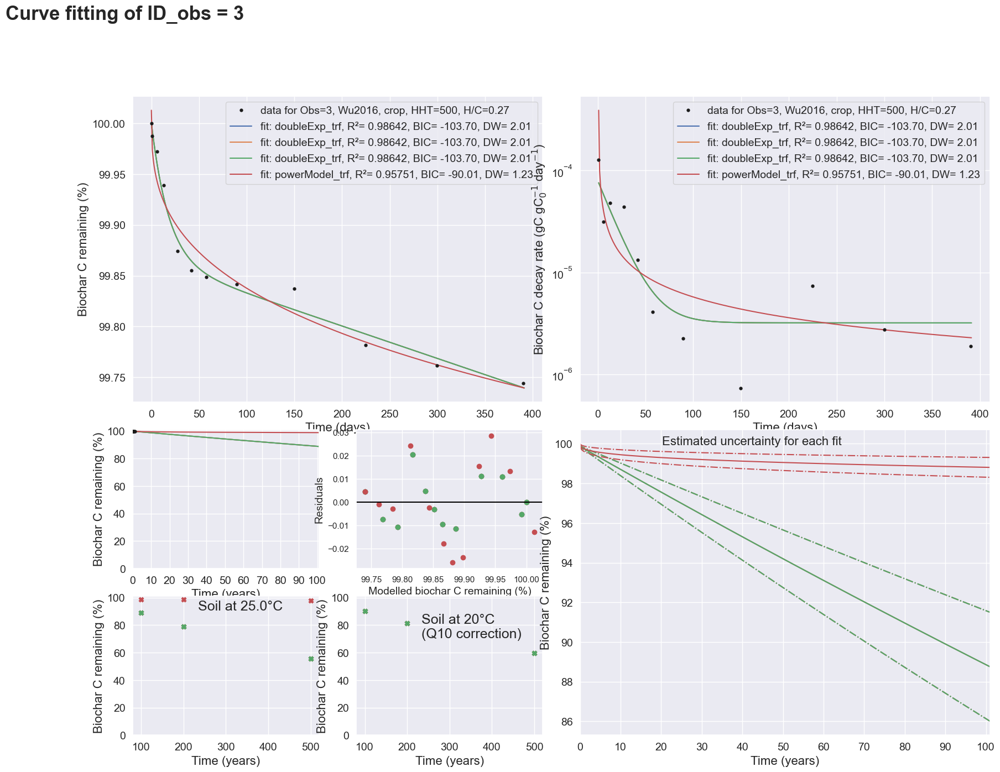

In [14]:
folder = '../simulations/manuscript/curvefits/'

for z, j in enumerate(metadata.index):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit_q10, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=False)
        
        _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1) # factor 1 (no conversion, unit gC/gC0/day)
        
    except Exception:
        #raise(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
                     x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

    r = 4
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # decay fits
    ax2 = plt.subplot(r,c,(9, 9)) # 100 year extrapo
    ax3 = plt.subplot(r,c,(10, 10)) # residuals
    ax4 = plt.subplot(r,c,(3, 8)) # table
    ax5 = plt.subplot(r,c,(13, 13)) # scatter multi-time horizon snapshots 
    ax6 = plt.subplot(r,c,(14, 14)) # q10 correction
    ax7 = plt.subplot(r,c,(11, 16)) # best fit with uncertainty and q10 correction

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax3, fig=fig)

    #_, ax4 = bs.plot_multi_fits_report(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax4, fig=fig)
    _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1/100, ax=ax4, fig=fig)
    
    _, ax5 = bs.plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_snapshots_q10(ID_obs, x, y, xdataHighRes, sub, metadata, [100, 200, 500], 20, ax=ax6, fig=fig)

    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)

    fig.tight_layout()

    plt.savefig(folder+'ID_obs-'+str(ID_obs)+'.png', dpi=150);
    plt.close();

In [150]:
folder = '../simulations/manuscript/curvefits/'

for z, j in enumerate(metadata.index):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=False)
        
        _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1)  # factor 1 (no conversion, unit gC/gC0/day)
    
    except Exception:
        #raise(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    #t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
    #                 x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

    r = 5
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # C remaining, exp duration
    ax2 = plt.subplot(r,c,(3, 7)) # C remaining, 100 years
    ax3 = plt.subplot(r,c,(4, 8)) # C remaining, 1000 years
    
    ax4 = plt.subplot(r,c, (9, 14)) # decay rates, exp duration
    ax5 = plt.subplot(r,c,(11, 15)) # decay rates, 100 years
    ax6 = plt.subplot(r,c,(12, 16)) # decay rates, 1000 years
    
    ax7 = plt.subplot(r,c,(17, 18)) # uncertainty propagated, C remaining, 100 years
    ax8 = plt.subplot(r,c,(19, 20)) # residuals
    #ax9 = plt.subplot(r,c,(21, 24)) # some table

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1001, ax=ax3, fig=fig)

    _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1/100, ax=ax4, fig=fig)
    _, ax5 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=101, factor=1/100, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=1001, factor=1/100, ax=ax6, fig=fig)
    
    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)
    _, ax8 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax8, fig=fig)
    
    fig.tight_layout()
    
    plt.savefig(folder+'extended_ID_obs-'+str(ID_obs)+'.png', dpi=150);
    plt.close();

0 1


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


1 3


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


2 4


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


3 5


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


4 6


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


5 7


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


6 8


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


7 9
8 10


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


9 11


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


10 12


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


11 13
12 14


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


13 15
14 16
15 17


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


16 18


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


17 19


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


18 20


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


19 21


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


20 22


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


21 23


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


22 24


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


23 25


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


24 26


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


25 27


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


26 28


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


27 29


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


28 30


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


29 31


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


30 32


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


31 33


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


32 34


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


33 35


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


34 36


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


35 37


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


36 39
37 40


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


38 41


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


39 42


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


40 43


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


41 44


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


42 45


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


43 46


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


44 47


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


45 48


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


46 49


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


47 50


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


48 51


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


49 52


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


50 53


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


51 54


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


52 55


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


53 56


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


54 57


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


55 58


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


56 59


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


57 60


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


58 61


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


59 62


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


60 63


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


61 64


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


62 65


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


63 66


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


64 67


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


65 68


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


66 69


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


67 70


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


68 71


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


69 72


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


70 73


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


71 74


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


72 75


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


73 76


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


74 77


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


75 78


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


76 79


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


77 80


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


78 81


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


79 82


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


80 83


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


81 84


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


82 85


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


83 86


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


84 87


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


85 88


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


86 89


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


87 90


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


88 91


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


89 92


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


90 93


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


91 94
92 95


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


93 96


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


94 97


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


95 98


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


96 99


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


97 100


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


98 101


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


99 102


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


100 103


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


101 104
102 105
103 106
104 107
105 108
106 109
107 110
108 111
109 112


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


110 113


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


111 114


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


112 115


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


113 116


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


114 117


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


115 118


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


116 119


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


117 120


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


118 121


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


119 122


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


120 123


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


121 124


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


122 125


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


123 126


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


124 127


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


125 128


c:\github\biocharstability\biocharStability\analyse.py:1080: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


126 129


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


127 130
128 131
129 132
130 133
131 134
132 135
133 136
134 137
135 138
136 139
137 140
138 141
139 142
140 143
141 144
142 145
143 146
144 147
145 148
146 149
147 150
148 151
149 152
150 153
151 154
152 155
153 156
154 157
155 158
156 159
157 160
158 161
159 162
160 163
161 164
162 165
163 166
164 167
165 168


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


166 169


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


167 170


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


168 171


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


169 172


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


170 173


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


171 174


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


172 175


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


173 176


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


174 177


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


175 178


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


176 179


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


177 180


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


178 181


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


179 182


c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


180 183


c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


Conclusions from visual inspection of fits:
- Are there observations that do not fit well any exponential or power model ? Yes. The experimental data does not look like an exponential/power decay. In some cases, we can still get an acceptable value. In other cases not.


- Should some observations be excluded from the "durability models", and for what reasons ?

* Can fitting on decay rates improve things for observations where experimental data is barely exponential? It doesn't seem so..

##### with Woolf as comparison

* Plot strategies S1, S2, S3, but not S4 because it is always one of S1-3.
* Whenever available, also plot fit from Woolf
* Modify label so to show: S1/2/3/Woolf

In [9]:
S1_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S1'+'.xlsx', index_col=0)
S2_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S2'+'.xlsx', index_col=0)
S3_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S3'+'.xlsx', index_col=0)
S4_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S4'+'.xlsx', index_col=0)

S1_bestfit['Strat']= np.repeat('S1', len(S1_bestfit))
S2_bestfit['Strat']= np.repeat('S2', len(S2_bestfit))
S3_bestfit['Strat']= np.repeat('S3', len(S3_bestfit))
S4_bestfit['Strat']= np.repeat('S4', len(S4_bestfit))

S_bestfit = bs.merge_dfs([S1_bestfit, S2_bestfit, S3_bestfit, S4_bestfit], saveTo=False)

# restore the multi-index used in plotting function to indentify parameters (it's removed in best-fit selection function)
day_run = '2023-06-27'
fitdata = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
multiIndex = fitdata.columns 
multiIndex = multiIndex.append( pd.MultiIndex.from_arrays([['strategy'], ['strategy'], ['str']]) )
S_bestfit.columns = multiIndex
S_bestfit.to_excel('../simulations/manuscript/bestfits_S_multiIndex.xlsx')

In [152]:
# load woolf data
woolf_fp= '../biocharStability/database/former-assessment/2021_Woolf_EST_Supporting Information_edited_ESA.xlsx'
woolf = pd.read_excel(woolf_fp, sheet_name='Fperm', index_col=None, usecols='A:T', skiprows=7)
woolf.set_index('ID_Woolf2021', inplace=True)

woolf_ids = list(woolf.index)


C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Conditional Formatting extension is not supported and will be removed
  for idx, row in parser.parse():


In [153]:
folder = '../simulations/manuscript/curvefits/withWoolf/'

param_woolf_pool = ['C1','C2', 'C3']
param_woolf_decay = ['k1', 'k2', 'k3']
param_woolf = param_woolf_pool + param_woolf_decay

from inspect import getfullargspec, signature
def sort_params(f_model, params):
    '''
    Sort parameters from the dataframe, so they match the order of the params in the model function
    f_model : a python function, with arguments (t, p1, p2, p3)
    param_names : a list of str p1, p2, p3 
    param_values: a list of values, in the order of the param_names
    Returns: param_names and param_values in same order as required by f_model 
    '''
    param_names = params.index.to_list()
    param_values = params.values #.flatten()
    dic = {p:v for p,v in zip(param_names, param_values)}
    f_params = getfullargspec(f_model)[0][1:] # excluding time
    p_opt_values =[dic[k] for k in f_params]
    return f_params, p_opt_values
with sns.axes_style("ticks"):
    for z, j in enumerate(metadata.index):
        #if z < 107:
        #    continue
        #    break
        #print(z,j)
        try:
            # select the fitdata for the observation
            ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit, data, metadata, 
                                                                fit_limit=5, fit_rank='bic',
                                                                exclude_non_physical=False)
            sub = sub[sub[('strategy', 'strategy', 'str')] != 'S4'] # exclude S4, as it is always the same as either S1-2-3
            _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1)  # factor 1 (no conversion, unit gC/gC0/day)

            # retrieve fit data for Woolf, if it exists
            if metadata.loc[j, 'ID_Woolf2021'] in woolf_ids:
                # get the params
                params = woolf.loc[metadata.loc[j, 'ID_Woolf2021'], param_woolf].dropna()
                params[param_woolf_pool] = params[param_woolf_pool].multiply(other=100)
                params[param_woolf_decay] = params[param_woolf_decay].multiply(other=1/365)
                params.rename({'C1':'c1','C2':'c2', 'C3':'c3', 'k1':'k1', 'k2':'k2', 'k3':'k3'}, inplace=True)
                p_opt_names, p_opt = sort_params(bs.tripleExp_u, params)
                if len(params[params == 0]) == 2:
                    m = 'doubleExp_u'
                elif len(params[params == 0]) == 0:
                    m = 'tripleExp_u'
                elif len(params[params == 0]) == 4:
                    m = 'singleExp'        

        except Exception:
            #raise(Exception)
            continue

        # initialise plot & insert
        fig = plt.figure(figsize=(20, 15))
        #t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
        #                 x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

        r = 5
        c = 4
        ax1 = plt.subplot(r,c,(1, 6)) # C remaining, exp duration
        ax2 = plt.subplot(r,c,(3, 7)) # C remaining, 100 years
        ax3 = plt.subplot(r,c,(4, 8)) # C remaining, 1000 years

        ax4 = plt.subplot(r,c, (9, 14)) # decay rates, exp duration
        ax5 = plt.subplot(r,c,(11, 15)) # decay rates, 100 years
        ax6 = plt.subplot(r,c,(12, 16)) # decay rates, 1000 years

        ax7 = plt.subplot(r,c,(17, 18)) # uncertainty propagated, C remaining, 100 years
        ax8 = plt.subplot(r,c,(19, 20)) # residuals
        #ax9 = plt.subplot(r,c,(21, 24)) # some table
        
        
        if metadata.loc[j, 'ID_Woolf2021'] in woolf_ids:
            # calculate woolf R2 and other metrics
            r2, residuals = bs.rsquare(bs.tripleExp_u, x, y, p_opt) # R2
            residuals, chisqr, redchisqr, aic, bic = bs.lmfit_fitting_stats(bs.tripleExp_u, x, y, p_opt)
            
            # manually adding Woolf to each axes
            xdata100 = np.arange(0, 365*101, 10)
            xdata1000 = np.arange(0, 365*1001, 10)
            ax1.plot(xdataHighRes, bs.tripleExp_u(xdataHighRes, *p_opt), 
                     label='Woolf2021: {m}, R\u00B2= {r2:.5f}, BIC= {bic:.2f},'.format(m=m, r2=r2, bic=bic), color='k', ls=(0, (5, 7)) , zorder=1000)
            ax2.plot(xdata100, bs.tripleExp_u(xdata100, *p_opt), color='k', ls=(0, (5, 7)) , zorder=1000)
            ax3.plot(xdata1000, bs.tripleExp_u(xdata1000, *p_opt), color='k', ls=(0, (5, 7)) , zorder=1000)
            factor = 1/100
            ax4.plot(xdataHighRes[1:], -factor*np.diff( bs.tripleExp_u(xdataHighRes, *p_opt)) , label='fit: {} from Woolf2021'.format(m), color='k', ls=(0, (5, 7)) , zorder=1000)
            factor = 1/1000 # dunno why the factors is x10 for the extended plots; it's not the case with our data..?
            ax5.plot(xdata100[1:], -factor*np.diff( bs.tripleExp_u(xdata100, *p_opt)) , color='k', ls=(0, (5, 7)) , zorder=1000)
            ax6.plot(xdata1000[1:], -factor*np.diff( bs.tripleExp_u(xdata1000, *p_opt)) , color='k', ls=(0, (5, 7)) , zorder=1000)

        _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
        _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax2, fig=fig)
        _, ax3 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1001, ax=ax3, fig=fig)

        _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1/100, ax=ax4, fig=fig)
        _, ax5 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=101, factor=1/100, ax=ax5, fig=fig)
        _, ax6 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=1001, factor=1/100, ax=ax6, fig=fig)

        _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)
        _, ax8 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax8, fig=fig)


        #editing
        ax4.get_legend().remove()
        ax1.grid(axis='both')
        ax2.grid(axis='both')
        ax3.grid(axis='both')
        ax4.grid(axis='both')
        ax5.grid(axis='both')
        ax6.grid(axis='both')
        ax7.grid(axis='both')
        ax8.grid(axis='both')
        fig.tight_layout()

        plt.savefig(folder+'extended_ID_obs-'+str(ID_obs)+'.png', dpi=150);
        plt.close();

c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b)

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b)

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1048: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b)

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
c:\github\biocharstability\biocharStability\analyse.py:1111: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vec

#### Fitting on decay rates

In [9]:
day_run = '2023-06-08'
S1_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_'+'S1'+'.xlsx', index_col=0)
S2_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_'+'S2'+'.xlsx', index_col=0)
S3_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_'+'S3'+'.xlsx', index_col=0)
S4_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_'+'S4'+'.xlsx', index_col=0)

In [26]:
day_run = '2023-06-08'
S1_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_newMF_'+'S1'+'.xlsx', index_col=0)
S2_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_newMF_'+'S2'+'.xlsx', index_col=0)
S3_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_newMF_'+'S3'+'.xlsx', index_col=0)
S4_bestfit_K = pd.read_excel('simulations/manuscript/bestfits_onRates_newMF_'+'S4'+'.xlsx', index_col=0)

In [27]:
S1_bestfit_K['Strat']= np.repeat('S1', len(S1_bestfit_K))
S2_bestfit_K['Strat']= np.repeat('S2', len(S2_bestfit_K))
S3_bestfit_K['Strat']= np.repeat('S3', len(S3_bestfit_K))
S4_bestfit_K['Strat']= np.repeat('S4', len(S4_bestfit_K))

S_bestfit_K = bs.merge_dfs([S1_bestfit_K , S2_bestfit_K , S3_bestfit_K , S4_bestfit_K ], saveTo=False)

# restore the multi-index used in plotting function to indentify parameters (it's removed in best-fit selection function)
day_run = '2023-06-08'
fitdata = bs.load_fitted_observations('simulations/manuscript/curve-fitting_onRates_newMF_alllibs_allfits_v'+day_run+'.xlsx')
multiIndex = fitdata.columns 
multiIndex = multiIndex.append( pd.MultiIndex.from_arrays([['strategy'], ['strategy'], ['str']]) )
S_bestfit_K.columns = multiIndex
S_bestfit_K.to_excel('simulations/manuscript/bestfits_onRates_newMF_S_multiIndex.xlsx')

In [ ]:
folder = 'simulations/manuscript/curvefits/'

for z, j in enumerate(metadata.index):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit_K, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=False)
        
        _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1)  # factor 1 (no conversion, unit gC/gC0/day)
    
    except Exception:
        #raise(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    #t = fig.suptitle("Curve fitting of ID_obs = "+str(ID_obs), fontsize=25, fontweight='bold', 
    #                 x=0.01, y=.99, horizontalalignment='left', verticalalignment='top', )

    r = 5
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # C remaining, exp duration
    ax2 = plt.subplot(r,c,(3, 7)) # C remaining, 100 years
    ax3 = plt.subplot(r,c,(4, 8)) # C remaining, 1000 years
    
    ax4 = plt.subplot(r,c, (9, 14)) # decay rates, exp duration
    ax5 = plt.subplot(r,c,(11, 15)) # decay rates, 100 years
    ax6 = plt.subplot(r,c,(12, 16)) # decay rates, 1000 years
    
    ax7 = plt.subplot(r,c,(17, 18)) # uncertainty propagated, C remaining, 100 years
    ax8 = plt.subplot(r,c,(19, 20)) # residuals
    #ax9 = plt.subplot(r,c,(21, 24)) # some table

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1001, ax=ax3, fig=fig)

    _, ax4 = bs.plot_multi_fits_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, factor=1, ax=ax4, fig=fig)
    _, ax5 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=101, factor=1, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_extended_decay(ID_obs, x, yk, xdataHighRes, sub, metadata, TH=1001, factor=1, ax=ax6, fig=fig)
    
    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)
    _, ax8 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax8, fig=fig)
    
    fig.tight_layout()
    
    plt.savefig(folder+'extended_onRates_newMF_ID_obs-'+str(ID_obs)+'.png', dpi=150);
    plt.close()


0 1


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


1 3


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


2 4


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


3 5


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


4 6


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


5 7


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


6 8


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


7 9


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


8 10


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


9 11


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


10 12


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


11 13


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


12 14


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


13 15


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:979: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


14 16


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


15 17


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


16 18


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


17 19


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:979: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


18 20


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


19 21


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


20 22


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


21 23


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


22 24


C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:972: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


### Comparison of durability estimates, per observation, with Woolf 2021

- Reproducibility, relative to Woolf 2021:
    - did we get the exact same models? no, because I applied triple > should also apply double for all only
    - did we get the fit from Woolf somewhere in the fits performed?
    - at least, did we get the same/similar BC100s ?
  
  
  
- Power Model, has been suggested earlier and usually providing very long MRT: reason behind it is that power model in fact assumes a log decay of k, with time, which is faster in the begining than exponential models (show illustration of it). But the power model can also translate to a rapid linear decay when it's parameter is m == 1.
    - For biomass feedstocks and low-temperature chars that have a lower durability, and for which extrapolation via exponential models yield a low BC100, do we also get a low value from a power model?
          - Yes, mostly, with few exceptions
          - Likise, when BC100 with exp is high, we do get high BC100 with power, with some expection, and some systematic difference (ca 10% more C remaning with power model). 
          - But for the middle range (30-75%), the power model tend to be largely more stable, with few exceptions.
          
     - The more we look into the future, e.g. via t12 & MRTa, the more divergent the models will be; not a surprise.
     
     
     - Indication for policy: regardless of curve fitting approach, most not very persistent chars will have high losses in short term, which is obviously measured in short-term incubations. Incubations can at least identify those biochars.
     
     
- What best fits, if we let model selection free (strategy S4), do we agree with that, or want to make custom edits?



#### Did we find same fits as reported in Woolf 2021, among all fits performed?

For each observation, more than 70 fits were obtained (for different initial conditions, model functions, algorithms). Among these fits, we look for any fit that is similar to the fits reported in Woolf 2021. Similarity here refers to having the matching values for all model parameters (k1, k2, k3, c1, c2, c3), with at most a 30% relative error.

Handling of the data and comparison is performed below:

In [479]:
# load df with all our fits, excluding power model & single exp (as they are not in Woolf 2021 fits)
day_run = '2023-09-09'
fitdata = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
fitdata = fitdata[ fitdata[('strategy', 'model', 'str')] != 'powerModel']
fitdata = fitdata[ fitdata[('strategy', 'model', 'str')] != 'singleExp']
fitdata = fitdata[ fitdata[('strategy', 'model', 'str')] != 'singleExp_u']

fitdata = fitdata.droplevel(level=[0,2], axis=1)
fitdata.fillna(-1, inplace=True)

In [480]:
# sort decay constants and pool sizes, so that k1 > k2 > k3
cols_rates= ['k1', 'k2', 'k3']
cols_pools= ['c1', 'c2', 'c3']
K1 = []
K2 = []
K3 = []
C1 = []
C2 = []
C3 = []
for i, r in fitdata.iterrows():
    mapRatesPool = dict(zip( r[cols_rates], r[cols_pools] ))
    rates = list(r[cols_rates])
    rates.sort(reverse=True)
    
    pools = [ mapRatesPool[K] if not K == -1 else 0 for K in rates ]
    
    K1.append(rates[0]*365)
    K2.append(rates[1]*365)
    K3.append(rates[2]*365)
    C1.append(pools[0])
    C2.append(pools[1])
    C3.append(pools[2])

decayRates = fitdata[['ID_obs', 'model']].copy()
decayRates['K1'] = K1
decayRates['K2'] = K2
decayRates['K3'] = K3
decayRates['C1'] = C1
decayRates['C2'] = C2
decayRates['C3'] = C3
decayRates.replace(-365,0, inplace=True)
decayRates.replace(-1,0, inplace=True)

for i,r in decayRates.iterrows():
    pools = r[['C1', 'C2', 'C3']]
    if np.sum(pools.isin([0]))>1:
        other_pool = 100-np.nansum(pools)
        if r['C1'] == 0:
            decayRates.loc[i,'C1']= other_pool
        elif r['C2'] == 0:
            decayRates.loc[i,'C2']+= other_pool
        else:
            decayRates.loc[i,'C3']+= other_pool

In [481]:
# load woolf data
woolf_fp= '../biocharStability/database/former-assessment/2021_Woolf_EST_Supporting Information_edited_ESA.xlsx'
woolf = pd.read_excel(woolf_fp, sheet_name='Fperm', index_col=None, usecols='A:T', skiprows=7)
woolf.set_index('ID_Woolf2021', inplace=True)

C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Conditional Formatting extension is not supported and will be removed
  for idx, row in parser.parse():


In [482]:
# sort decay constants and pool sizes, so that k1 > k2 > k3
cols_rates= ['k1', 'k2', 'k3']
cols_pools= ['C1', 'C2', 'C3']
K1 = []
K2 = []
K3 = []
C1 = []
C2 = []
C3 = []
for i, r in woolf.iterrows():
    mapRatesPool = dict(zip( r[cols_rates], r[cols_pools] ))
    rates = list(r[cols_rates])
    rates.sort(reverse=True)
    
    pools = [ mapRatesPool[K] if not K == -1 else 0 for K in rates ]
    
    K1.append(rates[0])
    K2.append(rates[1])
    K3.append(rates[2])
    C1.append(pools[0]*100)
    C2.append(pools[1]*100)
    C3.append(pools[2]*100)

decayRatesW = woolf[['Fperm,initial']].copy()
decayRatesW['K1'] = K1
decayRatesW['K2'] = K2
decayRatesW['K3'] = K3
decayRatesW['C1'] = C1
decayRatesW['C2'] = C2
decayRatesW['C3'] = C3
decayRates.replace(-365,0, inplace=True)
decayRatesW.replace(-1, 0, inplace=True)

for i,r in decayRatesW.iterrows():
    pools = r[['C1', 'C2', 'C3']]
    if np.sum(pools.isin([0]))>1:
        other_pool = 100-np.nansum(pools)
        if r['C1'] == 0:
            decayRatesW.loc[i,'C1']= other_pool
        elif r['C2'] == 0:
            decayRatesW.loc[i,'C2']+= other_pool
        else:
            decayRatesW.loc[i,'C3']+= other_pool

In [483]:
# merge decayRates, with same WoolfID
decayRates['ID_Woolf2021'] = [ metadata.loc[ids, 'ID_Woolf2021'] for ids in decayRates['ID_obs']] # the matching
mergedDecayRates = decayRates.merge(decayRatesW, on='ID_Woolf2021', suffixes=(None, '_W'), validate='many_to_one') # the dataframe with both data

In [485]:
# comparison, line by line
SimilarFits = []
error_percentage= 30 #5%
for i,r in mergedDecayRates.iterrows():
    list1=list(r[['K1', 'K2', 'K3', 'C1', 'C2', 'C3']])
    list2=list(r[['K1_W', 'K2_W', 'K3_W', 'C1_W', 'C2_W', 'C3_W']])
    all_equal = all(
        (abs(x - y) / x) * 100 <= error_percentage if x != 0 else y == 0 for x, y in zip(list1, list2)
    )
    SimilarFits.append(all_equal)
    
mergedDecayRates['SimilarFits'] = SimilarFits
mergedDecayRates.to_excel('../simulations/manuscript/similar-fits-Woolf2021.xlsx')

In [486]:
CommonObs = mergedDecayRates['ID_obs'].unique()
YesWeCan = {}
for o in CommonObs:
    yeah = mergedDecayRates[ mergedDecayRates['ID_obs'] == o]['SimilarFits'].any()
    YesWeCan[o] = yeah
YesWeCan = pd.DataFrame.from_dict(YesWeCan, orient='index')
#YesWeCan = YesWeCan.reset_index(names='ID_obs')
YesWeCan.value_counts()

False    50
True     19
dtype: int64

In [488]:
19/(69)

0.2753623188405797

#### Did we get similar BC100 as in  Woolf 2021 ?

In [489]:
# load woolf data
woolf_fp= '../biocharStability/database/former-assessment/2021_Woolf_EST_Supporting Information_edited_ESA.xlsx'
woolf = pd.read_excel(woolf_fp, sheet_name='Fperm', index_col=None, usecols='A:T', skiprows=7)
woolf.set_index('ID_Woolf2021', inplace=True)

woolf_ids = list(woolf.index)
subset_metadata = metadata[metadata['ID_Woolf2021'].isin(woolf_ids)]
subset_data = data[ data['ID_obs'].isin(list(subset_metadata.index))]
subset_ids = list(subset_metadata.index)

C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Conditional Formatting extension is not supported and will be removed
  for idx, row in parser.parse():


In [7]:
# load best fit data
for_model = pd.read_excel('../simulations/manuscript/bestfits_S_multiIndex.xlsx', index_col=0, header=[0,1,2])
for_model = for_model.droplevel(level=[0,2], axis=1)
#for_model = for_model[ for_model['strategy'] == 'S2']

In [8]:
subset_fitdata = for_model[ for_model['ID_obs'].isin(subset_ids)].copy(deep=True)
subset_fitdata = subset_fitdata.pivot(index='strategy', columns='ID_obs', values='BC100').T.reset_index()
subset_fitdata['ID_Woolf2021'] = [ subset_metadata.loc[ids, 'ID_Woolf2021'] for ids in subset_fitdata['ID_obs']] # the matching

cols=['Molar Hydrogen to organic carbon ratio of the biochar', 'Temperature at which decomposition experiment was conducted (°C)',
 'C1', 'C2', 'C3', 'k1', 'k2', 'k3', 'Q10', 'fT', 'k1_fperm', 'k2_fperm', 'k3_fperm', 'Fperm', 'Fperm,initial', 'DeltaFperm']
subset_fitdata_ext = subset_fitdata.merge(woolf[cols], on='ID_Woolf2021', suffixes=(None, '_W'), validate='1:1') # the dataframe with both data

print("Our dataset & Woolf dataset have {} observations in common, for metadata.".format(len(subset_ids)))
print("Our dataset & Woolf dataset have {} observations in common, for metadata and fitdata.".format(len(subset_fitdata_ext)))

NameError: name 'subset_ids' is not defined

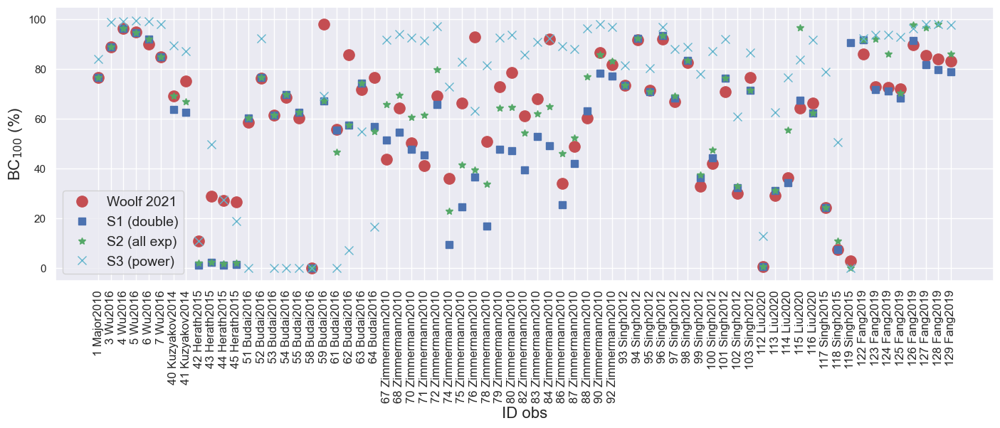

In [493]:
fig, ax = plt.subplots(figsize=(17,5))

ax.plot(subset_fitdata_ext['Fperm,initial']*100, 'ro', markersize=11)

ax.plot(subset_fitdata_ext['S1'], 'bs', markersize=7) # BC100 under S1
ax.plot(subset_fitdata_ext['S2'], 'g*', markersize=7) # BC100 under S1
ax.plot(subset_fitdata_ext['S3'], 'cx', markersize=8) # BC100 under S1
#ax.plot(subset_fitdata_ext['S4'], 'm.', markersize=j) # BC100 under S1

ax.xaxis.grid()
ax.yaxis.grid()

names = list(subset_fitdata_ext['ID_obs'])
names = [ str(i)+' '+metadata.loc[i, 'AuthorDate'] for i in list(subset_fitdata_ext['ID_obs'])]

plt.xticks(ticks=np.arange(0, len(subset_fitdata_ext)), labels=names, fontsize=12)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, horizontalalignment='center')
plt.xlabel('ID obs', fontsize=16)
plt.ylabel(r'BC$_{100}$ (%)', fontsize=16)
ax.set_ylim(0-5,100+5)

plt.legend(['Woolf 2021', 'S1 (double)', 'S2 (all exp)', 'S3 (power)', 'S4'], fontsize=14)
plt.grid()

if True:
    plt.savefig('../simulations/manuscript/Figure7_comparison-woolf-fits-p0.png', dpi=300, bbox_inches='tight')

In [66]:
for i in subset_fitdata_ext['ID_obs']:
    bs.plot_woolf_comparison(i, subset_fitdata_ext, data, metadata)

KeyError: ['bic']

#### Power model ?

In [10]:
S_bestfit_dl = S_bestfit.droplevel(level=[0,2], axis=1)

In [11]:
CheckDurabilityBC100 = S_bestfit_dl.pivot_table(values='BC100', index=['ID_obs'], columns='strategy').sort_values(by=['S1'], ascending=True)
CheckDurabilityMRTa = S_bestfit_dl.pivot_table(values='MRTa', index=['ID_obs'], columns='strategy').sort_values(by=['S1'], ascending=True)
CheckDurabilityT12 = S_bestfit_dl.pivot_table(values='t12', index=['ID_obs'], columns='strategy').sort_values(by=['S1'], ascending=True)

In [12]:
CheckLowDurability = S_bestfit_dl.pivot_table(values='BC100', index=['ID_obs'], columns='strategy').sort_values(by=['S1'], ascending=True)
CheckLowDurability.head(50)

strategy,S1,S2,S3,S4
ID_obs,,,,
175,3.195762e-18,3.195751e-18,0.000000,3.195751e-18
169,2.085146e-11,8.298106e-06,0.000000,0.000000e+00
65,4.197279e-06,2.431210e-06,0.000000,2.431210e-06
49,3.731943e-05,7.509747e-06,0.000000,7.509747e-06
170,4.338126e-05,4.338103e-05,0.000000,4.338103e-05
56,1.711871e-04,3.724625e-05,0.000000,3.724625e-05
58,3.256133e-04,7.275213e-06,0.000000,0.000000e+00
46,2.147489e-02,1.863380e-02,0.000000,1.863380e-02
168,1.599379e-01,4.573051e-02,0.000000,4.573051e-02


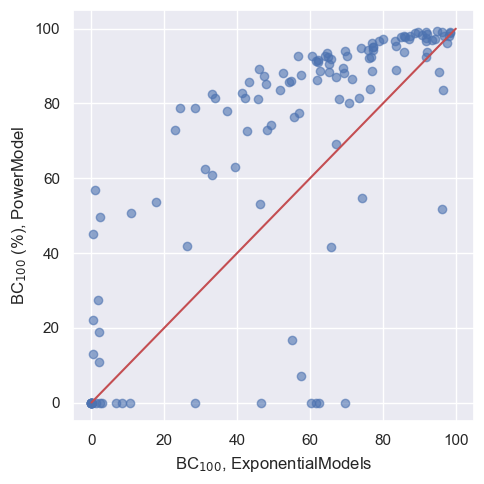

In [11]:
fig, ax = plt.subplots(1,1, figsize=(5,5))
axl =  [ax]
i=0
axl[i].scatter(x=CheckDurabilityBC100.S2, y=CheckDurabilityBC100.S3, alpha=0.6)
axl[i].plot([0,100], [0,100], 'r-')
axl[i].set_ylabel(r'BC$_{100}$ (%), PowerModel')
axl[i].set_xlabel(r'BC$_{100}$, ExponentialModels')

fig.tight_layout()
#plt.savefig('../simulations/manuscript/power-vs-exponentials.png', dpi=600)

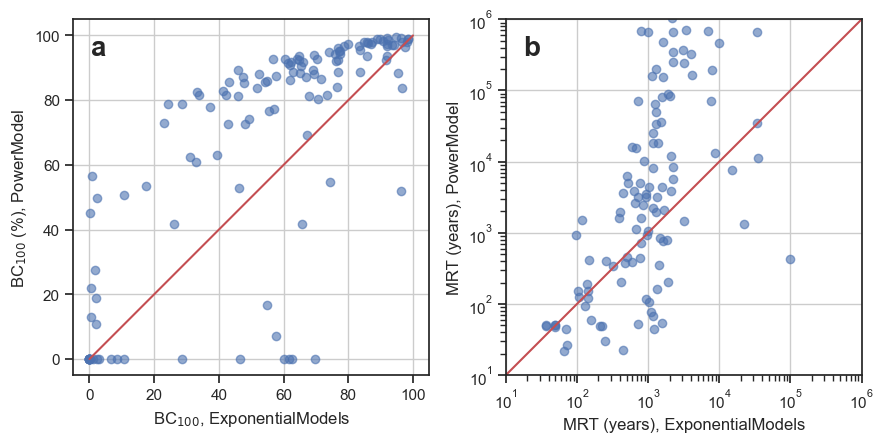

In [31]:
with sns.axes_style("ticks"):
    fig, ax = plt.subplots(1,2, figsize=(9,5))
    axl =  ax.ravel()
    i=0
    axl[i].scatter(x=CheckDurabilityBC100.S2, y=CheckDurabilityBC100.S3, alpha=0.6)
    axl[i].plot([0,100], [0,100], 'r-')
    axl[i].set_ylabel(r'BC$_{100}$ (%), PowerModel')
    axl[i].set_xlabel(r'BC$_{100}$, ExponentialModels')
    axl[i].grid(axis='both')
    axl[i].set_box_aspect(1)
    axl[i].text(0.05, 0.90, string.ascii_lowercase[i], transform=axl[i].transAxes, size=20, weight='bold')

    i=1
    axl[i].scatter(x=CheckDurabilityMRTa.S2, y=CheckDurabilityMRTa.S3, alpha=0.6)
    xmax = np.max(CheckDurabilityMRTa.S2)
    
    axl[i].set_ylabel('MRT (years), PowerModel')
    axl[i].set_xlabel('MRT (years), ExponentialModels')
    
    xmin =1e1
    xlim = 1e6
    axl[i].plot([xmin, xlim], [xmin,xlim], 'r-')
    axl[i].set_xlim([xmin, xlim])
    axl[i].set_ylim([xmin, xlim])
    
    axl[i].grid(axis='both')
    axl[i].set_xscale('log')
    axl[i].set_yscale('log')
    axl[i].set_box_aspect(1)
    axl[i].text(0.05, 0.90, string.ascii_lowercase[i], transform=axl[i].transAxes, size=20, weight='bold')

    i=2 # no need to show MRTa, same obs as t12

    #axl[i].scatter(x=CheckDurabilityT12.S2, y=CheckDurabilityT12.S3, alpha=0.6)
    #xmax = np.max(CheckDurabilityT12.S2)
    #axl[i].plot([0,xmax], [0,xmax], 'r-')
    #axl[i].set_ylabel(r't$_{1/2}$ (years), PowerModel')
    #axl[i].set_xlabel(r't$_{1/2}$ (years), ExponentialModels')
    #axl[i].set_xlim([0,xmax])
    #axl[i].set_ylim([0,xmax])


    #ax[i].set_xlim([0,xmax])
    #ax[i].set_ylim([0,xmax])

    fig.tight_layout()
    plt.savefig('../simulations/manuscript/Figure6_power-vs-exponentials_BC100_MRTa.png', dpi=600)

In [ ]:
def powerModel_lim(t, c0, b, m, L=10*365):
    '''
    This function cannot be used in curve fitting step. Instead, curve fitting should be done with bs.powerModel.
    Then, the fitted parameters on bs.PowerModel are used to calculate the extrapolation with the assumption that the decay rates decreases only for L years.
    
    - L = 10*365 # days
    
    '''
    if hasattr(t, "__len__"):
        # yes, t is an array of values
        t_before = np.array(np.where(t <= L)).flatten()
        t_after = np.array(np.where(t>L)).flatten()
        if m > -1:
            z_before = c0 - c0*np.exp(b)/(m+1)*(t_before**(m+1))
        if m == -1:
            z_before = c0*(1-np.exp(b)*np.log(t_before))
        if m < -1:
            z_before = c0*np.exp(b)/(m+1)*(t_before**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0

        kL = (z_before[-1] - z_before[-2])/1.
        zL = z_before[-1]
        
        z_after = zL + kL * (t_after - L)
        
        z = np.append(z_before, z_after) # append, not add 
        
    else:
        # no, t is a single value
        if t < L:
            if m > -1:
                z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
            if m == -1:
                z = c0*(1-np.exp(b)*np.log(t))
            if m < -1:
                z = c0*np.exp(b)/(m+1)*(t**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
        else:
            # t >= L 
            if m > -1:
                zL = c0 - c0*np.exp(b)/(m+1)*(L**(m+1))
                zLn = c0 - c0*np.exp(b)/(m+1)*((L-1)**(m+1))
            if m == -1:
                zL = c0*(1-np.exp(b)*np.log(L))
                zLn = c0*(1-np.exp(b)*np.log(L-1))
            if m < -1:
                zL = c0*np.exp(b)/(m+1)*(L**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
                zLn = c0*np.exp(b)/(m+1)*((L-1)**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
            
            kL = (zL-zLn)/1.
            
            z = zL + kL * (t - L)
        
    return z

In [ ]:
TH = np.arange(0, 365*100, 1)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=50*365)

In [ ]:
TH = np.arange(0, 365*1000, 1)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=10*365)
plt.plot(TH, PWL)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=20*365)
plt.plot(TH, PWL)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=50*365)
plt.plot(TH, PWL)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=100*365)
plt.plot(TH, PWL)
PWL = powerModel_lim(TH, c0=100, b=-7, m=-0.6, L=1000*365)
plt.plot(TH, PWL)

## All time series of BC remainings as log-scale

In [288]:
# fits from 2023-06, S1 / S2 / S3 / S4 (few more obs)
S1_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S1'+'.xlsx', index_col=0) # double & triple, constrained only
S2_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S2'+'.xlsx', index_col=0) # single to triple, any form
S3_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S3'+'.xlsx', index_col=0) # power model only
S4_bestfit = pd.read_excel('../simulations/manuscript/bestfits_'+'S4'+'.xlsx', index_col=0) # power + any exponential, BIC

# restore the multi-index used in plotting function to indentify parameters (it's removed in best-fit selection function)
day_run = '2023-06-27'
temp = bs.load_fitted_observations('../simulations/manuscript/curve-fitting_alllibs_allfits_v'+day_run+'.xlsx')
multiIndex = temp.columns 
S1_bestfit.columns = multiIndex
S2_bestfit.columns = multiIndex
S3_bestfit.columns = multiIndex
S4_bestfit.columns = multiIndex

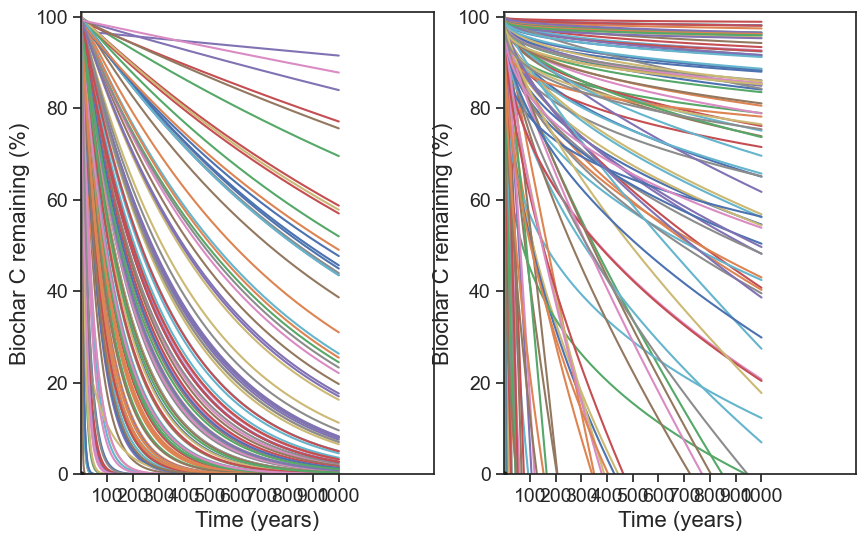

In [314]:
with sns.axes_style("ticks"):
    f, a = plt.subplots(nrows=1, ncols=2, figsize=(10,6))
    bs.plot_multi_fits_extended(ID_obs, 0, 0, xdataHighRes, S2_bestfit, metadata, TH=1001, ax=a[0], fig=f)
    #a[0].set_xscale('log')
    a[0].set_xlim([10, 500000])
    #a[0].set_ylim([80, 100])
    bs.plot_multi_fits_extended(ID_obs, 0, 0, xdataHighRes, S3_bestfit, metadata, TH=1001, ax=a[1], fig=f)
    #a[1].set_xscale('log')
    a[1].set_xlim([10, 500000])
    #a[1].set_ylim([80, 100])

In [309]:
500000/365

1369.86301369863

## And after 100 years, what?

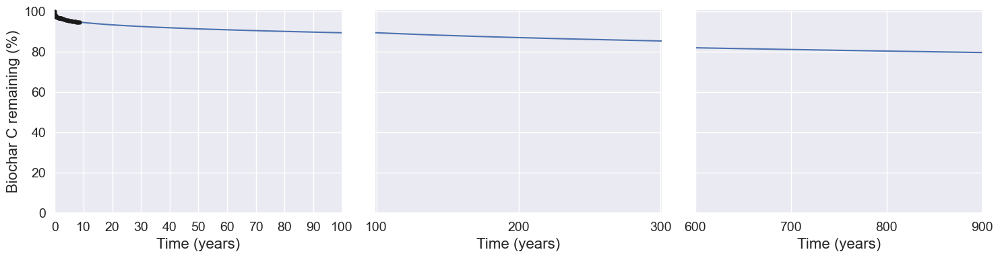

In [74]:

j = 40
try:
    # select the fitdata for the observation
    ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, S_bestfit_q10, data, metadata, 
                                                        fit_limit=5, fit_rank='bic',
                                                        exclude_non_physical=False)

    _, yk = bs.select_timeseries(j, data, 'k_bc_rel0', 1) # factor 1 (no conversion, unit gC/gC0/day)

except Exception:
    raise(Exception)

    # keep only one obs
sub = sub.drop([161, 411, 36], axis=0)

# initialise plot & insert

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(15,4), sharey=True)

_, ax[0] = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=101, ax=ax[0], fig=fig)
ax[0].set_xlim([0*365, 100*365])
_, ax[1] = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=301, ax=ax[1], fig=fig)

TH = 301
xdata100 = np.arange(0, 365*TH, 10)
x_ticks = [day for day in xdata100 if day%3650 == 0] if TH < 300 else [day for day in xdata100 if day%36500 == 0] 
x_labels = [str(i//365) for i in x_ticks]
ax[1].set_xticks(x_ticks)
ax[1].set_xticklabels(x_labels)
ax[1].set_xlim([99*365, 301*365])
ax[1].set_ylabel('')
    
_, ax[2] = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, TH=1000, ax=ax[2], fig=fig)
ax[2].set_xlim([600*365, 900*365])
ax[2].set_ylabel('')
fig.tight_layout()

plt.savefig('../simulations/manuscript/carbonloss-after100years-sowhat.png', dpi=600)